In [4]:
import torch.optim as optim
from torch import nn
from torchvision import models

from preprocessing_last20 import *
from classifier2 import FaceRecognizer2 as FaceRecognizer
from mindiffusion.ddpm import DDPM
from mindiffusion.unet import NaiveUnet
from d2c_encoder import D2CEncoder
from d2c_decoder import D2CDecoder

In [5]:
device = torch.device('cuda:0')
train_data = train_data.to(device)
test_data = test_data.to(device)
vgg11 = models.vgg11(pretrained=False).to(device)
classifier = FaceRecognizer(vgg11).to(device)
d2c_encoder = D2CEncoder().to(device)
d2c_decoder = D2CDecoder().to(device)
d2c_ddpm = DDPM(eps_model=NaiveUnet(16, 16, n_feat=128), betas=(1e-4, 0.02), n_T=200).to(device)
attack_targets = torch.tensor([[0],[1],[2],[3],[4],[5],[6],[7],[8],[9]]).to(device)

In [6]:
classifier.load_state_dict(torch.load('eval_classifier_no_overfit.pt'))
d2c_encoder.load_state_dict(torch.load('d2c_encoder.pth'))
d2c_decoder.load_state_dict(torch.load('d2c_decoder.pth'))
d2c_ddpm.load_state_dict(torch.load('d2c_ddpm.pth'))

<All keys matched successfully>

In [7]:
z = d2c_encoder(test_data[32])

In [8]:
z.shape

torch.Size([1, 16, 32, 32])

# generate image using random z

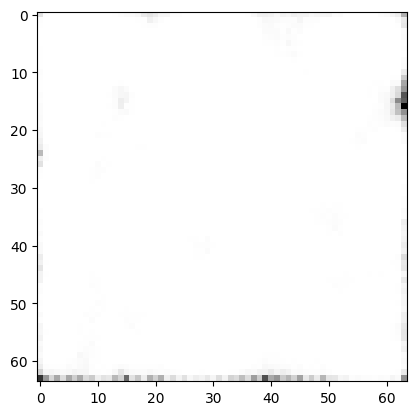

In [9]:
z = torch.randn(1, 16, 32, 32).to(device)
tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

# generate image using avg z

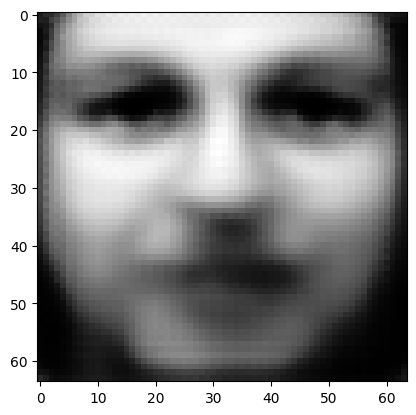

In [10]:
def init_avg_z():
    z = torch.zeros(1, 16, 32, 32).to(device)
    for i in range(200):
        z += d2c_encoder(train_data[i])
    z = z/200
    return z
avg = d2c_decoder(init_avg_z()).detach()
tensor_to_picture(avg.detach().cpu().numpy()[0][0])

In [11]:
def optimize_z(z, decoder, classifier, optimizer_z, criterion, target, reg):
    decoder.eval()
    classifier.eval()
    optimizer_z.zero_grad()
    generated = decoder(z)
    result = classifier(generated)
    print(torch.softmax(result,-1))
    loss = criterion(result,attack_targets[target])
    loss += torch.sum((generated-avg)**2) * reg
    loss.backward()
    optimizer_z.step()
    return loss.item()

In [12]:
def optimize_z_eps(z, eps, lr, reg, lr_decay, target=8):
    for epoch in range(eps): 
        optimizer_z = optim.SGD([z], lr=lr*lr_decay**epoch, momentum=0.9, nesterov=False)
        criterion = nn.CrossEntropyLoss(reduction = 'sum')
        epoch_loss = optimize_z(z, d2c_decoder, classifier, optimizer_z, criterion, target, reg)
        print("loss(generator): ", epoch_loss)
        if epoch%5 == 0:
            tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

In [13]:
for param in classifier.parameters():
    param.requires_grad = False
for param in d2c_decoder.parameters():
    param.requires_grad = False   
z = init_avg_z().detach()
z = z.requires_grad_(True)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.663237571716309


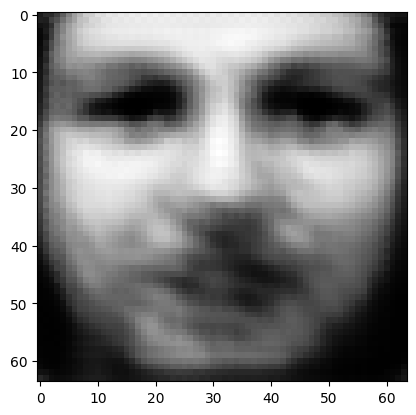

tensor([[3.1966e-03, 2.2439e-03, 5.8535e-03, 6.2701e-03, 5.5609e-02, 1.0540e-03,
         1.5293e-03, 1.3789e-03, 2.3743e-03, 1.9755e-04, 7.6214e-04, 1.4857e-03,
         7.4437e-03, 1.9614e-02, 2.1965e-03, 7.9012e-04, 2.1442e-02, 4.1533e-03,
         2.4437e-03, 7.2621e-04, 1.6572e-02, 4.2543e-03, 2.8886e-01, 2.4008e-03,
         1.0754e-01, 7.0960e-02, 2.3481e-03, 2.3290e-03, 1.1149e-03, 1.0383e-02,
         3.0736e-03, 7.3155e-03, 1.0189e-02, 1.2360e-02, 1.6596e-02, 2.7571e-02,
         2.3628e-01, 2.7243e-02, 7.3762e-03, 4.4747e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.745678901672363
tensor([[0.0038, 0.0021, 0.0038, 0.0036, 0.0652, 0.0012, 0.0022, 0.0020, 0.0027,
         0.0004, 0.0012, 0.0018, 0.0053, 0.0235, 0.0036, 0.0009, 0.0221, 0.0082,
         0.0023, 0.0009, 0.0213, 0.0051, 0.2122, 0.0029, 0.1634, 0.0490, 0.0023,
         0.0029, 0.0008, 0.0071, 0.0023, 0.0131, 0.0166, 0.0120, 0.0135, 0.0604,
         0.2234, 0.0256, 0.0057, 0.0034]], d

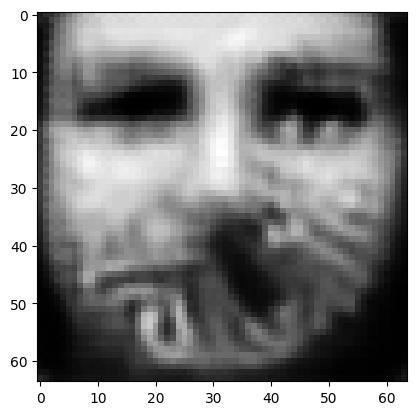

tensor([[0.1540, 0.0017, 0.0542, 0.0033, 0.0218, 0.0428, 0.0715, 0.0711, 0.0004,
         0.0026, 0.0030, 0.0059, 0.0025, 0.0005, 0.0057, 0.0185, 0.0254, 0.1756,
         0.0040, 0.0101, 0.0057, 0.0134, 0.0004, 0.1198, 0.0447, 0.0005, 0.0103,
         0.0236, 0.0131, 0.0023, 0.0007, 0.0129, 0.0162, 0.0056, 0.0043, 0.0066,
         0.0223, 0.0071, 0.0135, 0.0024]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.870972752571106
tensor([[0.2040, 0.0015, 0.0594, 0.0029, 0.0198, 0.0413, 0.0769, 0.0739, 0.0003,
         0.0024, 0.0022, 0.0050, 0.0018, 0.0003, 0.0046, 0.0206, 0.0220, 0.1663,
         0.0039, 0.0083, 0.0046, 0.0102, 0.0003, 0.1166, 0.0295, 0.0004, 0.0096,
         0.0220, 0.0148, 0.0019, 0.0004, 0.0100, 0.0114, 0.0041, 0.0039, 0.0047,
         0.0194, 0.0053, 0.0116, 0.0020]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5894321203231812
tensor([[2.6483e-01, 1.1949e-03, 6.8960e-02, 2.2129e-03, 1.6976e-02, 4.3250e-02,
         7

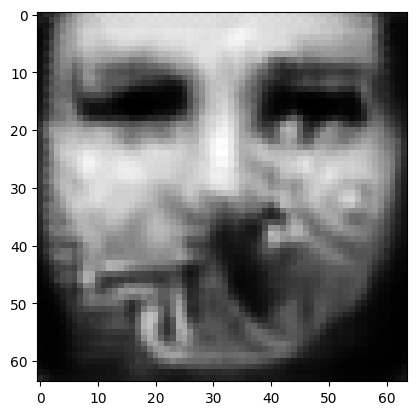

tensor([[4.4752e-01, 7.5219e-04, 4.0339e-02, 1.4119e-03, 9.6345e-03, 2.9924e-02,
         6.5700e-02, 8.0012e-02, 2.5983e-05, 1.5510e-03, 1.1052e-03, 1.4210e-03,
         4.8215e-04, 4.2237e-05, 2.1987e-03, 2.0868e-02, 1.6417e-02, 9.4052e-02,
         3.8770e-03, 3.4797e-03, 1.3091e-03, 3.5393e-03, 3.0353e-05, 1.0674e-01,
         5.5113e-03, 7.2558e-05, 3.8880e-03, 1.7466e-02, 1.6332e-02, 9.5272e-04,
         6.4731e-05, 3.5216e-03, 3.6827e-03, 1.1455e-03, 1.8068e-03, 1.2533e-03,
         5.7484e-03, 1.7822e-03, 3.8307e-03, 4.9968e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.8040229082107544
tensor([[4.9716e-01, 5.4851e-04, 3.5169e-02, 1.1220e-03, 8.3151e-03, 2.3398e-02,
         5.8189e-02, 8.1474e-02, 1.5836e-05, 1.3919e-03, 1.0117e-03, 9.0345e-04,
         3.5574e-04, 2.8798e-05, 1.9401e-03, 1.8054e-02, 1.6909e-02, 7.3788e-02,
         3.6657e-03, 2.7242e-03, 9.5951e-04, 2.8510e-03, 1.8955e-05, 1.1368e-01,
         4.5115e-03, 5.8530e-05, 2.3989e-03

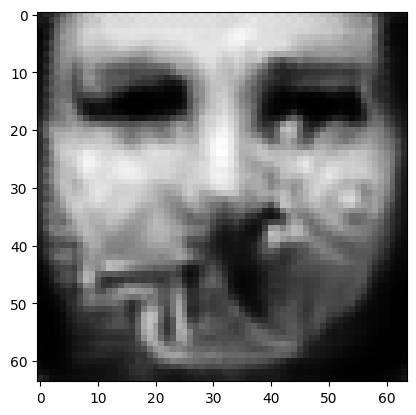

tensor([[6.5859e-01, 3.2704e-04, 2.3881e-02, 7.9836e-04, 4.3876e-03, 1.4379e-02,
         4.4604e-02, 5.4237e-02, 4.9231e-06, 1.2700e-03, 7.5917e-04, 4.4428e-04,
         1.9599e-04, 1.0429e-05, 1.1169e-03, 1.6190e-02, 1.2715e-02, 4.0230e-02,
         3.5483e-03, 1.6173e-03, 4.9391e-04, 1.3792e-03, 5.1788e-06, 8.2821e-02,
         1.6184e-03, 2.3827e-05, 1.3563e-03, 1.0028e-02, 1.4224e-02, 5.3290e-04,
         1.6840e-05, 1.1280e-03, 1.3863e-03, 4.4634e-04, 9.2083e-04, 4.0592e-04,
         1.6733e-03, 8.0297e-04, 1.2958e-03, 1.3730e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.41765883564949036
tensor([[6.8693e-01, 3.1592e-04, 2.1808e-02, 7.3846e-04, 3.7679e-03, 1.4620e-02,
         4.4915e-02, 5.0252e-02, 4.1306e-06, 1.1959e-03, 6.9848e-04, 4.4330e-04,
         1.7931e-04, 8.5525e-06, 9.8333e-04, 1.5861e-02, 1.0204e-02, 4.0668e-02,
         3.3434e-03, 1.5358e-03, 4.3923e-04, 1.1795e-03, 3.9924e-06, 6.7232e-02,
         1.2678e-03, 1.8259e-05, 1.4462e-0

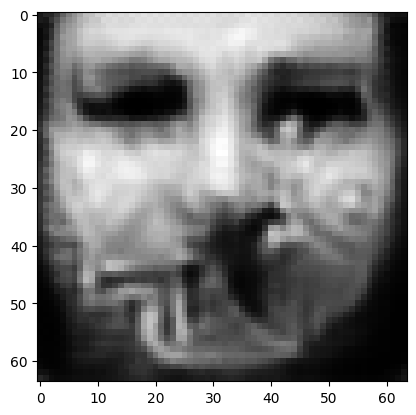

tensor([[7.5952e-01, 2.4563e-04, 1.6412e-02, 5.6882e-04, 2.5976e-03, 1.1018e-02,
         3.7608e-02, 3.7326e-02, 2.1824e-06, 1.0496e-03, 6.0341e-04, 3.1631e-04,
         1.3010e-04, 5.2550e-06, 7.2362e-04, 1.3731e-02, 7.3479e-03, 3.0474e-02,
         2.8324e-03, 1.1505e-03, 3.0615e-04, 7.8036e-04, 1.7942e-06, 5.1469e-02,
         6.9542e-04, 1.0282e-05, 1.0888e-03, 6.3463e-03, 1.0581e-02, 3.1476e-04,
         6.8963e-06, 7.8952e-04, 7.7265e-04, 2.6980e-04, 6.7287e-04, 2.4832e-04,
         8.6002e-04, 4.8465e-04, 5.6738e-04, 7.4255e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2750740051269531
tensor([[7.7226e-01, 2.3865e-04, 1.5065e-02, 5.4751e-04, 2.3873e-03, 1.0115e-02,
         3.6598e-02, 3.4143e-02, 1.9647e-06, 1.0245e-03, 5.9786e-04, 2.9464e-04,
         1.2356e-04, 5.0251e-06, 7.1802e-04, 1.3489e-02, 6.8586e-03, 2.9320e-02,
         2.7556e-03, 1.1180e-03, 2.8965e-04, 7.1172e-04, 1.5152e-06, 4.9215e-02,
         6.2131e-04, 8.9241e-06, 1.0303e-03

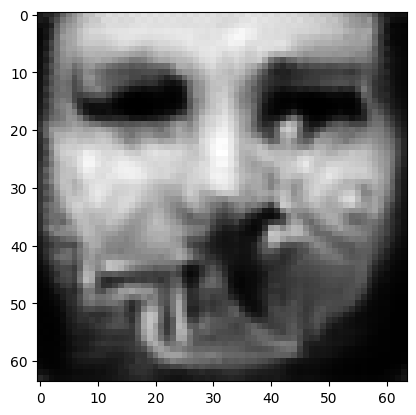

tensor([[8.1014e-01, 2.0822e-04, 1.2632e-02, 4.7326e-04, 1.9731e-03, 8.8522e-03,
         3.0938e-02, 3.0756e-02, 1.3083e-06, 9.3932e-04, 5.0098e-04, 2.5000e-04,
         9.6812e-05, 3.3953e-06, 5.5819e-04, 1.1886e-02, 5.2688e-03, 2.4038e-02,
         2.3586e-03, 9.1283e-04, 2.1860e-04, 5.3825e-04, 9.0164e-07, 3.9017e-02,
         4.3175e-04, 6.1509e-06, 8.8573e-04, 4.6946e-03, 7.8940e-03, 2.1647e-04,
         4.1598e-06, 6.0846e-04, 5.0110e-04, 1.9516e-04, 5.3782e-04, 1.8001e-04,
         5.5163e-04, 3.4644e-04, 3.3426e-04, 4.7631e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21054361760616302
tensor([[8.1686e-01, 2.0538e-04, 1.2181e-02, 4.6717e-04, 1.9203e-03, 8.5753e-03,
         2.9832e-02, 2.9579e-02, 1.2177e-06, 9.1721e-04, 4.8499e-04, 2.4296e-04,
         9.2697e-05, 3.2288e-06, 5.4601e-04, 1.1778e-02, 5.0614e-03, 2.3487e-02,
         2.2894e-03, 8.7740e-04, 2.1056e-04, 5.0282e-04, 8.1672e-07, 3.7119e-02,
         4.0559e-04, 5.6741e-06, 8.6199e-0

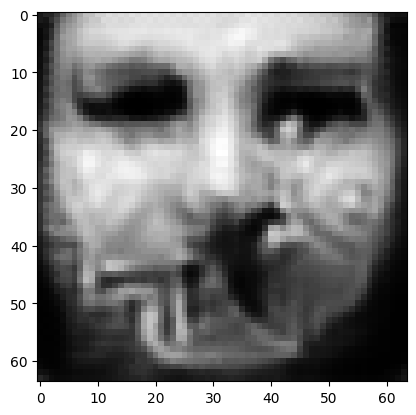

tensor([[8.3863e-01, 1.8695e-04, 1.0715e-02, 4.1764e-04, 1.6470e-03, 7.7415e-03,
         2.6431e-02, 2.6840e-02, 9.1792e-07, 8.2289e-04, 4.2571e-04, 2.2226e-04,
         7.6856e-05, 2.5373e-06, 4.7242e-04, 1.0985e-02, 4.1613e-03, 2.0974e-02,
         2.0396e-03, 7.4599e-04, 1.7782e-04, 4.1021e-04, 5.7088e-07, 3.1853e-02,
         3.1091e-04, 4.1906e-06, 7.7538e-04, 3.8292e-03, 6.3455e-03, 1.6290e-04,
         2.9231e-06, 5.0725e-04, 3.5452e-04, 1.5536e-04, 4.6469e-04, 1.4186e-04,
         4.3048e-04, 2.6869e-04, 2.2745e-04, 3.4762e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.175982266664505
tensor([[8.4327e-01, 1.8212e-04, 1.0434e-02, 4.0690e-04, 1.5887e-03, 7.5703e-03,
         2.5644e-02, 2.6448e-02, 8.6163e-07, 8.1087e-04, 4.1602e-04, 2.1688e-04,
         7.3642e-05, 2.3837e-06, 4.5339e-04, 1.0770e-02, 3.9814e-03, 2.0248e-02,
         1.9927e-03, 7.2086e-04, 1.6985e-04, 3.9111e-04, 5.2127e-07, 3.0740e-02,
         2.9130e-04, 3.9351e-06, 7.5267e-04,

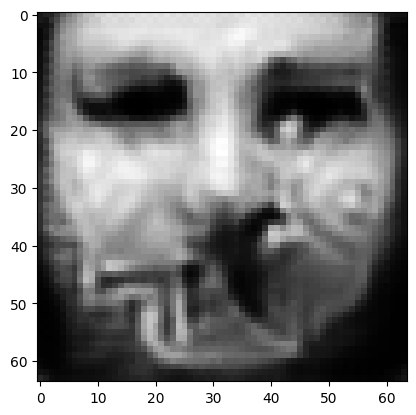

tensor([[8.6052e-01, 1.7114e-04, 9.4703e-03, 3.8238e-04, 1.3969e-03, 7.0142e-03,
         2.2878e-02, 2.4214e-02, 6.7653e-07, 7.5135e-04, 3.6819e-04, 2.0503e-04,
         6.2701e-05, 1.9016e-06, 3.9234e-04, 1.0312e-02, 3.3010e-03, 1.8167e-02,
         1.8195e-03, 6.2125e-04, 1.4688e-04, 3.2023e-04, 3.7217e-07, 2.5940e-02,
         2.2170e-04, 2.9762e-06, 6.9874e-04, 3.1198e-03, 5.3018e-03, 1.2530e-04,
         2.1773e-06, 4.3274e-04, 2.5427e-04, 1.2719e-04, 4.0121e-04, 1.1387e-04,
         3.3364e-04, 2.1656e-04, 1.6475e-04, 2.7178e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15021975338459015
tensor([[8.6395e-01, 1.6888e-04, 9.2327e-03, 3.7857e-04, 1.3673e-03, 6.8413e-03,
         2.2241e-02, 2.3608e-02, 6.4357e-07, 7.4156e-04, 3.6012e-04, 2.0196e-04,
         6.0795e-05, 1.8263e-06, 3.8255e-04, 1.0263e-02, 3.1999e-03, 1.7712e-02,
         1.7880e-03, 6.0305e-04, 1.4320e-04, 3.0878e-04, 3.4956e-07, 2.5250e-02,
         2.1131e-04, 2.8211e-06, 6.8183e-0

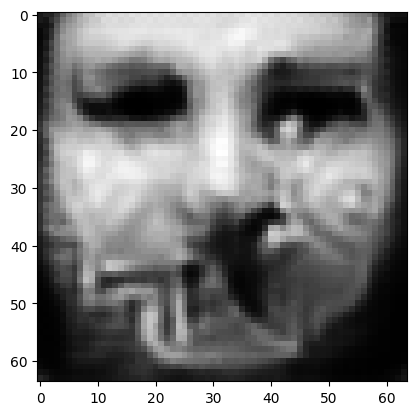

tensor([[8.7537e-01, 1.5773e-04, 8.3938e-03, 3.5291e-04, 1.2341e-03, 6.2507e-03,
         2.0472e-02, 2.2352e-02, 5.4403e-07, 6.8941e-04, 3.2669e-04, 1.8851e-04,
         5.3455e-05, 1.5280e-06, 3.4138e-04, 9.7109e-03, 2.7861e-03, 1.6174e-02,
         1.6482e-03, 5.4256e-04, 1.2803e-04, 2.7309e-04, 2.7953e-07, 2.2702e-02,
         1.7836e-04, 2.3030e-06, 6.2636e-04, 2.6911e-03, 4.4834e-03, 1.0387e-04,
         1.7777e-06, 3.8096e-04, 2.0209e-04, 1.0855e-04, 3.5822e-04, 9.7602e-05,
         2.7632e-04, 1.8367e-04, 1.3084e-04, 2.2205e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13310670852661133
tensor([[8.7804e-01, 1.5571e-04, 8.2373e-03, 3.4874e-04, 1.2094e-03, 6.1568e-03,
         2.0038e-02, 2.1990e-02, 5.2745e-07, 6.8359e-04, 3.2066e-04, 1.8591e-04,
         5.2024e-05, 1.4661e-06, 3.3301e-04, 9.6414e-03, 2.6881e-03, 1.5843e-02,
         1.6177e-03, 5.3125e-04, 1.2497e-04, 2.6510e-04, 2.6368e-07, 2.1936e-02,
         1.7093e-04, 2.2006e-06, 6.1752e-0

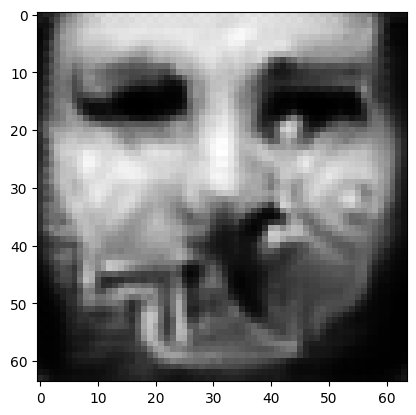

tensor([[8.8729e-01, 1.4600e-04, 7.6328e-03, 3.2873e-04, 1.1246e-03, 5.7160e-03,
         1.8318e-02, 2.0494e-02, 4.6170e-07, 6.6189e-04, 3.0273e-04, 1.7639e-04,
         4.6736e-05, 1.2682e-06, 3.0315e-04, 9.4209e-03, 2.4029e-03, 1.4408e-02,
         1.5102e-03, 4.8894e-04, 1.1516e-04, 2.4373e-04, 2.1493e-07, 2.0168e-02,
         1.4818e-04, 1.8882e-06, 5.6730e-04, 2.4037e-03, 3.9422e-03, 9.1178e-05,
         1.5199e-06, 3.3993e-04, 1.6402e-04, 9.5818e-05, 3.3225e-04, 8.5989e-05,
         2.3757e-04, 1.5952e-04, 1.0942e-04, 1.8911e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11958480626344681
tensor([[8.8933e-01, 1.4447e-04, 7.4964e-03, 3.2548e-04, 1.1082e-03, 5.6321e-03,
         1.7947e-02, 2.0124e-02, 4.5093e-07, 6.5540e-04, 2.9781e-04, 1.7436e-04,
         4.5717e-05, 1.2279e-06, 2.9734e-04, 9.3883e-03, 2.3378e-03, 1.4169e-02,
         1.4858e-03, 4.7942e-04, 1.1323e-04, 2.3834e-04, 2.0530e-07, 1.9696e-02,
         1.4383e-04, 1.8205e-06, 5.5871e-0

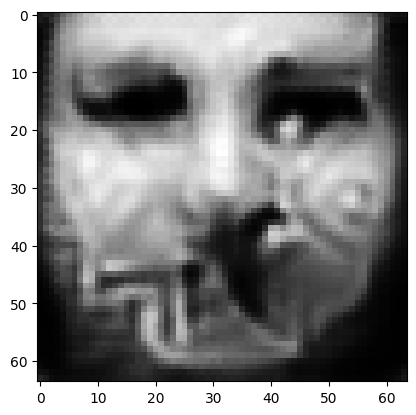

tensor([[8.9666e-01, 1.3916e-04, 6.9394e-03, 3.0358e-04, 1.0159e-03, 5.3437e-03,
         1.6784e-02, 1.8640e-02, 4.0969e-07, 6.2482e-04, 2.7990e-04, 1.6806e-04,
         4.2342e-05, 1.0874e-06, 2.7587e-04, 9.3007e-03, 2.0658e-03, 1.3431e-02,
         1.3904e-03, 4.5459e-04, 1.0662e-04, 2.2239e-04, 1.7322e-07, 1.8037e-02,
         1.2524e-04, 1.5520e-06, 5.3488e-04, 2.1631e-03, 3.4805e-03, 8.1130e-05,
         1.3150e-06, 3.1274e-04, 1.3733e-04, 8.5752e-05, 3.1087e-04, 7.8321e-05,
         2.0720e-04, 1.3883e-04, 9.3665e-05, 1.6583e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10907378047704697
tensor([[8.9821e-01, 1.3769e-04, 6.7904e-03, 2.9824e-04, 9.9288e-04, 5.2525e-03,
         1.6584e-02, 1.8266e-02, 4.0150e-07, 6.1431e-04, 2.7517e-04, 1.6554e-04,
         4.1627e-05, 1.0598e-06, 2.7240e-04, 9.2617e-03, 2.0163e-03, 1.3303e-02,
         1.3734e-03, 4.4928e-04, 1.0532e-04, 2.1821e-04, 1.6766e-07, 1.7765e-02,
         1.2186e-04, 1.4955e-06, 5.2773e-0

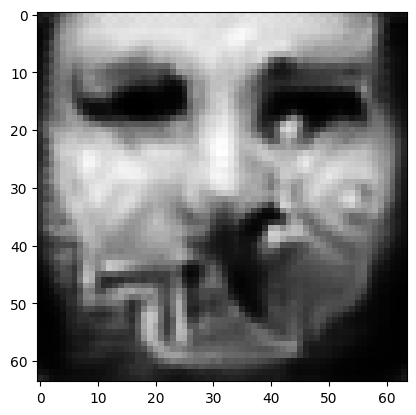

tensor([[9.0363e-01, 1.3331e-04, 6.2964e-03, 2.8275e-04, 9.3351e-04, 4.9750e-03,
         1.5739e-02, 1.7074e-02, 3.7013e-07, 5.8274e-04, 2.5887e-04, 1.5708e-04,
         3.9140e-05, 9.6784e-07, 2.6022e-04, 9.1493e-03, 1.8424e-03, 1.2875e-02,
         1.2979e-03, 4.3010e-04, 1.0056e-04, 2.0352e-04, 1.4727e-07, 1.6701e-02,
         1.1044e-04, 1.3157e-06, 5.0213e-04, 1.9750e-03, 3.1149e-03, 7.3663e-05,
         1.1595e-06, 2.9065e-04, 1.1992e-04, 7.7169e-05, 2.9671e-04, 7.3203e-05,
         1.8538e-04, 1.2288e-04, 8.1266e-05, 1.4663e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1013389378786087
tensor([[9.0483e-01, 1.3206e-04, 6.1911e-03, 2.7996e-04, 9.2084e-04, 4.8970e-03,
         1.5530e-02, 1.6771e-02, 3.6349e-07, 5.7678e-04, 2.5547e-04, 1.5470e-04,
         3.8584e-05, 9.4878e-07, 2.5744e-04, 9.1392e-03, 1.8157e-03, 1.2715e-02,
         1.2886e-03, 4.2483e-04, 9.9651e-05, 1.9992e-04, 1.4338e-07, 1.6553e-02,
         1.0807e-04, 1.2830e-06, 4.9459e-04

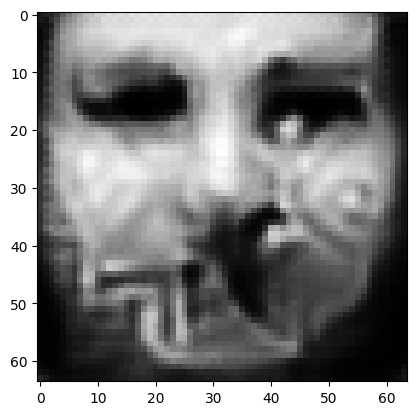

tensor([[9.0912e-01, 1.2742e-04, 5.8484e-03, 2.6747e-04, 8.7325e-04, 4.6821e-03,
         1.4830e-02, 1.5933e-02, 3.3733e-07, 5.5436e-04, 2.4368e-04, 1.4790e-04,
         3.6466e-05, 8.7777e-07, 2.4598e-04, 8.9937e-03, 1.6879e-03, 1.2226e-02,
         1.2306e-03, 4.0691e-04, 9.5352e-05, 1.8835e-04, 1.2797e-07, 1.5752e-02,
         9.9161e-05, 1.1610e-06, 4.7198e-04, 1.8313e-03, 2.8622e-03, 6.8225e-05,
         1.0483e-06, 2.7200e-04, 1.0692e-04, 7.0751e-05, 2.8464e-04, 6.8694e-05,
         1.6907e-04, 1.1176e-04, 7.2287e-05, 1.3224e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09527378529310226
tensor([[9.1014e-01, 1.2661e-04, 5.7656e-03, 2.6499e-04, 8.6232e-04, 4.6335e-03,
         1.4676e-02, 1.5726e-02, 3.3197e-07, 5.4739e-04, 2.4092e-04, 1.4643e-04,
         3.5986e-05, 8.6255e-07, 2.4369e-04, 8.9638e-03, 1.6576e-03, 1.2161e-02,
         1.2146e-03, 4.0283e-04, 9.4595e-05, 1.8499e-04, 1.2423e-07, 1.5507e-02,
         9.7006e-05, 1.1283e-06, 4.6709e-0

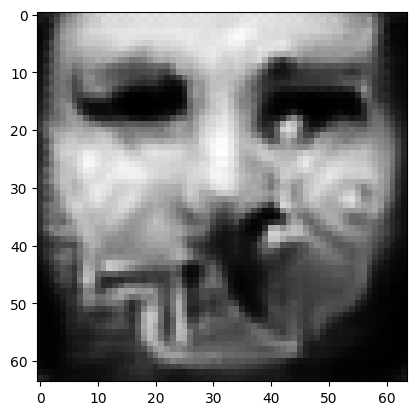

tensor([[9.1397e-01, 1.2190e-04, 5.4990e-03, 2.5400e-04, 8.2337e-04, 4.4345e-03,
         1.3975e-02, 1.5044e-02, 3.0749e-07, 5.3433e-04, 2.3256e-04, 1.4046e-04,
         3.4101e-05, 8.0129e-07, 2.3221e-04, 8.8246e-03, 1.5593e-03, 1.1524e-02,
         1.1729e-03, 3.8657e-04, 9.0478e-05, 1.7547e-04, 1.1092e-07, 1.4912e-02,
         8.9066e-05, 1.0381e-06, 4.4202e-04, 1.7149e-03, 2.6594e-03, 6.3502e-05,
         9.5835e-07, 2.5437e-04, 9.5955e-05, 6.5786e-05, 2.7223e-04, 6.4198e-05,
         1.5486e-04, 1.0231e-04, 6.4917e-05, 1.1954e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08995738625526428
tensor([[9.1483e-01, 1.2078e-04, 5.4385e-03, 2.5078e-04, 8.1282e-04, 4.4079e-03,
         1.3852e-02, 1.4928e-02, 3.0170e-07, 5.3058e-04, 2.3023e-04, 1.3933e-04,
         3.3661e-05, 7.8495e-07, 2.2892e-04, 8.7762e-03, 1.5289e-03, 1.1410e-02,
         1.1591e-03, 3.8342e-04, 8.9243e-05, 1.7324e-04, 1.0781e-07, 1.4706e-02,
         8.7015e-05, 1.0139e-06, 4.3832e-0

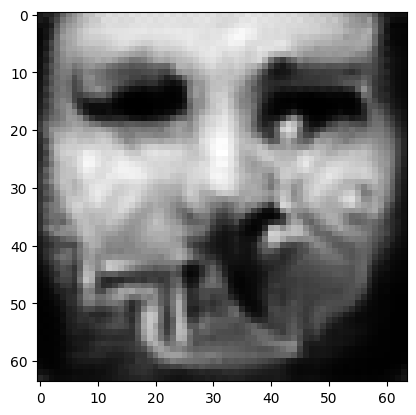

tensor([[9.1804e-01, 1.1644e-04, 5.1858e-03, 2.3941e-04, 7.7766e-04, 4.2611e-03,
         1.3354e-02, 1.4358e-02, 2.8219e-07, 5.1698e-04, 2.2188e-04, 1.3446e-04,
         3.2171e-05, 7.3100e-07, 2.1813e-04, 8.6208e-03, 1.4290e-03, 1.1003e-02,
         1.1139e-03, 3.7223e-04, 8.5235e-05, 1.6549e-04, 9.7613e-08, 1.4088e-02,
         8.0607e-05, 9.3283e-07, 4.2169e-04, 1.6131e-03, 2.4713e-03, 5.8772e-05,
         8.7559e-07, 2.4269e-04, 8.7934e-05, 6.1533e-05, 2.5789e-04, 6.0535e-05,
         1.4273e-04, 9.4786e-05, 5.9273e-05, 1.0902e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08551420271396637
tensor([[9.1882e-01, 1.1524e-04, 5.1285e-03, 2.3676e-04, 7.6947e-04, 4.2289e-03,
         1.3229e-02, 1.4252e-02, 2.7703e-07, 5.1403e-04, 2.2000e-04, 1.3319e-04,
         3.1785e-05, 7.1711e-07, 2.1529e-04, 8.5725e-03, 1.4057e-03, 1.0884e-02,
         1.1028e-03, 3.6921e-04, 8.4104e-05, 1.6359e-04, 9.4887e-08, 1.3928e-02,
         7.9023e-05, 9.1396e-07, 4.1693e-0

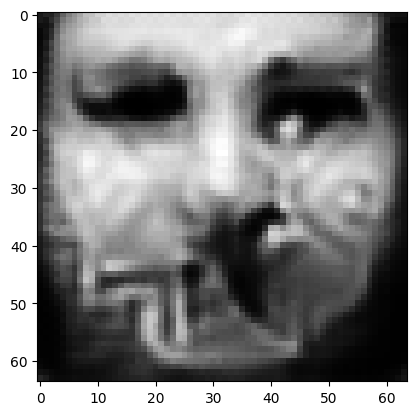

tensor([[9.2168e-01, 1.1141e-04, 4.9075e-03, 2.2788e-04, 7.3989e-04, 4.0973e-03,
         1.2762e-02, 1.3814e-02, 2.5926e-07, 5.0195e-04, 2.1220e-04, 1.2855e-04,
         3.0356e-05, 6.6593e-07, 2.0514e-04, 8.4406e-03, 1.3206e-03, 1.0490e-02,
         1.0642e-03, 3.5758e-04, 8.0360e-05, 1.5598e-04, 8.5639e-08, 1.3351e-02,
         7.3222e-05, 8.4269e-07, 4.0063e-04, 1.5238e-03, 2.3082e-03, 5.4456e-05,
         8.0395e-07, 2.3105e-04, 8.0358e-05, 5.7580e-05, 2.4452e-04, 5.7105e-05,
         1.3204e-04, 8.7924e-05, 5.4353e-05, 9.9541e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08155277371406555
tensor([[9.2237e-01, 1.1070e-04, 4.8491e-03, 2.2587e-04, 7.3287e-04, 4.0655e-03,
         1.2656e-02, 1.3688e-02, 2.5558e-07, 4.9813e-04, 2.1010e-04, 1.2742e-04,
         3.0053e-05, 6.5479e-07, 2.0318e-04, 8.4129e-03, 1.2989e-03, 1.0428e-02,
         1.0544e-03, 3.5509e-04, 7.9553e-05, 1.5399e-04, 8.3584e-08, 1.3199e-02,
         7.1905e-05, 8.2430e-07, 3.9745e-0

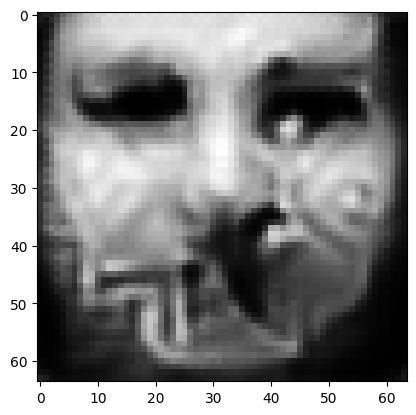

tensor([[9.2485e-01, 1.0734e-04, 4.6578e-03, 2.1823e-04, 7.0784e-04, 3.9579e-03,
         1.2272e-02, 1.3277e-02, 2.4102e-07, 4.8630e-04, 2.0367e-04, 1.2345e-04,
         2.8917e-05, 6.1375e-07, 1.9444e-04, 8.2785e-03, 1.2275e-03, 1.0152e-02,
         1.0167e-03, 3.4574e-04, 7.6401e-05, 1.4704e-04, 7.6375e-08, 1.2667e-02,
         6.7291e-05, 7.6517e-07, 3.8425e-04, 1.4443e-03, 2.1557e-03, 5.0594e-05,
         7.4143e-07, 2.2146e-04, 7.4108e-05, 5.4033e-05, 2.3440e-04, 5.4555e-05,
         1.2335e-04, 8.2122e-05, 5.0075e-05, 9.1848e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07812798768281937
tensor([[9.2540e-01, 1.0662e-04, 4.6150e-03, 2.1657e-04, 7.0253e-04, 3.9316e-03,
         1.2181e-02, 1.3180e-02, 2.3790e-07, 4.8386e-04, 2.0223e-04, 1.2253e-04,
         2.8678e-05, 6.0553e-07, 1.9267e-04, 8.2468e-03, 1.2123e-03, 1.0087e-02,
         1.0091e-03, 3.4373e-04, 7.5710e-05, 1.4557e-04, 7.4937e-08, 1.2560e-02,
         6.6352e-05, 7.5337e-07, 3.8127e-0

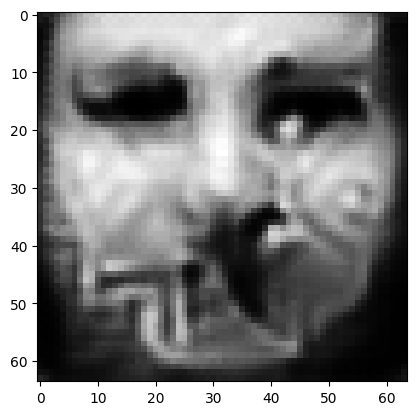

tensor([[9.2760e-01, 1.0389e-04, 4.4303e-03, 2.0870e-04, 6.7914e-04, 3.8383e-03,
         1.1826e-02, 1.2837e-02, 2.2452e-07, 4.7307e-04, 1.9642e-04, 1.1897e-04,
         2.7612e-05, 5.6942e-07, 1.8540e-04, 8.1275e-03, 1.1492e-03, 9.8196e-03,
         9.7501e-04, 3.3615e-04, 7.2674e-05, 1.4013e-04, 6.8823e-08, 1.2107e-02,
         6.2272e-05, 7.0318e-07, 3.6930e-04, 1.3753e-03, 2.0277e-03, 4.7369e-05,
         6.8727e-07, 2.1384e-04, 6.8973e-05, 5.1143e-05, 2.2482e-04, 5.2250e-05,
         1.1605e-04, 7.7359e-05, 4.6464e-05, 8.5159e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07514955848455429
tensor([[9.2815e-01, 1.0326e-04, 4.3765e-03, 2.0671e-04, 6.7257e-04, 3.8100e-03,
         1.1757e-02, 1.2731e-02, 2.2160e-07, 4.6961e-04, 1.9476e-04, 1.1801e-04,
         2.7368e-05, 5.6172e-07, 1.8387e-04, 8.1003e-03, 1.1339e-03, 9.7789e-03,
         9.6699e-04, 3.3457e-04, 7.2004e-05, 1.3863e-04, 6.7576e-08, 1.1988e-02,
         6.1338e-05, 6.9002e-07, 3.6696e-0

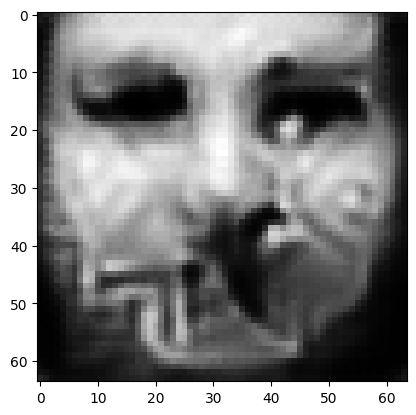

tensor([[9.3042e-01, 1.0053e-04, 4.1874e-03, 1.9923e-04, 6.5023e-04, 3.7029e-03,
         1.1351e-02, 1.2319e-02, 2.0883e-07, 4.6401e-04, 1.8862e-04, 1.1408e-04,
         2.6304e-05, 5.2588e-07, 1.7685e-04, 8.0539e-03, 1.0760e-03, 9.4329e-03,
         9.4306e-04, 3.2699e-04, 6.9028e-05, 1.3368e-04, 6.2223e-08, 1.1576e-02,
         5.7235e-05, 6.4522e-07, 3.5521e-04, 1.3013e-03, 1.9154e-03, 4.4498e-05,
         6.3574e-07, 2.0709e-04, 6.3879e-05, 4.8249e-05, 2.1544e-04, 4.9827e-05,
         1.0867e-04, 7.2772e-05, 4.3042e-05, 7.9260e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07212395966053009
tensor([[9.3095e-01, 9.9944e-05, 4.1431e-03, 1.9734e-04, 6.4415e-04, 3.6807e-03,
         1.1262e-02, 1.2224e-02, 2.0593e-07, 4.6231e-04, 1.8699e-04, 1.1320e-04,
         2.6040e-05, 5.1689e-07, 1.7510e-04, 8.0453e-03, 1.0613e-03, 9.3566e-03,
         9.3744e-04, 3.2514e-04, 6.8311e-05, 1.3246e-04, 6.0985e-08, 1.1460e-02,
         5.6171e-05, 6.3361e-07, 3.5300e-0

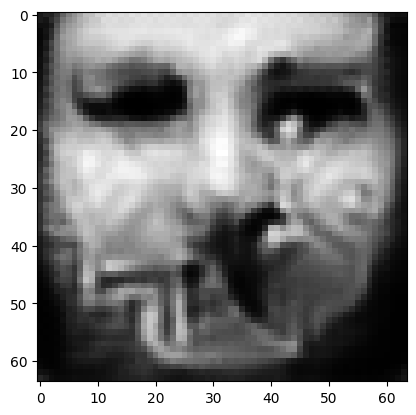

tensor([[9.3297e-01, 9.7588e-05, 3.9848e-03, 1.9036e-04, 6.2080e-04, 3.6034e-03,
         1.0949e-02, 1.1887e-02, 1.9519e-07, 4.5564e-04, 1.8091e-04, 1.1005e-04,
         2.5086e-05, 4.8339e-07, 1.6831e-04, 7.9873e-03, 1.0045e-03, 9.0864e-03,
         9.1363e-04, 3.1858e-04, 6.5511e-05, 1.2768e-04, 5.6352e-08, 1.0980e-02,
         5.2294e-05, 5.9084e-07, 3.4494e-04, 1.2320e-03, 1.8178e-03, 4.1728e-05,
         5.8556e-07, 2.0164e-04, 5.9265e-05, 4.5561e-05, 2.0635e-04, 4.7438e-05,
         1.0158e-04, 6.8477e-05, 4.0011e-05, 7.4588e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06937706470489502
tensor([[9.3345e-01, 9.6888e-05, 3.9511e-03, 1.8886e-04, 6.1651e-04, 3.5797e-03,
         1.0866e-02, 1.1811e-02, 1.9266e-07, 4.5403e-04, 1.7956e-04, 1.0920e-04,
         2.4850e-05, 4.7602e-07, 1.6669e-04, 7.9621e-03, 9.9406e-04, 9.0155e-03,
         9.0794e-04, 3.1653e-04, 6.4867e-05, 1.2657e-04, 5.5322e-08, 1.0891e-02,
         5.1543e-05, 5.8271e-07, 3.4191e-0

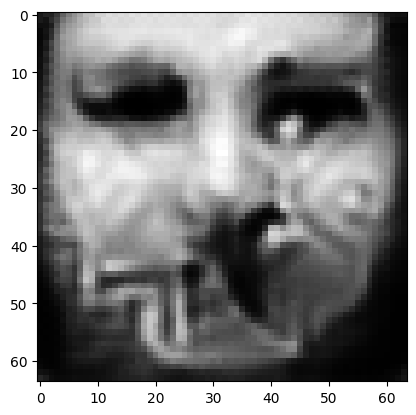

tensor([[9.3524e-01, 9.4596e-05, 3.8124e-03, 1.8284e-04, 5.9971e-04, 3.4882e-03,
         1.0549e-02, 1.1506e-02, 1.8355e-07, 4.4867e-04, 1.7421e-04, 1.0606e-04,
         2.3987e-05, 4.4890e-07, 1.6121e-04, 7.9051e-03, 9.5169e-04, 8.7530e-03,
         8.8877e-04, 3.0952e-04, 6.2501e-05, 1.2283e-04, 5.1587e-08, 1.0543e-02,
         4.8661e-05, 5.5115e-07, 3.3211e-04, 1.1748e-03, 1.7407e-03, 3.9462e-05,
         5.4668e-07, 1.9595e-04, 5.5380e-05, 4.3292e-05, 1.9910e-04, 4.5360e-05,
         9.5957e-05, 6.5011e-05, 3.7495e-05, 7.0071e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06695690006017685
tensor([[9.3563e-01, 9.4174e-05, 3.7785e-03, 1.8143e-04, 5.9550e-04, 3.4651e-03,
         1.0476e-02, 1.1433e-02, 1.8156e-07, 4.4715e-04, 1.7306e-04, 1.0534e-04,
         2.3794e-05, 4.4313e-07, 1.6017e-04, 7.8976e-03, 9.4162e-04, 8.6957e-03,
         8.8495e-04, 3.0798e-04, 6.2001e-05, 1.2208e-04, 5.0774e-08, 1.0472e-02,
         4.7994e-05, 5.4373e-07, 3.2998e-0

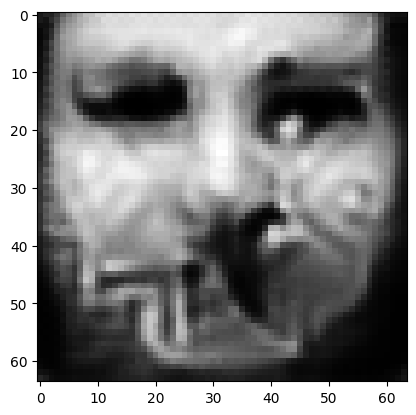

tensor([[9.3723e-01, 9.2230e-05, 3.6801e-03, 1.7653e-04, 5.8303e-04, 3.4248e-03,
         1.0227e-02, 1.1252e-02, 1.7446e-07, 4.4074e-04, 1.6768e-04, 1.0284e-04,
         2.3048e-05, 4.1690e-07, 1.5457e-04, 7.8018e-03, 8.9706e-04, 8.4934e-03,
         8.6058e-04, 3.0130e-04, 5.9563e-05, 1.1795e-04, 4.7299e-08, 9.9985e-03,
         4.5400e-05, 5.1441e-07, 3.2442e-04, 1.1247e-03, 1.6695e-03, 3.7230e-05,
         5.0994e-07, 1.9195e-04, 5.1890e-05, 4.1292e-05, 1.9282e-04, 4.3560e-05,
         9.0709e-05, 6.1706e-05, 3.5502e-05, 6.6716e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06483111530542374
tensor([[9.3760e-01, 9.1689e-05, 3.6645e-03, 1.7548e-04, 5.8139e-04, 3.4171e-03,
         1.0146e-02, 1.1218e-02, 1.7265e-07, 4.4085e-04, 1.6670e-04, 1.0226e-04,
         2.2877e-05, 4.1118e-07, 1.5325e-04, 7.7780e-03, 8.8844e-04, 8.4182e-03,
         8.5553e-04, 2.9975e-04, 5.8949e-05, 1.1721e-04, 4.6484e-08, 9.9069e-03,
         4.4856e-05, 5.0997e-07, 3.2245e-0

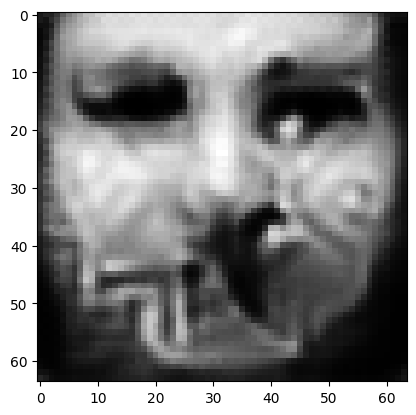

tensor([[9.3896e-01, 9.0379e-05, 3.5578e-03, 1.7110e-04, 5.6858e-04, 3.3534e-03,
         9.9226e-03, 1.0976e-02, 1.6706e-07, 4.3369e-04, 1.6251e-04, 9.9897e-05,
         2.2270e-05, 3.9355e-07, 1.4989e-04, 7.7195e-03, 8.5490e-04, 8.2723e-03,
         8.3817e-04, 2.9475e-04, 5.7292e-05, 1.1394e-04, 4.3993e-08, 9.5982e-03,
         4.2888e-05, 4.8541e-07, 3.1670e-04, 1.0824e-03, 1.6103e-03, 3.5555e-05,
         4.8134e-07, 1.8814e-04, 4.9116e-05, 3.9705e-05, 1.8805e-04, 4.2111e-05,
         8.6283e-05, 5.8955e-05, 3.3769e-05, 6.3771e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06298123300075531
tensor([[9.3927e-01, 8.9979e-05, 3.5348e-03, 1.6990e-04, 5.6543e-04, 3.3376e-03,
         9.8664e-03, 1.0924e-02, 1.6552e-07, 4.3249e-04, 1.6166e-04, 9.9393e-05,
         2.2123e-05, 3.8918e-07, 1.4892e-04, 7.7056e-03, 8.4751e-04, 8.2238e-03,
         8.3449e-04, 2.9347e-04, 5.6880e-05, 1.1338e-04, 4.3409e-08, 9.5474e-03,
         4.2401e-05, 4.8032e-07, 3.1482e-0

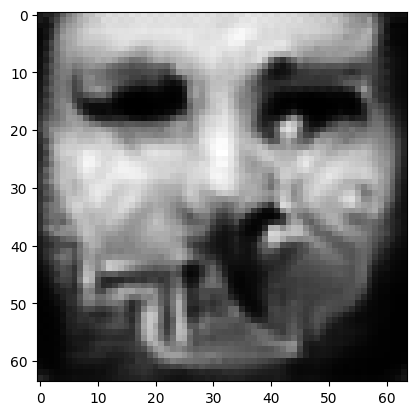

tensor([[9.4042e-01, 8.8659e-05, 3.4609e-03, 1.6624e-04, 5.5435e-04, 3.2882e-03,
         9.6665e-03, 1.0698e-02, 1.6057e-07, 4.2677e-04, 1.5856e-04, 9.7691e-05,
         2.1598e-05, 3.7535e-07, 1.4595e-04, 7.6575e-03, 8.2228e-04, 8.0895e-03,
         8.1849e-04, 2.8895e-04, 5.5603e-05, 1.1063e-04, 4.1343e-08, 9.2985e-03,
         4.0778e-05, 4.6136e-07, 3.0934e-04, 1.0474e-03, 1.5600e-03, 3.4181e-05,
         4.5836e-07, 1.8434e-04, 4.6815e-05, 3.8380e-05, 1.8418e-04, 4.0825e-05,
         8.2798e-05, 5.6738e-05, 3.2219e-05, 6.1249e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.061429984867572784
tensor([[9.4069e-01, 8.8380e-05, 3.4441e-03, 1.6558e-04, 5.5215e-04, 3.2771e-03,
         9.6178e-03, 1.0645e-02, 1.5949e-07, 4.2522e-04, 1.5777e-04, 9.7226e-05,
         2.1471e-05, 3.7216e-07, 1.4534e-04, 7.6495e-03, 8.1688e-04, 8.0610e-03,
         8.1468e-04, 2.8778e-04, 5.5320e-05, 1.0983e-04, 4.0829e-08, 9.2359e-03,
         4.0414e-05, 4.5681e-07, 3.0799e-

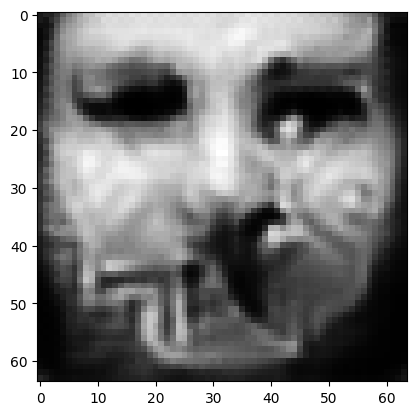

tensor([[9.4174e-01, 8.6860e-05, 3.3790e-03, 1.6191e-04, 5.4361e-04, 3.2386e-03,
         9.4335e-03, 1.0465e-02, 1.5483e-07, 4.1743e-04, 1.5488e-04, 9.5577e-05,
         2.0953e-05, 3.6048e-07, 1.4258e-04, 7.5632e-03, 7.9574e-04, 7.9684e-03,
         7.9458e-04, 2.8339e-04, 5.4063e-05, 1.0706e-04, 3.8874e-08, 8.9979e-03,
         3.9126e-05, 4.3971e-07, 3.0174e-04, 1.0167e-03, 1.5059e-03, 3.2804e-05,
         4.3656e-07, 1.8041e-04, 4.4713e-05, 3.7135e-05, 1.8116e-04, 3.9655e-05,
         7.9901e-05, 5.4668e-05, 3.0736e-05, 5.8814e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06002182886004448
tensor([[9.4199e-01, 8.6568e-05, 3.3582e-03, 1.6105e-04, 5.4157e-04, 3.2248e-03,
         9.3938e-03, 1.0426e-02, 1.5387e-07, 4.1599e-04, 1.5412e-04, 9.5042e-05,
         2.0846e-05, 3.5764e-07, 1.4200e-04, 7.5425e-03, 7.9047e-04, 7.9402e-03,
         7.9139e-04, 2.8262e-04, 5.3734e-05, 1.0654e-04, 3.8476e-08, 8.9564e-03,
         3.8825e-05, 4.3594e-07, 3.0030e-0

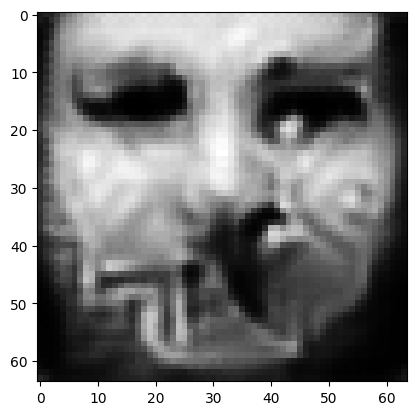

tensor([[9.4289e-01, 8.5303e-05, 3.3015e-03, 1.5811e-04, 5.3359e-04, 3.1898e-03,
         9.2387e-03, 1.0261e-02, 1.5002e-07, 4.0971e-04, 1.5161e-04, 9.3584e-05,
         2.0413e-05, 3.4787e-07, 1.3976e-04, 7.4810e-03, 7.7271e-04, 7.8553e-03,
         7.7620e-04, 2.7903e-04, 5.2703e-05, 1.0412e-04, 3.6890e-08, 8.7572e-03,
         3.7682e-05, 4.2139e-07, 2.9522e-04, 9.8943e-04, 1.4588e-03, 3.1655e-05,
         4.1856e-07, 1.7720e-04, 4.2984e-05, 3.6066e-05, 1.7819e-04, 3.8698e-05,
         7.7348e-05, 5.2917e-05, 2.9501e-05, 5.6711e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05880987271666527
tensor([[9.4310e-01, 8.4941e-05, 3.2880e-03, 1.5713e-04, 5.3077e-04, 3.1828e-03,
         9.2049e-03, 1.0223e-02, 1.4886e-07, 4.0772e-04, 1.5115e-04, 9.3348e-05,
         2.0301e-05, 3.4563e-07, 1.3912e-04, 7.4610e-03, 7.6778e-04, 7.8400e-03,
         7.7175e-04, 2.7806e-04, 5.2446e-05, 1.0355e-04, 3.6484e-08, 8.7076e-03,
         3.7365e-05, 4.1727e-07, 2.9398e-0

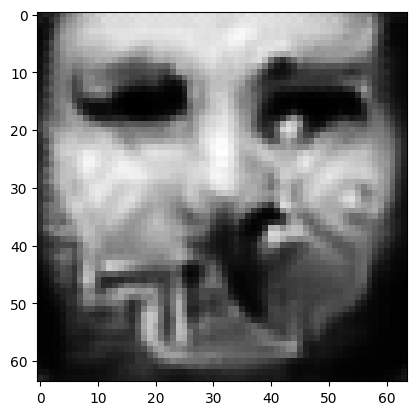

tensor([[9.4390e-01, 8.3676e-05, 3.2348e-03, 1.5424e-04, 5.2260e-04, 3.1490e-03,
         9.0692e-03, 1.0083e-02, 1.4537e-07, 4.0225e-04, 1.4908e-04, 9.1928e-05,
         1.9918e-05, 3.3704e-07, 1.3711e-04, 7.3968e-03, 7.5283e-04, 7.7478e-03,
         7.5940e-04, 2.7495e-04, 5.1485e-05, 1.0158e-04, 3.5101e-08, 8.5543e-03,
         3.6344e-05, 4.0480e-07, 2.8871e-04, 9.6585e-04, 1.4169e-03, 3.0609e-05,
         4.0191e-07, 1.7408e-04, 4.1469e-05, 3.5158e-05, 1.7505e-04, 3.7723e-05,
         7.5163e-05, 5.1372e-05, 2.8353e-05, 5.4736e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.057734180241823196
tensor([[9.4408e-01, 8.3396e-05, 3.2253e-03, 1.5379e-04, 5.2140e-04, 3.1420e-03,
         9.0374e-03, 1.0054e-02, 1.4472e-07, 4.0136e-04, 1.4852e-04, 9.1575e-05,
         1.9832e-05, 3.3491e-07, 1.3662e-04, 7.3827e-03, 7.4986e-04, 7.7237e-03,
         7.5685e-04, 2.7423e-04, 5.1268e-05, 1.0110e-04, 3.4802e-08, 8.5148e-03,
         3.6135e-05, 4.0247e-07, 2.8759e-

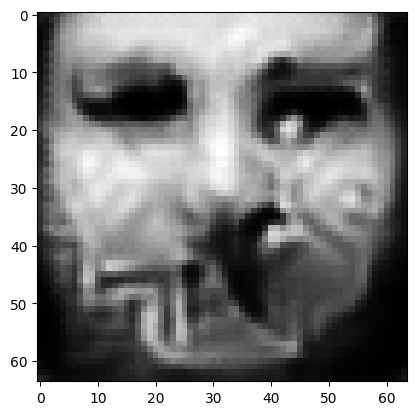

tensor([[9.4477e-01, 8.2294e-05, 3.1867e-03, 1.5121e-04, 5.1262e-04, 3.1137e-03,
         8.9173e-03, 9.9342e-03, 1.4131e-07, 3.9946e-04, 1.4691e-04, 9.0526e-05,
         1.9483e-05, 3.2588e-07, 1.3430e-04, 7.3586e-03, 7.3632e-04, 7.5868e-03,
         7.5129e-04, 2.7122e-04, 5.0355e-05, 9.9775e-05, 3.3598e-08, 8.3942e-03,
         3.4972e-05, 3.9240e-07, 2.8347e-04, 9.4446e-04, 1.3923e-03, 2.9853e-05,
         3.8913e-07, 1.7164e-04, 4.0149e-05, 3.4398e-05, 1.7195e-04, 3.6805e-05,
         7.3147e-05, 5.0144e-05, 2.7487e-05, 5.3298e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05681862309575081
tensor([[9.4494e-01, 8.2027e-05, 3.1814e-03, 1.5056e-04, 5.1030e-04, 3.1115e-03,
         8.8875e-03, 9.8986e-03, 1.4041e-07, 3.9823e-04, 1.4652e-04, 9.0455e-05,
         1.9392e-05, 3.2390e-07, 1.3368e-04, 7.3534e-03, 7.3271e-04, 7.5683e-03,
         7.4818e-04, 2.7023e-04, 5.0183e-05, 9.9255e-05, 3.3286e-08, 8.3438e-03,
         3.4684e-05, 3.8931e-07, 2.8279e-0

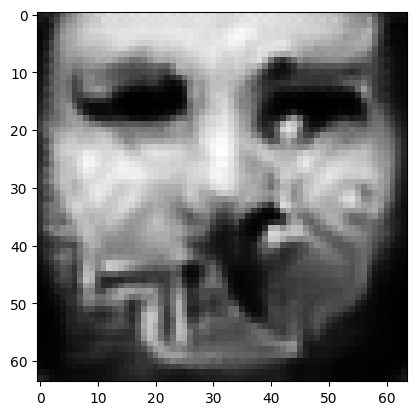

tensor([[9.4556e-01, 8.1072e-05, 3.1415e-03, 1.4819e-04, 5.0238e-04, 3.0806e-03,
         8.7771e-03, 9.7773e-03, 1.3741e-07, 3.9539e-04, 1.4480e-04, 8.9494e-05,
         1.9074e-05, 3.1626e-07, 1.3177e-04, 7.3343e-03, 7.2064e-04, 7.4641e-03,
         7.4240e-04, 2.6740e-04, 4.9436e-05, 9.7919e-05, 3.2311e-08, 8.2367e-03,
         3.3736e-05, 3.7972e-07, 2.7919e-04, 9.2479e-04, 1.3686e-03, 2.9117e-05,
         3.7680e-07, 1.6940e-04, 3.8987e-05, 3.3683e-05, 1.6922e-04, 3.5927e-05,
         7.1430e-05, 4.8991e-05, 2.6622e-05, 5.1994e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055975496768951416
tensor([[9.4571e-01, 8.0924e-05, 3.1304e-03, 1.4783e-04, 5.0097e-04, 3.0687e-03,
         8.7473e-03, 9.7427e-03, 1.3684e-07, 3.9506e-04, 1.4430e-04, 8.9134e-05,
         1.9003e-05, 3.1457e-07, 1.3148e-04, 7.3363e-03, 7.1875e-04, 7.4349e-03,
         7.4250e-04, 2.6675e-04, 4.9291e-05, 9.7586e-05, 3.2126e-08, 8.2207e-03,
         3.3541e-05, 3.7793e-07, 2.7820e-

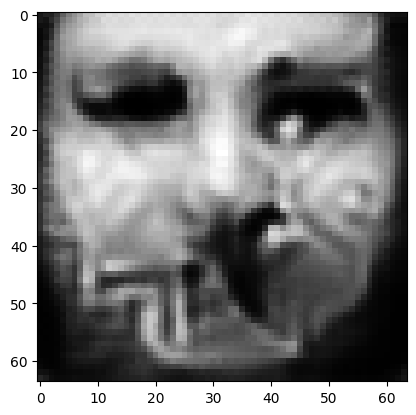

tensor([[9.4627e-01, 8.0014e-05, 3.0924e-03, 1.4561e-04, 4.9387e-04, 3.0362e-03,
         8.6458e-03, 9.6301e-03, 1.3407e-07, 3.9184e-04, 1.4273e-04, 8.8255e-05,
         1.8716e-05, 3.0811e-07, 1.2976e-04, 7.3099e-03, 7.0808e-04, 7.3503e-03,
         7.3665e-04, 2.6402e-04, 4.8640e-05, 9.6503e-05, 3.1313e-08, 8.1377e-03,
         3.2759e-05, 3.6965e-07, 2.7455e-04, 9.0695e-04, 1.3460e-03, 2.8532e-05,
         3.6732e-07, 1.6730e-04, 3.8014e-05, 3.3030e-05, 1.6679e-04, 3.5264e-05,
         6.9907e-05, 4.8043e-05, 2.5903e-05, 5.0729e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055223483592271805
tensor([[9.4641e-01, 7.9847e-05, 3.0841e-03, 1.4516e-04, 4.9202e-04, 3.0281e-03,
         8.6214e-03, 9.5916e-03, 1.3346e-07, 3.9062e-04, 1.4243e-04, 8.8122e-05,
         1.8651e-05, 3.0715e-07, 1.2951e-04, 7.3073e-03, 7.0568e-04, 7.3419e-03,
         7.3479e-04, 2.6334e-04, 4.8556e-05, 9.6147e-05, 3.1124e-08, 8.1102e-03,
         3.2582e-05, 3.6735e-07, 2.7389e-

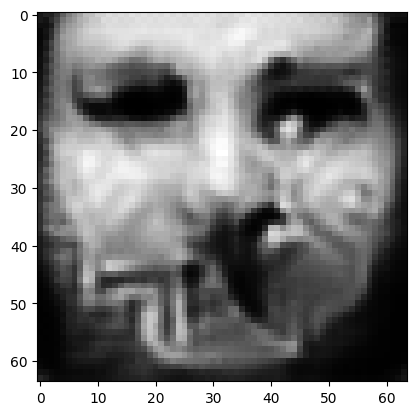

tensor([[9.4693e-01, 7.9065e-05, 3.0517e-03, 1.4343e-04, 4.8572e-04, 2.9969e-03,
         8.5262e-03, 9.4873e-03, 1.3108e-07, 3.8844e-04, 1.4105e-04, 8.7216e-05,
         1.8390e-05, 3.0120e-07, 1.2812e-04, 7.2896e-03, 6.9676e-04, 7.2527e-03,
         7.3122e-04, 2.6094e-04, 4.7967e-05, 9.5173e-05, 3.0372e-08, 8.0345e-03,
         3.1870e-05, 3.6035e-07, 2.7061e-04, 8.9157e-04, 1.3279e-03, 2.8028e-05,
         3.5860e-07, 1.6533e-04, 3.7141e-05, 3.2481e-05, 1.6481e-04, 3.4670e-05,
         6.8593e-05, 4.7173e-05, 2.5247e-05, 4.9644e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05453434959053993
tensor([[9.4705e-01, 7.8904e-05, 3.0453e-03, 1.4300e-04, 4.8434e-04, 2.9937e-03,
         8.5090e-03, 9.4554e-03, 1.3059e-07, 3.8672e-04, 1.4067e-04, 8.7168e-05,
         1.8333e-05, 3.0029e-07, 1.2781e-04, 7.2829e-03, 6.9412e-04, 7.2585e-03,
         7.2791e-04, 2.6029e-04, 4.7900e-05, 9.4749e-05, 3.0209e-08, 7.9967e-03,
         3.1740e-05, 3.5800e-07, 2.7023e-0

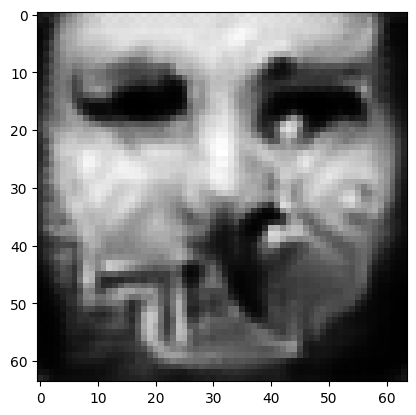

tensor([[9.4754e-01, 7.8147e-05, 3.0154e-03, 1.4132e-04, 4.7828e-04, 2.9653e-03,
         8.4160e-03, 9.3573e-03, 1.2832e-07, 3.8449e-04, 1.3937e-04, 8.6328e-05,
         1.8082e-05, 2.9454e-07, 1.2641e-04, 7.2655e-03, 6.8595e-04, 7.1715e-03,
         7.2416e-04, 2.5786e-04, 4.7343e-05, 9.3843e-05, 2.9507e-08, 7.9267e-03,
         3.1071e-05, 3.5152e-07, 2.6699e-04, 8.7694e-04, 1.3082e-03, 2.7499e-05,
         3.5012e-07, 1.6341e-04, 3.6313e-05, 3.1928e-05, 1.6301e-04, 3.4080e-05,
         6.7384e-05, 4.6346e-05, 2.4620e-05, 4.8645e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05388924479484558
tensor([[9.4765e-01, 7.7958e-05, 3.0049e-03, 1.4075e-04, 4.7626e-04, 2.9562e-03,
         8.3973e-03, 9.3311e-03, 1.2769e-07, 3.8361e-04, 1.3913e-04, 8.6130e-05,
         1.8025e-05, 2.9347e-07, 1.2614e-04, 7.2572e-03, 6.8368e-04, 7.1556e-03,
         7.2313e-04, 2.5739e-04, 4.7212e-05, 9.3682e-05, 2.9354e-08, 7.9168e-03,
         3.0917e-05, 3.4968e-07, 2.6616e-0

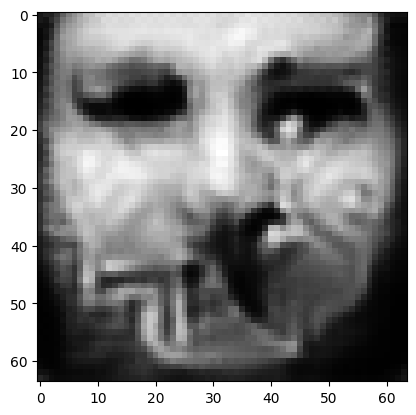

tensor([[9.4811e-01, 7.7266e-05, 2.9760e-03, 1.3921e-04, 4.7066e-04, 2.9294e-03,
         8.3144e-03, 9.2405e-03, 1.2567e-07, 3.8143e-04, 1.3790e-04, 8.5343e-05,
         1.7801e-05, 2.8822e-07, 1.2485e-04, 7.2380e-03, 6.7576e-04, 7.0763e-03,
         7.1969e-04, 2.5521e-04, 4.6692e-05, 9.2881e-05, 2.8733e-08, 7.8522e-03,
         3.0320e-05, 3.4379e-07, 2.6326e-04, 8.6306e-04, 1.2905e-03, 2.7055e-05,
         3.4279e-07, 1.6181e-04, 3.5608e-05, 3.1441e-05, 1.6097e-04, 3.3565e-05,
         6.6201e-05, 4.5619e-05, 2.4072e-05, 4.7653e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05328565463423729
tensor([[9.4822e-01, 7.7108e-05, 2.9684e-03, 1.3879e-04, 4.6909e-04, 2.9221e-03,
         8.2946e-03, 9.2133e-03, 1.2516e-07, 3.8051e-04, 1.3764e-04, 8.5196e-05,
         1.7747e-05, 2.8739e-07, 1.2466e-04, 7.2314e-03, 6.7383e-04, 7.0660e-03,
         7.1835e-04, 2.5469e-04, 4.6599e-05, 9.2655e-05, 2.8596e-08, 7.8354e-03,
         3.0194e-05, 3.4216e-07, 2.6263e-0

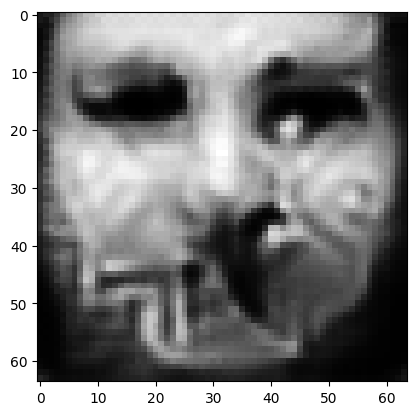

tensor([[9.4864e-01, 7.6431e-05, 2.9438e-03, 1.3742e-04, 4.6414e-04, 2.8989e-03,
         8.2180e-03, 9.1327e-03, 1.2330e-07, 3.7834e-04, 1.3651e-04, 8.4491e-05,
         1.7540e-05, 2.8279e-07, 1.2350e-04, 7.2059e-03, 6.6668e-04, 6.9971e-03,
         7.1453e-04, 2.5262e-04, 4.6119e-05, 9.1879e-05, 2.8034e-08, 7.7723e-03,
         2.9681e-05, 3.3697e-07, 2.5997e-04, 8.5086e-04, 1.2752e-03, 2.6650e-05,
         3.3599e-07, 1.6022e-04, 3.4996e-05, 3.1018e-05, 1.5926e-04, 3.3076e-05,
         6.5184e-05, 4.4962e-05, 2.3584e-05, 4.6797e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05272512882947922
tensor([[9.4874e-01, 7.6273e-05, 2.9380e-03, 1.3708e-04, 4.6288e-04, 2.8935e-03,
         8.2011e-03, 9.1092e-03, 1.2284e-07, 3.7740e-04, 1.3627e-04, 8.4382e-05,
         1.7491e-05, 2.8197e-07, 1.2326e-04, 7.1992e-03, 6.6489e-04, 6.9896e-03,
         7.1294e-04, 2.5208e-04, 4.6035e-05, 9.1628e-05, 2.7900e-08, 7.7520e-03,
         2.9567e-05, 3.3543e-07, 2.5940e-0

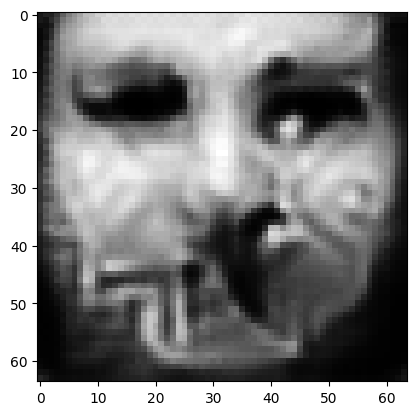

tensor([[9.4913e-01, 7.5706e-05, 2.9131e-03, 1.3589e-04, 4.5854e-04, 2.8719e-03,
         8.1376e-03, 9.0328e-03, 1.2123e-07, 3.7489e-04, 1.3509e-04, 8.3746e-05,
         1.7308e-05, 2.7805e-07, 1.2226e-04, 7.1729e-03, 6.5738e-04, 6.9403e-03,
         7.0859e-04, 2.5024e-04, 4.5604e-05, 9.0869e-05, 2.7420e-08, 7.6844e-03,
         2.9121e-05, 3.3036e-07, 2.5737e-04, 8.3952e-04, 1.2593e-03, 2.6237e-05,
         3.2971e-07, 1.5885e-04, 3.4427e-05, 3.0612e-05, 1.5777e-04, 3.2674e-05,
         6.4302e-05, 4.4355e-05, 2.3136e-05, 4.6030e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05221203714609146
tensor([[9.4922e-01, 7.5549e-05, 2.9087e-03, 1.3564e-04, 4.5755e-04, 2.8671e-03,
         8.1178e-03, 9.0218e-03, 1.2077e-07, 3.7510e-04, 1.3484e-04, 8.3533e-05,
         1.7256e-05, 2.7663e-07, 1.2193e-04, 7.1702e-03, 6.5594e-04, 6.9103e-03,
         7.0883e-04, 2.4978e-04, 4.5454e-05, 9.0752e-05, 2.7273e-08, 7.6735e-03,
         2.8979e-05, 3.2950e-07, 2.5669e-0

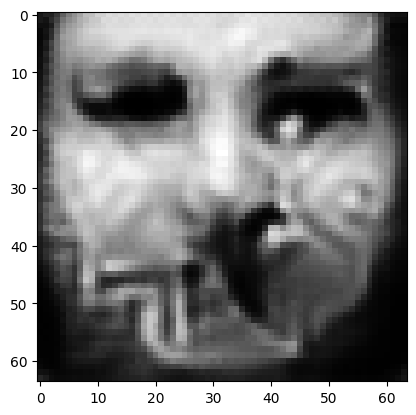

tensor([[9.4958e-01, 7.5100e-05, 2.8846e-03, 1.3453e-04, 4.5301e-04, 2.8481e-03,
         8.0611e-03, 8.9508e-03, 1.1931e-07, 3.7249e-04, 1.3379e-04, 8.2980e-05,
         1.7084e-05, 2.7303e-07, 1.2107e-04, 7.1490e-03, 6.4829e-04, 6.8698e-03,
         7.0459e-04, 2.4811e-04, 4.5064e-05, 8.9962e-05, 2.6788e-08, 7.6007e-03,
         2.8527e-05, 3.2403e-07, 2.5513e-04, 8.2876e-04, 1.2459e-03, 2.5872e-05,
         3.2386e-07, 1.5772e-04, 3.3870e-05, 3.0244e-05, 1.5620e-04, 3.2272e-05,
         6.3315e-05, 4.3744e-05, 2.2745e-05, 4.5356e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.051735468208789825
tensor([[9.4967e-01, 7.4951e-05, 2.8791e-03, 1.3413e-04, 4.5146e-04, 2.8441e-03,
         8.0476e-03, 8.9319e-03, 1.1884e-07, 3.7188e-04, 1.3360e-04, 8.2910e-05,
         1.7040e-05, 2.7209e-07, 1.2079e-04, 7.1451e-03, 6.4616e-04, 6.8579e-03,
         7.0351e-04, 2.4767e-04, 4.4968e-05, 8.9830e-05, 2.6660e-08, 7.5865e-03,
         2.8392e-05, 3.2257e-07, 2.5474e-

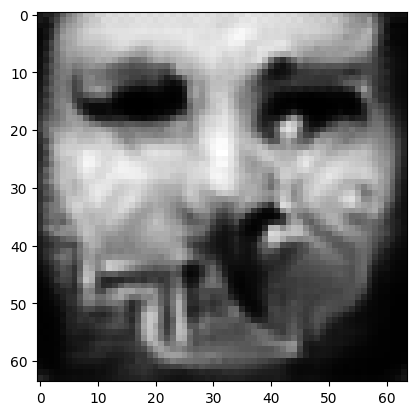

tensor([[9.5000e-01, 7.4525e-05, 2.8577e-03, 1.3312e-04, 4.4721e-04, 2.8268e-03,
         7.9935e-03, 8.8635e-03, 1.1746e-07, 3.6977e-04, 1.3267e-04, 8.2403e-05,
         1.6879e-05, 2.6865e-07, 1.1993e-04, 7.1302e-03, 6.3936e-04, 6.8144e-03,
         7.0005e-04, 2.4613e-04, 4.4609e-05, 8.9088e-05, 2.6207e-08, 7.5186e-03,
         2.7953e-05, 3.1761e-07, 2.5322e-04, 8.1864e-04, 1.2321e-03, 2.5513e-05,
         3.1820e-07, 1.5667e-04, 3.3348e-05, 2.9900e-05, 1.5477e-04, 3.1896e-05,
         6.2456e-05, 4.3168e-05, 2.2342e-05, 4.4713e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.051291290670633316
tensor([[9.5008e-01, 7.4408e-05, 2.8514e-03, 1.3286e-04, 4.4623e-04, 2.8212e-03,
         7.9797e-03, 8.8501e-03, 1.1712e-07, 3.6939e-04, 1.3240e-04, 8.2216e-05,
         1.6840e-05, 2.6771e-07, 1.1970e-04, 7.1245e-03, 6.3775e-04, 6.7994e-03,
         6.9950e-04, 2.4576e-04, 4.4499e-05, 8.8946e-05, 2.6104e-08, 7.5077e-03,
         2.7854e-05, 3.1657e-07, 2.5272e-

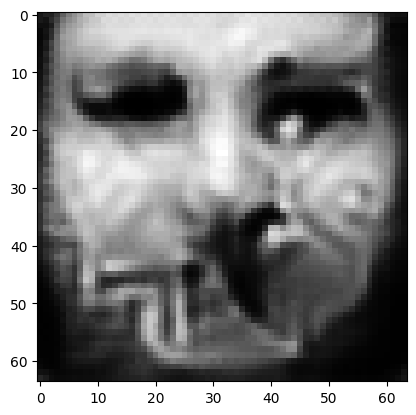

tensor([[9.5040e-01, 7.3991e-05, 2.8293e-03, 1.3184e-04, 4.4223e-04, 2.8026e-03,
         7.9279e-03, 8.7851e-03, 1.1580e-07, 3.6735e-04, 1.3153e-04, 8.1705e-05,
         1.6688e-05, 2.6458e-07, 1.1896e-04, 7.1096e-03, 6.3148e-04, 6.7588e-03,
         6.9631e-04, 2.4433e-04, 4.4168e-05, 8.8333e-05, 2.5691e-08, 7.4539e-03,
         2.7470e-05, 3.1205e-07, 2.5112e-04, 8.0911e-04, 1.2188e-03, 2.5196e-05,
         3.1335e-07, 1.5568e-04, 3.2877e-05, 2.9576e-05, 1.5341e-04, 3.1577e-05,
         6.1621e-05, 4.2641e-05, 2.1996e-05, 4.4078e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.050874900072813034
tensor([[9.5047e-01, 7.3883e-05, 2.8239e-03, 1.3153e-04, 4.4105e-04, 2.7985e-03,
         7.9179e-03, 8.7670e-03, 1.1546e-07, 3.6659e-04, 1.3134e-04, 8.1642e-05,
         1.6653e-05, 2.6399e-07, 1.1879e-04, 7.1043e-03, 6.2968e-04, 6.7549e-03,
         6.9511e-04, 2.4399e-04, 4.4101e-05, 8.8192e-05, 2.5598e-08, 7.4402e-03,
         2.7379e-05, 3.1078e-07, 2.5083e-

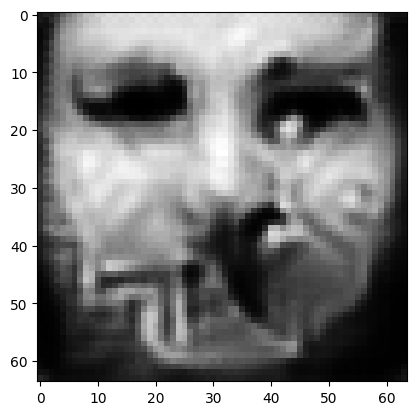

tensor([[9.5076e-01, 7.3512e-05, 2.8018e-03, 1.3067e-04, 4.3772e-04, 2.7790e-03,
         7.8691e-03, 8.7079e-03, 1.1434e-07, 3.6468e-04, 1.3047e-04, 8.1076e-05,
         1.6515e-05, 2.6121e-07, 1.1814e-04, 7.0874e-03, 6.2418e-04, 6.7192e-03,
         6.9219e-04, 2.4268e-04, 4.3794e-05, 8.7580e-05, 2.5243e-08, 7.3919e-03,
         2.7058e-05, 3.0681e-07, 2.4927e-04, 8.0037e-04, 1.2053e-03, 2.4894e-05,
         3.0890e-07, 1.5474e-04, 3.2454e-05, 2.9275e-05, 1.5226e-04, 3.1309e-05,
         6.0875e-05, 4.2157e-05, 2.1662e-05, 4.3481e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05048973485827446
tensor([[9.5083e-01, 7.3391e-05, 2.7975e-03, 1.3037e-04, 4.3665e-04, 2.7760e-03,
         7.8582e-03, 8.6938e-03, 1.1398e-07, 3.6409e-04, 1.3030e-04, 8.1012e-05,
         1.6478e-05, 2.6050e-07, 1.1793e-04, 7.0828e-03, 6.2257e-04, 6.7122e-03,
         6.9103e-04, 2.4232e-04, 4.3717e-05, 8.7443e-05, 2.5142e-08, 7.3781e-03,
         2.6966e-05, 3.0566e-07, 2.4896e-0

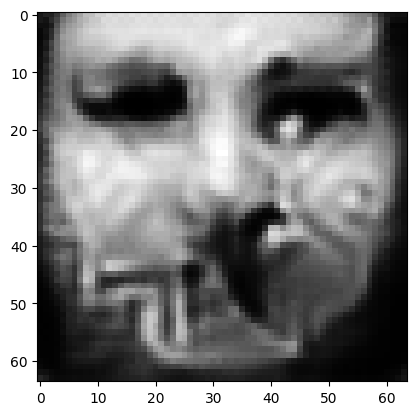

tensor([[9.5111e-01, 7.3014e-05, 2.7788e-03, 1.2963e-04, 4.3388e-04, 2.7582e-03,
         7.8086e-03, 8.6435e-03, 1.1291e-07, 3.6262e-04, 1.2950e-04, 8.0473e-05,
         1.6345e-05, 2.5779e-07, 1.1726e-04, 7.0662e-03, 6.1791e-04, 6.6720e-03,
         6.8845e-04, 2.4098e-04, 4.3413e-05, 8.6892e-05, 2.4804e-08, 7.3361e-03,
         2.6674e-05, 3.0235e-07, 2.4730e-04, 7.9244e-04, 1.1938e-03, 2.4626e-05,
         3.0481e-07, 1.5379e-04, 3.2053e-05, 2.8995e-05, 1.5115e-04, 3.1024e-05,
         6.0187e-05, 4.1714e-05, 2.1366e-05, 4.2929e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05013015493750572
tensor([[9.5117e-01, 7.2963e-05, 2.7731e-03, 1.2940e-04, 4.3282e-04, 2.7541e-03,
         7.8000e-03, 8.6227e-03, 1.1266e-07, 3.6168e-04, 1.2935e-04, 8.0429e-05,
         1.6318e-05, 2.5745e-07, 1.1718e-04, 7.0643e-03, 6.1640e-04, 6.6751e-03,
         6.8720e-04, 2.4070e-04, 4.3388e-05, 8.6720e-05, 2.4731e-08, 7.3215e-03,
         2.6604e-05, 3.0106e-07, 2.4714e-0

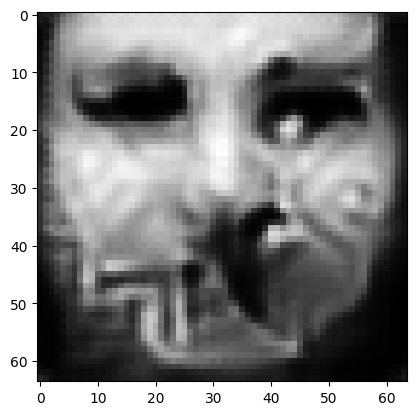

tensor([[9.5142e-01, 7.2561e-05, 2.7591e-03, 1.2872e-04, 4.3053e-04, 2.7393e-03,
         7.7503e-03, 8.5769e-03, 1.1160e-07, 3.6029e-04, 1.2864e-04, 8.0006e-05,
         1.6189e-05, 2.5505e-07, 1.1650e-04, 7.0480e-03, 6.1253e-04, 6.6381e-03,
         6.8415e-04, 2.3926e-04, 4.3120e-05, 8.6177e-05, 2.4406e-08, 7.2792e-03,
         2.6346e-05, 2.9814e-07, 2.4548e-04, 7.8556e-04, 1.1830e-03, 2.4373e-05,
         3.0098e-07, 1.5281e-04, 3.1676e-05, 2.8742e-05, 1.5034e-04, 3.0761e-05,
         5.9618e-05, 4.1308e-05, 2.1068e-05, 4.2419e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04979528486728668
tensor([[9.5149e-01, 7.2430e-05, 2.7561e-03, 1.2855e-04, 4.3011e-04, 2.7361e-03,
         7.7369e-03, 8.5712e-03, 1.1131e-07, 3.6016e-04, 1.2844e-04, 7.9862e-05,
         1.6154e-05, 2.5422e-07, 1.1626e-04, 7.0419e-03, 6.1157e-04, 6.6228e-03,
         6.8349e-04, 2.3887e-04, 4.3020e-05, 8.6064e-05, 2.4315e-08, 7.2699e-03,
         2.6277e-05, 2.9759e-07, 2.4496e-0

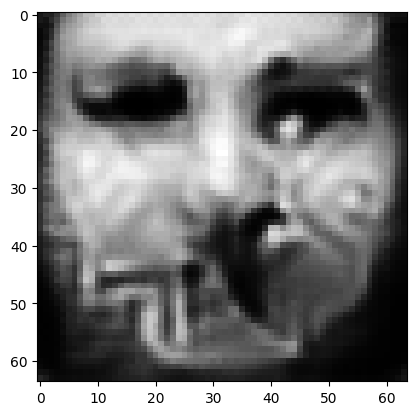

tensor([[9.5173e-01, 7.2090e-05, 2.7395e-03, 1.2780e-04, 4.2728e-04, 2.7203e-03,
         7.6953e-03, 8.5185e-03, 1.1031e-07, 3.5856e-04, 1.2779e-04, 7.9483e-05,
         1.6041e-05, 2.5210e-07, 1.1565e-04, 7.0302e-03, 6.0730e-04, 6.5948e-03,
         6.8074e-04, 2.3765e-04, 4.2788e-05, 8.5587e-05, 2.4033e-08, 7.2338e-03,
         2.6015e-05, 2.9438e-07, 2.4364e-04, 7.7859e-04, 1.1728e-03, 2.4142e-05,
         2.9756e-07, 1.5193e-04, 3.1327e-05, 2.8494e-05, 1.4936e-04, 3.0509e-05,
         5.9016e-05, 4.0935e-05, 2.0810e-05, 4.1931e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04947811737656593
tensor([[9.5178e-01, 7.1981e-05, 2.7370e-03, 1.2768e-04, 4.2689e-04, 2.7169e-03,
         7.6828e-03, 8.5101e-03, 1.1005e-07, 3.5855e-04, 1.2761e-04, 7.9357e-05,
         1.6009e-05, 2.5138e-07, 1.1543e-04, 7.0278e-03, 6.0658e-04, 6.5802e-03,
         6.8044e-04, 2.3728e-04, 4.2709e-05, 8.5471e-05, 2.3957e-08, 7.2254e-03,
         2.5948e-05, 2.9388e-07, 2.4320e-0

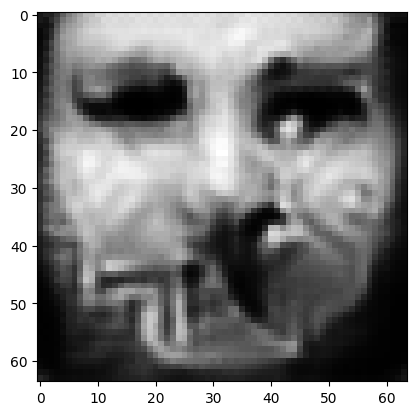

tensor([[9.5201e-01, 7.1649e-05, 2.7232e-03, 1.2703e-04, 4.2454e-04, 2.7030e-03,
         7.6419e-03, 8.4637e-03, 1.0910e-07, 3.5714e-04, 1.2698e-04, 7.8997e-05,
         1.5898e-05, 2.4932e-07, 1.1482e-04, 7.0170e-03, 6.0292e-04, 6.5514e-03,
         6.7771e-04, 2.3604e-04, 4.2484e-05, 8.4973e-05, 2.3685e-08, 7.1879e-03,
         2.5708e-05, 2.9102e-07, 2.4189e-04, 7.7219e-04, 1.1646e-03, 2.3930e-05,
         2.9438e-07, 1.5106e-04, 3.0987e-05, 2.8257e-05, 1.4854e-04, 3.0256e-05,
         5.8478e-05, 4.0599e-05, 2.0566e-05, 4.1505e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.049181390553712845
tensor([[9.5206e-01, 7.1561e-05, 2.7204e-03, 1.2683e-04, 4.2384e-04, 2.7003e-03,
         7.6324e-03, 8.4519e-03, 1.0884e-07, 3.5684e-04, 1.2686e-04, 7.8943e-05,
         1.5871e-05, 2.4883e-07, 1.1466e-04, 7.0155e-03, 6.0201e-04, 6.5442e-03,
         6.7702e-04, 2.3575e-04, 4.2432e-05, 8.4863e-05, 2.3615e-08, 7.1790e-03,
         2.5642e-05, 2.9027e-07, 2.4160e-

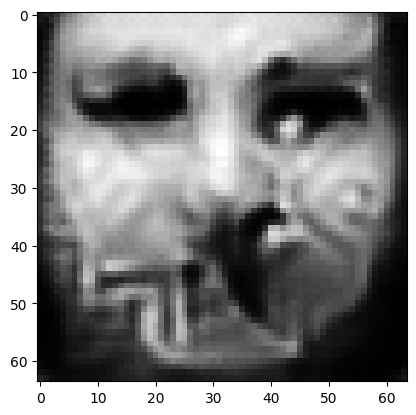

tensor([[9.5227e-01, 7.1249e-05, 2.7071e-03, 1.2626e-04, 4.2198e-04, 2.6869e-03,
         7.5924e-03, 8.4126e-03, 1.0800e-07, 3.5574e-04, 1.2621e-04, 7.8542e-05,
         1.5766e-05, 2.4672e-07, 1.1406e-04, 7.0045e-03, 5.9859e-04, 6.5132e-03,
         6.7459e-04, 2.3459e-04, 4.2197e-05, 8.4411e-05, 2.3360e-08, 7.1448e-03,
         2.5425e-05, 2.8778e-07, 2.4030e-04, 7.6615e-04, 1.1562e-03, 2.3730e-05,
         2.9139e-07, 1.5027e-04, 3.0670e-05, 2.8035e-05, 1.4777e-04, 3.0030e-05,
         5.7961e-05, 4.0272e-05, 2.0340e-05, 4.1102e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.048904553055763245
tensor([[9.5232e-01, 7.1196e-05, 2.7041e-03, 1.2612e-04, 4.2138e-04, 2.6842e-03,
         7.5833e-03, 8.3989e-03, 1.0779e-07, 3.5524e-04, 1.2609e-04, 7.8499e-05,
         1.5742e-05, 2.4640e-07, 1.1396e-04, 7.0035e-03, 5.9773e-04, 6.5112e-03,
         6.7373e-04, 2.3431e-04, 4.2168e-05, 8.4261e-05, 2.3300e-08, 7.1324e-03,
         2.5371e-05, 2.8700e-07, 2.4009e-

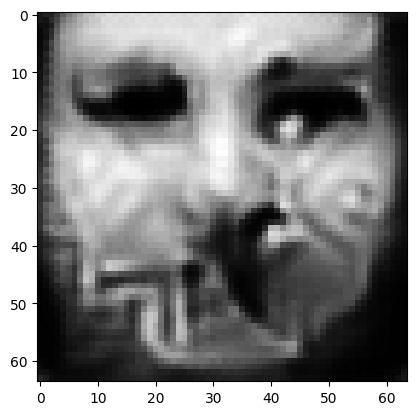

tensor([[9.5252e-01, 7.0875e-05, 2.6918e-03, 1.2548e-04, 4.1932e-04, 2.6720e-03,
         7.5455e-03, 8.3619e-03, 1.0692e-07, 3.5412e-04, 1.2551e-04, 7.8155e-05,
         1.5640e-05, 2.4440e-07, 1.1337e-04, 6.9915e-03, 5.9423e-04, 6.4818e-03,
         6.7118e-04, 2.3319e-04, 4.1936e-05, 8.3859e-05, 2.3047e-08, 7.1009e-03,
         2.5155e-05, 2.8449e-07, 2.3884e-04, 7.6059e-04, 1.1478e-03, 2.3529e-05,
         2.8837e-07, 1.4951e-04, 3.0369e-05, 2.7827e-05, 1.4705e-04, 2.9812e-05,
         5.7492e-05, 3.9954e-05, 2.0111e-05, 4.0707e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04863933473825455
tensor([[9.5257e-01, 7.0828e-05, 2.6883e-03, 1.2540e-04, 4.1901e-04, 2.6686e-03,
         7.5367e-03, 8.3520e-03, 1.0678e-07, 3.5388e-04, 1.2534e-04, 7.8042e-05,
         1.5619e-05, 2.4397e-07, 1.1326e-04, 6.9895e-03, 5.9353e-04, 6.4760e-03,
         6.7077e-04, 2.3298e-04, 4.1886e-05, 8.3732e-05, 2.2997e-08, 7.0919e-03,
         2.5112e-05, 2.8395e-07, 2.3858e-0

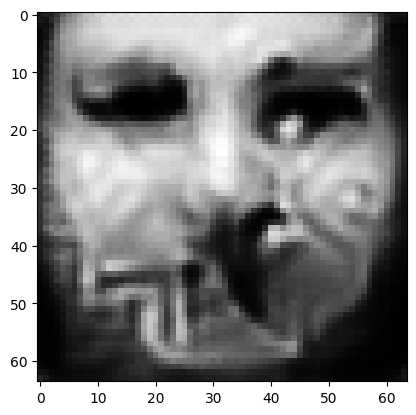

tensor([[9.5276e-01, 7.0537e-05, 2.6769e-03, 1.2479e-04, 4.1692e-04, 2.6582e-03,
         7.5017e-03, 8.3153e-03, 1.0594e-07, 3.5257e-04, 1.2481e-04, 7.7745e-05,
         1.5521e-05, 2.4217e-07, 1.1275e-04, 6.9792e-03, 5.9018e-04, 6.4526e-03,
         6.6808e-04, 2.3191e-04, 4.1681e-05, 8.3280e-05, 2.2747e-08, 7.0563e-03,
         2.4901e-05, 2.8134e-07, 2.3749e-04, 7.5528e-04, 1.1401e-03, 2.3337e-05,
         2.8542e-07, 1.4879e-04, 3.0077e-05, 2.7622e-05, 1.4639e-04, 2.9604e-05,
         5.7022e-05, 3.9639e-05, 1.9895e-05, 4.0341e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04838813096284866
tensor([[9.5281e-01, 7.0455e-05, 2.6739e-03, 1.2467e-04, 4.1664e-04, 2.6552e-03,
         7.4930e-03, 8.3094e-03, 1.0578e-07, 3.5241e-04, 1.2465e-04, 7.7629e-05,
         1.5499e-05, 2.4167e-07, 1.1260e-04, 6.9746e-03, 5.8947e-04, 6.4442e-03,
         6.6756e-04, 2.3168e-04, 4.1614e-05, 8.3194e-05, 2.2693e-08, 7.0507e-03,
         2.4862e-05, 2.8090e-07, 2.3715e-0

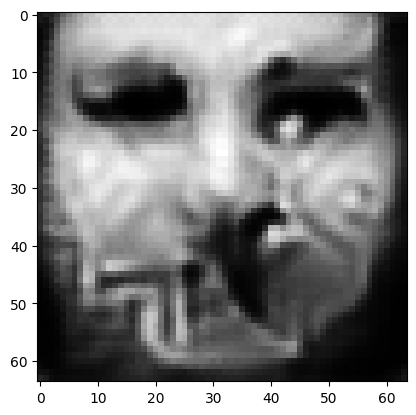

tensor([[9.5299e-01, 7.0206e-05, 2.6624e-03, 1.2412e-04, 4.1471e-04, 2.6451e-03,
         7.4612e-03, 8.2731e-03, 1.0503e-07, 3.5103e-04, 1.2413e-04, 7.7347e-05,
         1.5410e-05, 2.4006e-07, 1.1215e-04, 6.9657e-03, 5.8622e-04, 6.4258e-03,
         6.6488e-04, 2.3071e-04, 4.1433e-05, 8.2759e-05, 2.2467e-08, 7.0156e-03,
         2.4673e-05, 2.7839e-07, 2.3620e-04, 7.5023e-04, 1.1322e-03, 2.3153e-05,
         2.8271e-07, 1.4813e-04, 2.9810e-05, 2.7430e-05, 1.4574e-04, 2.9417e-05,
         5.6572e-05, 3.9341e-05, 1.9699e-05, 3.9990e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.048152316361665726
tensor([[9.5303e-01, 7.0139e-05, 2.6593e-03, 1.2400e-04, 4.1436e-04, 2.6420e-03,
         7.4527e-03, 8.2673e-03, 1.0486e-07, 3.5090e-04, 1.2398e-04, 7.7231e-05,
         1.5387e-05, 2.3956e-07, 1.1202e-04, 6.9629e-03, 5.8559e-04, 6.4168e-03,
         6.6456e-04, 2.3048e-04, 4.1372e-05, 8.2672e-05, 2.2412e-08, 7.0105e-03,
         2.4629e-05, 2.7793e-07, 2.3587e-

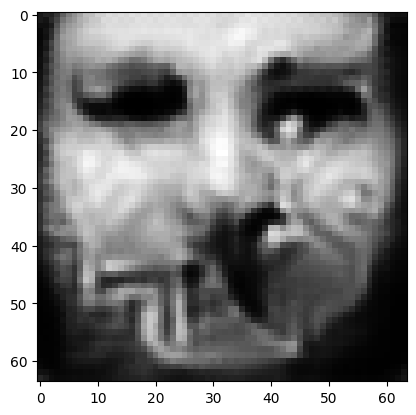

tensor([[9.5320e-01, 6.9890e-05, 2.6484e-03, 1.2349e-04, 4.1266e-04, 2.6321e-03,
         7.4217e-03, 8.2340e-03, 1.0416e-07, 3.4960e-04, 1.2350e-04, 7.6957e-05,
         1.5303e-05, 2.3809e-07, 1.1159e-04, 6.9522e-03, 5.8267e-04, 6.3995e-03,
         6.6192e-04, 2.2954e-04, 4.1200e-05, 8.2262e-05, 2.2203e-08, 6.9793e-03,
         2.4462e-05, 2.7569e-07, 2.3488e-04, 7.4551e-04, 1.1249e-03, 2.2984e-05,
         2.8017e-07, 1.4748e-04, 2.9559e-05, 2.7249e-05, 1.4513e-04, 2.9237e-05,
         5.6146e-05, 3.9065e-05, 1.9513e-05, 3.9650e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04792928323149681
tensor([[9.5324e-01, 6.9843e-05, 2.6452e-03, 1.2341e-04, 4.1243e-04, 2.6293e-03,
         7.4145e-03, 8.2270e-03, 1.0404e-07, 3.4934e-04, 1.2334e-04, 7.6853e-05,
         1.5285e-05, 2.3771e-07, 1.1150e-04, 6.9491e-03, 5.8201e-04, 6.3950e-03,
         6.6143e-04, 2.2935e-04, 4.1153e-05, 8.2157e-05, 2.2159e-08, 6.9720e-03,
         2.4429e-05, 2.7522e-07, 2.3464e-0

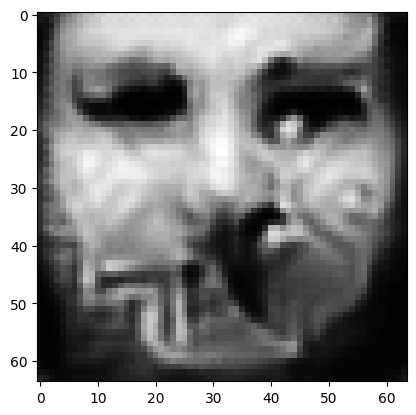

tensor([[9.5340e-01, 6.9608e-05, 2.6354e-03, 1.2292e-04, 4.1089e-04, 2.6206e-03,
         7.3855e-03, 8.1969e-03, 1.0340e-07, 3.4815e-04, 1.2287e-04, 7.6598e-05,
         1.5206e-05, 2.3633e-07, 1.1109e-04, 6.9388e-03, 5.7926e-04, 6.3786e-03,
         6.5888e-04, 2.2847e-04, 4.0987e-05, 8.1769e-05, 2.1963e-08, 6.9413e-03,
         2.4273e-05, 2.7315e-07, 2.3374e-04, 7.4106e-04, 1.1178e-03, 2.2820e-05,
         2.7776e-07, 1.4689e-04, 2.9322e-05, 2.7078e-05, 1.4462e-04, 2.9076e-05,
         5.5757e-05, 3.8804e-05, 1.9340e-05, 3.9342e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047719839960336685
tensor([[9.5344e-01, 6.9532e-05, 2.6327e-03, 1.2274e-04, 4.1033e-04, 2.6188e-03,
         7.3798e-03, 8.1921e-03, 1.0319e-07, 3.4795e-04, 1.2278e-04, 7.6543e-05,
         1.5187e-05, 2.3587e-07, 1.1094e-04, 6.9347e-03, 5.7834e-04, 6.3717e-03,
         6.5836e-04, 2.2828e-04, 4.0926e-05, 8.1723e-05, 2.1909e-08, 6.9358e-03,
         2.4223e-05, 2.7263e-07, 2.3351e-

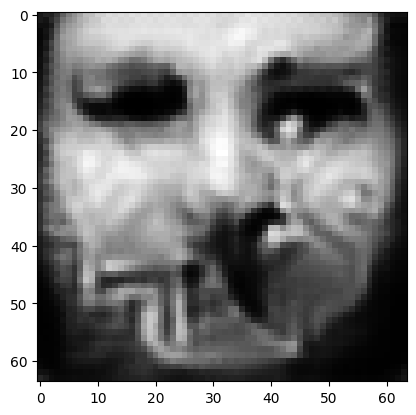

tensor([[9.5359e-01, 6.9324e-05, 2.6233e-03, 1.2239e-04, 4.0920e-04, 2.6099e-03,
         7.3520e-03, 8.1646e-03, 1.0265e-07, 3.4702e-04, 1.2231e-04, 7.6251e-05,
         1.5116e-05, 2.3458e-07, 1.1058e-04, 6.9250e-03, 5.7607e-04, 6.3545e-03,
         6.5633e-04, 2.2751e-04, 4.0768e-05, 8.1346e-05, 2.1736e-08, 6.9082e-03,
         2.4092e-05, 2.7090e-07, 2.3263e-04, 7.3689e-04, 1.1115e-03, 2.2672e-05,
         2.7558e-07, 1.4637e-04, 2.9108e-05, 2.6923e-05, 1.4407e-04, 2.8924e-05,
         5.5387e-05, 3.8570e-05, 1.9186e-05, 3.9052e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04752456396818161
tensor([[9.5362e-01, 6.9268e-05, 2.6211e-03, 1.2225e-04, 4.0874e-04, 2.6080e-03,
         7.3454e-03, 8.1577e-03, 1.0248e-07, 3.4671e-04, 1.2222e-04, 7.6201e-05,
         1.5096e-05, 2.3424e-07, 1.1047e-04, 6.9228e-03, 5.7538e-04, 6.3505e-03,
         6.5571e-04, 2.2728e-04, 4.0730e-05, 8.1257e-05, 2.1685e-08, 6.9008e-03,
         2.4050e-05, 2.7036e-07, 2.3242e-0

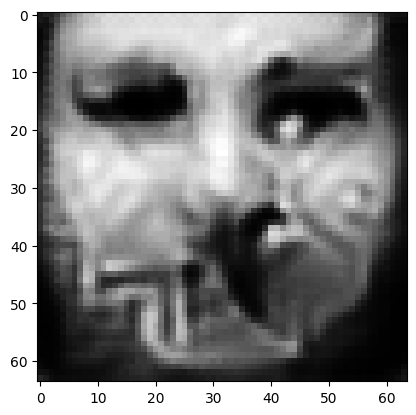

tensor([[9.5376e-01, 6.9052e-05, 2.6116e-03, 1.2179e-04, 4.0732e-04, 2.5995e-03,
         7.3206e-03, 8.1317e-03, 1.0190e-07, 3.4577e-04, 1.2181e-04, 7.5958e-05,
         1.5028e-05, 2.3297e-07, 1.1010e-04, 6.9129e-03, 5.7283e-04, 6.3337e-03,
         6.5374e-04, 2.2656e-04, 4.0572e-05, 8.0971e-05, 2.1519e-08, 6.8777e-03,
         2.3911e-05, 2.6859e-07, 2.3159e-04, 7.3305e-04, 1.1051e-03, 2.2528e-05,
         2.7342e-07, 1.4589e-04, 2.8903e-05, 2.6777e-05, 1.4351e-04, 2.8779e-05,
         5.5055e-05, 3.8344e-05, 1.9032e-05, 3.8761e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04733948037028313
tensor([[9.5380e-01, 6.9012e-05, 2.6089e-03, 1.2174e-04, 4.0723e-04, 2.5970e-03,
         7.3145e-03, 8.1251e-03, 1.0181e-07, 3.4554e-04, 1.2168e-04, 7.5870e-05,
         1.5014e-05, 2.3272e-07, 1.1004e-04, 6.9102e-03, 5.7238e-04, 6.3313e-03,
         6.5330e-04, 2.2641e-04, 4.0538e-05, 8.0878e-05, 2.1488e-08, 6.8719e-03,
         2.3892e-05, 2.6824e-07, 2.3139e-0

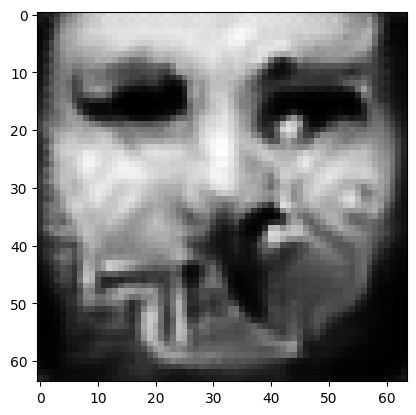

tensor([[9.5393e-01, 6.8790e-05, 2.5998e-03, 1.2128e-04, 4.0590e-04, 2.5893e-03,
         7.2919e-03, 8.1025e-03, 1.0125e-07, 3.4463e-04, 1.2128e-04, 7.5629e-05,
         1.4949e-05, 2.3144e-07, 1.0967e-04, 6.8985e-03, 5.6980e-04, 6.3151e-03,
         6.5131e-04, 2.2573e-04, 4.0372e-05, 8.0603e-05, 2.1324e-08, 6.8489e-03,
         2.3760e-05, 2.6652e-07, 2.3060e-04, 7.2936e-04, 1.0991e-03, 2.2393e-05,
         2.7146e-07, 1.4545e-04, 2.8717e-05, 2.6635e-05, 1.4300e-04, 2.8659e-05,
         5.4724e-05, 3.8129e-05, 1.8900e-05, 3.8492e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047165170311927795
tensor([[9.5396e-01, 6.8757e-05, 2.5976e-03, 1.2120e-04, 4.0559e-04, 2.5873e-03,
         7.2861e-03, 8.0939e-03, 1.0114e-07, 3.4429e-04, 1.2118e-04, 7.5584e-05,
         1.4934e-05, 2.3126e-07, 1.0962e-04, 6.8971e-03, 5.6926e-04, 6.3145e-03,
         6.5072e-04, 2.2555e-04, 4.0351e-05, 8.0503e-05, 2.1290e-08, 6.8413e-03,
         2.3733e-05, 2.6606e-07, 2.3046e-

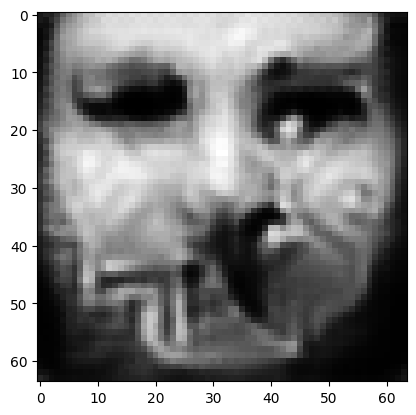

tensor([[9.5409e-01, 6.8578e-05, 2.5895e-03, 1.2085e-04, 4.0450e-04, 2.5803e-03,
         7.2640e-03, 8.0696e-03, 1.0066e-07, 3.4337e-04, 1.2080e-04, 7.5369e-05,
         1.4875e-05, 2.3019e-07, 1.0932e-04, 6.8881e-03, 5.6702e-04, 6.3024e-03,
         6.4879e-04, 2.2492e-04, 4.0219e-05, 8.0204e-05, 2.1142e-08, 6.8164e-03,
         2.3617e-05, 2.6447e-07, 2.2980e-04, 7.2604e-04, 1.0936e-03, 2.2266e-05,
         2.6955e-07, 1.4500e-04, 2.8535e-05, 2.6505e-05, 1.4264e-04, 2.8544e-05,
         5.4443e-05, 3.7924e-05, 1.8763e-05, 3.8258e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0469990149140358
tensor([[9.5412e-01, 6.8519e-05, 2.5877e-03, 1.2073e-04, 4.0413e-04, 2.5788e-03,
         7.2585e-03, 8.0648e-03, 1.0051e-07, 3.4319e-04, 1.2071e-04, 7.5316e-05,
         1.4859e-05, 2.2986e-07, 1.0923e-04, 6.8858e-03, 5.6644e-04, 6.2973e-03,
         6.4839e-04, 2.2475e-04, 4.0178e-05, 8.0147e-05, 2.1099e-08, 6.8114e-03,
         2.3582e-05, 2.6408e-07, 2.2960e-04

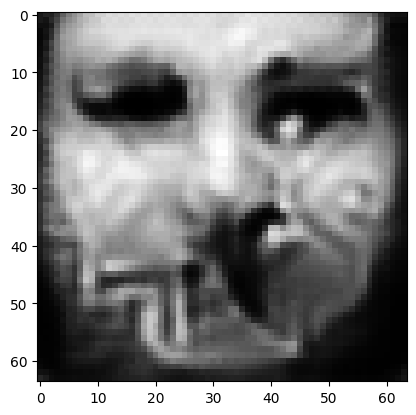

tensor([[9.5424e-01, 6.8346e-05, 2.5801e-03, 1.2039e-04, 4.0304e-04, 2.5723e-03,
         7.2381e-03, 8.0429e-03, 1.0005e-07, 3.4232e-04, 1.2036e-04, 7.5112e-05,
         1.4803e-05, 2.2886e-07, 1.0894e-04, 6.8768e-03, 5.6434e-04, 6.2854e-03,
         6.4662e-04, 2.2416e-04, 4.0049e-05, 7.9871e-05, 2.0959e-08, 6.7890e-03,
         2.3472e-05, 2.6257e-07, 2.2896e-04, 7.2291e-04, 1.0887e-03, 2.2147e-05,
         2.6772e-07, 1.4459e-04, 2.8368e-05, 2.6386e-05, 1.4218e-04, 2.8424e-05,
         5.4165e-05, 3.7728e-05, 1.8641e-05, 3.8027e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046844322234392166
tensor([[9.5426e-01, 6.8320e-05, 2.5777e-03, 1.2034e-04, 4.0292e-04, 2.5701e-03,
         7.2333e-03, 8.0364e-03, 9.9993e-08, 3.4212e-04, 1.2024e-04, 7.5040e-05,
         1.4793e-05, 2.2865e-07, 1.0890e-04, 6.8750e-03, 5.6388e-04, 6.2838e-03,
         6.4629e-04, 2.2405e-04, 4.0022e-05, 7.9798e-05, 2.0936e-08, 6.7838e-03,
         2.3454e-05, 2.6225e-07, 2.2882e-

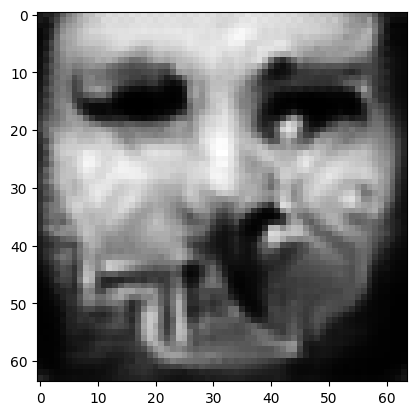

tensor([[9.5438e-01, 6.8157e-05, 2.5699e-03, 1.1997e-04, 4.0170e-04, 2.5638e-03,
         7.2147e-03, 8.0157e-03, 9.9535e-08, 3.4124e-04, 1.1991e-04, 7.4846e-05,
         1.4739e-05, 2.2766e-07, 1.0863e-04, 6.8665e-03, 5.6175e-04, 6.2724e-03,
         6.4465e-04, 2.2349e-04, 3.9895e-05, 7.9547e-05, 2.0801e-08, 6.7632e-03,
         2.3341e-05, 2.6074e-07, 2.2823e-04, 7.1984e-04, 1.0835e-03, 2.2035e-05,
         2.6605e-07, 1.4422e-04, 2.8212e-05, 2.6267e-05, 1.4178e-04, 2.8326e-05,
         5.3884e-05, 3.7541e-05, 1.8527e-05, 3.7812e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046698592603206635
tensor([[9.5440e-01, 6.8130e-05, 2.5679e-03, 1.1989e-04, 4.0145e-04, 2.5621e-03,
         7.2103e-03, 8.0086e-03, 9.9444e-08, 3.4096e-04, 1.1983e-04, 7.4810e-05,
         1.4728e-05, 2.2750e-07, 1.0858e-04, 6.8654e-03, 5.6125e-04, 6.2718e-03,
         6.4417e-04, 2.2336e-04, 3.9877e-05, 7.9479e-05, 2.0775e-08, 6.7574e-03,
         2.3318e-05, 2.6036e-07, 2.2812e-

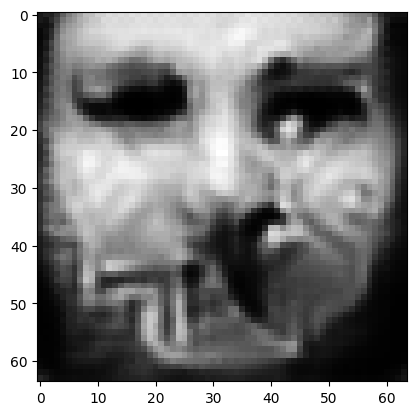

tensor([[9.5451e-01, 6.7986e-05, 2.5610e-03, 1.1958e-04, 4.0041e-04, 2.5563e-03,
         7.1919e-03, 7.9884e-03, 9.9029e-08, 3.4018e-04, 1.1952e-04, 7.4637e-05,
         1.4678e-05, 2.2660e-07, 1.0832e-04, 6.8586e-03, 5.5935e-04, 6.2610e-03,
         6.4266e-04, 2.2283e-04, 3.9766e-05, 7.9237e-05, 2.0651e-08, 6.7374e-03,
         2.3216e-05, 2.5900e-07, 2.2757e-04, 7.1709e-04, 1.0787e-03, 2.1929e-05,
         2.6450e-07, 1.4386e-04, 2.8061e-05, 2.6161e-05, 1.4143e-04, 2.8229e-05,
         5.3640e-05, 3.7367e-05, 1.8414e-05, 3.7613e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04656148701906204
tensor([[9.5453e-01, 6.7945e-05, 2.5591e-03, 1.1951e-04, 4.0022e-04, 2.5545e-03,
         7.1876e-03, 7.9849e-03, 9.8941e-08, 3.4011e-04, 1.1943e-04, 7.4569e-05,
         1.4666e-05, 2.2632e-07, 1.0825e-04, 6.8564e-03, 5.5892e-04, 6.2562e-03,
         6.4249e-04, 2.2273e-04, 3.9729e-05, 7.9196e-05, 2.0623e-08, 6.7345e-03,
         2.3192e-05, 2.5874e-07, 2.2740e-0

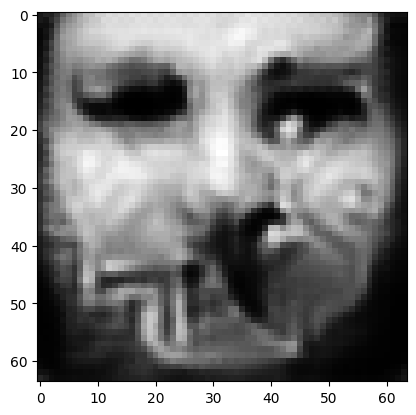

tensor([[9.5463e-01, 6.7817e-05, 2.5519e-03, 1.1922e-04, 3.9927e-04, 2.5484e-03,
         7.1710e-03, 7.9641e-03, 9.8580e-08, 3.3929e-04, 1.1912e-04, 7.4396e-05,
         1.4623e-05, 2.2556e-07, 1.0804e-04, 6.8494e-03, 5.5713e-04, 6.2484e-03,
         6.4103e-04, 2.2227e-04, 3.9633e-05, 7.8976e-05, 2.0517e-08, 6.7170e-03,
         2.3106e-05, 2.5748e-07, 2.2689e-04, 7.1438e-04, 1.0743e-03, 2.1836e-05,
         2.6314e-07, 1.4354e-04, 2.7929e-05, 2.6060e-05, 1.4107e-04, 2.8148e-05,
         5.3396e-05, 3.7208e-05, 1.8319e-05, 3.7422e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04643324390053749
tensor([[9.5465e-01, 6.7794e-05, 2.5501e-03, 1.1915e-04, 3.9899e-04, 2.5467e-03,
         7.1668e-03, 7.9576e-03, 9.8491e-08, 3.3907e-04, 1.1906e-04, 7.4367e-05,
         1.4613e-05, 2.2543e-07, 1.0801e-04, 6.8486e-03, 5.5670e-04, 6.2475e-03,
         6.4069e-04, 2.2216e-04, 3.9618e-05, 7.8921e-05, 2.0494e-08, 6.7127e-03,
         2.3084e-05, 2.5715e-07, 2.2679e-0

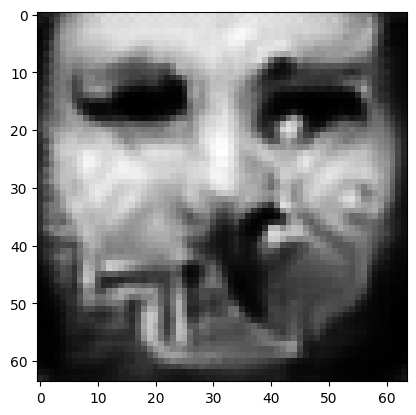

tensor([[9.5474e-01, 6.7660e-05, 2.5436e-03, 1.1884e-04, 3.9800e-04, 2.5411e-03,
         7.1508e-03, 7.9398e-03, 9.8113e-08, 3.3838e-04, 1.1879e-04, 7.4205e-05,
         1.4569e-05, 2.2461e-07, 1.0778e-04, 6.8421e-03, 5.5498e-04, 6.2371e-03,
         6.3939e-04, 2.2171e-04, 3.9517e-05, 7.8732e-05, 2.0386e-08, 6.6970e-03,
         2.2992e-05, 2.5595e-07, 2.2626e-04, 7.1192e-04, 1.0700e-03, 2.1744e-05,
         2.6181e-07, 1.4322e-04, 2.7801e-05, 2.5969e-05, 1.4072e-04, 2.8064e-05,
         5.3176e-05, 3.7056e-05, 1.8220e-05, 3.7236e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04631181061267853
tensor([[9.5477e-01, 6.7641e-05, 2.5418e-03, 1.1879e-04, 3.9779e-04, 2.5396e-03,
         7.1472e-03, 7.9338e-03, 9.8041e-08, 3.3811e-04, 1.1873e-04, 7.4175e-05,
         1.4560e-05, 2.2451e-07, 1.0775e-04, 6.8408e-03, 5.5459e-04, 6.2376e-03,
         6.3896e-04, 2.2162e-04, 3.9505e-05, 7.8668e-05, 2.0365e-08, 6.6920e-03,
         2.2976e-05, 2.5563e-07, 2.2618e-0

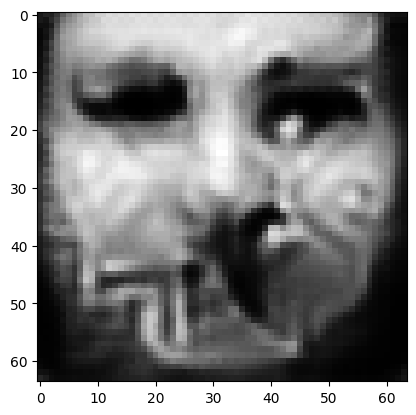

tensor([[9.5485e-01, 6.7520e-05, 2.5353e-03, 1.1853e-04, 3.9698e-04, 2.5339e-03,
         7.1321e-03, 7.9177e-03, 9.7718e-08, 3.3754e-04, 1.1845e-04, 7.3996e-05,
         1.4521e-05, 2.2374e-07, 1.0755e-04, 6.8341e-03, 5.5304e-04, 6.2270e-03,
         6.3792e-04, 2.2122e-04, 3.9406e-05, 7.8496e-05, 2.0270e-08, 6.6787e-03,
         2.2896e-05, 2.5459e-07, 2.2566e-04, 7.0956e-04, 1.0659e-03, 2.1661e-05,
         2.6063e-07, 1.4293e-04, 2.7684e-05, 2.5880e-05, 1.4041e-04, 2.7993e-05,
         5.2960e-05, 3.6915e-05, 1.8133e-05, 3.7066e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04619799181818962
tensor([[9.5487e-01, 6.7487e-05, 2.5338e-03, 1.1844e-04, 3.9667e-04, 2.5326e-03,
         7.1284e-03, 7.9136e-03, 9.7613e-08, 3.3735e-04, 1.1840e-04, 7.3966e-05,
         1.4510e-05, 2.2355e-07, 1.0749e-04, 6.8325e-03, 5.5260e-04, 6.2248e-03,
         6.3754e-04, 2.2112e-04, 3.9383e-05, 7.8457e-05, 2.0242e-08, 6.6752e-03,
         2.2873e-05, 2.5428e-07, 2.2554e-0

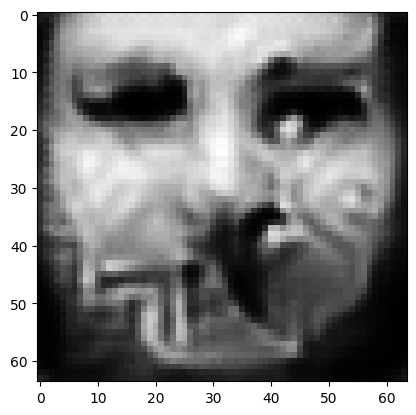

tensor([[9.5496e-01, 6.7379e-05, 2.5274e-03, 1.1818e-04, 3.9582e-04, 2.5270e-03,
         7.1146e-03, 7.8956e-03, 9.7305e-08, 3.3665e-04, 1.1815e-04, 7.3819e-05,
         1.4473e-05, 2.2294e-07, 1.0732e-04, 6.8265e-03, 5.5110e-04, 6.2184e-03,
         6.3634e-04, 2.2075e-04, 3.9305e-05, 7.8282e-05, 2.0157e-08, 6.6618e-03,
         2.2800e-05, 2.5322e-07, 2.2510e-04, 7.0738e-04, 1.0618e-03, 2.1579e-05,
         2.5946e-07, 1.4265e-04, 2.7576e-05, 2.5800e-05, 1.4008e-04, 2.7923e-05,
         5.2763e-05, 3.6781e-05, 1.8045e-05, 3.6894e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046089619398117065
tensor([[9.5498e-01, 6.7347e-05, 2.5261e-03, 1.1811e-04, 3.9558e-04, 2.5259e-03,
         7.1111e-03, 7.8921e-03, 9.7212e-08, 3.3649e-04, 1.1809e-04, 7.3785e-05,
         1.4463e-05, 2.2275e-07, 1.0727e-04, 6.8249e-03, 5.5071e-04, 6.2159e-03,
         6.3604e-04, 2.2064e-04, 3.9281e-05, 7.8239e-05, 2.0131e-08, 6.6581e-03,
         2.2778e-05, 2.5295e-07, 2.2498e-

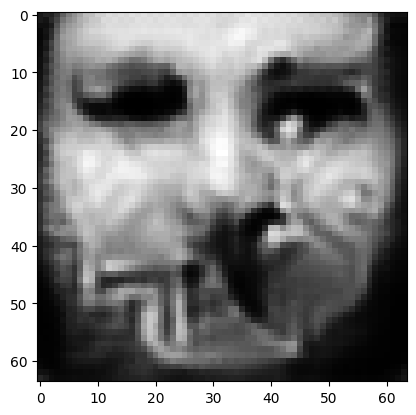

tensor([[9.5505e-01, 6.7247e-05, 2.5203e-03, 1.1787e-04, 3.9478e-04, 2.5209e-03,
         7.0978e-03, 7.8758e-03, 9.6909e-08, 3.3586e-04, 1.1786e-04, 7.3650e-05,
         1.4428e-05, 2.2214e-07, 1.0710e-04, 6.8199e-03, 5.4929e-04, 6.2090e-03,
         6.3491e-04, 2.2028e-04, 3.9204e-05, 7.8069e-05, 2.0045e-08, 6.6445e-03,
         2.2706e-05, 2.5193e-07, 2.2456e-04, 7.0530e-04, 1.0581e-03, 2.1500e-05,
         2.5833e-07, 1.4238e-04, 2.7466e-05, 2.5721e-05, 1.3978e-04, 2.7851e-05,
         5.2578e-05, 3.6650e-05, 1.7962e-05, 3.6736e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04598715901374817
tensor([[9.5507e-01, 6.7218e-05, 2.5188e-03, 1.1782e-04, 3.9463e-04, 2.5194e-03,
         7.0942e-03, 7.8728e-03, 9.6843e-08, 3.3578e-04, 1.1780e-04, 7.3596e-05,
         1.4419e-05, 2.2195e-07, 1.0706e-04, 6.8180e-03, 5.4903e-04, 6.2056e-03,
         6.3478e-04, 2.2021e-04, 3.9179e-05, 7.8034e-05, 2.0025e-08, 6.6427e-03,
         2.2690e-05, 2.5174e-07, 2.2442e-0

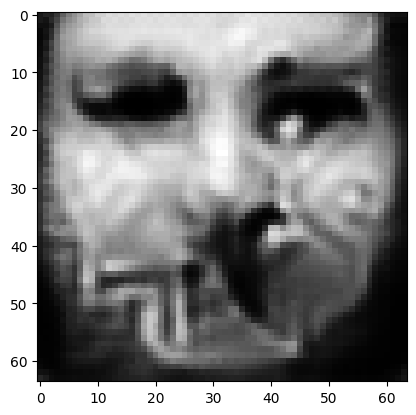

tensor([[9.5515e-01, 6.7107e-05, 2.5137e-03, 1.1758e-04, 3.9383e-04, 2.5147e-03,
         7.0816e-03, 7.8581e-03, 9.6541e-08, 3.3522e-04, 1.1759e-04, 7.3469e-05,
         1.4384e-05, 2.2135e-07, 1.0688e-04, 6.8125e-03, 5.4772e-04, 6.1978e-03,
         6.3373e-04, 2.1985e-04, 3.9103e-05, 7.7885e-05, 1.9944e-08, 6.6311e-03,
         2.2620e-05, 2.5082e-07, 2.2398e-04, 7.0332e-04, 1.0548e-03, 2.1432e-05,
         2.5733e-07, 1.4212e-04, 2.7369e-05, 2.5649e-05, 1.3947e-04, 2.7782e-05,
         5.2394e-05, 3.6535e-05, 1.7889e-05, 3.6586e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045890722423791885
tensor([[9.5516e-01, 6.7089e-05, 2.5123e-03, 1.1753e-04, 3.9365e-04, 2.5135e-03,
         7.0787e-03, 7.8535e-03, 9.6482e-08, 3.3503e-04, 1.1754e-04, 7.3443e-05,
         1.4377e-05, 2.2125e-07, 1.0685e-04, 6.8113e-03, 5.4737e-04, 6.1976e-03,
         6.3341e-04, 2.1978e-04, 3.9090e-05, 7.7845e-05, 1.9927e-08, 6.6276e-03,
         2.2606e-05, 2.5058e-07, 2.2391e-

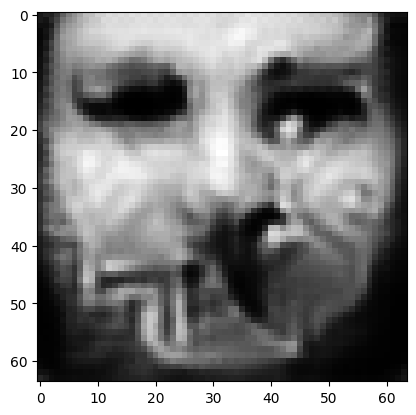

tensor([[9.5523e-01, 6.6988e-05, 2.5073e-03, 1.1732e-04, 3.9300e-04, 2.5087e-03,
         7.0665e-03, 7.8405e-03, 9.6219e-08, 3.3458e-04, 1.1733e-04, 7.3302e-05,
         1.4345e-05, 2.2066e-07, 1.0669e-04, 6.8059e-03, 5.4620e-04, 6.1888e-03,
         6.3258e-04, 2.1946e-04, 3.9014e-05, 7.7713e-05, 1.9852e-08, 6.6179e-03,
         2.2544e-05, 2.4978e-07, 2.2347e-04, 7.0147e-04, 1.0516e-03, 2.1368e-05,
         2.5644e-07, 1.4188e-04, 2.7278e-05, 2.5582e-05, 1.3921e-04, 2.7726e-05,
         5.2226e-05, 3.6427e-05, 1.7822e-05, 3.6447e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04580042511224747
tensor([[9.5525e-01, 6.6970e-05, 2.5058e-03, 1.1726e-04, 3.9280e-04, 2.5074e-03,
         7.0637e-03, 7.8357e-03, 9.6156e-08, 3.3437e-04, 1.1728e-04, 7.3279e-05,
         1.4338e-05, 2.2059e-07, 1.0667e-04, 6.8050e-03, 5.4592e-04, 6.1890e-03,
         6.3226e-04, 2.1939e-04, 3.9005e-05, 7.7666e-05, 1.9836e-08, 6.6148e-03,
         2.2531e-05, 2.4953e-07, 2.2339e-0

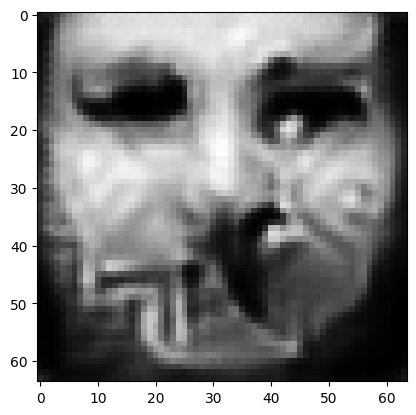

tensor([[9.5532e-01, 6.6871e-05, 2.5015e-03, 1.1706e-04, 3.9212e-04, 2.5034e-03,
         7.0520e-03, 7.8230e-03, 9.5890e-08, 3.3391e-04, 1.1710e-04, 7.3169e-05,
         1.4307e-05, 2.2004e-07, 1.0651e-04, 6.8000e-03, 5.4475e-04, 6.1815e-03,
         6.3132e-04, 2.1908e-04, 3.8937e-05, 7.7537e-05, 1.9762e-08, 6.6040e-03,
         2.2469e-05, 2.4875e-07, 2.2301e-04, 6.9980e-04, 1.0485e-03, 2.1304e-05,
         2.5553e-07, 1.4165e-04, 2.7192e-05, 2.5520e-05, 1.3897e-04, 2.7667e-05,
         5.2079e-05, 3.6325e-05, 1.7753e-05, 3.6315e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04571399465203285
tensor([[9.5533e-01, 6.6844e-05, 2.5002e-03, 1.1701e-04, 3.9201e-04, 2.5021e-03,
         7.0492e-03, 7.8207e-03, 9.5834e-08, 3.3384e-04, 1.1705e-04, 7.3124e-05,
         1.4300e-05, 2.1988e-07, 1.0647e-04, 6.7985e-03, 5.4452e-04, 6.1788e-03,
         6.3118e-04, 2.1901e-04, 3.8916e-05, 7.7509e-05, 1.9745e-08, 6.6026e-03,
         2.2456e-05, 2.4859e-07, 2.2289e-0

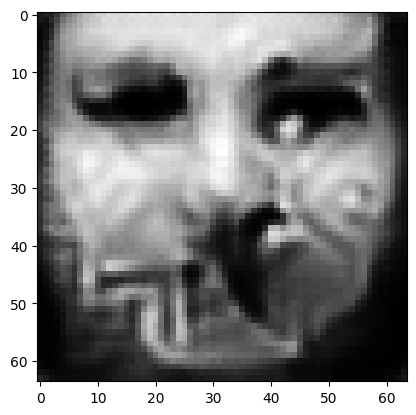

tensor([[9.5539e-01, 6.6755e-05, 2.4960e-03, 1.1682e-04, 3.9138e-04, 2.4982e-03,
         7.0384e-03, 7.8080e-03, 9.5592e-08, 3.3335e-04, 1.1687e-04, 7.3020e-05,
         1.4272e-05, 2.1941e-07, 1.0633e-04, 6.7937e-03, 5.4345e-04, 6.1729e-03,
         6.3026e-04, 2.1872e-04, 3.8856e-05, 7.7376e-05, 1.9678e-08, 6.5924e-03,
         2.2401e-05, 2.4784e-07, 2.2253e-04, 6.9815e-04, 1.0457e-03, 2.1246e-05,
         2.5472e-07, 1.4142e-04, 2.7112e-05, 2.5459e-05, 1.3873e-04, 2.7612e-05,
         5.1930e-05, 3.6230e-05, 1.7692e-05, 3.6189e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045633476227521896
tensor([[9.5541e-01, 6.6731e-05, 2.4951e-03, 1.1677e-04, 3.9122e-04, 2.4974e-03,
         7.0357e-03, 7.8053e-03, 9.5528e-08, 3.3324e-04, 1.1683e-04, 7.3000e-05,
         1.4265e-05, 2.1928e-07, 1.0629e-04, 6.7925e-03, 5.4316e-04, 6.1714e-03,
         6.2999e-04, 2.1865e-04, 3.8840e-05, 7.7346e-05, 1.9659e-08, 6.5894e-03,
         2.2386e-05, 2.4765e-07, 2.2245e-

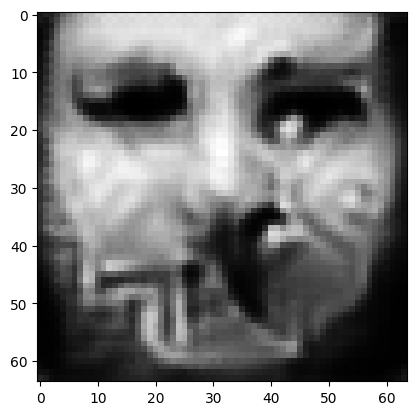

tensor([[9.5547e-01, 6.6648e-05, 2.4910e-03, 1.1660e-04, 3.9065e-04, 2.4935e-03,
         7.0256e-03, 7.7927e-03, 9.5311e-08, 3.3276e-04, 1.1667e-04, 7.2899e-05,
         1.4239e-05, 2.1886e-07, 1.0616e-04, 6.7880e-03, 5.4220e-04, 6.1666e-03,
         6.2912e-04, 2.1838e-04, 3.8787e-05, 7.7217e-05, 1.9602e-08, 6.5801e-03,
         2.2338e-05, 2.4695e-07, 2.2212e-04, 6.9663e-04, 1.0430e-03, 2.1189e-05,
         2.5393e-07, 1.4122e-04, 2.7036e-05, 2.5402e-05, 1.3852e-04, 2.7561e-05,
         5.1801e-05, 3.6142e-05, 1.7631e-05, 3.6074e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0455569364130497
tensor([[9.5548e-01, 6.6625e-05, 2.4899e-03, 1.1656e-04, 3.9056e-04, 2.4926e-03,
         7.0232e-03, 7.7909e-03, 9.5261e-08, 3.3271e-04, 1.1661e-04, 7.2861e-05,
         1.4232e-05, 2.1871e-07, 1.0612e-04, 6.7865e-03, 5.4197e-04, 6.1640e-03,
         6.2897e-04, 2.1832e-04, 3.8767e-05, 7.7191e-05, 1.9585e-08, 6.5780e-03,
         2.2325e-05, 2.4682e-07, 2.2202e-04

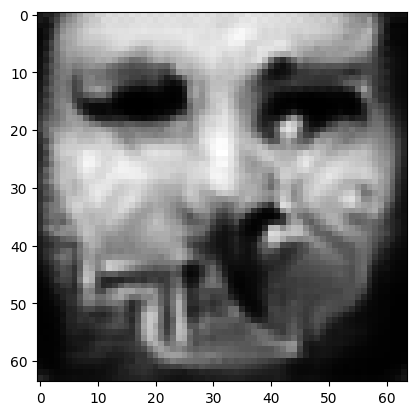

tensor([[9.5553e-01, 6.6543e-05, 2.4864e-03, 1.1639e-04, 3.9002e-04, 2.4893e-03,
         7.0132e-03, 7.7798e-03, 9.5043e-08, 3.3229e-04, 1.1646e-04, 7.2772e-05,
         1.4207e-05, 2.1828e-07, 1.0599e-04, 6.7825e-03, 5.4102e-04, 6.1586e-03,
         6.2812e-04, 2.1805e-04, 3.8713e-05, 7.7073e-05, 1.9526e-08, 6.5684e-03,
         2.2276e-05, 2.4616e-07, 2.2170e-04, 6.9518e-04, 1.0406e-03, 2.1135e-05,
         2.5318e-07, 1.4102e-04, 2.6962e-05, 2.5348e-05, 1.3831e-04, 2.7510e-05,
         5.1673e-05, 3.6058e-05, 1.7578e-05, 3.5966e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04548460617661476
tensor([[9.5555e-01, 6.6516e-05, 2.4855e-03, 1.1634e-04, 3.8986e-04, 2.4884e-03,
         7.0107e-03, 7.7773e-03, 9.4979e-08, 3.3220e-04, 1.1642e-04, 7.2750e-05,
         1.4200e-05, 2.1815e-07, 1.0595e-04, 6.7813e-03, 5.4079e-04, 6.1565e-03,
         6.2796e-04, 2.1798e-04, 3.8697e-05, 7.7053e-05, 1.9510e-08, 6.5670e-03,
         2.2262e-05, 2.4601e-07, 2.2161e-0

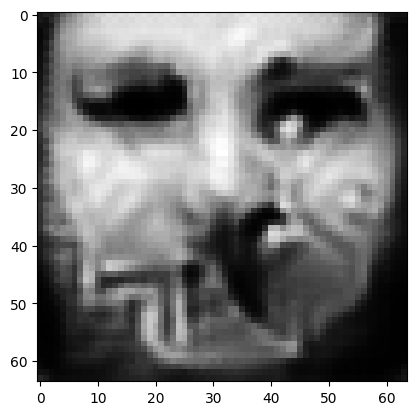

tensor([[9.5560e-01, 6.6439e-05, 2.4818e-03, 1.1619e-04, 3.8940e-04, 2.4849e-03,
         7.0012e-03, 7.7673e-03, 9.4782e-08, 3.3183e-04, 1.1626e-04, 7.2643e-05,
         1.4176e-05, 2.1773e-07, 1.0583e-04, 6.7769e-03, 5.3997e-04, 6.1504e-03,
         6.2725e-04, 2.1773e-04, 3.8642e-05, 7.6943e-05, 1.9456e-08, 6.5593e-03,
         2.2219e-05, 2.4543e-07, 2.2127e-04, 6.9379e-04, 1.0383e-03, 2.1088e-05,
         2.5249e-07, 1.4082e-04, 2.6895e-05, 2.5296e-05, 1.3810e-04, 2.7461e-05,
         5.1551e-05, 3.5979e-05, 1.7527e-05, 3.5860e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04541546106338501
tensor([[9.5561e-01, 6.6416e-05, 2.4810e-03, 1.1614e-04, 3.8925e-04, 2.4843e-03,
         6.9990e-03, 7.7652e-03, 9.4722e-08, 3.3174e-04, 1.1622e-04, 7.2624e-05,
         1.4170e-05, 2.1761e-07, 1.0579e-04, 6.7757e-03, 5.3972e-04, 6.1488e-03,
         6.2702e-04, 2.1767e-04, 3.8627e-05, 7.6917e-05, 1.9440e-08, 6.5568e-03,
         2.2205e-05, 2.4526e-07, 2.2120e-0

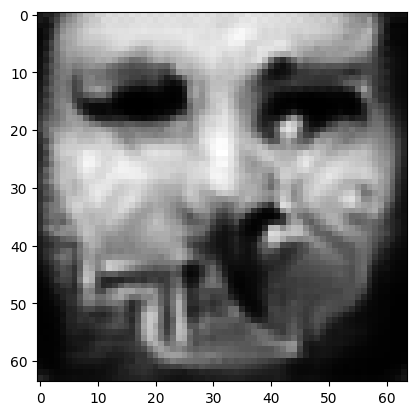

tensor([[9.5566e-01, 6.6338e-05, 2.4775e-03, 1.1599e-04, 3.8881e-04, 2.4810e-03,
         6.9900e-03, 7.7559e-03, 9.4531e-08, 3.3143e-04, 1.1607e-04, 7.2522e-05,
         1.4147e-05, 2.1719e-07, 1.0567e-04, 6.7716e-03, 5.3894e-04, 6.1422e-03,
         6.2642e-04, 2.1744e-04, 3.8572e-05, 7.6821e-05, 1.9388e-08, 6.5500e-03,
         2.2163e-05, 2.4473e-07, 2.2087e-04, 6.9246e-04, 1.0362e-03, 2.1041e-05,
         2.5183e-07, 1.4064e-04, 2.6832e-05, 2.5247e-05, 1.3789e-04, 2.7414e-05,
         5.1435e-05, 3.5904e-05, 1.7480e-05, 3.5762e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04535052925348282
tensor([[9.5567e-01, 6.6324e-05, 2.4766e-03, 1.1595e-04, 3.8868e-04, 2.4801e-03,
         6.9880e-03, 7.7527e-03, 9.4489e-08, 3.3129e-04, 1.1604e-04, 7.2508e-05,
         1.4142e-05, 2.1713e-07, 1.0565e-04, 6.7708e-03, 5.3870e-04, 6.1420e-03,
         6.2618e-04, 2.1739e-04, 3.8564e-05, 7.6795e-05, 1.9378e-08, 6.5478e-03,
         2.2153e-05, 2.4458e-07, 2.2082e-0

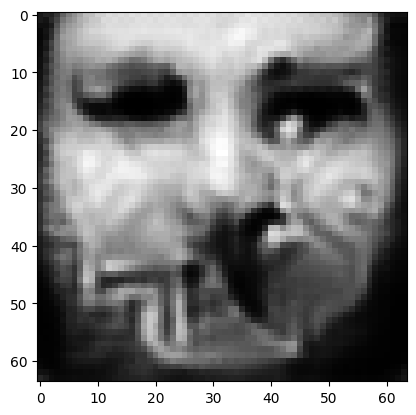

tensor([[9.5572e-01, 6.6247e-05, 2.4735e-03, 1.1580e-04, 3.8820e-04, 2.4773e-03,
         6.9794e-03, 7.7442e-03, 9.4293e-08, 3.3097e-04, 1.1591e-04, 7.2423e-05,
         1.4120e-05, 2.1672e-07, 1.0553e-04, 6.7668e-03, 5.3791e-04, 6.1360e-03,
         6.2552e-04, 2.1716e-04, 3.8512e-05, 7.6701e-05, 1.9324e-08, 6.5405e-03,
         2.2110e-05, 2.4403e-07, 2.2052e-04, 6.9124e-04, 1.0341e-03, 2.0996e-05,
         2.5118e-07, 1.4048e-04, 2.6772e-05, 2.5202e-05, 1.3771e-04, 2.7371e-05,
         5.1332e-05, 3.5832e-05, 1.7432e-05, 3.5668e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04528855159878731
tensor([[9.5573e-01, 6.6236e-05, 2.4724e-03, 1.1578e-04, 3.8815e-04, 2.4763e-03,
         6.9776e-03, 7.7413e-03, 9.4269e-08, 3.3088e-04, 1.1587e-04, 7.2395e-05,
         1.4116e-05, 2.1666e-07, 1.0552e-04, 6.7660e-03, 5.3776e-04, 6.1354e-03,
         6.2540e-04, 2.1712e-04, 3.8504e-05, 7.6679e-05, 1.9318e-08, 6.5394e-03,
         2.2104e-05, 2.4393e-07, 2.2046e-0

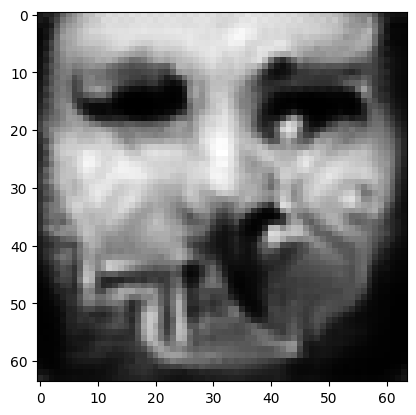

tensor([[9.5578e-01, 6.6161e-05, 2.4696e-03, 1.1562e-04, 3.8769e-04, 2.4738e-03,
         6.9693e-03, 7.7335e-03, 9.4074e-08, 3.3056e-04, 1.1574e-04, 7.2319e-05,
         1.4094e-05, 2.1626e-07, 1.0540e-04, 6.7621e-03, 5.3698e-04, 6.1295e-03,
         6.2472e-04, 2.1689e-04, 3.8452e-05, 7.6589e-05, 1.9265e-08, 6.5321e-03,
         2.2061e-05, 2.4340e-07, 2.2018e-04, 6.9004e-04, 1.0321e-03, 2.0955e-05,
         2.5059e-07, 1.4032e-04, 2.6714e-05, 2.5158e-05, 1.3753e-04, 2.7331e-05,
         5.1231e-05, 3.5765e-05, 1.7388e-05, 3.5579e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04522976279258728
tensor([[9.5579e-01, 6.6145e-05, 2.4688e-03, 1.1559e-04, 3.8756e-04, 2.4730e-03,
         6.9675e-03, 7.7307e-03, 9.4031e-08, 3.3047e-04, 1.1572e-04, 7.2302e-05,
         1.4089e-05, 2.1619e-07, 1.0537e-04, 6.7614e-03, 5.3680e-04, 6.1287e-03,
         6.2456e-04, 2.1685e-04, 3.8444e-05, 7.6568e-05, 1.9255e-08, 6.5306e-03,
         2.2052e-05, 2.4327e-07, 2.2012e-0

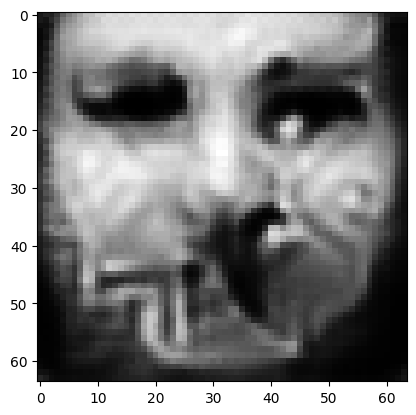

tensor([[9.5583e-01, 6.6079e-05, 2.4660e-03, 1.1547e-04, 3.8721e-04, 2.4703e-03,
         6.9595e-03, 7.7231e-03, 9.3869e-08, 3.3022e-04, 1.1559e-04, 7.2218e-05,
         1.4069e-05, 2.1583e-07, 1.0527e-04, 6.7581e-03, 5.3615e-04, 6.1229e-03,
         6.2404e-04, 2.1664e-04, 3.8398e-05, 7.6484e-05, 1.9211e-08, 6.5245e-03,
         2.2016e-05, 2.4283e-07, 2.1984e-04, 6.8893e-04, 1.0303e-03, 2.0917e-05,
         2.5005e-07, 1.4016e-04, 2.6660e-05, 2.5117e-05, 1.3737e-04, 2.7293e-05,
         5.1135e-05, 3.5703e-05, 1.7348e-05, 3.5497e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04517427086830139
tensor([[9.5584e-01, 6.6061e-05, 2.4652e-03, 1.1542e-04, 3.8708e-04, 2.4696e-03,
         6.9579e-03, 7.7208e-03, 9.3824e-08, 3.3011e-04, 1.1556e-04, 7.2203e-05,
         1.4065e-05, 2.1576e-07, 1.0524e-04, 6.7570e-03, 5.3595e-04, 6.1221e-03,
         6.2384e-04, 2.1659e-04, 3.8388e-05, 7.6463e-05, 1.9200e-08, 6.5229e-03,
         2.2007e-05, 2.4270e-07, 2.1978e-0

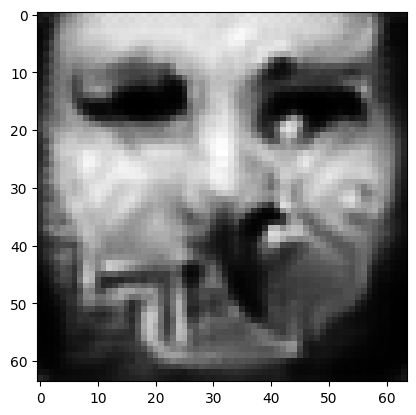

tensor([[9.5588e-01, 6.6002e-05, 2.4623e-03, 1.1531e-04, 3.8675e-04, 2.4669e-03,
         6.9505e-03, 7.7132e-03, 9.3675e-08, 3.2985e-04, 1.1543e-04, 7.2122e-05,
         1.4047e-05, 2.1543e-07, 1.0515e-04, 6.7538e-03, 5.3531e-04, 6.1172e-03,
         6.2333e-04, 2.1640e-04, 3.8345e-05, 7.6383e-05, 1.9159e-08, 6.5171e-03,
         2.1973e-05, 2.4226e-07, 2.1953e-04, 6.8786e-04, 1.0285e-03, 2.0880e-05,
         2.4953e-07, 1.4002e-04, 2.6609e-05, 2.5077e-05, 1.3721e-04, 2.7258e-05,
         5.1043e-05, 3.5642e-05, 1.7309e-05, 3.5417e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04512174427509308
tensor([[9.5589e-01, 6.5986e-05, 2.4618e-03, 1.1528e-04, 3.8664e-04, 2.4663e-03,
         6.9487e-03, 7.7110e-03, 9.3634e-08, 3.2977e-04, 1.1541e-04, 7.2109e-05,
         1.4042e-05, 2.1536e-07, 1.0513e-04, 6.7531e-03, 5.3514e-04, 6.1164e-03,
         6.2317e-04, 2.1636e-04, 3.8336e-05, 7.6363e-05, 1.9149e-08, 6.5153e-03,
         2.1964e-05, 2.4215e-07, 2.1948e-0

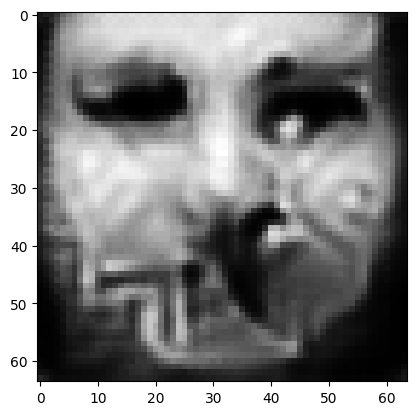

tensor([[9.5593e-01, 6.5927e-05, 2.4590e-03, 1.1516e-04, 3.8627e-04, 2.4638e-03,
         6.9419e-03, 7.7030e-03, 9.3487e-08, 3.2946e-04, 1.1530e-04, 7.2042e-05,
         1.4025e-05, 2.1508e-07, 1.0504e-04, 6.7499e-03, 5.3451e-04, 6.1127e-03,
         6.2260e-04, 2.1618e-04, 3.8299e-05, 7.6286e-05, 1.9110e-08, 6.5097e-03,
         2.1933e-05, 2.4171e-07, 2.1924e-04, 6.8688e-04, 1.0268e-03, 2.0844e-05,
         2.4902e-07, 1.3988e-04, 2.6563e-05, 2.5041e-05, 1.3707e-04, 2.7225e-05,
         5.0964e-05, 3.5586e-05, 1.7270e-05, 3.5340e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04507149010896683
tensor([[9.5594e-01, 6.5912e-05, 2.4584e-03, 1.1513e-04, 3.8621e-04, 2.4632e-03,
         6.9401e-03, 7.7020e-03, 9.3453e-08, 3.2944e-04, 1.1527e-04, 7.2018e-05,
         1.4020e-05, 2.1497e-07, 1.0502e-04, 6.7490e-03, 5.3436e-04, 6.1106e-03,
         6.2253e-04, 2.1613e-04, 3.8285e-05, 7.6271e-05, 1.9099e-08, 6.5085e-03,
         2.1925e-05, 2.4163e-07, 2.1917e-0

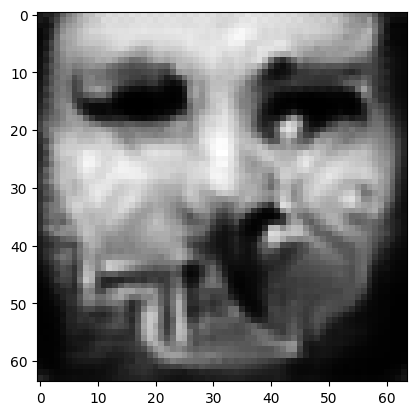

tensor([[9.5597e-01, 6.5858e-05, 2.4559e-03, 1.1502e-04, 3.8585e-04, 2.4609e-03,
         6.9337e-03, 7.6944e-03, 9.3313e-08, 3.2914e-04, 1.1516e-04, 7.1957e-05,
         1.4004e-05, 2.1470e-07, 1.0493e-04, 6.7461e-03, 5.3375e-04, 6.1073e-03,
         6.2197e-04, 2.1596e-04, 3.8251e-05, 7.6195e-05, 1.9062e-08, 6.5027e-03,
         2.1894e-05, 2.4121e-07, 2.1896e-04, 6.8592e-04, 1.0252e-03, 2.0811e-05,
         2.4854e-07, 1.3975e-04, 2.6516e-05, 2.5005e-05, 1.3694e-04, 2.7193e-05,
         5.0880e-05, 3.5531e-05, 1.7235e-05, 3.5270e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04502397030591965
tensor([[9.5598e-01, 6.5842e-05, 2.4553e-03, 1.1499e-04, 3.8575e-04, 2.4604e-03,
         6.9321e-03, 7.6926e-03, 9.3274e-08, 3.2908e-04, 1.1514e-04, 7.1942e-05,
         1.4000e-05, 2.1463e-07, 1.0491e-04, 6.7453e-03, 5.3361e-04, 6.1062e-03,
         6.2184e-04, 2.1592e-04, 3.8241e-05, 7.6179e-05, 1.9052e-08, 6.5015e-03,
         2.1886e-05, 2.4111e-07, 2.1890e-0

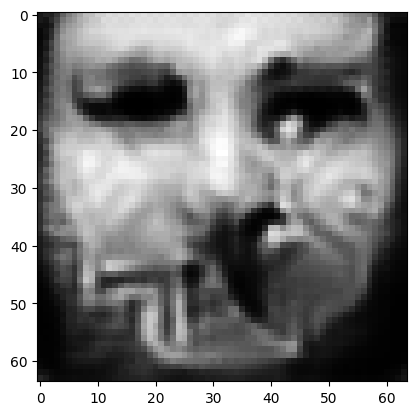

tensor([[9.5602e-01, 6.5791e-05, 2.4529e-03, 1.1489e-04, 3.8547e-04, 2.4581e-03,
         6.9260e-03, 7.6860e-03, 9.3153e-08, 3.2884e-04, 1.1504e-04, 7.1873e-05,
         1.3985e-05, 2.1435e-07, 1.0483e-04, 6.7423e-03, 5.3306e-04, 6.1023e-03,
         6.2139e-04, 2.1576e-04, 3.8206e-05, 7.6112e-05, 1.9019e-08, 6.4966e-03,
         2.1859e-05, 2.4075e-07, 2.1869e-04, 6.8499e-04, 1.0237e-03, 2.0780e-05,
         2.4811e-07, 1.3963e-04, 2.6474e-05, 2.4971e-05, 1.3681e-04, 2.7164e-05,
         5.0802e-05, 3.5482e-05, 1.7203e-05, 3.5203e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044978611171245575
tensor([[9.5603e-01, 6.5777e-05, 2.4523e-03, 1.1486e-04, 3.8538e-04, 2.4576e-03,
         6.9244e-03, 7.6843e-03, 9.3117e-08, 3.2879e-04, 1.1502e-04, 7.1861e-05,
         1.3981e-05, 2.1429e-07, 1.0481e-04, 6.7417e-03, 5.3291e-04, 6.1013e-03,
         6.2128e-04, 2.1573e-04, 3.8197e-05, 7.6095e-05, 1.9009e-08, 6.4952e-03,
         2.1851e-05, 2.4065e-07, 2.1864e-

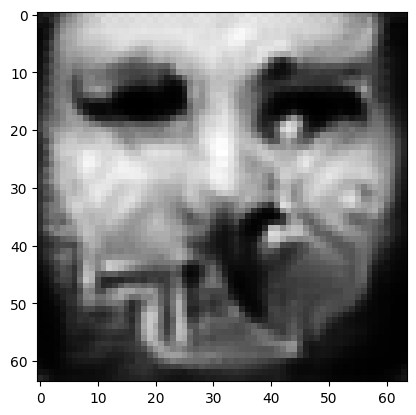

tensor([[9.5606e-01, 6.5724e-05, 2.4501e-03, 1.1476e-04, 3.8506e-04, 2.4556e-03,
         6.9185e-03, 7.6781e-03, 9.2985e-08, 3.2853e-04, 1.1493e-04, 7.1803e-05,
         1.3966e-05, 2.1403e-07, 1.0473e-04, 6.7386e-03, 5.3236e-04, 6.0977e-03,
         6.2076e-04, 2.1557e-04, 3.8163e-05, 7.6029e-05, 1.8974e-08, 6.4901e-03,
         2.1823e-05, 2.4027e-07, 2.1844e-04, 6.8416e-04, 1.0222e-03, 2.0749e-05,
         2.4766e-07, 1.3951e-04, 2.6433e-05, 2.4941e-05, 1.3667e-04, 2.7133e-05,
         5.0731e-05, 3.5432e-05, 1.7170e-05, 3.5136e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04493553191423416
tensor([[9.5607e-01, 6.5714e-05, 2.4495e-03, 1.1474e-04, 3.8503e-04, 2.4550e-03,
         6.9171e-03, 7.6766e-03, 9.2963e-08, 3.2849e-04, 1.1489e-04, 7.1783e-05,
         1.3963e-05, 2.1396e-07, 1.0471e-04, 6.7379e-03, 5.3225e-04, 6.0968e-03,
         6.2068e-04, 2.1554e-04, 3.8154e-05, 7.6012e-05, 1.8968e-08, 6.4889e-03,
         2.1818e-05, 2.4020e-07, 2.1839e-0

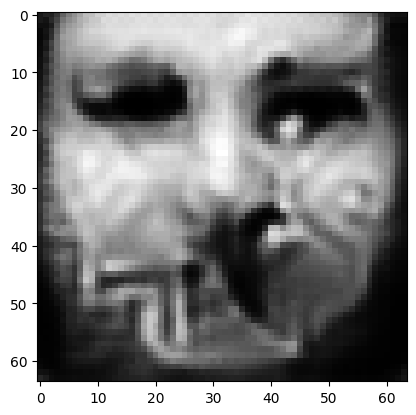

tensor([[9.5610e-01, 6.5660e-05, 2.4475e-03, 1.1464e-04, 3.8471e-04, 2.4531e-03,
         6.9114e-03, 7.6710e-03, 9.2834e-08, 3.2827e-04, 1.1481e-04, 7.1729e-05,
         1.3948e-05, 2.1371e-07, 1.0463e-04, 6.7350e-03, 5.3174e-04, 6.0927e-03,
         6.2022e-04, 2.1538e-04, 3.8120e-05, 7.5951e-05, 1.8933e-08, 6.4844e-03,
         2.1791e-05, 2.3985e-07, 2.1818e-04, 6.8333e-04, 1.0209e-03, 2.0721e-05,
         2.4726e-07, 1.3939e-04, 2.6394e-05, 2.4911e-05, 1.3655e-04, 2.7104e-05,
         5.0660e-05, 3.5387e-05, 1.7141e-05, 3.5075e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0448945015668869
tensor([[9.5611e-01, 6.5652e-05, 2.4468e-03, 1.1462e-04, 3.8464e-04, 2.4525e-03,
         6.9100e-03, 7.6686e-03, 9.2809e-08, 3.2819e-04, 1.1479e-04, 7.1718e-05,
         1.3946e-05, 2.1368e-07, 1.0463e-04, 6.7346e-03, 5.3162e-04, 6.0927e-03,
         6.2010e-04, 2.1535e-04, 3.8116e-05, 7.5935e-05, 1.8928e-08, 6.4832e-03,
         2.1786e-05, 2.3976e-07, 2.1815e-04

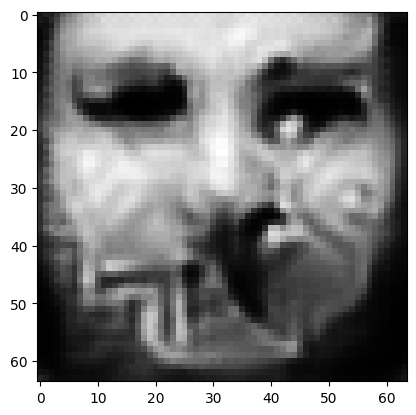

tensor([[9.5614e-01, 6.5599e-05, 2.4449e-03, 1.1452e-04, 3.8437e-04, 2.4505e-03,
         6.9042e-03, 7.6631e-03, 9.2686e-08, 3.2799e-04, 1.1471e-04, 7.1662e-05,
         1.3932e-05, 2.1344e-07, 1.0455e-04, 6.7318e-03, 5.3119e-04, 6.0886e-03,
         6.1968e-04, 2.1520e-04, 3.8084e-05, 7.5875e-05, 1.8895e-08, 6.4792e-03,
         2.1760e-05, 2.3945e-07, 2.1792e-04, 6.8254e-04, 1.0195e-03, 2.0694e-05,
         2.4688e-07, 1.3928e-04, 2.6356e-05, 2.4883e-05, 1.3644e-04, 2.7077e-05,
         5.0597e-05, 3.5345e-05, 1.7111e-05, 3.5014e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04485449567437172
tensor([[9.5614e-01, 6.5585e-05, 2.4444e-03, 1.1450e-04, 3.8434e-04, 2.4500e-03,
         6.9029e-03, 7.6621e-03, 9.2662e-08, 3.2796e-04, 1.1468e-04, 7.1642e-05,
         1.3928e-05, 2.1338e-07, 1.0453e-04, 6.7308e-03, 5.3111e-04, 6.0874e-03,
         6.1959e-04, 2.1517e-04, 3.8074e-05, 7.5859e-05, 1.8889e-08, 6.4784e-03,
         2.1756e-05, 2.3940e-07, 2.1786e-0

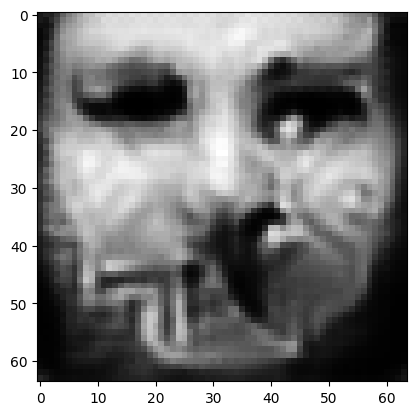

tensor([[9.5617e-01, 6.5540e-05, 2.4425e-03, 1.1442e-04, 3.8409e-04, 2.4481e-03,
         6.8977e-03, 7.6562e-03, 9.2556e-08, 3.2775e-04, 1.1461e-04, 7.1592e-05,
         1.3916e-05, 2.1318e-07, 1.0446e-04, 6.7281e-03, 5.3068e-04, 6.0846e-03,
         6.1917e-04, 2.1503e-04, 3.8047e-05, 7.5801e-05, 1.8862e-08, 6.4744e-03,
         2.1734e-05, 2.3909e-07, 2.1767e-04, 6.8177e-04, 1.0182e-03, 2.0669e-05,
         2.4654e-07, 1.3917e-04, 2.6321e-05, 2.4855e-05, 1.3634e-04, 2.7054e-05,
         5.0535e-05, 3.5306e-05, 1.7084e-05, 3.4957e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044817108660936356
tensor([[9.5618e-01, 6.5529e-05, 2.4421e-03, 1.1440e-04, 3.8403e-04, 2.4477e-03,
         6.8962e-03, 7.6548e-03, 9.2524e-08, 3.2770e-04, 1.1459e-04, 7.1584e-05,
         1.3913e-05, 2.1313e-07, 1.0444e-04, 6.7277e-03, 5.3058e-04, 6.0836e-03,
         6.1906e-04, 2.1499e-04, 3.8041e-05, 7.5786e-05, 1.8853e-08, 6.4731e-03,
         2.1727e-05, 2.3901e-07, 2.1763e-

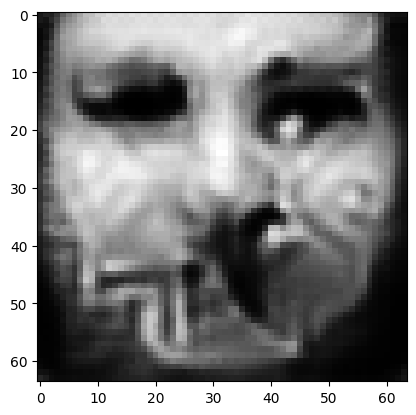

tensor([[9.5621e-01, 6.5483e-05, 2.4404e-03, 1.1431e-04, 3.8378e-04, 2.4460e-03,
         6.8912e-03, 7.6496e-03, 9.2416e-08, 3.2751e-04, 1.1452e-04, 7.1536e-05,
         1.3900e-05, 2.1293e-07, 1.0438e-04, 6.7252e-03, 5.3017e-04, 6.0804e-03,
         6.1866e-04, 2.1486e-04, 3.8013e-05, 7.5732e-05, 1.8825e-08, 6.4694e-03,
         2.1704e-05, 2.3873e-07, 2.1744e-04, 6.8108e-04, 1.0170e-03, 2.0644e-05,
         2.4618e-07, 1.3907e-04, 2.6286e-05, 2.4830e-05, 1.3624e-04, 2.7027e-05,
         5.0478e-05, 3.5268e-05, 1.7057e-05, 3.4902e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04478120431303978
tensor([[9.5621e-01, 6.5471e-05, 2.4399e-03, 1.1429e-04, 3.8371e-04, 2.4455e-03,
         6.8899e-03, 7.6481e-03, 9.2389e-08, 3.2746e-04, 1.1450e-04, 7.1525e-05,
         1.3898e-05, 2.1288e-07, 1.0436e-04, 6.7245e-03, 5.3008e-04, 6.0798e-03,
         6.1855e-04, 2.1483e-04, 3.8007e-05, 7.5717e-05, 1.8819e-08, 6.4686e-03,
         2.1699e-05, 2.3865e-07, 2.1739e-0

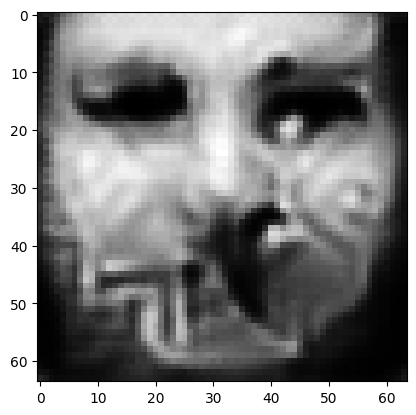

tensor([[9.5624e-01, 6.5426e-05, 2.4384e-03, 1.1421e-04, 3.8349e-04, 2.4440e-03,
         6.8850e-03, 7.6437e-03, 9.2283e-08, 3.2730e-04, 1.1444e-04, 7.1480e-05,
         1.3886e-05, 2.1268e-07, 1.0429e-04, 6.7222e-03, 5.2971e-04, 6.0761e-03,
         6.1819e-04, 2.1470e-04, 3.7979e-05, 7.5665e-05, 1.8791e-08, 6.4649e-03,
         2.1677e-05, 2.3839e-07, 2.1721e-04, 6.8042e-04, 1.0159e-03, 2.0621e-05,
         2.4585e-07, 1.3897e-04, 2.6253e-05, 2.4806e-05, 1.3613e-04, 2.7001e-05,
         5.0423e-05, 3.5232e-05, 1.7031e-05, 3.4849e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04474746063351631
tensor([[9.5625e-01, 6.5420e-05, 2.4378e-03, 1.1420e-04, 3.8347e-04, 2.4434e-03,
         6.8839e-03, 7.6420e-03, 9.2273e-08, 3.2726e-04, 1.1441e-04, 7.1464e-05,
         1.3884e-05, 2.1264e-07, 1.0429e-04, 6.7218e-03, 5.2963e-04, 6.0758e-03,
         6.1813e-04, 2.1468e-04, 3.7974e-05, 7.5652e-05, 1.8787e-08, 6.4642e-03,
         2.1674e-05, 2.3834e-07, 2.1717e-0

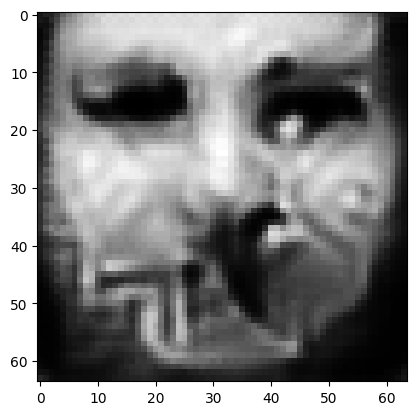

tensor([[9.5627e-01, 6.5378e-05, 2.4364e-03, 1.1413e-04, 3.8327e-04, 2.4420e-03,
         6.8793e-03, 7.6381e-03, 9.2173e-08, 3.2708e-04, 1.1435e-04, 7.1419e-05,
         1.3872e-05, 2.1245e-07, 1.0422e-04, 6.7190e-03, 5.2928e-04, 6.0726e-03,
         6.1773e-04, 2.1455e-04, 3.7947e-05, 7.5597e-05, 1.8760e-08, 6.4604e-03,
         2.1654e-05, 2.3808e-07, 2.1700e-04, 6.7979e-04, 1.0148e-03, 2.0599e-05,
         2.4555e-07, 1.3887e-04, 2.6222e-05, 2.4782e-05, 1.3605e-04, 2.6979e-05,
         5.0369e-05, 3.5197e-05, 1.7008e-05, 3.4801e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044715315103530884
tensor([[9.5628e-01, 6.5367e-05, 2.4360e-03, 1.1411e-04, 3.8321e-04, 2.4416e-03,
         6.8782e-03, 7.6369e-03, 9.2147e-08, 3.2704e-04, 1.1433e-04, 7.1411e-05,
         1.3869e-05, 2.1241e-07, 1.0421e-04, 6.7185e-03, 5.2919e-04, 6.0720e-03,
         6.1764e-04, 2.1452e-04, 3.7941e-05, 7.5585e-05, 1.8753e-08, 6.4594e-03,
         2.1649e-05, 2.3802e-07, 2.1696e-

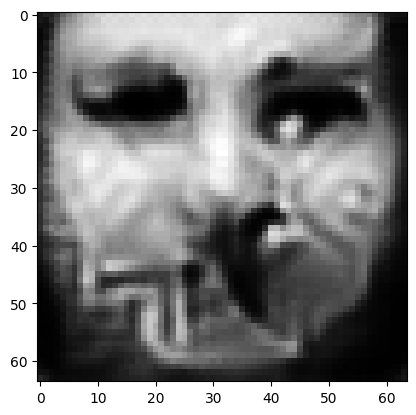

tensor([[9.5630e-01, 6.5327e-05, 2.4347e-03, 1.1404e-04, 3.8303e-04, 2.4403e-03,
         6.8739e-03, 7.6331e-03, 9.2057e-08, 3.2688e-04, 1.1427e-04, 7.1370e-05,
         1.3859e-05, 2.1223e-07, 1.0415e-04, 6.7161e-03, 5.2884e-04, 6.0691e-03,
         6.1727e-04, 2.1441e-04, 3.7915e-05, 7.5535e-05, 1.8728e-08, 6.4557e-03,
         2.1630e-05, 2.3777e-07, 2.1680e-04, 6.7921e-04, 1.0138e-03, 2.0578e-05,
         2.4525e-07, 1.3878e-04, 2.6192e-05, 2.4761e-05, 1.3596e-04, 2.6956e-05,
         5.0321e-05, 3.5164e-05, 1.6986e-05, 3.4755e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04468487575650215
tensor([[9.5630e-01, 6.5320e-05, 2.4343e-03, 1.1403e-04, 3.8298e-04, 2.4400e-03,
         6.8728e-03, 7.6317e-03, 9.2038e-08, 3.2682e-04, 1.1426e-04, 7.1362e-05,
         1.3856e-05, 2.1220e-07, 1.0414e-04, 6.7157e-03, 5.2876e-04, 6.0690e-03,
         6.1716e-04, 2.1438e-04, 3.7912e-05, 7.5518e-05, 1.8722e-08, 6.4545e-03,
         2.1626e-05, 2.3771e-07, 2.1677e-0

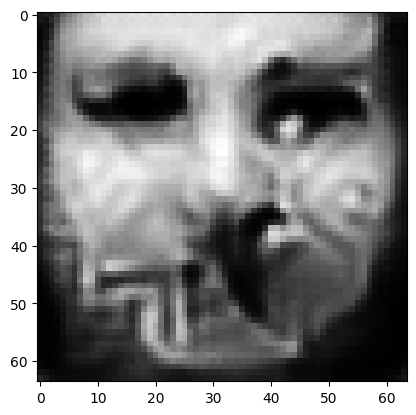

tensor([[9.5633e-01, 6.5283e-05, 2.4330e-03, 1.1397e-04, 3.8281e-04, 2.4387e-03,
         6.8687e-03, 7.6279e-03, 9.1953e-08, 3.2667e-04, 1.1420e-04, 7.1322e-05,
         1.3846e-05, 2.1203e-07, 1.0408e-04, 6.7134e-03, 5.2843e-04, 6.0662e-03,
         6.1683e-04, 2.1428e-04, 3.7888e-05, 7.5472e-05, 1.8699e-08, 6.4511e-03,
         2.1608e-05, 2.3748e-07, 2.1662e-04, 6.7866e-04, 1.0128e-03, 2.0557e-05,
         2.4497e-07, 1.3870e-04, 2.6164e-05, 2.4740e-05, 1.3589e-04, 2.6936e-05,
         5.0275e-05, 3.5132e-05, 1.6964e-05, 3.4711e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044655691832304
tensor([[9.5633e-01, 6.5272e-05, 2.4327e-03, 1.1395e-04, 3.8276e-04, 2.4385e-03,
         6.8678e-03, 7.6273e-03, 9.1927e-08, 3.2663e-04, 1.1418e-04, 7.1314e-05,
         1.3844e-05, 2.1198e-07, 1.0407e-04, 6.7127e-03, 5.2834e-04, 6.0655e-03,
         6.1672e-04, 2.1425e-04, 3.7881e-05, 7.5459e-05, 1.8692e-08, 6.4501e-03,
         2.1603e-05, 2.3742e-07, 2.1658e-04,

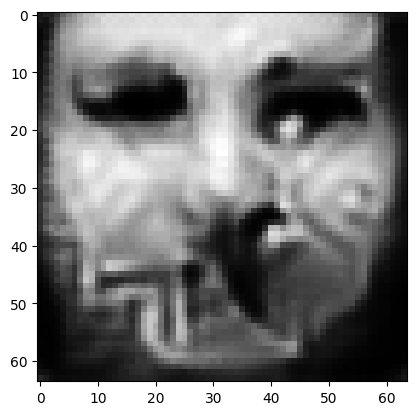

tensor([[9.5635e-01, 6.5237e-05, 2.4314e-03, 1.1389e-04, 3.8259e-04, 2.4373e-03,
         6.8638e-03, 7.6237e-03, 9.1846e-08, 3.2648e-04, 1.1413e-04, 7.1277e-05,
         1.3834e-05, 2.1183e-07, 1.0401e-04, 6.7105e-03, 5.2803e-04, 6.0630e-03,
         6.1637e-04, 2.1414e-04, 3.7859e-05, 7.5412e-05, 1.8669e-08, 6.4466e-03,
         2.1586e-05, 2.3720e-07, 2.1644e-04, 6.7813e-04, 1.0118e-03, 2.0537e-05,
         2.4468e-07, 1.3861e-04, 2.6136e-05, 2.4720e-05, 1.3581e-04, 2.6914e-05,
         5.0230e-05, 3.5100e-05, 1.6943e-05, 3.4669e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04462799057364464
tensor([[9.5636e-01, 6.5231e-05, 2.4310e-03, 1.1388e-04, 3.8257e-04, 2.4368e-03,
         6.8628e-03, 7.6227e-03, 9.1835e-08, 3.2645e-04, 1.1411e-04, 7.1263e-05,
         1.3832e-05, 2.1180e-07, 1.0401e-04, 6.7099e-03, 5.2797e-04, 6.0625e-03,
         6.1632e-04, 2.1413e-04, 3.7854e-05, 7.5400e-05, 1.8665e-08, 6.4460e-03,
         2.1583e-05, 2.3716e-07, 2.1640e-0

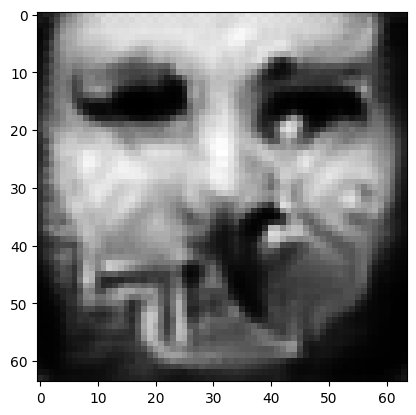

tensor([[9.5638e-01, 6.5197e-05, 2.4299e-03, 1.1383e-04, 3.8242e-04, 2.4358e-03,
         6.8591e-03, 7.6194e-03, 9.1758e-08, 3.2631e-04, 1.1406e-04, 7.1229e-05,
         1.3823e-05, 2.1165e-07, 1.0396e-04, 6.7078e-03, 5.2768e-04, 6.0601e-03,
         6.1600e-04, 2.1403e-04, 3.7832e-05, 7.5354e-05, 1.8643e-08, 6.4426e-03,
         2.1567e-05, 2.3695e-07, 2.1627e-04, 6.7761e-04, 1.0109e-03, 2.0519e-05,
         2.4443e-07, 1.3854e-04, 2.6110e-05, 2.4701e-05, 1.3574e-04, 2.6896e-05,
         5.0186e-05, 3.5072e-05, 1.6925e-05, 3.4630e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044601768255233765
tensor([[9.5638e-01, 6.5187e-05, 2.4296e-03, 1.1381e-04, 3.8238e-04, 2.4355e-03,
         6.8582e-03, 7.6186e-03, 9.1736e-08, 3.2628e-04, 1.1405e-04, 7.1221e-05,
         1.3821e-05, 2.1161e-07, 1.0394e-04, 6.7072e-03, 5.2761e-04, 6.0594e-03,
         6.1591e-04, 2.1400e-04, 3.7826e-05, 7.5344e-05, 1.8637e-08, 6.4419e-03,
         2.1562e-05, 2.3690e-07, 2.1623e-

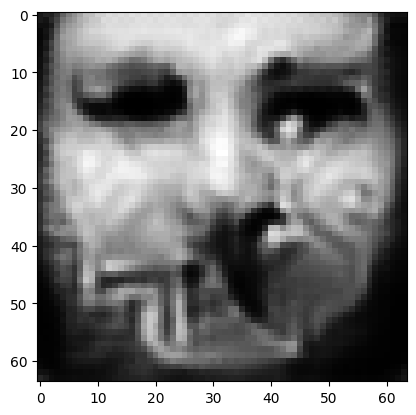

tensor([[9.5640e-01, 6.5155e-05, 2.4286e-03, 1.1375e-04, 3.8221e-04, 2.4345e-03,
         6.8547e-03, 7.6153e-03, 9.1661e-08, 3.2613e-04, 1.1400e-04, 7.1192e-05,
         1.3812e-05, 2.1147e-07, 1.0389e-04, 6.7052e-03, 5.2731e-04, 6.0574e-03,
         6.1556e-04, 2.1390e-04, 3.7806e-05, 7.5299e-05, 1.8616e-08, 6.4383e-03,
         2.1546e-05, 2.3669e-07, 2.1611e-04, 6.7714e-04, 1.0101e-03, 2.0500e-05,
         2.4417e-07, 1.3846e-04, 2.6085e-05, 2.4684e-05, 1.3567e-04, 2.6876e-05,
         5.0147e-05, 3.5044e-05, 1.6905e-05, 3.4592e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044576458632946014
tensor([[9.5641e-01, 6.5148e-05, 2.4282e-03, 1.1374e-04, 3.8219e-04, 2.4342e-03,
         6.8538e-03, 7.6145e-03, 9.1648e-08, 3.2612e-04, 1.1398e-04, 7.1179e-05,
         1.3810e-05, 2.1143e-07, 1.0388e-04, 6.7047e-03, 5.2726e-04, 6.0567e-03,
         6.1553e-04, 2.1389e-04, 3.7801e-05, 7.5291e-05, 1.8611e-08, 6.4379e-03,
         2.1543e-05, 2.3666e-07, 2.1607e-

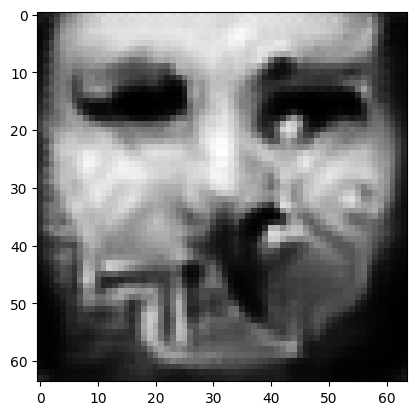

tensor([[9.5643e-01, 6.5117e-05, 2.4272e-03, 1.1369e-04, 3.8203e-04, 2.4332e-03,
         6.8505e-03, 7.6113e-03, 9.1576e-08, 3.2597e-04, 1.1394e-04, 7.1151e-05,
         1.3802e-05, 2.1130e-07, 1.0384e-04, 6.7028e-03, 5.2697e-04, 6.0549e-03,
         6.1520e-04, 2.1380e-04, 3.7782e-05, 7.5247e-05, 1.8591e-08, 6.4345e-03,
         2.1528e-05, 2.3645e-07, 2.1596e-04, 6.7668e-04, 1.0092e-03, 2.0483e-05,
         2.4393e-07, 1.3839e-04, 2.6062e-05, 2.4667e-05, 1.3561e-04, 2.6859e-05,
         5.0107e-05, 3.5017e-05, 1.6887e-05, 3.4557e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044552627950906754
tensor([[9.5643e-01, 6.5113e-05, 2.4268e-03, 1.1368e-04, 3.8201e-04, 2.4329e-03,
         6.8498e-03, 7.6107e-03, 9.1565e-08, 3.2594e-04, 1.1392e-04, 7.1139e-05,
         1.3800e-05, 2.1127e-07, 1.0383e-04, 6.7023e-03, 5.2691e-04, 6.0545e-03,
         6.1514e-04, 2.1378e-04, 3.7777e-05, 7.5236e-05, 1.8587e-08, 6.4338e-03,
         2.1525e-05, 2.3641e-07, 2.1593e-

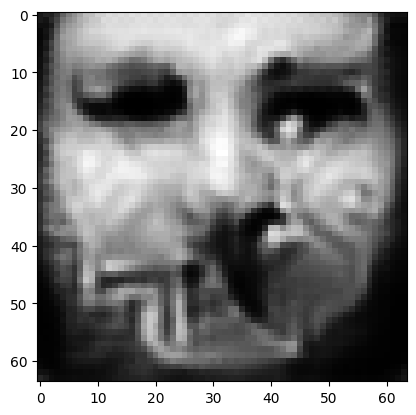

tensor([[9.5645e-01, 6.5084e-05, 2.4258e-03, 1.1363e-04, 3.8187e-04, 2.4320e-03,
         6.8467e-03, 7.6078e-03, 9.1502e-08, 3.2582e-04, 1.1388e-04, 7.1108e-05,
         1.3793e-05, 2.1114e-07, 1.0379e-04, 6.7003e-03, 5.2665e-04, 6.0526e-03,
         6.1486e-04, 2.1370e-04, 3.7758e-05, 7.5196e-05, 1.8569e-08, 6.4309e-03,
         2.1512e-05, 2.3623e-07, 2.1582e-04, 6.7623e-04, 1.0084e-03, 2.0467e-05,
         2.4371e-07, 1.3833e-04, 2.6040e-05, 2.4650e-05, 1.3555e-04, 2.6844e-05,
         5.0067e-05, 3.4992e-05, 1.6871e-05, 3.4523e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044530052691698074
tensor([[9.5645e-01, 6.5076e-05, 2.4256e-03, 1.1362e-04, 3.8183e-04, 2.4317e-03,
         6.8458e-03, 7.6070e-03, 9.1483e-08, 3.2580e-04, 1.1387e-04, 7.1101e-05,
         1.3791e-05, 2.1110e-07, 1.0378e-04, 6.7000e-03, 5.2659e-04, 6.0518e-03,
         6.1481e-04, 2.1368e-04, 3.7753e-05, 7.5189e-05, 1.8564e-08, 6.4303e-03,
         2.1507e-05, 2.3618e-07, 2.1578e-

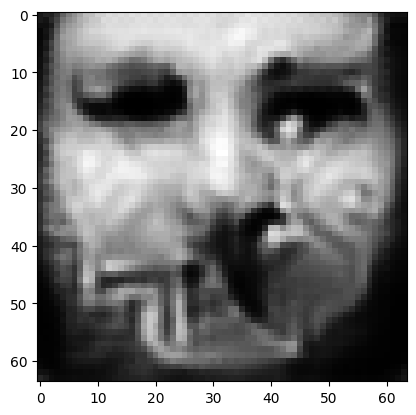

tensor([[9.5647e-01, 6.5050e-05, 2.4245e-03, 1.1358e-04, 3.8170e-04, 2.4308e-03,
         6.8429e-03, 7.6042e-03, 9.1423e-08, 3.2568e-04, 1.1382e-04, 7.1071e-05,
         1.3783e-05, 2.1098e-07, 1.0374e-04, 6.6982e-03, 5.2634e-04, 6.0500e-03,
         6.1455e-04, 2.1360e-04, 3.7735e-05, 7.5151e-05, 1.8546e-08, 6.4275e-03,
         2.1494e-05, 2.3601e-07, 2.1568e-04, 6.7581e-04, 1.0077e-03, 2.0453e-05,
         2.4349e-07, 1.3827e-04, 2.6019e-05, 2.4635e-05, 1.3548e-04, 2.6828e-05,
         5.0031e-05, 3.4967e-05, 1.6856e-05, 3.4491e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044508274644613266
tensor([[9.5647e-01, 6.5043e-05, 2.4243e-03, 1.1356e-04, 3.8166e-04, 2.4306e-03,
         6.8421e-03, 7.6037e-03, 9.1405e-08, 3.2566e-04, 1.1382e-04, 7.1066e-05,
         1.3781e-05, 2.1095e-07, 1.0373e-04, 6.6978e-03, 5.2628e-04, 6.0494e-03,
         6.1448e-04, 2.1358e-04, 3.7731e-05, 7.5142e-05, 1.8541e-08, 6.4268e-03,
         2.1490e-05, 2.3597e-07, 2.1565e-

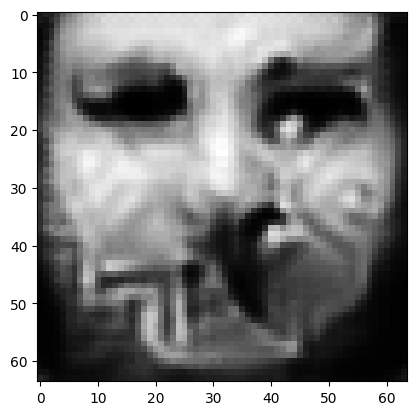

tensor([[9.5649e-01, 6.5017e-05, 2.4233e-03, 1.1352e-04, 3.8154e-04, 2.4297e-03,
         6.8394e-03, 7.6010e-03, 9.1350e-08, 3.2554e-04, 1.1377e-04, 7.1036e-05,
         1.3775e-05, 2.1084e-07, 1.0369e-04, 6.6960e-03, 5.2605e-04, 6.0478e-03,
         6.1423e-04, 2.1351e-04, 3.7714e-05, 7.5106e-05, 1.8525e-08, 6.4243e-03,
         2.1478e-05, 2.3580e-07, 2.1555e-04, 6.7542e-04, 1.0070e-03, 2.0438e-05,
         2.4328e-07, 1.3821e-04, 2.5999e-05, 2.4620e-05, 1.3543e-04, 2.6812e-05,
         4.9997e-05, 3.4944e-05, 1.6840e-05, 3.4461e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0444880947470665
tensor([[9.5649e-01, 6.5013e-05, 2.4231e-03, 1.1351e-04, 3.8150e-04, 2.4295e-03,
         6.8387e-03, 7.6001e-03, 9.1337e-08, 3.2550e-04, 1.1376e-04, 7.1031e-05,
         1.3773e-05, 2.1082e-07, 1.0368e-04, 6.6957e-03, 5.2598e-04, 6.0477e-03,
         6.1415e-04, 2.1349e-04, 3.7711e-05, 7.5096e-05, 1.8521e-08, 6.4235e-03,
         2.1475e-05, 2.3576e-07, 2.1553e-04

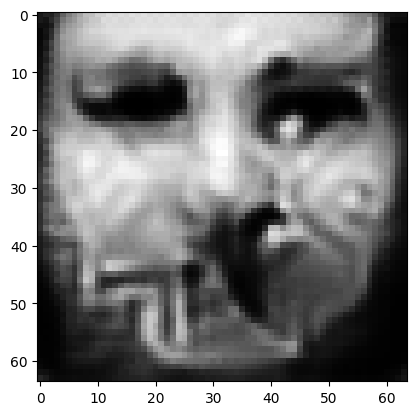

tensor([[9.5651e-01, 6.4988e-05, 2.4223e-03, 1.1347e-04, 3.8138e-04, 2.4287e-03,
         6.8360e-03, 7.5979e-03, 9.1279e-08, 3.2541e-04, 1.1372e-04, 7.1004e-05,
         1.3766e-05, 2.1069e-07, 1.0365e-04, 6.6942e-03, 5.2576e-04, 6.0455e-03,
         6.1394e-04, 2.1342e-04, 3.7693e-05, 7.5064e-05, 1.8504e-08, 6.4210e-03,
         2.1462e-05, 2.3560e-07, 2.1543e-04, 6.7505e-04, 1.0063e-03, 2.0424e-05,
         2.4308e-07, 1.3815e-04, 2.5979e-05, 2.4606e-05, 1.3537e-04, 2.6797e-05,
         4.9964e-05, 3.4922e-05, 1.6826e-05, 3.4432e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04446859657764435
tensor([[9.5651e-01, 6.4983e-05, 2.4220e-03, 1.1346e-04, 3.8135e-04, 2.4285e-03,
         6.8353e-03, 7.5970e-03, 9.1267e-08, 3.2537e-04, 1.1371e-04, 7.0998e-05,
         1.3765e-05, 2.1068e-07, 1.0364e-04, 6.6937e-03, 5.2571e-04, 6.0456e-03,
         6.1386e-04, 2.1341e-04, 3.7691e-05, 7.5053e-05, 1.8501e-08, 6.4203e-03,
         2.1460e-05, 2.3556e-07, 2.1541e-0

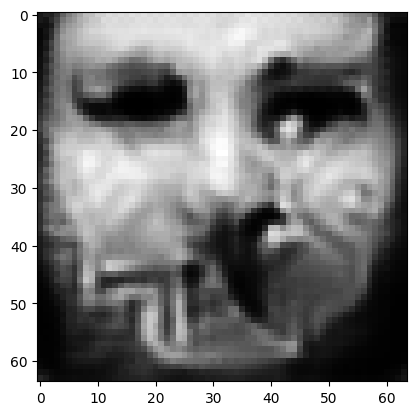

tensor([[9.5652e-01, 6.4959e-05, 2.4212e-03, 1.1342e-04, 3.8123e-04, 2.4277e-03,
         6.8328e-03, 7.5948e-03, 9.1214e-08, 3.2528e-04, 1.1368e-04, 7.0973e-05,
         1.3758e-05, 2.1057e-07, 1.0360e-04, 6.6922e-03, 5.2549e-04, 6.0437e-03,
         6.1364e-04, 2.1334e-04, 3.7675e-05, 7.5022e-05, 1.8486e-08, 6.4179e-03,
         2.1448e-05, 2.3541e-07, 2.1532e-04, 6.7469e-04, 1.0057e-03, 2.0411e-05,
         2.4289e-07, 1.3810e-04, 2.5961e-05, 2.4593e-05, 1.3532e-04, 2.6784e-05,
         4.9933e-05, 3.4901e-05, 1.6812e-05, 3.4405e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04445001110434532
tensor([[9.5653e-01, 6.4954e-05, 2.4210e-03, 1.1341e-04, 3.8120e-04, 2.4276e-03,
         6.8321e-03, 7.5941e-03, 9.1200e-08, 3.2525e-04, 1.1367e-04, 7.0968e-05,
         1.3757e-05, 2.1055e-07, 1.0360e-04, 6.6919e-03, 5.2543e-04, 6.0434e-03,
         6.1358e-04, 2.1332e-04, 3.7671e-05, 7.5014e-05, 1.8482e-08, 6.4173e-03,
         2.1445e-05, 2.3538e-07, 2.1530e-0

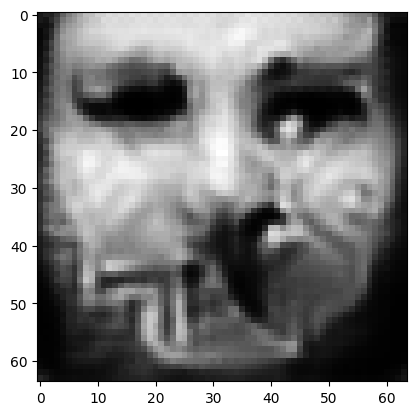

tensor([[9.5654e-01, 6.4932e-05, 2.4201e-03, 1.1337e-04, 3.8110e-04, 2.4268e-03,
         6.8297e-03, 7.5919e-03, 9.1152e-08, 3.2517e-04, 1.1363e-04, 7.0943e-05,
         1.3751e-05, 2.1044e-07, 1.0356e-04, 6.6905e-03, 5.2523e-04, 6.0417e-03,
         6.1338e-04, 2.1326e-04, 3.7656e-05, 7.4986e-05, 1.8468e-08, 6.4152e-03,
         2.1434e-05, 2.3524e-07, 2.1521e-04, 6.7435e-04, 1.0051e-03, 2.0398e-05,
         2.4272e-07, 1.3805e-04, 2.5944e-05, 2.4581e-05, 1.3527e-04, 2.6772e-05,
         4.9904e-05, 3.4882e-05, 1.6799e-05, 3.4379e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044432565569877625
tensor([[9.5654e-01, 6.4927e-05, 2.4200e-03, 1.1336e-04, 3.8106e-04, 2.4267e-03,
         6.8292e-03, 7.5915e-03, 9.1138e-08, 3.2514e-04, 1.1362e-04, 7.0939e-05,
         1.3749e-05, 2.1042e-07, 1.0355e-04, 6.6901e-03, 5.2517e-04, 6.0413e-03,
         6.1332e-04, 2.1324e-04, 3.7652e-05, 7.4978e-05, 1.8464e-08, 6.4145e-03,
         2.1431e-05, 2.3520e-07, 2.1519e-

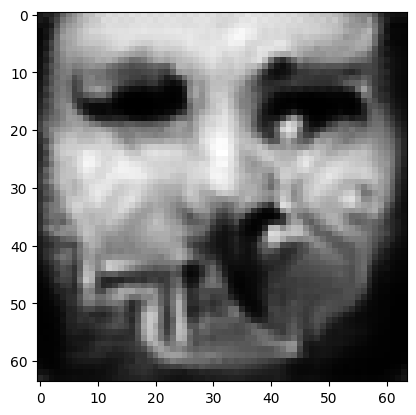

tensor([[9.5656e-01, 6.4907e-05, 2.4192e-03, 1.1332e-04, 3.8095e-04, 2.4259e-03,
         6.8269e-03, 7.5889e-03, 9.1092e-08, 3.2503e-04, 1.1359e-04, 7.0918e-05,
         1.3744e-05, 2.1034e-07, 1.0353e-04, 6.6888e-03, 5.2497e-04, 6.0404e-03,
         6.1310e-04, 2.1318e-04, 3.7640e-05, 7.4949e-05, 1.8451e-08, 6.4123e-03,
         2.1421e-05, 2.3506e-07, 2.1512e-04, 6.7403e-04, 1.0045e-03, 2.0386e-05,
         2.4254e-07, 1.3800e-04, 2.5928e-05, 2.4569e-05, 1.3523e-04, 2.6760e-05,
         4.9877e-05, 3.4863e-05, 1.6786e-05, 3.4354e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0444159172475338
tensor([[9.5656e-01, 6.4902e-05, 2.4190e-03, 1.1331e-04, 3.8094e-04, 2.4257e-03,
         6.8263e-03, 7.5887e-03, 9.1081e-08, 3.2503e-04, 1.1358e-04, 7.0910e-05,
         1.3743e-05, 2.1031e-07, 1.0352e-04, 6.6884e-03, 5.2494e-04, 6.0396e-03,
         6.1308e-04, 2.1317e-04, 3.7636e-05, 7.4944e-05, 1.8448e-08, 6.4120e-03,
         2.1418e-05, 2.3504e-07, 2.1509e-04

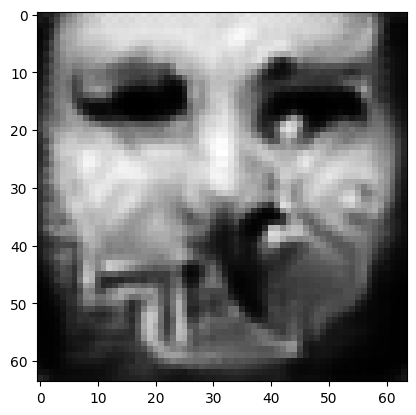

tensor([[9.5657e-01, 6.4882e-05, 2.4183e-03, 1.1328e-04, 3.8083e-04, 2.4251e-03,
         6.8242e-03, 7.5865e-03, 9.1034e-08, 3.2494e-04, 1.1355e-04, 7.0891e-05,
         1.3737e-05, 2.1022e-07, 1.0349e-04, 6.6872e-03, 5.2474e-04, 6.0383e-03,
         6.1288e-04, 2.1311e-04, 3.7623e-05, 7.4917e-05, 1.8435e-08, 6.4098e-03,
         2.1408e-05, 2.3491e-07, 2.1502e-04, 6.7372e-04, 1.0040e-03, 2.0375e-05,
         2.4239e-07, 1.3796e-04, 2.5913e-05, 2.4558e-05, 1.3518e-04, 2.6748e-05,
         4.9850e-05, 3.4846e-05, 1.6775e-05, 3.4331e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044400181621313095
tensor([[9.5657e-01, 6.4877e-05, 2.4181e-03, 1.1327e-04, 3.8081e-04, 2.4249e-03,
         6.8237e-03, 7.5861e-03, 9.1025e-08, 3.2493e-04, 1.1354e-04, 7.0883e-05,
         1.3736e-05, 2.1019e-07, 1.0348e-04, 6.6869e-03, 5.2470e-04, 6.0378e-03,
         6.1285e-04, 2.1310e-04, 3.7619e-05, 7.4912e-05, 1.8432e-08, 6.4095e-03,
         2.1406e-05, 2.3488e-07, 2.1500e-

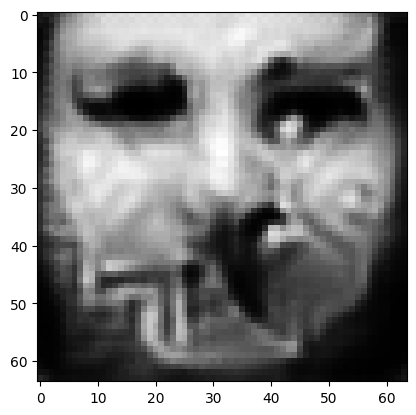

tensor([[9.5659e-01, 6.4860e-05, 2.4173e-03, 1.1324e-04, 3.8071e-04, 2.4242e-03,
         6.8217e-03, 7.5839e-03, 9.0983e-08, 3.2483e-04, 1.1351e-04, 7.0865e-05,
         1.3731e-05, 2.1012e-07, 1.0346e-04, 6.6857e-03, 5.2452e-04, 6.0370e-03,
         6.1265e-04, 2.1305e-04, 3.7608e-05, 7.4883e-05, 1.8421e-08, 6.4074e-03,
         2.1397e-05, 2.3475e-07, 2.1493e-04, 6.7343e-04, 1.0034e-03, 2.0365e-05,
         2.4224e-07, 1.3792e-04, 2.5899e-05, 2.4547e-05, 1.3514e-04, 2.6738e-05,
         4.9825e-05, 3.4829e-05, 1.6764e-05, 3.4310e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04438512772321701
tensor([[9.5659e-01, 6.4855e-05, 2.4172e-03, 1.1323e-04, 3.8070e-04, 2.4241e-03,
         6.8211e-03, 7.5836e-03, 9.0972e-08, 3.2483e-04, 1.1350e-04, 7.0858e-05,
         1.3730e-05, 2.1009e-07, 1.0345e-04, 6.6854e-03, 5.2449e-04, 6.0363e-03,
         6.1262e-04, 2.1303e-04, 3.7604e-05, 7.4878e-05, 1.8417e-08, 6.4071e-03,
         2.1394e-05, 2.3473e-07, 2.1490e-0

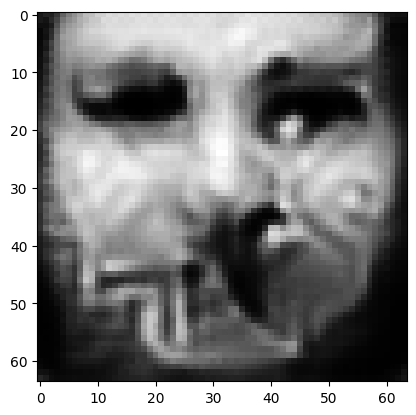

tensor([[9.5660e-01, 6.4837e-05, 2.4165e-03, 1.1320e-04, 3.8059e-04, 2.4235e-03,
         6.8191e-03, 7.5817e-03, 9.0929e-08, 3.2474e-04, 1.1348e-04, 7.0841e-05,
         1.3725e-05, 2.1001e-07, 1.0342e-04, 6.6843e-03, 5.2431e-04, 6.0351e-03,
         6.1244e-04, 2.1298e-04, 3.7592e-05, 7.4853e-05, 1.8405e-08, 6.4052e-03,
         2.1385e-05, 2.3461e-07, 2.1484e-04, 6.7315e-04, 1.0030e-03, 2.0355e-05,
         2.4209e-07, 1.3788e-04, 2.5884e-05, 2.4537e-05, 1.3510e-04, 2.6727e-05,
         4.9800e-05, 3.4813e-05, 1.6754e-05, 3.4289e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044370874762535095
tensor([[9.5660e-01, 6.4832e-05, 2.4164e-03, 1.1319e-04, 3.8057e-04, 2.4234e-03,
         6.8186e-03, 7.5813e-03, 9.0919e-08, 3.2473e-04, 1.1347e-04, 7.0836e-05,
         1.3724e-05, 2.0999e-07, 1.0341e-04, 6.6840e-03, 5.2427e-04, 6.0348e-03,
         6.1239e-04, 2.1297e-04, 3.7589e-05, 7.4848e-05, 1.8402e-08, 6.4048e-03,
         2.1383e-05, 2.3458e-07, 2.1482e-

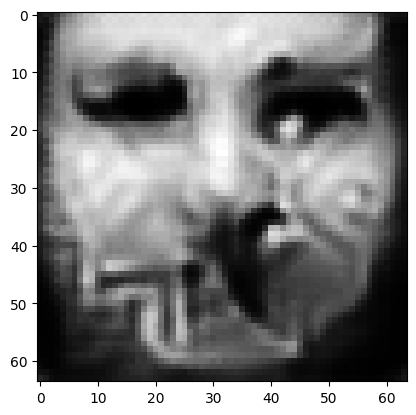

tensor([[9.5661e-01, 6.4815e-05, 2.4157e-03, 1.1316e-04, 3.8049e-04, 2.4228e-03,
         6.8168e-03, 7.5796e-03, 9.0880e-08, 3.2466e-04, 1.1344e-04, 7.0816e-05,
         1.3719e-05, 2.0991e-07, 1.0339e-04, 6.6829e-03, 5.2411e-04, 6.0335e-03,
         6.1224e-04, 2.1292e-04, 3.7578e-05, 7.4826e-05, 1.8391e-08, 6.4031e-03,
         2.1374e-05, 2.3448e-07, 2.1475e-04, 6.7289e-04, 1.0025e-03, 2.0345e-05,
         2.4196e-07, 1.3784e-04, 2.5871e-05, 2.4528e-05, 1.3506e-04, 2.6717e-05,
         4.9777e-05, 3.4798e-05, 1.6744e-05, 3.4269e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0443573035299778
tensor([[9.5661e-01, 6.4813e-05, 2.4156e-03, 1.1316e-04, 3.8047e-04, 2.4226e-03,
         6.8163e-03, 7.5790e-03, 9.0873e-08, 3.2463e-04, 1.1343e-04, 7.0813e-05,
         1.3718e-05, 2.0990e-07, 1.0338e-04, 6.6826e-03, 5.2408e-04, 6.0335e-03,
         6.1218e-04, 2.1291e-04, 3.7576e-05, 7.4818e-05, 1.8389e-08, 6.4025e-03,
         2.1373e-05, 2.3445e-07, 2.1474e-04

In [14]:
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=0)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.676576137542725


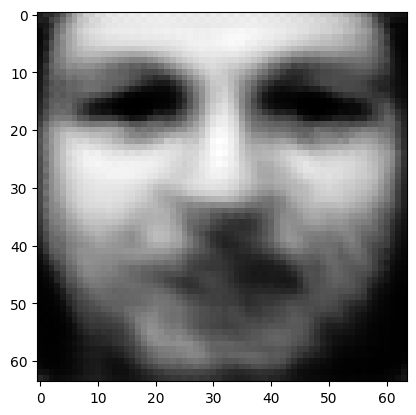

tensor([[0.0044, 0.0024, 0.0075, 0.0055, 0.0773, 0.0012, 0.0018, 0.0020, 0.0023,
         0.0003, 0.0007, 0.0015, 0.0073, 0.0229, 0.0029, 0.0010, 0.0228, 0.0058,
         0.0029, 0.0012, 0.0134, 0.0059, 0.2275, 0.0038, 0.1524, 0.0491, 0.0027,
         0.0032, 0.0010, 0.0091, 0.0039, 0.0096, 0.0143, 0.0140, 0.0126, 0.0291,
         0.2327, 0.0271, 0.0100, 0.0049]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.041886329650879
tensor([[0.0057, 0.0038, 0.0073, 0.0055, 0.0798, 0.0022, 0.0035, 0.0032, 0.0036,
         0.0006, 0.0019, 0.0025, 0.0065, 0.0287, 0.0063, 0.0017, 0.0301, 0.0135,
         0.0039, 0.0017, 0.0180, 0.0068, 0.1588, 0.0055, 0.1833, 0.0479, 0.0040,
         0.0049, 0.0018, 0.0133, 0.0034, 0.0127, 0.0207, 0.0125, 0.0163, 0.0461,
         0.1818, 0.0343, 0.0103, 0.0056]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.562577247619629
tensor([[0.0117, 0.0093, 0.0229, 0.0152, 0.0721, 0.0077, 0.0325, 0.0171, 0.0055,
         0.

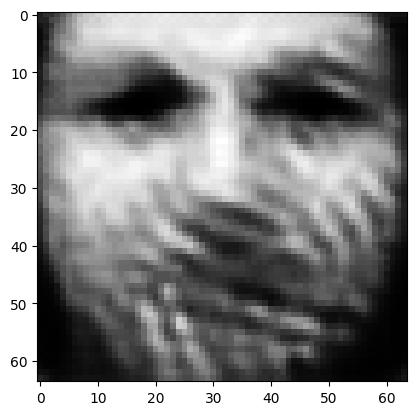

tensor([[6.7095e-04, 3.8856e-02, 1.5223e-03, 1.7000e-02, 5.9947e-03, 1.0955e-03,
         3.9748e-04, 3.6723e-03, 9.9164e-03, 6.1558e-04, 3.7415e-03, 4.6537e-03,
         9.5257e-03, 1.4646e-02, 1.8309e-03, 8.5286e-04, 2.6771e-03, 7.0700e-03,
         1.9680e-03, 7.8515e-04, 5.2098e-03, 7.1358e-04, 1.0406e-01, 9.6316e-04,
         1.2745e-02, 5.3422e-01, 1.0156e-03, 5.2424e-03, 1.4404e-03, 9.9046e-03,
         1.5703e-02, 3.4766e-03, 8.2892e-03, 1.9199e-03, 2.1933e-02, 9.2476e-02,
         3.2860e-02, 1.7464e-02, 1.4128e-03, 1.4611e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.247891664505005
tensor([[0.0045, 0.1385, 0.0169, 0.0442, 0.0126, 0.0251, 0.0052, 0.0145, 0.0414,
         0.0100, 0.0162, 0.0250, 0.0521, 0.0102, 0.0136, 0.0053, 0.0083, 0.0442,
         0.0108, 0.0255, 0.0301, 0.0009, 0.0141, 0.0017, 0.0106, 0.0204, 0.0154,
         0.0124, 0.0283, 0.0581, 0.0258, 0.0165, 0.0643, 0.0049, 0.0909, 0.0249,
         0.0082, 0.0154, 0.0138, 0.0194]], d

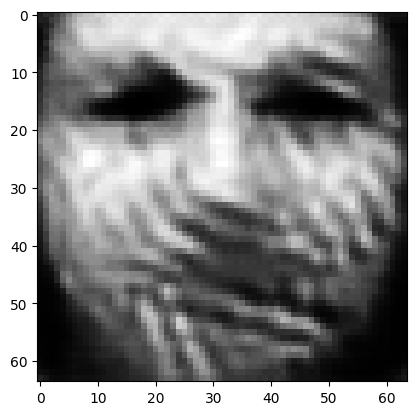

tensor([[0.0020, 0.3870, 0.0045, 0.0570, 0.0040, 0.0087, 0.0012, 0.0103, 0.0232,
         0.0057, 0.0160, 0.0261, 0.0177, 0.0061, 0.0044, 0.0030, 0.0028, 0.0227,
         0.0065, 0.0046, 0.0111, 0.0004, 0.0191, 0.0014, 0.0052, 0.0643, 0.0058,
         0.0069, 0.0145, 0.0337, 0.0225, 0.0162, 0.0248, 0.0014, 0.0488, 0.0673,
         0.0095, 0.0247, 0.0033, 0.0055]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9493081569671631
tensor([[1.8812e-03, 4.0850e-01, 4.1492e-03, 5.5112e-02, 3.8007e-03, 8.6305e-03,
         1.1209e-03, 9.7266e-03, 2.1031e-02, 5.5050e-03, 1.5418e-02, 2.5406e-02,
         1.7201e-02, 5.6059e-03, 4.4549e-03, 3.0069e-03, 2.6928e-03, 2.2843e-02,
         6.2571e-03, 4.3289e-03, 1.0714e-02, 3.6695e-04, 1.8974e-02, 1.3919e-03,
         5.0197e-03, 6.1614e-02, 5.6700e-03, 6.4187e-03, 1.4149e-02, 3.1967e-02,
         1.9684e-02, 1.6244e-02, 2.3807e-02, 1.2419e-03, 4.7643e-02, 6.8144e-02,
         9.1949e-03, 2.2957e-02, 3.0082e-03, 5.1140e-03]], 

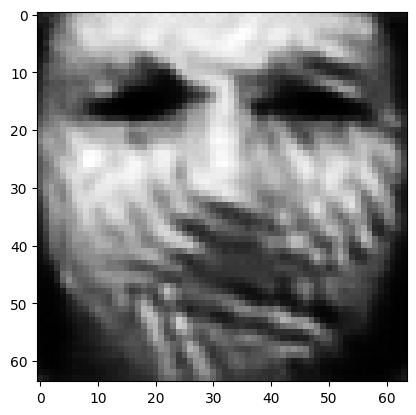

tensor([[1.5997e-03, 4.7471e-01, 3.0874e-03, 4.7156e-02, 3.0827e-03, 7.3525e-03,
         9.0896e-04, 8.0595e-03, 1.6081e-02, 4.4931e-03, 1.3343e-02, 2.2960e-02,
         1.4656e-02, 4.2886e-03, 3.9448e-03, 2.8327e-03, 2.2492e-03, 1.9545e-02,
         5.4359e-03, 3.5287e-03, 9.3403e-03, 2.6836e-04, 1.8580e-02, 1.1646e-03,
         4.1058e-03, 6.0170e-02, 4.6350e-03, 5.1071e-03, 1.2575e-02, 2.9485e-02,
         1.4229e-02, 1.5212e-02, 2.0982e-02, 9.3762e-04, 4.1673e-02, 6.8609e-02,
         7.7795e-03, 1.9219e-02, 2.3987e-03, 4.2102e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7450459599494934
tensor([[1.7478e-03, 4.8844e-01, 3.3284e-03, 4.5971e-02, 3.1388e-03, 8.6042e-03,
         9.8234e-04, 8.9237e-03, 1.4891e-02, 4.8561e-03, 1.3405e-02, 2.3642e-02,
         1.4908e-02, 4.0208e-03, 4.2781e-03, 3.2343e-03, 2.3899e-03, 2.0236e-02,
         6.0185e-03, 3.9015e-03, 9.9936e-03, 2.6909e-04, 1.6962e-02, 1.2204e-03,
         3.8253e-03, 4.8032e-02, 5.1236e-03

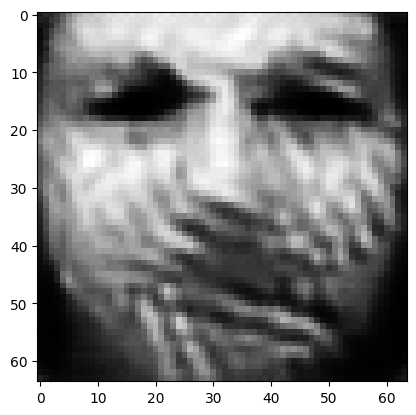

tensor([[1.4970e-03, 5.3589e-01, 2.7060e-03, 4.0752e-02, 2.7964e-03, 7.8897e-03,
         8.5716e-04, 7.2378e-03, 1.2019e-02, 4.4624e-03, 1.1761e-02, 2.2383e-02,
         1.3813e-02, 3.2105e-03, 4.1307e-03, 3.0782e-03, 2.2387e-03, 1.8366e-02,
         5.4234e-03, 3.4907e-03, 9.1593e-03, 2.2349e-04, 1.6591e-02, 1.1111e-03,
         3.5015e-03, 4.3397e-02, 4.6092e-03, 3.8809e-03, 1.2131e-02, 2.8314e-02,
         1.0263e-02, 1.5556e-02, 2.0359e-02, 7.4754e-04, 3.7970e-02, 6.0678e-02,
         6.2210e-03, 1.5095e-02, 2.1786e-03, 4.0123e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6238324642181396
tensor([[1.3521e-03, 5.4649e-01, 2.3870e-03, 3.7696e-02, 2.5795e-03, 6.9689e-03,
         7.9086e-04, 6.3999e-03, 1.1773e-02, 4.2669e-03, 1.1244e-02, 2.1950e-02,
         1.3198e-02, 2.9939e-03, 3.8929e-03, 2.8160e-03, 2.0453e-03, 1.7107e-02,
         4.9510e-03, 3.2539e-03, 8.7601e-03, 2.0654e-04, 1.6456e-02, 9.9498e-04,
         3.3475e-03, 4.6406e-02, 4.2968e-03

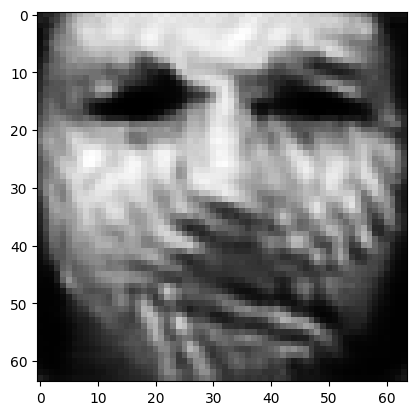

tensor([[1.1566e-03, 5.9596e-01, 1.8724e-03, 3.5455e-02, 2.2213e-03, 6.3303e-03,
         6.6980e-04, 5.0429e-03, 9.1589e-03, 3.7797e-03, 9.0752e-03, 2.0208e-02,
         1.2411e-02, 2.3317e-03, 3.5069e-03, 2.5810e-03, 1.9089e-03, 1.4116e-02,
         4.5875e-03, 2.8367e-03, 7.5357e-03, 1.6466e-04, 1.5916e-02, 8.5812e-04,
         3.0437e-03, 3.9631e-02, 3.7473e-03, 2.5950e-03, 9.7604e-03, 2.7615e-02,
         7.5594e-03, 1.3626e-02, 1.7281e-02, 6.3348e-04, 3.1702e-02, 6.1607e-02,
         4.8048e-03, 1.1169e-02, 1.8975e-03, 3.6412e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5175784230232239
tensor([[1.3185e-03, 6.0747e-01, 1.9769e-03, 3.3862e-02, 2.3159e-03, 7.1601e-03,
         7.2681e-04, 5.5339e-03, 8.4718e-03, 3.9649e-03, 8.9958e-03, 2.0489e-02,
         1.2142e-02, 2.2105e-03, 3.8030e-03, 2.9602e-03, 1.9874e-03, 1.4954e-02,
         5.1898e-03, 3.1608e-03, 7.9217e-03, 1.7219e-04, 1.4248e-02, 9.2373e-04,
         2.7467e-03, 3.2266e-02, 4.1460e-03

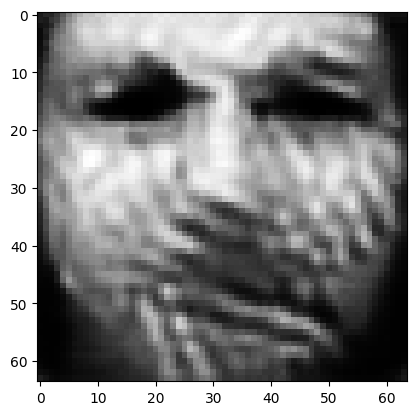

tensor([[1.1521e-03, 6.5758e-01, 1.4910e-03, 2.9094e-02, 2.1541e-03, 6.5262e-03,
         6.5943e-04, 4.5579e-03, 6.1957e-03, 3.5045e-03, 6.9183e-03, 1.8502e-02,
         1.1078e-02, 1.6856e-03, 3.5247e-03, 2.7205e-03, 1.9015e-03, 1.2290e-02,
         4.6292e-03, 2.9285e-03, 6.5429e-03, 1.4790e-04, 1.3594e-02, 8.5988e-04,
         2.5761e-03, 2.5528e-02, 3.4819e-03, 1.8216e-03, 8.6566e-03, 2.8007e-02,
         5.2787e-03, 1.2502e-02, 1.6329e-02, 5.3514e-04, 2.6218e-02, 5.1603e-02,
         3.7061e-03, 8.0205e-03, 1.7992e-03, 3.7020e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4191938042640686
tensor([[1.1361e-03, 6.6922e-01, 1.4014e-03, 2.7759e-02, 2.1443e-03, 6.4631e-03,
         6.5316e-04, 4.4855e-03, 5.6520e-03, 3.4016e-03, 6.5628e-03, 1.7887e-02,
         1.0683e-02, 1.5774e-03, 3.4830e-03, 2.7288e-03, 1.9028e-03, 1.1881e-02,
         4.6033e-03, 2.8961e-03, 6.2020e-03, 1.4318e-04, 1.3203e-02, 8.5788e-04,
         2.5189e-03, 2.3921e-02, 3.3535e-03

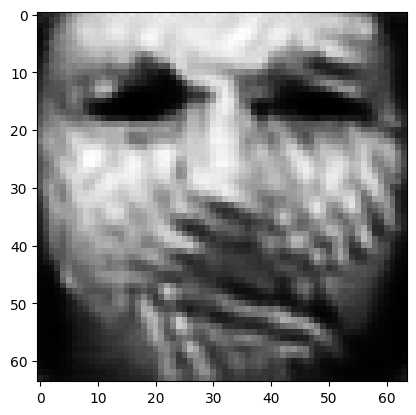

tensor([[9.5418e-04, 7.1036e-01, 1.0890e-03, 2.3976e-02, 1.8371e-03, 5.4853e-03,
         5.6265e-04, 3.7907e-03, 4.2584e-03, 2.8574e-03, 5.2721e-03, 1.5783e-02,
         9.5536e-03, 1.3009e-03, 2.9010e-03, 2.4788e-03, 1.7789e-03, 9.2414e-03,
         4.2341e-03, 2.5170e-03, 4.8999e-03, 1.2589e-04, 1.2403e-02, 7.6512e-04,
         2.3088e-03, 2.1368e-02, 2.7685e-03, 1.3458e-03, 7.0066e-03, 2.6543e-02,
         4.0925e-03, 1.0837e-02, 1.4127e-02, 4.6091e-04, 2.0248e-02, 4.6446e-02,
         3.0750e-03, 6.1051e-03, 1.6063e-03, 3.2343e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3419806659221649
tensor([[9.7126e-04, 7.1886e-01, 1.0842e-03, 2.3338e-02, 1.8204e-03, 5.7141e-03,
         5.6627e-04, 3.8308e-03, 3.9995e-03, 2.8321e-03, 5.0769e-03, 1.5652e-02,
         9.4983e-03, 1.2492e-03, 2.8860e-03, 2.6035e-03, 1.8120e-03, 9.0597e-03,
         4.3858e-03, 2.6028e-03, 4.8285e-03, 1.2608e-04, 1.1891e-02, 7.9046e-04,
         2.2011e-03, 1.9548e-02, 2.7952e-03

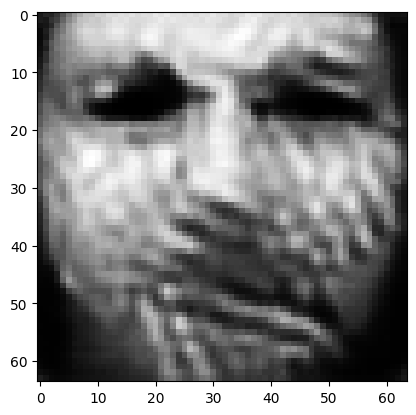

tensor([[8.8775e-04, 7.5104e-01, 9.1534e-04, 1.9418e-02, 1.5673e-03, 5.2280e-03,
         5.1649e-04, 3.4690e-03, 3.1303e-03, 2.5791e-03, 4.2245e-03, 1.4540e-02,
         8.5589e-03, 1.0556e-03, 2.5030e-03, 2.5954e-03, 1.7161e-03, 7.4486e-03,
         4.2320e-03, 2.4482e-03, 4.0391e-03, 1.1671e-04, 1.0642e-02, 7.4328e-04,
         1.8496e-03, 1.6918e-02, 2.5128e-03, 1.0744e-03, 6.1662e-03, 2.5331e-02,
         3.3403e-03, 9.7862e-03, 1.2550e-02, 4.1742e-04, 1.6153e-02, 3.8512e-02,
         2.5300e-03, 4.7867e-03, 1.4445e-03, 3.0142e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2862970232963562
tensor([[8.6553e-04, 7.5770e-01, 8.7185e-04, 1.8878e-02, 1.4755e-03, 4.9687e-03,
         4.9799e-04, 3.3524e-03, 3.0107e-03, 2.4967e-03, 4.0767e-03, 1.4164e-02,
         8.3143e-03, 1.0204e-03, 2.4194e-03, 2.5112e-03, 1.6353e-03, 7.0778e-03,
         4.1398e-03, 2.3692e-03, 3.8419e-03, 1.1288e-04, 1.0286e-02, 7.0436e-04,
         1.7788e-03, 1.6374e-02, 2.4397e-03

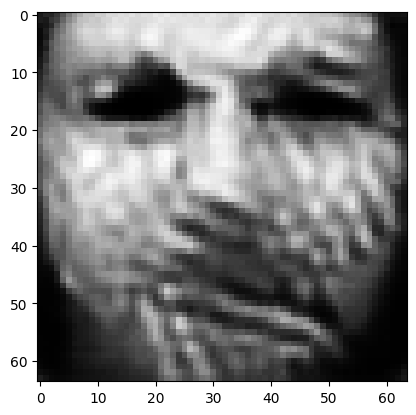

tensor([[8.2851e-04, 7.8227e-01, 7.8747e-04, 1.6695e-02, 1.3001e-03, 4.7342e-03,
         4.6280e-04, 3.1589e-03, 2.4618e-03, 2.3428e-03, 3.5383e-03, 1.3215e-02,
         7.7400e-03, 9.0394e-04, 2.1768e-03, 2.4654e-03, 1.5571e-03, 5.8668e-03,
         4.0040e-03, 2.3017e-03, 3.2686e-03, 1.0497e-04, 9.0040e-03, 6.6614e-04,
         1.5763e-03, 1.3610e-02, 2.2369e-03, 8.4746e-04, 5.2728e-03, 2.3890e-02,
         2.8304e-03, 8.8306e-03, 1.1645e-02, 3.7972e-04, 1.2917e-02, 3.4159e-02,
         1.9620e-03, 3.9925e-03, 1.3673e-03, 2.6314e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24555936455726624
tensor([[8.0827e-04, 7.8718e-01, 7.6276e-04, 1.6253e-02, 1.2576e-03, 4.6563e-03,
         4.5163e-04, 3.0648e-03, 2.3672e-03, 2.3093e-03, 3.4162e-03, 1.3033e-02,
         7.6181e-03, 8.8013e-04, 2.1051e-03, 2.4364e-03, 1.5344e-03, 5.5997e-03,
         3.9298e-03, 2.2650e-03, 3.1450e-03, 1.0254e-04, 8.7790e-03, 6.5266e-04,
         1.5341e-03, 1.3236e-02, 2.1862e-0

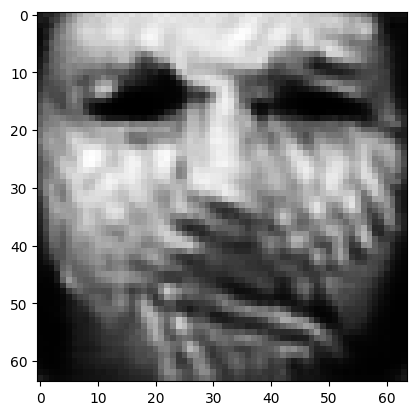

tensor([[7.8518e-04, 8.0343e-01, 7.1353e-04, 1.5098e-02, 1.1692e-03, 4.6545e-03,
         4.3001e-04, 2.9578e-03, 2.0389e-03, 2.2296e-03, 3.0545e-03, 1.2358e-02,
         7.2746e-03, 8.0363e-04, 1.9647e-03, 2.4523e-03, 1.5247e-03, 4.9954e-03,
         3.8643e-03, 2.2345e-03, 2.8372e-03, 9.5289e-05, 7.9980e-03, 6.3804e-04,
         1.3946e-03, 1.1337e-02, 2.0809e-03, 7.2545e-04, 4.7038e-03, 2.2339e-02,
         2.4539e-03, 8.0450e-03, 1.0757e-02, 3.4541e-04, 1.1183e-02, 3.0167e-02,
         1.6711e-03, 3.4462e-03, 1.2834e-03, 2.4622e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21886040270328522
tensor([[7.6672e-04, 8.0677e-01, 6.8816e-04, 1.4784e-02, 1.1327e-03, 4.4649e-03,
         4.1924e-04, 2.8868e-03, 1.9794e-03, 2.1683e-03, 2.9748e-03, 1.2085e-02,
         7.1499e-03, 7.9048e-04, 1.9242e-03, 2.3841e-03, 1.4933e-03, 4.8559e-03,
         3.7925e-03, 2.1575e-03, 2.7423e-03, 9.2492e-05, 7.9512e-03, 6.1660e-04,
         1.3740e-03, 1.1252e-02, 2.0293e-0

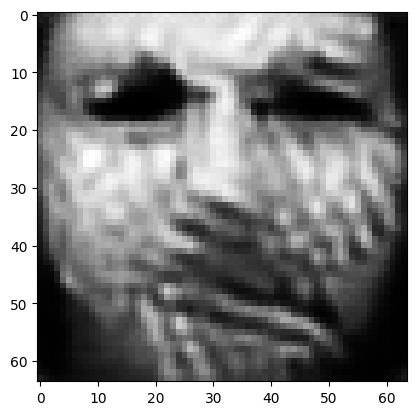

tensor([[7.2493e-04, 8.1776e-01, 6.3926e-04, 1.4222e-02, 1.0610e-03, 4.2891e-03,
         3.9397e-04, 2.7188e-03, 1.7977e-03, 2.0529e-03, 2.7014e-03, 1.1460e-02,
         6.9540e-03, 7.4307e-04, 1.8009e-03, 2.2959e-03, 1.4709e-03, 4.4632e-03,
         3.6302e-03, 2.0462e-03, 2.5147e-03, 8.5517e-05, 7.6709e-03, 5.8897e-04,
         1.3033e-03, 1.0382e-02, 1.9120e-03, 6.5240e-04, 4.1679e-03, 2.0923e-02,
         2.2401e-03, 7.4249e-03, 9.8525e-03, 3.1805e-04, 1.0118e-02, 2.8546e-02,
         1.5147e-03, 3.1093e-03, 1.1928e-03, 2.2600e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2011895328760147
tensor([[7.1909e-04, 8.1992e-01, 6.3178e-04, 1.4063e-02, 1.0462e-03, 4.2534e-03,
         3.8931e-04, 2.6959e-03, 1.7619e-03, 2.0331e-03, 2.6518e-03, 1.1354e-02,
         6.9032e-03, 7.3427e-04, 1.7762e-03, 2.2843e-03, 1.4644e-03, 4.3836e-03,
         3.6114e-03, 2.0248e-03, 2.4705e-03, 8.4311e-05, 7.5939e-03, 5.8264e-04,
         1.2854e-03, 1.0216e-02, 1.8953e-03

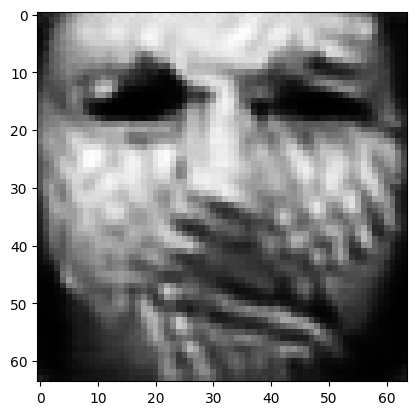

tensor([[7.2144e-04, 8.2948e-01, 6.2305e-04, 1.3509e-02, 1.0276e-03, 4.4398e-03,
         3.8383e-04, 2.6479e-03, 1.6012e-03, 2.0245e-03, 2.4374e-03, 1.1194e-02,
         6.7943e-03, 6.8631e-04, 1.7307e-03, 2.3818e-03, 1.5076e-03, 4.1153e-03,
         3.5778e-03, 2.0847e-03, 2.3485e-03, 8.3392e-05, 7.0339e-03, 6.0778e-04,
         1.2276e-03, 8.8996e-03, 1.8391e-03, 5.8830e-04, 3.9186e-03, 1.9598e-02,
         1.9998e-03, 7.0182e-03, 9.3038e-03, 3.0101e-04, 9.2690e-03, 2.5403e-02,
         1.3954e-03, 2.8000e-03, 1.1853e-03, 2.2100e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18695415556430817
tensor([[7.2238e-04, 8.3163e-01, 6.2094e-04, 1.3329e-02, 1.0224e-03, 4.4701e-03,
         3.8227e-04, 2.6358e-03, 1.5615e-03, 2.0240e-03, 2.3857e-03, 1.1178e-02,
         6.7690e-03, 6.7480e-04, 1.7219e-03, 2.4035e-03, 1.5169e-03, 4.0428e-03,
         3.5654e-03, 2.0999e-03, 2.3198e-03, 8.3317e-05, 6.9141e-03, 6.1429e-04,
         1.2182e-03, 8.6433e-03, 1.8211e-0

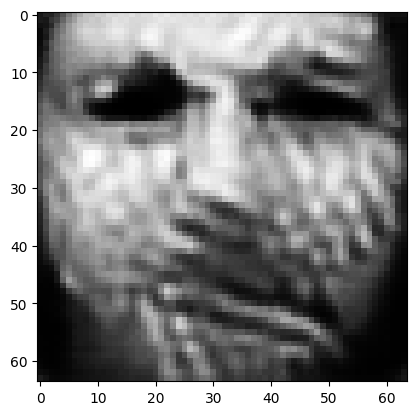

tensor([[7.2358e-04, 8.3864e-01, 5.9899e-04, 1.2892e-02, 9.9235e-04, 4.4344e-03,
         3.7412e-04, 2.5980e-03, 1.4372e-03, 1.9696e-03, 2.2387e-03, 1.0826e-02,
         6.5939e-03, 6.3755e-04, 1.7168e-03, 2.4052e-03, 1.5085e-03, 3.8727e-03,
         3.5182e-03, 2.0886e-03, 2.1996e-03, 8.0644e-05, 6.5545e-03, 6.1729e-04,
         1.1898e-03, 7.8535e-03, 1.7498e-03, 5.4096e-04, 3.7086e-03, 1.8340e-02,
         1.8289e-03, 6.8187e-03, 8.8249e-03, 2.8506e-04, 8.6258e-03, 2.3613e-02,
         1.2891e-03, 2.5719e-03, 1.1644e-03, 2.0798e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.17597585916519165
tensor([[7.2696e-04, 8.4021e-01, 5.9513e-04, 1.2740e-02, 9.8416e-04, 4.4406e-03,
         3.7319e-04, 2.5957e-03, 1.4079e-03, 1.9660e-03, 2.2110e-03, 1.0789e-02,
         6.5187e-03, 6.2707e-04, 1.7131e-03, 2.4245e-03, 1.5070e-03, 3.8239e-03,
         3.5239e-03, 2.0936e-03, 2.1789e-03, 8.0538e-05, 6.4139e-03, 6.1958e-04,
         1.1757e-03, 7.6751e-03, 1.7383e-0

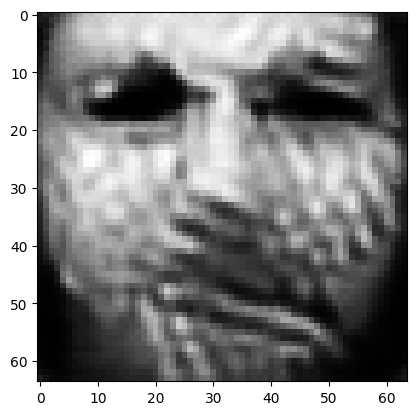

tensor([[7.1230e-04, 8.4627e-01, 5.6786e-04, 1.2384e-02, 9.5620e-04, 4.3291e-03,
         3.5812e-04, 2.5135e-03, 1.3185e-03, 1.8998e-03, 2.0762e-03, 1.0459e-02,
         6.3534e-03, 6.0042e-04, 1.6784e-03, 2.3866e-03, 1.4917e-03, 3.6577e-03,
         3.4073e-03, 2.0322e-03, 2.0554e-03, 7.7577e-05, 6.1986e-03, 6.1668e-04,
         1.1545e-03, 7.2628e-03, 1.6492e-03, 5.0496e-04, 3.5036e-03, 1.7459e-02,
         1.7081e-03, 6.6086e-03, 8.2876e-03, 2.7068e-04, 8.0708e-03, 2.2424e-02,
         1.2160e-03, 2.3902e-03, 1.1236e-03, 1.9606e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.16691160202026367
tensor([[6.9799e-04, 8.4768e-01, 5.5266e-04, 1.2277e-02, 9.3995e-04, 4.2054e-03,
         3.5106e-04, 2.4610e-03, 1.2999e-03, 1.8653e-03, 2.0408e-03, 1.0335e-02,
         6.2933e-03, 5.9499e-04, 1.6652e-03, 2.3272e-03, 1.4687e-03, 3.5972e-03,
         3.3415e-03, 1.9843e-03, 2.0069e-03, 7.6144e-05, 6.2091e-03, 6.0594e-04,
         1.1553e-03, 7.2765e-03, 1.6120e-0

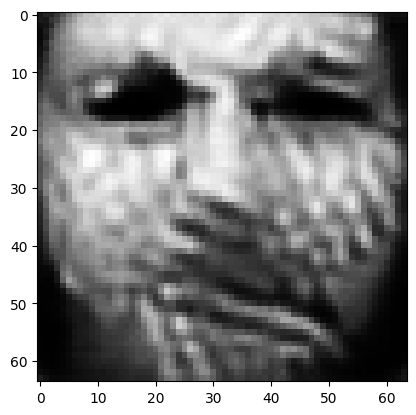

tensor([[6.7728e-04, 8.5286e-01, 5.2655e-04, 1.1905e-02, 9.0100e-04, 4.0499e-03,
         3.3478e-04, 2.3634e-03, 1.2259e-03, 1.8101e-03, 1.9310e-03, 1.0083e-02,
         6.1218e-03, 5.7116e-04, 1.6097e-03, 2.2706e-03, 1.4391e-03, 3.3878e-03,
         3.2280e-03, 1.9077e-03, 1.8901e-03, 7.3451e-05, 6.0290e-03, 5.9258e-04,
         1.1292e-03, 7.0589e-03, 1.5308e-03, 4.7487e-04, 3.2809e-03, 1.6801e-02,
         1.6405e-03, 6.3930e-03, 7.7587e-03, 2.5957e-04, 7.5375e-03, 2.2049e-02,
         1.1575e-03, 2.2416e-03, 1.0714e-03, 1.8293e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15916253626346588
tensor([[6.7572e-04, 8.5411e-01, 5.2341e-04, 1.1795e-02, 8.9016e-04, 4.0328e-03,
         3.3137e-04, 2.3467e-03, 1.2101e-03, 1.8068e-03, 1.9094e-03, 1.0060e-02,
         6.0761e-03, 5.6517e-04, 1.5935e-03, 2.2744e-03, 1.4345e-03, 3.3329e-03,
         3.2158e-03, 1.8994e-03, 1.8721e-03, 7.3161e-05, 5.9518e-03, 5.8965e-04,
         1.1158e-03, 6.9886e-03, 1.5198e-0

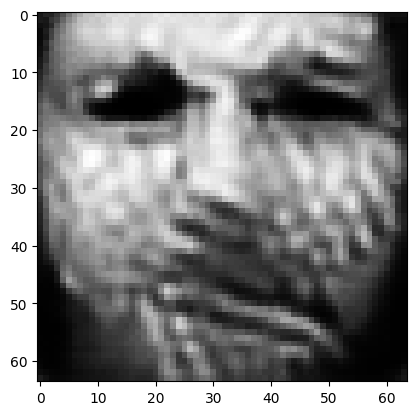

tensor([[6.5922e-04, 8.5873e-01, 5.0136e-04, 1.1442e-02, 8.5087e-04, 3.8765e-03,
         3.1619e-04, 2.2680e-03, 1.1463e-03, 1.7638e-03, 1.8271e-03, 9.8394e-03,
         5.8917e-03, 5.4484e-04, 1.5489e-03, 2.2279e-03, 1.4002e-03, 3.1573e-03,
         3.1345e-03, 1.8265e-03, 1.7712e-03, 7.0766e-05, 5.7444e-03, 5.7386e-04,
         1.0837e-03, 6.8003e-03, 1.4561e-03, 4.5068e-04, 3.1437e-03, 1.6317e-02,
         1.5795e-03, 6.1901e-03, 7.3199e-03, 2.4871e-04, 7.1036e-03, 2.1205e-02,
         1.0992e-03, 2.1322e-03, 1.0285e-03, 1.7343e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1523057371377945
tensor([[6.5270e-04, 8.5992e-01, 4.9412e-04, 1.1321e-02, 8.3934e-04, 3.8094e-03,
         3.1256e-04, 2.2446e-03, 1.1274e-03, 1.7493e-03, 1.8045e-03, 9.7689e-03,
         5.8397e-03, 5.3973e-04, 1.5360e-03, 2.2099e-03, 1.3913e-03, 3.1028e-03,
         3.1063e-03, 1.8037e-03, 1.7404e-03, 7.0182e-05, 5.7053e-03, 5.6995e-04,
         1.0779e-03, 6.7811e-03, 1.4330e-03

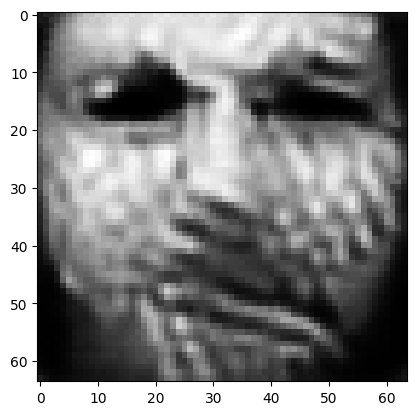

tensor([[6.3644e-04, 8.6398e-01, 4.7635e-04, 1.1005e-02, 8.0277e-04, 3.6676e-03,
         2.9991e-04, 2.1742e-03, 1.0748e-03, 1.7099e-03, 1.7304e-03, 9.5461e-03,
         5.6845e-03, 5.2317e-04, 1.4798e-03, 2.1672e-03, 1.3629e-03, 2.9352e-03,
         3.0289e-03, 1.7380e-03, 1.6520e-03, 6.8013e-05, 5.5415e-03, 5.5448e-04,
         1.0471e-03, 6.6535e-03, 1.3747e-03, 4.2979e-04, 3.0064e-03, 1.5866e-02,
         1.5320e-03, 5.9966e-03, 6.9407e-03, 2.4010e-04, 6.6975e-03, 2.0666e-02,
         1.0474e-03, 2.0332e-03, 9.9447e-04, 1.6370e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14620867371559143
tensor([[6.3238e-04, 8.6490e-01, 4.7121e-04, 1.0917e-02, 7.9156e-04, 3.6199e-03,
         2.9667e-04, 2.1599e-03, 1.0643e-03, 1.6991e-03, 1.7154e-03, 9.4777e-03,
         5.6321e-03, 5.1889e-04, 1.4662e-03, 2.1501e-03, 1.3461e-03, 2.9005e-03,
         3.0186e-03, 1.7172e-03, 1.6328e-03, 6.7342e-05, 5.4993e-03, 5.4731e-04,
         1.0352e-03, 6.6394e-03, 1.3630e-0

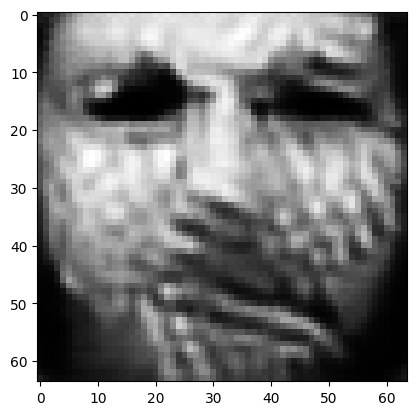

tensor([[6.2681e-04, 8.6834e-01, 4.6171e-04, 1.0632e-02, 7.6667e-04, 3.5659e-03,
         2.8828e-04, 2.1212e-03, 1.0201e-03, 1.6810e-03, 1.6620e-03, 9.3371e-03,
         5.5102e-03, 5.0470e-04, 1.4258e-03, 2.1505e-03, 1.3305e-03, 2.7826e-03,
         2.9857e-03, 1.6829e-03, 1.5760e-03, 6.6151e-05, 5.3089e-03, 5.3841e-04,
         9.9988e-04, 6.4280e-03, 1.3375e-03, 4.1364e-04, 2.9179e-03, 1.5536e-02,
         1.4802e-03, 5.8204e-03, 6.6528e-03, 2.3169e-04, 6.4323e-03, 1.9877e-02,
         1.0032e-03, 1.9623e-03, 9.6240e-04, 1.5774e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14116863906383514
tensor([[6.2076e-04, 8.6921e-01, 4.5710e-04, 1.0602e-02, 7.5700e-04, 3.5346e-03,
         2.8424e-04, 2.0945e-03, 1.0130e-03, 1.6691e-03, 1.6446e-03, 9.2771e-03,
         5.4938e-03, 5.0214e-04, 1.4067e-03, 2.1280e-03, 1.3199e-03, 2.7437e-03,
         2.9540e-03, 1.6611e-03, 1.5554e-03, 6.5381e-05, 5.2969e-03, 5.3143e-04,
         9.9361e-04, 6.4180e-03, 1.3258e-0

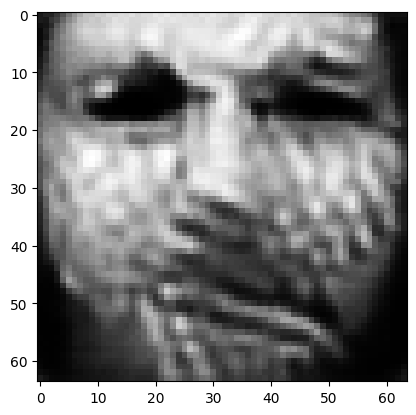

tensor([[6.1775e-04, 8.7241e-01, 4.4966e-04, 1.0349e-02, 7.3132e-04, 3.4907e-03,
         2.7577e-04, 2.0617e-03, 9.7348e-04, 1.6662e-03, 1.5952e-03, 9.1657e-03,
         5.3649e-03, 4.8655e-04, 1.3591e-03, 2.1293e-03, 1.2944e-03, 2.6143e-03,
         2.9332e-03, 1.6379e-03, 1.5019e-03, 6.4611e-05, 5.0742e-03, 5.2352e-04,
         9.5408e-04, 6.2416e-03, 1.2968e-03, 3.9721e-04, 2.8449e-03, 1.5301e-02,
         1.4307e-03, 5.6221e-03, 6.3734e-03, 2.2562e-04, 6.1758e-03, 1.9050e-02,
         9.6060e-04, 1.8886e-03, 9.3971e-04, 1.5314e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13649959862232208
tensor([[6.1907e-04, 8.7314e-01, 4.4900e-04, 1.0283e-02, 7.2743e-04, 3.4914e-03,
         2.7452e-04, 2.0622e-03, 9.6284e-04, 1.6686e-03, 1.5841e-03, 9.1365e-03,
         5.3366e-03, 4.8255e-04, 1.3504e-03, 2.1381e-03, 1.2922e-03, 2.5882e-03,
         2.9398e-03, 1.6370e-03, 1.4919e-03, 6.4551e-05, 5.0181e-03, 5.2379e-04,
         9.4500e-04, 6.1842e-03, 1.2921e-0

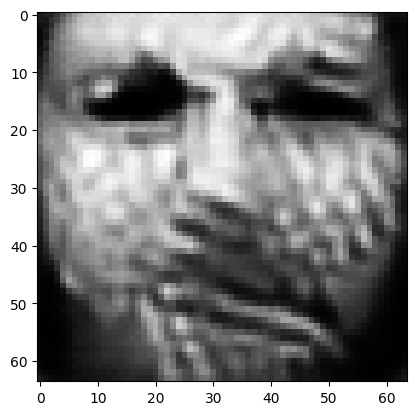

tensor([[6.1852e-04, 8.7592e-01, 4.4393e-04, 1.0127e-02, 7.0925e-04, 3.4691e-03,
         2.6741e-04, 2.0454e-03, 9.2900e-04, 1.6576e-03, 1.5414e-03, 8.9893e-03,
         5.2484e-03, 4.7085e-04, 1.3129e-03, 2.1422e-03, 1.2770e-03, 2.4989e-03,
         2.9321e-03, 1.6157e-03, 1.4494e-03, 6.3544e-05, 4.8489e-03, 5.1899e-04,
         9.1469e-04, 5.9988e-03, 1.2711e-03, 3.8615e-04, 2.7921e-03, 1.4988e-02,
         1.3823e-03, 5.4563e-03, 6.1308e-03, 2.1904e-04, 5.9816e-03, 1.8211e-02,
         9.2609e-04, 1.8279e-03, 9.2052e-04, 1.4926e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1324748694896698
tensor([[6.1280e-04, 8.7656e-01, 4.3953e-04, 1.0087e-02, 7.0271e-04, 3.4358e-03,
         2.6439e-04, 2.0241e-03, 9.2311e-04, 1.6475e-03, 1.5291e-03, 8.9537e-03,
         5.2307e-03, 4.6866e-04, 1.3011e-03, 2.1224e-03, 1.2670e-03, 2.4729e-03,
         2.9059e-03, 1.6012e-03, 1.4327e-03, 6.3029e-05, 4.8337e-03, 5.1451e-04,
         9.1044e-04, 5.9953e-03, 1.2601e-03

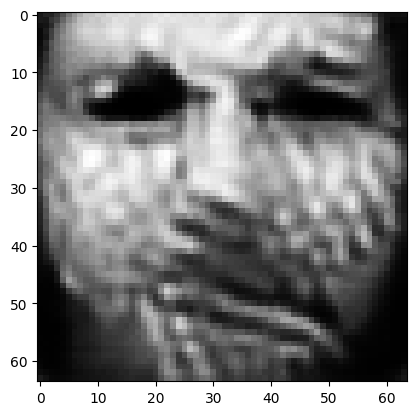

tensor([[6.0669e-04, 8.7908e-01, 4.3448e-04, 1.0010e-02, 6.8193e-04, 3.3772e-03,
         2.5537e-04, 1.9981e-03, 8.9714e-04, 1.6293e-03, 1.4896e-03, 8.7947e-03,
         5.1611e-03, 4.6057e-04, 1.2611e-03, 2.0982e-03, 1.2517e-03, 2.3716e-03,
         2.8852e-03, 1.5627e-03, 1.3837e-03, 6.1751e-05, 4.7280e-03, 5.0480e-04,
         8.8909e-04, 5.8898e-03, 1.2343e-03, 3.7452e-04, 2.7147e-03, 1.4718e-02,
         1.3592e-03, 5.2804e-03, 5.8720e-03, 2.1437e-04, 5.7822e-03, 1.7669e-02,
         8.9625e-04, 1.7849e-03, 8.9937e-04, 1.4422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12888500094413757
tensor([[6.0579e-04, 8.7967e-01, 4.3355e-04, 9.9881e-03, 6.7750e-04, 3.3671e-03,
         2.5339e-04, 1.9933e-03, 8.9175e-04, 1.6264e-03, 1.4802e-03, 8.7610e-03,
         5.1460e-03, 4.5854e-04, 1.2517e-03, 2.0933e-03, 1.2472e-03, 2.3497e-03,
         2.8810e-03, 1.5558e-03, 1.3734e-03, 6.1470e-05, 4.6979e-03, 5.0241e-04,
         8.8298e-04, 5.8569e-03, 1.2294e-0

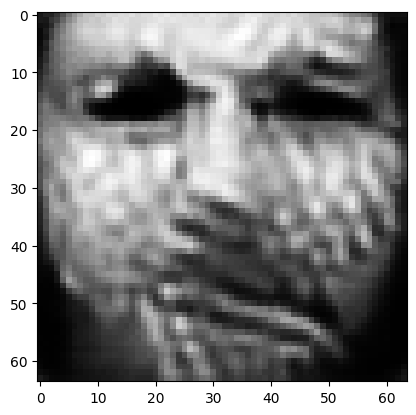

tensor([[5.9562e-04, 8.8194e-01, 4.2438e-04, 9.8970e-03, 6.6096e-04, 3.2950e-03,
         2.4450e-04, 1.9568e-03, 8.6697e-04, 1.5998e-03, 1.4410e-03, 8.5983e-03,
         5.0762e-03, 4.5071e-04, 1.2197e-03, 2.0545e-03, 1.2275e-03, 2.2734e-03,
         2.8446e-03, 1.5107e-03, 1.3222e-03, 5.9885e-05, 4.6187e-03, 4.9177e-04,
         8.6478e-04, 5.7942e-03, 1.2021e-03, 3.6589e-04, 2.6373e-03, 1.4423e-02,
         1.3357e-03, 5.1202e-03, 5.6182e-03, 2.0893e-04, 5.6096e-03, 1.7269e-02,
         8.7175e-04, 1.7451e-03, 8.7395e-04, 1.3938e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1256350874900818
tensor([[5.9524e-04, 8.8248e-01, 4.2281e-04, 9.8737e-03, 6.5742e-04, 3.2845e-03,
         2.4285e-04, 1.9549e-03, 8.6067e-04, 1.5953e-03, 1.4326e-03, 8.5594e-03,
         5.0540e-03, 4.4826e-04, 1.2138e-03, 2.0528e-03, 1.2224e-03, 2.2576e-03,
         2.8471e-03, 1.5036e-03, 1.3132e-03, 5.9595e-05, 4.5869e-03, 4.8997e-04,
         8.5797e-04, 5.7636e-03, 1.1982e-03

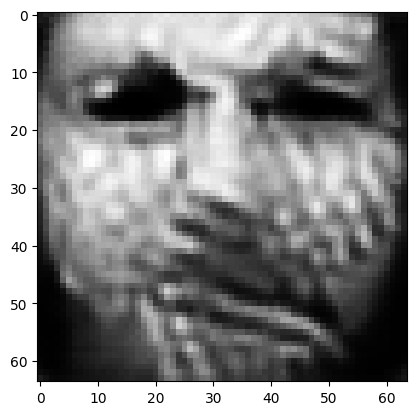

tensor([[5.8016e-04, 8.8460e-01, 4.1038e-04, 9.7104e-03, 6.3765e-04, 3.1853e-03,
         2.3414e-04, 1.8966e-03, 8.3841e-04, 1.5690e-03, 1.3929e-03, 8.4324e-03,
         4.9814e-03, 4.3959e-04, 1.1780e-03, 2.0007e-03, 1.1940e-03, 2.1751e-03,
         2.7944e-03, 1.4567e-03, 1.2643e-03, 5.8053e-05, 4.5204e-03, 4.7511e-04,
         8.3621e-04, 5.7387e-03, 1.1708e-03, 3.5711e-04, 2.5562e-03, 1.4231e-02,
         1.3122e-03, 4.9788e-03, 5.4030e-03, 2.0366e-04, 5.4321e-03, 1.7005e-02,
         8.4863e-04, 1.7012e-03, 8.4607e-04, 1.3501e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12261589616537094
tensor([[5.7780e-04, 8.8510e-01, 4.0787e-04, 9.6705e-03, 6.3384e-04, 3.1665e-03,
         2.3240e-04, 1.8866e-03, 8.3204e-04, 1.5639e-03, 1.3838e-03, 8.4037e-03,
         4.9602e-03, 4.3727e-04, 1.1711e-03, 1.9923e-03, 1.1885e-03, 2.1572e-03,
         2.7875e-03, 1.4471e-03, 1.2536e-03, 5.7772e-05, 4.4985e-03, 4.7259e-04,
         8.3084e-04, 5.7236e-03, 1.1652e-0

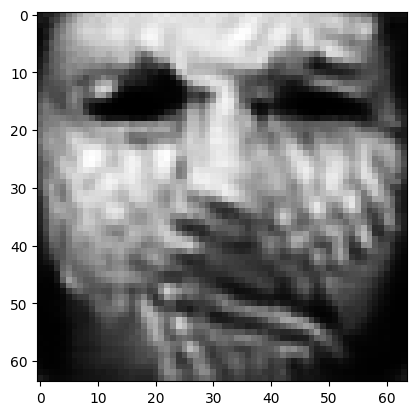

tensor([[5.6347e-04, 8.8699e-01, 3.9577e-04, 9.5229e-03, 6.1559e-04, 3.0668e-03,
         2.2443e-04, 1.8314e-03, 8.1066e-04, 1.5361e-03, 1.3486e-03, 8.2916e-03,
         4.8802e-03, 4.2937e-04, 1.1388e-03, 1.9390e-03, 1.1623e-03, 2.0775e-03,
         2.7405e-03, 1.4008e-03, 1.2079e-03, 5.6476e-05, 4.4496e-03, 4.5904e-04,
         8.1284e-04, 5.7181e-03, 1.1393e-03, 3.4893e-04, 2.4735e-03, 1.4059e-02,
         1.2955e-03, 4.8616e-03, 5.2208e-03, 1.9912e-04, 5.2510e-03, 1.6858e-02,
         8.3072e-04, 1.6623e-03, 8.1904e-04, 1.3087e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11991921067237854
tensor([[5.6265e-04, 8.8745e-01, 3.9469e-04, 9.4826e-03, 6.1269e-04, 3.0590e-03,
         2.2324e-04, 1.8250e-03, 8.0594e-04, 1.5350e-03, 1.3420e-03, 8.2837e-03,
         4.8658e-03, 4.2714e-04, 1.1338e-03, 1.9381e-03, 1.1600e-03, 2.0603e-03,
         2.7371e-03, 1.4005e-03, 1.2017e-03, 5.6497e-05, 4.4214e-03, 4.5816e-04,
         8.0679e-04, 5.6843e-03, 1.1361e-0

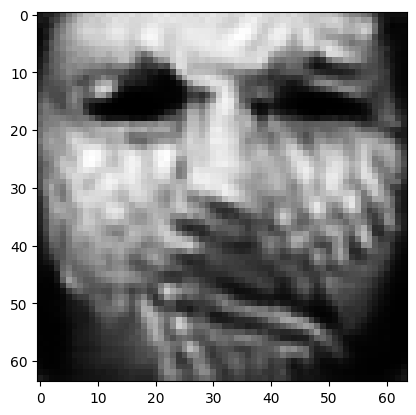

tensor([[5.5609e-04, 8.8936e-01, 3.8813e-04, 9.3223e-03, 5.9945e-04, 3.0114e-03,
         2.1761e-04, 1.7917e-03, 7.8280e-04, 1.5214e-03, 1.3107e-03, 8.2100e-03,
         4.7952e-03, 4.1846e-04, 1.1050e-03, 1.9194e-03, 1.1459e-03, 1.9899e-03,
         2.7171e-03, 1.3796e-03, 1.1683e-03, 5.5870e-05, 4.3362e-03, 4.5077e-04,
         7.8301e-04, 5.5918e-03, 1.1219e-03, 3.4175e-04, 2.4065e-03, 1.3927e-02,
         1.2767e-03, 4.7274e-03, 5.0727e-03, 1.9602e-04, 5.0729e-03, 1.6408e-02,
         8.1297e-04, 1.6187e-03, 8.0147e-04, 1.2884e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11725371330976486
tensor([[5.5567e-04, 8.8981e-01, 3.8706e-04, 9.2785e-03, 5.9709e-04, 3.0045e-03,
         2.1665e-04, 1.7884e-03, 7.7647e-04, 1.5201e-03, 1.3038e-03, 8.1934e-03,
         4.7743e-03, 4.1605e-04, 1.0989e-03, 1.9199e-03, 1.1437e-03, 1.9735e-03,
         2.7188e-03, 1.3772e-03, 1.1610e-03, 5.5812e-05, 4.3074e-03, 4.5001e-04,
         7.7667e-04, 5.5638e-03, 1.1190e-0

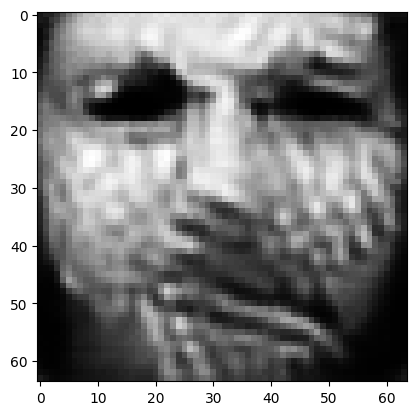

tensor([[5.4742e-04, 8.9157e-01, 3.8045e-04, 9.1416e-03, 5.8610e-04, 2.9485e-03,
         2.1123e-04, 1.7557e-03, 7.5687e-04, 1.4983e-03, 1.2738e-03, 8.1007e-03,
         4.7120e-03, 4.0937e-04, 1.0721e-03, 1.8904e-03, 1.1321e-03, 1.9110e-03,
         2.6904e-03, 1.3500e-03, 1.1267e-03, 5.4969e-05, 4.2516e-03, 4.4203e-04,
         7.5812e-04, 5.5041e-03, 1.1029e-03, 3.3682e-04, 2.3354e-03, 1.3763e-02,
         1.2629e-03, 4.5983e-03, 4.9268e-03, 1.9304e-04, 4.9125e-03, 1.6062e-02,
         8.0040e-04, 1.5793e-03, 7.8144e-04, 1.2669e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11476732045412064
tensor([[5.4569e-04, 8.9200e-01, 3.7915e-04, 9.1077e-03, 5.8324e-04, 2.9341e-03,
         2.1000e-04, 1.7488e-03, 7.5258e-04, 1.4922e-03, 1.2673e-03, 8.0768e-03,
         4.6974e-03, 4.0796e-04, 1.0661e-03, 1.8836e-03, 1.1293e-03, 1.8965e-03,
         2.6849e-03, 1.3438e-03, 1.1187e-03, 5.4755e-05, 4.2379e-03, 4.3990e-04,
         7.5332e-04, 5.4892e-03, 1.0997e-0

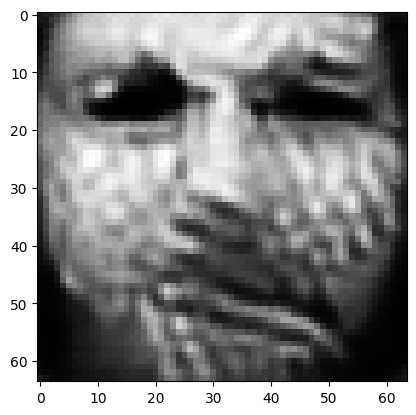

tensor([[5.3982e-04, 8.9376e-01, 3.7455e-04, 8.9666e-03, 5.7284e-04, 2.8816e-03,
         2.0535e-04, 1.7255e-03, 7.3317e-04, 1.4722e-03, 1.2401e-03, 7.9889e-03,
         4.6387e-03, 4.0190e-04, 1.0444e-03, 1.8622e-03, 1.1209e-03, 1.8377e-03,
         2.6710e-03, 1.3206e-03, 1.0879e-03, 5.4046e-05, 4.1763e-03, 4.3298e-04,
         7.3411e-04, 5.4119e-03, 1.0882e-03, 3.3330e-04, 2.2657e-03, 1.3590e-02,
         1.2558e-03, 4.4616e-03, 4.7903e-03, 1.9044e-04, 4.7557e-03, 1.5674e-02,
         7.8861e-04, 1.5403e-03, 7.6165e-04, 1.2456e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1123134046792984
tensor([[5.3788e-04, 8.9421e-01, 3.7291e-04, 8.9295e-03, 5.7025e-04, 2.8631e-03,
         2.0416e-04, 1.7190e-03, 7.2807e-04, 1.4648e-03, 1.2331e-03, 7.9598e-03,
         4.6229e-03, 4.0050e-04, 1.0401e-03, 1.8548e-03, 1.1186e-03, 1.8249e-03,
         2.6668e-03, 1.3133e-03, 1.0799e-03, 5.3830e-05, 4.1668e-03, 4.3115e-04,
         7.2999e-04, 5.3947e-03, 1.0849e-03

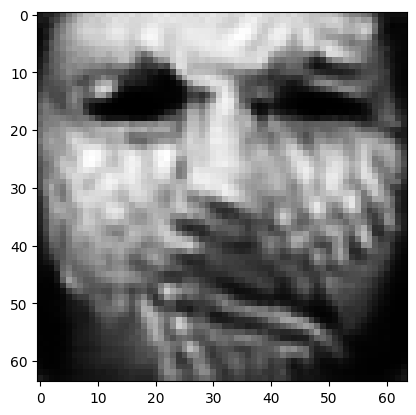

tensor([[5.2902e-04, 8.9588e-01, 3.6589e-04, 8.7958e-03, 5.6013e-04, 2.7967e-03,
         1.9929e-04, 1.6875e-03, 7.1001e-04, 1.4378e-03, 1.2048e-03, 7.8560e-03,
         4.5692e-03, 3.9483e-04, 1.0190e-03, 1.8211e-03, 1.1075e-03, 1.7732e-03,
         2.6412e-03, 1.2850e-03, 1.0491e-03, 5.2940e-05, 4.1332e-03, 4.2337e-04,
         7.1514e-04, 5.3404e-03, 1.0706e-03, 3.2916e-04, 2.1883e-03, 1.3386e-02,
         1.2470e-03, 4.3434e-03, 4.6558e-03, 1.8747e-04, 4.6024e-03, 1.5403e-02,
         7.7867e-04, 1.5023e-03, 7.4007e-04, 1.2196e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10995053499937057
tensor([[5.2560e-04, 8.9625e-01, 3.6356e-04, 8.7755e-03, 5.5688e-04, 2.7763e-03,
         1.9783e-04, 1.6751e-03, 7.0628e-04, 1.4302e-03, 1.1969e-03, 7.8307e-03,
         4.5614e-03, 3.9357e-04, 1.0121e-03, 1.8080e-03, 1.1041e-03, 1.7583e-03,
         2.6285e-03, 1.2763e-03, 1.0410e-03, 5.2651e-05, 4.1337e-03, 4.2067e-04,
         7.1278e-04, 5.3357e-03, 1.0653e-0

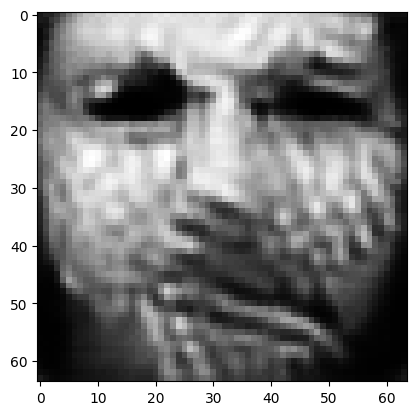

tensor([[5.1951e-04, 8.9763e-01, 3.5884e-04, 8.6769e-03, 5.4842e-04, 2.7269e-03,
         1.9400e-04, 1.6556e-03, 6.9103e-04, 1.4092e-03, 1.1749e-03, 7.7417e-03,
         4.5118e-03, 3.8889e-04, 9.9212e-04, 1.7858e-03, 1.0956e-03, 1.7125e-03,
         2.6154e-03, 1.2530e-03, 1.0162e-03, 5.1933e-05, 4.0951e-03, 4.1444e-04,
         6.9936e-04, 5.2900e-03, 1.0531e-03, 3.2505e-04, 2.1285e-03, 1.3232e-02,
         1.2397e-03, 4.2393e-03, 4.5439e-03, 1.8505e-04, 4.4796e-03, 1.5158e-02,
         7.6884e-04, 1.4731e-03, 7.2401e-04, 1.1984e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10799456387758255
tensor([[5.1525e-04, 8.9795e-01, 3.5617e-04, 8.6586e-03, 5.4514e-04, 2.7042e-03,
         1.9249e-04, 1.6423e-03, 6.8844e-04, 1.4005e-03, 1.1678e-03, 7.7144e-03,
         4.5046e-03, 3.8818e-04, 9.8464e-04, 1.7696e-03, 1.0911e-03, 1.6994e-03,
         2.5983e-03, 1.2426e-03, 1.0075e-03, 5.1566e-05, 4.1027e-03, 4.1125e-04,
         6.9797e-04, 5.3017e-03, 1.0470e-0

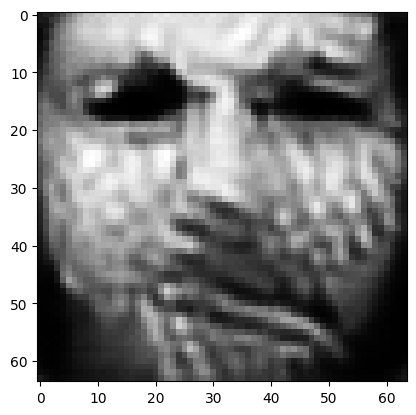

tensor([[5.0985e-04, 8.9921e-01, 3.5197e-04, 8.5715e-03, 5.3769e-04, 2.6614e-03,
         1.8900e-04, 1.6271e-03, 6.7385e-04, 1.3815e-03, 1.1474e-03, 7.6340e-03,
         4.4565e-03, 3.8344e-04, 9.6811e-04, 1.7497e-03, 1.0835e-03, 1.6591e-03,
         2.5856e-03, 1.2225e-03, 9.8426e-04, 5.0928e-05, 4.0670e-03, 4.0644e-04,
         6.8655e-04, 5.2598e-03, 1.0330e-03, 3.2186e-04, 2.0715e-03, 1.3063e-02,
         1.2359e-03, 4.1465e-03, 4.4359e-03, 1.8271e-04, 4.3693e-03, 1.4991e-02,
         7.6047e-04, 1.4465e-03, 7.0880e-04, 1.1763e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10624047368764877
tensor([[5.0744e-04, 8.9951e-01, 3.5020e-04, 8.5374e-03, 5.3490e-04, 2.6441e-03,
         1.8799e-04, 1.6190e-03, 6.7054e-04, 1.3768e-03, 1.1416e-03, 7.6184e-03,
         4.4434e-03, 3.8201e-04, 9.6355e-04, 1.7406e-03, 1.0793e-03, 1.6474e-03,
         2.5778e-03, 1.2166e-03, 9.7824e-04, 5.0760e-05, 4.0595e-03, 4.0438e-04,
         6.8385e-04, 5.2572e-03, 1.0286e-0

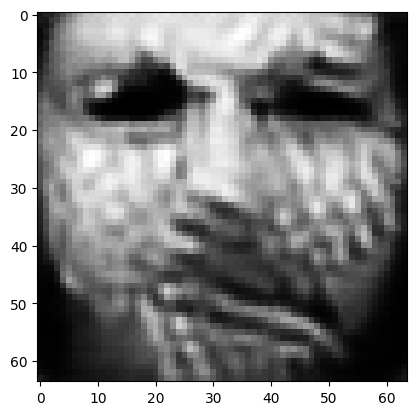

tensor([[5.0187e-04, 9.0066e-01, 3.4669e-04, 8.4575e-03, 5.2680e-04, 2.5998e-03,
         1.8449e-04, 1.6025e-03, 6.5724e-04, 1.3589e-03, 1.1220e-03, 7.5485e-03,
         4.4052e-03, 3.7790e-04, 9.4760e-04, 1.7188e-03, 1.0728e-03, 1.6085e-03,
         2.5634e-03, 1.1966e-03, 9.5658e-04, 5.0133e-05, 4.0314e-03, 3.9914e-04,
         6.7394e-04, 5.2261e-03, 1.0152e-03, 3.1903e-04, 2.0241e-03, 1.2919e-02,
         1.2354e-03, 4.0652e-03, 4.3466e-03, 1.8080e-04, 4.2646e-03, 1.4807e-02,
         7.5161e-04, 1.4220e-03, 6.9644e-04, 1.1546e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10462278872728348
tensor([[4.9817e-04, 9.0095e-01, 3.4439e-04, 8.4386e-03, 5.2363e-04, 2.5777e-03,
         1.8311e-04, 1.5917e-03, 6.5472e-04, 1.3500e-03, 1.1160e-03, 7.5199e-03,
         4.3959e-03, 3.7728e-04, 9.4221e-04, 1.7038e-03, 1.0684e-03, 1.5983e-03,
         2.5505e-03, 1.1869e-03, 9.4876e-04, 4.9778e-05, 4.0380e-03, 3.9617e-04,
         6.7285e-04, 5.2382e-03, 1.0097e-0

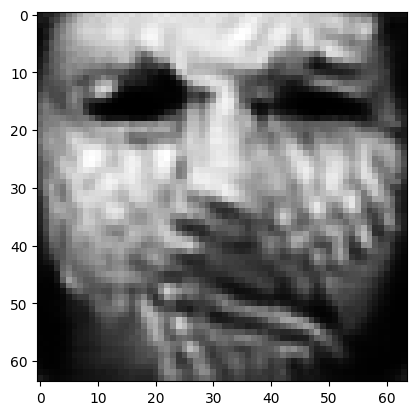

tensor([[4.9116e-04, 9.0204e-01, 3.4017e-04, 8.3553e-03, 5.1516e-04, 2.5282e-03,
         1.7956e-04, 1.5701e-03, 6.4304e-04, 1.3308e-03, 1.0964e-03, 7.4502e-03,
         4.3616e-03, 3.7365e-04, 9.2551e-04, 1.6762e-03, 1.0598e-03, 1.5609e-03,
         2.5289e-03, 1.1656e-03, 9.2717e-04, 4.9091e-05, 4.0203e-03, 3.8987e-04,
         6.6430e-04, 5.2213e-03, 9.9581e-04, 3.1575e-04, 1.9721e-03, 1.2770e-02,
         1.2366e-03, 3.9876e-03, 4.2572e-03, 1.7907e-04, 4.1663e-03, 1.4695e-02,
         7.4440e-04, 1.3991e-03, 6.8313e-04, 1.1311e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10309334844350815
tensor([[4.8871e-04, 9.0231e-01, 3.3860e-04, 8.3367e-03, 5.1292e-04, 2.5125e-03,
         1.7856e-04, 1.5638e-03, 6.4000e-04, 1.3242e-03, 1.0911e-03, 7.4264e-03,
         4.3521e-03, 3.7287e-04, 9.2104e-04, 1.6665e-03, 1.0568e-03, 1.5520e-03,
         2.5218e-03, 1.1585e-03, 9.2054e-04, 4.8835e-05, 4.0208e-03, 3.8798e-04,
         6.6273e-04, 5.2242e-03, 9.9124e-0

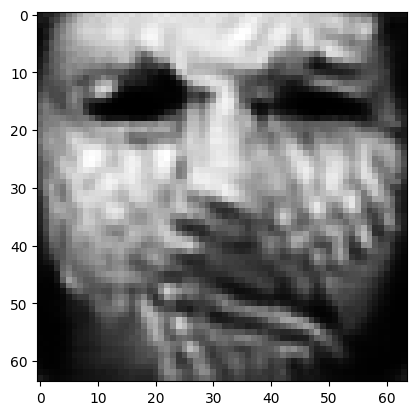

tensor([[4.8330e-04, 9.0335e-01, 3.3522e-04, 8.2579e-03, 5.0602e-04, 2.4729e-03,
         1.7571e-04, 1.5482e-03, 6.2842e-04, 1.3080e-03, 1.0729e-03, 7.3624e-03,
         4.3220e-03, 3.6926e-04, 9.0655e-04, 1.6450e-03, 1.0500e-03, 1.5194e-03,
         2.5059e-03, 1.1421e-03, 9.0120e-04, 4.8251e-05, 3.9983e-03, 3.8325e-04,
         6.5448e-04, 5.1898e-03, 9.7871e-04, 3.1315e-04, 1.9270e-03, 1.2608e-02,
         1.2349e-03, 3.9188e-03, 4.1779e-03, 1.7714e-04, 4.0760e-03, 1.4556e-02,
         7.3731e-04, 1.3766e-03, 6.7191e-04, 1.1107e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10164611041545868
tensor([[4.8173e-04, 9.0360e-01, 3.3429e-04, 8.2417e-03, 5.0408e-04, 2.4630e-03,
         1.7492e-04, 1.5428e-03, 6.2628e-04, 1.3035e-03, 1.0685e-03, 7.3467e-03,
         4.3168e-03, 3.6855e-04, 9.0296e-04, 1.6382e-03, 1.0477e-03, 1.5120e-03,
         2.5002e-03, 1.1375e-03, 8.9669e-04, 4.8073e-05, 3.9951e-03, 3.8153e-04,
         6.5238e-04, 5.1817e-03, 9.7640e-0

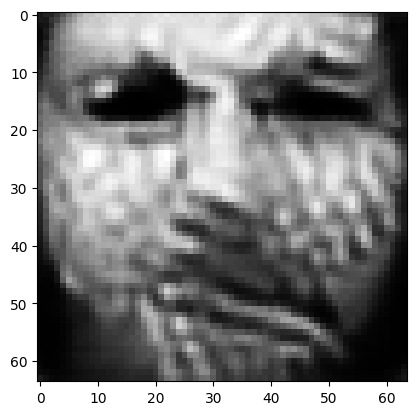

tensor([[4.7613e-04, 9.0453e-01, 3.3092e-04, 8.1965e-03, 4.9768e-04, 2.4278e-03,
         1.7207e-04, 1.5263e-03, 6.1673e-04, 1.2864e-03, 1.0513e-03, 7.2816e-03,
         4.2961e-03, 3.6562e-04, 8.8983e-04, 1.6160e-03, 1.0418e-03, 1.4835e-03,
         2.4825e-03, 1.1209e-03, 8.7911e-04, 4.7458e-05, 3.9848e-03, 3.7684e-04,
         6.4560e-04, 5.1509e-03, 9.6540e-04, 3.1041e-04, 1.8848e-03, 1.2468e-02,
         1.2324e-03, 3.8473e-03, 4.1003e-03, 1.7539e-04, 3.9998e-03, 1.4401e-02,
         7.3058e-04, 1.3563e-03, 6.6165e-04, 1.0943e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1003418117761612
tensor([[4.7488e-04, 9.0476e-01, 3.3018e-04, 8.1884e-03, 4.9623e-04, 2.4203e-03,
         1.7141e-04, 1.5228e-03, 6.1441e-04, 1.2820e-03, 1.0471e-03, 7.2640e-03,
         4.2914e-03, 3.6501e-04, 8.8682e-04, 1.6107e-03, 1.0405e-03, 1.4773e-03,
         2.4786e-03, 1.1166e-03, 8.7482e-04, 4.7297e-05, 3.9828e-03, 3.7568e-04,
         6.4398e-04, 5.1417e-03, 9.6314e-04

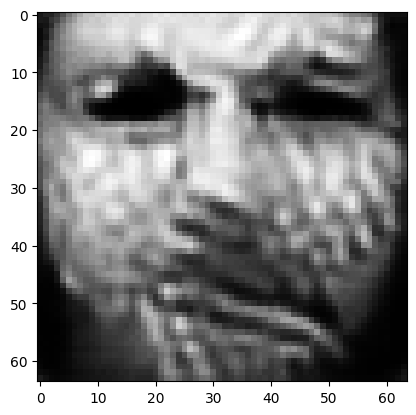

tensor([[4.6981e-04, 9.0568e-01, 3.2724e-04, 8.1309e-03, 4.8997e-04, 2.3885e-03,
         1.6883e-04, 1.5073e-03, 6.0485e-04, 1.2667e-03, 1.0308e-03, 7.2070e-03,
         4.2666e-03, 3.6203e-04, 8.7390e-04, 1.5912e-03, 1.0343e-03, 1.4496e-03,
         2.4627e-03, 1.1009e-03, 8.5785e-04, 4.6764e-05, 3.9663e-03, 3.7085e-04,
         6.3594e-04, 5.1085e-03, 9.5354e-04, 3.0823e-04, 1.8446e-03, 1.2321e-02,
         1.2300e-03, 3.7787e-03, 4.0289e-03, 1.7343e-04, 3.9275e-03, 1.4240e-02,
         7.2439e-04, 1.3371e-03, 6.5112e-04, 1.0797e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09906581789255142
tensor([[4.6799e-04, 9.0590e-01, 3.2612e-04, 8.1154e-03, 4.8815e-04, 2.3773e-03,
         1.6811e-04, 1.5022e-03, 6.0252e-04, 1.2619e-03, 1.0268e-03, 7.1890e-03,
         4.2587e-03, 3.6135e-04, 8.7054e-04, 1.5843e-03, 1.0320e-03, 1.4426e-03,
         2.4569e-03, 1.0958e-03, 8.5312e-04, 4.6591e-05, 3.9652e-03, 3.6938e-04,
         6.3455e-04, 5.1085e-03, 9.5008e-0

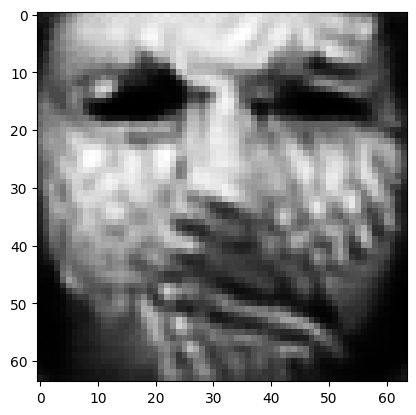

tensor([[4.6764e-04, 9.0668e-01, 3.2556e-04, 8.0863e-03, 4.8496e-04, 2.3689e-03,
         1.6676e-04, 1.5013e-03, 5.9444e-04, 1.2539e-03, 1.0147e-03, 7.1426e-03,
         4.2453e-03, 3.5835e-04, 8.6404e-04, 1.5807e-03, 1.0302e-03, 1.4261e-03,
         2.4570e-03, 1.0911e-03, 8.4345e-04, 4.6309e-05, 3.9303e-03, 3.6789e-04,
         6.2713e-04, 5.0336e-03, 9.4613e-04, 3.0616e-04, 1.8172e-03, 1.2186e-02,
         1.2232e-03, 3.7255e-03, 3.9723e-03, 1.7154e-04, 3.8745e-03, 1.4036e-02,
         7.1673e-04, 1.3216e-03, 6.4438e-04, 1.0677e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09796352684497833
tensor([[4.6704e-04, 9.0688e-01, 3.2507e-04, 8.0807e-03, 4.8393e-04, 2.3648e-03,
         1.6629e-04, 1.4996e-03, 5.9245e-04, 1.2510e-03, 1.0114e-03, 7.1272e-03,
         4.2416e-03, 3.5766e-04, 8.6217e-04, 1.5776e-03, 1.0291e-03, 1.4220e-03,
         2.4547e-03, 1.0887e-03, 8.4038e-04, 4.6181e-05, 3.9244e-03, 3.6718e-04,
         6.2568e-04, 5.0185e-03, 9.4457e-0

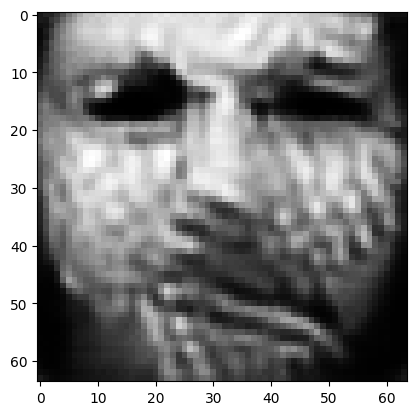

tensor([[4.6487e-04, 9.0764e-01, 3.2337e-04, 8.0573e-03, 4.8013e-04, 2.3502e-03,
         1.6452e-04, 1.4936e-03, 5.8492e-04, 1.2412e-03, 9.9822e-04, 7.0726e-03,
         4.2290e-03, 3.5490e-04, 8.5446e-04, 1.5669e-03, 1.0258e-03, 1.4052e-03,
         2.4468e-03, 1.0800e-03, 8.2898e-04, 4.5741e-05, 3.9008e-03, 3.6466e-04,
         6.1982e-04, 4.9618e-03, 9.3847e-04, 3.0369e-04, 1.7899e-03, 1.2045e-02,
         1.2151e-03, 3.6742e-03, 3.9091e-03, 1.6961e-04, 3.8288e-03, 1.3862e-02,
         7.0888e-04, 1.3067e-03, 6.3739e-04, 1.0545e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09690730273723602
tensor([[4.6407e-04, 9.0782e-01, 3.2280e-04, 8.0497e-03, 4.7901e-04, 2.3449e-03,
         1.6401e-04, 1.4911e-03, 5.8316e-04, 1.2384e-03, 9.9504e-04, 7.0601e-03,
         4.2251e-03, 3.5427e-04, 8.5258e-04, 1.5634e-03, 1.0247e-03, 1.4009e-03,
         2.4434e-03, 1.0776e-03, 8.2611e-04, 4.5635e-05, 3.8958e-03, 3.6391e-04,
         6.1844e-04, 4.9514e-03, 9.3658e-0

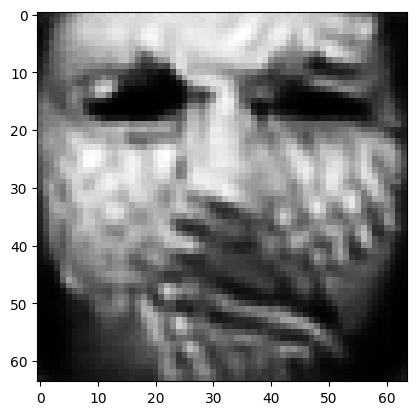

tensor([[4.6080e-04, 9.0853e-01, 3.2050e-04, 8.0165e-03, 4.7451e-04, 2.3231e-03,
         1.6209e-04, 1.4820e-03, 5.7610e-04, 1.2270e-03, 9.8267e-04, 7.0033e-03,
         4.2079e-03, 3.5185e-04, 8.4456e-04, 1.5485e-03, 1.0195e-03, 1.3834e-03,
         2.4325e-03, 1.0661e-03, 8.1381e-04, 4.5131e-05, 3.8785e-03, 3.6030e-04,
         6.1312e-04, 4.9179e-03, 9.2950e-04, 3.0140e-04, 1.7624e-03, 1.1925e-02,
         1.2098e-03, 3.6280e-03, 3.8500e-03, 1.6783e-04, 3.7816e-03, 1.3739e-02,
         7.0213e-04, 1.2936e-03, 6.2981e-04, 1.0404e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09592892229557037
tensor([[4.5868e-04, 9.0870e-01, 3.1926e-04, 8.0014e-03, 4.7268e-04, 2.3108e-03,
         1.6134e-04, 1.4757e-03, 5.7456e-04, 1.2217e-03, 9.7905e-04, 6.9851e-03,
         4.2018e-03, 3.5149e-04, 8.4196e-04, 1.5393e-03, 1.0167e-03, 1.3784e-03,
         2.4243e-03, 1.0603e-03, 8.0958e-04, 4.4917e-05, 3.8819e-03, 3.5839e-04,
         6.1232e-04, 4.9249e-03, 9.2646e-0

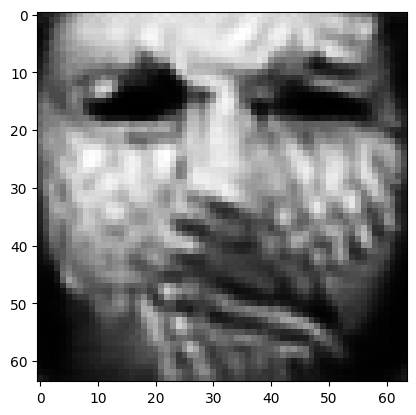

tensor([[4.5544e-04, 9.0935e-01, 3.1718e-04, 7.9702e-03, 4.6801e-04, 2.2872e-03,
         1.5954e-04, 1.4665e-03, 5.6821e-04, 1.2107e-03, 9.6737e-04, 6.9301e-03,
         4.1884e-03, 3.4938e-04, 8.3427e-04, 1.5234e-03, 1.0119e-03, 1.3606e-03,
         2.4132e-03, 1.0491e-03, 7.9804e-04, 4.4446e-05, 3.8692e-03, 3.5478e-04,
         6.0819e-04, 4.8956e-03, 9.1924e-04, 2.9919e-04, 1.7343e-03, 1.1817e-02,
         1.2079e-03, 3.5832e-03, 3.7961e-03, 1.6636e-04, 3.7339e-03, 1.3666e-02,
         6.9616e-04, 1.2810e-03, 6.2247e-04, 1.0247e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0950237363576889
tensor([[4.5418e-04, 9.0951e-01, 3.1639e-04, 7.9581e-03, 4.6674e-04, 2.2791e-03,
         1.5900e-04, 1.4626e-03, 5.6677e-04, 1.2070e-03, 9.6441e-04, 6.9157e-03,
         4.1839e-03, 3.4900e-04, 8.3247e-04, 1.5177e-03, 1.0100e-03, 1.3568e-03,
         2.4083e-03, 1.0454e-03, 7.9487e-04, 4.4302e-05, 3.8687e-03, 3.5353e-04,
         6.0715e-04, 4.8946e-03, 9.1732e-04

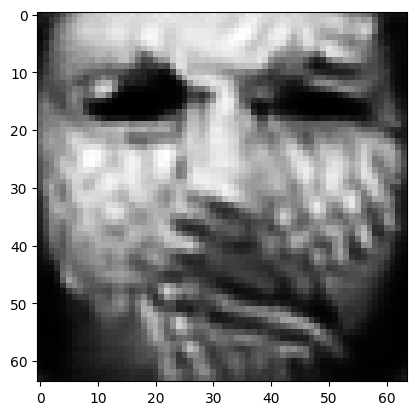

tensor([[4.5077e-04, 9.1012e-01, 3.1432e-04, 7.9232e-03, 4.6226e-04, 2.2552e-03,
         1.5720e-04, 1.4530e-03, 5.6080e-04, 1.1962e-03, 9.5351e-04, 6.8645e-03,
         4.1694e-03, 3.4706e-04, 8.2520e-04, 1.5018e-03, 1.0052e-03, 1.3395e-03,
         2.3968e-03, 1.0342e-03, 7.8379e-04, 4.3853e-05, 3.8572e-03, 3.4987e-04,
         6.0296e-04, 4.8741e-03, 9.1010e-04, 2.9744e-04, 1.7084e-03, 1.1720e-02,
         1.2068e-03, 3.5397e-03, 3.7449e-03, 1.6500e-04, 3.6881e-03, 1.3586e-02,
         6.9091e-04, 1.2694e-03, 6.1532e-04, 1.0110e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09417403489351273
tensor([[4.4976e-04, 9.1028e-01, 3.1374e-04, 7.9185e-03, 4.6114e-04, 2.2493e-03,
         1.5673e-04, 1.4505e-03, 5.5940e-04, 1.1934e-03, 9.5067e-04, 6.8495e-03,
         4.1671e-03, 3.4662e-04, 8.2312e-04, 1.4974e-03, 1.0042e-03, 1.3351e-03,
         2.3932e-03, 1.0311e-03, 7.8083e-04, 4.3717e-05, 3.8563e-03, 3.4892e-04,
         6.0228e-04, 4.8695e-03, 9.0795e-0

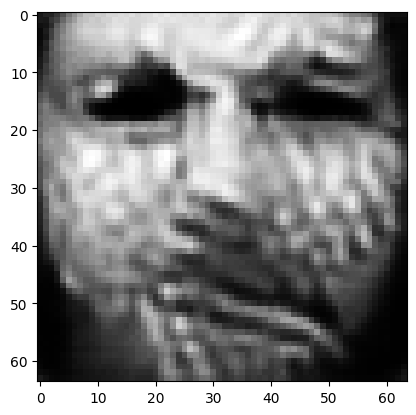

tensor([[4.4558e-04, 9.1086e-01, 3.1131e-04, 7.8886e-03, 4.5665e-04, 2.2247e-03,
         1.5484e-04, 1.4387e-03, 5.5409e-04, 1.1822e-03, 9.4006e-04, 6.7985e-03,
         4.1539e-03, 3.4492e-04, 8.1565e-04, 1.4793e-03, 9.9882e-04, 1.3193e-03,
         2.3772e-03, 1.0192e-03, 7.6978e-04, 4.3217e-05, 3.8494e-03, 3.4491e-04,
         5.9876e-04, 4.8562e-03, 8.9992e-04, 2.9528e-04, 1.6838e-03, 1.1629e-02,
         1.2042e-03, 3.4966e-03, 3.6933e-03, 1.6369e-04, 3.6450e-03, 1.3515e-02,
         6.8556e-04, 1.2583e-03, 6.0885e-04, 9.9782e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09336845576763153
tensor([[4.4501e-04, 9.1101e-01, 3.1103e-04, 7.8819e-03, 4.5575e-04, 2.2214e-03,
         1.5445e-04, 1.4370e-03, 5.5275e-04, 1.1806e-03, 9.3762e-04, 6.7884e-03,
         4.1509e-03, 3.4438e-04, 8.1388e-04, 1.4769e-03, 9.9797e-04, 1.3155e-03,
         2.3754e-03, 1.0172e-03, 7.6764e-04, 4.3126e-05, 3.8446e-03, 3.4414e-04,
         5.9747e-04, 4.8470e-03, 8.9868e-0

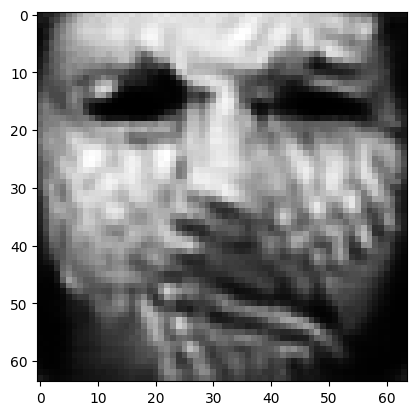

tensor([[4.4071e-04, 9.1160e-01, 3.0909e-04, 7.8397e-03, 4.5165e-04, 2.2001e-03,
         1.5255e-04, 1.4240e-03, 5.4734e-04, 1.1717e-03, 9.2689e-04, 6.7474e-03,
         4.1367e-03, 3.4245e-04, 8.0435e-04, 1.4619e-03, 9.9391e-04, 1.2972e-03,
         2.3587e-03, 1.0068e-03, 7.5704e-04, 4.2697e-05, 3.8347e-03, 3.4057e-04,
         5.9273e-04, 4.8377e-03, 8.9076e-04, 2.9335e-04, 1.6609e-03, 1.1558e-02,
         1.2020e-03, 3.4495e-03, 3.6457e-03, 1.6266e-04, 3.5993e-03, 1.3402e-02,
         6.8173e-04, 1.2451e-03, 6.0253e-04, 9.8982e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09255625307559967
tensor([[4.3971e-04, 9.1174e-01, 3.0863e-04, 7.8297e-03, 4.5065e-04, 2.1954e-03,
         1.5210e-04, 1.4208e-03, 5.4604e-04, 1.1697e-03, 9.2433e-04, 6.7387e-03,
         4.1336e-03, 3.4195e-04, 8.0203e-04, 1.4585e-03, 9.9299e-04, 1.2928e-03,
         2.3546e-03, 1.0046e-03, 7.5457e-04, 4.2600e-05, 3.8317e-03, 3.3980e-04,
         5.9160e-04, 4.8342e-03, 8.8881e-0

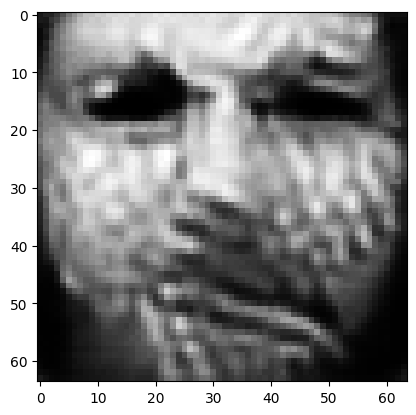

tensor([[4.3612e-04, 9.1230e-01, 3.0697e-04, 7.7829e-03, 4.4692e-04, 2.1760e-03,
         1.5045e-04, 1.4097e-03, 5.4071e-04, 1.1619e-03, 9.1472e-04, 6.7015e-03,
         4.1184e-03, 3.3998e-04, 7.9344e-04, 1.4457e-03, 9.8908e-04, 1.2761e-03,
         2.3414e-03, 9.9543e-04, 7.4495e-04, 4.2226e-05, 3.8193e-03, 3.3671e-04,
         5.8696e-04, 4.8226e-03, 8.8205e-04, 2.9166e-04, 1.6396e-03, 1.1489e-02,
         1.2006e-03, 3.4080e-03, 3.6028e-03, 1.6176e-04, 3.5551e-03, 1.3301e-02,
         6.7868e-04, 1.2320e-03, 5.9647e-04, 9.8231e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0917886346578598
tensor([[4.3463e-04, 9.1243e-01, 3.0623e-04, 7.7704e-03, 4.4575e-04, 2.1688e-03,
         1.4993e-04, 1.4052e-03, 5.3952e-04, 1.1590e-03, 9.1212e-04, 6.6907e-03,
         4.1140e-03, 3.3959e-04, 7.9087e-04, 1.4406e-03, 9.8749e-04, 1.2718e-03,
         2.3356e-03, 9.9207e-04, 7.4209e-04, 4.2096e-05, 3.8194e-03, 3.3562e-04,
         5.8599e-04, 4.8266e-03, 8.7979e-04

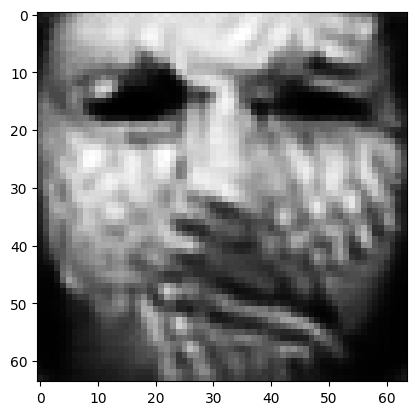

tensor([[4.3156e-04, 9.1295e-01, 3.0487e-04, 7.7290e-03, 4.4237e-04, 2.1519e-03,
         1.4844e-04, 1.3957e-03, 5.3464e-04, 1.1520e-03, 9.0346e-04, 6.6568e-03,
         4.1009e-03, 3.3782e-04, 7.8278e-04, 1.4296e-03, 9.8405e-04, 1.2565e-03,
         2.3244e-03, 9.8407e-04, 7.3318e-04, 4.1761e-05, 3.8061e-03, 3.3292e-04,
         5.8162e-04, 4.8140e-03, 8.7375e-04, 2.9016e-04, 1.6192e-03, 1.1421e-02,
         1.1998e-03, 3.3696e-03, 3.5633e-03, 1.6094e-04, 3.5133e-03, 1.3214e-02,
         6.7605e-04, 1.2200e-03, 5.9062e-04, 9.7497e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0910712480545044
tensor([[4.3095e-04, 9.1308e-01, 3.0458e-04, 7.7209e-03, 4.4161e-04, 2.1485e-03,
         1.4812e-04, 1.3938e-03, 5.3337e-04, 1.1505e-03, 9.0138e-04, 6.6489e-03,
         4.0982e-03, 3.3736e-04, 7.8080e-04, 1.4275e-03, 9.8357e-04, 1.2525e-03,
         2.3223e-03, 9.8247e-04, 7.3108e-04, 4.1694e-05, 3.8023e-03, 3.3245e-04,
         5.8061e-04, 4.8093e-03, 8.7219e-04

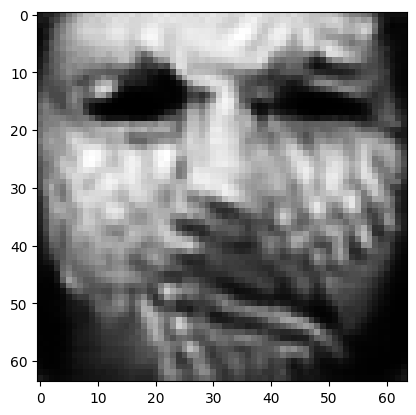

tensor([[4.2747e-04, 9.1356e-01, 3.0273e-04, 7.6823e-03, 4.3779e-04, 2.1282e-03,
         1.4659e-04, 1.3832e-03, 5.2892e-04, 1.1423e-03, 8.9320e-04, 6.6140e-03,
         4.0830e-03, 3.3580e-04, 7.7326e-04, 1.4143e-03, 9.7861e-04, 1.2381e-03,
         2.3102e-03, 9.7345e-04, 7.2204e-04, 4.1327e-05, 3.7925e-03, 3.2940e-04,
         5.7664e-04, 4.8065e-03, 8.6580e-04, 2.8867e-04, 1.6004e-03, 1.1353e-02,
         1.1989e-03, 3.3361e-03, 3.5273e-03, 1.6009e-04, 3.4745e-03, 1.3142e-02,
         6.7289e-04, 1.2096e-03, 5.8532e-04, 9.6678e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09041063487529755
tensor([[4.2726e-04, 9.1367e-01, 3.0263e-04, 7.6777e-03, 4.3717e-04, 2.1267e-03,
         1.4633e-04, 1.3824e-03, 5.2798e-04, 1.1414e-03, 8.9155e-04, 6.6084e-03,
         4.0808e-03, 3.3539e-04, 7.7196e-04, 1.4134e-03, 9.7803e-04, 1.2353e-03,
         2.3095e-03, 9.7257e-04, 7.2057e-04, 4.1285e-05, 3.7870e-03, 3.2904e-04,
         5.7546e-04, 4.7981e-03, 8.6510e-0

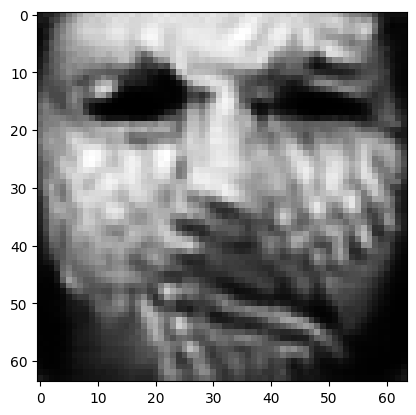

tensor([[4.2445e-04, 9.1409e-01, 3.0106e-04, 7.6453e-03, 4.3378e-04, 2.1109e-03,
         1.4504e-04, 1.3737e-03, 5.2399e-04, 1.1349e-03, 8.8448e-04, 6.5786e-03,
         4.0670e-03, 3.3381e-04, 7.6574e-04, 1.4025e-03, 9.7339e-04, 1.2234e-03,
         2.2997e-03, 9.6536e-04, 7.1291e-04, 4.0981e-05, 3.7759e-03, 3.2646e-04,
         5.7179e-04, 4.7905e-03, 8.5986e-04, 2.8722e-04, 1.5852e-03, 1.1294e-02,
         1.1970e-03, 3.3063e-03, 3.4967e-03, 1.5928e-04, 3.4423e-03, 1.3067e-02,
         6.6951e-04, 1.2003e-03, 5.8072e-04, 9.5987e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0898272842168808
tensor([[4.2408e-04, 9.1419e-01, 3.0086e-04, 7.6390e-03, 4.3314e-04, 2.1088e-03,
         1.4480e-04, 1.3723e-03, 5.2303e-04, 1.1339e-03, 8.8287e-04, 6.5728e-03,
         4.0649e-03, 3.3342e-04, 7.6456e-04, 1.4009e-03, 9.7278e-04, 1.2209e-03,
         2.2984e-03, 9.6418e-04, 7.1142e-04, 4.0928e-05, 3.7725e-03, 3.2603e-04,
         5.7089e-04, 4.7840e-03, 8.5913e-04

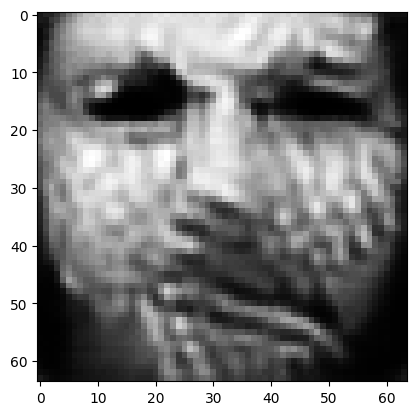

tensor([[4.2150e-04, 9.1458e-01, 2.9949e-04, 7.6115e-03, 4.3014e-04, 2.0952e-03,
         1.4361e-04, 1.3642e-03, 5.1936e-04, 1.1279e-03, 8.7621e-04, 6.5456e-03,
         4.0536e-03, 3.3199e-04, 7.5866e-04, 1.3910e-03, 9.6895e-04, 1.2101e-03,
         2.2889e-03, 9.5744e-04, 7.0458e-04, 4.0645e-05, 3.7633e-03, 3.2368e-04,
         5.6749e-04, 4.7750e-03, 8.5453e-04, 2.8586e-04, 1.5709e-03, 1.1234e-02,
         1.1953e-03, 3.2784e-03, 3.4683e-03, 1.5854e-04, 3.4132e-03, 1.2999e-02,
         6.6672e-04, 1.1915e-03, 5.7628e-04, 9.5372e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08928709477186203
tensor([[4.2070e-04, 9.1468e-01, 2.9905e-04, 7.6036e-03, 4.2934e-04, 2.0908e-03,
         1.4329e-04, 1.3619e-03, 5.1837e-04, 1.1260e-03, 8.7451e-04, 6.5374e-03,
         4.0499e-03, 3.3164e-04, 7.5719e-04, 1.3880e-03, 9.6782e-04, 1.2072e-03,
         2.2861e-03, 9.5536e-04, 7.0271e-04, 4.0564e-05, 3.7620e-03, 3.2305e-04,
         5.6673e-04, 4.7752e-03, 8.5305e-0

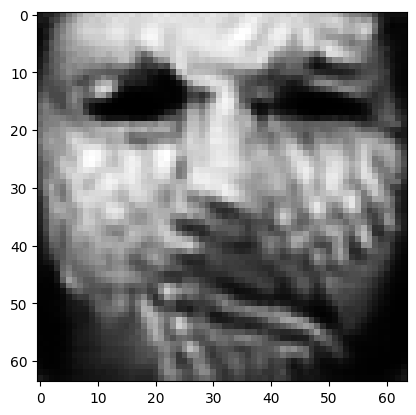

tensor([[4.1791e-04, 9.1508e-01, 2.9770e-04, 7.5743e-03, 4.2652e-04, 2.0755e-03,
         1.4209e-04, 1.3536e-03, 5.1458e-04, 1.1192e-03, 8.6770e-04, 6.5075e-03,
         4.0385e-03, 3.3032e-04, 7.5116e-04, 1.3777e-03, 9.6468e-04, 1.1953e-03,
         2.2753e-03, 9.4806e-04, 6.9596e-04, 4.0314e-05, 3.7574e-03, 3.2096e-04,
         5.6352e-04, 4.7697e-03, 8.4776e-04, 2.8442e-04, 1.5548e-03, 1.1179e-02,
         1.1942e-03, 3.2498e-03, 3.4372e-03, 1.5787e-04, 3.3799e-03, 1.2946e-02,
         6.6460e-04, 1.1827e-03, 5.7100e-04, 9.4695e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08874595910310745
tensor([[4.1735e-04, 9.1518e-01, 2.9743e-04, 7.5680e-03, 4.2594e-04, 2.0725e-03,
         1.4180e-04, 1.3521e-03, 5.1357e-04, 1.1172e-03, 8.6595e-04, 6.4981e-03,
         4.0363e-03, 3.3003e-04, 7.4971e-04, 1.3754e-03, 9.6403e-04, 1.1926e-03,
         2.2734e-03, 9.4605e-04, 6.9429e-04, 4.0244e-05, 3.7566e-03, 3.2042e-04,
         5.6269e-04, 4.7666e-03, 8.4676e-0

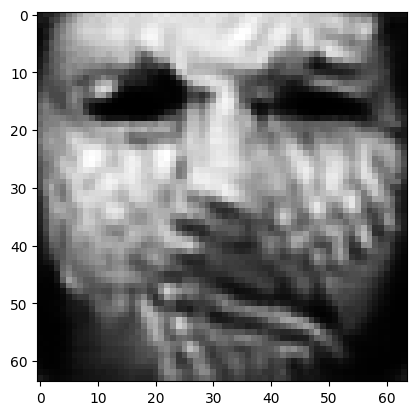

tensor([[4.1417e-04, 9.1558e-01, 2.9581e-04, 7.5413e-03, 4.2323e-04, 2.0560e-03,
         1.4049e-04, 1.3436e-03, 5.0990e-04, 1.1088e-03, 8.5890e-04, 6.4608e-03,
         4.0250e-03, 3.2894e-04, 7.4316e-04, 1.3632e-03, 9.6021e-04, 1.1811e-03,
         2.2616e-03, 9.3718e-04, 6.8690e-04, 3.9930e-05, 3.7559e-03, 3.1796e-04,
         5.5981e-04, 4.7677e-03, 8.4090e-04, 2.8320e-04, 1.5378e-03, 1.1108e-02,
         1.1929e-03, 3.2187e-03, 3.4044e-03, 1.5708e-04, 3.3484e-03, 1.2903e-02,
         6.6255e-04, 1.1744e-03, 5.6531e-04, 9.3893e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08819426596164703
tensor([[4.1337e-04, 9.1568e-01, 2.9539e-04, 7.5328e-03, 4.2256e-04, 2.0520e-03,
         1.4019e-04, 1.3413e-03, 5.0906e-04, 1.1069e-03, 8.5721e-04, 6.4522e-03,
         4.0219e-03, 3.2868e-04, 7.4161e-04, 1.3601e-03, 9.5916e-04, 1.1784e-03,
         2.2584e-03, 9.3498e-04, 6.8518e-04, 3.9856e-05, 3.7559e-03, 3.1730e-04,
         5.5904e-04, 4.7681e-03, 8.3963e-0

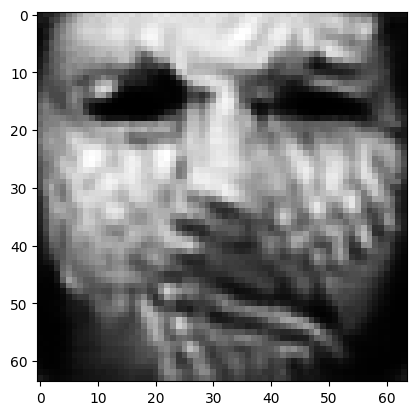

tensor([[4.1072e-04, 9.1604e-01, 2.9397e-04, 7.5060e-03, 4.2015e-04, 2.0372e-03,
         1.3910e-04, 1.3343e-03, 5.0550e-04, 1.0994e-03, 8.5094e-04, 6.4172e-03,
         4.0112e-03, 3.2763e-04, 7.3583e-04, 1.3497e-03, 9.5581e-04, 1.1679e-03,
         2.2492e-03, 9.2724e-04, 6.7863e-04, 3.9586e-05, 3.7544e-03, 3.1519e-04,
         5.5654e-04, 4.7672e-03, 8.3437e-04, 2.8204e-04, 1.5225e-03, 1.1045e-02,
         1.1913e-03, 3.1915e-03, 3.3764e-03, 1.5637e-04, 3.3194e-03, 1.2869e-02,
         6.6070e-04, 1.1666e-03, 5.6019e-04, 9.3152e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08769228309392929
tensor([[4.1002e-04, 9.1613e-01, 2.9354e-04, 7.5010e-03, 4.1955e-04, 2.0331e-03,
         1.3884e-04, 1.3325e-03, 5.0464e-04, 1.0973e-03, 8.4938e-04, 6.4077e-03,
         4.0086e-03, 3.2737e-04, 7.3449e-04, 1.3468e-03, 9.5482e-04, 1.1655e-03,
         2.2468e-03, 9.2525e-04, 6.7694e-04, 3.9514e-05, 3.7546e-03, 3.1467e-04,
         5.5608e-04, 4.7675e-03, 8.3290e-0

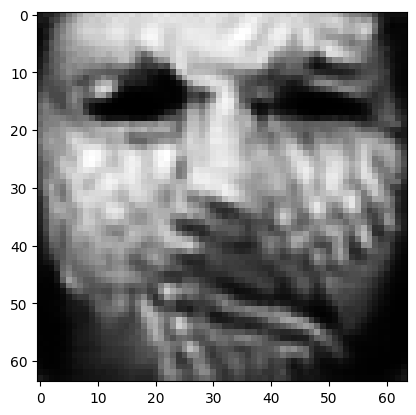

tensor([[4.0758e-04, 9.1646e-01, 2.9223e-04, 7.4794e-03, 4.1733e-04, 2.0199e-03,
         1.3784e-04, 1.3259e-03, 5.0157e-04, 1.0904e-03, 8.4366e-04, 6.3762e-03,
         3.9999e-03, 3.2646e-04, 7.2938e-04, 1.3371e-03, 9.5153e-04, 1.1562e-03,
         2.2377e-03, 9.1814e-04, 6.7098e-04, 3.9269e-05, 3.7539e-03, 3.1268e-04,
         5.5386e-04, 4.7654e-03, 8.2825e-04, 2.8083e-04, 1.5083e-03, 1.0985e-02,
         1.1895e-03, 3.1671e-03, 3.3507e-03, 1.5568e-04, 3.2933e-03, 1.2842e-02,
         6.5869e-04, 1.1598e-03, 5.5573e-04, 9.2440e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08724118769168854
tensor([[4.0724e-04, 9.1654e-01, 2.9205e-04, 7.4715e-03, 4.1692e-04, 2.0178e-03,
         1.3767e-04, 1.3249e-03, 5.0079e-04, 1.0893e-03, 8.4248e-04, 6.3700e-03,
         3.9976e-03, 3.2618e-04, 7.2843e-04, 1.3358e-03, 9.5092e-04, 1.1544e-03,
         2.2367e-03, 9.1697e-04, 6.6990e-04, 3.9230e-05, 3.7522e-03, 3.1231e-04,
         5.5310e-04, 4.7621e-03, 8.2758e-0

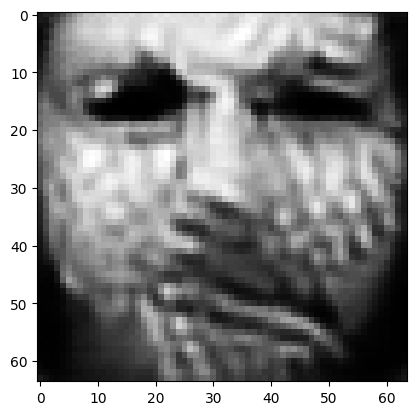

tensor([[4.0501e-04, 9.1685e-01, 2.9080e-04, 7.4513e-03, 4.1492e-04, 2.0056e-03,
         1.3675e-04, 1.3190e-03, 4.9776e-04, 1.0828e-03, 8.3711e-04, 6.3402e-03,
         3.9891e-03, 3.2527e-04, 7.2373e-04, 1.3268e-03, 9.4795e-04, 1.1457e-03,
         2.2285e-03, 9.1050e-04, 6.6428e-04, 3.9003e-05, 3.7509e-03, 3.1058e-04,
         5.5109e-04, 4.7586e-03, 8.2309e-04, 2.7981e-04, 1.4956e-03, 1.0931e-02,
         1.1874e-03, 3.1447e-03, 3.3276e-03, 1.5505e-04, 3.2695e-03, 1.2806e-02,
         6.5686e-04, 1.1533e-03, 5.5156e-04, 9.1827e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08681436628103256
tensor([[4.0458e-04, 9.1692e-01, 2.9059e-04, 7.4449e-03, 4.1451e-04, 2.0032e-03,
         1.3656e-04, 1.3180e-03, 4.9704e-04, 1.0816e-03, 8.3593e-04, 6.3340e-03,
         3.9867e-03, 3.2504e-04, 7.2273e-04, 1.3253e-03, 9.4736e-04, 1.1438e-03,
         2.2271e-03, 9.0916e-04, 6.6313e-04, 3.8961e-05, 3.7498e-03, 3.1023e-04,
         5.5045e-04, 4.7571e-03, 8.2224e-0

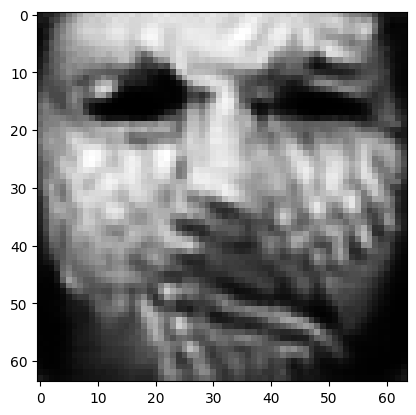

tensor([[4.0272e-04, 9.1721e-01, 2.8952e-04, 7.4258e-03, 4.1278e-04, 1.9928e-03,
         1.3577e-04, 1.3131e-03, 4.9421e-04, 1.0760e-03, 8.3101e-04, 6.3069e-03,
         3.9791e-03, 3.2415e-04, 7.1857e-04, 1.3177e-03, 9.4478e-04, 1.1361e-03,
         2.2206e-03, 9.0358e-04, 6.5811e-04, 3.8762e-05, 3.7475e-03, 3.0874e-04,
         5.4852e-04, 4.7510e-03, 8.1845e-04, 2.7889e-04, 1.4840e-03, 1.0878e-02,
         1.1854e-03, 3.1242e-03, 3.3058e-03, 1.5447e-04, 3.2477e-03, 1.2770e-02,
         6.5516e-04, 1.1472e-03, 5.4772e-04, 9.1265e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08641600608825684
tensor([[4.0201e-04, 9.1728e-01, 2.8909e-04, 7.4217e-03, 4.1225e-04, 1.9892e-03,
         1.3553e-04, 1.3111e-03, 4.9354e-04, 1.0742e-03, 8.2961e-04, 6.2989e-03,
         3.9774e-03, 3.2397e-04, 7.1734e-04, 1.3148e-03, 9.4383e-04, 1.1341e-03,
         2.2178e-03, 9.0179e-04, 6.5656e-04, 3.8695e-05, 3.7485e-03, 3.0826e-04,
         5.4827e-04, 4.7523e-03, 8.1716e-0

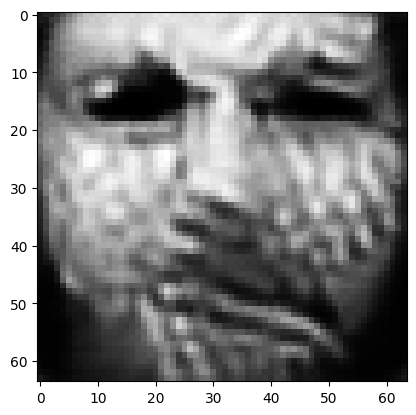

tensor([[4.0049e-04, 9.1755e-01, 2.8819e-04, 7.4014e-03, 4.1074e-04, 1.9804e-03,
         1.3486e-04, 1.3070e-03, 4.9094e-04, 1.0696e-03, 8.2533e-04, 6.2757e-03,
         3.9700e-03, 3.2311e-04, 7.1392e-04, 1.3089e-03, 9.4157e-04, 1.1274e-03,
         2.2127e-03, 8.9716e-04, 6.5232e-04, 3.8534e-05, 3.7451e-03, 3.0702e-04,
         5.4634e-04, 4.7443e-03, 8.1402e-04, 2.7797e-04, 1.4731e-03, 1.0826e-02,
         1.1835e-03, 3.1064e-03, 3.2859e-03, 1.5392e-04, 3.2279e-03, 1.2745e-02,
         6.5353e-04, 1.1416e-03, 5.4418e-04, 9.0711e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08605118095874786
tensor([[3.9999e-04, 9.1761e-01, 2.8789e-04, 7.3981e-03, 4.1032e-04, 1.9776e-03,
         1.3466e-04, 1.3057e-03, 4.9033e-04, 1.0681e-03, 8.2417e-04, 6.2688e-03,
         3.9684e-03, 3.2292e-04, 7.1291e-04, 1.3068e-03, 9.4091e-04, 1.1256e-03,
         2.2108e-03, 8.9578e-04, 6.5109e-04, 3.8482e-05, 3.7452e-03, 3.0666e-04,
         5.4603e-04, 4.7440e-03, 8.1296e-0

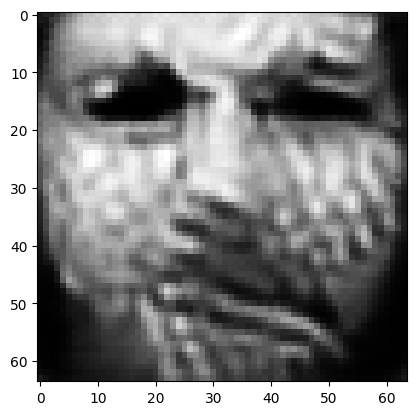

tensor([[3.9854e-04, 9.1786e-01, 2.8703e-04, 7.3784e-03, 4.0885e-04, 1.9691e-03,
         1.3405e-04, 1.3016e-03, 4.8792e-04, 1.0637e-03, 8.2014e-04, 6.2475e-03,
         3.9612e-03, 3.2210e-04, 7.0971e-04, 1.3012e-03, 9.3878e-04, 1.1193e-03,
         2.2057e-03, 8.9153e-04, 6.4724e-04, 3.8339e-05, 3.7421e-03, 3.0549e-04,
         5.4413e-04, 4.7369e-03, 8.1000e-04, 2.7712e-04, 1.4630e-03, 1.0782e-02,
         1.1817e-03, 3.0892e-03, 3.2682e-03, 1.5342e-04, 3.2090e-03, 1.2716e-02,
         6.5201e-04, 1.1364e-03, 5.4100e-04, 9.0236e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0857122614979744
tensor([[3.9795e-04, 9.1792e-01, 2.8668e-04, 7.3748e-03, 4.0840e-04, 1.9661e-03,
         1.3385e-04, 1.2999e-03, 4.8736e-04, 1.0622e-03, 8.1896e-04, 6.2409e-03,
         3.9597e-03, 3.2193e-04, 7.0870e-04, 1.2989e-03, 9.3801e-04, 1.1175e-03,
         2.2033e-03, 8.9003e-04, 6.4600e-04, 3.8284e-05, 3.7429e-03, 3.0509e-04,
         5.4387e-04, 4.7377e-03, 8.0895e-04

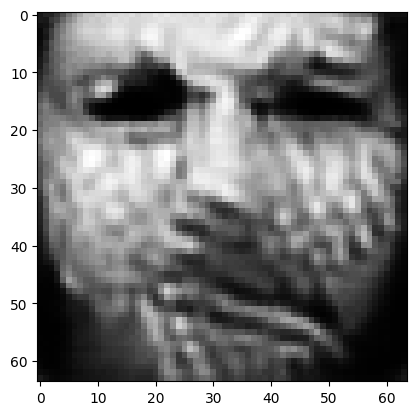

tensor([[3.9649e-04, 9.1815e-01, 2.8582e-04, 7.3580e-03, 4.0698e-04, 1.9579e-03,
         1.3325e-04, 1.2956e-03, 4.8510e-04, 1.0578e-03, 8.1502e-04, 6.2201e-03,
         3.9533e-03, 3.2116e-04, 7.0540e-04, 1.2933e-03, 9.3587e-04, 1.1113e-03,
         2.1980e-03, 8.8581e-04, 6.4220e-04, 3.8141e-05, 3.7405e-03, 3.0394e-04,
         5.4212e-04, 4.7320e-03, 8.0602e-04, 2.7621e-04, 1.4531e-03, 1.0740e-02,
         1.1800e-03, 3.0729e-03, 3.2513e-03, 1.5295e-04, 3.1908e-03, 1.2692e-02,
         6.5063e-04, 1.1314e-03, 5.3798e-04, 8.9785e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08539293706417084
tensor([[3.9630e-04, 9.1821e-01, 2.8570e-04, 7.3527e-03, 4.0673e-04, 1.9566e-03,
         1.3314e-04, 1.2951e-03, 4.8454e-04, 1.0570e-03, 8.1418e-04, 6.2159e-03,
         3.9516e-03, 3.2095e-04, 7.0479e-04, 1.2926e-03, 9.3547e-04, 1.1100e-03,
         2.1975e-03, 8.8505e-04, 6.4152e-04, 3.8118e-05, 3.7389e-03, 3.0373e-04,
         5.4154e-04, 4.7289e-03, 8.0562e-0

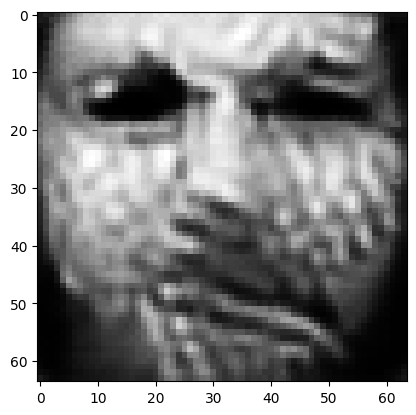

tensor([[3.9503e-04, 9.1843e-01, 2.8494e-04, 7.3351e-03, 4.0549e-04, 1.9494e-03,
         1.3261e-04, 1.2914e-03, 4.8242e-04, 1.0532e-03, 8.1060e-04, 6.1968e-03,
         3.9455e-03, 3.2021e-04, 7.0185e-04, 1.2878e-03, 9.3349e-04, 1.1045e-03,
         2.1930e-03, 8.8131e-04, 6.3813e-04, 3.7990e-05, 3.7361e-03, 3.0270e-04,
         5.3983e-04, 4.7225e-03, 8.0308e-04, 2.7554e-04, 1.4447e-03, 1.0703e-02,
         1.1782e-03, 3.0576e-03, 3.2367e-03, 1.5250e-04, 3.1754e-03, 1.2659e-02,
         6.4941e-04, 1.1268e-03, 5.3518e-04, 8.9436e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08509364724159241
tensor([[3.9449e-04, 9.1848e-01, 2.8461e-04, 7.3316e-03, 4.0507e-04, 1.9465e-03,
         1.3243e-04, 1.2898e-03, 4.8189e-04, 1.0517e-03, 8.0955e-04, 6.1907e-03,
         3.9440e-03, 3.2006e-04, 7.0094e-04, 1.2856e-03, 9.3275e-04, 1.1030e-03,
         2.1909e-03, 8.7989e-04, 6.3702e-04, 3.7940e-05, 3.7370e-03, 3.0231e-04,
         5.3960e-04, 4.7233e-03, 8.0213e-0

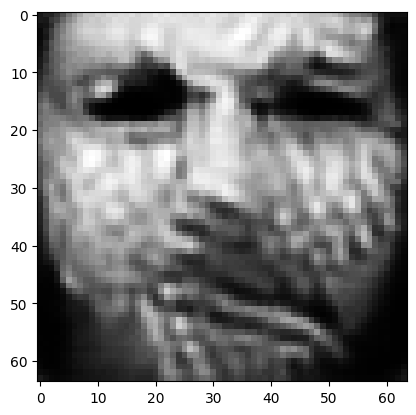

tensor([[3.9321e-04, 9.1868e-01, 2.8384e-04, 7.3148e-03, 4.0383e-04, 1.9392e-03,
         1.3192e-04, 1.2862e-03, 4.7992e-04, 1.0480e-03, 8.0619e-04, 6.1728e-03,
         3.9380e-03, 3.1936e-04, 6.9814e-04, 1.2808e-03, 9.3073e-04, 1.0977e-03,
         2.1863e-03, 8.7632e-04, 6.3381e-04, 3.7816e-05, 3.7344e-03, 3.0130e-04,
         5.3801e-04, 4.7181e-03, 7.9958e-04, 2.7473e-04, 1.4362e-03, 1.0667e-02,
         1.1766e-03, 3.0439e-03, 3.2224e-03, 1.5207e-04, 3.1596e-03, 1.2639e-02,
         6.4812e-04, 1.1224e-03, 5.3247e-04, 8.9031e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08481211960315704
tensor([[3.9276e-04, 9.1873e-01, 2.8357e-04, 7.3116e-03, 4.0346e-04, 1.9369e-03,
         1.3176e-04, 1.2849e-03, 4.7947e-04, 1.0467e-03, 8.0525e-04, 6.1675e-03,
         3.9367e-03, 3.1922e-04, 6.9734e-04, 1.2790e-03, 9.3008e-04, 1.0964e-03,
         2.1845e-03, 8.7512e-04, 6.3288e-04, 3.7772e-05, 3.7349e-03, 3.0096e-04,
         5.3774e-04, 4.7183e-03, 7.9882e-0

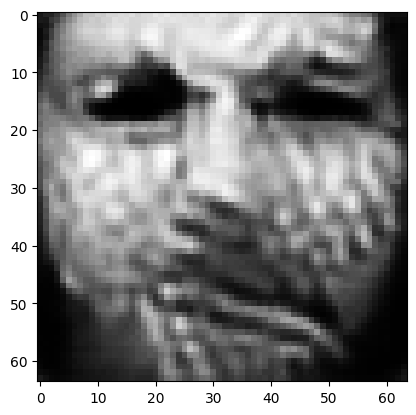

tensor([[3.9137e-04, 9.1892e-01, 2.8275e-04, 7.2960e-03, 4.0216e-04, 1.9294e-03,
         1.3124e-04, 1.2808e-03, 4.7768e-04, 1.0430e-03, 8.0202e-04, 6.1503e-03,
         3.9310e-03, 3.1858e-04, 6.9456e-04, 1.2738e-03, 9.2790e-04, 1.0914e-03,
         2.1794e-03, 8.7136e-04, 6.2977e-04, 3.7638e-05, 3.7336e-03, 2.9983e-04,
         5.3635e-04, 4.7160e-03, 7.9631e-04, 2.7394e-04, 1.4283e-03, 1.0634e-02,
         1.1751e-03, 3.0311e-03, 3.2090e-03, 1.5165e-04, 3.1457e-03, 1.2625e-02,
         6.4693e-04, 1.1184e-03, 5.2990e-04, 8.8648e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08455516397953033
tensor([[3.9122e-04, 9.1897e-01, 2.8265e-04, 7.2908e-03, 4.0193e-04, 1.9283e-03,
         1.3115e-04, 1.2803e-03, 4.7727e-04, 1.0424e-03, 8.0144e-04, 6.1477e-03,
         3.9293e-03, 3.1841e-04, 6.9421e-04, 1.2732e-03, 9.2750e-04, 1.0905e-03,
         2.1788e-03, 8.7092e-04, 6.2929e-04, 3.7623e-05, 3.7321e-03, 2.9966e-04,
         5.3587e-04, 4.7132e-03, 7.9602e-0

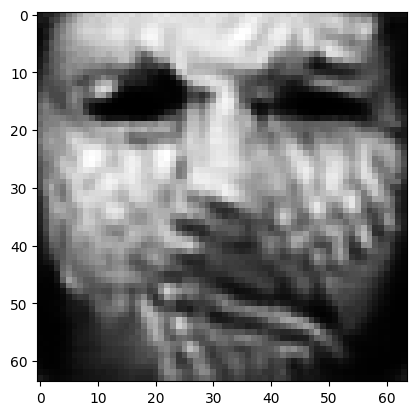

tensor([[3.9008e-04, 9.1914e-01, 2.8199e-04, 7.2766e-03, 4.0078e-04, 1.9219e-03,
         1.3069e-04, 1.2769e-03, 4.7563e-04, 1.0392e-03, 7.9856e-04, 6.1329e-03,
         3.9242e-03, 3.1783e-04, 6.9168e-04, 1.2689e-03, 9.2569e-04, 1.0859e-03,
         2.1746e-03, 8.6773e-04, 6.2651e-04, 3.7511e-05, 3.7300e-03, 2.9872e-04,
         5.3452e-04, 4.7099e-03, 7.9387e-04, 2.7332e-04, 1.4217e-03, 1.0607e-02,
         1.1738e-03, 3.0197e-03, 3.1980e-03, 1.5132e-04, 3.1328e-03, 1.2599e-02,
         6.4585e-04, 1.1147e-03, 5.2769e-04, 8.8355e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0843186303973198
tensor([[3.8971e-04, 9.1918e-01, 2.8176e-04, 7.2747e-03, 4.0044e-04, 1.9198e-03,
         1.3056e-04, 1.2759e-03, 4.7520e-04, 1.0382e-03, 7.9775e-04, 6.1278e-03,
         3.9231e-03, 3.1771e-04, 6.9092e-04, 1.2673e-03, 9.2518e-04, 1.0846e-03,
         2.1733e-03, 8.6667e-04, 6.2562e-04, 3.7472e-05, 3.7303e-03, 2.9845e-04,
         5.3436e-04, 4.7103e-03, 7.9310e-04

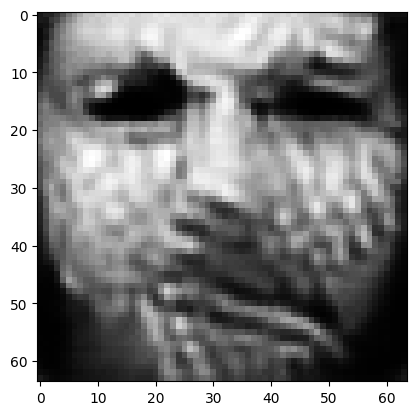

tensor([[3.8862e-04, 9.1934e-01, 2.8117e-04, 7.2610e-03, 3.9940e-04, 1.9143e-03,
         1.3014e-04, 1.2725e-03, 4.7368e-04, 1.0353e-03, 7.9498e-04, 6.1146e-03,
         3.9185e-03, 3.1717e-04, 6.8847e-04, 1.2634e-03, 9.2360e-04, 1.0802e-03,
         2.1692e-03, 8.6368e-04, 6.2312e-04, 3.7369e-05, 3.7280e-03, 2.9754e-04,
         5.3307e-04, 4.7064e-03, 7.9128e-04, 2.7269e-04, 1.4151e-03, 1.0579e-02,
         1.1726e-03, 3.0084e-03, 3.1872e-03, 1.5101e-04, 3.1201e-03, 1.2581e-02,
         6.4495e-04, 1.1111e-03, 5.2562e-04, 8.8052e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08409519493579865
tensor([[3.8818e-04, 9.1938e-01, 2.8092e-04, 7.2589e-03, 3.9907e-04, 1.9123e-03,
         1.3000e-04, 1.2713e-03, 4.7329e-04, 1.0342e-03, 7.9416e-04, 6.1097e-03,
         3.9175e-03, 3.1707e-04, 6.8767e-04, 1.2617e-03, 9.2306e-04, 1.0789e-03,
         2.1675e-03, 8.6252e-04, 6.2222e-04, 3.7328e-05, 3.7286e-03, 2.9724e-04,
         5.3294e-04, 4.7075e-03, 7.9053e-0

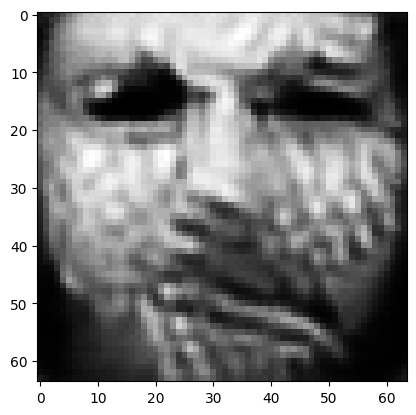

tensor([[3.8713e-04, 9.1954e-01, 2.8033e-04, 7.2464e-03, 3.9811e-04, 1.9071e-03,
         1.2960e-04, 1.2682e-03, 4.7185e-04, 1.0315e-03, 7.9151e-04, 6.0971e-03,
         3.9129e-03, 3.1657e-04, 6.8538e-04, 1.2580e-03, 9.2159e-04, 1.0747e-03,
         2.1635e-03, 8.5966e-04, 6.1984e-04, 3.7232e-05, 3.7263e-03, 2.9641e-04,
         5.3175e-04, 4.7038e-03, 7.8874e-04, 2.7206e-04, 1.4087e-03, 1.0553e-02,
         1.1713e-03, 2.9978e-03, 3.1764e-03, 1.5071e-04, 3.1077e-03, 1.2565e-02,
         6.4419e-04, 1.1077e-03, 5.2351e-04, 8.7761e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08388310670852661
tensor([[3.8679e-04, 9.1958e-01, 2.8015e-04, 7.2442e-03, 3.9784e-04, 1.9056e-03,
         1.2948e-04, 1.2673e-03, 4.7148e-04, 1.0307e-03, 7.9080e-04, 6.0934e-03,
         3.9119e-03, 3.1645e-04, 6.8471e-04, 1.2568e-03, 9.2124e-04, 1.0735e-03,
         2.1623e-03, 8.5883e-04, 6.1915e-04, 3.7203e-05, 3.7262e-03, 2.9619e-04,
         5.3156e-04, 4.7038e-03, 7.8811e-0

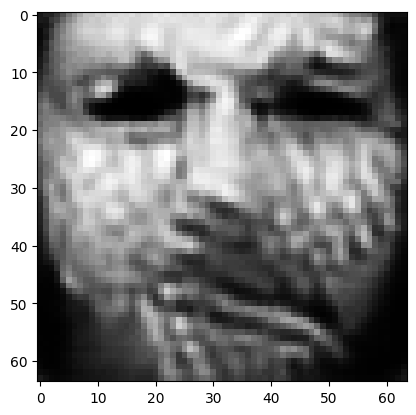

tensor([[3.8606e-04, 9.1972e-01, 2.7972e-04, 7.2355e-03, 3.9709e-04, 1.9019e-03,
         1.2915e-04, 1.2652e-03, 4.7016e-04, 1.0284e-03, 7.8852e-04, 6.0820e-03,
         3.9083e-03, 3.1600e-04, 6.8286e-04, 1.2542e-03, 9.2028e-04, 1.0700e-03,
         2.1595e-03, 8.5655e-04, 6.1717e-04, 3.7125e-05, 3.7237e-03, 2.9561e-04,
         5.3048e-04, 4.6972e-03, 7.8669e-04, 2.7149e-04, 1.4032e-03, 1.0528e-02,
         1.1698e-03, 2.9881e-03, 3.1666e-03, 1.5041e-04, 3.0967e-03, 1.2542e-02,
         6.4340e-04, 1.1047e-03, 5.2174e-04, 8.7518e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08368731290102005
tensor([[3.8610e-04, 9.1975e-01, 2.7975e-04, 7.2332e-03, 3.9702e-04, 1.9021e-03,
         1.2912e-04, 1.2653e-03, 4.6984e-04, 1.0283e-03, 7.8810e-04, 6.0804e-03,
         3.9077e-03, 3.1585e-04, 6.8260e-04, 1.2545e-03, 9.2033e-04, 1.0694e-03,
         2.1599e-03, 8.5647e-04, 6.1695e-04, 3.7123e-05, 3.7218e-03, 2.9560e-04,
         5.3007e-04, 4.6932e-03, 7.8664e-0

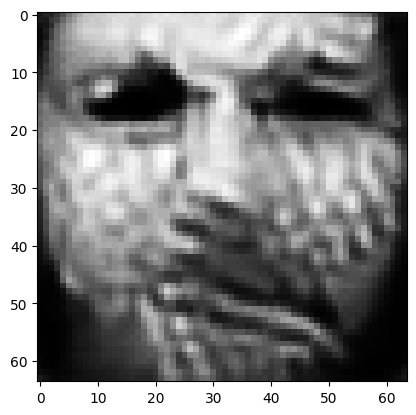

tensor([[3.8550e-04, 9.1989e-01, 2.7937e-04, 7.2272e-03, 3.9643e-04, 1.8992e-03,
         1.2883e-04, 1.2636e-03, 4.6860e-04, 1.0261e-03, 7.8595e-04, 6.0692e-03,
         3.9048e-03, 3.1542e-04, 6.8092e-04, 1.2523e-03, 9.1958e-04, 1.0662e-03,
         2.1575e-03, 8.5454e-04, 6.1515e-04, 3.7054e-05, 3.7192e-03, 2.9517e-04,
         5.2914e-04, 4.6852e-03, 7.8530e-04, 2.7102e-04, 1.3986e-03, 1.0504e-02,
         1.1679e-03, 2.9791e-03, 3.1581e-03, 1.5013e-04, 3.0877e-03, 1.2510e-02,
         6.4257e-04, 1.1019e-03, 5.2038e-04, 8.7351e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08350386470556259
tensor([[3.8543e-04, 9.1992e-01, 2.7933e-04, 7.2243e-03, 3.9631e-04, 1.8987e-03,
         1.2878e-04, 1.2633e-03, 4.6828e-04, 1.0258e-03, 7.8551e-04, 6.0674e-03,
         3.9039e-03, 3.1529e-04, 6.8064e-04, 1.2521e-03, 9.1948e-04, 1.0655e-03,
         2.1573e-03, 8.5429e-04, 6.1482e-04, 3.7047e-05, 3.7179e-03, 2.9511e-04,
         5.2882e-04, 4.6825e-03, 7.8509e-0

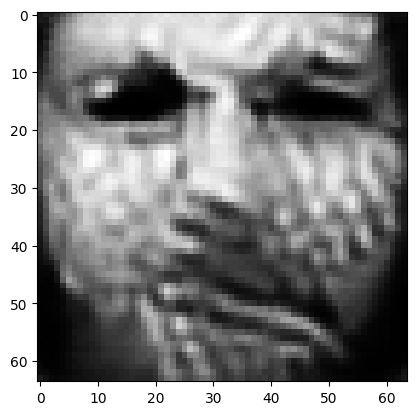

tensor([[3.8482e-04, 9.2005e-01, 2.7899e-04, 7.2184e-03, 3.9573e-04, 1.8959e-03,
         1.2848e-04, 1.2616e-03, 4.6707e-04, 1.0236e-03, 7.8341e-04, 6.0562e-03,
         3.9012e-03, 3.1491e-04, 6.7881e-04, 1.2500e-03, 9.1884e-04, 1.0623e-03,
         2.1547e-03, 8.5228e-04, 6.1301e-04, 3.6977e-05, 3.7159e-03, 2.9469e-04,
         5.2788e-04, 4.6762e-03, 7.8375e-04, 2.7055e-04, 1.3939e-03, 1.0481e-02,
         1.1662e-03, 2.9700e-03, 3.1493e-03, 1.4988e-04, 3.0783e-03, 1.2481e-02,
         6.4200e-04, 1.0991e-03, 5.1887e-04, 8.7179e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08332488685846329
tensor([[3.8455e-04, 9.2008e-01, 2.7882e-04, 7.2179e-03, 3.9555e-04, 1.8947e-03,
         1.2838e-04, 1.2609e-03, 4.6679e-04, 1.0228e-03, 7.8279e-04, 6.0524e-03,
         3.9007e-03, 3.1485e-04, 6.7824e-04, 1.2490e-03, 9.1857e-04, 1.0614e-03,
         2.1535e-03, 8.5152e-04, 6.1239e-04, 3.6949e-05, 3.7163e-03, 2.9452e-04,
         5.2778e-04, 4.6760e-03, 7.8325e-0

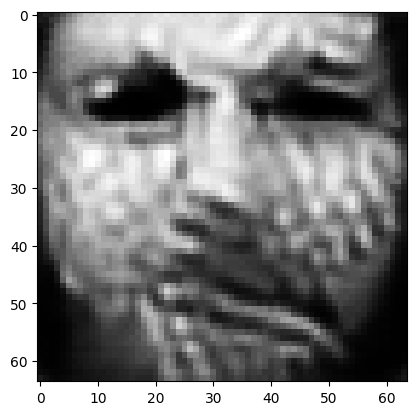

tensor([[3.8403e-04, 9.2021e-01, 2.7855e-04, 7.2104e-03, 3.9502e-04, 1.8922e-03,
         1.2811e-04, 1.2593e-03, 4.6562e-04, 1.0209e-03, 7.8087e-04, 6.0426e-03,
         3.8980e-03, 3.1449e-04, 6.7661e-04, 1.2472e-03, 9.1801e-04, 1.0584e-03,
         2.1513e-03, 8.4979e-04, 6.1078e-04, 3.6891e-05, 3.7141e-03, 2.9414e-04,
         5.2678e-04, 4.6694e-03, 7.8216e-04, 2.7007e-04, 1.3891e-03, 1.0458e-02,
         1.1647e-03, 2.9612e-03, 3.1406e-03, 1.4963e-04, 3.0691e-03, 1.2456e-02,
         6.4154e-04, 1.0964e-03, 5.1731e-04, 8.6996e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08315366506576538
tensor([[3.8375e-04, 9.2024e-01, 2.7838e-04, 7.2096e-03, 3.9483e-04, 1.8910e-03,
         1.2800e-04, 1.2586e-03, 4.6534e-04, 1.0201e-03, 7.8027e-04, 6.0391e-03,
         3.8975e-03, 3.1442e-04, 6.7604e-04, 1.2462e-03, 9.1771e-04, 1.0575e-03,
         2.1501e-03, 8.4904e-04, 6.1018e-04, 3.6863e-05, 3.7146e-03, 2.9398e-04,
         5.2668e-04, 4.6694e-03, 7.8165e-0

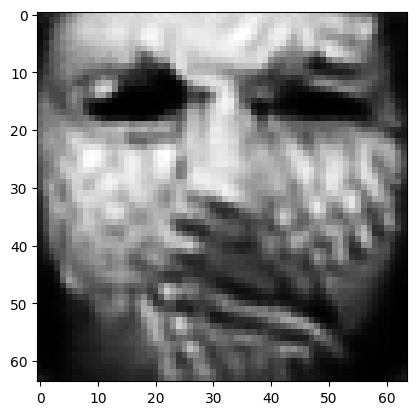

tensor([[3.8317e-04, 9.2036e-01, 2.7806e-04, 7.2038e-03, 3.9429e-04, 1.8882e-03,
         1.2772e-04, 1.2569e-03, 4.6425e-04, 1.0180e-03, 7.7837e-04, 6.0287e-03,
         3.8950e-03, 3.1408e-04, 6.7440e-04, 1.2442e-03, 9.1708e-04, 1.0547e-03,
         2.1476e-03, 8.4717e-04, 6.0850e-04, 3.6797e-05, 3.7133e-03, 2.9357e-04,
         5.2584e-04, 4.6641e-03, 7.8045e-04, 2.6957e-04, 1.3844e-03, 1.0435e-02,
         1.1632e-03, 2.9528e-03, 3.1318e-03, 1.4939e-04, 3.0603e-03, 1.2436e-02,
         6.4105e-04, 1.0939e-03, 5.1580e-04, 8.6799e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08299019932746887
tensor([[3.8322e-04, 9.2039e-01, 2.7810e-04, 7.2021e-03, 3.9428e-04, 1.8886e-03,
         1.2770e-04, 1.2570e-03, 4.6393e-04, 1.0180e-03, 7.7803e-04, 6.0277e-03,
         3.8945e-03, 3.1396e-04, 6.7408e-04, 1.2446e-03, 9.1722e-04, 1.0540e-03,
         2.1479e-03, 8.4712e-04, 6.0829e-04, 3.6797e-05, 3.7114e-03, 2.9363e-04,
         5.2545e-04, 4.6608e-03, 7.8041e-0

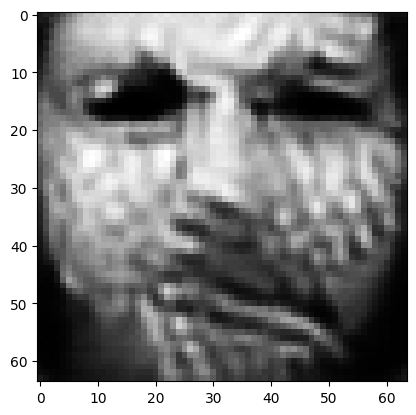

tensor([[3.8317e-04, 9.2051e-01, 2.7804e-04, 7.1968e-03, 3.9407e-04, 1.8886e-03,
         1.2754e-04, 1.2569e-03, 4.6259e-04, 1.0170e-03, 7.7644e-04, 6.0206e-03,
         3.8922e-03, 3.1350e-04, 6.7252e-04, 1.2450e-03, 9.1732e-04, 1.0510e-03,
         2.1479e-03, 8.4631e-04, 6.0696e-04, 3.6770e-05, 3.7057e-03, 2.9370e-04,
         5.2428e-04, 4.6508e-03, 7.7961e-04, 2.6923e-04, 1.3815e-03, 1.0411e-02,
         1.1612e-03, 2.9452e-03, 3.1249e-03, 1.4913e-04, 3.0519e-03, 1.2393e-02,
         6.4077e-04, 1.0916e-03, 5.1465e-04, 8.6733e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08282452076673508
tensor([[3.8315e-04, 9.2054e-01, 2.7801e-04, 7.1956e-03, 3.9402e-04, 1.8885e-03,
         1.2750e-04, 1.2569e-03, 4.6227e-04, 1.0167e-03, 7.7607e-04, 6.0187e-03,
         3.8915e-03, 3.1339e-04, 6.7218e-04, 1.2450e-03, 9.1730e-04, 1.0503e-03,
         2.1478e-03, 8.4612e-04, 6.0663e-04, 3.6764e-05, 3.7043e-03, 2.9372e-04,
         5.2402e-04, 4.6484e-03, 7.7937e-0

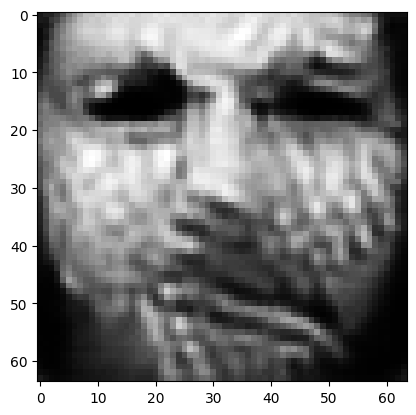

tensor([[3.8320e-04, 9.2066e-01, 2.7801e-04, 7.1900e-03, 3.9388e-04, 1.8888e-03,
         1.2738e-04, 1.2570e-03, 4.6102e-04, 1.0160e-03, 7.7467e-04, 6.0125e-03,
         3.8893e-03, 3.1294e-04, 6.7089e-04, 1.2456e-03, 9.1750e-04, 1.0476e-03,
         2.1481e-03, 8.4559e-04, 6.0553e-04, 3.6748e-05, 3.6984e-03, 2.9385e-04,
         5.2290e-04, 4.6375e-03, 7.7877e-04, 2.6889e-04, 1.3787e-03, 1.0389e-02,
         1.1591e-03, 2.9384e-03, 3.1187e-03, 1.4889e-04, 3.0438e-03, 1.2353e-02,
         6.4038e-04, 1.0894e-03, 5.1368e-04, 8.6660e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08266747742891312
tensor([[3.8321e-04, 9.2069e-01, 2.7800e-04, 7.1893e-03, 3.9384e-04, 1.8889e-03,
         1.2735e-04, 1.2571e-03, 4.6071e-04, 1.0157e-03, 7.7430e-04, 6.0106e-03,
         3.8888e-03, 3.1282e-04, 6.7053e-04, 1.2458e-03, 9.1753e-04, 1.0469e-03,
         2.1483e-03, 8.4542e-04, 6.0521e-04, 3.6742e-05, 3.6969e-03, 2.9388e-04,
         5.2265e-04, 4.6349e-03, 7.7855e-0

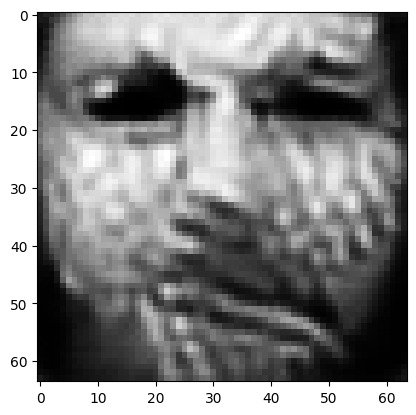

tensor([[3.8327e-04, 9.2080e-01, 2.7800e-04, 7.1837e-03, 3.9373e-04, 1.8893e-03,
         1.2724e-04, 1.2573e-03, 4.5949e-04, 1.0151e-03, 7.7296e-04, 6.0048e-03,
         3.8865e-03, 3.1237e-04, 6.6931e-04, 1.2465e-03, 9.1771e-04, 1.0444e-03,
         2.1486e-03, 8.4498e-04, 6.0414e-04, 3.6728e-05, 3.6908e-03, 2.9403e-04,
         5.2155e-04, 4.6241e-03, 7.7794e-04, 2.6856e-04, 1.3761e-03, 1.0367e-02,
         1.1570e-03, 2.9319e-03, 3.1129e-03, 1.4865e-04, 3.0361e-03, 1.2314e-02,
         6.3997e-04, 1.0873e-03, 5.1277e-04, 8.6594e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08251502364873886
tensor([[3.8329e-04, 9.2083e-01, 2.7801e-04, 7.1831e-03, 3.9370e-04, 1.8893e-03,
         1.2721e-04, 1.2574e-03, 4.5918e-04, 1.0149e-03, 7.7261e-04, 6.0030e-03,
         3.8860e-03, 3.1226e-04, 6.6896e-04, 1.2466e-03, 9.1778e-04, 1.0437e-03,
         2.1487e-03, 8.4480e-04, 6.0384e-04, 3.6723e-05, 3.6895e-03, 2.9406e-04,
         5.2131e-04, 4.6216e-03, 7.7776e-0

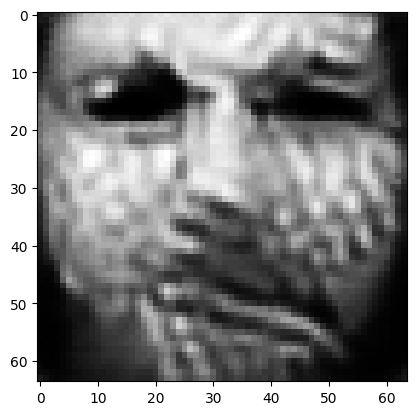

tensor([[3.8325e-04, 9.2093e-01, 2.7798e-04, 7.1776e-03, 3.9355e-04, 1.8894e-03,
         1.2707e-04, 1.2573e-03, 4.5801e-04, 1.0142e-03, 7.7123e-04, 5.9971e-03,
         3.8839e-03, 3.1183e-04, 6.6762e-04, 1.2470e-03, 9.1791e-04, 1.0410e-03,
         2.1487e-03, 8.4414e-04, 6.0272e-04, 3.6704e-05, 3.6842e-03, 2.9412e-04,
         5.2028e-04, 4.6127e-03, 7.7709e-04, 2.6823e-04, 1.3736e-03, 1.0347e-02,
         1.1552e-03, 2.9250e-03, 3.1068e-03, 1.4843e-04, 3.0286e-03, 1.2276e-02,
         6.3969e-04, 1.0852e-03, 5.1185e-04, 8.6533e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08236902207136154
tensor([[3.8325e-04, 9.2096e-01, 2.7796e-04, 7.1765e-03, 3.9351e-04, 1.8893e-03,
         1.2704e-04, 1.2573e-03, 4.5773e-04, 1.0140e-03, 7.7090e-04, 5.9956e-03,
         3.8833e-03, 3.1173e-04, 6.6733e-04, 1.2471e-03, 9.1791e-04, 1.0404e-03,
         2.1487e-03, 8.4400e-04, 6.0243e-04, 3.6700e-05, 3.6828e-03, 2.9414e-04,
         5.2005e-04, 4.6104e-03, 7.7689e-0

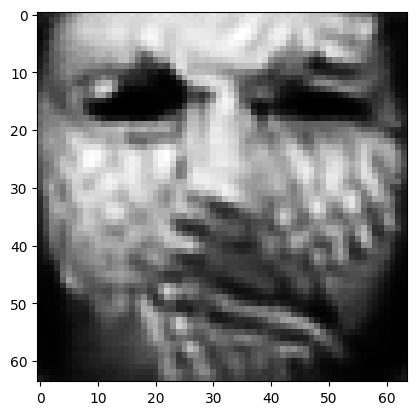

tensor([[3.8325e-04, 9.2106e-01, 2.7796e-04, 7.1711e-03, 3.9337e-04, 1.8895e-03,
         1.2692e-04, 1.2573e-03, 4.5662e-04, 1.0134e-03, 7.6962e-04, 5.9903e-03,
         3.8812e-03, 3.1133e-04, 6.6613e-04, 1.2476e-03, 9.1805e-04, 1.0379e-03,
         2.1488e-03, 8.4349e-04, 6.0141e-04, 3.6686e-05, 3.6776e-03, 2.9423e-04,
         5.1905e-04, 4.6015e-03, 7.7630e-04, 2.6792e-04, 1.3712e-03, 1.0329e-02,
         1.1534e-03, 2.9188e-03, 3.1014e-03, 1.4823e-04, 3.0213e-03, 1.2241e-02,
         6.3940e-04, 1.0833e-03, 5.1098e-04, 8.6475e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08223067969083786
tensor([[3.8311e-04, 9.2108e-01, 2.7789e-04, 7.1699e-03, 3.9326e-04, 1.8889e-03,
         1.2686e-04, 1.2569e-03, 4.5635e-04, 1.0130e-03, 7.6918e-04, 5.9881e-03,
         3.8806e-03, 3.1125e-04, 6.6566e-04, 1.2472e-03, 9.1795e-04, 1.0371e-03,
         2.1482e-03, 8.4304e-04, 6.0098e-04, 3.6671e-05, 3.6772e-03, 2.9415e-04,
         5.1889e-04, 4.6011e-03, 7.7596e-0

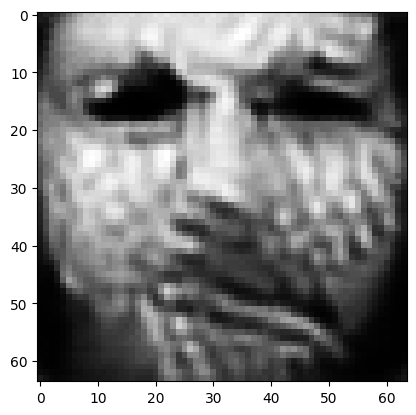

tensor([[3.8300e-04, 9.2118e-01, 2.7780e-04, 7.1658e-03, 3.9307e-04, 1.8885e-03,
         1.2671e-04, 1.2566e-03, 4.5532e-04, 1.0122e-03, 7.6787e-04, 5.9820e-03,
         3.8788e-03, 3.1089e-04, 6.6441e-04, 1.2471e-03, 9.1796e-04, 1.0347e-03,
         2.1477e-03, 8.4229e-04, 5.9985e-04, 3.6645e-05, 3.6731e-03, 2.9418e-04,
         5.1808e-04, 4.5939e-03, 7.7518e-04, 2.6757e-04, 1.3684e-03, 1.0310e-02,
         1.1519e-03, 2.9127e-03, 3.0954e-03, 1.4803e-04, 3.0142e-03, 1.2214e-02,
         6.3913e-04, 1.0814e-03, 5.1005e-04, 8.6379e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08209913223981857
tensor([[3.8301e-04, 9.2120e-01, 2.7781e-04, 7.1651e-03, 3.9305e-04, 1.8887e-03,
         1.2669e-04, 1.2566e-03, 4.5508e-04, 1.0120e-03, 7.6757e-04, 5.9808e-03,
         3.8785e-03, 3.1080e-04, 6.6411e-04, 1.2473e-03, 9.1804e-04, 1.0342e-03,
         2.1478e-03, 8.4218e-04, 5.9961e-04, 3.6641e-05, 3.6719e-03, 2.9420e-04,
         5.1786e-04, 4.5917e-03, 7.7507e-0

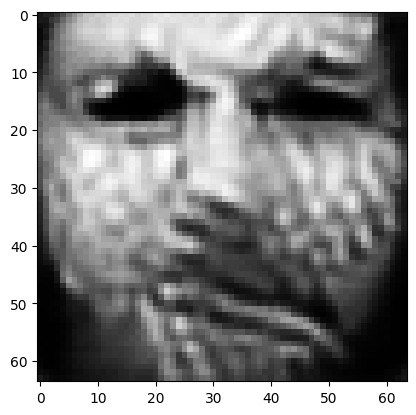

tensor([[3.8271e-04, 9.2129e-01, 2.7762e-04, 7.1592e-03, 3.9279e-04, 1.8872e-03,
         1.2652e-04, 1.2559e-03, 4.5413e-04, 1.0108e-03, 7.6631e-04, 5.9735e-03,
         3.8759e-03, 3.1051e-04, 6.6286e-04, 1.2465e-03, 9.1769e-04, 1.0320e-03,
         2.1467e-03, 8.4098e-04, 5.9838e-04, 3.6600e-05, 3.6695e-03, 2.9406e-04,
         5.1711e-04, 4.5881e-03, 7.7420e-04, 2.6731e-04, 1.3657e-03, 1.0291e-02,
         1.1506e-03, 2.9072e-03, 3.0899e-03, 1.4781e-04, 3.0080e-03, 1.2192e-02,
         6.3895e-04, 1.0797e-03, 5.0900e-04, 8.6279e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08197756111621857
tensor([[3.8274e-04, 9.2131e-01, 2.7763e-04, 7.1569e-03, 3.9277e-04, 1.8873e-03,
         1.2650e-04, 1.2559e-03, 4.5390e-04, 1.0106e-03, 7.6608e-04, 5.9726e-03,
         3.8751e-03, 3.1042e-04, 6.6270e-04, 1.2467e-03, 9.1768e-04, 1.0317e-03,
         2.1468e-03, 8.4092e-04, 5.9824e-04, 3.6600e-05, 3.6682e-03, 2.9407e-04,
         5.1684e-04, 4.5861e-03, 7.7416e-0

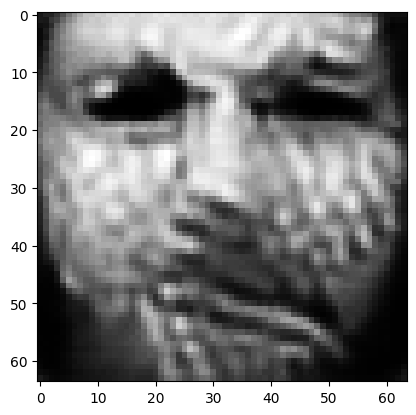

tensor([[3.8242e-04, 9.2140e-01, 2.7742e-04, 7.1523e-03, 3.9250e-04, 1.8858e-03,
         1.2633e-04, 1.2551e-03, 4.5299e-04, 1.0094e-03, 7.6485e-04, 5.9657e-03,
         3.8727e-03, 3.1015e-04, 6.6143e-04, 1.2458e-03, 9.1733e-04, 1.0295e-03,
         2.1455e-03, 8.3969e-04, 5.9700e-04, 3.6558e-05, 3.6661e-03, 2.9392e-04,
         5.1619e-04, 4.5831e-03, 7.7325e-04, 2.6706e-04, 1.3631e-03, 1.0274e-02,
         1.1495e-03, 2.9021e-03, 3.0848e-03, 1.4762e-04, 3.0021e-03, 1.2172e-02,
         6.3880e-04, 1.0781e-03, 5.0796e-04, 8.6180e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08186322450637817
tensor([[3.8238e-04, 9.2142e-01, 2.7740e-04, 7.1513e-03, 3.9245e-04, 1.8857e-03,
         1.2629e-04, 1.2550e-03, 4.5278e-04, 1.0091e-03, 7.6456e-04, 5.9641e-03,
         3.8723e-03, 3.1007e-04, 6.6114e-04, 1.2457e-03, 9.1729e-04, 1.0290e-03,
         2.1454e-03, 8.3945e-04, 5.9675e-04, 3.6549e-05, 3.6654e-03, 2.9391e-04,
         5.1601e-04, 4.5819e-03, 7.7310e-0

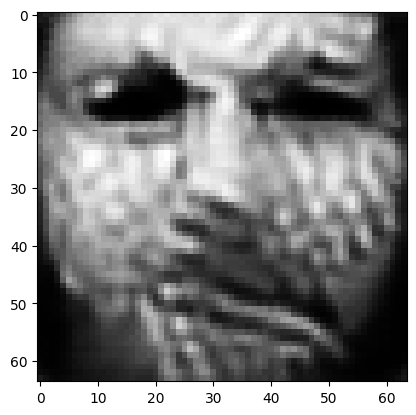

tensor([[3.8223e-04, 9.2150e-01, 2.7728e-04, 7.1454e-03, 3.9228e-04, 1.8849e-03,
         1.2617e-04, 1.2546e-03, 4.5191e-04, 1.0083e-03, 7.6352e-04, 5.9588e-03,
         3.8698e-03, 3.0977e-04, 6.6015e-04, 1.2455e-03, 9.1707e-04, 1.0272e-03,
         2.1448e-03, 8.3865e-04, 5.9579e-04, 3.6525e-05, 3.6621e-03, 2.9385e-04,
         5.1526e-04, 4.5770e-03, 7.7250e-04, 2.6684e-04, 1.3608e-03, 1.0259e-02,
         1.1483e-03, 2.8974e-03, 3.0801e-03, 1.4743e-04, 2.9966e-03, 1.2150e-02,
         6.3866e-04, 1.0766e-03, 5.0701e-04, 8.6105e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08175414800643921
tensor([[3.8216e-04, 9.2152e-01, 2.7723e-04, 7.1441e-03, 3.9221e-04, 1.8846e-03,
         1.2613e-04, 1.2544e-03, 4.5169e-04, 1.0080e-03, 7.6324e-04, 5.9572e-03,
         3.8692e-03, 3.0970e-04, 6.5986e-04, 1.2454e-03, 9.1699e-04, 1.0267e-03,
         2.1446e-03, 8.3839e-04, 5.9551e-04, 3.6517e-05, 3.6615e-03, 2.9383e-04,
         5.1510e-04, 4.5762e-03, 7.7228e-0

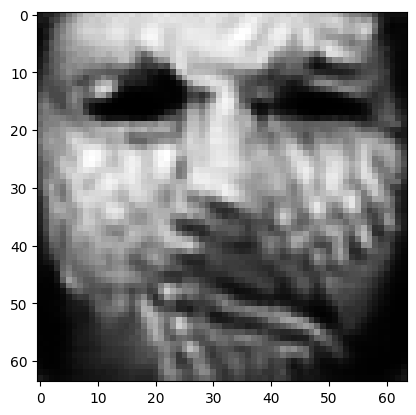

tensor([[3.8199e-04, 9.2160e-01, 2.7711e-04, 7.1393e-03, 3.9204e-04, 1.8838e-03,
         1.2600e-04, 1.2540e-03, 4.5083e-04, 1.0071e-03, 7.6221e-04, 5.9515e-03,
         3.8669e-03, 3.0943e-04, 6.5884e-04, 1.2451e-03, 9.1680e-04, 1.0249e-03,
         2.1440e-03, 8.3751e-04, 5.9453e-04, 3.6489e-05, 3.6588e-03, 2.9378e-04,
         5.1444e-04, 4.5721e-03, 7.7161e-04, 2.6661e-04, 1.3585e-03, 1.0243e-02,
         1.1471e-03, 2.8929e-03, 3.0753e-03, 1.4725e-04, 2.9912e-03, 1.2132e-02,
         6.3854e-04, 1.0752e-03, 5.0606e-04, 8.6012e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08164902031421661
tensor([[3.8195e-04, 9.2161e-01, 2.7708e-04, 7.1382e-03, 3.9200e-04, 1.8836e-03,
         1.2597e-04, 1.2539e-03, 4.5062e-04, 1.0069e-03, 7.6195e-04, 5.9501e-03,
         3.8664e-03, 3.0936e-04, 6.5858e-04, 1.2450e-03, 9.1678e-04, 1.0244e-03,
         2.1439e-03, 8.3731e-04, 5.9428e-04, 3.6482e-05, 3.6581e-03, 2.9378e-04,
         5.1428e-04, 4.5711e-03, 7.7144e-0

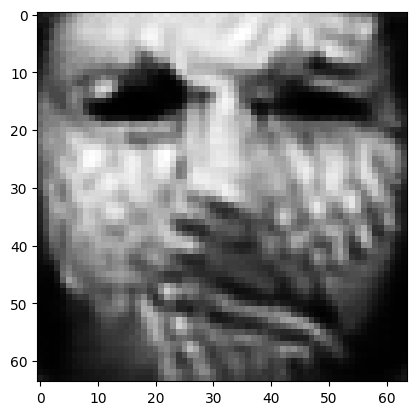

tensor([[3.8189e-04, 9.2169e-01, 2.7701e-04, 7.1332e-03, 3.9187e-04, 1.8833e-03,
         1.2586e-04, 1.2537e-03, 4.4976e-04, 1.0061e-03, 7.6100e-04, 5.9448e-03,
         3.8641e-03, 3.0908e-04, 6.5764e-04, 1.2451e-03, 9.1671e-04, 1.0227e-03,
         2.1437e-03, 8.3660e-04, 5.9337e-04, 3.6459e-05, 3.6550e-03, 2.9380e-04,
         5.1361e-04, 4.5664e-03, 7.7089e-04, 2.6641e-04, 1.3564e-03, 1.0227e-02,
         1.1459e-03, 2.8886e-03, 3.0709e-03, 1.4707e-04, 2.9860e-03, 1.2112e-02,
         6.3843e-04, 1.0738e-03, 5.0516e-04, 8.5935e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08154761046171188
tensor([[3.8191e-04, 9.2171e-01, 2.7701e-04, 7.1317e-03, 3.9185e-04, 1.8833e-03,
         1.2584e-04, 1.2537e-03, 4.4955e-04, 1.0059e-03, 7.6078e-04, 5.9437e-03,
         3.8636e-03, 3.0901e-04, 6.5745e-04, 1.2452e-03, 9.1672e-04, 1.0223e-03,
         2.1438e-03, 8.3651e-04, 5.9319e-04, 3.6457e-05, 3.6541e-03, 2.9382e-04,
         5.1343e-04, 4.5649e-03, 7.7080e-0

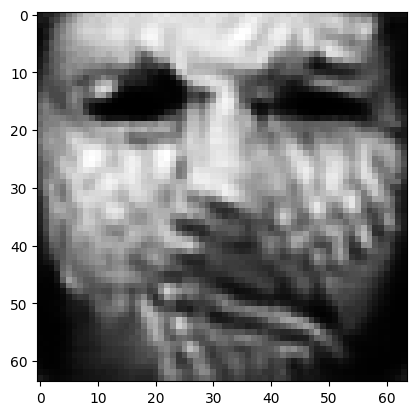

tensor([[3.8188e-04, 9.2178e-01, 2.7696e-04, 7.1268e-03, 3.9174e-04, 1.8831e-03,
         1.2575e-04, 1.2536e-03, 4.4873e-04, 1.0052e-03, 7.5989e-04, 5.9388e-03,
         3.8615e-03, 3.0873e-04, 6.5656e-04, 1.2453e-03, 9.1670e-04, 1.0207e-03,
         2.1438e-03, 8.3589e-04, 5.9234e-04, 3.6438e-05, 3.6510e-03, 2.9386e-04,
         5.1279e-04, 4.5602e-03, 7.7029e-04, 2.6624e-04, 1.3545e-03, 1.0213e-02,
         1.1449e-03, 2.8846e-03, 3.0671e-03, 1.4691e-04, 2.9811e-03, 1.2091e-02,
         6.3835e-04, 1.0725e-03, 5.0436e-04, 8.5873e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08145058900117874
tensor([[3.8186e-04, 9.2180e-01, 2.7694e-04, 7.1259e-03, 3.9171e-04, 1.8830e-03,
         1.2572e-04, 1.2535e-03, 4.4853e-04, 1.0050e-03, 7.5967e-04, 5.9375e-03,
         3.8610e-03, 3.0867e-04, 6.5633e-04, 1.2453e-03, 9.1669e-04, 1.0203e-03,
         2.1438e-03, 8.3571e-04, 5.9211e-04, 3.6432e-05, 3.6503e-03, 2.9387e-04,
         5.1264e-04, 4.5593e-03, 7.7014e-0

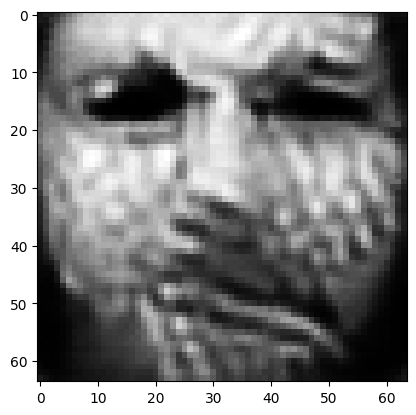

tensor([[3.8184e-04, 9.2186e-01, 2.7690e-04, 7.1214e-03, 3.9161e-04, 1.8828e-03,
         1.2563e-04, 1.2534e-03, 4.4776e-04, 1.0044e-03, 7.5882e-04, 5.9331e-03,
         3.8590e-03, 3.0840e-04, 6.5550e-04, 1.2455e-03, 9.1669e-04, 1.0187e-03,
         2.1438e-03, 8.3516e-04, 5.9133e-04, 3.6416e-05, 3.6472e-03, 2.9392e-04,
         5.1202e-04, 4.5547e-03, 7.6965e-04, 2.6607e-04, 1.3527e-03, 1.0199e-02,
         1.1439e-03, 2.8807e-03, 3.0632e-03, 1.4675e-04, 2.9764e-03, 1.2071e-02,
         6.3825e-04, 1.0713e-03, 5.0359e-04, 8.5809e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08135861158370972
tensor([[3.8181e-04, 9.2188e-01, 2.7688e-04, 7.1205e-03, 3.9157e-04, 1.8827e-03,
         1.2560e-04, 1.2533e-03, 4.4757e-04, 1.0042e-03, 7.5860e-04, 5.9319e-03,
         3.8585e-03, 3.0834e-04, 6.5528e-04, 1.2455e-03, 9.1667e-04, 1.0183e-03,
         2.1438e-03, 8.3497e-04, 5.9111e-04, 3.6410e-05, 3.6466e-03, 2.9392e-04,
         5.1189e-04, 4.5538e-03, 7.6950e-0

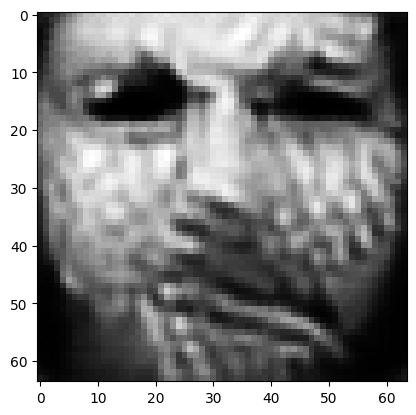

tensor([[3.8174e-04, 9.2194e-01, 2.7682e-04, 7.1164e-03, 3.9144e-04, 1.8823e-03,
         1.2550e-04, 1.2531e-03, 4.4684e-04, 1.0035e-03, 7.5775e-04, 5.9274e-03,
         3.8566e-03, 3.0809e-04, 6.5442e-04, 1.2455e-03, 9.1662e-04, 1.0168e-03,
         2.1436e-03, 8.3432e-04, 5.9030e-04, 3.6389e-05, 3.6441e-03, 2.9393e-04,
         5.1132e-04, 4.5501e-03, 7.6897e-04, 2.6591e-04, 1.3508e-03, 1.0185e-02,
         1.1431e-03, 2.8768e-03, 3.0592e-03, 1.4660e-04, 2.9720e-03, 1.2055e-02,
         6.3816e-04, 1.0701e-03, 5.0283e-04, 8.5739e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0812714546918869
tensor([[3.8172e-04, 9.2196e-01, 2.7680e-04, 7.1156e-03, 3.9140e-04, 1.8822e-03,
         1.2547e-04, 1.2531e-03, 4.4666e-04, 1.0033e-03, 7.5754e-04, 5.9262e-03,
         3.8561e-03, 3.0803e-04, 6.5422e-04, 1.2454e-03, 9.1660e-04, 1.0164e-03,
         2.1436e-03, 8.3412e-04, 5.9010e-04, 3.6384e-05, 3.6435e-03, 2.9393e-04,
         5.1119e-04, 4.5493e-03, 7.6884e-04

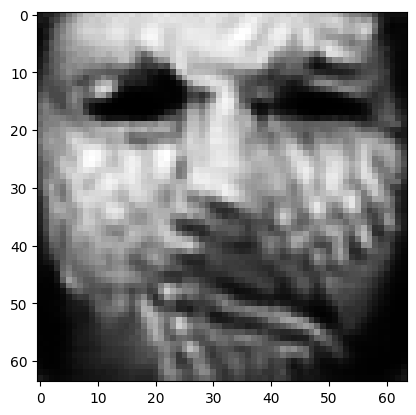

tensor([[3.8166e-04, 9.2202e-01, 2.7674e-04, 7.1114e-03, 3.9128e-04, 1.8818e-03,
         1.2538e-04, 1.2529e-03, 4.4597e-04, 1.0027e-03, 7.5675e-04, 5.9221e-03,
         3.8543e-03, 3.0780e-04, 6.5348e-04, 1.2454e-03, 9.1653e-04, 1.0150e-03,
         2.1435e-03, 8.3354e-04, 5.8935e-04, 3.6366e-05, 3.6411e-03, 2.9395e-04,
         5.1067e-04, 4.5458e-03, 7.6835e-04, 2.6577e-04, 1.3491e-03, 1.0173e-02,
         1.1423e-03, 2.8734e-03, 3.0556e-03, 1.4647e-04, 2.9677e-03, 1.2039e-02,
         6.3805e-04, 1.0690e-03, 5.0212e-04, 8.5669e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08118990808725357
tensor([[3.8166e-04, 9.2203e-01, 2.7673e-04, 7.1107e-03, 3.9124e-04, 1.8817e-03,
         1.2536e-04, 1.2528e-03, 4.4579e-04, 1.0025e-03, 7.5654e-04, 5.9210e-03,
         3.8539e-03, 3.0775e-04, 6.5327e-04, 1.2454e-03, 9.1654e-04, 1.0146e-03,
         2.1435e-03, 8.3337e-04, 5.8916e-04, 3.6361e-05, 3.6405e-03, 2.9395e-04,
         5.1054e-04, 4.5449e-03, 7.6824e-0

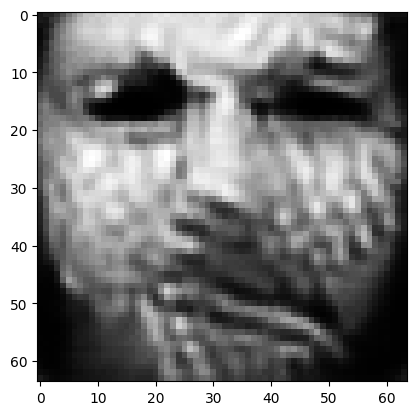

tensor([[3.8157e-04, 9.2209e-01, 2.7667e-04, 7.1071e-03, 3.9110e-04, 1.8812e-03,
         1.2526e-04, 1.2526e-03, 4.4512e-04, 1.0019e-03, 7.5574e-04, 5.9168e-03,
         3.8521e-03, 3.0753e-04, 6.5248e-04, 1.2453e-03, 9.1647e-04, 1.0132e-03,
         2.1434e-03, 8.3268e-04, 5.8839e-04, 3.6339e-05, 3.6384e-03, 2.9395e-04,
         5.1004e-04, 4.5419e-03, 7.6773e-04, 2.6564e-04, 1.3475e-03, 1.0160e-02,
         1.1416e-03, 2.8698e-03, 3.0519e-03, 1.4633e-04, 2.9635e-03, 1.2024e-02,
         6.3795e-04, 1.0679e-03, 5.0141e-04, 8.5595e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08111076802015305
tensor([[3.8155e-04, 9.2211e-01, 2.7666e-04, 7.1064e-03, 3.9106e-04, 1.8811e-03,
         1.2523e-04, 1.2525e-03, 4.4495e-04, 1.0017e-03, 7.5555e-04, 5.9158e-03,
         3.8517e-03, 3.0748e-04, 6.5228e-04, 1.2453e-03, 9.1646e-04, 1.0128e-03,
         2.1434e-03, 8.3252e-04, 5.8821e-04, 3.6334e-05, 3.6379e-03, 2.9394e-04,
         5.0992e-04, 4.5411e-03, 7.6761e-0

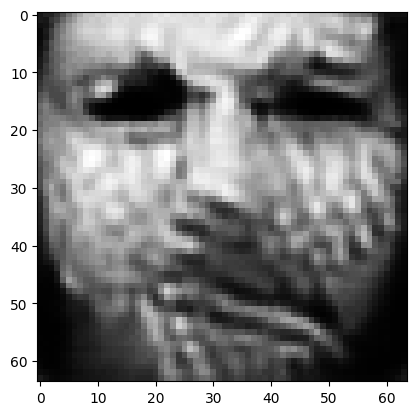

tensor([[3.8147e-04, 9.2216e-01, 2.7660e-04, 7.1031e-03, 3.9092e-04, 1.8806e-03,
         1.2514e-04, 1.2523e-03, 4.4430e-04, 1.0011e-03, 7.5478e-04, 5.9117e-03,
         3.8501e-03, 3.0728e-04, 6.5152e-04, 1.2451e-03, 9.1641e-04, 1.0115e-03,
         2.1432e-03, 8.3184e-04, 5.8747e-04, 3.6313e-05, 3.6360e-03, 2.9394e-04,
         5.0946e-04, 4.5383e-03, 7.6713e-04, 2.6551e-04, 1.3459e-03, 1.0148e-02,
         1.1410e-03, 2.8664e-03, 3.0483e-03, 1.4619e-04, 2.9596e-03, 1.2010e-02,
         6.3786e-04, 1.0669e-03, 5.0074e-04, 8.5525e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0810357928276062
tensor([[3.8145e-04, 9.2217e-01, 2.7658e-04, 7.1023e-03, 3.9089e-04, 1.8806e-03,
         1.2512e-04, 1.2523e-03, 4.4415e-04, 1.0009e-03, 7.5459e-04, 5.9107e-03,
         3.8497e-03, 3.0723e-04, 6.5134e-04, 1.2451e-03, 9.1641e-04, 1.0112e-03,
         2.1432e-03, 8.3168e-04, 5.8730e-04, 3.6307e-05, 3.6355e-03, 2.9394e-04,
         5.0935e-04, 4.5376e-03, 7.6702e-04

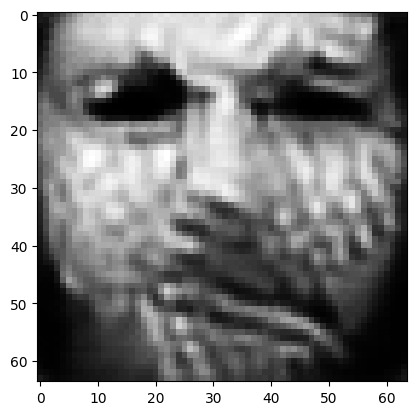

tensor([[3.8138e-04, 9.2223e-01, 2.7652e-04, 7.0992e-03, 3.9076e-04, 1.8801e-03,
         1.2503e-04, 1.2520e-03, 4.4353e-04, 1.0003e-03, 7.5387e-04, 5.9068e-03,
         3.8481e-03, 3.0704e-04, 6.5063e-04, 1.2450e-03, 9.1636e-04, 1.0099e-03,
         2.1430e-03, 8.3105e-04, 5.8660e-04, 3.6288e-05, 3.6338e-03, 2.9395e-04,
         5.0891e-04, 4.5349e-03, 7.6654e-04, 2.6539e-04, 1.3443e-03, 1.0136e-02,
         1.1404e-03, 2.8632e-03, 3.0448e-03, 1.4606e-04, 2.9559e-03, 1.1997e-02,
         6.3779e-04, 1.0659e-03, 5.0008e-04, 8.5457e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08096400648355484
tensor([[3.8136e-04, 9.2224e-01, 2.7651e-04, 7.0983e-03, 3.9074e-04, 1.8800e-03,
         1.2501e-04, 1.2520e-03, 4.4338e-04, 1.0001e-03, 7.5369e-04, 5.9058e-03,
         3.8478e-03, 3.0699e-04, 6.5046e-04, 1.2450e-03, 9.1636e-04, 1.0096e-03,
         2.1430e-03, 8.3091e-04, 5.8645e-04, 3.6283e-05, 3.6333e-03, 2.9395e-04,
         5.0880e-04, 4.5341e-03, 7.6645e-0

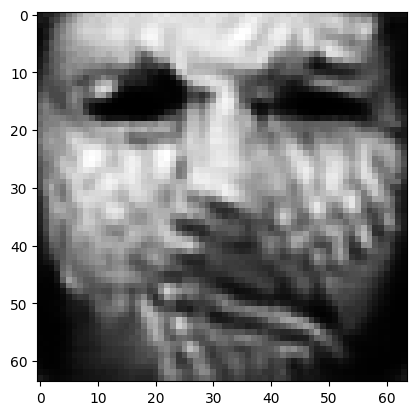

tensor([[3.8129e-04, 9.2229e-01, 2.7646e-04, 7.0951e-03, 3.9062e-04, 1.8796e-03,
         1.2493e-04, 1.2518e-03, 4.4279e-04, 9.9954e-04, 7.5299e-04, 5.9020e-03,
         3.8463e-03, 3.0680e-04, 6.4979e-04, 1.2449e-03, 9.1632e-04, 1.0084e-03,
         2.1429e-03, 8.3030e-04, 5.8580e-04, 3.6265e-05, 3.6317e-03, 2.9396e-04,
         5.0837e-04, 4.5315e-03, 7.6601e-04, 2.6528e-04, 1.3428e-03, 1.0125e-02,
         1.1398e-03, 2.8601e-03, 3.0415e-03, 1.4594e-04, 2.9523e-03, 1.1985e-02,
         6.3773e-04, 1.0650e-03, 4.9945e-04, 8.5393e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0808950737118721
tensor([[3.8126e-04, 9.2230e-01, 2.7644e-04, 7.0943e-03, 3.9058e-04, 1.8795e-03,
         1.2490e-04, 1.2517e-03, 4.4263e-04, 9.9938e-04, 7.5282e-04, 5.9011e-03,
         3.8459e-03, 3.0676e-04, 6.4961e-04, 1.2448e-03, 9.1630e-04, 1.0081e-03,
         2.1428e-03, 8.3013e-04, 5.8562e-04, 3.6260e-05, 3.6313e-03, 2.9396e-04,
         5.0827e-04, 4.5311e-03, 7.6588e-04

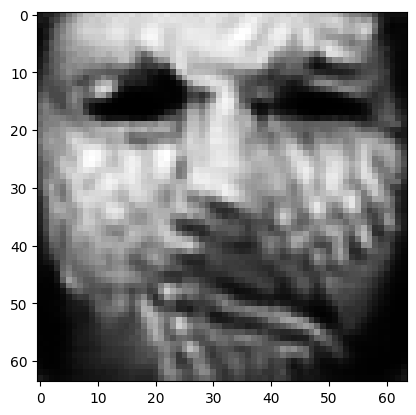

tensor([[3.8117e-04, 9.2235e-01, 2.7638e-04, 7.0911e-03, 3.9046e-04, 1.8790e-03,
         1.2482e-04, 1.2514e-03, 4.4207e-04, 9.9879e-04, 7.5216e-04, 5.8975e-03,
         3.8445e-03, 3.0659e-04, 6.4898e-04, 1.2447e-03, 9.1625e-04, 1.0069e-03,
         2.1426e-03, 8.2955e-04, 5.8500e-04, 3.6243e-05, 3.6298e-03, 2.9396e-04,
         5.0788e-04, 4.5287e-03, 7.6545e-04, 2.6516e-04, 1.3414e-03, 1.0114e-02,
         1.1392e-03, 2.8573e-03, 3.0384e-03, 1.4582e-04, 2.9488e-03, 1.1974e-02,
         6.3769e-04, 1.0641e-03, 4.9884e-04, 8.5328e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08082998543977737
tensor([[3.8114e-04, 9.2236e-01, 2.7636e-04, 7.0904e-03, 3.9042e-04, 1.8788e-03,
         1.2480e-04, 1.2513e-03, 4.4194e-04, 9.9863e-04, 7.5199e-04, 5.8966e-03,
         3.8441e-03, 3.0655e-04, 6.4881e-04, 1.2446e-03, 9.1623e-04, 1.0066e-03,
         2.1425e-03, 8.2938e-04, 5.8484e-04, 3.6237e-05, 3.6296e-03, 2.9395e-04,
         5.0779e-04, 4.5283e-03, 7.6532e-0

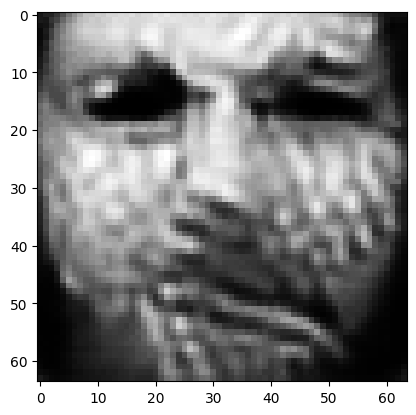

tensor([[3.8104e-04, 9.2241e-01, 2.7630e-04, 7.0873e-03, 3.9030e-04, 1.8783e-03,
         1.2472e-04, 1.2510e-03, 4.4142e-04, 9.9806e-04, 7.5136e-04, 5.8932e-03,
         3.8428e-03, 3.0639e-04, 6.4819e-04, 1.2444e-03, 9.1616e-04, 1.0055e-03,
         2.1422e-03, 8.2882e-04, 5.8426e-04, 3.6220e-05, 3.6283e-03, 2.9394e-04,
         5.0741e-04, 4.5263e-03, 7.6492e-04, 2.6505e-04, 1.3399e-03, 1.0104e-02,
         1.1387e-03, 2.8546e-03, 3.0354e-03, 1.4572e-04, 2.9455e-03, 1.1964e-02,
         6.3766e-04, 1.0632e-03, 4.9826e-04, 8.5267e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08076929301023483
tensor([[3.8103e-04, 9.2242e-01, 2.7629e-04, 7.0866e-03, 3.9027e-04, 1.8782e-03,
         1.2470e-04, 1.2510e-03, 4.4129e-04, 9.9792e-04, 7.5121e-04, 5.8924e-03,
         3.8425e-03, 3.0635e-04, 6.4805e-04, 1.2444e-03, 9.1615e-04, 1.0053e-03,
         2.1422e-03, 8.2869e-04, 5.8412e-04, 3.6216e-05, 3.6279e-03, 2.9394e-04,
         5.0732e-04, 4.5257e-03, 7.6483e-0

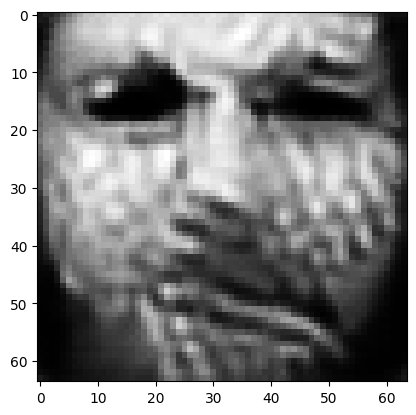

tensor([[3.8091e-04, 9.2246e-01, 2.7621e-04, 7.0838e-03, 3.9013e-04, 1.8776e-03,
         1.2462e-04, 1.2507e-03, 4.4079e-04, 9.9732e-04, 7.5059e-04, 5.8890e-03,
         3.8412e-03, 3.0620e-04, 6.4743e-04, 1.2441e-03, 9.1605e-04, 1.0042e-03,
         2.1419e-03, 8.2808e-04, 5.8353e-04, 3.6197e-05, 3.6268e-03, 2.9392e-04,
         5.0698e-04, 4.5240e-03, 7.6439e-04, 2.6494e-04, 1.3386e-03, 1.0094e-02,
         1.1383e-03, 2.8520e-03, 3.0326e-03, 1.4561e-04, 2.9424e-03, 1.1954e-02,
         6.3761e-04, 1.0624e-03, 4.9770e-04, 8.5204e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08071079105138779
tensor([[3.8090e-04, 9.2247e-01, 2.7620e-04, 7.0831e-03, 3.9011e-04, 1.8775e-03,
         1.2461e-04, 1.2506e-03, 4.4067e-04, 9.9719e-04, 7.5044e-04, 5.8882e-03,
         3.8409e-03, 3.0616e-04, 6.4730e-04, 1.2441e-03, 9.1605e-04, 1.0040e-03,
         2.1418e-03, 8.2796e-04, 5.8340e-04, 3.6193e-05, 3.6265e-03, 2.9392e-04,
         5.0689e-04, 4.5234e-03, 7.6430e-0

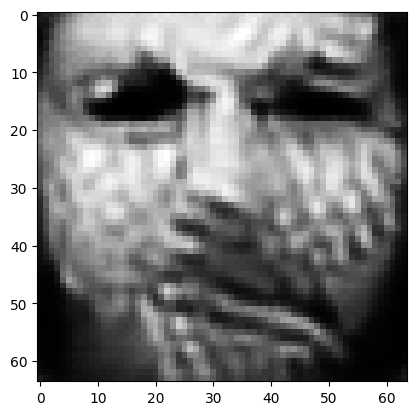

tensor([[3.8081e-04, 9.2251e-01, 2.7613e-04, 7.0804e-03, 3.8999e-04, 1.8770e-03,
         1.2453e-04, 1.2503e-03, 4.4018e-04, 9.9659e-04, 7.4984e-04, 5.8849e-03,
         3.8396e-03, 3.0602e-04, 6.4674e-04, 1.2439e-03, 9.1597e-04, 1.0030e-03,
         2.1416e-03, 8.2740e-04, 5.8284e-04, 3.6174e-05, 3.6254e-03, 2.9391e-04,
         5.0656e-04, 4.5215e-03, 7.6390e-04, 2.6484e-04, 1.3373e-03, 1.0085e-02,
         1.1378e-03, 2.8495e-03, 3.0298e-03, 1.4551e-04, 2.9394e-03, 1.1945e-02,
         6.3756e-04, 1.0616e-03, 4.9717e-04, 8.5143e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08065415918827057
tensor([[3.8077e-04, 9.2252e-01, 2.7611e-04, 7.0799e-03, 3.8996e-04, 1.8768e-03,
         1.2451e-04, 1.2502e-03, 4.4007e-04, 9.9644e-04, 7.4969e-04, 5.8840e-03,
         3.8393e-03, 3.0598e-04, 6.4660e-04, 1.2438e-03, 9.1594e-04, 1.0028e-03,
         2.1415e-03, 8.2724e-04, 5.8269e-04, 3.6169e-05, 3.6252e-03, 2.9390e-04,
         5.0649e-04, 4.5212e-03, 7.6378e-0

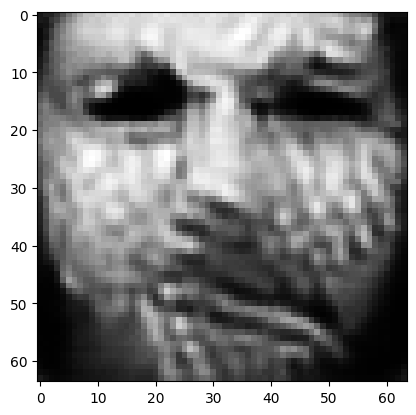

tensor([[3.8072e-04, 9.2256e-01, 2.7607e-04, 7.0771e-03, 3.8986e-04, 1.8764e-03,
         1.2445e-04, 1.2501e-03, 4.3961e-04, 9.9595e-04, 7.4915e-04, 5.8812e-03,
         3.8381e-03, 3.0584e-04, 6.4613e-04, 1.2437e-03, 9.1590e-04, 1.0019e-03,
         2.1413e-03, 8.2678e-04, 5.8222e-04, 3.6155e-05, 3.6239e-03, 2.9391e-04,
         5.0616e-04, 4.5191e-03, 7.6345e-04, 2.6476e-04, 1.3361e-03, 1.0076e-02,
         1.1373e-03, 2.8472e-03, 3.0273e-03, 1.4541e-04, 2.9366e-03, 1.1936e-02,
         6.3752e-04, 1.0608e-03, 4.9666e-04, 8.5087e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08060082048177719
tensor([[3.8069e-04, 9.2257e-01, 2.7605e-04, 7.0765e-03, 3.8983e-04, 1.8763e-03,
         1.2444e-04, 1.2500e-03, 4.3950e-04, 9.9580e-04, 7.4901e-04, 5.8804e-03,
         3.8378e-03, 3.0580e-04, 6.4600e-04, 1.2436e-03, 9.1587e-04, 1.0017e-03,
         2.1412e-03, 8.2664e-04, 5.8208e-04, 3.6151e-05, 3.6237e-03, 2.9390e-04,
         5.0609e-04, 4.5187e-03, 7.6334e-0

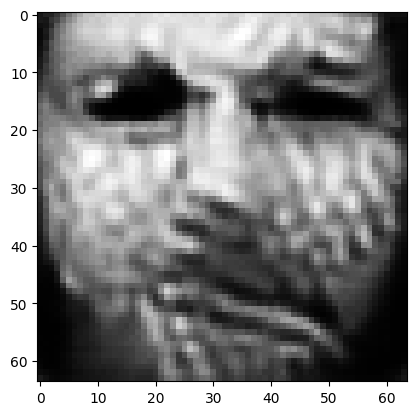

tensor([[3.8064e-04, 9.2261e-01, 2.7601e-04, 7.0739e-03, 3.8974e-04, 1.8760e-03,
         1.2438e-04, 1.2498e-03, 4.3907e-04, 9.9536e-04, 7.4851e-04, 5.8777e-03,
         3.8367e-03, 3.0567e-04, 6.4555e-04, 1.2436e-03, 9.1584e-04, 1.0009e-03,
         2.1411e-03, 8.2623e-04, 5.8164e-04, 3.6138e-05, 3.6225e-03, 2.9391e-04,
         5.0576e-04, 4.5167e-03, 7.6303e-04, 2.6468e-04, 1.3350e-03, 1.0068e-02,
         1.1369e-03, 2.8450e-03, 3.0249e-03, 1.4532e-04, 2.9339e-03, 1.1928e-02,
         6.3747e-04, 1.0601e-03, 4.9620e-04, 8.5038e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0805506631731987
tensor([[3.8061e-04, 9.2262e-01, 2.7598e-04, 7.0733e-03, 3.8971e-04, 1.8757e-03,
         1.2436e-04, 1.2497e-03, 4.3897e-04, 9.9521e-04, 7.4837e-04, 5.8770e-03,
         3.8364e-03, 3.0564e-04, 6.4542e-04, 1.2435e-03, 9.1580e-04, 1.0006e-03,
         2.1410e-03, 8.2609e-04, 5.8151e-04, 3.6134e-05, 3.6223e-03, 2.9389e-04,
         5.0570e-04, 4.5164e-03, 7.6292e-04

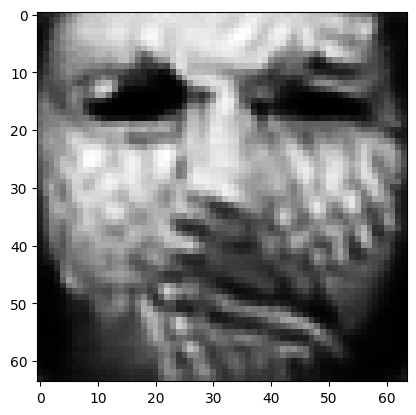

tensor([[3.8054e-04, 9.2265e-01, 2.7594e-04, 7.0707e-03, 3.8961e-04, 1.8753e-03,
         1.2430e-04, 1.2495e-03, 4.3856e-04, 9.9478e-04, 7.4789e-04, 5.8745e-03,
         3.8352e-03, 3.0550e-04, 6.4497e-04, 1.2434e-03, 9.1573e-04, 9.9977e-04,
         2.1409e-03, 8.2566e-04, 5.8108e-04, 3.6122e-05, 3.6212e-03, 2.9388e-04,
         5.0538e-04, 4.5147e-03, 7.6261e-04, 2.6459e-04, 1.3339e-03, 1.0061e-02,
         1.1365e-03, 2.8429e-03, 3.0226e-03, 1.4524e-04, 2.9313e-03, 1.1920e-02,
         6.3744e-04, 1.0594e-03, 4.9575e-04, 8.4991e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08050303906202316
tensor([[3.8051e-04, 9.2266e-01, 2.7592e-04, 7.0701e-03, 3.8957e-04, 1.8751e-03,
         1.2428e-04, 1.2494e-03, 4.3846e-04, 9.9464e-04, 7.4776e-04, 5.8738e-03,
         3.8349e-03, 3.0547e-04, 6.4484e-04, 1.2433e-03, 9.1570e-04, 9.9953e-04,
         2.1408e-03, 8.2552e-04, 5.8096e-04, 3.6118e-05, 3.6210e-03, 2.9387e-04,
         5.0532e-04, 4.5145e-03, 7.6251e-0

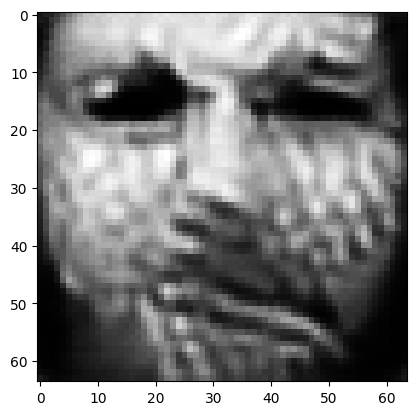

tensor([[3.8041e-04, 9.2269e-01, 2.7586e-04, 7.0678e-03, 3.8946e-04, 1.8746e-03,
         1.2422e-04, 1.2491e-03, 4.3808e-04, 9.9415e-04, 7.4729e-04, 5.8712e-03,
         3.8338e-03, 3.0535e-04, 6.4439e-04, 1.2430e-03, 9.1559e-04, 9.9870e-04,
         2.1405e-03, 8.2504e-04, 5.8051e-04, 3.6104e-05, 3.6201e-03, 2.9384e-04,
         5.0506e-04, 4.5132e-03, 7.6216e-04, 2.6450e-04, 1.3329e-03, 1.0054e-02,
         1.1362e-03, 2.8410e-03, 3.0205e-03, 1.4516e-04, 2.9286e-03, 1.1913e-02,
         6.3740e-04, 1.0587e-03, 4.9531e-04, 8.4941e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08045794814825058
tensor([[3.8040e-04, 9.2270e-01, 2.7585e-04, 7.0673e-03, 3.8945e-04, 1.8745e-03,
         1.2421e-04, 1.2491e-03, 4.3799e-04, 9.9405e-04, 7.4717e-04, 5.8706e-03,
         3.8336e-03, 3.0532e-04, 6.4429e-04, 1.2430e-03, 9.1558e-04, 9.9853e-04,
         2.1404e-03, 8.2495e-04, 5.8042e-04, 3.6101e-05, 3.6199e-03, 2.9384e-04,
         5.0499e-04, 4.5128e-03, 7.6210e-0

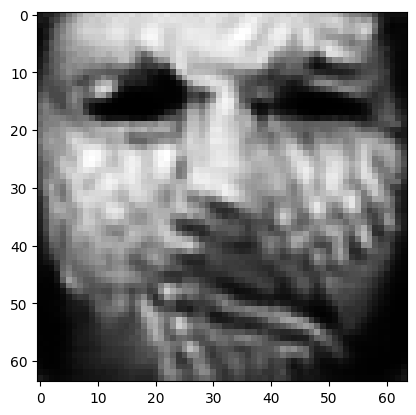

tensor([[3.8028e-04, 9.2273e-01, 2.7577e-04, 7.0652e-03, 3.8933e-04, 1.8739e-03,
         1.2414e-04, 1.2487e-03, 4.3764e-04, 9.9355e-04, 7.4672e-04, 5.8681e-03,
         3.8325e-03, 3.0522e-04, 6.4386e-04, 1.2427e-03, 9.1544e-04, 9.9775e-04,
         2.1400e-03, 8.2444e-04, 5.7999e-04, 3.6087e-05, 3.6192e-03, 2.9380e-04,
         5.0475e-04, 4.5118e-03, 7.6174e-04, 2.6441e-04, 1.3319e-03, 1.0048e-02,
         1.1358e-03, 2.8392e-03, 3.0184e-03, 1.4509e-04, 2.9262e-03, 1.1907e-02,
         6.3737e-04, 1.0581e-03, 4.9489e-04, 8.4895e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08041581511497498
tensor([[3.8025e-04, 9.2274e-01, 2.7575e-04, 7.0647e-03, 3.8930e-04, 1.8737e-03,
         1.2413e-04, 1.2486e-03, 4.3756e-04, 9.9342e-04, 7.4660e-04, 5.8675e-03,
         3.8322e-03, 3.0519e-04, 6.4375e-04, 1.2426e-03, 9.1540e-04, 9.9756e-04,
         2.1398e-03, 8.2431e-04, 5.7988e-04, 3.6082e-05, 3.6191e-03, 2.9378e-04,
         5.0470e-04, 4.5117e-03, 7.6165e-0

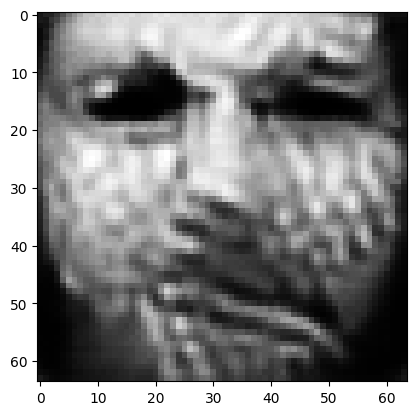

tensor([[3.8015e-04, 9.2277e-01, 2.7568e-04, 7.0626e-03, 3.8920e-04, 1.8731e-03,
         1.2407e-04, 1.2483e-03, 4.3723e-04, 9.9298e-04, 7.4615e-04, 5.8652e-03,
         3.8312e-03, 3.0508e-04, 6.4333e-04, 1.2423e-03, 9.1529e-04, 9.9680e-04,
         2.1395e-03, 8.2385e-04, 5.7948e-04, 3.6069e-05, 3.6184e-03, 2.9375e-04,
         5.0446e-04, 4.5107e-03, 7.6133e-04, 2.6432e-04, 1.3309e-03, 1.0042e-02,
         1.1355e-03, 2.8374e-03, 3.0164e-03, 1.4502e-04, 2.9239e-03, 1.1901e-02,
         6.3735e-04, 1.0575e-03, 4.9449e-04, 8.4852e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08037512004375458
tensor([[3.8013e-04, 9.2278e-01, 2.7567e-04, 7.0621e-03, 3.8918e-04, 1.8731e-03,
         1.2405e-04, 1.2482e-03, 4.3715e-04, 9.9289e-04, 7.4605e-04, 5.8647e-03,
         3.8310e-03, 3.0505e-04, 6.4323e-04, 1.2423e-03, 9.1527e-04, 9.9663e-04,
         2.1394e-03, 8.2376e-04, 5.7940e-04, 3.6067e-05, 3.6181e-03, 2.9374e-04,
         5.0439e-04, 4.5103e-03, 7.6127e-0

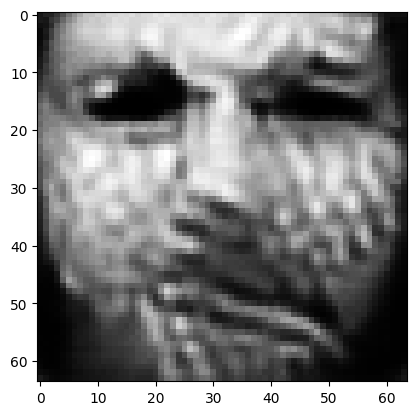

tensor([[3.8003e-04, 9.2281e-01, 2.7561e-04, 7.0600e-03, 3.8908e-04, 1.8725e-03,
         1.2400e-04, 1.2479e-03, 4.3683e-04, 9.9247e-04, 7.4563e-04, 5.8625e-03,
         3.8300e-03, 3.0495e-04, 6.4283e-04, 1.2420e-03, 9.1517e-04, 9.9590e-04,
         2.1391e-03, 8.2333e-04, 5.7901e-04, 3.6055e-05, 3.6174e-03, 2.9371e-04,
         5.0416e-04, 4.5094e-03, 7.6097e-04, 2.6424e-04, 1.3300e-03, 1.0036e-02,
         1.1352e-03, 2.8356e-03, 3.0146e-03, 1.4496e-04, 2.9216e-03, 1.1895e-02,
         6.3732e-04, 1.0569e-03, 4.9413e-04, 8.4815e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08033661544322968
tensor([[3.8000e-04, 9.2281e-01, 2.7559e-04, 7.0596e-03, 3.8904e-04, 1.8723e-03,
         1.2398e-04, 1.2478e-03, 4.3675e-04, 9.9234e-04, 7.4552e-04, 5.8619e-03,
         3.8298e-03, 3.0492e-04, 6.4272e-04, 1.2419e-03, 9.1512e-04, 9.9570e-04,
         2.1389e-03, 8.2320e-04, 5.7890e-04, 3.6051e-05, 3.6173e-03, 2.9369e-04,
         5.0411e-04, 4.5093e-03, 7.6087e-0

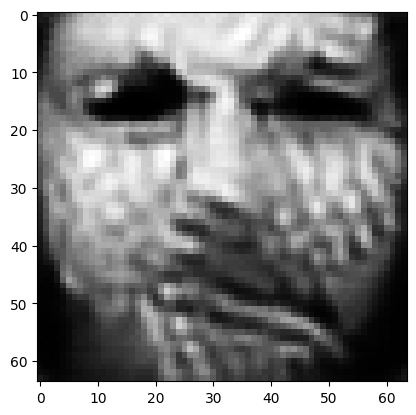

tensor([[3.7992e-04, 9.2284e-01, 2.7554e-04, 7.0576e-03, 3.8896e-04, 1.8718e-03,
         1.2393e-04, 1.2475e-03, 4.3645e-04, 9.9196e-04, 7.4512e-04, 5.8598e-03,
         3.8288e-03, 3.0482e-04, 6.4234e-04, 1.2417e-03, 9.1504e-04, 9.9500e-04,
         2.1387e-03, 8.2281e-04, 5.7854e-04, 3.6040e-05, 3.6165e-03, 2.9367e-04,
         5.0389e-04, 4.5083e-03, 7.6059e-04, 2.6416e-04, 1.3291e-03, 1.0031e-02,
         1.1349e-03, 2.8340e-03, 3.0128e-03, 1.4490e-04, 2.9195e-03, 1.1889e-02,
         6.3730e-04, 1.0563e-03, 4.9378e-04, 8.4776e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08029942959547043
tensor([[3.7990e-04, 9.2285e-01, 2.7552e-04, 7.0571e-03, 3.8894e-04, 1.8718e-03,
         1.2391e-04, 1.2474e-03, 4.3637e-04, 9.9187e-04, 7.4502e-04, 5.8593e-03,
         3.8286e-03, 3.0480e-04, 6.4224e-04, 1.2417e-03, 9.1502e-04, 9.9484e-04,
         2.1386e-03, 8.2272e-04, 5.7846e-04, 3.6037e-05, 3.6163e-03, 2.9366e-04,
         5.0383e-04, 4.5080e-03, 7.6052e-0

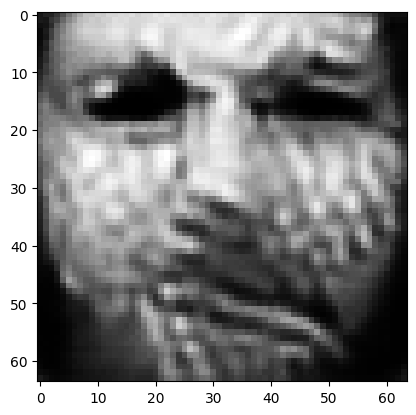

tensor([[3.7982e-04, 9.2287e-01, 2.7547e-04, 7.0553e-03, 3.8885e-04, 1.8713e-03,
         1.2386e-04, 1.2471e-03, 4.3608e-04, 9.9150e-04, 7.4463e-04, 5.8573e-03,
         3.8278e-03, 3.0470e-04, 6.4187e-04, 1.2415e-03, 9.1494e-04, 9.9418e-04,
         2.1383e-03, 8.2234e-04, 5.7811e-04, 3.6026e-05, 3.6156e-03, 2.9364e-04,
         5.0361e-04, 4.5071e-03, 7.6026e-04, 2.6409e-04, 1.3282e-03, 1.0026e-02,
         1.1347e-03, 2.8324e-03, 3.0111e-03, 1.4484e-04, 2.9174e-03, 1.1883e-02,
         6.3729e-04, 1.0558e-03, 4.9343e-04, 8.4743e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08026356995105743
tensor([[3.7979e-04, 9.2288e-01, 2.7545e-04, 7.0548e-03, 3.8883e-04, 1.8711e-03,
         1.2385e-04, 1.2470e-03, 4.3601e-04, 9.9139e-04, 7.4453e-04, 5.8568e-03,
         3.8276e-03, 3.0468e-04, 6.4176e-04, 1.2414e-03, 9.1491e-04, 9.9399e-04,
         2.1382e-03, 8.2222e-04, 5.7801e-04, 3.6022e-05, 3.6155e-03, 2.9363e-04,
         5.0357e-04, 4.5070e-03, 7.6017e-0

In [15]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=1)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.8304033279418945


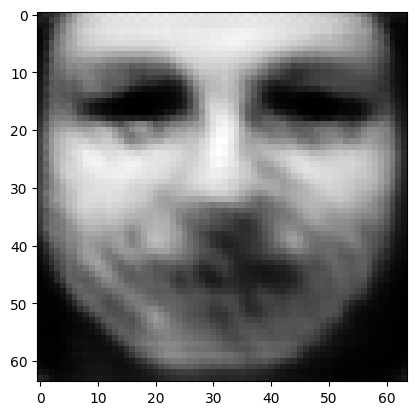

tensor([[0.0052, 0.0013, 0.0872, 0.0136, 0.1036, 0.0033, 0.0090, 0.0053, 0.0051,
         0.0006, 0.0014, 0.0013, 0.0237, 0.0065, 0.0015, 0.0011, 0.0411, 0.0106,
         0.0051, 0.0030, 0.0190, 0.0036, 0.0363, 0.0038, 0.1879, 0.0124, 0.0042,
         0.0095, 0.0330, 0.0139, 0.0087, 0.0025, 0.0392, 0.0284, 0.0173, 0.0098,
         0.0561, 0.0182, 0.1400, 0.0268]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.4397616386413574
tensor([[0.0029, 0.0020, 0.0146, 0.0068, 0.1543, 0.0030, 0.0126, 0.0082, 0.0028,
         0.0007, 0.0022, 0.0010, 0.0236, 0.0169, 0.0035, 0.0010, 0.0519, 0.0292,
         0.0032, 0.0044, 0.0123, 0.0020, 0.0345, 0.0051, 0.2850, 0.0077, 0.0029,
         0.0123, 0.0107, 0.0046, 0.0038, 0.0064, 0.0489, 0.0210, 0.0145, 0.0196,
         0.0964, 0.0113, 0.0476, 0.0085]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.229848861694336
tensor([[3.8795e-03, 8.0060e-04, 2.1726e-01, 2.7642e-03, 1.3508e-02, 8.3264e-02,
         2

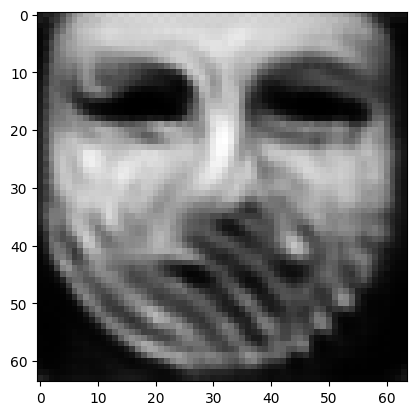

tensor([[1.4179e-03, 1.3047e-04, 7.3346e-01, 1.5376e-03, 3.7596e-03, 5.0978e-02,
         2.2928e-03, 2.6646e-02, 1.3184e-03, 3.8728e-03, 1.8379e-03, 2.3627e-03,
         1.1036e-03, 2.2485e-05, 1.5242e-05, 4.6135e-04, 2.0651e-03, 1.0162e-03,
         5.4132e-04, 4.5348e-03, 5.4605e-04, 6.1237e-04, 1.4768e-05, 1.5602e-04,
         6.9911e-04, 1.3678e-03, 1.0313e-03, 7.4524e-03, 5.3189e-02, 2.3545e-04,
         3.9620e-04, 5.9695e-05, 6.9167e-03, 3.2763e-03, 7.1836e-04, 2.2303e-05,
         5.6487e-04, 2.3035e-03, 4.3235e-02, 3.7824e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.30997684597969055
tensor([[1.1788e-03, 8.9744e-05, 7.7436e-01, 1.2624e-03, 2.9479e-03, 4.3534e-02,
         1.8314e-03, 2.3743e-02, 1.0824e-03, 3.1952e-03, 1.6223e-03, 2.1835e-03,
         8.3167e-04, 1.6683e-05, 1.1136e-05, 3.7738e-04, 1.8125e-03, 8.1298e-04,
         4.4678e-04, 3.7187e-03, 4.4675e-04, 5.3071e-04, 1.1190e-05, 1.3664e-04,
         5.4695e-04, 1.1899e-03, 7.2529e-0

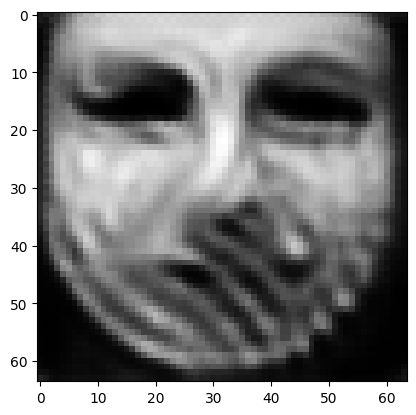

tensor([[8.1493e-04, 3.9827e-05, 8.5253e-01, 8.9298e-04, 1.7978e-03, 2.6875e-02,
         1.1068e-03, 1.5904e-02, 7.7370e-04, 2.0153e-03, 1.0963e-03, 1.7134e-03,
         5.2920e-04, 9.5672e-06, 6.3849e-06, 2.2634e-04, 1.2637e-03, 5.2432e-04,
         2.7671e-04, 2.4936e-03, 3.0302e-04, 3.7334e-04, 6.3715e-06, 1.0029e-04,
         3.3943e-04, 8.4781e-04, 3.4410e-04, 3.5686e-03, 3.1085e-02, 9.5724e-05,
         2.2618e-04, 2.5081e-05, 3.6850e-03, 1.5896e-03, 3.7962e-04, 8.4198e-06,
         2.8795e-04, 1.6534e-03, 2.7382e-02, 1.6809e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15954554080963135
tensor([[7.6905e-04, 3.6287e-05, 8.6204e-01, 8.9183e-04, 1.7212e-03, 2.4301e-02,
         9.9857e-04, 1.4781e-02, 7.4524e-04, 1.8508e-03, 1.0245e-03, 1.5866e-03,
         5.1291e-04, 9.3522e-06, 5.9627e-06, 2.0762e-04, 1.2372e-03, 4.9077e-04,
         2.5899e-04, 2.2966e-03, 2.9033e-04, 3.5334e-04, 6.1382e-06, 9.7452e-05,
         3.3434e-04, 8.3857e-04, 3.0269e-0

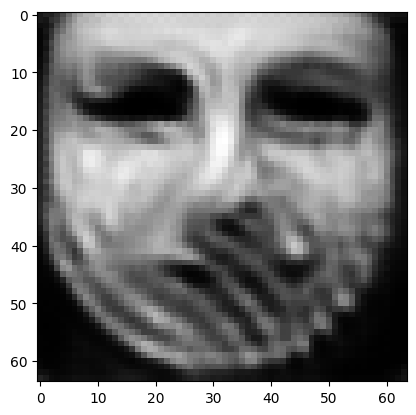

tensor([[6.6914e-04, 2.6398e-05, 8.8703e-01, 8.1673e-04, 1.4470e-03, 1.9085e-02,
         7.6390e-04, 1.2669e-02, 6.0475e-04, 1.4794e-03, 8.4485e-04, 1.3139e-03,
         4.1913e-04, 7.8670e-06, 4.6211e-06, 1.6765e-04, 1.1663e-03, 4.0029e-04,
         2.0968e-04, 1.8321e-03, 2.4429e-04, 3.0098e-04, 4.9193e-06, 9.2094e-05,
         2.9075e-04, 7.7237e-04, 2.0731e-04, 2.9400e-03, 2.4466e-02, 6.9335e-05,
         2.0191e-04, 1.7427e-05, 2.7526e-03, 1.2025e-03, 3.0607e-04, 5.8908e-06,
         2.4192e-04, 1.4153e-03, 2.2728e-02, 1.0780e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1198742687702179
tensor([[6.4961e-04, 2.4566e-05, 8.9165e-01, 7.8545e-04, 1.3787e-03, 1.8323e-02,
         7.3219e-04, 1.2412e-02, 5.7210e-04, 1.4189e-03, 8.1640e-04, 1.2762e-03,
         3.9377e-04, 7.4333e-06, 4.3231e-06, 1.6089e-04, 1.1506e-03, 3.8341e-04,
         1.9972e-04, 1.7487e-03, 2.3364e-04, 2.9059e-04, 4.6303e-06, 9.0582e-05,
         2.7741e-04, 7.5305e-04, 1.9255e-04

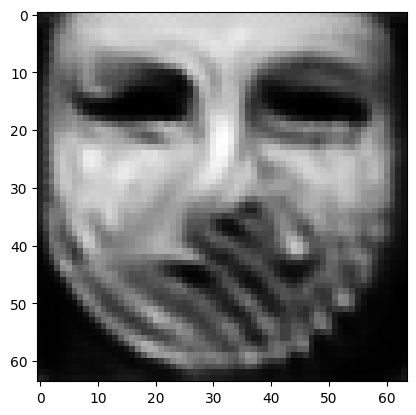

tensor([[5.6486e-04, 2.1034e-05, 9.0759e-01, 7.9764e-04, 1.1707e-03, 1.5227e-02,
         5.6088e-04, 1.0280e-02, 5.1140e-04, 1.2149e-03, 7.2589e-04, 1.1606e-03,
         3.4898e-04, 6.9903e-06, 3.5992e-06, 1.3688e-04, 1.0689e-03, 3.2768e-04,
         1.7420e-04, 1.4184e-03, 2.1085e-04, 2.5195e-04, 4.2122e-06, 8.0651e-05,
         2.4321e-04, 7.3618e-04, 1.5203e-04, 2.5019e-03, 2.0743e-02, 5.7691e-05,
         1.9152e-04, 1.3270e-05, 2.2273e-03, 9.6710e-04, 2.6495e-04, 4.6136e-06,
         2.1594e-04, 1.3143e-03, 1.8248e-02, 8.2574e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09695945680141449
tensor([[5.5016e-04, 2.0300e-05, 9.1086e-01, 8.0144e-04, 1.1292e-03, 1.4635e-02,
         5.2971e-04, 9.8264e-03, 4.9948e-04, 1.1694e-03, 7.0386e-04, 1.1356e-03,
         3.4242e-04, 6.8637e-06, 3.4707e-06, 1.3216e-04, 1.0452e-03, 3.1696e-04,
         1.6880e-04, 1.3595e-03, 2.0629e-04, 2.4396e-04, 4.1245e-06, 7.8618e-05,
         2.3646e-04, 7.2774e-04, 1.4490e-0

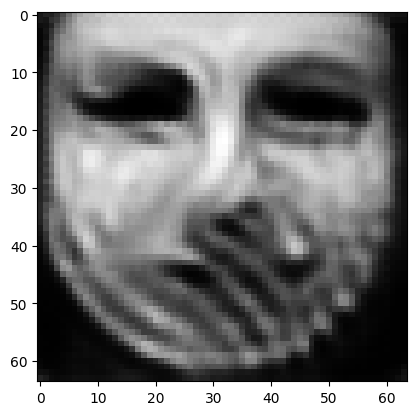

tensor([[4.8371e-04, 1.7513e-05, 9.2238e-01, 8.0200e-04, 9.5513e-04, 1.2243e-02,
         4.1374e-04, 8.3768e-03, 4.6118e-04, 1.0032e-03, 6.1848e-04, 1.0224e-03,
         3.0993e-04, 6.3566e-06, 2.9635e-06, 1.1482e-04, 9.7484e-04, 2.6912e-04,
         1.5143e-04, 1.1485e-03, 1.8974e-04, 2.1377e-04, 3.8135e-06, 7.2880e-05,
         2.1261e-04, 7.1622e-04, 1.1481e-04, 2.1617e-03, 1.7861e-02, 5.0695e-05,
         1.8726e-04, 1.0427e-05, 1.8554e-03, 7.9521e-04, 2.3887e-04, 3.6736e-06,
         1.9248e-04, 1.2034e-03, 1.5684e-02, 6.4797e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08080019056797028
tensor([[4.7114e-04, 1.6923e-05, 9.2471e-01, 7.9760e-04, 9.1941e-04, 1.1810e-02,
         3.9455e-04, 8.1275e-03, 4.5029e-04, 9.7347e-04, 6.0319e-04, 1.0022e-03,
         3.0010e-04, 6.2133e-06, 2.8589e-06, 1.1159e-04, 9.6099e-04, 2.6145e-04,
         1.4803e-04, 1.1068e-03, 1.8561e-04, 2.0738e-04, 3.7168e-06, 7.1653e-05,
         2.0621e-04, 7.1002e-04, 1.0929e-0

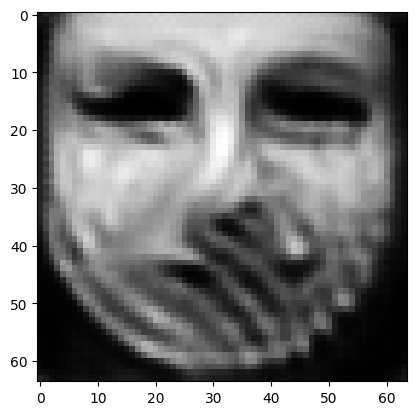

tensor([[4.2074e-04, 1.5221e-05, 9.3253e-01, 8.0687e-04, 8.0655e-04, 1.0334e-02,
         3.2906e-04, 7.2174e-03, 4.1203e-04, 8.6250e-04, 5.5389e-04, 9.3137e-04,
         2.6749e-04, 5.9027e-06, 2.4848e-06, 1.0097e-04, 9.3405e-04, 2.3346e-04,
         1.3836e-04, 9.4143e-04, 1.7303e-04, 1.8480e-04, 3.4994e-06, 6.7789e-05,
         1.8721e-04, 7.0870e-04, 9.1115e-05, 1.9505e-03, 1.6306e-02, 4.5643e-05,
         1.8164e-04, 8.7322e-06, 1.5836e-03, 6.7419e-04, 2.1636e-04, 3.1130e-06,
         1.8025e-04, 1.1403e-03, 1.3158e-02, 5.2961e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06985864043235779
tensor([[4.0974e-04, 1.4987e-05, 9.3416e-01, 8.1683e-04, 7.8735e-04, 9.9972e-03,
         3.1500e-04, 6.9942e-03, 4.0601e-04, 8.3795e-04, 5.4494e-04, 9.1667e-04,
         2.6232e-04, 5.9157e-06, 2.4249e-06, 9.9015e-05, 9.3135e-04, 2.2798e-04,
         1.3707e-04, 9.0503e-04, 1.7113e-04, 1.8008e-04, 3.4908e-06, 6.7000e-05,
         1.8437e-04, 7.1325e-04, 8.7602e-0

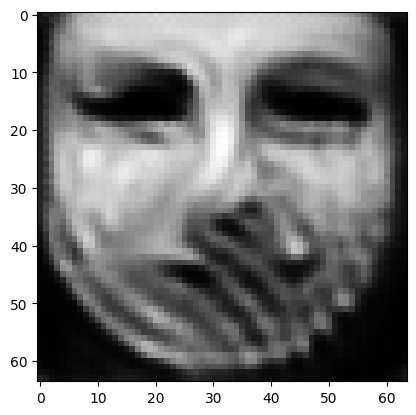

tensor([[3.7274e-04, 1.4269e-05, 9.3975e-01, 8.6649e-04, 7.2012e-04, 8.7936e-03,
         2.6478e-04, 6.1249e-03, 3.8875e-04, 7.5480e-04, 5.1201e-04, 8.7132e-04,
         2.4712e-04, 6.0437e-06, 2.2289e-06, 9.1844e-05, 9.1931e-04, 2.0849e-04,
         1.3193e-04, 7.8815e-04, 1.6438e-04, 1.6453e-04, 3.4748e-06, 6.4129e-05,
         1.7643e-04, 7.3312e-04, 7.6230e-05, 1.8076e-03, 1.5360e-02, 4.4297e-05,
         1.8869e-04, 7.7665e-06, 1.3945e-03, 6.0904e-04, 2.0640e-04, 2.8473e-06,
         1.8147e-04, 1.1168e-03, 1.1286e-02, 4.5846e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.062142953276634216
tensor([[3.6599e-04, 1.4097e-05, 9.4090e-01, 8.7455e-04, 7.0396e-04, 8.5624e-03,
         2.5499e-04, 5.9400e-03, 3.8450e-04, 7.4075e-04, 5.0533e-04, 8.6520e-04,
         2.4367e-04, 6.0490e-06, 2.1928e-06, 9.0470e-05, 9.1197e-04, 2.0469e-04,
         1.3052e-04, 7.6844e-04, 1.6270e-04, 1.6172e-04, 3.4502e-06, 6.3351e-05,
         1.7359e-04, 7.3389e-04, 7.4210e-

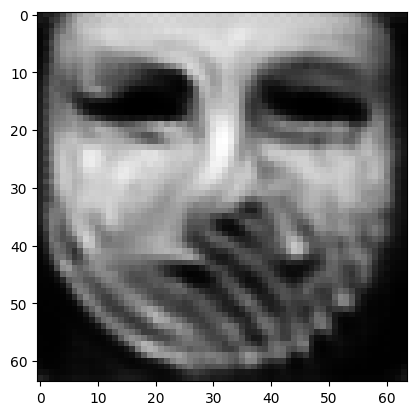

tensor([[3.4298e-04, 1.3475e-05, 9.4471e-01, 8.9510e-04, 6.5106e-04, 7.8622e-03,
         2.2602e-04, 5.3839e-03, 3.6964e-04, 6.9518e-04, 4.8176e-04, 8.4548e-04,
         2.3200e-04, 5.9761e-06, 2.0502e-06, 8.5912e-05, 8.8704e-04, 1.9179e-04,
         1.2533e-04, 7.0389e-04, 1.5645e-04, 1.5262e-04, 3.3443e-06, 6.0559e-05,
         1.6369e-04, 7.3227e-04, 6.7672e-05, 1.6855e-03, 1.4596e-02, 4.2631e-05,
         1.9142e-04, 7.1216e-06, 1.2726e-03, 5.6012e-04, 1.9707e-04, 2.6185e-06,
         1.8010e-04, 1.1010e-03, 9.9808e-03, 4.1343e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05687651038169861
tensor([[3.3854e-04, 1.3318e-05, 9.4551e-01, 8.9670e-04, 6.3962e-04, 7.7388e-03,
         2.2057e-04, 5.2823e-03, 3.6579e-04, 6.8731e-04, 4.7636e-04, 8.4177e-04,
         2.2915e-04, 5.9220e-06, 2.0159e-06, 8.4924e-05, 8.7936e-04, 1.8900e-04,
         1.2402e-04, 6.9134e-04, 1.5466e-04, 1.5072e-04, 3.3022e-06, 5.9815e-05,
         1.6094e-04, 7.2981e-04, 6.6400e-0

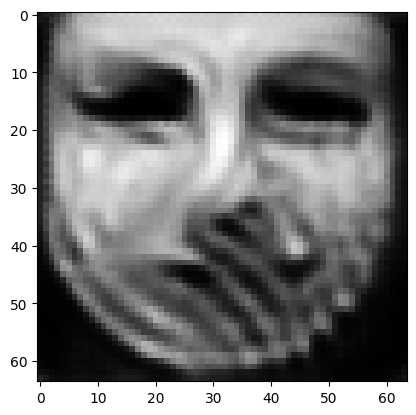

tensor([[3.1930e-04, 1.2797e-05, 9.4850e-01, 9.0048e-04, 5.9584e-04, 7.1732e-03,
         1.9917e-04, 4.8369e-03, 3.5355e-04, 6.5310e-04, 4.5672e-04, 8.3180e-04,
         2.2300e-04, 5.8555e-06, 1.9318e-06, 8.1866e-05, 8.5234e-04, 1.7926e-04,
         1.1900e-04, 6.5255e-04, 1.5017e-04, 1.4412e-04, 3.2034e-06, 5.7181e-05,
         1.5143e-04, 7.1314e-04, 6.1697e-05, 1.5706e-03, 1.3931e-02, 4.1181e-05,
         1.9108e-04, 6.6041e-06, 1.1839e-03, 5.2315e-04, 1.8867e-04, 2.4056e-06,
         1.7647e-04, 1.0740e-03, 9.0822e-03, 3.7952e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05286986753344536
tensor([[3.1457e-04, 1.2630e-05, 9.4919e-01, 8.9784e-04, 5.8380e-04, 7.0498e-03,
         1.9451e-04, 4.7372e-03, 3.4973e-04, 6.4577e-04, 4.5228e-04, 8.3051e-04,
         2.2064e-04, 5.8142e-06, 1.9069e-06, 8.1291e-05, 8.4679e-04, 1.7667e-04,
         1.1782e-04, 6.4357e-04, 1.4902e-04, 1.4259e-04, 3.1712e-06, 5.6596e-05,
         1.4854e-04, 7.0793e-04, 6.0498e-0

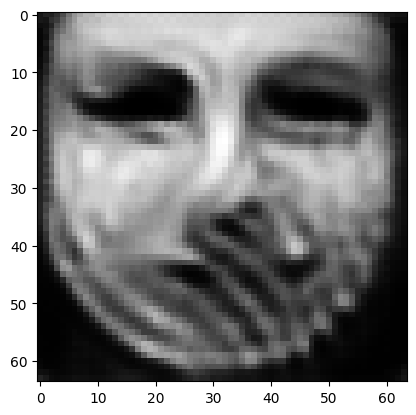

tensor([[2.9888e-04, 1.2099e-05, 9.5163e-01, 8.9535e-04, 5.4587e-04, 6.5895e-03,
         1.7841e-04, 4.3910e-03, 3.3784e-04, 6.1537e-04, 4.3536e-04, 8.2250e-04,
         2.1454e-04, 5.7223e-06, 1.8312e-06, 7.9082e-05, 8.2747e-04, 1.6817e-04,
         1.1356e-04, 6.1181e-04, 1.4533e-04, 1.3701e-04, 3.0824e-06, 5.4676e-05,
         1.4022e-04, 6.8980e-04, 5.6416e-05, 1.4627e-03, 1.3413e-02, 3.9976e-05,
         1.8948e-04, 6.1798e-06, 1.1138e-03, 4.9281e-04, 1.8067e-04, 2.2147e-06,
         1.7234e-04, 1.0482e-03, 8.3803e-03, 3.4957e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04957738518714905
tensor([[2.9536e-04, 1.2014e-05, 9.5219e-01, 8.9811e-04, 5.3785e-04, 6.4867e-03,
         1.7459e-04, 4.3122e-03, 3.3486e-04, 6.0872e-04, 4.3225e-04, 8.2058e-04,
         2.1265e-04, 5.7181e-06, 1.8112e-06, 7.8434e-05, 8.2174e-04, 1.6628e-04,
         1.1261e-04, 6.0296e-04, 1.4416e-04, 1.3571e-04, 3.0611e-06, 5.4143e-05,
         1.3864e-04, 6.8749e-04, 5.5596e-0

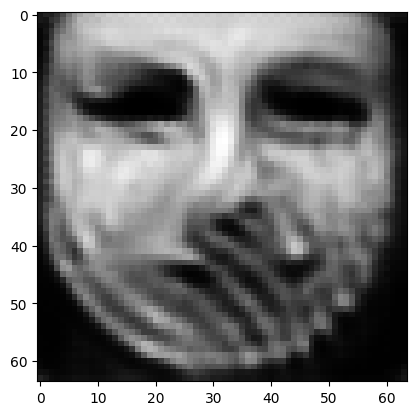

tensor([[2.8112e-04, 1.1474e-05, 9.5436e-01, 8.8130e-04, 5.0438e-04, 6.1055e-03,
         1.6115e-04, 4.0164e-03, 3.2483e-04, 5.8554e-04, 4.1505e-04, 8.1670e-04,
         2.0668e-04, 5.5773e-06, 1.7453e-06, 7.5988e-05, 7.9748e-04, 1.5925e-04,
         1.0831e-04, 5.8063e-04, 1.4080e-04, 1.3108e-04, 2.9623e-06, 5.2086e-05,
         1.3047e-04, 6.6658e-04, 5.1976e-05, 1.3624e-03, 1.2879e-02, 3.8707e-05,
         1.8663e-04, 5.8049e-06, 1.0538e-03, 4.6705e-04, 1.7368e-04, 2.0565e-06,
         1.6688e-04, 1.0231e-03, 7.8173e-03, 3.2515e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046717364341020584
tensor([[2.7821e-04, 1.1381e-05, 9.5487e-01, 8.8289e-04, 4.9698e-04, 6.0107e-03,
         1.5768e-04, 3.9561e-03, 3.2253e-04, 5.7974e-04, 4.1117e-04, 8.1368e-04,
         2.0505e-04, 5.5619e-06, 1.7266e-06, 7.5173e-05, 7.9197e-04, 1.5745e-04,
         1.0728e-04, 5.7404e-04, 1.3948e-04, 1.2981e-04, 2.9412e-06, 5.1643e-05,
         1.2930e-04, 6.6488e-04, 5.1122e-

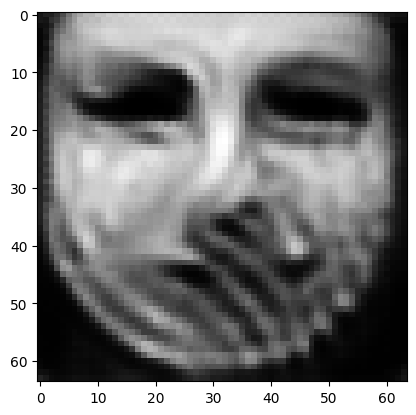

tensor([[2.6696e-04, 1.0874e-05, 9.5676e-01, 8.6673e-04, 4.7089e-04, 5.6923e-03,
         1.4656e-04, 3.7341e-03, 3.1431e-04, 5.5913e-04, 3.9319e-04, 8.0310e-04,
         2.0012e-04, 5.4116e-06, 1.6683e-06, 7.2444e-05, 7.7042e-04, 1.5170e-04,
         1.0316e-04, 5.5582e-04, 1.3550e-04, 1.2540e-04, 2.8417e-06, 4.9945e-05,
         1.2351e-04, 6.4567e-04, 4.7924e-05, 1.2781e-03, 1.2301e-02, 3.7207e-05,
         1.8381e-04, 5.4830e-06, 1.0030e-03, 4.4395e-04, 1.6785e-04, 1.9180e-06,
         1.6131e-04, 9.9622e-04, 7.3897e-03, 3.0195e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044200945645570755
tensor([[2.6424e-04, 1.0765e-05, 9.5722e-01, 8.6589e-04, 4.6459e-04, 5.6156e-03,
         1.4375e-04, 3.6851e-03, 3.1239e-04, 5.5374e-04, 3.8904e-04, 7.9907e-04,
         1.9874e-04, 5.3814e-06, 1.6501e-06, 7.1660e-05, 7.6526e-04, 1.5013e-04,
         1.0227e-04, 5.4974e-04, 1.3421e-04, 1.2425e-04, 2.8192e-06, 4.9503e-05,
         1.2233e-04, 6.4285e-04, 4.7139e-

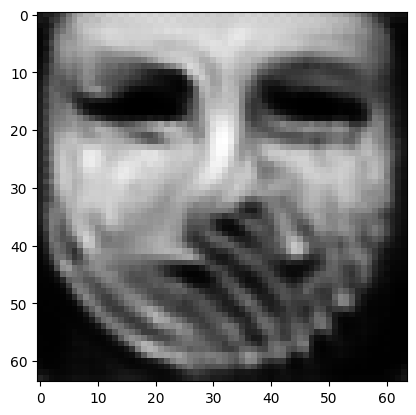

tensor([[2.5447e-04, 1.0340e-05, 9.5888e-01, 8.5219e-04, 4.4229e-04, 5.3364e-03,
         1.3430e-04, 3.5028e-03, 3.0557e-04, 5.3725e-04, 3.7224e-04, 7.8473e-04,
         1.9475e-04, 5.2376e-06, 1.5986e-06, 6.8775e-05, 7.4140e-04, 1.4514e-04,
         9.8717e-05, 5.3282e-04, 1.2974e-04, 1.2046e-04, 2.7192e-06, 4.7613e-05,
         1.1725e-04, 6.2517e-04, 4.4519e-05, 1.2098e-03, 1.1747e-02, 3.5678e-05,
         1.8124e-04, 5.1732e-06, 9.5505e-04, 4.2313e-04, 1.6202e-04, 1.7901e-06,
         1.5568e-04, 9.7085e-04, 7.0349e-03, 2.8261e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04198651388287544
tensor([[2.5219e-04, 1.0251e-05, 9.5925e-01, 8.5004e-04, 4.3722e-04, 5.2772e-03,
         1.3215e-04, 3.4626e-03, 3.0408e-04, 5.3383e-04, 3.6857e-04, 7.8122e-04,
         1.9369e-04, 5.2026e-06, 1.5849e-06, 6.8061e-05, 7.3507e-04, 1.4390e-04,
         9.7946e-05, 5.2809e-04, 1.2858e-04, 1.1960e-04, 2.6946e-06, 4.7112e-05,
         1.1603e-04, 6.2179e-04, 4.3967e-0

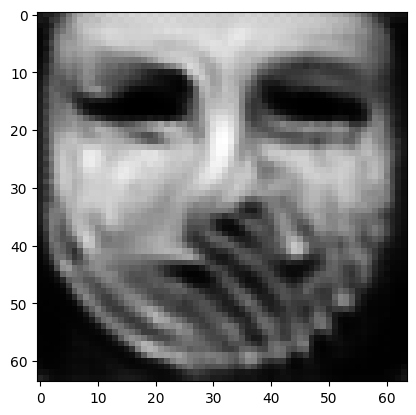

tensor([[2.4452e-04, 9.8057e-06, 9.6068e-01, 8.3293e-04, 4.1861e-04, 5.0465e-03,
         1.2496e-04, 3.3227e-03, 2.9725e-04, 5.1886e-04, 3.5383e-04, 7.6709e-04,
         1.8911e-04, 5.0389e-06, 1.5358e-06, 6.5657e-05, 7.1949e-04, 1.3977e-04,
         9.4711e-05, 5.1437e-04, 1.2467e-04, 1.1617e-04, 2.5998e-06, 4.5842e-05,
         1.1175e-04, 6.0559e-04, 4.1524e-05, 1.1526e-03, 1.1253e-02, 3.4230e-05,
         1.7773e-04, 4.9083e-06, 9.1369e-04, 4.0398e-04, 1.5709e-04, 1.6771e-06,
         1.4997e-04, 9.4601e-04, 6.7559e-03, 2.6533e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04011228680610657
tensor([[2.4313e-04, 9.7149e-06, 9.6102e-01, 8.3094e-04, 4.1430e-04, 4.9899e-03,
         1.2325e-04, 3.2898e-03, 2.9546e-04, 5.1553e-04, 3.5074e-04, 7.6370e-04,
         1.8768e-04, 5.0086e-06, 1.5245e-06, 6.5048e-05, 7.1553e-04, 1.3894e-04,
         9.3944e-05, 5.1097e-04, 1.2363e-04, 1.1530e-04, 2.5759e-06, 4.5560e-05,
         1.1094e-04, 6.0272e-04, 4.0990e-0

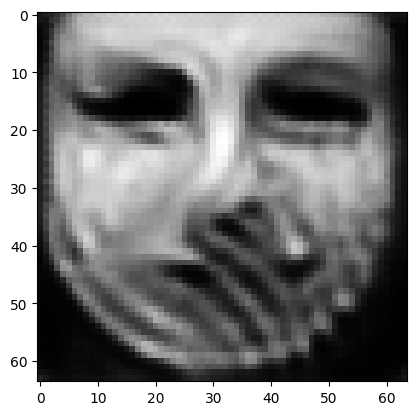

tensor([[2.3727e-04, 9.3933e-06, 9.6228e-01, 8.2256e-04, 3.9897e-04, 4.7813e-03,
         1.1699e-04, 3.1665e-03, 2.8907e-04, 5.0222e-04, 3.3917e-04, 7.5053e-04,
         1.8364e-04, 4.9106e-06, 1.4857e-06, 6.2895e-05, 7.0170e-04, 1.3584e-04,
         9.1118e-05, 4.9872e-04, 1.2007e-04, 1.1203e-04, 2.4979e-06, 4.4490e-05,
         1.0785e-04, 5.9046e-04, 3.9030e-05, 1.1062e-03, 1.0826e-02, 3.3133e-05,
         1.7531e-04, 4.6905e-06, 8.7742e-04, 3.8753e-04, 1.5312e-04, 1.5938e-06,
         1.4581e-04, 9.2968e-04, 6.4758e-03, 2.4951e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0384526289999485
tensor([[2.3586e-04, 9.3175e-06, 9.6258e-01, 8.2006e-04, 3.9524e-04, 4.7324e-03,
         1.1550e-04, 3.1369e-03, 2.8736e-04, 4.9921e-04, 3.3643e-04, 7.4728e-04,
         1.8258e-04, 4.8858e-06, 1.4767e-06, 6.2370e-05, 6.9821e-04, 1.3514e-04,
         9.0414e-05, 4.9607e-04, 1.1918e-04, 1.1125e-04, 2.4772e-06, 4.4208e-05,
         1.0703e-04, 5.8717e-04, 3.8574e-05

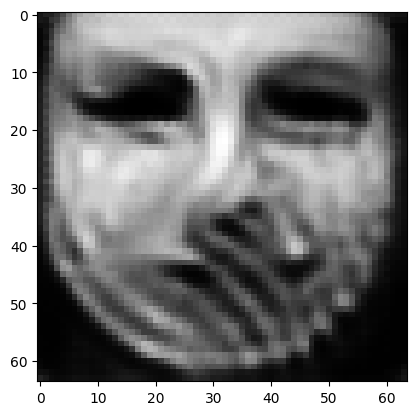

tensor([[2.3098e-04, 9.0075e-06, 9.6375e-01, 8.0891e-04, 3.8108e-04, 4.5486e-03,
         1.0990e-04, 3.0304e-03, 2.8116e-04, 4.8821e-04, 3.2562e-04, 7.3455e-04,
         1.7860e-04, 4.7819e-06, 1.4466e-06, 6.0289e-05, 6.8377e-04, 1.3265e-04,
         8.7626e-05, 4.8798e-04, 1.1585e-04, 1.0812e-04, 2.3942e-06, 4.3165e-05,
         1.0401e-04, 5.7314e-04, 3.6827e-05, 1.0615e-03, 1.0401e-02, 3.2113e-05,
         1.7214e-04, 4.4825e-06, 8.4634e-04, 3.7192e-04, 1.4929e-04, 1.5126e-06,
         1.4090e-04, 9.1450e-04, 6.2361e-03, 2.3535e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0369281992316246
tensor([[2.2967e-04, 8.9251e-06, 9.6401e-01, 8.0524e-04, 3.7756e-04, 4.5106e-03,
         1.0864e-04, 3.0093e-03, 2.8003e-04, 4.8592e-04, 3.2312e-04, 7.3191e-04,
         1.7761e-04, 4.7478e-06, 1.4372e-06, 5.9756e-05, 6.7965e-04, 1.3187e-04,
         8.6957e-05, 4.8593e-04, 1.1501e-04, 1.0743e-04, 2.3726e-06, 4.2877e-05,
         1.0323e-04, 5.6990e-04, 3.6414e-05

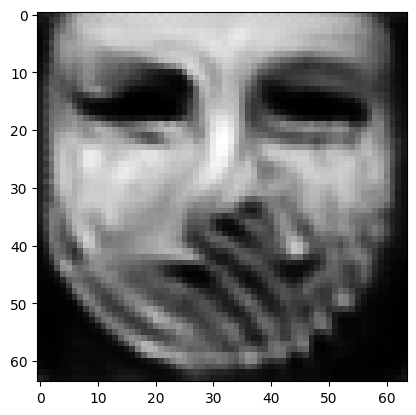

tensor([[2.2487e-04, 8.6196e-06, 9.6497e-01, 7.8645e-04, 3.6455e-04, 4.3894e-03,
         1.0454e-04, 2.9254e-03, 2.7350e-04, 4.7852e-04, 3.1463e-04, 7.2473e-04,
         1.7341e-04, 4.6057e-06, 1.4029e-06, 5.8249e-05, 6.6750e-04, 1.2942e-04,
         8.4579e-05, 4.7882e-04, 1.1211e-04, 1.0503e-04, 2.2872e-06, 4.1877e-05,
         9.9404e-05, 5.5432e-04, 3.4979e-05, 1.0216e-03, 1.0045e-02, 3.0966e-05,
         1.6778e-04, 4.2951e-06, 8.1890e-04, 3.5719e-04, 1.4536e-04, 1.4326e-06,
         1.3579e-04, 8.9718e-04, 6.0215e-03, 2.2450e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03566306456923485
tensor([[2.2366e-04, 8.5519e-06, 9.6520e-01, 7.8216e-04, 3.6155e-04, 4.3604e-03,
         1.0356e-04, 2.9032e-03, 2.7202e-04, 4.7669e-04, 3.1251e-04, 7.2324e-04,
         1.7260e-04, 4.5735e-06, 1.3956e-06, 5.7923e-05, 6.6427e-04, 1.2886e-04,
         8.4065e-05, 4.7700e-04, 1.1148e-04, 1.0448e-04, 2.2681e-06, 4.1622e-05,
         9.8436e-05, 5.5015e-04, 3.4653e-0

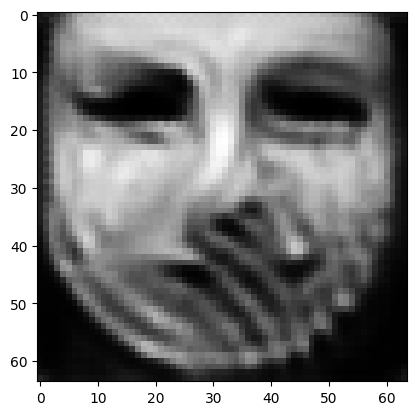

tensor([[2.1911e-04, 8.2982e-06, 9.6603e-01, 7.6695e-04, 3.5007e-04, 4.2477e-03,
         9.9755e-05, 2.8221e-03, 2.6740e-04, 4.7072e-04, 3.0466e-04, 7.1840e-04,
         1.6958e-04, 4.4549e-06, 1.3669e-06, 5.6555e-05, 6.5085e-04, 1.2632e-04,
         8.2113e-05, 4.7032e-04, 1.0893e-04, 1.0265e-04, 2.1965e-06, 4.0636e-05,
         9.4994e-05, 5.3668e-04, 3.3451e-05, 9.8607e-04, 9.7358e-03, 3.0007e-05,
         1.6414e-04, 4.1339e-06, 7.9233e-04, 3.4467e-04, 1.4185e-04, 1.3627e-06,
         1.3133e-04, 8.8102e-04, 5.8439e-03, 2.1564e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03455975279211998
tensor([[2.1813e-04, 8.2439e-06, 9.6622e-01, 7.6415e-04, 3.4760e-04, 4.2199e-03,
         9.8874e-05, 2.8037e-03, 2.6634e-04, 4.6915e-04, 3.0292e-04, 7.1708e-04,
         1.6891e-04, 4.4319e-06, 1.3607e-06, 5.6246e-05, 6.4812e-04, 1.2577e-04,
         8.1700e-05, 4.6858e-04, 1.0836e-04, 1.0222e-04, 2.1817e-06, 4.0436e-05,
         9.4283e-05, 5.3393e-04, 3.3172e-0

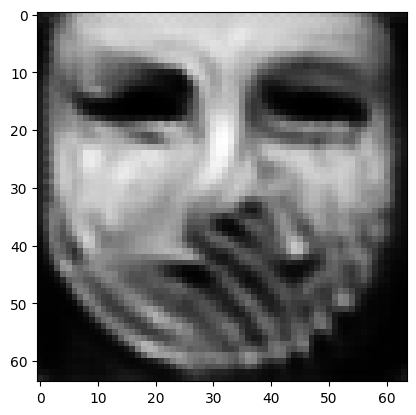

tensor([[2.1392e-04, 8.0394e-06, 9.6695e-01, 7.5186e-04, 3.3809e-04, 4.1170e-03,
         9.5596e-05, 2.7348e-03, 2.6252e-04, 4.6369e-04, 2.9578e-04, 7.1171e-04,
         1.6647e-04, 4.3319e-06, 1.3345e-06, 5.5065e-05, 6.3669e-04, 1.2324e-04,
         8.0135e-05, 4.6124e-04, 1.0611e-04, 1.0064e-04, 2.1236e-06, 3.9594e-05,
         9.1362e-05, 5.2298e-04, 3.2127e-05, 9.5689e-04, 9.4715e-03, 2.9216e-05,
         1.6124e-04, 3.9922e-06, 7.6833e-04, 3.3443e-04, 1.3878e-04, 1.3034e-06,
         1.2749e-04, 8.6559e-04, 5.6963e-03, 2.0792e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033609114587306976
tensor([[2.1292e-04, 7.9949e-06, 9.6712e-01, 7.4953e-04, 3.3590e-04, 4.0900e-03,
         9.4789e-05, 2.7195e-03, 2.6174e-04, 4.6276e-04, 2.9410e-04, 7.1035e-04,
         1.6581e-04, 4.3101e-06, 1.3283e-06, 5.4747e-05, 6.3364e-04, 1.2262e-04,
         7.9762e-05, 4.5950e-04, 1.0552e-04, 1.0028e-04, 2.1088e-06, 3.9388e-05,
         9.0763e-05, 5.2080e-04, 3.1878e-

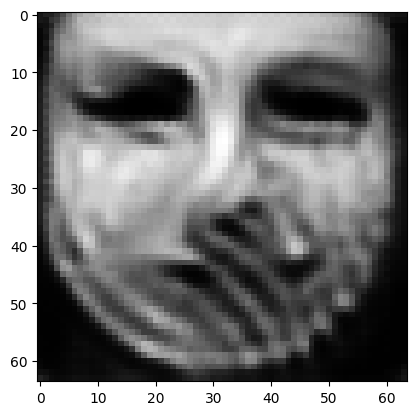

tensor([[2.0948e-04, 7.8389e-06, 9.6775e-01, 7.4333e-04, 3.2849e-04, 3.9832e-03,
         9.1840e-05, 2.6682e-03, 2.5864e-04, 4.5782e-04, 2.8810e-04, 7.0340e-04,
         1.6361e-04, 4.2461e-06, 1.3060e-06, 5.3549e-05, 6.2464e-04, 1.2039e-04,
         7.8388e-05, 4.5258e-04, 1.0329e-04, 9.8841e-05, 2.0615e-06, 3.8776e-05,
         8.9066e-05, 5.1390e-04, 3.0932e-05, 9.3522e-04, 9.2446e-03, 2.8550e-05,
         1.5946e-04, 3.8715e-06, 7.4783e-04, 3.2705e-04, 1.3601e-04, 1.2576e-06,
         1.2462e-04, 8.5459e-04, 5.5669e-03, 2.0036e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03278079256415367
tensor([[2.0879e-04, 7.8074e-06, 9.6790e-01, 7.4322e-04, 3.2688e-04, 3.9557e-03,
         9.1099e-05, 2.6554e-03, 2.5793e-04, 4.5632e-04, 2.8680e-04, 7.0149e-04,
         1.6303e-04, 4.2375e-06, 1.3012e-06, 5.3253e-05, 6.2271e-04, 1.1995e-04,
         7.8072e-05, 4.5087e-04, 1.0277e-04, 9.8442e-05, 2.0520e-06, 3.8654e-05,
         8.8824e-05, 5.1287e-04, 3.0705e-0

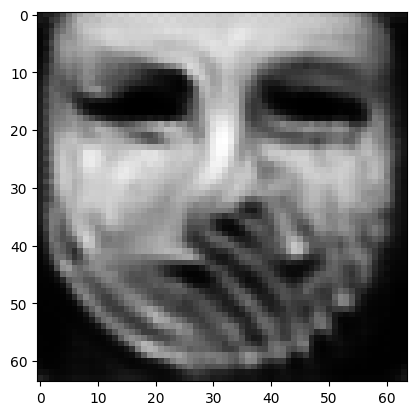

tensor([[2.0614e-04, 7.6769e-06, 9.6847e-01, 7.4088e-04, 3.2081e-04, 3.8479e-03,
         8.8382e-05, 2.6061e-03, 2.5532e-04, 4.5073e-04, 2.8172e-04, 6.9486e-04,
         1.6085e-04, 4.2027e-06, 1.2845e-06, 5.2123e-05, 6.1499e-04, 1.1825e-04,
         7.6840e-05, 4.4457e-04, 1.0090e-04, 9.7045e-05, 2.0162e-06, 3.8226e-05,
         8.7863e-05, 5.0876e-04, 2.9848e-05, 9.1670e-04, 9.0552e-03, 2.8070e-05,
         1.5851e-04, 3.7781e-06, 7.3116e-04, 3.2108e-04, 1.3395e-04, 1.2263e-06,
         1.2288e-04, 8.4930e-04, 5.4431e-03, 1.9314e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032042648643255234
tensor([[2.0554e-04, 7.6466e-06, 9.6860e-01, 7.4056e-04, 3.1941e-04, 3.8216e-03,
         8.7729e-05, 2.5943e-03, 2.5479e-04, 4.4934e-04, 2.8050e-04, 6.9322e-04,
         1.6036e-04, 4.1965e-06, 1.2810e-06, 5.1839e-05, 6.1315e-04, 1.1788e-04,
         7.6545e-05, 4.4316e-04, 1.0046e-04, 9.6704e-05, 2.0083e-06, 3.8134e-05,
         8.7712e-05, 5.0797e-04, 2.9643e-

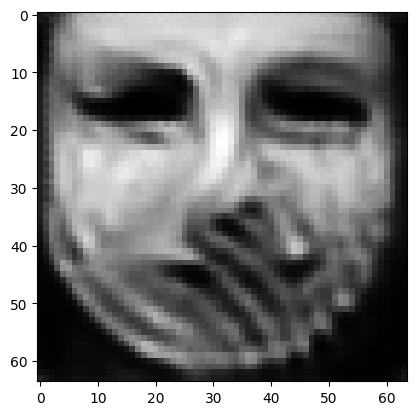

tensor([[2.0324e-04, 7.5257e-06, 9.6911e-01, 7.3763e-04, 3.1408e-04, 3.7266e-03,
         8.5359e-05, 2.5499e-03, 2.5239e-04, 4.4437e-04, 2.7594e-04, 6.8728e-04,
         1.5836e-04, 4.1652e-06, 1.2667e-06, 5.0837e-05, 6.0652e-04, 1.1649e-04,
         7.5392e-05, 4.3802e-04, 9.8793e-05, 9.5431e-05, 1.9747e-06, 3.7775e-05,
         8.6878e-05, 5.0395e-04, 2.8871e-05, 8.9975e-04, 8.8792e-03, 2.7629e-05,
         1.5752e-04, 3.6992e-06, 7.1698e-04, 3.1583e-04, 1.3226e-04, 1.1980e-06,
         1.2132e-04, 8.4476e-04, 5.3336e-03, 1.8662e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03137616440653801
tensor([[2.0290e-04, 7.4955e-06, 9.6923e-01, 7.3597e-04, 3.1317e-04, 3.7036e-03,
         8.4894e-05, 2.5400e-03, 2.5191e-04, 4.4323e-04, 2.7490e-04, 6.8605e-04,
         1.5805e-04, 4.1602e-06, 1.2658e-06, 5.0608e-05, 6.0496e-04, 1.1642e-04,
         7.5087e-05, 4.3764e-04, 9.8488e-05, 9.5142e-05, 1.9672e-06, 3.7726e-05,
         8.6795e-05, 5.0233e-04, 2.8708e-0

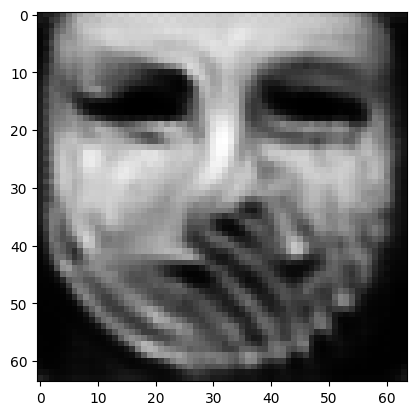

tensor([[2.0090e-04, 7.3869e-06, 9.6968e-01, 7.3064e-04, 3.0853e-04, 3.6258e-03,
         8.2947e-05, 2.4998e-03, 2.4967e-04, 4.3923e-04, 2.7088e-04, 6.8179e-04,
         1.5658e-04, 4.1287e-06, 1.2549e-06, 4.9787e-05, 5.9904e-04, 1.1543e-04,
         7.4020e-05, 4.3380e-04, 9.7141e-05, 9.4084e-05, 1.9370e-06, 3.7385e-05,
         8.5904e-05, 4.9718e-04, 2.8081e-05, 8.8438e-04, 8.7018e-03, 2.7207e-05,
         1.5612e-04, 3.6344e-06, 7.0657e-04, 3.1145e-04, 1.3083e-04, 1.1714e-06,
         1.1983e-04, 8.4058e-04, 5.2473e-03, 1.8118e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030784951522946358
tensor([[2.0034e-04, 7.3625e-06, 9.6979e-01, 7.2988e-04, 3.0731e-04, 3.6068e-03,
         8.2451e-05, 2.4898e-03, 2.4918e-04, 4.3822e-04, 2.6989e-04, 6.8062e-04,
         1.5622e-04, 4.1215e-06, 1.2516e-06, 4.9587e-05, 5.9769e-04, 1.1511e-04,
         7.3777e-05, 4.3255e-04, 9.6802e-05, 9.3827e-05, 1.9305e-06, 3.7293e-05,
         8.5673e-05, 4.9630e-04, 2.7925e-

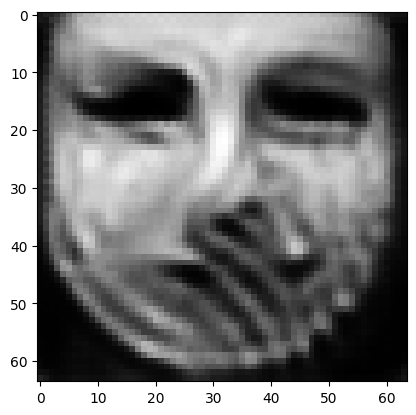

tensor([[1.9835e-04, 7.2461e-06, 9.7023e-01, 7.2125e-04, 3.0256e-04, 3.5460e-03,
         8.0858e-05, 2.4519e-03, 2.4671e-04, 4.3482e-04, 2.6618e-04, 6.7762e-04,
         1.5459e-04, 4.0715e-06, 1.2385e-06, 4.8880e-05, 5.9169e-04, 1.1437e-04,
         7.2719e-05, 4.2908e-04, 9.5516e-05, 9.2813e-05, 1.8965e-06, 3.6883e-05,
         8.4408e-05, 4.8926e-04, 2.7377e-05, 8.6849e-04, 8.5342e-03, 2.6741e-05,
         1.5422e-04, 3.5659e-06, 6.9598e-04, 3.0643e-04, 1.2932e-04, 1.1423e-06,
         1.1814e-04, 8.3628e-04, 5.1509e-03, 1.7668e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030222654342651367
tensor([[1.9784e-04, 7.2192e-06, 9.7034e-01, 7.2010e-04, 3.0135e-04, 3.5277e-03,
         8.0398e-05, 2.4421e-03, 2.4621e-04, 4.3379e-04, 2.6513e-04, 6.7645e-04,
         1.5422e-04, 4.0620e-06, 1.2351e-06, 4.8685e-05, 5.9038e-04, 1.1410e-04,
         7.2482e-05, 4.2792e-04, 9.5172e-05, 9.2543e-05, 1.8895e-06, 3.6794e-05,
         8.4173e-05, 4.8803e-04, 2.7220e-

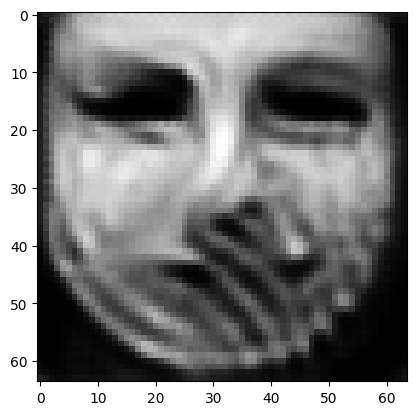

tensor([[1.9591e-04, 7.1036e-06, 9.7076e-01, 7.1254e-04, 2.9680e-04, 3.4625e-03,
         7.8796e-05, 2.4053e-03, 2.4387e-04, 4.3034e-04, 2.6127e-04, 6.7256e-04,
         1.5253e-04, 4.0155e-06, 1.2223e-06, 4.7973e-05, 5.8503e-04, 1.1330e-04,
         7.1486e-05, 4.2428e-04, 9.3876e-05, 9.1530e-05, 1.8569e-06, 3.6432e-05,
         8.3094e-05, 4.8188e-04, 2.6653e-05, 8.5310e-04, 8.3719e-03, 2.6308e-05,
         1.5242e-04, 3.4973e-06, 6.8511e-04, 3.0170e-04, 1.2792e-04, 1.1140e-06,
         1.1641e-04, 8.3247e-04, 5.0610e-03, 1.7203e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02967114932835102
tensor([[1.9539e-04, 7.0747e-06, 9.7087e-01, 7.1117e-04, 2.9553e-04, 3.4465e-03,
         7.8369e-05, 2.3966e-03, 2.4326e-04, 4.2952e-04, 2.6026e-04, 6.7142e-04,
         1.5203e-04, 4.0025e-06, 1.2181e-06, 4.7796e-05, 5.8377e-04, 1.1297e-04,
         7.1259e-05, 4.2306e-04, 9.3514e-05, 9.1274e-05, 1.8486e-06, 3.6339e-05,
         8.2799e-05, 4.8073e-04, 2.6503e-0

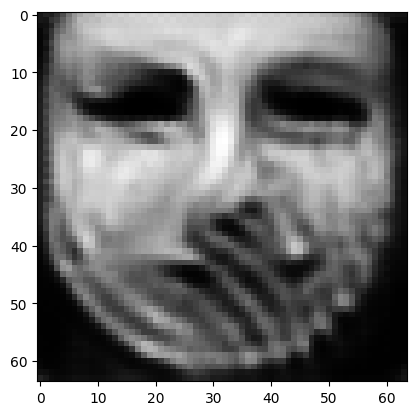

tensor([[1.9340e-04, 6.9572e-06, 9.7127e-01, 7.0251e-04, 2.9077e-04, 3.3916e-03,
         7.6961e-05, 2.3656e-03, 2.4023e-04, 4.2682e-04, 2.5685e-04, 6.6795e-04,
         1.4975e-04, 3.9442e-06, 1.2018e-06, 4.7188e-05, 5.7966e-04, 1.1203e-04,
         7.0346e-05, 4.1879e-04, 9.2179e-05, 9.0296e-05, 1.8131e-06, 3.5996e-05,
         8.1485e-05, 4.7479e-04, 2.5955e-05, 8.3789e-04, 8.2295e-03, 2.5881e-05,
         1.5036e-04, 3.4260e-06, 6.7407e-04, 2.9663e-04, 1.2620e-04, 1.0842e-06,
         1.1453e-04, 8.2770e-04, 4.9616e-03, 1.6767e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029151296243071556
tensor([[1.9291e-04, 6.9275e-06, 9.7137e-01, 7.0033e-04, 2.8969e-04, 3.3780e-03,
         7.6628e-05, 2.3587e-03, 2.3942e-04, 4.2611e-04, 2.5602e-04, 6.6686e-04,
         1.4917e-04, 3.9297e-06, 1.1973e-06, 4.7034e-05, 5.7878e-04, 1.1177e-04,
         7.0118e-05, 4.1769e-04, 9.1828e-05, 9.0049e-05, 1.8047e-06, 3.5921e-05,
         8.1196e-05, 4.7346e-04, 2.5816e-

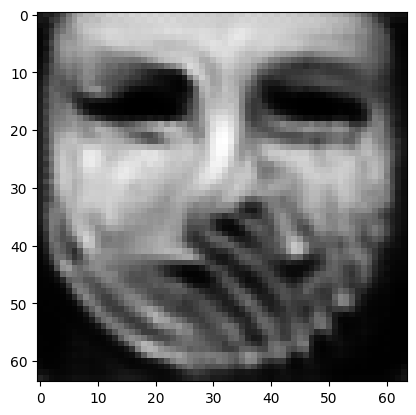

tensor([[1.9111e-04, 6.8170e-06, 9.7173e-01, 6.9266e-04, 2.8555e-04, 3.3274e-03,
         7.5280e-05, 2.3301e-03, 2.3623e-04, 4.2337e-04, 2.5262e-04, 6.6294e-04,
         1.4694e-04, 3.8737e-06, 1.1806e-06, 4.6500e-05, 5.7509e-04, 1.1072e-04,
         6.9316e-05, 4.1324e-04, 9.0539e-05, 8.9093e-05, 1.7733e-06, 3.5625e-05,
         7.9993e-05, 4.6850e-04, 2.5293e-05, 8.2397e-04, 8.1009e-03, 2.5463e-05,
         1.4838e-04, 3.3605e-06, 6.6330e-04, 2.9179e-04, 1.2450e-04, 1.0570e-06,
         1.1278e-04, 8.2225e-04, 4.8737e-03, 1.6344e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02867484651505947
tensor([[1.9064e-04, 6.7917e-06, 9.7182e-01, 6.9112e-04, 2.8452e-04, 3.3154e-03,
         7.4933e-05, 2.3234e-03, 2.3554e-04, 4.2267e-04, 2.5181e-04, 6.6191e-04,
         1.4645e-04, 3.8611e-06, 1.1764e-06, 4.6365e-05, 5.7424e-04, 1.1041e-04,
         6.9126e-05, 4.1209e-04, 9.0211e-05, 8.8860e-05, 1.7661e-06, 3.5552e-05,
         7.9714e-05, 4.6746e-04, 2.5164e-0

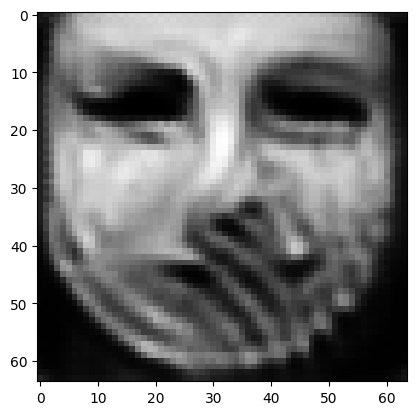

tensor([[1.8898e-04, 6.6954e-06, 9.7215e-01, 6.8603e-04, 2.8086e-04, 3.2667e-03,
         7.3587e-05, 2.2975e-03, 2.3283e-04, 4.1982e-04, 2.4862e-04, 6.5758e-04,
         1.4456e-04, 3.8163e-06, 1.1611e-06, 4.5848e-05, 5.7143e-04, 1.0933e-04,
         6.8420e-05, 4.0768e-04, 8.8990e-05, 8.7960e-05, 1.7394e-06, 3.5314e-05,
         7.8756e-05, 4.6382e-04, 2.4655e-05, 8.1207e-04, 7.9858e-03, 2.5102e-05,
         1.4702e-04, 3.3017e-06, 6.5288e-04, 2.8742e-04, 1.2303e-04, 1.0334e-06,
         1.1140e-04, 8.1707e-04, 4.7930e-03, 1.5942e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028241049498319626
tensor([[1.8856e-04, 6.6739e-06, 9.7223e-01, 6.8464e-04, 2.8002e-04, 3.2547e-03,
         7.3262e-05, 2.2905e-03, 2.3232e-04, 4.1915e-04, 2.4782e-04, 6.5672e-04,
         1.4421e-04, 3.8066e-06, 1.1583e-06, 4.5724e-05, 5.7044e-04, 1.0910e-04,
         6.8249e-05, 4.0679e-04, 8.8750e-05, 8.7758e-05, 1.7334e-06, 3.5249e-05,
         7.8530e-05, 4.6283e-04, 2.4543e-

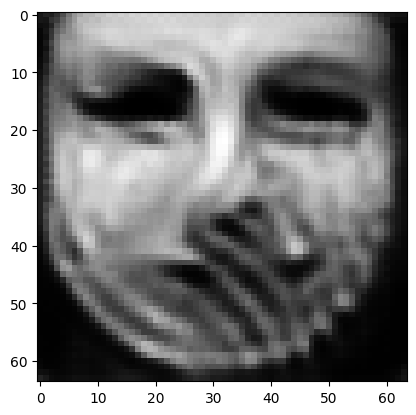

tensor([[1.8721e-04, 6.5732e-06, 9.7255e-01, 6.7826e-04, 2.7656e-04, 3.2136e-03,
         7.2156e-05, 2.2673e-03, 2.2939e-04, 4.1637e-04, 2.4487e-04, 6.5282e-04,
         1.4219e-04, 3.7557e-06, 1.1427e-06, 4.5265e-05, 5.6835e-04, 1.0822e-04,
         6.7526e-05, 4.0297e-04, 8.7608e-05, 8.6911e-05, 1.7065e-06, 3.5064e-05,
         7.7597e-05, 4.5897e-04, 2.4088e-05, 8.0062e-04, 7.8770e-03, 2.4736e-05,
         1.4542e-04, 3.2489e-06, 6.4390e-04, 2.8330e-04, 1.2178e-04, 1.0115e-06,
         1.1009e-04, 8.1285e-04, 4.7170e-03, 1.5573e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02783859893679619
tensor([[1.8683e-04, 6.5484e-06, 9.7262e-01, 6.7629e-04, 2.7574e-04, 3.2046e-03,
         7.1901e-05, 2.2614e-03, 2.2870e-04, 4.1568e-04, 2.4411e-04, 6.5200e-04,
         1.4174e-04, 3.7420e-06, 1.1389e-06, 4.5168e-05, 5.6779e-04, 1.0801e-04,
         6.7347e-05, 4.0210e-04, 8.7364e-05, 8.6705e-05, 1.7000e-06, 3.5016e-05,
         7.7339e-05, 4.5776e-04, 2.3980e-0

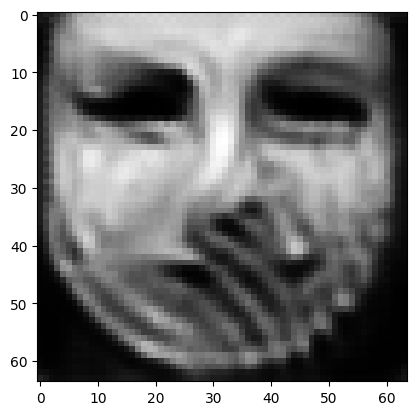

tensor([[1.8573e-04, 6.4564e-06, 9.7291e-01, 6.7045e-04, 2.7277e-04, 3.1651e-03,
         7.0892e-05, 2.2393e-03, 2.2633e-04, 4.1263e-04, 2.4130e-04, 6.4877e-04,
         1.4013e-04, 3.7012e-06, 1.1268e-06, 4.4752e-05, 5.6601e-04, 1.0738e-04,
         6.6658e-05, 3.9941e-04, 8.6458e-05, 8.5900e-05, 1.6780e-06, 3.4919e-05,
         7.6677e-05, 4.5395e-04, 2.3558e-05, 7.8912e-04, 7.7656e-03, 2.4380e-05,
         1.4369e-04, 3.2033e-06, 6.3630e-04, 2.7948e-04, 1.2085e-04, 9.9158e-07,
         1.0887e-04, 8.0950e-04, 4.6501e-03, 1.5221e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0274597629904747
tensor([[1.8541e-04, 6.4372e-06, 9.7298e-01, 6.6912e-04, 2.7209e-04, 3.1558e-03,
         7.0640e-05, 2.2336e-03, 2.2584e-04, 4.1188e-04, 2.4063e-04, 6.4811e-04,
         1.3983e-04, 3.6925e-06, 1.1242e-06, 4.4657e-05, 5.6542e-04, 1.0722e-04,
         6.6498e-05, 3.9873e-04, 8.6271e-05, 8.5711e-05, 1.6734e-06, 3.4886e-05,
         7.6508e-05, 4.5303e-04, 2.3461e-05

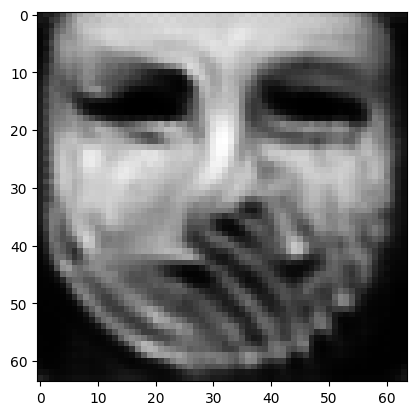

tensor([[1.8429e-04, 6.3520e-06, 9.7326e-01, 6.6378e-04, 2.6920e-04, 3.1188e-03,
         6.9633e-05, 2.2131e-03, 2.2343e-04, 4.0915e-04, 2.3813e-04, 6.4508e-04,
         1.3821e-04, 3.6540e-06, 1.1120e-06, 4.4256e-05, 5.6352e-04, 1.0652e-04,
         6.5854e-05, 3.9595e-04, 8.5338e-05, 8.4975e-05, 1.6519e-06, 3.4784e-05,
         7.5821e-05, 4.4976e-04, 2.3063e-05, 7.7895e-04, 7.6661e-03, 2.4042e-05,
         1.4219e-04, 3.1615e-06, 6.2886e-04, 2.7600e-04, 1.1988e-04, 9.7331e-07,
         1.0782e-04, 8.0648e-04, 4.5855e-03, 1.4890e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027108395472168922
tensor([[1.8400e-04, 6.3309e-06, 9.7332e-01, 6.6237e-04, 2.6847e-04, 3.1098e-03,
         6.9387e-05, 2.2085e-03, 2.2282e-04, 4.0854e-04, 2.3754e-04, 6.4430e-04,
         1.3781e-04, 3.6443e-06, 1.1089e-06, 4.4160e-05, 5.6310e-04, 1.0633e-04,
         6.5701e-05, 3.9525e-04, 8.5099e-05, 8.4799e-05, 1.6466e-06, 3.4762e-05,
         7.5640e-05, 4.4896e-04, 2.2962e-

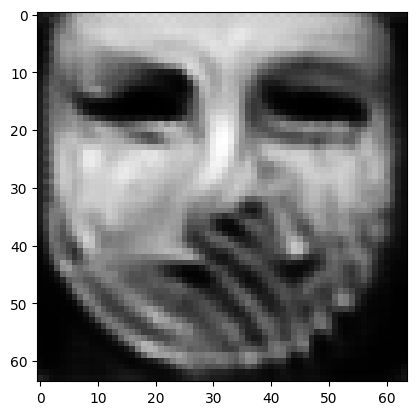

tensor([[1.8288e-04, 6.2495e-06, 9.7358e-01, 6.5663e-04, 2.6554e-04, 3.0757e-03,
         6.8420e-05, 2.1894e-03, 2.2035e-04, 4.0625e-04, 2.3522e-04, 6.4150e-04,
         1.3615e-04, 3.6039e-06, 1.0964e-06, 4.3782e-05, 5.6130e-04, 1.0559e-04,
         6.5096e-05, 3.9227e-04, 8.4154e-05, 8.4111e-05, 1.6247e-06, 3.4651e-05,
         7.4868e-05, 4.4574e-04, 2.2584e-05, 7.6966e-04, 7.5741e-03, 2.3696e-05,
         1.4069e-04, 3.1207e-06, 6.2127e-04, 2.7258e-04, 1.1878e-04, 9.5455e-07,
         1.0677e-04, 8.0332e-04, 4.5200e-03, 1.4571e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026771994307637215
tensor([[1.8261e-04, 6.2312e-06, 9.7364e-01, 6.5538e-04, 2.6481e-04, 3.0677e-03,
         6.8185e-05, 2.1852e-03, 2.1980e-04, 4.0572e-04, 2.3468e-04, 6.4081e-04,
         1.3578e-04, 3.5945e-06, 1.0934e-06, 4.3685e-05, 5.6074e-04, 1.0539e-04,
         6.4958e-05, 3.9150e-04, 8.3920e-05, 8.3951e-05, 1.6196e-06, 3.4616e-05,
         7.4677e-05, 4.4501e-04, 2.2498e-

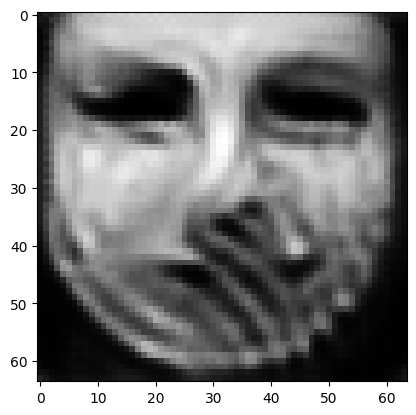

tensor([[1.8158e-04, 6.1622e-06, 9.7388e-01, 6.5062e-04, 2.6209e-04, 3.0363e-03,
         6.7257e-05, 2.1689e-03, 2.1772e-04, 4.0378e-04, 2.3261e-04, 6.3811e-04,
         1.3435e-04, 3.5592e-06, 1.0828e-06, 4.3323e-05, 5.5857e-04, 1.0466e-04,
         6.4439e-05, 3.8857e-04, 8.3043e-05, 8.3354e-05, 1.5996e-06, 3.4482e-05,
         7.3936e-05, 4.4222e-04, 2.2159e-05, 7.6183e-04, 7.4909e-03, 2.3377e-05,
         1.3942e-04, 3.0820e-06, 6.1398e-04, 2.6942e-04, 1.1767e-04, 9.3720e-07,
         1.0578e-04, 8.0024e-04, 4.4596e-03, 1.4290e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026466941460967064
tensor([[1.8133e-04, 6.1454e-06, 9.7394e-01, 6.4953e-04, 2.6142e-04, 3.0284e-03,
         6.7028e-05, 2.1653e-03, 2.1723e-04, 4.0328e-04, 2.3213e-04, 6.3742e-04,
         1.3400e-04, 3.5511e-06, 1.0801e-06, 4.3231e-05, 5.5807e-04, 1.0446e-04,
         6.4310e-05, 3.8786e-04, 8.2815e-05, 8.3212e-05, 1.5948e-06, 3.4453e-05,
         7.3767e-05, 4.4160e-04, 2.2074e-

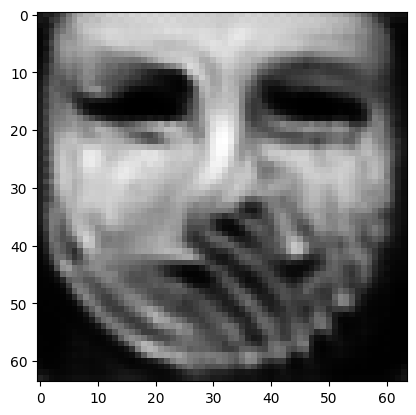

tensor([[1.8042e-04, 6.0777e-06, 9.7416e-01, 6.4483e-04, 2.5879e-04, 2.9983e-03,
         6.6166e-05, 2.1509e-03, 2.1525e-04, 4.0143e-04, 2.3024e-04, 6.3490e-04,
         1.3263e-04, 3.5172e-06, 1.0700e-06, 4.2889e-05, 5.5617e-04, 1.0378e-04,
         6.3801e-05, 3.8522e-04, 8.1984e-05, 8.2661e-05, 1.5756e-06, 3.4339e-05,
         7.3074e-05, 4.3888e-04, 2.1753e-05, 7.5458e-04, 7.4090e-03, 2.3072e-05,
         1.3829e-04, 3.0454e-06, 6.0746e-04, 2.6646e-04, 1.1659e-04, 9.2111e-07,
         1.0486e-04, 7.9754e-04, 4.4020e-03, 1.4019e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02617596462368965
tensor([[1.8024e-04, 6.0603e-06, 9.7422e-01, 6.4361e-04, 2.5816e-04, 2.9912e-03,
         6.5965e-05, 2.1474e-03, 2.1472e-04, 4.0098e-04, 2.2976e-04, 6.3418e-04,
         1.3226e-04, 3.5082e-06, 1.0675e-06, 4.2806e-05, 5.5573e-04, 1.0363e-04,
         6.3676e-05, 3.8459e-04, 8.1773e-05, 8.2520e-05, 1.5705e-06, 3.4309e-05,
         7.2903e-05, 4.3814e-04, 2.1678e-0

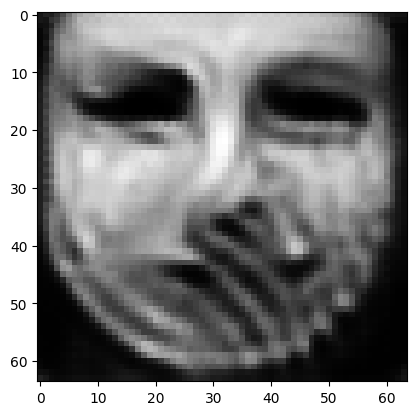

tensor([[1.7936e-04, 5.9958e-06, 9.7443e-01, 6.3927e-04, 2.5565e-04, 2.9638e-03,
         6.5160e-05, 2.1346e-03, 2.1278e-04, 3.9914e-04, 2.2795e-04, 6.3144e-04,
         1.3092e-04, 3.4743e-06, 1.0573e-06, 4.2483e-05, 5.5407e-04, 1.0296e-04,
         6.3202e-05, 3.8185e-04, 8.0962e-05, 8.1972e-05, 1.5520e-06, 3.4189e-05,
         7.2221e-05, 4.3546e-04, 2.1370e-05, 7.4772e-04, 7.3318e-03, 2.2778e-05,
         1.3714e-04, 3.0080e-06, 6.0095e-04, 2.6347e-04, 1.1557e-04, 9.0557e-07,
         1.0394e-04, 7.9486e-04, 4.3454e-03, 1.3766e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02589953877031803
tensor([[1.7915e-04, 5.9812e-06, 9.7448e-01, 6.3836e-04, 2.5503e-04, 2.9571e-03,
         6.4966e-05, 2.1312e-03, 2.1232e-04, 3.9868e-04, 2.2751e-04, 6.3080e-04,
         1.3061e-04, 3.4667e-06, 1.0548e-06, 4.2407e-05, 5.5367e-04, 1.0280e-04,
         6.3093e-05, 3.8115e-04, 8.0772e-05, 8.1841e-05, 1.5477e-06, 3.4157e-05,
         7.2053e-05, 4.3487e-04, 2.1300e-0

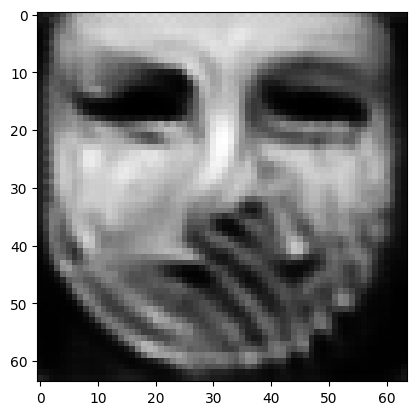

tensor([[1.7827e-04, 5.9233e-06, 9.7468e-01, 6.3449e-04, 2.5265e-04, 2.9316e-03,
         6.4210e-05, 2.1181e-03, 2.1058e-04, 3.9689e-04, 2.2578e-04, 6.2840e-04,
         1.2945e-04, 3.4362e-06, 1.0455e-06, 4.2120e-05, 5.5199e-04, 1.0215e-04,
         6.2658e-05, 3.7852e-04, 8.0063e-05, 8.1332e-05, 1.5313e-06, 3.4033e-05,
         7.1396e-05, 4.3237e-04, 2.1024e-05, 7.4115e-04, 7.2617e-03, 2.2513e-05,
         1.3613e-04, 2.9725e-06, 5.9485e-04, 2.6072e-04, 1.1464e-04, 8.9119e-07,
         1.0307e-04, 7.9231e-04, 4.2928e-03, 1.3541e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025643717497587204
tensor([[1.7806e-04, 5.9098e-06, 9.7473e-01, 6.3365e-04, 2.5207e-04, 2.9252e-03,
         6.4029e-05, 2.1148e-03, 2.1017e-04, 3.9642e-04, 2.2536e-04, 6.2781e-04,
         1.2918e-04, 3.4293e-06, 1.0433e-06, 4.2052e-05, 5.5162e-04, 1.0199e-04,
         6.2556e-05, 3.7785e-04, 7.9900e-05, 8.1205e-05, 1.5275e-06, 3.4004e-05,
         7.1240e-05, 4.3178e-04, 2.0957e-

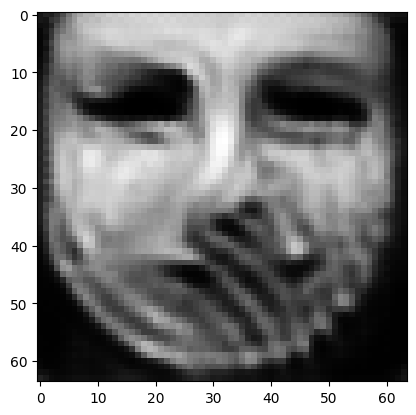

tensor([[1.7726e-04, 5.8591e-06, 9.7492e-01, 6.3063e-04, 2.4986e-04, 2.8999e-03,
         6.3329e-05, 2.1021e-03, 2.0861e-04, 3.9456e-04, 2.2376e-04, 6.2540e-04,
         1.2812e-04, 3.4040e-06, 1.0349e-06, 4.1787e-05, 5.5021e-04, 1.0142e-04,
         6.2166e-05, 3.7524e-04, 7.9250e-05, 8.0710e-05, 1.5134e-06, 3.3892e-05,
         7.0666e-05, 4.2957e-04, 2.0704e-05, 7.3516e-04, 7.1959e-03, 2.2279e-05,
         1.3527e-04, 2.9386e-06, 5.8899e-04, 2.5813e-04, 1.1381e-04, 8.7827e-07,
         1.0227e-04, 7.9025e-04, 4.2435e-03, 1.3331e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02540328912436962
tensor([[1.7706e-04, 5.8466e-06, 9.7496e-01, 6.2986e-04, 2.4931e-04, 2.8938e-03,
         6.3160e-05, 2.0991e-03, 2.0824e-04, 3.9410e-04, 2.2338e-04, 6.2482e-04,
         1.2787e-04, 3.3979e-06, 1.0329e-06, 4.1722e-05, 5.4986e-04, 1.0128e-04,
         6.2069e-05, 3.7462e-04, 7.9094e-05, 8.0591e-05, 1.5100e-06, 3.3864e-05,
         7.0524e-05, 4.2901e-04, 2.0641e-0

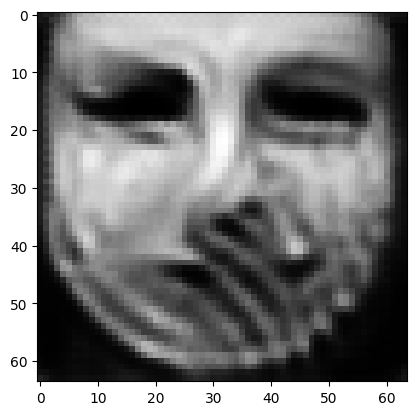

tensor([[1.7629e-04, 5.7945e-06, 9.7514e-01, 6.2674e-04, 2.4721e-04, 2.8701e-03,
         6.2509e-05, 2.0872e-03, 2.0676e-04, 3.9230e-04, 2.2181e-04, 6.2249e-04,
         1.2683e-04, 3.3710e-06, 1.0244e-06, 4.1461e-05, 5.4846e-04, 1.0073e-04,
         6.1674e-05, 3.7213e-04, 7.8465e-05, 8.0112e-05, 1.4959e-06, 3.3759e-05,
         6.9994e-05, 4.2687e-04, 2.0399e-05, 7.2932e-04, 7.1310e-03, 2.2048e-05,
         1.3444e-04, 2.9056e-06, 5.8357e-04, 2.5563e-04, 1.1303e-04, 8.6607e-07,
         1.0149e-04, 7.8834e-04, 4.1966e-03, 1.3133e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025172684341669083
tensor([[1.7607e-04, 5.7812e-06, 9.7519e-01, 6.2591e-04, 2.4669e-04, 2.8642e-03,
         6.2343e-05, 2.0842e-03, 2.0642e-04, 3.9185e-04, 2.2141e-04, 6.2193e-04,
         1.2660e-04, 3.3639e-06, 1.0222e-06, 4.1396e-05, 5.4806e-04, 1.0058e-04,
         6.1573e-05, 3.7149e-04, 7.8316e-05, 7.9994e-05, 1.4924e-06, 3.3731e-05,
         6.9859e-05, 4.2632e-04, 2.0337e-

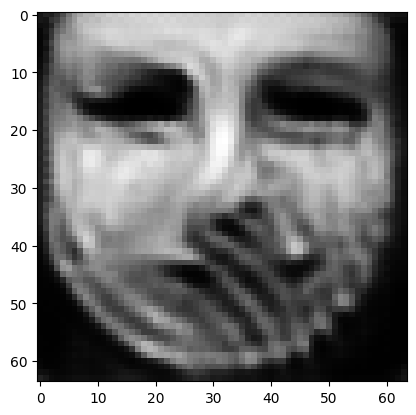

tensor([[1.7515e-04, 5.7386e-06, 9.7536e-01, 6.2341e-04, 2.4461e-04, 2.8389e-03,
         6.1637e-05, 2.0687e-03, 2.0526e-04, 3.8996e-04, 2.1994e-04, 6.1999e-04,
         1.2576e-04, 3.3446e-06, 1.0151e-06, 4.1150e-05, 5.4650e-04, 1.0003e-04,
         6.1199e-05, 3.6901e-04, 7.7801e-05, 7.9530e-05, 1.4812e-06, 3.3607e-05,
         6.9381e-05, 4.2449e-04, 2.0109e-05, 7.2332e-04, 7.0693e-03, 2.1857e-05,
         1.3389e-04, 2.8739e-06, 5.7848e-04, 2.5339e-04, 1.1237e-04, 8.5464e-07,
         1.0080e-04, 7.8627e-04, 4.1514e-03, 1.2954e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02494621090590954
tensor([[1.7488e-04, 5.7297e-06, 9.7541e-01, 6.2277e-04, 2.4408e-04, 2.8326e-03,
         6.1452e-05, 2.0640e-03, 2.0503e-04, 3.8948e-04, 2.1958e-04, 6.1964e-04,
         1.2560e-04, 3.3407e-06, 1.0136e-06, 4.1092e-05, 5.4597e-04, 9.9898e-05,
         6.1109e-05, 3.6840e-04, 7.7700e-05, 7.9418e-05, 1.4788e-06, 3.3564e-05,
         6.9253e-05, 4.2400e-04, 2.0057e-0

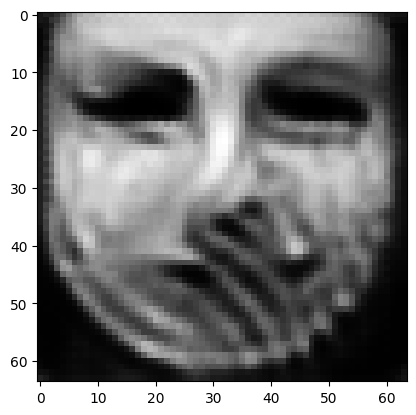

tensor([[1.7387e-04, 5.6961e-06, 9.7557e-01, 6.2048e-04, 2.4206e-04, 2.8086e-03,
         6.0748e-05, 2.0464e-03, 2.0409e-04, 3.8770e-04, 2.1821e-04, 6.1822e-04,
         1.2492e-04, 3.3260e-06, 1.0076e-06, 4.0869e-05, 5.4409e-04, 9.9380e-05,
         6.0768e-05, 3.6599e-04, 7.7280e-05, 7.8983e-05, 1.4695e-06, 3.3405e-05,
         6.8766e-05, 4.2226e-04, 1.9859e-05, 7.1717e-04, 7.0149e-03, 2.1708e-05,
         1.3349e-04, 2.8447e-06, 5.7370e-04, 2.5142e-04, 1.1183e-04, 8.4421e-07,
         1.0021e-04, 7.8430e-04, 4.1059e-03, 1.2808e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024730967357754707
tensor([[1.7362e-04, 5.6888e-06, 9.7561e-01, 6.1990e-04, 2.4158e-04, 2.8029e-03,
         6.0582e-05, 2.0423e-03, 2.0388e-04, 3.8729e-04, 2.1790e-04, 6.1791e-04,
         1.2478e-04, 3.3227e-06, 1.0062e-06, 4.0817e-05, 5.4360e-04, 9.9253e-05,
         6.0688e-05, 3.6542e-04, 7.7185e-05, 7.8883e-05, 1.4674e-06, 3.3365e-05,
         6.8644e-05, 4.2181e-04, 1.9812e-

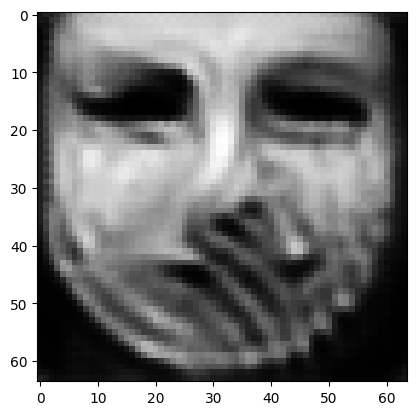

tensor([[1.7267e-04, 5.6584e-06, 9.7576e-01, 6.1738e-04, 2.3971e-04, 2.7816e-03,
         5.9958e-05, 2.0266e-03, 2.0293e-04, 3.8578e-04, 2.1672e-04, 6.1676e-04,
         1.2413e-04, 3.3081e-06, 1.0005e-06, 4.0623e-05, 5.4183e-04, 9.8780e-05,
         6.0371e-05, 3.6319e-04, 7.6794e-05, 7.8493e-05, 1.4586e-06, 3.3208e-05,
         6.8147e-05, 4.2006e-04, 1.9637e-05, 7.1158e-04, 6.9647e-03, 2.1566e-05,
         1.3309e-04, 2.8178e-06, 5.6935e-04, 2.4963e-04, 1.1128e-04, 8.3441e-07,
         9.9647e-05, 7.8238e-04, 4.0639e-03, 1.2680e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024534057825803757
tensor([[1.7244e-04, 5.6516e-06, 9.7580e-01, 6.1682e-04, 2.3928e-04, 2.7763e-03,
         5.9808e-05, 2.0227e-03, 2.0271e-04, 3.8541e-04, 2.1643e-04, 6.1645e-04,
         1.2399e-04, 3.3053e-06, 9.9921e-07, 4.0575e-05, 5.4141e-04, 9.8674e-05,
         6.0297e-05, 3.6268e-04, 7.6702e-05, 7.8399e-05, 1.4566e-06, 3.3171e-05,
         6.8037e-05, 4.1965e-04, 1.9596e-

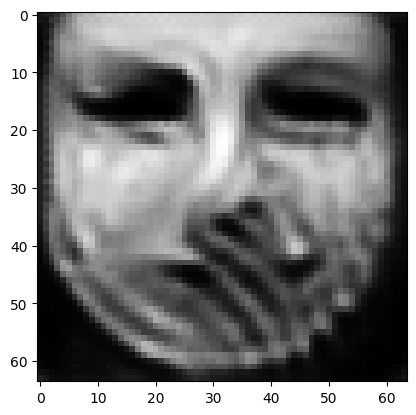

tensor([[1.7159e-04, 5.6244e-06, 9.7594e-01, 6.1474e-04, 2.3773e-04, 2.7551e-03,
         5.9242e-05, 2.0084e-03, 2.0181e-04, 3.8390e-04, 2.1536e-04, 6.1506e-04,
         1.2340e-04, 3.2948e-06, 9.9435e-07, 4.0388e-05, 5.3998e-04, 9.8280e-05,
         6.0009e-05, 3.6071e-04, 7.6339e-05, 7.8023e-05, 1.4491e-06, 3.3045e-05,
         6.7663e-05, 4.1817e-04, 1.9433e-05, 7.0682e-04, 6.9185e-03, 2.1444e-05,
         1.3277e-04, 2.7942e-06, 5.6544e-04, 2.4810e-04, 1.1079e-04, 8.2615e-07,
         9.9208e-05, 7.8084e-04, 4.0261e-03, 1.2556e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024353278800845146
tensor([[1.7140e-04, 5.6180e-06, 9.7597e-01, 6.1434e-04, 2.3738e-04, 2.7497e-03,
         5.9104e-05, 2.0051e-03, 2.0160e-04, 3.8354e-04, 2.1510e-04, 6.1468e-04,
         1.2326e-04, 3.2926e-06, 9.9324e-07, 4.0339e-05, 5.3967e-04, 9.8188e-05,
         5.9942e-05, 3.6023e-04, 7.6249e-05, 7.7932e-05, 1.4474e-06, 3.3019e-05,
         6.7588e-05, 4.1788e-04, 1.9393e-

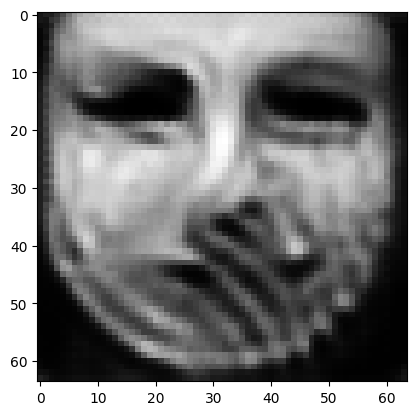

tensor([[1.7066e-04, 5.5914e-06, 9.7610e-01, 6.1244e-04, 2.3603e-04, 2.7300e-03,
         5.8596e-05, 1.9927e-03, 2.0076e-04, 3.8217e-04, 2.1413e-04, 6.1329e-04,
         1.2269e-04, 3.2824e-06, 9.8882e-07, 4.0159e-05, 5.3836e-04, 9.7838e-05,
         5.9672e-05, 3.5847e-04, 7.5898e-05, 7.7589e-05, 1.4401e-06, 3.2910e-05,
         6.7268e-05, 4.1658e-04, 1.9239e-05, 7.0275e-04, 6.8763e-03, 2.1328e-05,
         1.3250e-04, 2.7734e-06, 5.6184e-04, 2.4671e-04, 1.1032e-04, 8.1901e-07,
         9.8841e-05, 7.7954e-04, 3.9919e-03, 1.2435e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024188295006752014
tensor([[1.7048e-04, 5.5849e-06, 9.7613e-01, 6.1199e-04, 2.3571e-04, 2.7253e-03,
         5.8474e-05, 1.9898e-03, 2.0056e-04, 3.8184e-04, 2.1390e-04, 6.1294e-04,
         1.2255e-04, 3.2798e-06, 9.8771e-07, 4.0115e-05, 5.3805e-04, 9.7752e-05,
         5.9606e-05, 3.5805e-04, 7.5810e-05, 7.7506e-05, 1.4384e-06, 3.2884e-05,
         6.7193e-05, 4.1627e-04, 1.9202e-

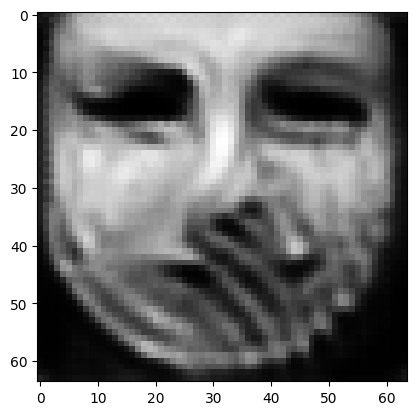

tensor([[1.6981e-04, 5.5602e-06, 9.7625e-01, 6.1031e-04, 2.3449e-04, 2.7071e-03,
         5.8005e-05, 1.9785e-03, 1.9979e-04, 3.8053e-04, 2.1300e-04, 6.1160e-04,
         1.2203e-04, 3.2705e-06, 9.8357e-07, 3.9945e-05, 5.3684e-04, 9.7431e-05,
         5.9357e-05, 3.5642e-04, 7.5475e-05, 7.7188e-05, 1.4317e-06, 3.2785e-05,
         6.6908e-05, 4.1506e-04, 1.9060e-05, 6.9906e-04, 6.8363e-03, 2.1214e-05,
         1.3225e-04, 2.7544e-06, 5.5851e-04, 2.4541e-04, 1.0988e-04, 8.1244e-07,
         9.8509e-05, 7.7838e-04, 3.9603e-03, 1.2322e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024035152047872543
tensor([[1.6964e-04, 5.5544e-06, 9.7628e-01, 6.0991e-04, 2.3419e-04, 2.7026e-03,
         5.7891e-05, 1.9758e-03, 1.9963e-04, 3.8020e-04, 2.1278e-04, 6.1128e-04,
         1.2192e-04, 3.2684e-06, 9.8262e-07, 3.9903e-05, 5.3653e-04, 9.7352e-05,
         5.9297e-05, 3.5604e-04, 7.5401e-05, 7.7112e-05, 1.4303e-06, 3.2761e-05,
         6.6843e-05, 4.1476e-04, 1.9025e-

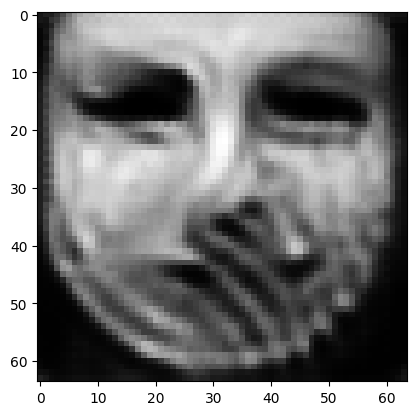

tensor([[1.6900e-04, 5.5317e-06, 9.7639e-01, 6.0838e-04, 2.3305e-04, 2.6854e-03,
         5.7454e-05, 1.9653e-03, 1.9892e-04, 3.7895e-04, 2.1194e-04, 6.0997e-04,
         1.2145e-04, 3.2598e-06, 9.7881e-07, 3.9744e-05, 5.3545e-04, 9.7050e-05,
         5.9067e-05, 3.5448e-04, 7.5090e-05, 7.6814e-05, 1.4242e-06, 3.2670e-05,
         6.6581e-05, 4.1365e-04, 1.8891e-05, 6.9564e-04, 6.7982e-03, 2.1111e-05,
         1.3203e-04, 2.7365e-06, 5.5540e-04, 2.4420e-04, 1.0947e-04, 8.0627e-07,
         9.8191e-05, 7.7718e-04, 3.9317e-03, 1.2216e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023891881108283997
tensor([[1.6884e-04, 5.5261e-06, 9.7642e-01, 6.0799e-04, 2.3276e-04, 2.6813e-03,
         5.7347e-05, 1.9628e-03, 1.9875e-04, 3.7865e-04, 2.1173e-04, 6.0969e-04,
         1.2132e-04, 3.2575e-06, 9.7788e-07, 3.9706e-05, 5.3516e-04, 9.6974e-05,
         5.9011e-05, 3.5409e-04, 7.5014e-05, 7.6743e-05, 1.4226e-06, 3.2647e-05,
         6.6511e-05, 4.1337e-04, 1.8858e-

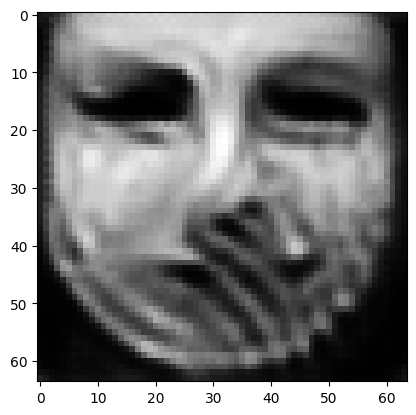

tensor([[1.6822e-04, 5.5048e-06, 9.7652e-01, 6.0638e-04, 2.3165e-04, 2.6659e-03,
         5.6950e-05, 1.9530e-03, 1.9803e-04, 3.7755e-04, 2.1096e-04, 6.0867e-04,
         1.2084e-04, 3.2483e-06, 9.7410e-07, 3.9568e-05, 5.3411e-04, 9.6679e-05,
         5.8801e-05, 3.5257e-04, 7.4722e-05, 7.6478e-05, 1.4167e-06, 3.2556e-05,
         6.6219e-05, 4.1228e-04, 1.8737e-05, 6.9238e-04, 6.7642e-03, 2.1008e-05,
         1.3177e-04, 2.7198e-06, 5.5237e-04, 2.4303e-04, 1.0906e-04, 8.0031e-07,
         9.7878e-05, 7.7607e-04, 3.9037e-03, 1.2120e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02375894784927368
tensor([[1.6806e-04, 5.5000e-06, 9.7655e-01, 6.0598e-04, 2.3137e-04, 2.6622e-03,
         5.6852e-05, 1.9506e-03, 1.9788e-04, 3.7727e-04, 2.1078e-04, 6.0844e-04,
         1.2075e-04, 3.2463e-06, 9.7324e-07, 3.9535e-05, 5.3382e-04, 9.6605e-05,
         5.8750e-05, 3.5221e-04, 7.4658e-05, 7.6414e-05, 1.4153e-06, 3.2532e-05,
         6.6148e-05, 4.1200e-04, 1.8708e-0

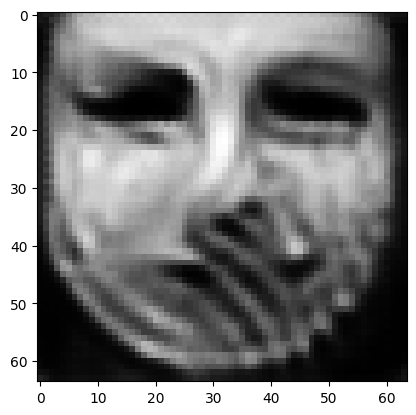

tensor([[1.6747e-04, 5.4785e-06, 9.7664e-01, 6.0436e-04, 2.3031e-04, 2.6475e-03,
         5.6480e-05, 1.9417e-03, 1.9719e-04, 3.7625e-04, 2.1004e-04, 6.0739e-04,
         1.2027e-04, 3.2368e-06, 9.6951e-07, 3.9404e-05, 5.3291e-04, 9.6296e-05,
         5.8553e-05, 3.5073e-04, 7.4366e-05, 7.6168e-05, 1.4094e-06, 3.2453e-05,
         6.5862e-05, 4.1099e-04, 1.8586e-05, 6.8931e-04, 6.7310e-03, 2.0909e-05,
         1.3152e-04, 2.7033e-06, 5.4947e-04, 2.4197e-04, 1.0864e-04, 7.9441e-07,
         9.7548e-05, 7.7470e-04, 3.8785e-03, 1.2028e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023633217439055443
tensor([[1.6731e-04, 5.4728e-06, 9.7667e-01, 6.0392e-04, 2.3004e-04, 2.6436e-03,
         5.6388e-05, 1.9397e-03, 1.9702e-04, 3.7600e-04, 2.0986e-04, 6.0712e-04,
         1.2015e-04, 3.2342e-06, 9.6854e-07, 3.9372e-05, 5.3269e-04, 9.6208e-05,
         5.8505e-05, 3.5035e-04, 7.4290e-05, 7.6111e-05, 1.4079e-06, 3.2434e-05,
         6.5789e-05, 4.1076e-04, 1.8554e-

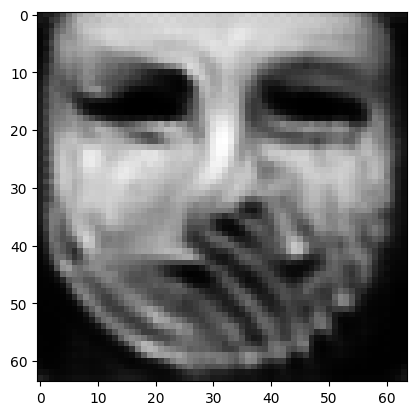

tensor([[1.6675e-04, 5.4513e-06, 9.7676e-01, 6.0218e-04, 2.2903e-04, 2.6293e-03,
         5.6041e-05, 1.9318e-03, 1.9636e-04, 3.7505e-04, 2.0916e-04, 6.0606e-04,
         1.1971e-04, 3.2244e-06, 9.6496e-07, 3.9250e-05, 5.3185e-04, 9.5890e-05,
         5.8316e-05, 3.4896e-04, 7.4005e-05, 7.5891e-05, 1.4021e-06, 3.2364e-05,
         6.5509e-05, 4.0974e-04, 1.8435e-05, 6.8643e-04, 6.6972e-03, 2.0808e-05,
         1.3128e-04, 2.6865e-06, 5.4666e-04, 2.4102e-04, 1.0818e-04, 7.8838e-07,
         9.7181e-05, 7.7306e-04, 3.8567e-03, 1.1938e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0235129427164793
tensor([[1.6663e-04, 5.4461e-06, 9.7678e-01, 6.0177e-04, 2.2879e-04, 2.6258e-03,
         5.5958e-05, 1.9300e-03, 1.9621e-04, 3.7482e-04, 2.0900e-04, 6.0579e-04,
         1.1961e-04, 3.2221e-06, 9.6416e-07, 3.9220e-05, 5.3164e-04, 9.5817e-05,
         5.8270e-05, 3.4864e-04, 7.3936e-05, 7.5838e-05, 1.4008e-06, 3.2349e-05,
         6.5448e-05, 4.0949e-04, 1.8406e-05

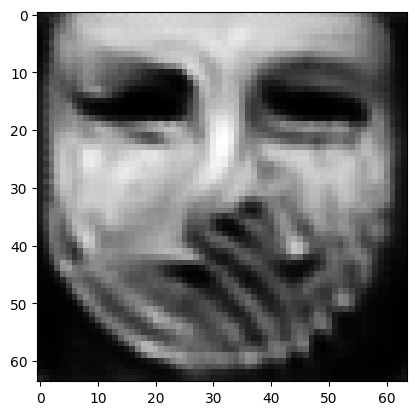

tensor([[1.6612e-04, 5.4265e-06, 9.7687e-01, 6.0014e-04, 2.2787e-04, 2.6124e-03,
         5.5634e-05, 1.9225e-03, 1.9564e-04, 3.7389e-04, 2.0832e-04, 6.0478e-04,
         1.1924e-04, 3.2132e-06, 9.6103e-07, 3.9103e-05, 5.3073e-04, 9.5535e-05,
         5.8087e-05, 3.4740e-04, 7.3680e-05, 7.5625e-05, 1.3956e-06, 3.2279e-05,
         6.5197e-05, 4.0845e-04, 1.8300e-05, 6.8374e-04, 6.6640e-03, 2.0712e-05,
         1.3104e-04, 2.6708e-06, 5.4413e-04, 2.4015e-04, 1.0777e-04, 7.8288e-07,
         9.6829e-05, 7.7156e-04, 3.8370e-03, 1.1856e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02339964173734188
tensor([[1.6599e-04, 5.4218e-06, 9.7689e-01, 5.9975e-04, 2.2765e-04, 2.6092e-03,
         5.5555e-05, 1.9207e-03, 1.9550e-04, 3.7366e-04, 2.0816e-04, 6.0453e-04,
         1.1915e-04, 3.2111e-06, 9.6025e-07, 3.9074e-05, 5.3051e-04, 9.5466e-05,
         5.8042e-05, 3.4710e-04, 7.3617e-05, 7.5574e-05, 1.3943e-06, 3.2261e-05,
         6.5136e-05, 4.0820e-04, 1.8274e-0

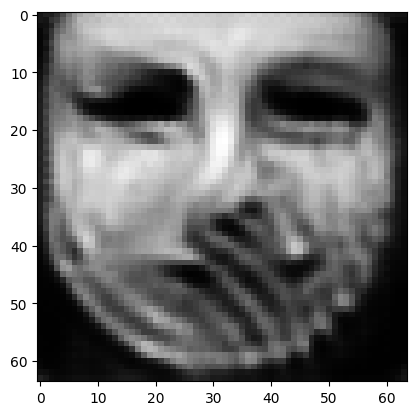

tensor([[1.6551e-04, 5.4037e-06, 9.7698e-01, 5.9827e-04, 2.2678e-04, 2.5966e-03,
         5.5247e-05, 1.9136e-03, 1.9497e-04, 3.7277e-04, 2.0751e-04, 6.0354e-04,
         1.1881e-04, 3.2028e-06, 9.5731e-07, 3.8963e-05, 5.2966e-04, 9.5199e-05,
         5.7870e-05, 3.4592e-04, 7.3375e-05, 7.5370e-05, 1.3895e-06, 3.2194e-05,
         6.4904e-05, 4.0721e-04, 1.8173e-05, 6.8117e-04, 6.6327e-03, 2.0623e-05,
         1.3082e-04, 2.6557e-06, 5.4170e-04, 2.3932e-04, 1.0740e-04, 7.7768e-07,
         9.6493e-05, 7.7012e-04, 3.8183e-03, 1.1778e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023292500525712967
tensor([[1.6539e-04, 5.3992e-06, 9.7700e-01, 5.9791e-04, 2.2657e-04, 2.5936e-03,
         5.5173e-05, 1.9119e-03, 1.9484e-04, 3.7256e-04, 2.0735e-04, 6.0330e-04,
         1.1873e-04, 3.2007e-06, 9.5659e-07, 3.8935e-05, 5.2944e-04, 9.5133e-05,
         5.7828e-05, 3.4564e-04, 7.3315e-05, 7.5322e-05, 1.3883e-06, 3.2177e-05,
         6.4846e-05, 4.0697e-04, 1.8149e-

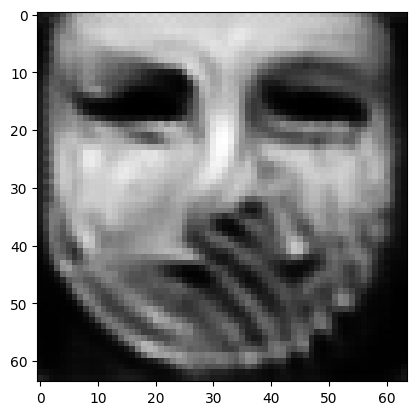

tensor([[1.6493e-04, 5.3822e-06, 9.7707e-01, 5.9650e-04, 2.2574e-04, 2.5817e-03,
         5.4882e-05, 1.9053e-03, 1.9436e-04, 3.7173e-04, 2.0674e-04, 6.0240e-04,
         1.1841e-04, 3.1929e-06, 9.5384e-07, 3.8829e-05, 5.2858e-04, 9.4877e-05,
         5.7667e-05, 3.4454e-04, 7.3087e-05, 7.5134e-05, 1.3837e-06, 3.2111e-05,
         6.4624e-05, 4.0604e-04, 1.8056e-05, 6.7873e-04, 6.6034e-03, 2.0539e-05,
         1.3061e-04, 2.6416e-06, 5.3943e-04, 2.3854e-04, 1.0704e-04, 7.7279e-07,
         9.6171e-05, 7.6878e-04, 3.8009e-03, 1.1707e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02319221757352352
tensor([[1.6482e-04, 5.3780e-06, 9.7709e-01, 5.9615e-04, 2.2555e-04, 2.5788e-03,
         5.4813e-05, 1.9037e-03, 1.9425e-04, 3.7152e-04, 2.0659e-04, 6.0215e-04,
         1.1834e-04, 3.1910e-06, 9.5321e-07, 3.8804e-05, 5.2836e-04, 9.4818e-05,
         5.7627e-05, 3.4429e-04, 7.3035e-05, 7.5089e-05, 1.3826e-06, 3.2095e-05,
         6.4574e-05, 4.0580e-04, 1.8034e-0

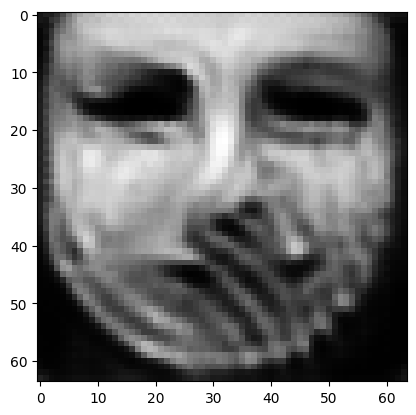

tensor([[1.6438e-04, 5.3622e-06, 9.7717e-01, 5.9473e-04, 2.2481e-04, 2.5677e-03,
         5.4545e-05, 1.8973e-03, 1.9382e-04, 3.7071e-04, 2.0601e-04, 6.0125e-04,
         1.1807e-04, 3.1839e-06, 9.5076e-07, 3.8708e-05, 5.2749e-04, 9.4588e-05,
         5.7473e-05, 3.4330e-04, 7.2834e-05, 7.4914e-05, 1.3785e-06, 3.2027e-05,
         6.4364e-05, 4.0482e-04, 1.7950e-05, 6.7642e-04, 6.5750e-03, 2.0461e-05,
         1.3041e-04, 2.6281e-06, 5.3736e-04, 2.3784e-04, 1.0672e-04, 7.6824e-07,
         9.5866e-05, 7.6743e-04, 3.7851e-03, 1.1642e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023097751662135124
tensor([[1.6428e-04, 5.3584e-06, 9.7718e-01, 5.9439e-04, 2.2464e-04, 2.5651e-03,
         5.4481e-05, 1.8958e-03, 1.9371e-04, 3.7052e-04, 2.0587e-04, 6.0103e-04,
         1.1800e-04, 3.1822e-06, 9.5018e-07, 3.8685e-05, 5.2730e-04, 9.4534e-05,
         5.7436e-05, 3.4306e-04, 7.2786e-05, 7.4871e-05, 1.3775e-06, 3.2011e-05,
         6.4314e-05, 4.0458e-04, 1.7930e-

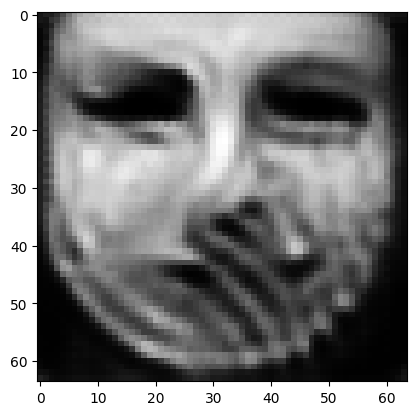

tensor([[1.6388e-04, 5.3434e-06, 9.7725e-01, 5.9299e-04, 2.2395e-04, 2.5552e-03,
         5.4238e-05, 1.8898e-03, 1.9331e-04, 3.6976e-04, 2.0534e-04, 6.0024e-04,
         1.1775e-04, 3.1750e-06, 9.4785e-07, 3.8598e-05, 5.2649e-04, 9.4324e-05,
         5.7293e-05, 3.4214e-04, 7.2604e-05, 7.4709e-05, 1.3736e-06, 3.1947e-05,
         6.4111e-05, 4.0363e-04, 1.7854e-05, 6.7426e-04, 6.5488e-03, 2.0387e-05,
         1.3019e-04, 2.6156e-06, 5.3542e-04, 2.3718e-04, 1.0643e-04, 7.6397e-07,
         9.5582e-05, 7.6615e-04, 3.7703e-03, 1.1584e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023010382428765297
tensor([[1.6379e-04, 5.3397e-06, 9.7727e-01, 5.9265e-04, 2.2378e-04, 2.5528e-03,
         5.4180e-05, 1.8884e-03, 1.9322e-04, 3.6958e-04, 2.0521e-04, 6.0005e-04,
         1.1768e-04, 3.1732e-06, 9.4731e-07, 3.8577e-05, 5.2630e-04, 9.4277e-05,
         5.7258e-05, 3.4193e-04, 7.2562e-05, 7.4670e-05, 1.3727e-06, 3.1932e-05,
         6.4063e-05, 4.0339e-04, 1.7836e-

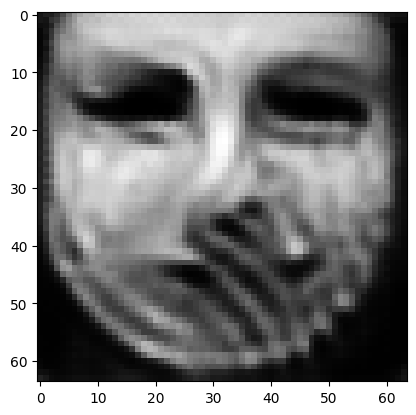

tensor([[1.6342e-04, 5.3265e-06, 9.7733e-01, 5.9136e-04, 2.2316e-04, 2.5439e-03,
         5.3957e-05, 1.8827e-03, 1.9286e-04, 3.6886e-04, 2.0472e-04, 5.9936e-04,
         1.1747e-04, 3.1668e-06, 9.4524e-07, 3.8500e-05, 5.2555e-04, 9.4092e-05,
         5.7126e-05, 3.4108e-04, 7.2405e-05, 7.4520e-05, 1.3692e-06, 3.1872e-05,
         6.3872e-05, 4.0247e-04, 1.7769e-05, 6.7228e-04, 6.5246e-03, 2.0319e-05,
         1.2998e-04, 2.6040e-06, 5.3359e-04, 2.3655e-04, 1.0617e-04, 7.6003e-07,
         9.5320e-05, 7.6495e-04, 3.7565e-03, 1.1532e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02292953059077263
tensor([[1.6333e-04, 5.3233e-06, 9.7735e-01, 5.9105e-04, 2.2301e-04, 2.5417e-03,
         5.3902e-05, 1.8814e-03, 1.9277e-04, 3.6868e-04, 2.0461e-04, 5.9920e-04,
         1.1741e-04, 3.1652e-06, 9.4471e-07, 3.8481e-05, 5.2537e-04, 9.4047e-05,
         5.7094e-05, 3.4087e-04, 7.2366e-05, 7.4484e-05, 1.3683e-06, 3.1857e-05,
         6.3827e-05, 4.0225e-04, 1.7752e-0

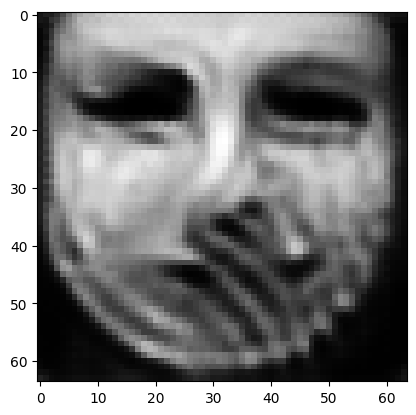

tensor([[1.6297e-04, 5.3112e-06, 9.7741e-01, 5.8992e-04, 2.2243e-04, 2.5330e-03,
         5.3688e-05, 1.8760e-03, 1.9244e-04, 3.6797e-04, 2.0414e-04, 5.9851e-04,
         1.1722e-04, 3.1597e-06, 9.4282e-07, 3.8405e-05, 5.2467e-04, 9.3876e-05,
         5.6971e-05, 3.4008e-04, 7.2218e-05, 7.4342e-05, 1.3653e-06, 3.1802e-05,
         6.3662e-05, 4.0141e-04, 1.7687e-05, 6.7048e-04, 6.5016e-03, 2.0255e-05,
         1.2980e-04, 2.5933e-06, 5.3188e-04, 2.3597e-04, 1.0594e-04, 7.5639e-07,
         9.5086e-05, 7.6384e-04, 3.7435e-03, 1.1483e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02285333164036274
tensor([[1.6288e-04, 5.3085e-06, 9.7742e-01, 5.8964e-04, 2.2230e-04, 2.5309e-03,
         5.3635e-05, 1.8746e-03, 1.9236e-04, 3.6778e-04, 2.0403e-04, 5.9835e-04,
         1.1718e-04, 3.1585e-06, 9.4237e-07, 3.8387e-05, 5.2449e-04, 9.3834e-05,
         5.6941e-05, 3.3987e-04, 7.2184e-05, 7.4307e-05, 1.3646e-06, 3.1787e-05,
         6.3620e-05, 4.0120e-04, 1.7672e-0

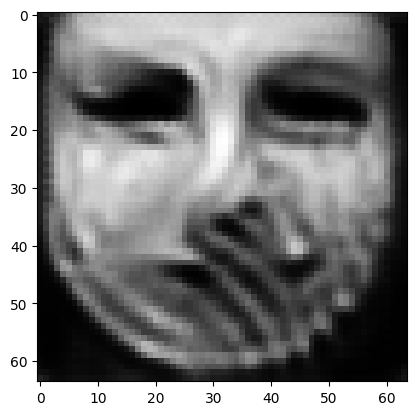

tensor([[1.6253e-04, 5.2980e-06, 9.7748e-01, 5.8864e-04, 2.2177e-04, 2.5225e-03,
         5.3428e-05, 1.8691e-03, 1.9207e-04, 3.6705e-04, 2.0358e-04, 5.9769e-04,
         1.1702e-04, 3.1541e-06, 9.4075e-07, 3.8313e-05, 5.2378e-04, 9.3682e-05,
         5.6825e-05, 3.3912e-04, 7.2056e-05, 7.4169e-05, 1.3620e-06, 3.1732e-05,
         6.3473e-05, 4.0041e-04, 1.7613e-05, 6.6874e-04, 6.4796e-03, 2.0198e-05,
         1.2963e-04, 2.5833e-06, 5.3024e-04, 2.3544e-04, 1.0574e-04, 7.5305e-07,
         9.4875e-05, 7.6277e-04, 3.7316e-03, 1.1437e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02278073877096176
tensor([[1.6245e-04, 5.2954e-06, 9.7749e-01, 5.8841e-04, 2.2165e-04, 2.5204e-03,
         5.3378e-05, 1.8679e-03, 1.9200e-04, 3.6687e-04, 2.0347e-04, 5.9753e-04,
         1.1699e-04, 3.1531e-06, 9.4037e-07, 3.8295e-05, 5.2361e-04, 9.3646e-05,
         5.6796e-05, 3.3894e-04, 7.2024e-05, 7.4135e-05, 1.3614e-06, 3.1720e-05,
         6.3439e-05, 4.0022e-04, 1.7598e-0

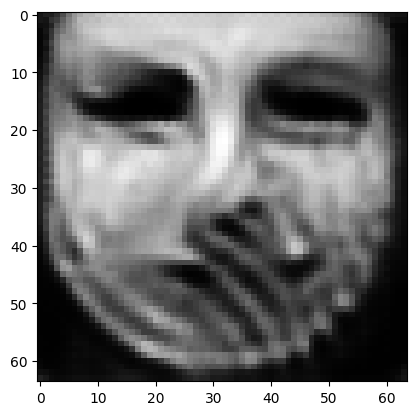

tensor([[1.6213e-04, 5.2857e-06, 9.7754e-01, 5.8750e-04, 2.2116e-04, 2.5125e-03,
         5.3182e-05, 1.8627e-03, 1.9174e-04, 3.6618e-04, 2.0305e-04, 5.9691e-04,
         1.1684e-04, 3.1491e-06, 9.3884e-07, 3.8224e-05, 5.2291e-04, 9.3498e-05,
         5.6687e-05, 3.3822e-04, 7.1899e-05, 7.4006e-05, 1.3590e-06, 3.1668e-05,
         6.3303e-05, 3.9949e-04, 1.7542e-05, 6.6714e-04, 6.4588e-03, 2.0144e-05,
         1.2947e-04, 2.5740e-06, 5.2868e-04, 2.3495e-04, 1.0555e-04, 7.4997e-07,
         9.4681e-05, 7.6179e-04, 3.7203e-03, 1.1394e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0227122213691473
tensor([[1.6205e-04, 5.2834e-06, 9.7756e-01, 5.8728e-04, 2.2104e-04, 2.5106e-03,
         5.3134e-05, 1.8614e-03, 1.9167e-04, 3.6601e-04, 2.0295e-04, 5.9676e-04,
         1.1681e-04, 3.1481e-06, 9.3846e-07, 3.8207e-05, 5.2273e-04, 9.3461e-05,
         5.6661e-05, 3.3804e-04, 7.1868e-05, 7.3975e-05, 1.3584e-06, 3.1655e-05,
         6.3269e-05, 3.9931e-04, 1.7529e-05

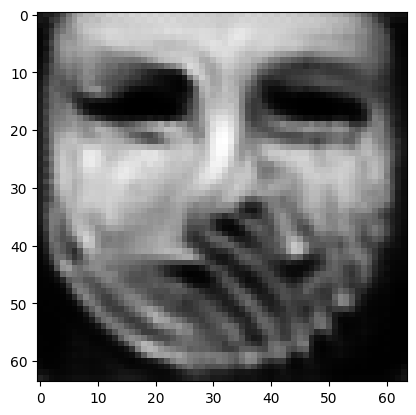

tensor([[1.6174e-04, 5.2741e-06, 9.7761e-01, 5.8640e-04, 2.2057e-04, 2.5032e-03,
         5.2952e-05, 1.8566e-03, 1.9141e-04, 3.6537e-04, 2.0255e-04, 5.9621e-04,
         1.1666e-04, 3.1442e-06, 9.3698e-07, 3.8142e-05, 5.2207e-04, 9.3321e-05,
         5.6559e-05, 3.3736e-04, 7.1750e-05, 7.3854e-05, 1.3561e-06, 3.1605e-05,
         6.3135e-05, 3.9862e-04, 1.7477e-05, 6.6561e-04, 6.4396e-03, 2.0093e-05,
         1.2932e-04, 2.5654e-06, 5.2720e-04, 2.3447e-04, 1.0537e-04, 7.4704e-07,
         9.4500e-05, 7.6088e-04, 3.7094e-03, 1.1354e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02264777570962906
tensor([[1.6167e-04, 5.2721e-06, 9.7762e-01, 5.8624e-04, 2.2047e-04, 2.5013e-03,
         5.2906e-05, 1.8555e-03, 1.9135e-04, 3.6521e-04, 2.0246e-04, 5.9605e-04,
         1.1664e-04, 3.1436e-06, 9.3668e-07, 3.8126e-05, 5.2193e-04, 9.3289e-05,
         5.6535e-05, 3.3720e-04, 7.1722e-05, 7.3823e-05, 1.3557e-06, 3.1595e-05,
         6.3109e-05, 3.9847e-04, 1.7464e-0

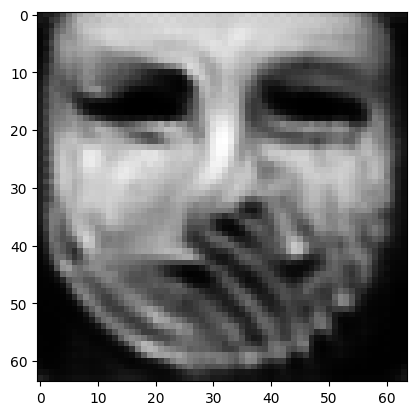

tensor([[1.6138e-04, 5.2631e-06, 9.7767e-01, 5.8540e-04, 2.2002e-04, 2.4944e-03,
         5.2734e-05, 1.8509e-03, 1.9109e-04, 3.6462e-04, 2.0209e-04, 5.9554e-04,
         1.1649e-04, 3.1396e-06, 9.3520e-07, 3.8064e-05, 5.2131e-04, 9.3150e-05,
         5.6439e-05, 3.3654e-04, 7.1605e-05, 7.3711e-05, 1.3534e-06, 3.1548e-05,
         6.2977e-05, 3.9783e-04, 1.7414e-05, 6.6420e-04, 6.4214e-03, 2.0044e-05,
         1.2919e-04, 2.5574e-06, 5.2580e-04, 2.3402e-04, 1.0519e-04, 7.4429e-07,
         9.4333e-05, 7.6003e-04, 3.6991e-03, 1.1315e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022587290033698082
tensor([[1.6130e-04, 5.2611e-06, 9.7768e-01, 5.8523e-04, 2.1991e-04, 2.4927e-03,
         5.2691e-05, 1.8499e-03, 1.9103e-04, 3.6447e-04, 2.0200e-04, 5.9540e-04,
         1.1646e-04, 3.1388e-06, 9.3485e-07, 3.8049e-05, 5.2116e-04, 9.3115e-05,
         5.6416e-05, 3.3637e-04, 7.1576e-05, 7.3683e-05, 1.3528e-06, 3.1537e-05,
         6.2948e-05, 3.9769e-04, 1.7401e-

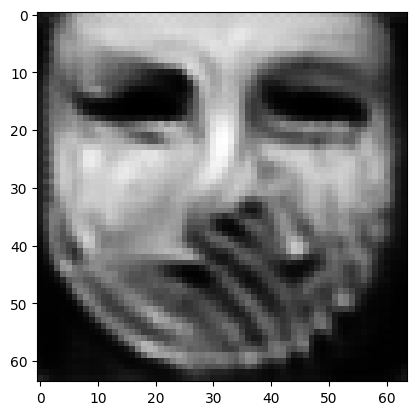

tensor([[1.6102e-04, 5.2530e-06, 9.7772e-01, 5.8448e-04, 2.1949e-04, 2.4861e-03,
         5.2525e-05, 1.8455e-03, 1.9079e-04, 3.6390e-04, 2.0164e-04, 5.9489e-04,
         1.1633e-04, 3.1353e-06, 9.3349e-07, 3.7991e-05, 5.2057e-04, 9.2984e-05,
         5.6325e-05, 3.3573e-04, 7.1468e-05, 7.3575e-05, 1.3508e-06, 3.1491e-05,
         6.2824e-05, 3.9707e-04, 1.7354e-05, 6.6286e-04, 6.4042e-03, 1.9999e-05,
         1.2907e-04, 2.5495e-06, 5.2443e-04, 2.3359e-04, 1.0503e-04, 7.4165e-07,
         9.4171e-05, 7.5918e-04, 3.6893e-03, 1.1279e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02252948097884655
tensor([[1.6095e-04, 5.2510e-06, 9.7773e-01, 5.8430e-04, 2.1939e-04, 2.4844e-03,
         5.2485e-05, 1.8445e-03, 1.9074e-04, 3.6376e-04, 2.0155e-04, 5.9476e-04,
         1.1630e-04, 3.1345e-06, 9.3319e-07, 3.7976e-05, 5.2041e-04, 9.2952e-05,
         5.6303e-05, 3.3558e-04, 7.1442e-05, 7.3549e-05, 1.3503e-06, 3.1480e-05,
         6.2796e-05, 3.9692e-04, 1.7342e-0

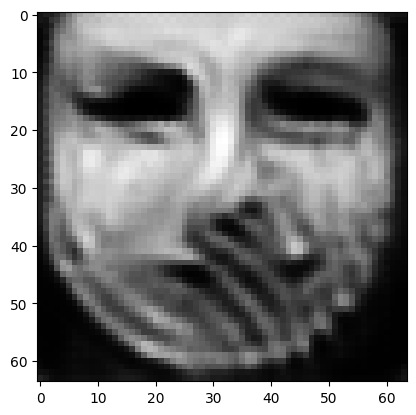

tensor([[1.6067e-04, 5.2431e-06, 9.7778e-01, 5.8351e-04, 2.1898e-04, 2.4782e-03,
         5.2329e-05, 1.8404e-03, 1.9051e-04, 3.6321e-04, 2.0121e-04, 5.9428e-04,
         1.1619e-04, 3.1310e-06, 9.3188e-07, 3.7922e-05, 5.1985e-04, 9.2825e-05,
         5.6217e-05, 3.3495e-04, 7.1339e-05, 7.3447e-05, 1.3483e-06, 3.1436e-05,
         6.2671e-05, 3.9631e-04, 1.7297e-05, 6.6157e-04, 6.3873e-03, 1.9953e-05,
         1.2894e-04, 2.5419e-06, 5.2312e-04, 2.3318e-04, 1.0486e-04, 7.3904e-07,
         9.4008e-05, 7.5829e-04, 3.6801e-03, 1.1244e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022474117577075958
tensor([[1.6061e-04, 5.2414e-06, 9.7779e-01, 5.8333e-04, 2.1889e-04, 2.4765e-03,
         5.2291e-05, 1.8394e-03, 1.9046e-04, 3.6308e-04, 2.0113e-04, 5.9414e-04,
         1.1617e-04, 3.1303e-06, 9.3161e-07, 3.7908e-05, 5.1972e-04, 9.2796e-05,
         5.6196e-05, 3.3481e-04, 7.1315e-05, 7.3422e-05, 1.3479e-06, 3.1426e-05,
         6.2646e-05, 3.9616e-04, 1.7285e-

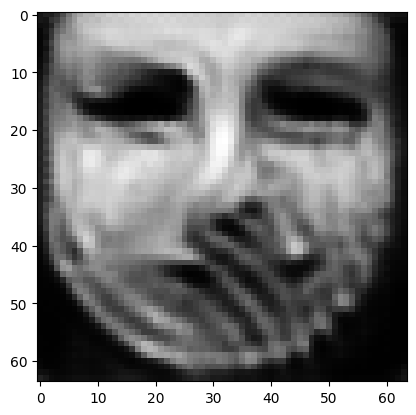

tensor([[1.6033e-04, 5.2341e-06, 9.7783e-01, 5.8261e-04, 2.1850e-04, 2.4706e-03,
         5.2143e-05, 1.8356e-03, 1.9024e-04, 3.6256e-04, 2.0080e-04, 5.9367e-04,
         1.1606e-04, 3.1270e-06, 9.3034e-07, 3.7857e-05, 5.1920e-04, 9.2669e-05,
         5.6116e-05, 3.3420e-04, 7.1218e-05, 7.3326e-05, 1.3461e-06, 3.1383e-05,
         6.2526e-05, 3.9559e-04, 1.7241e-05, 6.6036e-04, 6.3711e-03, 1.9911e-05,
         1.2883e-04, 2.5346e-06, 5.2186e-04, 2.3280e-04, 1.0470e-04, 7.3653e-07,
         9.3851e-05, 7.5739e-04, 3.6716e-03, 1.1212e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02242143079638481
tensor([[1.6027e-04, 5.2322e-06, 9.7784e-01, 5.8243e-04, 2.1841e-04, 2.4692e-03,
         5.2107e-05, 1.8346e-03, 1.9019e-04, 3.6243e-04, 2.0072e-04, 5.9356e-04,
         1.1603e-04, 3.1261e-06, 9.3003e-07, 3.7845e-05, 5.1907e-04, 9.2638e-05,
         5.6097e-05, 3.3405e-04, 7.1194e-05, 7.3303e-05, 1.3456e-06, 3.1373e-05,
         6.2496e-05, 3.9545e-04, 1.7231e-0

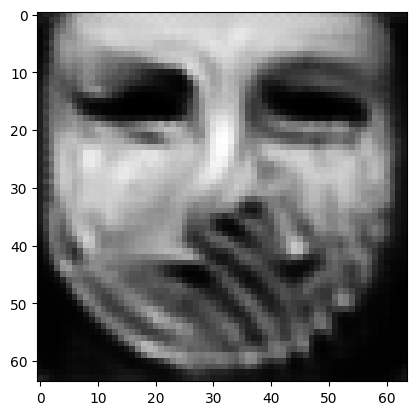

tensor([[1.6001e-04, 5.2253e-06, 9.7788e-01, 5.8173e-04, 2.1805e-04, 2.4636e-03,
         5.1969e-05, 1.8310e-03, 1.8999e-04, 3.6194e-04, 2.0040e-04, 5.9309e-04,
         1.1594e-04, 3.1230e-06, 9.2886e-07, 3.7798e-05, 5.1858e-04, 9.2519e-05,
         5.6021e-05, 3.3348e-04, 7.1103e-05, 7.3214e-05, 1.3439e-06, 3.1333e-05,
         6.2383e-05, 3.9490e-04, 1.7189e-05, 6.5922e-04, 6.3557e-03, 1.9869e-05,
         1.2873e-04, 2.5274e-06, 5.2066e-04, 2.3244e-04, 1.0455e-04, 7.3410e-07,
         9.3698e-05, 7.5648e-04, 3.6638e-03, 1.1181e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022371888160705566
tensor([[1.5995e-04, 5.2237e-06, 9.7789e-01, 5.8157e-04, 2.1796e-04, 2.4622e-03,
         5.1934e-05, 1.8301e-03, 1.8994e-04, 3.6182e-04, 2.0033e-04, 5.9298e-04,
         1.1591e-04, 3.1223e-06, 9.2860e-07, 3.7786e-05, 5.1846e-04, 9.2490e-05,
         5.6003e-05, 3.3334e-04, 7.1082e-05, 7.3192e-05, 1.3435e-06, 3.1323e-05,
         6.2356e-05, 3.9477e-04, 1.7179e-

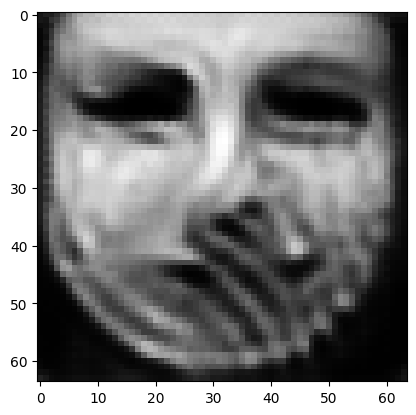

tensor([[1.5971e-04, 5.2169e-06, 9.7792e-01, 5.8089e-04, 2.1761e-04, 2.4568e-03,
         5.1802e-05, 1.8266e-03, 1.8975e-04, 3.6135e-04, 2.0003e-04, 5.9255e-04,
         1.1582e-04, 3.1193e-06, 9.2748e-07, 3.7741e-05, 5.1801e-04, 9.2378e-05,
         5.5931e-05, 3.3279e-04, 7.0994e-05, 7.3107e-05, 1.3418e-06, 3.1286e-05,
         6.2248e-05, 3.9425e-04, 1.7139e-05, 6.5813e-04, 6.3412e-03, 1.9831e-05,
         1.2863e-04, 2.5208e-06, 5.1953e-04, 2.3211e-04, 1.0440e-04, 7.3181e-07,
         9.3554e-05, 7.5566e-04, 3.6564e-03, 1.1152e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02232479304075241
tensor([[1.5965e-04, 5.2152e-06, 9.7793e-01, 5.8072e-04, 2.1752e-04, 2.4555e-03,
         5.1771e-05, 1.8259e-03, 1.8970e-04, 3.6124e-04, 1.9995e-04, 5.9244e-04,
         1.1579e-04, 3.1184e-06, 9.2720e-07, 3.7730e-05, 5.1791e-04, 9.2350e-05,
         5.5914e-05, 3.3266e-04, 7.0972e-05, 7.3086e-05, 1.3414e-06, 3.1278e-05,
         6.2222e-05, 3.9412e-04, 1.7129e-0

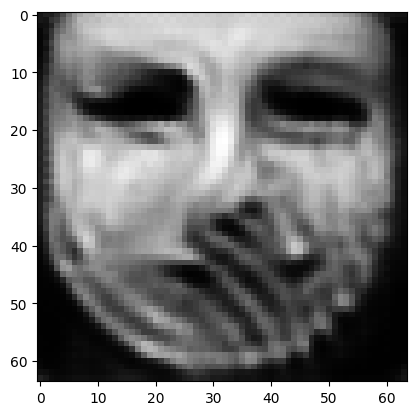

tensor([[1.5942e-04, 5.2084e-06, 9.7797e-01, 5.8004e-04, 2.1717e-04, 2.4505e-03,
         5.1647e-05, 1.8227e-03, 1.8950e-04, 3.6084e-04, 1.9967e-04, 5.9206e-04,
         1.1568e-04, 3.1151e-06, 9.2604e-07, 3.7689e-05, 5.1749e-04, 9.2239e-05,
         5.5845e-05, 3.3213e-04, 7.0884e-05, 7.3007e-05, 1.3396e-06, 3.1242e-05,
         6.2111e-05, 3.9363e-04, 1.7090e-05, 6.5707e-04, 6.3276e-03, 1.9793e-05,
         1.2852e-04, 2.5144e-06, 5.1844e-04, 2.3177e-04, 1.0425e-04, 7.2957e-07,
         9.3409e-05, 7.5487e-04, 3.6490e-03, 1.1124e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022280026227235794
tensor([[1.5937e-04, 5.2067e-06, 9.7797e-01, 5.7986e-04, 2.1709e-04, 2.4494e-03,
         5.1617e-05, 1.8219e-03, 1.8945e-04, 3.6074e-04, 1.9961e-04, 5.9197e-04,
         1.1565e-04, 3.1142e-06, 9.2575e-07, 3.7679e-05, 5.1739e-04, 9.2212e-05,
         5.5829e-05, 3.3201e-04, 7.0863e-05, 7.2988e-05, 1.3392e-06, 3.1234e-05,
         6.2083e-05, 3.9351e-04, 1.7081e-

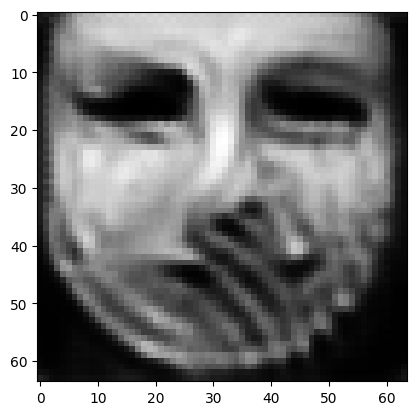

tensor([[1.5915e-04, 5.2003e-06, 9.7801e-01, 5.7919e-04, 2.1675e-04, 2.4448e-03,
         5.1502e-05, 1.8189e-03, 1.8926e-04, 3.6035e-04, 1.9934e-04, 5.9161e-04,
         1.1554e-04, 3.1110e-06, 9.2463e-07, 3.7640e-05, 5.1699e-04, 9.2105e-05,
         5.5764e-05, 3.3150e-04, 7.0779e-05, 7.2914e-05, 1.3375e-06, 3.1199e-05,
         6.1975e-05, 3.9304e-04, 1.7045e-05, 6.5605e-04, 6.3149e-03, 1.9756e-05,
         1.2842e-04, 2.5083e-06, 5.1741e-04, 2.3144e-04, 1.0411e-04, 7.2743e-07,
         9.3271e-05, 7.5413e-04, 3.6419e-03, 1.1097e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022237705066800117
tensor([[1.5910e-04, 5.1987e-06, 9.7802e-01, 5.7901e-04, 2.1667e-04, 2.4437e-03,
         5.1474e-05, 1.8182e-03, 1.8921e-04, 3.6027e-04, 1.9928e-04, 5.9153e-04,
         1.1551e-04, 3.1101e-06, 9.2434e-07, 3.7631e-05, 5.1689e-04, 9.2080e-05,
         5.5749e-05, 3.3138e-04, 7.0759e-05, 7.2896e-05, 1.3371e-06, 3.1191e-05,
         6.1946e-05, 3.9292e-04, 1.7036e-

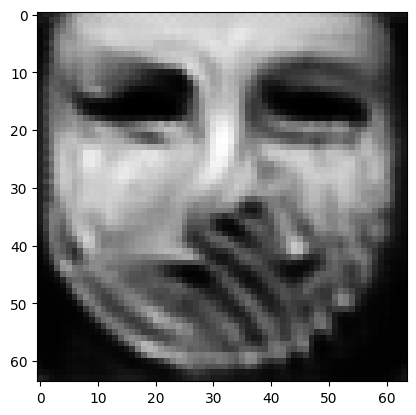

tensor([[1.5889e-04, 5.1925e-06, 9.7805e-01, 5.7838e-04, 2.1637e-04, 2.4394e-03,
         5.1366e-05, 1.8155e-03, 1.8902e-04, 3.5989e-04, 1.9903e-04, 5.9118e-04,
         1.1541e-04, 3.1069e-06, 9.2326e-07, 3.7594e-05, 5.1654e-04, 9.1980e-05,
         5.5688e-05, 3.3089e-04, 7.0679e-05, 7.2825e-05, 1.3355e-06, 3.1160e-05,
         6.1845e-05, 3.9248e-04, 1.7002e-05, 6.5511e-04, 6.3028e-03, 1.9720e-05,
         1.2831e-04, 2.5025e-06, 5.1643e-04, 2.3113e-04, 1.0397e-04, 7.2541e-07,
         9.3140e-05, 7.5341e-04, 3.6351e-03, 1.1073e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022197948768734932
tensor([[1.5884e-04, 5.1910e-06, 9.7805e-01, 5.7823e-04, 2.1629e-04, 2.4384e-03,
         5.1340e-05, 1.8148e-03, 1.8897e-04, 3.5981e-04, 1.9897e-04, 5.9110e-04,
         1.1538e-04, 3.1061e-06, 9.2297e-07, 3.7586e-05, 5.1645e-04, 9.1955e-05,
         5.5673e-05, 3.3077e-04, 7.0659e-05, 7.2807e-05, 1.3350e-06, 3.1152e-05,
         6.1819e-05, 3.9237e-04, 1.6994e-

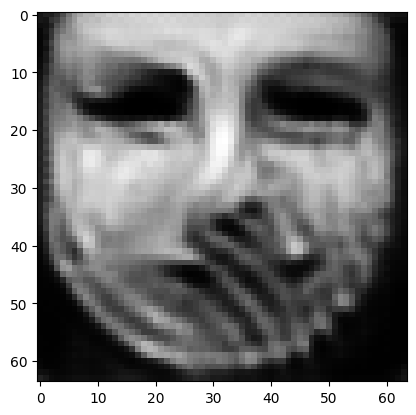

tensor([[1.5866e-04, 5.1854e-06, 9.7808e-01, 5.7773e-04, 2.1601e-04, 2.4340e-03,
         5.1236e-05, 1.8121e-03, 1.8880e-04, 3.5943e-04, 1.9873e-04, 5.9076e-04,
         1.1528e-04, 3.1037e-06, 9.2206e-07, 3.7549e-05, 5.1614e-04, 9.1866e-05,
         5.5616e-05, 3.3032e-04, 7.0585e-05, 7.2739e-05, 1.3337e-06, 3.1127e-05,
         6.1737e-05, 3.9201e-04, 1.6960e-05, 6.5425e-04, 6.2916e-03, 1.9689e-05,
         1.2823e-04, 2.4972e-06, 5.1552e-04, 2.3084e-04, 1.0385e-04, 7.2362e-07,
         9.3027e-05, 7.5278e-04, 3.6289e-03, 1.1048e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022160405293107033
tensor([[1.5862e-04, 5.1839e-06, 9.7809e-01, 5.7761e-04, 2.1594e-04, 2.4329e-03,
         5.1210e-05, 1.8115e-03, 1.8876e-04, 3.5934e-04, 1.9867e-04, 5.9067e-04,
         1.1526e-04, 3.1031e-06, 9.2184e-07, 3.7539e-05, 5.1607e-04, 9.1845e-05,
         5.5601e-05, 3.3022e-04, 7.0567e-05, 7.2722e-05, 1.3333e-06, 3.1122e-05,
         6.1720e-05, 3.9194e-04, 1.6952e-

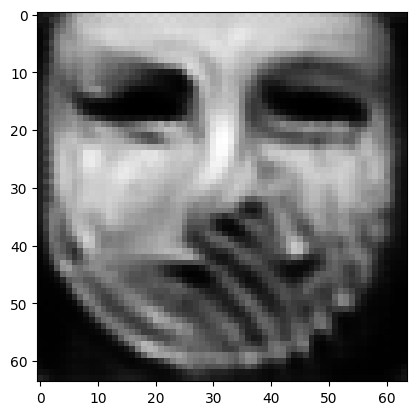

tensor([[1.5846e-04, 5.1785e-06, 9.7812e-01, 5.7717e-04, 2.1568e-04, 2.4286e-03,
         5.1109e-05, 1.8090e-03, 1.8859e-04, 3.5898e-04, 1.9845e-04, 5.9033e-04,
         1.1516e-04, 3.1012e-06, 9.2105e-07, 3.7503e-05, 5.1580e-04, 9.1762e-05,
         5.5546e-05, 3.2982e-04, 7.0496e-05, 7.2656e-05, 1.3320e-06, 3.1104e-05,
         6.1653e-05, 3.9164e-04, 1.6920e-05, 6.5345e-04, 6.2812e-03, 1.9661e-05,
         1.2816e-04, 2.4927e-06, 5.1470e-04, 2.3059e-04, 1.0375e-04, 7.2205e-07,
         9.2932e-05, 7.5225e-04, 3.6233e-03, 1.1022e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02212519198656082
tensor([[1.5842e-04, 5.1773e-06, 9.7812e-01, 5.7709e-04, 2.1562e-04, 2.4275e-03,
         5.1084e-05, 1.8084e-03, 1.8856e-04, 3.5889e-04, 1.9839e-04, 5.9024e-04,
         1.1514e-04, 3.1008e-06, 9.2089e-07, 3.7493e-05, 5.1573e-04, 9.1743e-05,
         5.5532e-05, 3.2973e-04, 7.0479e-05, 7.2640e-05, 1.3318e-06, 3.1100e-05,
         6.1641e-05, 3.9157e-04, 1.6912e-0

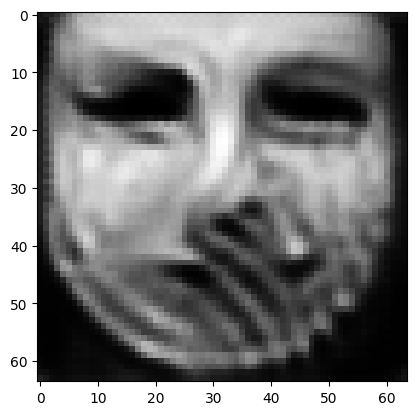

tensor([[1.5827e-04, 5.1720e-06, 9.7815e-01, 5.7666e-04, 2.1538e-04, 2.4235e-03,
         5.0990e-05, 1.8060e-03, 1.8839e-04, 3.5855e-04, 1.9818e-04, 5.8993e-04,
         1.1505e-04, 3.0988e-06, 9.2009e-07, 3.7459e-05, 5.1546e-04, 9.1663e-05,
         5.5479e-05, 3.2934e-04, 7.0410e-05, 7.2579e-05, 1.3305e-06, 3.1081e-05,
         6.1574e-05, 3.9129e-04, 1.6882e-05, 6.5269e-04, 6.2714e-03, 1.9634e-05,
         1.2810e-04, 2.4884e-06, 5.1394e-04, 2.3036e-04, 1.0364e-04, 7.2058e-07,
         9.2844e-05, 7.5175e-04, 3.6180e-03, 1.0998e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022092076018452644
tensor([[1.5823e-04, 5.1708e-06, 9.7816e-01, 5.7656e-04, 2.1532e-04, 2.4225e-03,
         5.0967e-05, 1.8055e-03, 1.8836e-04, 3.5847e-04, 1.9813e-04, 5.8985e-04,
         1.1503e-04, 3.0983e-06, 9.1991e-07, 3.7450e-05, 5.1540e-04, 9.1644e-05,
         5.5466e-05, 3.2926e-04, 7.0394e-05, 7.2564e-05, 1.3302e-06, 3.1077e-05,
         6.1560e-05, 3.9122e-04, 1.6875e-

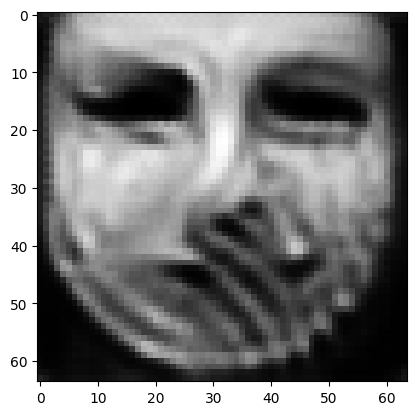

tensor([[1.5809e-04, 5.1659e-06, 9.7818e-01, 5.7614e-04, 2.1509e-04, 2.4187e-03,
         5.0880e-05, 1.8033e-03, 1.8820e-04, 3.5816e-04, 1.9793e-04, 5.8956e-04,
         1.1494e-04, 3.0964e-06, 9.1916e-07, 3.7418e-05, 5.1513e-04, 9.1567e-05,
         5.5416e-05, 3.2891e-04, 7.0329e-05, 7.2508e-05, 1.3290e-06, 3.1060e-05,
         6.1495e-05, 3.9095e-04, 1.6847e-05, 6.5199e-04, 6.2622e-03, 1.9609e-05,
         1.2804e-04, 2.4844e-06, 5.1322e-04, 2.3014e-04, 1.0354e-04, 7.1918e-07,
         9.2759e-05, 7.5126e-04, 3.6129e-03, 1.0975e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022061176598072052
tensor([[1.5805e-04, 5.1646e-06, 9.7819e-01, 5.7604e-04, 2.1503e-04, 2.4178e-03,
         5.0858e-05, 1.8028e-03, 1.8817e-04, 3.5809e-04, 1.9788e-04, 5.8949e-04,
         1.1492e-04, 3.0959e-06, 9.1897e-07, 3.7410e-05, 5.1507e-04, 9.1548e-05,
         5.5404e-05, 3.2882e-04, 7.0313e-05, 7.2495e-05, 1.3287e-06, 3.1055e-05,
         6.1479e-05, 3.9088e-04, 1.6840e-

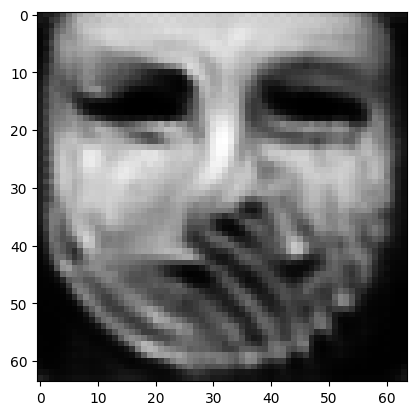

tensor([[1.5791e-04, 5.1600e-06, 9.7821e-01, 5.7566e-04, 2.1481e-04, 2.4143e-03,
         5.0775e-05, 1.8007e-03, 1.8803e-04, 3.5779e-04, 1.9770e-04, 5.8921e-04,
         1.1483e-04, 3.0940e-06, 9.1826e-07, 3.7380e-05, 5.1481e-04, 9.1474e-05,
         5.5356e-05, 3.2849e-04, 7.0251e-05, 7.2442e-05, 1.3275e-06, 3.1038e-05,
         6.1419e-05, 3.9062e-04, 1.6813e-05, 6.5132e-04, 6.2536e-03, 1.9585e-05,
         1.2798e-04, 2.4805e-06, 5.1254e-04, 2.2993e-04, 1.0345e-04, 7.1785e-07,
         9.2677e-05, 7.5079e-04, 3.6081e-03, 1.0954e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02203202247619629
tensor([[1.5788e-04, 5.1589e-06, 9.7821e-01, 5.7557e-04, 2.1476e-04, 2.4134e-03,
         5.0755e-05, 1.8002e-03, 1.8799e-04, 3.5772e-04, 1.9765e-04, 5.8915e-04,
         1.1481e-04, 3.0936e-06, 9.1810e-07, 3.7372e-05, 5.1475e-04, 9.1457e-05,
         5.5345e-05, 3.2841e-04, 7.0237e-05, 7.2429e-05, 1.3273e-06, 3.1035e-05,
         6.1406e-05, 3.9056e-04, 1.6807e-0

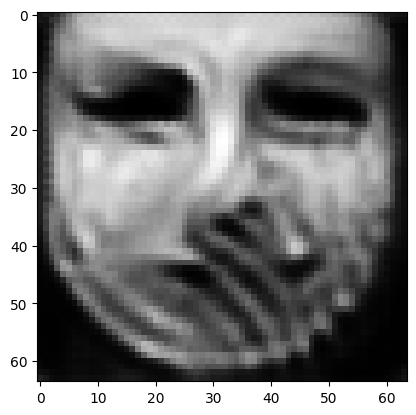

tensor([[1.5776e-04, 5.1545e-06, 9.7824e-01, 5.7522e-04, 2.1456e-04, 2.4100e-03,
         5.0676e-05, 1.7983e-03, 1.8786e-04, 3.5745e-04, 1.9747e-04, 5.8887e-04,
         1.1474e-04, 3.0919e-06, 9.1743e-07, 3.7342e-05, 5.1452e-04, 9.1387e-05,
         5.5300e-05, 3.2809e-04, 7.0178e-05, 7.2379e-05, 1.3262e-06, 3.1019e-05,
         6.1352e-05, 3.9033e-04, 1.6781e-05, 6.5070e-04, 6.2454e-03, 1.9562e-05,
         1.2793e-04, 2.4769e-06, 5.1189e-04, 2.2973e-04, 1.0336e-04, 7.1662e-07,
         9.2601e-05, 7.5036e-04, 3.6037e-03, 1.0934e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022004036232829094
tensor([[1.5772e-04, 5.1534e-06, 9.7824e-01, 5.7513e-04, 2.1450e-04, 2.4092e-03,
         5.0657e-05, 1.7979e-03, 1.8783e-04, 3.5738e-04, 1.9743e-04, 5.8881e-04,
         1.1472e-04, 3.0915e-06, 9.1726e-07, 3.7335e-05, 5.1446e-04, 9.1370e-05,
         5.5289e-05, 3.2802e-04, 7.0164e-05, 7.2366e-05, 1.3259e-06, 3.1015e-05,
         6.1337e-05, 3.9027e-04, 1.6775e-

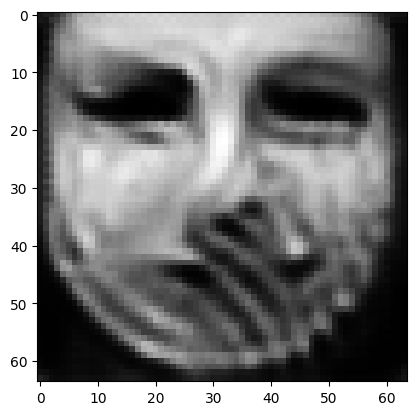

tensor([[1.5760e-04, 5.1493e-06, 9.7826e-01, 5.7479e-04, 2.1431e-04, 2.4060e-03,
         5.0583e-05, 1.7960e-03, 1.8771e-04, 3.5712e-04, 1.9726e-04, 5.8856e-04,
         1.1464e-04, 3.0898e-06, 9.1662e-07, 3.7308e-05, 5.1423e-04, 9.1304e-05,
         5.5247e-05, 3.2771e-04, 7.0109e-05, 7.2319e-05, 1.3249e-06, 3.1000e-05,
         6.1283e-05, 3.9004e-04, 1.6752e-05, 6.5009e-04, 6.2376e-03, 1.9540e-05,
         1.2787e-04, 2.4735e-06, 5.1127e-04, 2.2954e-04, 1.0328e-04, 7.1542e-07,
         9.2527e-05, 7.4994e-04, 3.5994e-03, 1.0916e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02197791449725628
tensor([[1.5757e-04, 5.1483e-06, 9.7827e-01, 5.7471e-04, 2.1426e-04, 2.4052e-03,
         5.0564e-05, 1.7956e-03, 1.8768e-04, 3.5705e-04, 1.9722e-04, 5.8849e-04,
         1.1463e-04, 3.0894e-06, 9.1647e-07, 3.7301e-05, 5.1417e-04, 9.1287e-05,
         5.5237e-05, 3.2764e-04, 7.0095e-05, 7.2307e-05, 1.3247e-06, 3.0996e-05,
         6.1271e-05, 3.8999e-04, 1.6746e-0

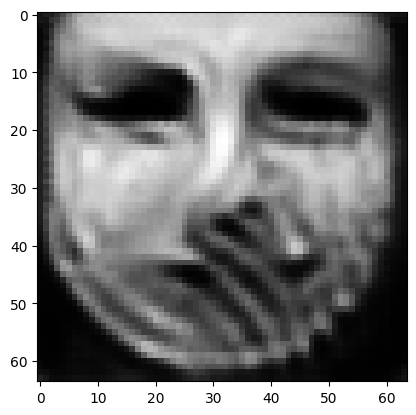

tensor([[1.5745e-04, 5.1444e-06, 9.7829e-01, 5.7441e-04, 2.1405e-04, 2.4022e-03,
         5.0491e-05, 1.7937e-03, 1.8755e-04, 3.5681e-04, 1.9706e-04, 5.8829e-04,
         1.1455e-04, 3.0877e-06, 9.1580e-07, 3.7274e-05, 5.1393e-04, 9.1218e-05,
         5.5197e-05, 3.2732e-04, 7.0040e-05, 7.2263e-05, 1.3236e-06, 3.0980e-05,
         6.1211e-05, 3.8979e-04, 1.6723e-05, 6.4949e-04, 6.2305e-03, 1.9520e-05,
         1.2782e-04, 2.4701e-06, 5.1063e-04, 2.2934e-04, 1.0319e-04, 7.1424e-07,
         9.2454e-05, 7.4954e-04, 3.5950e-03, 1.0898e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021952608600258827
tensor([[1.5742e-04, 5.1436e-06, 9.7829e-01, 5.7434e-04, 2.1400e-04, 2.4014e-03,
         5.0472e-05, 1.7933e-03, 1.8753e-04, 3.5676e-04, 1.9702e-04, 5.8824e-04,
         1.1453e-04, 3.0873e-06, 9.1564e-07, 3.7268e-05, 5.1387e-04, 9.1201e-05,
         5.5188e-05, 3.2724e-04, 7.0027e-05, 7.2252e-05, 1.3234e-06, 3.0976e-05,
         6.1197e-05, 3.8974e-04, 1.6717e-

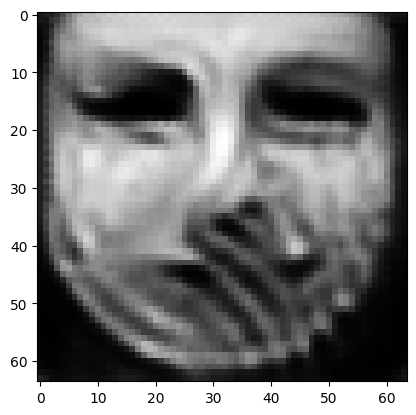

tensor([[1.5730e-04, 5.1401e-06, 9.7831e-01, 5.7408e-04, 2.1380e-04, 2.3984e-03,
         5.0400e-05, 1.7914e-03, 1.8742e-04, 3.5651e-04, 1.9686e-04, 5.8804e-04,
         1.1446e-04, 3.0858e-06, 9.1503e-07, 3.7242e-05, 5.1363e-04, 9.1132e-05,
         5.5150e-05, 3.2694e-04, 6.9977e-05, 7.2209e-05, 1.3225e-06, 3.0960e-05,
         6.1142e-05, 3.8955e-04, 1.6696e-05, 6.4889e-04, 6.2237e-03, 1.9502e-05,
         1.2778e-04, 2.4668e-06, 5.1001e-04, 2.2915e-04, 1.0312e-04, 7.1311e-07,
         9.2383e-05, 7.4918e-04, 3.5908e-03, 1.0881e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02192811667919159
tensor([[1.5727e-04, 5.1392e-06, 9.7831e-01, 5.7403e-04, 2.1375e-04, 2.3977e-03,
         5.0382e-05, 1.7910e-03, 1.8740e-04, 3.5645e-04, 1.9682e-04, 5.8799e-04,
         1.1445e-04, 3.0854e-06, 9.1488e-07, 3.7235e-05, 5.1358e-04, 9.1116e-05,
         5.5141e-05, 3.2686e-04, 6.9965e-05, 7.2199e-05, 1.3223e-06, 3.0956e-05,
         6.1130e-05, 3.8951e-04, 1.6690e-0

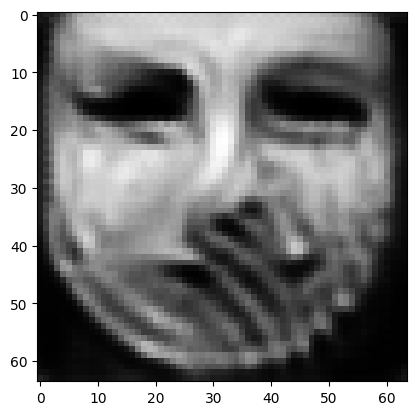

tensor([[1.5716e-04, 5.1358e-06, 9.7833e-01, 5.7379e-04, 2.1356e-04, 2.3949e-03,
         5.0314e-05, 1.7892e-03, 1.8730e-04, 3.5622e-04, 1.9667e-04, 5.8781e-04,
         1.1438e-04, 3.0840e-06, 9.1430e-07, 3.7211e-05, 5.1336e-04, 9.1053e-05,
         5.5106e-05, 3.2657e-04, 6.9918e-05, 7.2158e-05, 1.3214e-06, 3.0941e-05,
         6.1080e-05, 3.8933e-04, 1.6670e-05, 6.4831e-04, 6.2174e-03, 1.9484e-05,
         1.2775e-04, 2.4637e-06, 5.0943e-04, 2.2897e-04, 1.0305e-04, 7.1205e-07,
         9.2318e-05, 7.4884e-04, 3.5868e-03, 1.0865e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021905258297920227
tensor([[1.5713e-04, 5.1350e-06, 9.7834e-01, 5.7373e-04, 2.1351e-04, 2.3942e-03,
         5.0297e-05, 1.7888e-03, 1.8728e-04, 3.5616e-04, 1.9663e-04, 5.8776e-04,
         1.1437e-04, 3.0837e-06, 9.1416e-07, 3.7205e-05, 5.1330e-04, 9.1037e-05,
         5.5097e-05, 3.2650e-04, 6.9907e-05, 7.2148e-05, 1.3212e-06, 3.0938e-05,
         6.1068e-05, 3.8929e-04, 1.6665e-

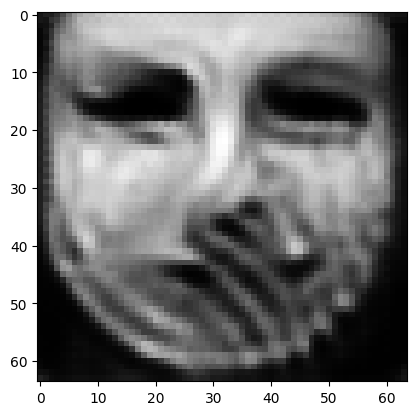

tensor([[1.5702e-04, 5.1318e-06, 9.7835e-01, 5.7351e-04, 2.1333e-04, 2.3915e-03,
         5.0233e-05, 1.7871e-03, 1.8719e-04, 3.5594e-04, 1.9649e-04, 5.8759e-04,
         1.1431e-04, 3.0823e-06, 9.1361e-07, 3.7182e-05, 5.1309e-04, 9.0977e-05,
         5.5064e-05, 3.2623e-04, 6.9862e-05, 7.2109e-05, 1.3204e-06, 3.0923e-05,
         6.1020e-05, 3.8912e-04, 1.6645e-05, 6.4776e-04, 6.2113e-03, 1.9468e-05,
         1.2771e-04, 2.4608e-06, 5.0887e-04, 2.2880e-04, 1.0298e-04, 7.1105e-07,
         9.2255e-05, 7.4853e-04, 3.5831e-03, 1.0850e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02188333310186863
tensor([[1.5700e-04, 5.1310e-06, 9.7836e-01, 5.7345e-04, 2.1329e-04, 2.3908e-03,
         5.0217e-05, 1.7867e-03, 1.8717e-04, 3.5589e-04, 1.9646e-04, 5.8754e-04,
         1.1429e-04, 3.0820e-06, 9.1348e-07, 3.7176e-05, 5.1304e-04, 9.0962e-05,
         5.5055e-05, 3.2616e-04, 6.9851e-05, 7.2100e-05, 1.3202e-06, 3.0920e-05,
         6.1008e-05, 3.8908e-04, 1.6640e-0

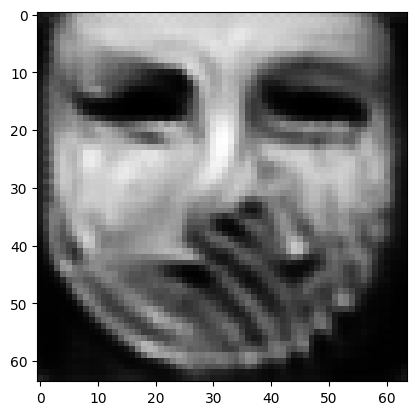

tensor([[1.5689e-04, 5.1280e-06, 9.7837e-01, 5.7323e-04, 2.1311e-04, 2.3883e-03,
         5.0156e-05, 1.7851e-03, 1.8708e-04, 3.5568e-04, 1.9632e-04, 5.8737e-04,
         1.1423e-04, 3.0807e-06, 9.1295e-07, 3.7154e-05, 5.1284e-04, 9.0905e-05,
         5.5023e-05, 3.2590e-04, 6.9809e-05, 7.2064e-05, 1.3194e-06, 3.0906e-05,
         6.0963e-05, 3.8892e-04, 1.6622e-05, 6.4724e-04, 6.2056e-03, 1.9452e-05,
         1.2767e-04, 2.4580e-06, 5.0835e-04, 2.2864e-04, 1.0292e-04, 7.1009e-07,
         9.2195e-05, 7.4822e-04, 3.5795e-03, 1.0835e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021862804889678955
tensor([[1.5687e-04, 5.1273e-06, 9.7838e-01, 5.7318e-04, 2.1307e-04, 2.3876e-03,
         5.0141e-05, 1.7847e-03, 1.8706e-04, 3.5563e-04, 1.9629e-04, 5.8733e-04,
         1.1422e-04, 3.0804e-06, 9.1283e-07, 3.7148e-05, 5.1279e-04, 9.0891e-05,
         5.5015e-05, 3.2584e-04, 6.9799e-05, 7.2054e-05, 1.3193e-06, 3.0903e-05,
         6.0952e-05, 3.8888e-04, 1.6617e-

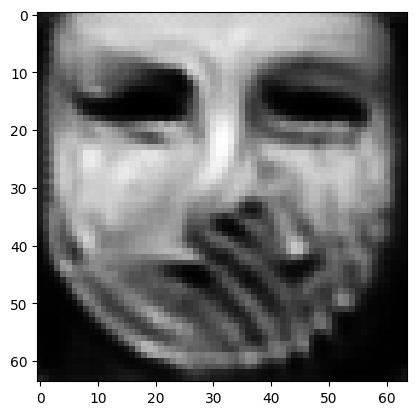

tensor([[1.5678e-04, 5.1245e-06, 9.7839e-01, 5.7299e-04, 2.1291e-04, 2.3852e-03,
         5.0082e-05, 1.7832e-03, 1.8699e-04, 3.5543e-04, 1.9616e-04, 5.8717e-04,
         1.1417e-04, 3.0793e-06, 9.1237e-07, 3.7127e-05, 5.1260e-04, 9.0839e-05,
         5.4986e-05, 3.2560e-04, 6.9760e-05, 7.2020e-05, 1.3186e-06, 3.0891e-05,
         6.0912e-05, 3.8873e-04, 1.6600e-05, 6.4675e-04, 6.2001e-03, 1.9437e-05,
         1.2764e-04, 2.4554e-06, 5.0785e-04, 2.2850e-04, 1.0286e-04, 7.0921e-07,
         9.2139e-05, 7.4795e-04, 3.5762e-03, 1.0822e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021843094378709793
tensor([[1.5675e-04, 5.1239e-06, 9.7840e-01, 5.7294e-04, 2.1287e-04, 2.3846e-03,
         5.0069e-05, 1.7829e-03, 1.8697e-04, 3.5538e-04, 1.9613e-04, 5.8714e-04,
         1.1416e-04, 3.0791e-06, 9.1228e-07, 3.7122e-05, 5.1255e-04, 9.0827e-05,
         5.4979e-05, 3.2555e-04, 6.9752e-05, 7.2012e-05, 1.3184e-06, 3.0888e-05,
         6.0902e-05, 3.8870e-04, 1.6596e-

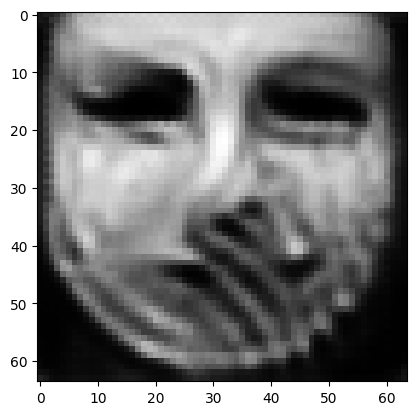

tensor([[1.5666e-04, 5.1213e-06, 9.7841e-01, 5.7274e-04, 2.1272e-04, 2.3823e-03,
         5.0016e-05, 1.7815e-03, 1.8690e-04, 3.5519e-04, 1.9601e-04, 5.8701e-04,
         1.1412e-04, 3.0781e-06, 9.1187e-07, 3.7103e-05, 5.1236e-04, 9.0781e-05,
         5.4951e-05, 3.2533e-04, 6.9719e-05, 7.1980e-05, 1.3178e-06, 3.0876e-05,
         6.0863e-05, 3.8854e-04, 1.6580e-05, 6.4627e-04, 6.1948e-03, 1.9424e-05,
         1.2761e-04, 2.4530e-06, 5.0742e-04, 2.2836e-04, 1.0281e-04, 7.0839e-07,
         9.2087e-05, 7.4769e-04, 3.5733e-03, 1.0809e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021825015544891357
tensor([[1.5664e-04, 5.1207e-06, 9.7842e-01, 5.7269e-04, 2.1269e-04, 2.3818e-03,
         5.0003e-05, 1.7811e-03, 1.8689e-04, 3.5514e-04, 1.9599e-04, 5.8698e-04,
         1.1411e-04, 3.0779e-06, 9.1178e-07, 3.7098e-05, 5.1231e-04, 9.0769e-05,
         5.4944e-05, 3.2528e-04, 6.9711e-05, 7.1972e-05, 1.3177e-06, 3.0873e-05,
         6.0854e-05, 3.8851e-04, 1.6576e-

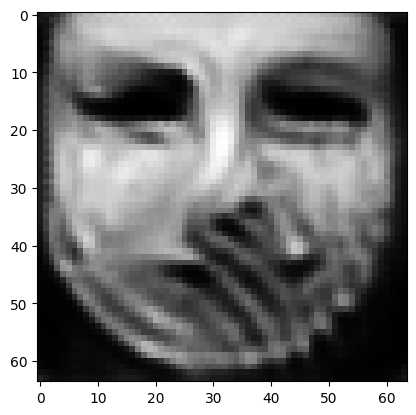

tensor([[1.5656e-04, 5.1182e-06, 9.7843e-01, 5.7255e-04, 2.1255e-04, 2.3796e-03,
         4.9952e-05, 1.7798e-03, 1.8683e-04, 3.5494e-04, 1.9587e-04, 5.8683e-04,
         1.1407e-04, 3.0770e-06, 9.1142e-07, 3.7078e-05, 5.1214e-04, 9.0728e-05,
         5.4918e-05, 3.2507e-04, 6.9680e-05, 7.1939e-05, 1.3172e-06, 3.0864e-05,
         6.0823e-05, 3.8838e-04, 1.6561e-05, 6.4584e-04, 6.1898e-03, 1.9411e-05,
         1.2758e-04, 2.4508e-06, 5.0700e-04, 2.2823e-04, 1.0276e-04, 7.0764e-07,
         9.2039e-05, 7.4746e-04, 3.5705e-03, 1.0797e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021807637065649033
tensor([[1.5654e-04, 5.1176e-06, 9.7843e-01, 5.7250e-04, 2.1252e-04, 2.3791e-03,
         4.9940e-05, 1.7795e-03, 1.8681e-04, 3.5490e-04, 1.9584e-04, 5.8680e-04,
         1.1406e-04, 3.0768e-06, 9.1133e-07, 3.7074e-05, 5.1210e-04, 9.0717e-05,
         5.4911e-05, 3.2502e-04, 6.9673e-05, 7.1932e-05, 1.3170e-06, 3.0861e-05,
         6.0814e-05, 3.8834e-04, 1.6557e-

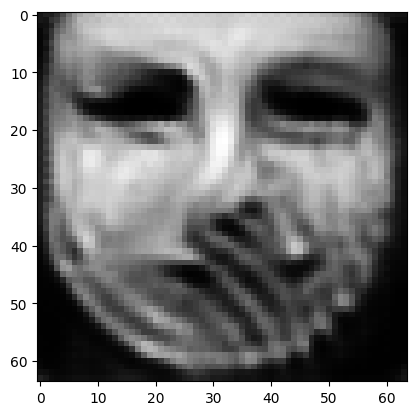

tensor([[1.5647e-04, 5.1153e-06, 9.7844e-01, 5.7236e-04, 2.1239e-04, 2.3770e-03,
         4.9893e-05, 1.7783e-03, 1.8675e-04, 3.5471e-04, 1.9573e-04, 5.8666e-04,
         1.1402e-04, 3.0760e-06, 9.1100e-07, 3.7055e-05, 5.1194e-04, 9.0678e-05,
         5.4886e-05, 3.2482e-04, 6.9644e-05, 7.1900e-05, 1.3165e-06, 3.0852e-05,
         6.0785e-05, 3.8822e-04, 1.6543e-05, 6.4542e-04, 6.1850e-03, 1.9399e-05,
         1.2755e-04, 2.4487e-06, 5.0659e-04, 2.2810e-04, 1.0272e-04, 7.0694e-07,
         9.1995e-05, 7.4724e-04, 3.5678e-03, 1.0785e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021791307255625725
tensor([[1.5645e-04, 5.1148e-06, 9.7845e-01, 5.7232e-04, 2.1236e-04, 2.3765e-03,
         4.9881e-05, 1.7779e-03, 1.8674e-04, 3.5467e-04, 1.9571e-04, 5.8663e-04,
         1.1401e-04, 3.0757e-06, 9.1092e-07, 3.7051e-05, 5.1190e-04, 9.0668e-05,
         5.4880e-05, 3.2477e-04, 6.9637e-05, 7.1893e-05, 1.3164e-06, 3.0850e-05,
         6.0777e-05, 3.8818e-04, 1.6539e-

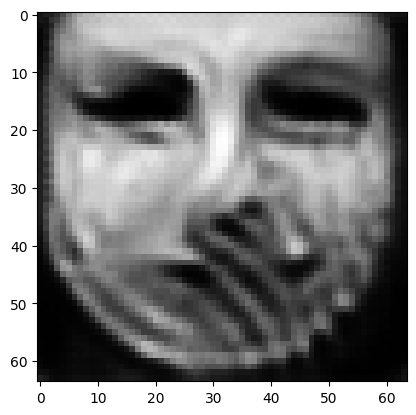

tensor([[1.5638e-04, 5.1125e-06, 9.7846e-01, 5.7219e-04, 2.1224e-04, 2.3745e-03,
         4.9836e-05, 1.7768e-03, 1.8669e-04, 3.5449e-04, 1.9560e-04, 5.8650e-04,
         1.1397e-04, 3.0750e-06, 9.1060e-07, 3.7034e-05, 5.1175e-04, 9.0631e-05,
         5.4857e-05, 3.2458e-04, 6.9610e-05, 7.1864e-05, 1.3159e-06, 3.0841e-05,
         6.0750e-05, 3.8806e-04, 1.6525e-05, 6.4503e-04, 6.1805e-03, 1.9388e-05,
         1.2752e-04, 2.4466e-06, 5.0621e-04, 2.2798e-04, 1.0268e-04, 7.0627e-07,
         9.1953e-05, 7.4703e-04, 3.5654e-03, 1.0774e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021775562316179276
tensor([[1.5637e-04, 5.1120e-06, 9.7846e-01, 5.7215e-04, 2.1221e-04, 2.3740e-03,
         4.9825e-05, 1.7765e-03, 1.8667e-04, 3.5444e-04, 1.9558e-04, 5.8647e-04,
         1.1396e-04, 3.0748e-06, 9.1052e-07, 3.7030e-05, 5.1171e-04, 9.0621e-05,
         5.4851e-05, 3.2454e-04, 6.9603e-05, 7.1857e-05, 1.3158e-06, 3.0839e-05,
         6.0742e-05, 3.8803e-04, 1.6522e-

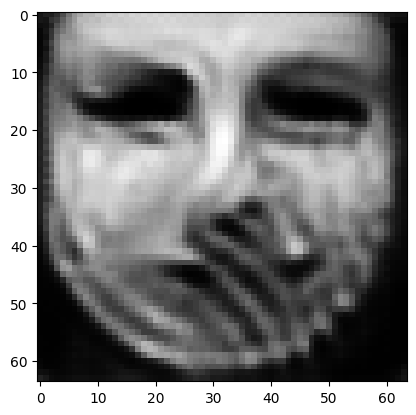

tensor([[1.5630e-04, 5.1100e-06, 9.7847e-01, 5.7201e-04, 2.1210e-04, 2.3722e-03,
         4.9783e-05, 1.7754e-03, 1.8662e-04, 3.5428e-04, 1.9548e-04, 5.8636e-04,
         1.1393e-04, 3.0740e-06, 9.1021e-07, 3.7014e-05, 5.1156e-04, 9.0585e-05,
         5.4829e-05, 3.2436e-04, 6.9577e-05, 7.1830e-05, 1.3154e-06, 3.0830e-05,
         6.0713e-05, 3.8792e-04, 1.6509e-05, 6.4465e-04, 6.1762e-03, 1.9377e-05,
         1.2749e-04, 2.4447e-06, 5.0585e-04, 2.2787e-04, 1.0264e-04, 7.0563e-07,
         9.1912e-05, 7.4682e-04, 3.5630e-03, 1.0764e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021760981529951096
tensor([[1.5628e-04, 5.1095e-06, 9.7848e-01, 5.7199e-04, 2.1207e-04, 2.3717e-03,
         4.9772e-05, 1.7751e-03, 1.8661e-04, 3.5424e-04, 1.9546e-04, 5.8632e-04,
         1.1392e-04, 3.0739e-06, 9.1014e-07, 3.7009e-05, 5.1153e-04, 9.0576e-05,
         5.4823e-05, 3.2431e-04, 6.9571e-05, 7.1822e-05, 1.3152e-06, 3.0828e-05,
         6.0708e-05, 3.8789e-04, 1.6506e-

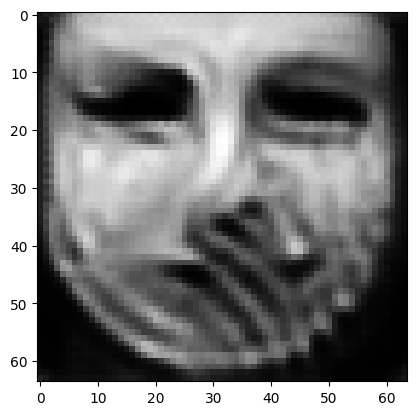

tensor([[1.5622e-04, 5.1076e-06, 9.7849e-01, 5.7186e-04, 2.1196e-04, 2.3700e-03,
         4.9732e-05, 1.7740e-03, 1.8656e-04, 3.5408e-04, 1.9537e-04, 5.8621e-04,
         1.1389e-04, 3.0732e-06, 9.0985e-07, 3.6994e-05, 5.1139e-04, 9.0542e-05,
         5.4802e-05, 3.2415e-04, 6.9547e-05, 7.1796e-05, 1.3148e-06, 3.0820e-05,
         6.0681e-05, 3.8778e-04, 1.6494e-05, 6.4430e-04, 6.1722e-03, 1.9367e-05,
         1.2746e-04, 2.4429e-06, 5.0551e-04, 2.2776e-04, 1.0261e-04, 7.0504e-07,
         9.1875e-05, 7.4663e-04, 3.5607e-03, 1.0755e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02174721658229828
tensor([[1.5620e-04, 5.1071e-06, 9.7849e-01, 5.7182e-04, 2.1193e-04, 2.3696e-03,
         4.9722e-05, 1.7738e-03, 1.8655e-04, 3.5404e-04, 1.9535e-04, 5.8618e-04,
         1.1388e-04, 3.0730e-06, 9.0978e-07, 3.6991e-05, 5.1136e-04, 9.0533e-05,
         5.4797e-05, 3.2410e-04, 6.9541e-05, 7.1790e-05, 1.3147e-06, 3.0818e-05,
         6.0674e-05, 3.8775e-04, 1.6491e-0

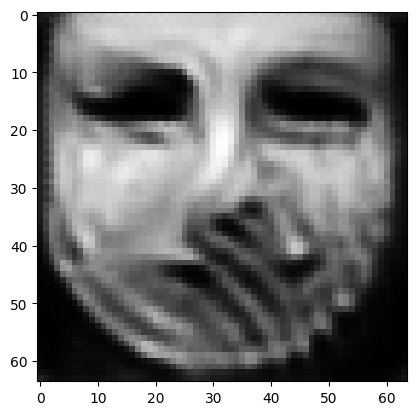

tensor([[1.5614e-04, 5.1053e-06, 9.7850e-01, 5.7171e-04, 2.1183e-04, 2.3679e-03,
         4.9684e-05, 1.7728e-03, 1.8650e-04, 3.5389e-04, 1.9526e-04, 5.8606e-04,
         1.1386e-04, 3.0723e-06, 9.0951e-07, 3.6975e-05, 5.1123e-04, 9.0502e-05,
         5.4777e-05, 3.2394e-04, 6.9518e-05, 7.1765e-05, 1.3143e-06, 3.0811e-05,
         6.0651e-05, 3.8765e-04, 1.6479e-05, 6.4398e-04, 6.1683e-03, 1.9357e-05,
         1.2744e-04, 2.4412e-06, 5.0518e-04, 2.2765e-04, 1.0258e-04, 7.0447e-07,
         9.1839e-05, 7.4644e-04, 3.5587e-03, 1.0745e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02173391915857792
tensor([[1.5613e-04, 5.1048e-06, 9.7850e-01, 5.7168e-04, 2.1181e-04, 2.3675e-03,
         4.9675e-05, 1.7725e-03, 1.8649e-04, 3.5385e-04, 1.9524e-04, 5.8604e-04,
         1.1385e-04, 3.0722e-06, 9.0944e-07, 3.6972e-05, 5.1119e-04, 9.0494e-05,
         5.4772e-05, 3.2391e-04, 6.9512e-05, 7.1759e-05, 1.3142e-06, 3.0809e-05,
         6.0645e-05, 3.8763e-04, 1.6476e-0

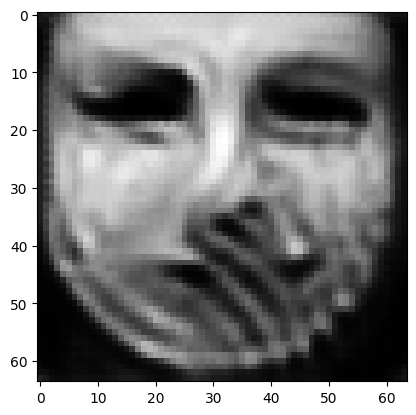

tensor([[1.5607e-04, 5.1031e-06, 9.7851e-01, 5.7158e-04, 2.1171e-04, 2.3659e-03,
         4.9638e-05, 1.7716e-03, 1.8645e-04, 3.5370e-04, 1.9515e-04, 5.8593e-04,
         1.1382e-04, 3.0716e-06, 9.0918e-07, 3.6958e-05, 5.1107e-04, 9.0464e-05,
         5.4753e-05, 3.2375e-04, 6.9490e-05, 7.1735e-05, 1.3138e-06, 3.0802e-05,
         6.0623e-05, 3.8753e-04, 1.6465e-05, 6.4366e-04, 6.1647e-03, 1.9348e-05,
         1.2742e-04, 2.4396e-06, 5.0487e-04, 2.2755e-04, 1.0254e-04, 7.0395e-07,
         9.1806e-05, 7.4627e-04, 3.5566e-03, 1.0736e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02172132208943367
tensor([[1.5605e-04, 5.1027e-06, 9.7852e-01, 5.7155e-04, 2.1169e-04, 2.3655e-03,
         4.9630e-05, 1.7713e-03, 1.8644e-04, 3.5367e-04, 1.9514e-04, 5.8591e-04,
         1.1381e-04, 3.0714e-06, 9.0912e-07, 3.6955e-05, 5.1105e-04, 9.0456e-05,
         5.4749e-05, 3.2372e-04, 6.9485e-05, 7.1729e-05, 1.3138e-06, 3.0800e-05,
         6.0617e-05, 3.8751e-04, 1.6463e-0

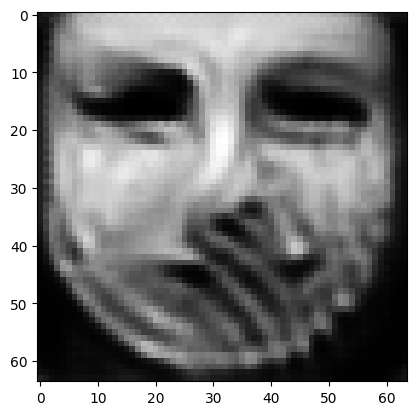

tensor([[1.5600e-04, 5.1010e-06, 9.7852e-01, 5.7144e-04, 2.1160e-04, 2.3640e-03,
         4.9596e-05, 1.7705e-03, 1.8639e-04, 3.5354e-04, 1.9506e-04, 5.8581e-04,
         1.1379e-04, 3.0709e-06, 9.0888e-07, 3.6942e-05, 5.1093e-04, 9.0428e-05,
         5.4731e-05, 3.2357e-04, 6.9464e-05, 7.1707e-05, 1.3134e-06, 3.0794e-05,
         6.0596e-05, 3.8741e-04, 1.6452e-05, 6.4337e-04, 6.1613e-03, 1.9340e-05,
         1.2740e-04, 2.4381e-06, 5.0459e-04, 2.2746e-04, 1.0251e-04, 7.0345e-07,
         9.1775e-05, 7.4611e-04, 3.5547e-03, 1.0728e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021709540858864784
tensor([[1.5599e-04, 5.1006e-06, 9.7853e-01, 5.7142e-04, 2.1158e-04, 2.3637e-03,
         4.9588e-05, 1.7702e-03, 1.8638e-04, 3.5350e-04, 1.9504e-04, 5.8578e-04,
         1.1378e-04, 3.0707e-06, 9.0882e-07, 3.6938e-05, 5.1091e-04, 9.0422e-05,
         5.4726e-05, 3.2354e-04, 6.9459e-05, 7.1701e-05, 1.3133e-06, 3.0793e-05,
         6.0591e-05, 3.8739e-04, 1.6450e-

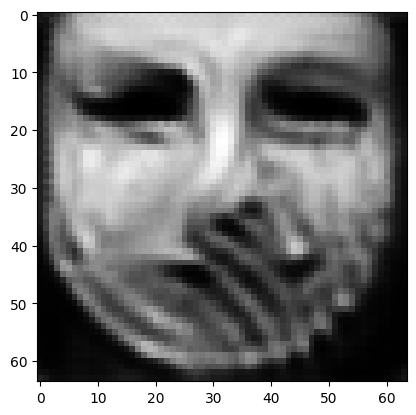

tensor([[1.5594e-04, 5.0990e-06, 9.7854e-01, 5.7132e-04, 2.1149e-04, 2.3622e-03,
         4.9556e-05, 1.7694e-03, 1.8634e-04, 3.5338e-04, 1.9497e-04, 5.8568e-04,
         1.1375e-04, 3.0701e-06, 9.0859e-07, 3.6926e-05, 5.1081e-04, 9.0395e-05,
         5.4709e-05, 3.2340e-04, 6.9439e-05, 7.1679e-05, 1.3129e-06, 3.0787e-05,
         6.0571e-05, 3.8731e-04, 1.6440e-05, 6.4309e-04, 6.1581e-03, 1.9332e-05,
         1.2737e-04, 2.4367e-06, 5.0431e-04, 2.2737e-04, 1.0249e-04, 7.0298e-07,
         9.1746e-05, 7.4596e-04, 3.5528e-03, 1.0720e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021698342636227608
tensor([[1.5593e-04, 5.0987e-06, 9.7854e-01, 5.7129e-04, 2.1147e-04, 2.3619e-03,
         4.9549e-05, 1.7692e-03, 1.8633e-04, 3.5335e-04, 1.9495e-04, 5.8566e-04,
         1.1374e-04, 3.0700e-06, 9.0853e-07, 3.6923e-05, 5.1078e-04, 9.0389e-05,
         5.4705e-05, 3.2337e-04, 6.9434e-05, 7.1674e-05, 1.3129e-06, 3.0785e-05,
         6.0566e-05, 3.8729e-04, 1.6437e-

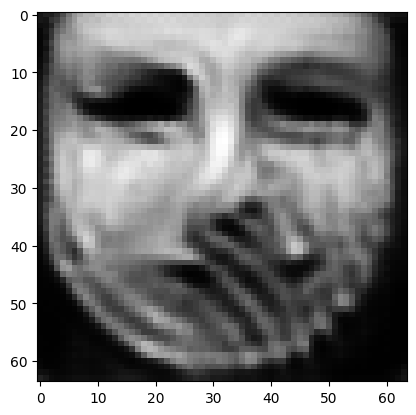

tensor([[1.5588e-04, 5.0972e-06, 9.7855e-01, 5.7120e-04, 2.1139e-04, 2.3606e-03,
         4.9519e-05, 1.7684e-03, 1.8629e-04, 3.5323e-04, 1.9488e-04, 5.8556e-04,
         1.1372e-04, 3.0695e-06, 9.0831e-07, 3.6912e-05, 5.1069e-04, 9.0364e-05,
         5.4689e-05, 3.2324e-04, 6.9415e-05, 7.1653e-05, 1.3125e-06, 3.0780e-05,
         6.0547e-05, 3.8721e-04, 1.6428e-05, 6.4283e-04, 6.1550e-03, 1.9324e-05,
         1.2735e-04, 2.4353e-06, 5.0405e-04, 2.2729e-04, 1.0246e-04, 7.0253e-07,
         9.1719e-05, 7.4583e-04, 3.5510e-03, 1.0712e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02168772742152214
tensor([[1.5587e-04, 5.0968e-06, 9.7855e-01, 5.7117e-04, 2.1137e-04, 2.3602e-03,
         4.9512e-05, 1.7682e-03, 1.8628e-04, 3.5320e-04, 1.9486e-04, 5.8554e-04,
         1.1371e-04, 3.0694e-06, 9.0826e-07, 3.6909e-05, 5.1067e-04, 9.0358e-05,
         5.4685e-05, 3.2321e-04, 6.9410e-05, 7.1649e-05, 1.3125e-06, 3.0779e-05,
         6.0542e-05, 3.8719e-04, 1.6426e-0

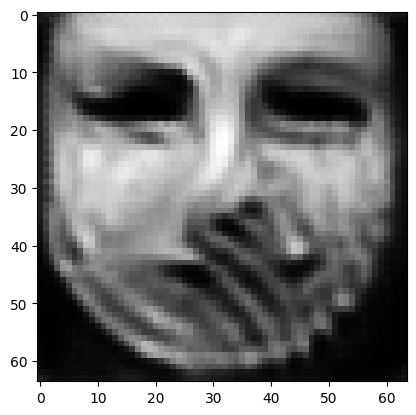

tensor([[1.5583e-04, 5.0952e-06, 9.7856e-01, 5.7107e-04, 2.1130e-04, 2.3590e-03,
         4.9485e-05, 1.7675e-03, 1.8623e-04, 3.5308e-04, 1.9480e-04, 5.8544e-04,
         1.1368e-04, 3.0688e-06, 9.0803e-07, 3.6898e-05, 5.1060e-04, 9.0335e-05,
         5.4669e-05, 3.2308e-04, 6.9391e-05, 7.1629e-05, 1.3121e-06, 3.0775e-05,
         6.0525e-05, 3.8711e-04, 1.6417e-05, 6.4258e-04, 6.1521e-03, 1.9317e-05,
         1.2733e-04, 2.4341e-06, 5.0382e-04, 2.2721e-04, 1.0243e-04, 7.0211e-07,
         9.1692e-05, 7.4570e-04, 3.5493e-03, 1.0705e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021677695214748383
tensor([[1.5582e-04, 5.0948e-06, 9.7856e-01, 5.7106e-04, 2.1128e-04, 2.3587e-03,
         4.9478e-05, 1.7673e-03, 1.8622e-04, 3.5305e-04, 1.9478e-04, 5.8541e-04,
         1.1368e-04, 3.0687e-06, 9.0798e-07, 3.6895e-05, 5.1058e-04, 9.0330e-05,
         5.4665e-05, 3.2305e-04, 6.9387e-05, 7.1623e-05, 1.3120e-06, 3.0774e-05,
         6.0523e-05, 3.8710e-04, 1.6414e-

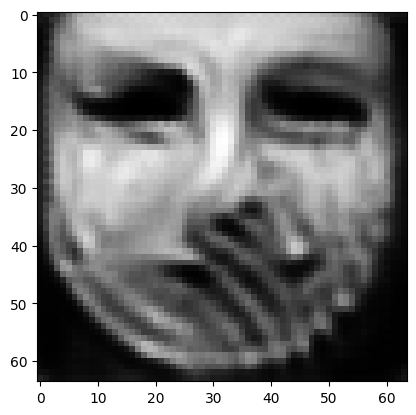

tensor([[1.5578e-04, 5.0933e-06, 9.7856e-01, 5.7097e-04, 2.1121e-04, 2.3575e-03,
         4.9452e-05, 1.7667e-03, 1.8618e-04, 3.5295e-04, 1.9472e-04, 5.8532e-04,
         1.1365e-04, 3.0681e-06, 9.0777e-07, 3.6884e-05, 5.1051e-04, 9.0308e-05,
         5.4651e-05, 3.2294e-04, 6.9369e-05, 7.1605e-05, 1.3117e-06, 3.0770e-05,
         6.0507e-05, 3.8703e-04, 1.6405e-05, 6.4235e-04, 6.1493e-03, 1.9310e-05,
         1.2731e-04, 2.4328e-06, 5.0359e-04, 2.2713e-04, 1.0241e-04, 7.0173e-07,
         9.1668e-05, 7.4558e-04, 3.5478e-03, 1.0698e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021668128669261932
tensor([[1.5577e-04, 5.0930e-06, 9.7857e-01, 5.7095e-04, 2.1119e-04, 2.3572e-03,
         4.9445e-05, 1.7665e-03, 1.8617e-04, 3.5292e-04, 1.9471e-04, 5.8530e-04,
         1.1364e-04, 3.0680e-06, 9.0772e-07, 3.6882e-05, 5.1049e-04, 9.0303e-05,
         5.4647e-05, 3.2291e-04, 6.9364e-05, 7.1600e-05, 1.3116e-06, 3.0769e-05,
         6.0503e-05, 3.8701e-04, 1.6403e-

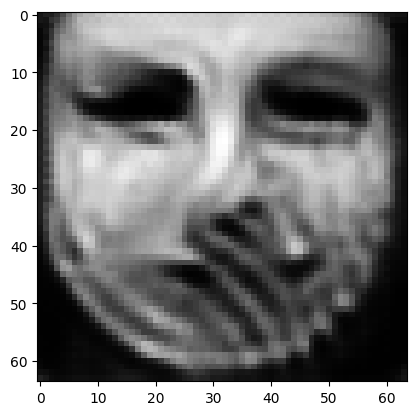

tensor([[1.5573e-04, 5.0916e-06, 9.7857e-01, 5.7084e-04, 2.1112e-04, 2.3561e-03,
         4.9421e-05, 1.7659e-03, 1.8613e-04, 3.5282e-04, 1.9465e-04, 5.8522e-04,
         1.1361e-04, 3.0674e-06, 9.0751e-07, 3.6872e-05, 5.1042e-04, 9.0281e-05,
         5.4633e-05, 3.2280e-04, 6.9347e-05, 7.1583e-05, 1.3113e-06, 3.0765e-05,
         6.0486e-05, 3.8694e-04, 1.6395e-05, 6.4212e-04, 6.1467e-03, 1.9303e-05,
         1.2729e-04, 2.4317e-06, 5.0338e-04, 2.2706e-04, 1.0239e-04, 7.0134e-07,
         9.1643e-05, 7.4546e-04, 3.5462e-03, 1.0691e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02165914699435234
tensor([[1.5573e-04, 5.0912e-06, 9.7858e-01, 5.7083e-04, 2.1111e-04, 2.3558e-03,
         4.9415e-05, 1.7658e-03, 1.8613e-04, 3.5279e-04, 1.9464e-04, 5.8520e-04,
         1.1361e-04, 3.0673e-06, 9.0746e-07, 3.6870e-05, 5.1041e-04, 9.0277e-05,
         5.4630e-05, 3.2278e-04, 6.9343e-05, 7.1578e-05, 1.3112e-06, 3.0764e-05,
         6.0484e-05, 3.8693e-04, 1.6393e-0

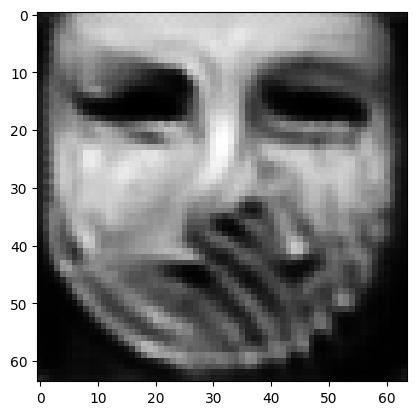

tensor([[1.5569e-04, 5.0899e-06, 9.7858e-01, 5.7074e-04, 2.1104e-04, 2.3548e-03,
         4.9392e-05, 1.7652e-03, 1.8609e-04, 3.5270e-04, 1.9458e-04, 5.8512e-04,
         1.1358e-04, 3.0668e-06, 9.0726e-07, 3.6861e-05, 5.1034e-04, 9.0256e-05,
         5.4617e-05, 3.2268e-04, 6.9327e-05, 7.1562e-05, 1.3109e-06, 3.0761e-05,
         6.0468e-05, 3.8686e-04, 1.6385e-05, 6.4191e-04, 6.1442e-03, 1.9296e-05,
         1.2727e-04, 2.4306e-06, 5.0318e-04, 2.2699e-04, 1.0236e-04, 7.0098e-07,
         9.1620e-05, 7.4535e-04, 3.5448e-03, 1.0684e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021650513634085655
tensor([[1.5568e-04, 5.0895e-06, 9.7858e-01, 5.7072e-04, 2.1102e-04, 2.3545e-03,
         4.9386e-05, 1.7650e-03, 1.8608e-04, 3.5267e-04, 1.9457e-04, 5.8510e-04,
         1.1358e-04, 3.0667e-06, 9.0722e-07, 3.6858e-05, 5.1032e-04, 9.0251e-05,
         5.4613e-05, 3.2265e-04, 6.9323e-05, 7.1557e-05, 1.3108e-06, 3.0760e-05,
         6.0466e-05, 3.8685e-04, 1.6383e-

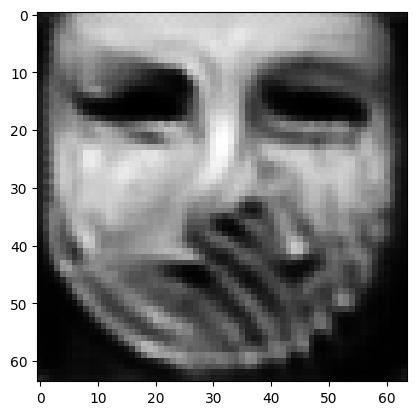

tensor([[1.5565e-04, 5.0882e-06, 9.7859e-01, 5.7063e-04, 2.1096e-04, 2.3535e-03,
         4.9364e-05, 1.7645e-03, 1.8604e-04, 3.5259e-04, 1.9452e-04, 5.8502e-04,
         1.1355e-04, 3.0662e-06, 9.0703e-07, 3.6849e-05, 5.1026e-04, 9.0232e-05,
         5.4600e-05, 3.2255e-04, 6.9307e-05, 7.1542e-05, 1.3106e-06, 3.0756e-05,
         6.0451e-05, 3.8678e-04, 1.6376e-05, 6.4170e-04, 6.1418e-03, 1.9290e-05,
         1.2725e-04, 2.4296e-06, 5.0298e-04, 2.2692e-04, 1.0234e-04, 7.0064e-07,
         9.1599e-05, 7.4524e-04, 3.5434e-03, 1.0678e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021642465144395828
tensor([[1.5564e-04, 5.0880e-06, 9.7859e-01, 5.7061e-04, 2.1095e-04, 2.3532e-03,
         4.9359e-05, 1.7643e-03, 1.8603e-04, 3.5257e-04, 1.9451e-04, 5.8500e-04,
         1.1355e-04, 3.0661e-06, 9.0698e-07, 3.6847e-05, 5.1025e-04, 9.0227e-05,
         5.4597e-05, 3.2253e-04, 6.9303e-05, 7.1538e-05, 1.3105e-06, 3.0755e-05,
         6.0447e-05, 3.8677e-04, 1.6374e-

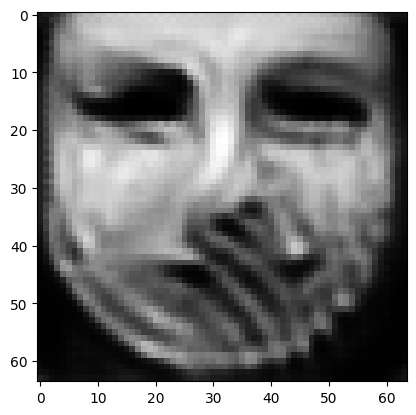

tensor([[1.5561e-04, 5.0867e-06, 9.7860e-01, 5.7054e-04, 2.1089e-04, 2.3523e-03,
         4.9337e-05, 1.7638e-03, 1.8600e-04, 3.5248e-04, 1.9446e-04, 5.8493e-04,
         1.1352e-04, 3.0657e-06, 9.0681e-07, 3.6839e-05, 5.1019e-04, 9.0209e-05,
         5.4586e-05, 3.2244e-04, 6.9289e-05, 7.1523e-05, 1.3102e-06, 3.0752e-05,
         6.0435e-05, 3.8671e-04, 1.6367e-05, 6.4151e-04, 6.1396e-03, 1.9284e-05,
         1.2723e-04, 2.4286e-06, 5.0280e-04, 2.2686e-04, 1.0232e-04, 7.0032e-07,
         9.1578e-05, 7.4514e-04, 3.5421e-03, 1.0673e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021634764969348907
tensor([[1.5560e-04, 5.0864e-06, 9.7860e-01, 5.7053e-04, 2.1088e-04, 2.3520e-03,
         4.9332e-05, 1.7637e-03, 1.8599e-04, 3.5245e-04, 1.9444e-04, 5.8491e-04,
         1.1352e-04, 3.0655e-06, 9.0676e-07, 3.6837e-05, 5.1018e-04, 9.0205e-05,
         5.4583e-05, 3.2241e-04, 6.9285e-05, 7.1518e-05, 1.3102e-06, 3.0752e-05,
         6.0432e-05, 3.8670e-04, 1.6365e-

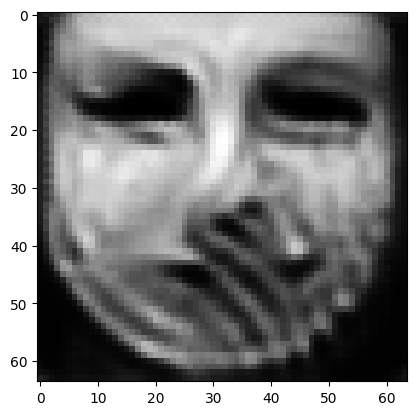

tensor([[1.5557e-04, 5.0853e-06, 9.7860e-01, 5.7045e-04, 2.1082e-04, 2.3511e-03,
         4.9312e-05, 1.7632e-03, 1.8596e-04, 3.5238e-04, 1.9440e-04, 5.8484e-04,
         1.1350e-04, 3.0651e-06, 9.0660e-07, 3.6829e-05, 5.1012e-04, 9.0187e-05,
         5.4571e-05, 3.2232e-04, 6.9271e-05, 7.1505e-05, 1.3099e-06, 3.0748e-05,
         6.0419e-05, 3.8665e-04, 1.6359e-05, 6.4133e-04, 6.1375e-03, 1.9279e-05,
         1.2722e-04, 2.4277e-06, 5.0262e-04, 2.2680e-04, 1.0230e-04, 7.0001e-07,
         9.1558e-05, 7.4504e-04, 3.5409e-03, 1.0667e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021627532318234444
tensor([[1.5556e-04, 5.0850e-06, 9.7861e-01, 5.7043e-04, 2.1081e-04, 2.3509e-03,
         4.9307e-05, 1.7631e-03, 1.8595e-04, 3.5236e-04, 1.9439e-04, 5.8483e-04,
         1.1349e-04, 3.0650e-06, 9.0656e-07, 3.6827e-05, 5.1010e-04, 9.0183e-05,
         5.4569e-05, 3.2230e-04, 6.9268e-05, 7.1501e-05, 1.3098e-06, 3.0748e-05,
         6.0415e-05, 3.8663e-04, 1.6357e-

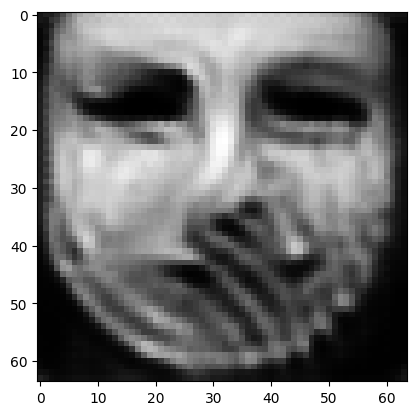

tensor([[1.5553e-04, 5.0839e-06, 9.7861e-01, 5.7036e-04, 2.1075e-04, 2.3501e-03,
         4.9288e-05, 1.7626e-03, 1.8592e-04, 3.5228e-04, 1.9434e-04, 5.8476e-04,
         1.1347e-04, 3.0646e-06, 9.0640e-07, 3.6819e-05, 5.1005e-04, 9.0166e-05,
         5.4558e-05, 3.2222e-04, 6.9254e-05, 7.1487e-05, 1.3096e-06, 3.0745e-05,
         6.0404e-05, 3.8658e-04, 1.6351e-05, 6.4116e-04, 6.1355e-03, 1.9273e-05,
         1.2720e-04, 2.4268e-06, 5.0246e-04, 2.2674e-04, 1.0228e-04, 6.9972e-07,
         9.1540e-05, 7.4495e-04, 3.5397e-03, 1.0662e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021620532497763634
tensor([[1.5552e-04, 5.0836e-06, 9.7861e-01, 5.7034e-04, 2.1074e-04, 2.3499e-03,
         4.9284e-05, 1.7625e-03, 1.8592e-04, 3.5226e-04, 1.9433e-04, 5.8475e-04,
         1.1347e-04, 3.0645e-06, 9.0636e-07, 3.6817e-05, 5.1003e-04, 9.0162e-05,
         5.4555e-05, 3.2220e-04, 6.9251e-05, 7.1484e-05, 1.3095e-06, 3.0744e-05,
         6.0400e-05, 3.8657e-04, 1.6349e-

In [16]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=2)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3075e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.216369152069092


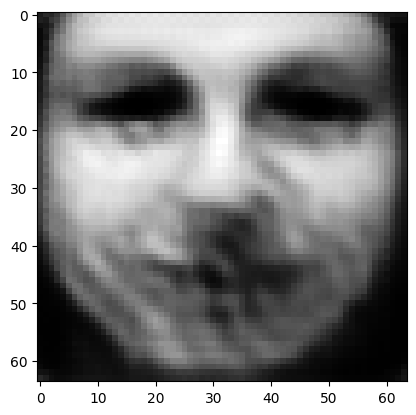

tensor([[0.0031, 0.0021, 0.0677, 0.0275, 0.0825, 0.0043, 0.0057, 0.0056, 0.0068,
         0.0006, 0.0020, 0.0015, 0.0384, 0.0088, 0.0008, 0.0010, 0.0348, 0.0069,
         0.0072, 0.0015, 0.0191, 0.0017, 0.0654, 0.0022, 0.1786, 0.0347, 0.0030,
         0.0182, 0.0391, 0.0142, 0.0083, 0.0014, 0.0161, 0.0207, 0.0252, 0.0098,
         0.0594, 0.0182, 0.1162, 0.0395]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.593630313873291
tensor([[0.0016, 0.0143, 0.0318, 0.2860, 0.0061, 0.0048, 0.0008, 0.0061, 0.0376,
         0.0007, 0.0038, 0.0039, 0.0209, 0.0134, 0.0004, 0.0011, 0.0058, 0.0024,
         0.0103, 0.0006, 0.0115, 0.0004, 0.0376, 0.0008, 0.0107, 0.2449, 0.0018,
         0.0127, 0.0341, 0.0227, 0.0142, 0.0011, 0.0033, 0.0031, 0.0592, 0.0056,
         0.0238, 0.0327, 0.0077, 0.0197]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.2517625093460083
tensor([[3.0678e-03, 5.4574e-03, 1.4351e-01, 4.2445e-01, 2.3735e-03, 2.4977e-02,
         5

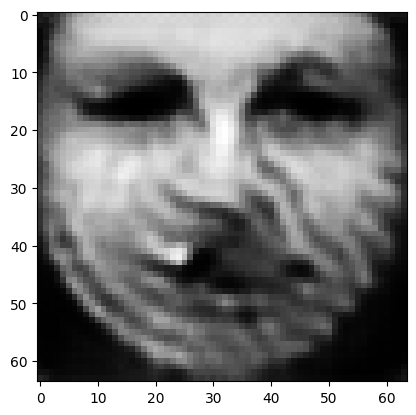

tensor([[3.5827e-04, 1.0374e-02, 3.3498e-03, 8.5773e-01, 5.0396e-04, 1.2787e-03,
         9.3494e-05, 2.4507e-03, 1.2252e-02, 1.7429e-04, 4.2012e-04, 8.2154e-04,
         1.7124e-02, 2.1902e-03, 1.2274e-04, 1.1048e-04, 1.6879e-03, 2.8316e-04,
         1.4104e-03, 2.8654e-04, 3.8922e-04, 2.8157e-05, 5.2379e-03, 2.0776e-04,
         6.2193e-03, 2.4062e-02, 3.6188e-04, 9.7225e-04, 3.3557e-03, 3.8718e-03,
         1.4290e-02, 6.5332e-04, 7.8679e-04, 5.7536e-04, 9.9061e-03, 2.4751e-03,
         2.1874e-03, 8.3447e-03, 2.2441e-03, 8.1477e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15347163379192352
tensor([[3.8611e-04, 7.4210e-03, 3.7733e-03, 8.9556e-01, 3.7991e-04, 1.6562e-03,
         8.6198e-05, 2.3221e-03, 1.1216e-02, 1.7899e-04, 3.8851e-04, 7.0260e-04,
         1.2010e-02, 1.2129e-03, 8.4574e-05, 1.0952e-04, 1.2583e-03, 2.0585e-04,
         1.2847e-03, 2.6197e-04, 2.6402e-04, 2.1384e-05, 2.1404e-03, 1.6012e-04,
         3.9430e-03, 1.4415e-02, 3.2418e-0

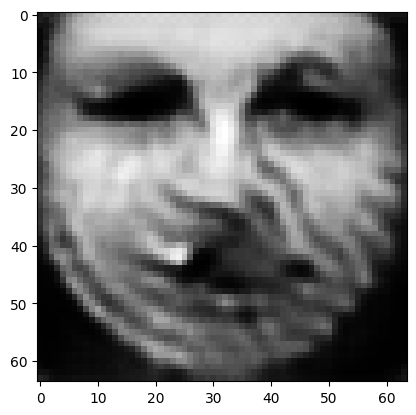

tensor([[3.3488e-04, 4.4700e-03, 3.1306e-03, 9.3217e-01, 2.3932e-04, 1.3351e-03,
         5.8825e-05, 1.9230e-03, 7.6447e-03, 1.2457e-04, 2.7251e-04, 4.1207e-04,
         7.0854e-03, 6.8240e-04, 4.9097e-05, 8.2098e-05, 9.4297e-04, 1.3729e-04,
         9.8657e-04, 1.7976e-04, 1.4597e-04, 1.3368e-05, 9.7554e-04, 1.2437e-04,
         2.5893e-03, 8.5575e-03, 1.9880e-04, 5.2461e-04, 2.5698e-03, 1.8486e-03,
         4.9025e-03, 2.8401e-04, 3.2230e-04, 1.9747e-04, 5.3552e-03, 6.3490e-04,
         6.6485e-04, 5.7244e-03, 1.5849e-03, 5.1724e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07023642212152481
tensor([[3.1921e-04, 4.1777e-03, 2.9875e-03, 9.3643e-01, 2.2355e-04, 1.2553e-03,
         5.4656e-05, 1.8313e-03, 7.1771e-03, 1.1523e-04, 2.5351e-04, 3.7666e-04,
         6.6178e-03, 6.3521e-04, 4.5647e-05, 7.7104e-05, 9.0440e-04, 1.2996e-04,
         9.3369e-04, 1.6772e-04, 1.3402e-04, 1.2387e-05, 9.0036e-04, 1.1889e-04,
         2.4780e-03, 7.9447e-03, 1.8240e-0

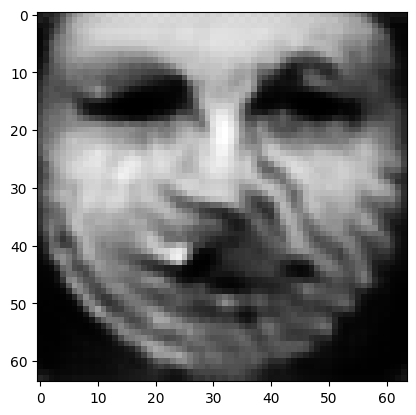

tensor([[2.7763e-04, 3.3252e-03, 2.6030e-03, 9.4824e-01, 1.8206e-04, 1.0578e-03,
         4.4427e-05, 1.5909e-03, 5.8858e-03, 9.1760e-05, 2.0351e-04, 2.8697e-04,
         5.2561e-03, 4.9433e-04, 3.6182e-05, 6.4004e-05, 7.8908e-04, 1.0897e-04,
         7.8800e-04, 1.3529e-04, 1.0107e-04, 9.8323e-06, 6.8109e-04, 1.0237e-04,
         2.1297e-03, 6.2394e-03, 1.4120e-04, 3.8924e-04, 1.8464e-03, 1.2928e-03,
         3.5378e-03, 2.2100e-04, 2.2974e-04, 1.3813e-04, 4.1629e-03, 4.6326e-04,
         4.9154e-04, 4.8156e-03, 1.1864e-03, 3.5936e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05314742028713226
tensor([[2.6971e-04, 3.1807e-03, 2.5305e-03, 9.5028e-01, 1.7551e-04, 1.0224e-03,
         4.2675e-05, 1.5449e-03, 5.6580e-03, 8.7607e-05, 1.9450e-04, 2.7208e-04,
         5.0359e-03, 4.7126e-04, 3.4691e-05, 6.1564e-05, 7.6748e-04, 1.0560e-04,
         7.6050e-04, 1.2950e-04, 9.5777e-05, 9.3853e-06, 6.4748e-04, 9.9139e-05,
         2.0695e-03, 5.9456e-03, 1.3464e-0

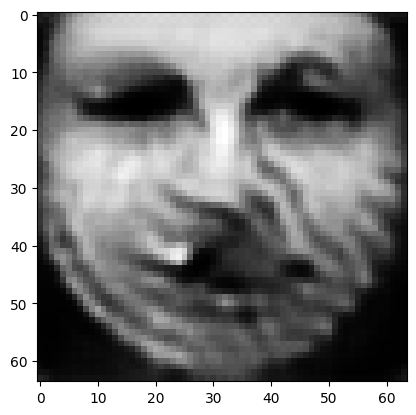

tensor([[2.4194e-04, 2.7627e-03, 2.2836e-03, 9.5674e-01, 1.5307e-04, 9.0456e-04,
         3.7145e-05, 1.3829e-03, 4.9367e-03, 7.4635e-05, 1.6538e-04, 2.2772e-04,
         4.3916e-03, 4.0117e-04, 3.0254e-05, 5.3711e-05, 6.9598e-04, 9.3805e-05,
         6.6807e-04, 1.1240e-04, 7.9857e-05, 8.0620e-06, 5.4583e-04, 8.8992e-05,
         1.8640e-03, 5.0237e-03, 1.1416e-04, 3.1468e-04, 1.4565e-03, 1.0201e-03,
         2.8397e-03, 1.9090e-04, 1.8494e-04, 1.0931e-04, 3.5373e-03, 3.8388e-04,
         4.0488e-04, 4.2133e-03, 9.8070e-04, 2.8450e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04422649368643761
tensor([[2.3528e-04, 2.6839e-03, 2.2216e-03, 9.5799e-01, 1.4888e-04, 8.7243e-04,
         3.5977e-05, 1.3467e-03, 4.7867e-03, 7.1551e-05, 1.5923e-04, 2.1856e-04,
         4.2699e-03, 3.9111e-04, 2.9418e-05, 5.1939e-05, 6.8167e-04, 9.1505e-05,
         6.4897e-04, 1.0864e-04, 7.6863e-05, 7.8028e-06, 5.3212e-04, 8.7143e-05,
         1.8324e-03, 4.8734e-03, 1.0988e-0

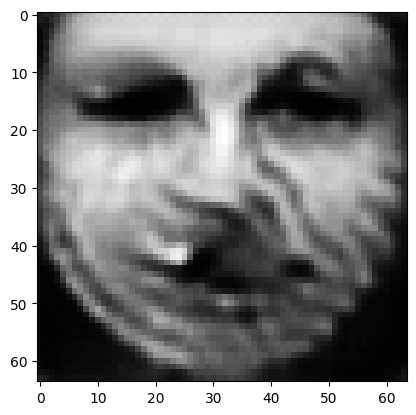

tensor([[2.1432e-04, 2.3958e-03, 2.0471e-03, 9.6239e-01, 1.3277e-04, 7.7493e-04,
         3.2111e-05, 1.2248e-03, 4.2356e-03, 6.1365e-05, 1.3777e-04, 1.8881e-04,
         3.8191e-03, 3.4732e-04, 2.6302e-05, 4.6011e-05, 6.3266e-04, 8.1952e-05,
         5.8455e-04, 9.6238e-05, 6.6460e-05, 7.0319e-06, 4.7445e-04, 8.0714e-05,
         1.6887e-03, 4.3412e-03, 9.5864e-05, 2.6662e-04, 1.1999e-03, 8.4942e-04,
         2.4484e-03, 1.7117e-04, 1.5740e-04, 9.2830e-05, 3.0427e-03, 3.3604e-04,
         3.5768e-04, 3.7813e-03, 8.4112e-04, 2.3397e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03833813965320587
tensor([[2.0975e-04, 2.3439e-03, 2.0091e-03, 9.6329e-01, 1.2902e-04, 7.5419e-04,
         3.1233e-05, 1.1963e-03, 4.1262e-03, 5.9260e-05, 1.3337e-04, 1.8315e-04,
         3.7260e-03, 3.3876e-04, 2.5719e-05, 4.4777e-05, 6.2086e-04, 7.9933e-05,
         5.7122e-04, 9.3562e-05, 6.4464e-05, 6.8688e-06, 4.6255e-04, 7.9142e-05,
         1.6541e-03, 4.2295e-03, 9.3109e-0

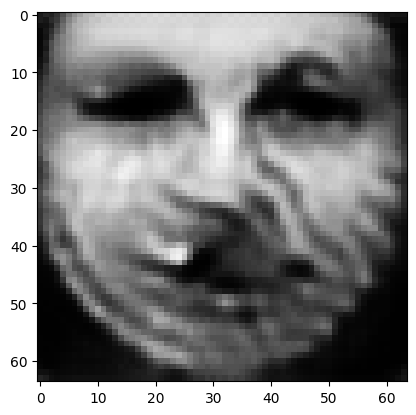

tensor([[1.9837e-04, 2.1398e-03, 1.9118e-03, 9.6635e-01, 1.1702e-04, 7.0060e-04,
         2.8633e-05, 1.1197e-03, 3.7745e-03, 5.3525e-05, 1.2026e-04, 1.6498e-04,
         3.3591e-03, 3.0421e-04, 2.3630e-05, 4.1041e-05, 5.8133e-04, 7.3446e-05,
         5.2808e-04, 8.5369e-05, 5.7622e-05, 6.3938e-06, 4.0656e-04, 7.3982e-05,
         1.5300e-03, 3.8224e-03, 8.4136e-05, 2.3306e-04, 1.0491e-03, 7.3755e-04,
         2.1664e-03, 1.5669e-04, 1.3911e-04, 8.0791e-05, 2.7062e-03, 2.9491e-04,
         3.1974e-04, 3.5120e-03, 7.4313e-04, 2.0076e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03422492742538452
tensor([[1.9547e-04, 2.1027e-03, 1.8818e-03, 9.6697e-01, 1.1444e-04, 6.8473e-04,
         2.7992e-05, 1.1025e-03, 3.6983e-03, 5.2104e-05, 1.1758e-04, 1.6105e-04,
         3.2823e-03, 2.9915e-04, 2.3257e-05, 4.0214e-05, 5.7209e-04, 7.2157e-05,
         5.1963e-04, 8.3339e-05, 5.6254e-05, 6.2880e-06, 3.9779e-04, 7.2918e-05,
         1.5074e-03, 3.7534e-03, 8.2248e-0

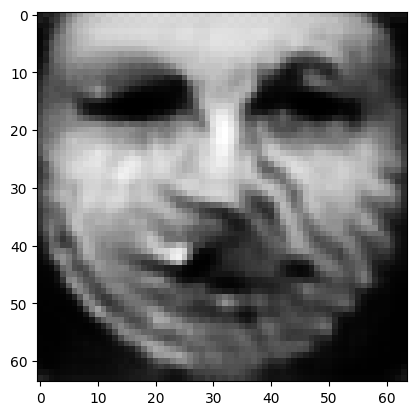

tensor([[1.8559e-04, 1.9701e-03, 1.7865e-03, 9.6914e-01, 1.0525e-04, 6.3810e-04,
         2.5739e-05, 1.0412e-03, 3.4481e-03, 4.7700e-05, 1.0834e-04, 1.4836e-04,
         3.0332e-03, 2.7685e-04, 2.1840e-05, 3.7392e-05, 5.3866e-04, 6.7443e-05,
         4.8828e-04, 7.7104e-05, 5.1629e-05, 5.9139e-06, 3.6373e-04, 6.8687e-05,
         1.4187e-03, 3.4800e-03, 7.5850e-05, 2.0896e-04, 9.3422e-04, 6.6744e-04,
         1.9742e-03, 1.4750e-04, 1.2637e-04, 7.1915e-05, 2.4868e-03, 2.6998e-04,
         2.9421e-04, 3.3278e-03, 6.6158e-04, 1.7556e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031342774629592896
tensor([[1.8386e-04, 1.9357e-03, 1.7701e-03, 9.6964e-01, 1.0318e-04, 6.3078e-04,
         2.5327e-05, 1.0302e-03, 3.3926e-03, 4.6894e-05, 1.0639e-04, 1.4570e-04,
         2.9751e-03, 2.7023e-04, 2.1479e-05, 3.6829e-05, 5.3176e-04, 6.6326e-05,
         4.8157e-04, 7.5920e-05, 5.0577e-05, 5.8431e-06, 3.5424e-04, 6.7741e-05,
         1.3947e-03, 3.4115e-03, 7.4472e-

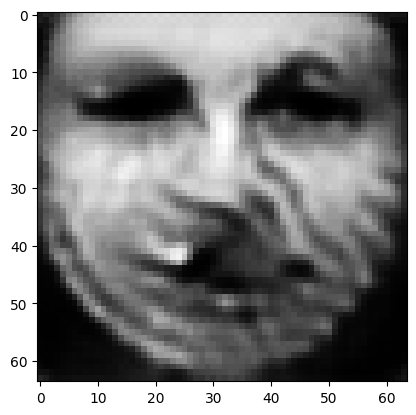

tensor([[1.7777e-04, 1.8101e-03, 1.7198e-03, 9.7141e-01, 9.6100e-05, 6.0781e-04,
         2.3916e-05, 9.9055e-04, 3.2030e-03, 4.4208e-05, 9.9523e-05, 1.3687e-04,
         2.7656e-03, 2.4568e-04, 2.0209e-05, 3.5021e-05, 5.0924e-04, 6.2472e-05,
         4.5740e-04, 7.2127e-05, 4.7154e-05, 5.5905e-06, 3.1959e-04, 6.4422e-05,
         1.3102e-03, 3.1522e-03, 6.9670e-05, 1.8898e-04, 8.6371e-04, 6.0951e-04,
         1.7969e-03, 1.3905e-04, 1.1638e-04, 6.4936e-05, 2.3147e-03, 2.4322e-04,
         2.6888e-04, 3.1616e-03, 6.1382e-04, 1.5926e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029003776609897614
tensor([[1.7717e-04, 1.7797e-03, 1.7142e-03, 9.7183e-01, 9.4462e-05, 6.0702e-04,
         2.3660e-05, 9.8412e-04, 3.1642e-03, 4.3815e-05, 9.8157e-05, 1.3524e-04,
         2.7122e-03, 2.3851e-04, 1.9890e-05, 3.4728e-05, 5.0378e-04, 6.1564e-05,
         4.5232e-04, 7.1430e-05, 4.6387e-05, 5.5382e-06, 3.0903e-04, 6.3508e-05,
         1.2842e-03, 3.0799e-03, 6.8849e-

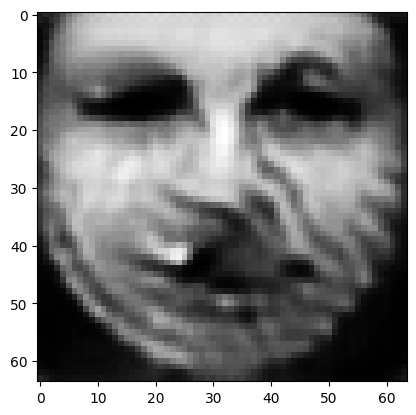

tensor([[1.7248e-04, 1.6864e-03, 1.6704e-03, 9.7327e-01, 8.9205e-05, 5.8907e-04,
         2.2569e-05, 9.5096e-04, 3.0144e-03, 4.1651e-05, 9.2612e-05, 1.2833e-04,
         2.5472e-03, 2.1979e-04, 1.8900e-05, 3.3290e-05, 4.8462e-04, 5.8660e-05,
         4.3234e-04, 6.8431e-05, 4.3665e-05, 5.3169e-06, 2.8250e-04, 6.0599e-05,
         1.2140e-03, 2.8645e-03, 6.5293e-05, 1.7224e-04, 8.1101e-04, 5.6382e-04,
         1.6444e-03, 1.3184e-04, 1.0821e-04, 5.9546e-05, 2.1745e-03, 2.2027e-04,
         2.4696e-04, 3.0137e-03, 5.8130e-04, 1.4762e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027096446603536606
tensor([[1.7130e-04, 1.6662e-03, 1.6589e-03, 9.7359e-01, 8.7978e-05, 5.8424e-04,
         2.2319e-05, 9.4248e-04, 2.9805e-03, 4.1127e-05, 9.1358e-05, 1.2668e-04,
         2.5115e-03, 2.1585e-04, 1.8670e-05, 3.2933e-05, 4.7995e-04, 5.7986e-05,
         4.2773e-04, 6.7681e-05, 4.3034e-05, 5.2620e-06, 2.7696e-04, 5.9890e-05,
         1.1977e-03, 2.8179e-03, 6.4500e-

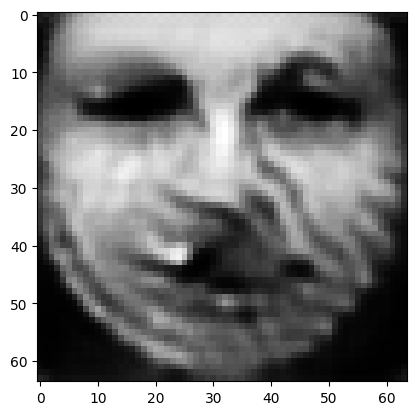

tensor([[1.6619e-04, 1.5905e-03, 1.6112e-03, 9.7479e-01, 8.3562e-05, 5.6433e-04,
         2.1344e-05, 9.0744e-04, 2.8558e-03, 3.9094e-05, 8.6389e-05, 1.2073e-04,
         2.3885e-03, 2.0140e-04, 1.7836e-05, 3.1503e-05, 4.6308e-04, 5.5447e-05,
         4.0900e-04, 6.5139e-05, 4.0779e-05, 5.0570e-06, 2.5786e-04, 5.7356e-05,
         1.1446e-03, 2.6447e-03, 6.1304e-05, 1.5809e-04, 7.5730e-04, 5.2714e-04,
         1.5313e-03, 1.2615e-04, 1.0158e-04, 5.5327e-05, 2.0573e-03, 2.0503e-04,
         2.2976e-04, 2.8797e-03, 5.5129e-04, 1.3722e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025530541315674782
tensor([[1.6513e-04, 1.5738e-03, 1.6011e-03, 9.7506e-01, 8.2548e-05, 5.6044e-04,
         2.1132e-05, 8.9970e-04, 2.8300e-03, 3.8674e-05, 8.5306e-05, 1.1947e-04,
         2.3615e-03, 1.9801e-04, 1.7652e-05, 3.1198e-05, 4.5892e-04, 5.4876e-05,
         4.0469e-04, 6.4627e-05, 4.0290e-05, 5.0113e-06, 2.5322e-04, 5.6739e-05,
         1.1316e-03, 2.6039e-03, 6.0623e-

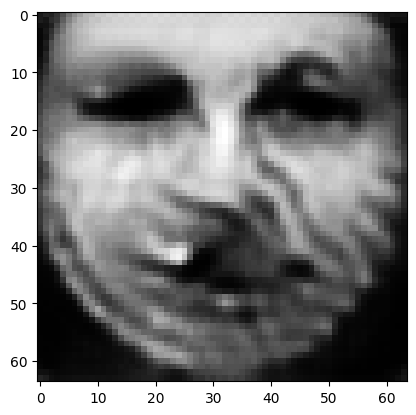

tensor([[1.6143e-04, 1.5056e-03, 1.5684e-03, 9.7607e-01, 7.9021e-05, 5.4793e-04,
         2.0406e-05, 8.7333e-04, 2.7342e-03, 3.7202e-05, 8.1383e-05, 1.1475e-04,
         2.2584e-03, 1.8489e-04, 1.6931e-05, 3.0086e-05, 4.4369e-04, 5.2763e-05,
         3.8851e-04, 6.2793e-05, 3.8419e-05, 4.8481e-06, 2.3475e-04, 5.4455e-05,
         1.0823e-03, 2.4493e-03, 5.8215e-05, 1.4619e-04, 7.1656e-04, 4.9636e-04,
         1.4319e-03, 1.2100e-04, 9.6154e-05, 5.1910e-05, 1.9574e-03, 1.9076e-04,
         2.1398e-04, 2.7641e-03, 5.3016e-04, 1.2925e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024220874533057213
tensor([[1.6041e-04, 1.4898e-03, 1.5600e-03, 9.7631e-01, 7.8175e-05, 5.4428e-04,
         2.0222e-05, 8.6668e-04, 2.7108e-03, 3.6822e-05, 8.0423e-05, 1.1356e-04,
         2.2346e-03, 1.8201e-04, 1.6763e-05, 2.9808e-05, 4.3989e-04, 5.2248e-05,
         3.8449e-04, 6.2294e-05, 3.7970e-05, 4.8098e-06, 2.3070e-04, 5.3915e-05,
         1.0715e-03, 2.4153e-03, 5.7616e-

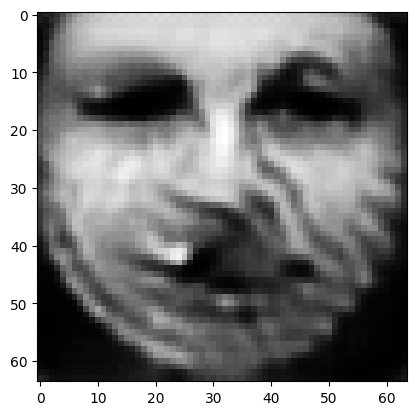

tensor([[1.5644e-04, 1.4345e-03, 1.5232e-03, 9.7720e-01, 7.5016e-05, 5.2901e-04,
         1.9545e-05, 8.4107e-04, 2.6150e-03, 3.5343e-05, 7.6787e-05, 1.0893e-04,
         2.1500e-03, 1.7186e-04, 1.6130e-05, 2.8729e-05, 4.2628e-04, 5.0305e-05,
         3.6959e-04, 6.0431e-05, 3.6194e-05, 4.6567e-06, 2.1672e-04, 5.2028e-05,
         1.0322e-03, 2.2931e-03, 5.5383e-05, 1.3614e-04, 6.7803e-04, 4.7106e-04,
         1.3524e-03, 1.1666e-04, 9.1535e-05, 4.9129e-05, 1.8607e-03, 1.7900e-04,
         2.0149e-04, 2.6578e-03, 5.0968e-04, 1.2185e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02306816354393959
tensor([[1.5538e-04, 1.4213e-03, 1.5137e-03, 9.7740e-01, 7.4259e-05, 5.2495e-04,
         1.9372e-05, 8.3453e-04, 2.5917e-03, 3.4974e-05, 7.5903e-05, 1.0783e-04,
         2.1300e-03, 1.6956e-04, 1.5971e-05, 2.8459e-05, 4.2335e-04, 4.9814e-05,
         3.6598e-04, 5.9974e-05, 3.5779e-05, 4.6198e-06, 2.1372e-04, 5.1606e-05,
         1.0238e-03, 2.2667e-03, 5.4806e-0

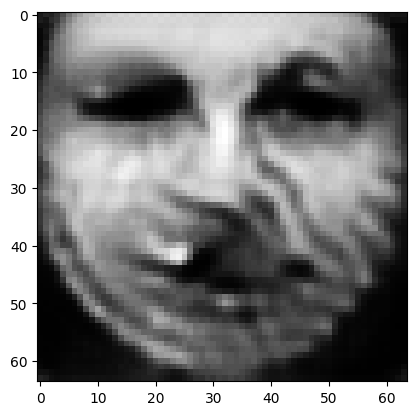

tensor([[1.5180e-04, 1.3682e-03, 1.4816e-03, 9.7821e-01, 7.1345e-05, 5.1097e-04,
         1.8741e-05, 8.1154e-04, 2.5018e-03, 3.3659e-05, 7.2625e-05, 1.0367e-04,
         2.0494e-03, 1.6010e-04, 1.5339e-05, 2.7440e-05, 4.1148e-04, 4.7962e-05,
         3.5226e-04, 5.8194e-05, 3.4160e-05, 4.4770e-06, 2.0112e-04, 4.9883e-05,
         9.8764e-04, 2.1606e-03, 5.2650e-05, 1.2733e-04, 6.4471e-04, 4.4816e-04,
         1.2841e-03, 1.1224e-04, 8.7238e-05, 4.6655e-05, 1.7694e-03, 1.6847e-04,
         1.9019e-04, 2.5616e-03, 4.9170e-04, 1.1523e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02202654257416725
tensor([[1.5097e-04, 1.3554e-03, 1.4735e-03, 9.7841e-01, 7.0683e-05, 5.0766e-04,
         1.8597e-05, 8.0628e-04, 2.4796e-03, 3.3351e-05, 7.1843e-05, 1.0267e-04,
         2.0302e-03, 1.5786e-04, 1.5191e-05, 2.7200e-05, 4.0886e-04, 4.7535e-05,
         3.4904e-04, 5.7783e-05, 3.3769e-05, 4.4434e-06, 1.9817e-04, 4.9502e-05,
         9.7944e-04, 2.1352e-03, 5.2122e-0

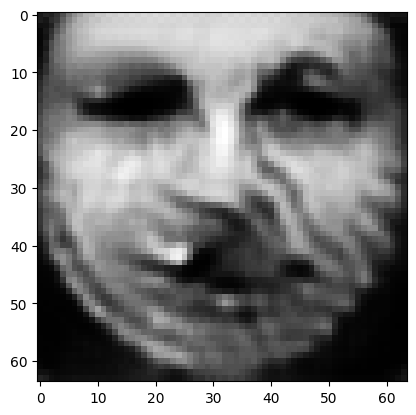

tensor([[1.4769e-04, 1.3084e-03, 1.4428e-03, 9.7912e-01, 6.8211e-05, 4.9467e-04,
         1.8038e-05, 7.8656e-04, 2.3999e-03, 3.2209e-05, 6.8964e-05, 9.8984e-05,
         1.9595e-03, 1.4985e-04, 1.4649e-05, 2.6295e-05, 3.9847e-04, 4.5914e-05,
         3.3672e-04, 5.6238e-05, 3.2335e-05, 4.3166e-06, 1.8752e-04, 4.8034e-05,
         9.4925e-04, 2.0440e-03, 5.0133e-05, 1.1974e-04, 6.1430e-04, 4.2705e-04,
         1.2252e-03, 1.0823e-04, 8.3495e-05, 4.4435e-05, 1.6884e-03, 1.5948e-04,
         1.8020e-04, 2.4744e-03, 4.7520e-04, 1.0927e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021099979057908058
tensor([[1.4698e-04, 1.2976e-03, 1.4361e-03, 9.7929e-01, 6.7645e-05, 4.9186e-04,
         1.7911e-05, 7.8237e-04, 2.3820e-03, 3.1960e-05, 6.8333e-05, 9.8142e-05,
         1.9422e-03, 1.4802e-04, 1.4528e-05, 2.6096e-05, 3.9603e-04, 4.5556e-05,
         3.3393e-04, 5.5896e-05, 3.2000e-05, 4.2864e-06, 1.8489e-04, 4.7681e-05,
         9.4194e-04, 2.0221e-03, 4.9687e-

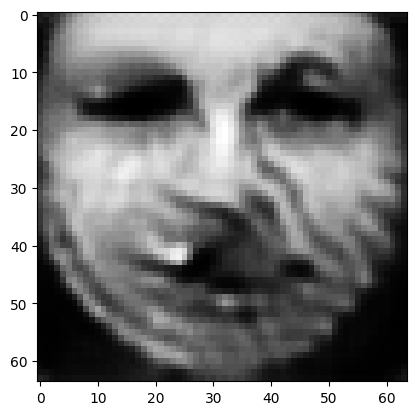

tensor([[1.4316e-04, 1.2629e-03, 1.4011e-03, 9.7991e-01, 6.5367e-05, 4.7614e-04,
         1.7298e-05, 7.6062e-04, 2.3097e-03, 3.0740e-05, 6.5627e-05, 9.4824e-05,
         1.8856e-03, 1.4251e-04, 1.4108e-05, 2.5232e-05, 3.8636e-04, 4.4155e-05,
         3.2263e-04, 5.4406e-05, 3.0762e-05, 4.1608e-06, 1.7783e-04, 4.6368e-05,
         9.1974e-04, 1.9475e-03, 4.7842e-05, 1.1293e-04, 5.8292e-04, 4.0948e-04,
         1.1781e-03, 1.0512e-04, 8.0350e-05, 4.2483e-05, 1.6215e-03, 1.5299e-04,
         1.7195e-04, 2.3978e-03, 4.5803e-04, 1.0365e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02029884047806263
tensor([[1.4207e-04, 1.2548e-03, 1.3920e-03, 9.8006e-01, 6.4802e-05, 4.7183e-04,
         1.7128e-05, 7.5445e-04, 2.2927e-03, 3.0417e-05, 6.4936e-05, 9.4041e-05,
         1.8726e-03, 1.4134e-04, 1.4008e-05, 2.5007e-05, 3.8384e-04, 4.3800e-05,
         3.1971e-04, 5.4031e-05, 3.0474e-05, 4.1287e-06, 1.7634e-04, 4.6022e-05,
         9.1471e-04, 1.9299e-03, 4.7382e-0

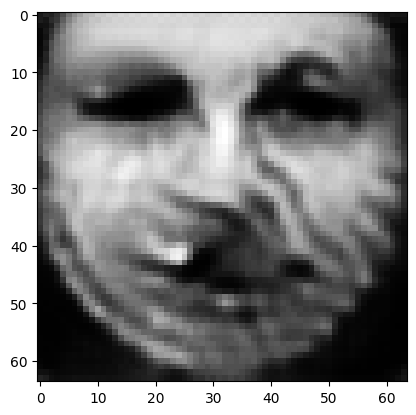

tensor([[1.3834e-04, 1.2250e-03, 1.3585e-03, 9.8062e-01, 6.2593e-05, 4.5695e-04,
         1.6540e-05, 7.3259e-04, 2.2305e-03, 2.9293e-05, 6.2458e-05, 9.1224e-05,
         1.8232e-03, 1.3656e-04, 1.3637e-05, 2.4205e-05, 3.7369e-04, 4.2483e-05,
         3.0924e-04, 5.2673e-05, 2.9381e-05, 4.0097e-06, 1.7019e-04, 4.4645e-05,
         8.9246e-04, 1.8604e-03, 4.5785e-05, 1.0637e-04, 5.5217e-04, 3.9458e-04,
         1.1370e-03, 1.0238e-04, 7.7491e-05, 4.0746e-05, 1.5613e-03, 1.4753e-04,
         1.6418e-04, 2.3287e-03, 4.4206e-04, 9.8606e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019569773226976395
tensor([[1.3744e-04, 1.2174e-03, 1.3507e-03, 9.8075e-01, 6.2111e-05, 4.5355e-04,
         1.6404e-05, 7.2730e-04, 2.2164e-03, 2.9034e-05, 6.1855e-05, 9.0580e-05,
         1.8118e-03, 1.3541e-04, 1.3548e-05, 2.4012e-05, 3.7134e-04, 4.2176e-05,
         3.0666e-04, 5.2381e-05, 2.9120e-05, 3.9825e-06, 1.6873e-04, 4.4315e-05,
         8.8765e-04, 1.8437e-03, 4.5395e-

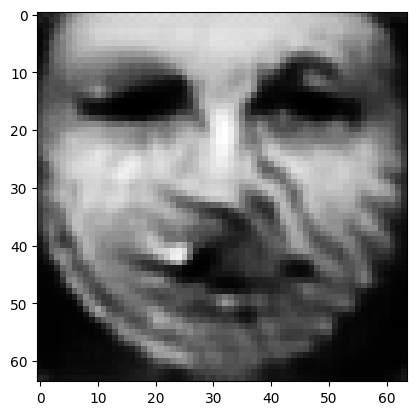

tensor([[1.3432e-04, 1.1893e-03, 1.3234e-03, 9.8125e-01, 6.0127e-05, 4.4150e-04,
         1.5907e-05, 7.0822e-04, 2.1642e-03, 2.8124e-05, 5.9735e-05, 8.8248e-05,
         1.7665e-03, 1.3083e-04, 1.3193e-05, 2.3324e-05, 3.6194e-04, 4.0958e-05,
         2.9751e-04, 5.1227e-05, 2.8151e-05, 3.8809e-06, 1.6272e-04, 4.3016e-05,
         8.6555e-04, 1.7818e-03, 4.4015e-05, 1.0061e-04, 5.2666e-04, 3.8106e-04,
         1.1008e-03, 9.9809e-05, 7.4983e-05, 3.9236e-05, 1.5066e-03, 1.4220e-04,
         1.5707e-04, 2.2709e-03, 4.2894e-04, 9.4439e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018929194658994675
tensor([[1.3372e-04, 1.1821e-03, 1.3180e-03, 9.8137e-01, 5.9641e-05, 4.3897e-04,
         1.5794e-05, 7.0419e-04, 2.1526e-03, 2.7931e-05, 5.9281e-05, 8.7704e-05,
         1.7544e-03, 1.2967e-04, 1.3105e-05, 2.3174e-05, 3.5956e-04, 4.0664e-05,
         2.9551e-04, 5.0948e-05, 2.7923e-05, 3.8574e-06, 1.6100e-04, 4.2702e-05,
         8.5938e-04, 1.7674e-03, 4.3710e-

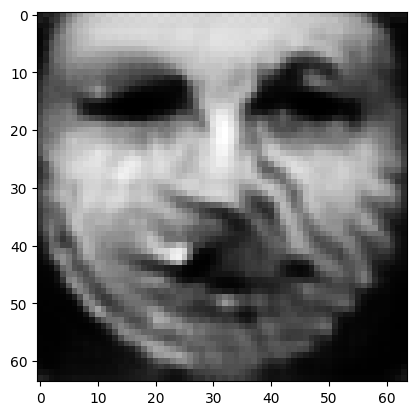

tensor([[1.3090e-04, 1.1573e-03, 1.2936e-03, 9.8180e-01, 5.7889e-05, 4.2763e-04,
         1.5330e-05, 6.8665e-04, 2.1091e-03, 2.7112e-05, 5.7430e-05, 8.5613e-05,
         1.7141e-03, 1.2588e-04, 1.2794e-05, 2.2547e-05, 3.5071e-04, 3.9583e-05,
         2.8741e-04, 4.9864e-05, 2.7100e-05, 3.7670e-06, 1.5573e-04, 4.1513e-05,
         8.3984e-04, 1.7155e-03, 4.2487e-05, 9.5757e-05, 5.0547e-04, 3.6963e-04,
         1.0694e-03, 9.7280e-05, 7.2692e-05, 3.7878e-05, 1.4582e-03, 1.3720e-04,
         1.5075e-04, 2.2222e-03, 4.1716e-04, 9.0830e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018369551748037338
tensor([[1.3031e-04, 1.1521e-03, 1.2880e-03, 9.8190e-01, 5.7406e-05, 4.2506e-04,
         1.5224e-05, 6.8259e-04, 2.0990e-03, 2.6932e-05, 5.7033e-05, 8.5148e-05,
         1.7043e-03, 1.2497e-04, 1.2720e-05, 2.2409e-05, 3.4829e-04, 3.9316e-05,
         2.8565e-04, 4.9579e-05, 2.6906e-05, 3.7450e-06, 1.5436e-04, 4.1204e-05,
         8.3379e-04, 1.7035e-03, 4.2241e-

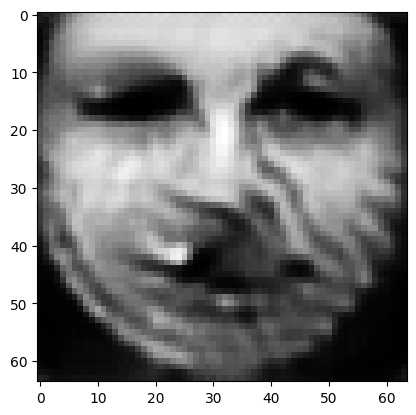

tensor([[1.2765e-04, 1.1309e-03, 1.2646e-03, 9.8229e-01, 5.5798e-05, 4.1425e-04,
         1.4786e-05, 6.6589e-04, 2.0595e-03, 2.6176e-05, 5.5348e-05, 8.3328e-05,
         1.6680e-03, 1.2173e-04, 1.2447e-05, 2.1821e-05, 3.4017e-04, 3.8331e-05,
         2.7845e-04, 4.8576e-05, 2.6186e-05, 3.6624e-06, 1.4992e-04, 4.0132e-05,
         8.1602e-04, 1.6581e-03, 4.1136e-05, 9.1466e-05, 4.8635e-04, 3.5999e-04,
         1.0425e-03, 9.5012e-05, 7.0582e-05, 3.6660e-05, 1.4146e-03, 1.3296e-04,
         1.4514e-04, 2.1780e-03, 4.0603e-04, 8.7573e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017868496477603912
tensor([[1.2701e-04, 1.1260e-03, 1.2588e-03, 9.8238e-01, 5.5460e-05, 4.1163e-04,
         1.4682e-05, 6.6203e-04, 2.0497e-03, 2.5989e-05, 5.4940e-05, 8.2870e-05,
         1.6600e-03, 1.2102e-04, 1.2384e-05, 2.1680e-05, 3.3846e-04, 3.8113e-05,
         2.7674e-04, 4.8349e-05, 2.6015e-05, 3.6428e-06, 1.4901e-04, 3.9904e-05,
         8.1252e-04, 1.6479e-03, 4.0861e-

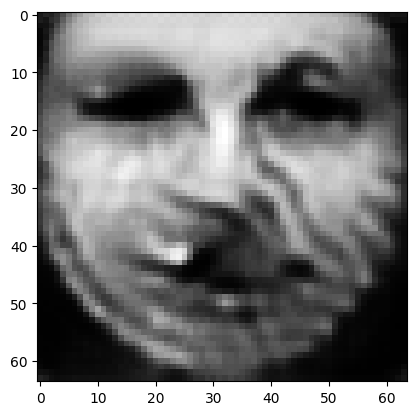

tensor([[1.2475e-04, 1.1069e-03, 1.2389e-03, 9.8273e-01, 5.3969e-05, 4.0225e-04,
         1.4287e-05, 6.4757e-04, 2.0135e-03, 2.5335e-05, 5.3453e-05, 8.1193e-05,
         1.6247e-03, 1.1800e-04, 1.2115e-05, 2.1161e-05, 3.3113e-04, 3.7202e-05,
         2.7042e-04, 4.7398e-05, 2.5351e-05, 3.5680e-06, 1.4486e-04, 3.8916e-05,
         7.9539e-04, 1.6079e-03, 3.9871e-05, 8.7683e-05, 4.6950e-04, 3.5101e-04,
         1.0179e-03, 9.2926e-05, 6.8601e-05, 3.5560e-05, 1.3761e-03, 1.2922e-04,
         1.4013e-04, 2.1380e-03, 3.9581e-04, 8.4682e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01741827093064785
tensor([[1.2425e-04, 1.1022e-03, 1.2344e-03, 9.8282e-01, 5.3584e-05, 4.0007e-04,
         1.4197e-05, 6.4424e-04, 2.0052e-03, 2.5188e-05, 5.3121e-05, 8.0808e-05,
         1.6158e-03, 1.1725e-04, 1.2050e-05, 2.1043e-05, 3.2927e-04, 3.6974e-05,
         2.6900e-04, 4.7167e-05, 2.5193e-05, 3.5503e-06, 1.4378e-04, 3.8670e-05,
         7.9070e-04, 1.5984e-03, 3.9647e-0

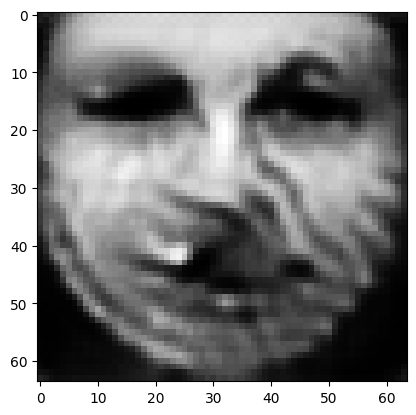

tensor([[1.2214e-04, 1.0851e-03, 1.2150e-03, 9.8314e-01, 5.2233e-05, 3.9120e-04,
         1.3839e-05, 6.3066e-04, 1.9712e-03, 2.4585e-05, 5.1740e-05, 7.9244e-05,
         1.5842e-03, 1.1459e-04, 1.1808e-05, 2.0563e-05, 3.2257e-04, 3.6145e-05,
         2.6326e-04, 4.6294e-05, 2.4588e-05, 3.4803e-06, 1.4019e-04, 3.7775e-05,
         7.7542e-04, 1.5619e-03, 3.8735e-05, 8.4269e-05, 4.5459e-04, 3.4312e-04,
         9.9603e-04, 9.0941e-05, 6.6770e-05, 3.4569e-05, 1.3396e-03, 1.2574e-04,
         1.3548e-04, 2.1018e-03, 3.8644e-04, 8.2086e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017003705725073814
tensor([[1.2165e-04, 1.0811e-03, 1.2105e-03, 9.8322e-01, 5.1925e-05, 3.8923e-04,
         1.3758e-05, 6.2751e-04, 1.9630e-03, 2.4450e-05, 5.1418e-05, 7.8887e-05,
         1.5770e-03, 1.1396e-04, 1.1750e-05, 2.0454e-05, 3.2105e-04, 3.5952e-05,
         2.6195e-04, 4.6095e-05, 2.4448e-05, 3.4641e-06, 1.3937e-04, 3.7569e-05,
         7.7188e-04, 1.5535e-03, 3.8526e-

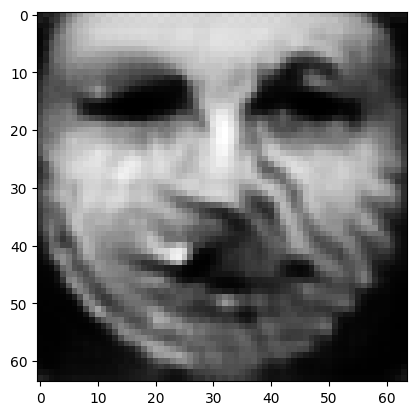

tensor([[1.1986e-04, 1.0657e-03, 1.1936e-03, 9.8350e-01, 5.0741e-05, 3.8181e-04,
         1.3451e-05, 6.1574e-04, 1.9327e-03, 2.3947e-05, 5.0232e-05, 7.7509e-05,
         1.5495e-03, 1.1155e-04, 1.1530e-05, 2.0041e-05, 3.1516e-04, 3.5215e-05,
         2.5709e-04, 4.5326e-05, 2.3914e-05, 3.4018e-06, 1.3615e-04, 3.6769e-05,
         7.5800e-04, 1.5216e-03, 3.7761e-05, 8.1353e-05, 4.4180e-04, 3.3612e-04,
         9.7653e-04, 8.9194e-05, 6.5106e-05, 3.3706e-05, 1.3086e-03, 1.2271e-04,
         1.3147e-04, 2.0692e-03, 3.7822e-04, 7.9848e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01663985103368759
tensor([[1.1941e-04, 1.0619e-03, 1.1894e-03, 9.8356e-01, 5.0451e-05, 3.7991e-04,
         1.3373e-05, 6.1275e-04, 1.9260e-03, 2.3823e-05, 4.9947e-05, 7.7177e-05,
         1.5430e-03, 1.1099e-04, 1.1477e-05, 1.9937e-05, 3.1367e-04, 3.5029e-05,
         2.5590e-04, 4.5129e-05, 2.3790e-05, 3.3870e-06, 1.3540e-04, 3.6570e-05,
         7.5474e-04, 1.5145e-03, 3.7577e-0

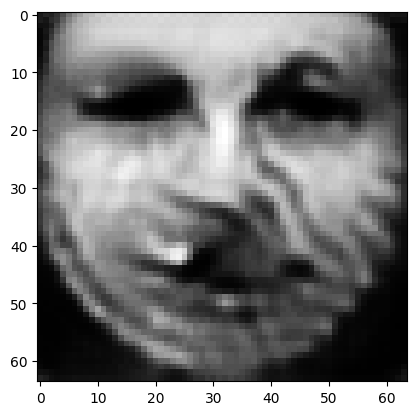

tensor([[1.1781e-04, 1.0463e-03, 1.1747e-03, 9.8382e-01, 4.9396e-05, 3.7329e-04,
         1.3088e-05, 6.0178e-04, 1.8986e-03, 2.3370e-05, 4.8872e-05, 7.5923e-05,
         1.5181e-03, 1.0879e-04, 1.1265e-05, 1.9553e-05, 3.0845e-04, 3.4333e-05,
         2.5147e-04, 4.4408e-05, 2.3315e-05, 3.3315e-06, 1.3249e-04, 3.5842e-05,
         7.4266e-04, 1.4859e-03, 3.6895e-05, 7.8769e-05, 4.3052e-04, 3.2977e-04,
         9.5895e-04, 8.7517e-05, 6.3517e-05, 3.2941e-05, 1.2817e-03, 1.1995e-04,
         1.2793e-04, 2.0395e-03, 3.7093e-04, 7.7833e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01631210558116436
tensor([[1.1742e-04, 1.0424e-03, 1.1712e-03, 9.8388e-01, 4.9137e-05, 3.7166e-04,
         1.3019e-05, 5.9909e-04, 1.8923e-03, 2.3260e-05, 4.8617e-05, 7.5617e-05,
         1.5122e-03, 1.0827e-04, 1.1212e-05, 1.9459e-05, 3.0716e-04, 3.4162e-05,
         2.5040e-04, 4.4227e-05, 2.3202e-05, 3.3181e-06, 1.3179e-04, 3.5660e-05,
         7.3969e-04, 1.4794e-03, 3.6733e-0

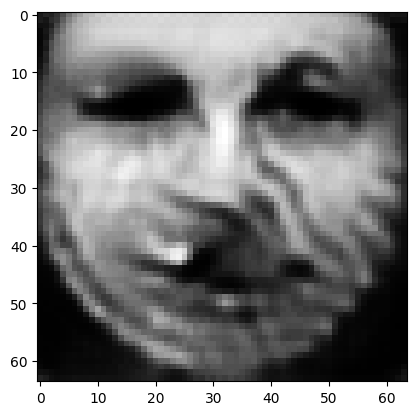

tensor([[1.1604e-04, 1.0278e-03, 1.1580e-03, 9.8411e-01, 4.8216e-05, 3.6572e-04,
         1.2773e-05, 5.8966e-04, 1.8675e-03, 2.2851e-05, 4.7671e-05, 7.4432e-05,
         1.4893e-03, 1.0628e-04, 1.1025e-05, 1.9114e-05, 3.0253e-04, 3.3558e-05,
         2.4651e-04, 4.3581e-05, 2.2764e-05, 3.2680e-06, 1.2910e-04, 3.5022e-05,
         7.2899e-04, 1.4534e-03, 3.6128e-05, 7.6523e-05, 4.2044e-04, 3.2401e-04,
         9.4290e-04, 8.5964e-05, 6.2084e-05, 3.2254e-05, 1.2570e-03, 1.1744e-04,
         1.2479e-04, 2.0130e-03, 3.6446e-04, 7.5986e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01601557806134224
tensor([[1.1573e-04, 1.0244e-03, 1.1550e-03, 9.8417e-01, 4.7991e-05, 3.6441e-04,
         1.2716e-05, 5.8740e-04, 1.8615e-03, 2.2757e-05, 4.7445e-05, 7.4162e-05,
         1.4839e-03, 1.0577e-04, 1.0980e-05, 1.9035e-05, 3.0143e-04, 3.3412e-05,
         2.4560e-04, 4.3432e-05, 2.2660e-05, 3.2562e-06, 1.2844e-04, 3.4869e-05,
         7.2628e-04, 1.4469e-03, 3.5987e-0

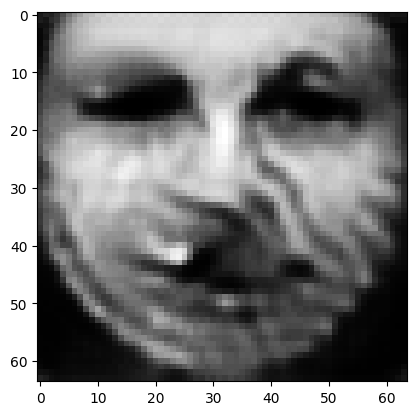

tensor([[1.1446e-04, 1.0120e-03, 1.1421e-03, 9.8438e-01, 4.7088e-05, 3.5890e-04,
         1.2493e-05, 5.7835e-04, 1.8385e-03, 2.2377e-05, 4.6586e-05, 7.3112e-05,
         1.4635e-03, 1.0395e-04, 1.0816e-05, 1.8725e-05, 2.9699e-04, 3.2855e-05,
         2.4211e-04, 4.2845e-05, 2.2265e-05, 3.2092e-06, 1.2602e-04, 3.4274e-05,
         7.1562e-04, 1.4225e-03, 3.5447e-05, 7.4432e-05, 4.1119e-04, 3.1897e-04,
         9.2814e-04, 8.4564e-05, 6.0799e-05, 3.1617e-05, 1.2337e-03, 1.1516e-04,
         1.2181e-04, 1.9882e-03, 3.5858e-04, 7.4295e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015741726383566856
tensor([[1.1416e-04, 1.0090e-03, 1.1390e-03, 9.8443e-01, 4.6879e-05, 3.5758e-04,
         1.2441e-05, 5.7626e-04, 1.8331e-03, 2.2287e-05, 4.6387e-05, 7.2864e-05,
         1.4588e-03, 1.0353e-04, 1.0778e-05, 1.8651e-05, 2.9597e-04, 3.2726e-05,
         2.4128e-04, 4.2713e-05, 2.2170e-05, 3.1980e-06, 1.2545e-04, 3.4140e-05,
         7.1320e-04, 1.4168e-03, 3.5318e-

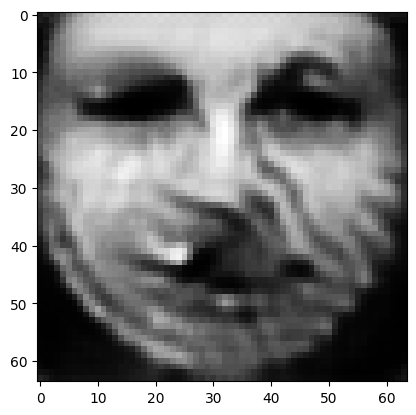

tensor([[1.1309e-04, 9.9761e-04, 1.1282e-03, 9.8462e-01, 4.6098e-05, 3.5300e-04,
         1.2250e-05, 5.6857e-04, 1.8133e-03, 2.1969e-05, 4.5649e-05, 7.1944e-05,
         1.4405e-03, 1.0186e-04, 1.0630e-05, 1.8385e-05, 2.9205e-04, 3.2237e-05,
         2.3818e-04, 4.2214e-05, 2.1820e-05, 3.1561e-06, 1.2317e-04, 3.3616e-05,
         7.0351e-04, 1.3947e-03, 3.4844e-05, 7.2613e-05, 4.0314e-04, 3.1440e-04,
         9.1504e-04, 8.3280e-05, 5.9653e-05, 3.1049e-05, 1.2126e-03, 1.1306e-04,
         1.1909e-04, 1.9663e-03, 3.5358e-04, 7.2787e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015498669818043709
tensor([[1.1285e-04, 9.9492e-04, 1.1257e-03, 9.8467e-01, 4.5909e-05, 3.5192e-04,
         1.2204e-05, 5.6676e-04, 1.8087e-03, 2.1894e-05, 4.5478e-05, 7.1729e-05,
         1.4361e-03, 1.0147e-04, 1.0595e-05, 1.8324e-05, 2.9110e-04, 3.2121e-05,
         2.3745e-04, 4.2097e-05, 2.1739e-05, 3.1461e-06, 1.2262e-04, 3.3489e-05,
         7.0113e-04, 1.3894e-03, 3.4735e-

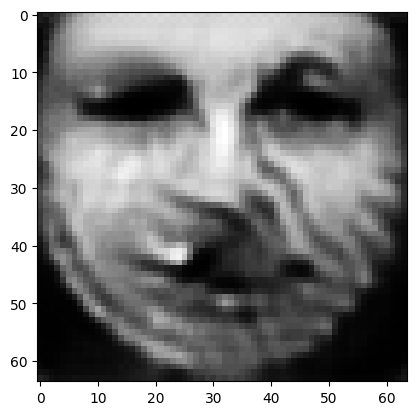

tensor([[1.1185e-04, 9.8476e-04, 1.1156e-03, 9.8484e-01, 4.5206e-05, 3.4779e-04,
         1.2032e-05, 5.5976e-04, 1.7907e-03, 2.1607e-05, 4.4817e-05, 7.0907e-05,
         1.4200e-03, 9.9983e-05, 1.0462e-05, 1.8090e-05, 2.8764e-04, 3.1681e-05,
         2.3467e-04, 4.1656e-05, 2.1432e-05, 3.1078e-06, 1.2065e-04, 3.3020e-05,
         6.9251e-04, 1.3693e-03, 3.4306e-05, 7.0972e-05, 3.9602e-04, 3.1029e-04,
         9.0305e-04, 8.2105e-05, 5.8611e-05, 3.0540e-05, 1.1939e-03, 1.1116e-04,
         1.1661e-04, 1.9460e-03, 3.4913e-04, 7.1473e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015279622748494148
tensor([[1.1160e-04, 9.8245e-04, 1.1131e-03, 9.8488e-01, 4.5030e-05, 3.4674e-04,
         1.1988e-05, 5.5798e-04, 1.7864e-03, 2.1535e-05, 4.4656e-05, 7.0709e-05,
         1.4162e-03, 9.9645e-05, 1.0430e-05, 1.8033e-05, 2.8680e-04, 3.1574e-05,
         2.3400e-04, 4.1545e-05, 2.1358e-05, 3.0983e-06, 1.2020e-04, 3.2905e-05,
         6.9042e-04, 1.3645e-03, 3.4203e-

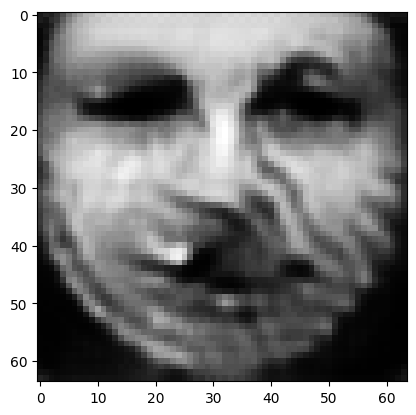

tensor([[1.1059e-04, 9.7345e-04, 1.1029e-03, 9.8504e-01, 4.4359e-05, 3.4262e-04,
         1.1819e-05, 5.5105e-04, 1.7697e-03, 2.1254e-05, 4.4032e-05, 6.9940e-05,
         1.4018e-03, 9.8348e-05, 1.0307e-05, 1.7811e-05, 2.8348e-04, 3.1157e-05,
         2.3138e-04, 4.1111e-05, 2.1077e-05, 3.0616e-06, 1.1851e-04, 3.2458e-05,
         6.8247e-04, 1.3466e-03, 3.3804e-05, 6.9434e-05, 3.8923e-04, 3.0664e-04,
         8.9208e-04, 8.1036e-05, 5.7623e-05, 3.0067e-05, 1.1771e-03, 1.0950e-04,
         1.1436e-04, 1.9265e-03, 3.4476e-04, 7.0256e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015076849609613419
tensor([[1.1037e-04, 9.7144e-04, 1.1006e-03, 9.8507e-01, 4.4198e-05, 3.4172e-04,
         1.1782e-05, 5.4951e-04, 1.7659e-03, 2.1193e-05, 4.3893e-05, 6.9766e-05,
         1.3985e-03, 9.8030e-05, 1.0280e-05, 1.7761e-05, 2.8271e-04, 3.1061e-05,
         2.3080e-04, 4.1016e-05, 2.1011e-05, 3.0529e-06, 1.1810e-04, 3.2355e-05,
         6.8049e-04, 1.3422e-03, 3.3714e-

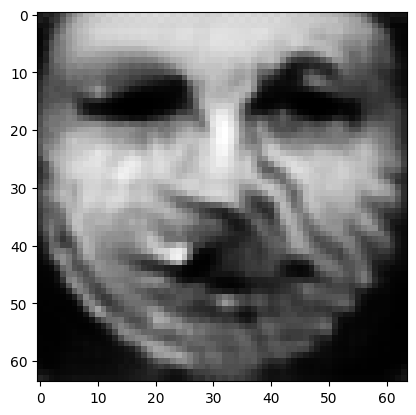

tensor([[1.0950e-04, 9.6367e-04, 1.0914e-03, 9.8522e-01, 4.3584e-05, 3.3815e-04,
         1.1636e-05, 5.4338e-04, 1.7512e-03, 2.0948e-05, 4.3348e-05, 6.9097e-05,
         1.3863e-03, 9.6837e-05, 1.0176e-05, 1.7563e-05, 2.7972e-04, 3.0690e-05,
         2.2850e-04, 4.0652e-05, 2.0758e-05, 3.0199e-06, 1.1658e-04, 3.1955e-05,
         6.7307e-04, 1.3255e-03, 3.3364e-05, 6.8040e-05, 3.8306e-04, 3.0354e-04,
         8.8265e-04, 8.0061e-05, 5.6754e-05, 2.9654e-05, 1.1616e-03, 1.0799e-04,
         1.1226e-04, 1.9083e-03, 3.4108e-04, 6.9196e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014895175583660603
tensor([[1.0930e-04, 9.6180e-04, 1.0892e-03, 9.8525e-01, 4.3436e-05, 3.3733e-04,
         1.1600e-05, 5.4192e-04, 1.7477e-03, 2.0892e-05, 4.3219e-05, 6.8940e-05,
         1.3834e-03, 9.6543e-05, 1.0150e-05, 1.7516e-05, 2.7900e-04, 3.0599e-05,
         2.2795e-04, 4.0565e-05, 2.0699e-05, 3.0120e-06, 1.1621e-04, 3.1858e-05,
         6.7125e-04, 1.3215e-03, 3.3281e-

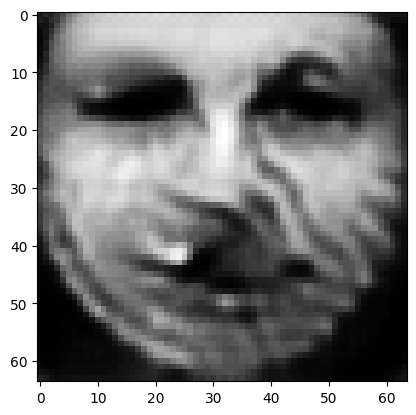

tensor([[1.0846e-04, 9.5486e-04, 1.0805e-03, 9.8538e-01, 4.2906e-05, 3.3390e-04,
         1.1461e-05, 5.3642e-04, 1.7345e-03, 2.0661e-05, 4.2717e-05, 6.8305e-05,
         1.3720e-03, 9.5529e-05, 1.0059e-05, 1.7332e-05, 2.7628e-04, 3.0264e-05,
         2.2581e-04, 4.0230e-05, 2.0467e-05, 2.9813e-06, 1.1486e-04, 3.1507e-05,
         6.6497e-04, 1.3069e-03, 3.2937e-05, 6.6758e-05, 3.7724e-04, 3.0065e-04,
         8.7386e-04, 7.9192e-05, 5.5969e-05, 2.9268e-05, 1.1479e-03, 1.0669e-04,
         1.1036e-04, 1.8915e-03, 3.3767e-04, 6.8201e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014729914255440235
tensor([[1.0828e-04, 9.5311e-04, 1.0785e-03, 9.8541e-01, 4.2780e-05, 3.3311e-04,
         1.1428e-05, 5.3516e-04, 1.7313e-03, 2.0608e-05, 4.2597e-05, 6.8151e-05,
         1.3691e-03, 9.5270e-05, 1.0037e-05, 1.7289e-05, 2.7561e-04, 3.0185e-05,
         2.2530e-04, 4.0155e-05, 2.0409e-05, 2.9739e-06, 1.1449e-04, 3.1423e-05,
         6.6340e-04, 1.3031e-03, 3.2856e-

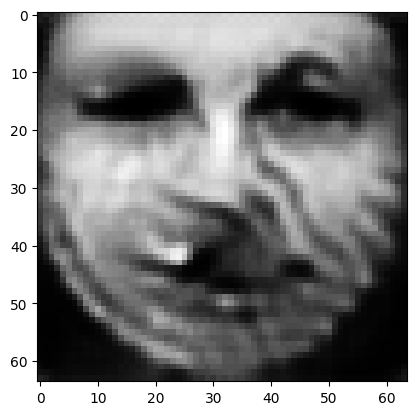

tensor([[1.0756e-04, 9.4625e-04, 1.0708e-03, 9.8553e-01, 4.2281e-05, 3.3017e-04,
         1.1299e-05, 5.3013e-04, 1.7187e-03, 2.0402e-05, 4.2124e-05, 6.7549e-05,
         1.3577e-03, 9.4210e-05, 9.9475e-06, 1.7118e-05, 2.7297e-04, 2.9868e-05,
         2.2329e-04, 3.9846e-05, 2.0184e-05, 2.9447e-06, 1.1304e-04, 3.1079e-05,
         6.5697e-04, 1.2884e-03, 3.2541e-05, 6.5550e-05, 3.7186e-04, 2.9783e-04,
         8.6491e-04, 7.8335e-05, 5.5224e-05, 2.8889e-05, 1.1348e-03, 1.0536e-04,
         1.0847e-04, 1.8758e-03, 3.3465e-04, 6.7268e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014572027139365673
tensor([[1.0739e-04, 9.4463e-04, 1.0690e-03, 9.8556e-01, 4.2162e-05, 3.2948e-04,
         1.1266e-05, 5.2890e-04, 1.7157e-03, 2.0353e-05, 4.2010e-05, 6.7404e-05,
         1.3550e-03, 9.3955e-05, 9.9258e-06, 1.7078e-05, 2.7233e-04, 2.9793e-05,
         2.2280e-04, 3.9768e-05, 2.0130e-05, 2.9376e-06, 1.1269e-04, 3.0994e-05,
         6.5541e-04, 1.2848e-03, 3.2466e-

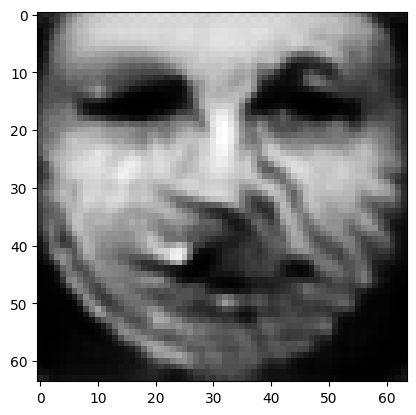

tensor([[1.0667e-04, 9.3852e-04, 1.0614e-03, 9.8568e-01, 4.1709e-05, 3.2660e-04,
         1.1140e-05, 5.2408e-04, 1.7036e-03, 2.0155e-05, 4.1564e-05, 6.6835e-05,
         1.3447e-03, 9.3023e-05, 9.8444e-06, 1.6916e-05, 2.6990e-04, 2.9505e-05,
         2.2091e-04, 3.9465e-05, 1.9923e-05, 2.9097e-06, 1.1142e-04, 3.0675e-05,
         6.4971e-04, 1.2716e-03, 3.2167e-05, 6.4442e-05, 3.6681e-04, 2.9524e-04,
         8.5627e-04, 7.7548e-05, 5.4512e-05, 2.8525e-05, 1.1233e-03, 1.0416e-04,
         1.0676e-04, 1.8607e-03, 3.3167e-04, 6.6400e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014424690045416355
tensor([[1.0646e-04, 9.3712e-04, 1.0593e-03, 9.8571e-01, 4.1601e-05, 3.2581e-04,
         1.1107e-05, 5.2280e-04, 1.7007e-03, 2.0103e-05, 4.1449e-05, 6.6700e-05,
         1.3424e-03, 9.2818e-05, 9.8257e-06, 1.6873e-05, 2.6931e-04, 2.9435e-05,
         2.2042e-04, 3.9391e-05, 1.9876e-05, 2.9029e-06, 1.1117e-04, 3.0599e-05,
         6.4851e-04, 1.2685e-03, 3.2089e-

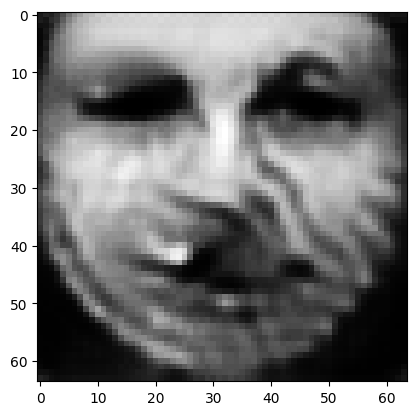

tensor([[1.0567e-04, 9.3171e-04, 1.0515e-03, 9.8581e-01, 4.1181e-05, 3.2271e-04,
         1.0982e-05, 5.1790e-04, 1.6892e-03, 1.9901e-05, 4.1010e-05, 6.6168e-05,
         1.3336e-03, 9.2039e-05, 9.7515e-06, 1.6709e-05, 2.6712e-04, 2.9165e-05,
         2.1856e-04, 3.9094e-05, 1.9691e-05, 2.8768e-06, 1.1022e-04, 3.0312e-05,
         6.4390e-04, 1.2571e-03, 3.1790e-05, 6.3388e-05, 3.6175e-04, 2.9287e-04,
         8.4888e-04, 7.6876e-05, 5.3866e-05, 2.8202e-05, 1.1129e-03, 1.0325e-04,
         1.0526e-04, 1.8456e-03, 3.2878e-04, 6.5554e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014288613572716713
tensor([[1.0547e-04, 9.3042e-04, 1.0494e-03, 9.8584e-01, 4.1079e-05, 3.2192e-04,
         1.0950e-05, 5.1669e-04, 1.6863e-03, 1.9850e-05, 4.0902e-05, 6.6033e-05,
         1.3314e-03, 9.1859e-05, 9.7334e-06, 1.6668e-05, 2.6658e-04, 2.9097e-05,
         2.1812e-04, 3.9017e-05, 1.9645e-05, 2.8704e-06, 1.1000e-04, 3.0243e-05,
         6.4280e-04, 1.2545e-03, 3.1716e-

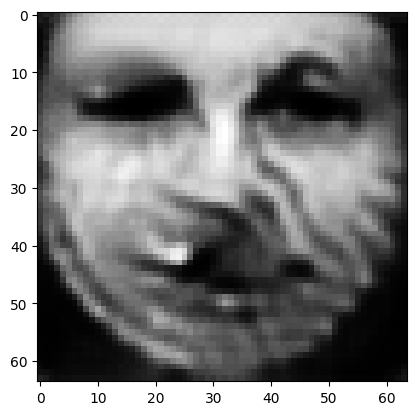

tensor([[1.0468e-04, 9.2555e-04, 1.0416e-03, 9.8594e-01, 4.0667e-05, 3.1887e-04,
         1.0828e-05, 5.1185e-04, 1.6753e-03, 1.9655e-05, 4.0483e-05, 6.5531e-05,
         1.3233e-03, 9.1153e-05, 9.6640e-06, 1.6510e-05, 2.6445e-04, 2.8835e-05,
         2.1635e-04, 3.8728e-05, 1.9472e-05, 2.8455e-06, 1.0916e-04, 2.9965e-05,
         6.3843e-04, 1.2438e-03, 3.1433e-05, 6.2389e-05, 3.5687e-04, 2.9077e-04,
         8.4215e-04, 7.6245e-05, 5.3247e-05, 2.7899e-05, 1.1031e-03, 1.0243e-04,
         1.0386e-04, 1.8312e-03, 3.2590e-04, 6.4751e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014159687794744968
tensor([[1.0448e-04, 9.2440e-04, 1.0396e-03, 9.8596e-01, 4.0567e-05, 3.1811e-04,
         1.0798e-05, 5.1064e-04, 1.6727e-03, 1.9606e-05, 4.0380e-05, 6.5410e-05,
         1.3214e-03, 9.0992e-05, 9.6473e-06, 1.6471e-05, 2.6393e-04, 2.8771e-05,
         2.1591e-04, 3.8657e-05, 1.9431e-05, 2.8395e-06, 1.0898e-04, 2.9896e-05,
         6.3739e-04, 1.2413e-03, 3.1365e-

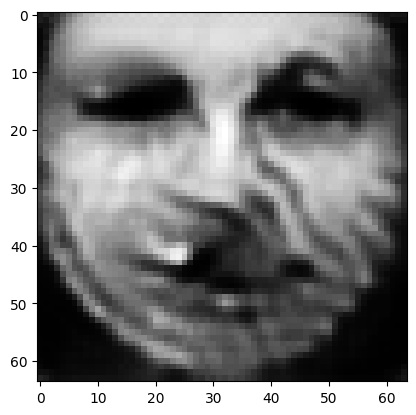

tensor([[1.0371e-04, 9.1993e-04, 1.0321e-03, 9.8606e-01, 4.0180e-05, 3.1513e-04,
         1.0682e-05, 5.0595e-04, 1.6624e-03, 1.9416e-05, 3.9981e-05, 6.4938e-05,
         1.3141e-03, 9.0368e-05, 9.5829e-06, 1.6320e-05, 2.6196e-04, 2.8525e-05,
         2.1423e-04, 3.8382e-05, 1.9272e-05, 2.8161e-06, 1.0826e-04, 2.9636e-05,
         6.3342e-04, 1.2315e-03, 3.1098e-05, 6.1444e-05, 3.5222e-04, 2.8886e-04,
         8.3604e-04, 7.5663e-05, 5.2673e-05, 2.7623e-05, 1.0938e-03, 1.0168e-04,
         1.0256e-04, 1.8176e-03, 3.2322e-04, 6.4007e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014039326459169388
tensor([[1.0352e-04, 9.1885e-04, 1.0303e-03, 9.8608e-01, 4.0085e-05, 3.1441e-04,
         1.0654e-05, 5.0480e-04, 1.6600e-03, 1.9370e-05, 3.9885e-05, 6.4827e-05,
         1.3124e-03, 9.0216e-05, 9.5672e-06, 1.6283e-05, 2.6146e-04, 2.8465e-05,
         2.1382e-04, 3.8314e-05, 1.9233e-05, 2.8104e-06, 1.0809e-04, 2.9572e-05,
         6.3246e-04, 1.2292e-03, 3.1035e-

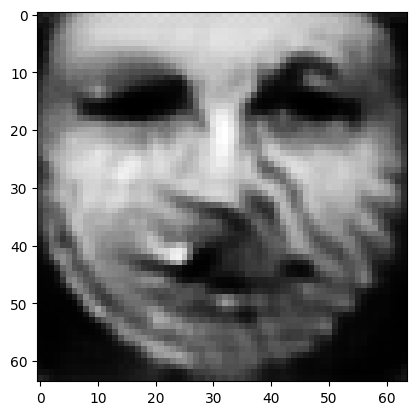

tensor([[1.0291e-04, 9.1367e-04, 1.0247e-03, 9.8617e-01, 3.9712e-05, 3.1171e-04,
         1.0555e-05, 5.0089e-04, 1.6515e-03, 1.9206e-05, 3.9547e-05, 6.4373e-05,
         1.3040e-03, 8.9614e-05, 9.5005e-06, 1.6146e-05, 2.5929e-04, 2.8223e-05,
         2.1235e-04, 3.8033e-05, 1.9073e-05, 2.7901e-06, 1.0718e-04, 2.9306e-05,
         6.2784e-04, 1.2203e-03, 3.0811e-05, 6.0631e-05, 3.4838e-04, 2.8708e-04,
         8.3055e-04, 7.5028e-05, 5.2143e-05, 2.7377e-05, 1.0836e-03, 1.0073e-04,
         1.0137e-04, 1.8074e-03, 3.2079e-04, 6.3358e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013928355649113655
tensor([[1.0277e-04, 9.1242e-04, 1.0233e-03, 9.8619e-01, 3.9623e-05, 3.1105e-04,
         1.0531e-05, 4.9999e-04, 1.6494e-03, 1.9166e-05, 3.9467e-05, 6.4260e-05,
         1.3019e-03, 8.9474e-05, 9.4845e-06, 1.6113e-05, 2.5877e-04, 2.8166e-05,
         2.1200e-04, 3.7965e-05, 1.9034e-05, 2.7851e-06, 1.0696e-04, 2.9244e-05,
         6.2674e-04, 1.2182e-03, 3.0756e-

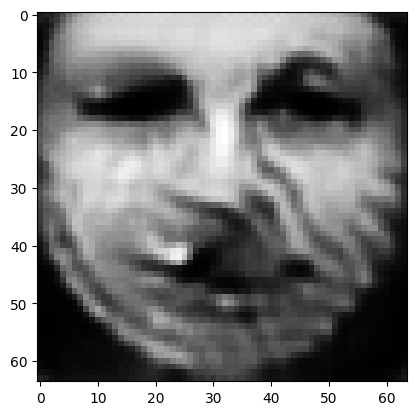

tensor([[1.0222e-04, 9.0755e-04, 1.0179e-03, 9.8627e-01, 3.9277e-05, 3.0855e-04,
         1.0439e-05, 4.9649e-04, 1.6412e-03, 1.9013e-05, 3.9156e-05, 6.3820e-05,
         1.2936e-03, 8.8911e-05, 9.4223e-06, 1.5986e-05, 2.5674e-04, 2.7943e-05,
         2.1067e-04, 3.7699e-05, 1.8879e-05, 2.7661e-06, 1.0607e-04, 2.9000e-05,
         6.2238e-04, 1.2098e-03, 3.0547e-05, 5.9911e-05, 3.4486e-04, 2.8539e-04,
         8.2520e-04, 7.4417e-05, 5.1649e-05, 2.7141e-05, 1.0737e-03, 9.9778e-05,
         1.0027e-04, 1.7987e-03, 3.1842e-04, 6.2743e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013823486864566803
tensor([[1.0210e-04, 9.0639e-04, 1.0167e-03, 9.8629e-01, 3.9196e-05, 3.0802e-04,
         1.0418e-05, 4.9568e-04, 1.6392e-03, 1.8979e-05, 3.9082e-05, 6.3717e-05,
         1.2916e-03, 8.8760e-05, 9.4072e-06, 1.5957e-05, 2.5628e-04, 2.7891e-05,
         2.1037e-04, 3.7638e-05, 1.8841e-05, 2.7615e-06, 1.0584e-04, 2.8942e-05,
         6.2132e-04, 1.2077e-03, 3.0498e-

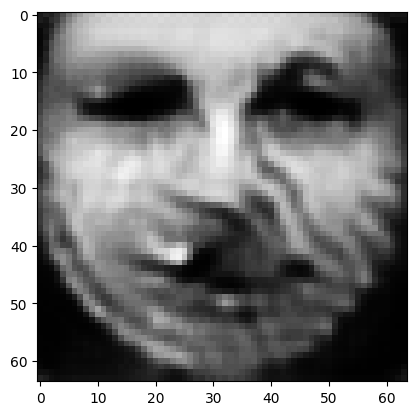

tensor([[1.0163e-04, 9.0197e-04, 1.0119e-03, 9.8637e-01, 3.8893e-05, 3.0591e-04,
         1.0339e-05, 4.9264e-04, 1.6312e-03, 1.8847e-05, 3.8798e-05, 6.3320e-05,
         1.2839e-03, 8.8205e-05, 9.3506e-06, 1.5845e-05, 2.5453e-04, 2.7695e-05,
         2.0919e-04, 3.7410e-05, 1.8697e-05, 2.7441e-06, 1.0501e-04, 2.8729e-05,
         6.1739e-04, 1.1996e-03, 3.0307e-05, 5.9250e-05, 3.4168e-04, 2.8371e-04,
         8.1986e-04, 7.3869e-05, 5.1201e-05, 2.6920e-05, 1.0646e-03, 9.8901e-05,
         9.9237e-05, 1.7906e-03, 3.1631e-04, 6.2182e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01372624933719635
tensor([[1.0151e-04, 9.0093e-04, 1.0107e-03, 9.8639e-01, 3.8820e-05, 3.0539e-04,
         1.0319e-05, 4.9191e-04, 1.6293e-03, 1.8815e-05, 3.8729e-05, 6.3224e-05,
         1.2821e-03, 8.8074e-05, 9.3369e-06, 1.5818e-05, 2.5412e-04, 2.7647e-05,
         2.0891e-04, 3.7354e-05, 1.8662e-05, 2.7399e-06, 1.0482e-04, 2.8679e-05,
         6.1648e-04, 1.1977e-03, 3.0260e-0

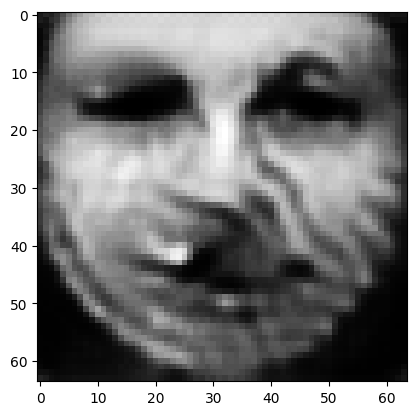

tensor([[1.0106e-04, 8.9663e-04, 1.0061e-03, 9.8646e-01, 3.8532e-05, 3.0336e-04,
         1.0244e-05, 4.8909e-04, 1.6213e-03, 1.8689e-05, 3.8458e-05, 6.2837e-05,
         1.2746e-03, 8.7541e-05, 9.2825e-06, 1.5710e-05, 2.5249e-04, 2.7460e-05,
         2.0781e-04, 3.7131e-05, 1.8523e-05, 2.7234e-06, 1.0403e-04, 2.8478e-05,
         6.1279e-04, 1.1900e-03, 3.0076e-05, 5.8632e-05, 3.3865e-04, 2.8209e-04,
         8.1477e-04, 7.3353e-05, 5.0778e-05, 2.6711e-05, 1.0560e-03, 9.8093e-05,
         9.8286e-05, 1.7830e-03, 3.1424e-04, 6.1644e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01363370567560196
tensor([[1.0095e-04, 8.9557e-04, 1.0050e-03, 9.8648e-01, 3.8461e-05, 3.0287e-04,
         1.0225e-05, 4.8839e-04, 1.6194e-03, 1.8658e-05, 3.8392e-05, 6.2744e-05,
         1.2728e-03, 8.7408e-05, 9.2693e-06, 1.5683e-05, 2.5209e-04, 2.7415e-05,
         2.0754e-04, 3.7077e-05, 1.8489e-05, 2.7194e-06, 1.0384e-04, 2.8427e-05,
         6.1188e-04, 1.1881e-03, 3.0033e-0

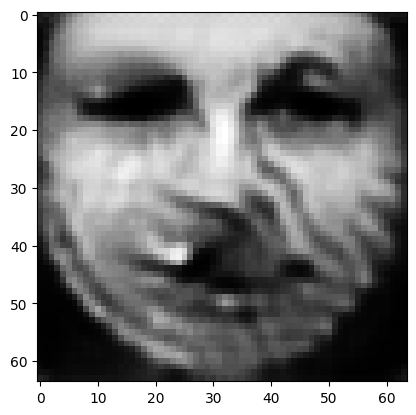

tensor([[1.0057e-04, 8.9137e-04, 1.0011e-03, 9.8654e-01, 3.8189e-05, 3.0111e-04,
         1.0157e-05, 4.8583e-04, 1.6123e-03, 1.8546e-05, 3.8145e-05, 6.2391e-05,
         1.2656e-03, 8.6863e-05, 9.2171e-06, 1.5585e-05, 2.5053e-04, 2.7238e-05,
         2.0652e-04, 3.6877e-05, 1.8359e-05, 2.7041e-06, 1.0303e-04, 2.8232e-05,
         6.0819e-04, 1.1806e-03, 2.9868e-05, 5.8052e-05, 3.3591e-04, 2.8055e-04,
         8.0984e-04, 7.2840e-05, 5.0375e-05, 2.6512e-05, 1.0478e-03, 9.7258e-05,
         9.7361e-05, 1.7759e-03, 3.1240e-04, 6.1156e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013546564616262913
tensor([[1.0049e-04, 8.9037e-04, 1.0002e-03, 9.8656e-01, 3.8128e-05, 3.0074e-04,
         1.0141e-05, 4.8527e-04, 1.6106e-03, 1.8521e-05, 3.8088e-05, 6.2309e-05,
         1.2639e-03, 8.6724e-05, 9.2050e-06, 1.5562e-05, 2.5016e-04, 2.7198e-05,
         2.0629e-04, 3.6834e-05, 1.8328e-05, 2.7005e-06, 1.0282e-04, 2.8187e-05,
         6.0730e-04, 1.1787e-03, 2.9830e-

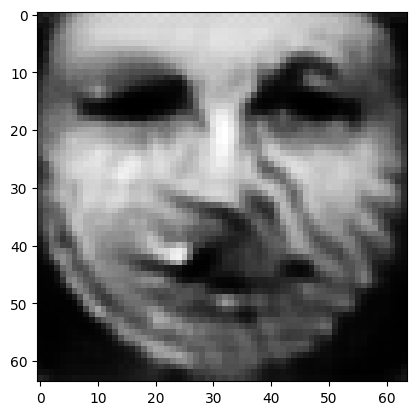

tensor([[1.0016e-04, 8.8640e-04, 9.9682e-04, 9.8662e-01, 3.7884e-05, 2.9925e-04,
         1.0080e-05, 4.8299e-04, 1.6041e-03, 1.8421e-05, 3.7862e-05, 6.1989e-05,
         1.2572e-03, 8.6188e-05, 9.1570e-06, 1.5473e-05, 2.4871e-04, 2.7037e-05,
         2.0535e-04, 3.6659e-05, 1.8207e-05, 2.6863e-06, 1.0202e-04, 2.8004e-05,
         6.0378e-04, 1.1714e-03, 2.9681e-05, 5.7510e-05, 3.3342e-04, 2.7906e-04,
         8.0496e-04, 7.2369e-05, 5.0006e-05, 2.6322e-05, 1.0404e-03, 9.6456e-05,
         9.6470e-05, 1.7694e-03, 3.1078e-04, 6.0717e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013465765863656998
tensor([[1.0009e-04, 8.8546e-04, 9.9602e-04, 9.8664e-01, 3.7826e-05, 2.9891e-04,
         1.0066e-05, 4.8247e-04, 1.6025e-03, 1.8398e-05, 3.7807e-05, 6.1912e-05,
         1.2556e-03, 8.6057e-05, 9.1455e-06, 1.5452e-05, 2.4837e-04, 2.6999e-05,
         2.0513e-04, 3.6618e-05, 1.8177e-05, 2.6830e-06, 1.0183e-04, 2.7962e-05,
         6.0294e-04, 1.1697e-03, 2.9645e-

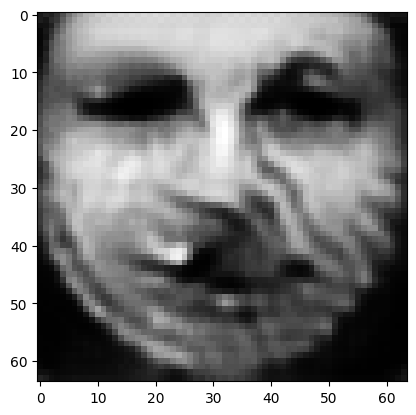

tensor([[9.9788e-05, 8.8180e-04, 9.9292e-04, 9.8670e-01, 3.7603e-05, 2.9749e-04,
         1.0010e-05, 4.8042e-04, 1.5964e-03, 1.8304e-05, 3.7602e-05, 6.1613e-05,
         1.2494e-03, 8.5586e-05, 9.1012e-06, 1.5370e-05, 2.4705e-04, 2.6853e-05,
         2.0427e-04, 3.6456e-05, 1.8065e-05, 2.6702e-06, 1.0111e-04, 2.7800e-05,
         5.9977e-04, 1.1631e-03, 2.9506e-05, 5.7024e-05, 3.3111e-04, 2.7767e-04,
         8.0061e-04, 7.1932e-05, 4.9672e-05, 2.6150e-05, 1.0333e-03, 9.5713e-05,
         9.5664e-05, 1.7636e-03, 3.0927e-04, 6.0305e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01339154876768589
tensor([[9.9715e-05, 8.8093e-04, 9.9214e-04, 9.8671e-01, 3.7551e-05, 2.9715e-04,
         9.9962e-06, 4.7993e-04, 1.5949e-03, 1.8281e-05, 3.7552e-05, 6.1541e-05,
         1.2479e-03, 8.5472e-05, 9.0906e-06, 1.5350e-05, 2.4675e-04, 2.6818e-05,
         2.0407e-04, 3.6417e-05, 1.8038e-05, 2.6671e-06, 1.0095e-04, 2.7763e-05,
         5.9904e-04, 1.1616e-03, 2.9472e-0

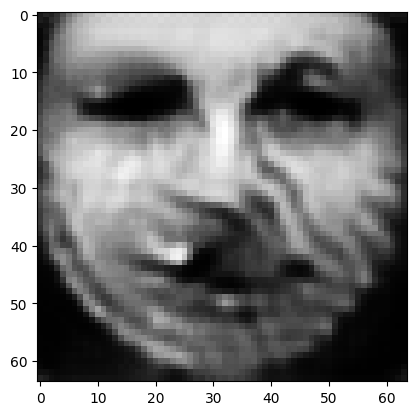

tensor([[9.9430e-05, 8.7752e-04, 9.8915e-04, 9.8677e-01, 3.7347e-05, 2.9584e-04,
         9.9443e-06, 4.7803e-04, 1.5891e-03, 1.8193e-05, 3.7357e-05, 6.1259e-05,
         1.2423e-03, 8.5028e-05, 9.0496e-06, 1.5274e-05, 2.4554e-04, 2.6684e-05,
         2.0326e-04, 3.6267e-05, 1.7933e-05, 2.6549e-06, 1.0029e-04, 2.7613e-05,
         5.9616e-04, 1.1554e-03, 2.9343e-05, 5.6572e-05, 3.2893e-04, 2.7637e-04,
         7.9645e-04, 7.1535e-05, 4.9363e-05, 2.5990e-05, 1.0267e-03, 9.5042e-05,
         9.4924e-05, 1.7581e-03, 3.0787e-04, 5.9915e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013322030194103718
tensor([[9.9354e-05, 8.7670e-04, 9.8836e-04, 9.8678e-01, 3.7298e-05, 2.9550e-04,
         9.9313e-06, 4.7754e-04, 1.5877e-03, 1.8170e-05, 3.7309e-05, 6.1191e-05,
         1.2409e-03, 8.4925e-05, 9.0398e-06, 1.5254e-05, 2.4525e-04, 2.6652e-05,
         2.0306e-04, 3.6230e-05, 1.7908e-05, 2.6520e-06, 1.0014e-04, 2.7576e-05,
         5.9550e-04, 1.1539e-03, 2.9311e-

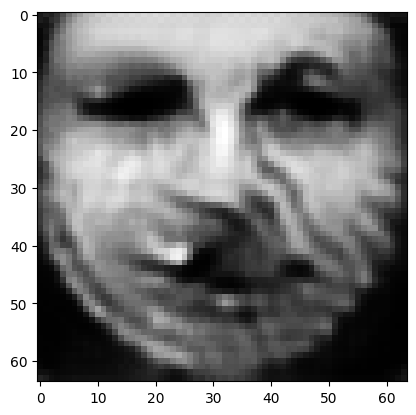

tensor([[9.9050e-05, 8.7355e-04, 9.8524e-04, 9.8683e-01, 3.7105e-05, 2.9413e-04,
         9.8796e-06, 4.7560e-04, 1.5824e-03, 1.8081e-05, 3.7120e-05, 6.0924e-05,
         1.2358e-03, 8.4538e-05, 9.0024e-06, 1.5178e-05, 2.4409e-04, 2.6526e-05,
         2.0227e-04, 3.6085e-05, 1.7811e-05, 2.6404e-06, 9.9593e-05, 2.7434e-05,
         5.9298e-04, 1.1483e-03, 2.9185e-05, 5.6138e-05, 3.2675e-04, 2.7515e-04,
         7.9271e-04, 7.1179e-05, 4.9078e-05, 2.5841e-05, 1.0208e-03, 9.4469e-05,
         9.4250e-05, 1.7529e-03, 3.0649e-04, 5.9537e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01325733121484518
tensor([[9.8982e-05, 8.7281e-04, 9.8450e-04, 9.8684e-01, 3.7059e-05, 2.9382e-04,
         9.8677e-06, 4.7516e-04, 1.5811e-03, 1.8060e-05, 3.7076e-05, 6.0860e-05,
         1.2345e-03, 8.4441e-05, 8.9935e-06, 1.5160e-05, 2.4382e-04, 2.6495e-05,
         2.0209e-04, 3.6052e-05, 1.7788e-05, 2.6376e-06, 9.9451e-05, 2.7401e-05,
         5.9234e-04, 1.1469e-03, 2.9155e-0

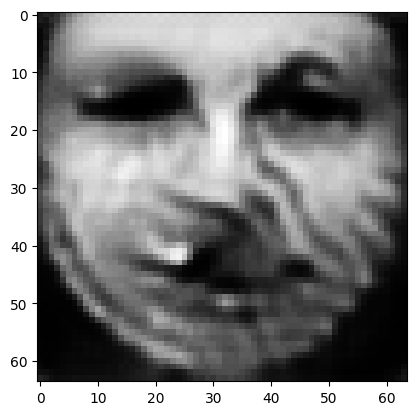

tensor([[9.8695e-05, 8.6986e-04, 9.8157e-04, 9.8689e-01, 3.6882e-05, 2.9254e-04,
         9.8199e-06, 4.7335e-04, 1.5760e-03, 1.7977e-05, 3.6899e-05, 6.0609e-05,
         1.2299e-03, 8.4080e-05, 8.9586e-06, 1.5088e-05, 2.4275e-04, 2.6379e-05,
         2.0135e-04, 3.5919e-05, 1.7697e-05, 2.6268e-06, 9.8946e-05, 2.7270e-05,
         5.9005e-04, 1.1417e-03, 2.9038e-05, 5.5735e-05, 3.2470e-04, 2.7400e-04,
         7.8924e-04, 7.0851e-05, 4.8814e-05, 2.5704e-05, 1.0152e-03, 9.3936e-05,
         9.3621e-05, 1.7479e-03, 3.0522e-04, 5.9182e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013196744956076145
tensor([[9.8619e-05, 8.6915e-04, 9.8084e-04, 9.8690e-01, 3.6837e-05, 2.9221e-04,
         9.8078e-06, 4.7288e-04, 1.5748e-03, 1.7955e-05, 3.6856e-05, 6.0547e-05,
         1.2289e-03, 8.3998e-05, 8.9497e-06, 1.5070e-05, 2.4248e-04, 2.6348e-05,
         2.0116e-04, 3.5884e-05, 1.7676e-05, 2.6242e-06, 9.8834e-05, 2.7236e-05,
         5.8947e-04, 1.1405e-03, 2.9010e-

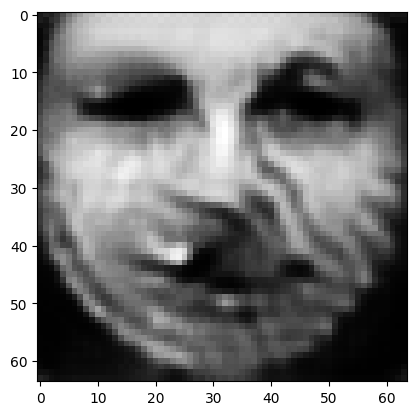

tensor([[9.8348e-05, 8.6639e-04, 9.7815e-04, 9.8695e-01, 3.6675e-05, 2.9104e-04,
         9.7638e-06, 4.7120e-04, 1.5700e-03, 1.7878e-05, 3.6689e-05, 6.0313e-05,
         1.2247e-03, 8.3664e-05, 8.9161e-06, 1.5003e-05, 2.4149e-04, 2.6238e-05,
         2.0047e-04, 3.5761e-05, 1.7591e-05, 2.6142e-06, 9.8377e-05, 2.7114e-05,
         5.8733e-04, 1.1357e-03, 2.8900e-05, 5.5365e-05, 3.2278e-04, 2.7294e-04,
         7.8626e-04, 7.0536e-05, 4.8569e-05, 2.5581e-05, 1.0098e-03, 9.3441e-05,
         9.3042e-05, 1.7431e-03, 3.0406e-04, 5.8862e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01314062625169754
tensor([[9.8285e-05, 8.6573e-04, 9.7754e-04, 9.8696e-01, 3.6634e-05, 2.9077e-04,
         9.7532e-06, 4.7079e-04, 1.5688e-03, 1.7860e-05, 3.6649e-05, 6.0258e-05,
         1.2238e-03, 8.3580e-05, 8.9080e-06, 1.4987e-05, 2.4125e-04, 2.6211e-05,
         2.0030e-04, 3.5732e-05, 1.7571e-05, 2.6117e-06, 9.8261e-05, 2.7083e-05,
         5.8677e-04, 1.1345e-03, 2.8875e-0

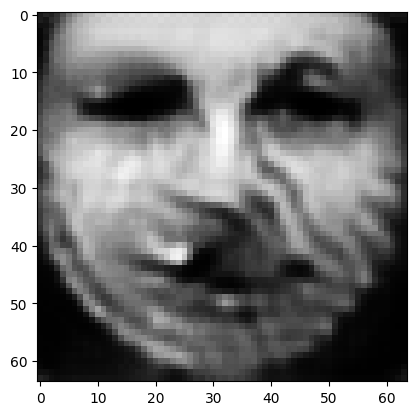

tensor([[9.8007e-05, 8.6334e-04, 9.7472e-04, 9.8700e-01, 3.6478e-05, 2.8958e-04,
         9.7097e-06, 4.6911e-04, 1.5642e-03, 1.7782e-05, 3.6491e-05, 6.0035e-05,
         1.2202e-03, 8.3302e-05, 8.8772e-06, 1.4924e-05, 2.4033e-04, 2.6107e-05,
         1.9963e-04, 3.5609e-05, 1.7495e-05, 2.6020e-06, 9.7894e-05, 2.6969e-05,
         5.8486e-04, 1.1304e-03, 2.8773e-05, 5.5022e-05, 3.2096e-04, 2.7199e-04,
         7.8357e-04, 7.0246e-05, 4.8337e-05, 2.5466e-05, 1.0050e-03, 9.3009e-05,
         9.2521e-05, 1.7385e-03, 3.0290e-04, 5.8560e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013088739477097988
tensor([[9.7951e-05, 8.6269e-04, 9.7418e-04, 9.8701e-01, 3.6440e-05, 2.8934e-04,
         9.6999e-06, 4.6873e-04, 1.5631e-03, 1.7766e-05, 3.6455e-05, 5.9984e-05,
         1.2193e-03, 8.3221e-05, 8.8694e-06, 1.4909e-05, 2.4011e-04, 2.6082e-05,
         1.9947e-04, 3.5581e-05, 1.7476e-05, 2.5998e-06, 9.7784e-05, 2.6940e-05,
         5.8434e-04, 1.1293e-03, 2.8750e-

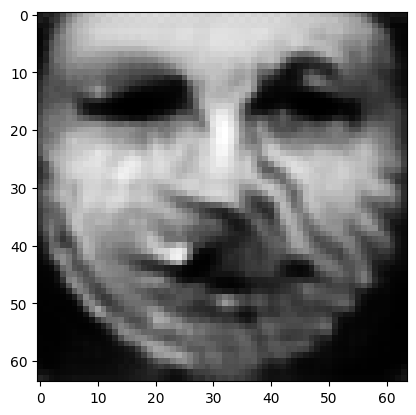

tensor([[9.7686e-05, 8.6051e-04, 9.7146e-04, 9.8704e-01, 3.6297e-05, 2.8821e-04,
         9.6597e-06, 4.6720e-04, 1.5587e-03, 1.7693e-05, 3.6307e-05, 5.9777e-05,
         1.2161e-03, 8.2975e-05, 8.8417e-06, 1.4850e-05, 2.3928e-04, 2.5986e-05,
         1.9885e-04, 3.5470e-05, 1.7404e-05, 2.5909e-06, 9.7461e-05, 2.6838e-05,
         5.8265e-04, 1.1255e-03, 2.8654e-05, 5.4705e-05, 3.1924e-04, 2.7110e-04,
         7.8113e-04, 6.9985e-05, 4.8128e-05, 2.5360e-05, 1.0004e-03, 9.2624e-05,
         9.2045e-05, 1.7342e-03, 3.0181e-04, 5.8276e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01304038055241108
tensor([[9.7623e-05, 8.5998e-04, 9.7082e-04, 9.8705e-01, 3.6262e-05, 2.8795e-04,
         9.6500e-06, 4.6682e-04, 1.5576e-03, 1.7675e-05, 3.6271e-05, 5.9727e-05,
         1.2153e-03, 8.2912e-05, 8.8349e-06, 1.4836e-05, 2.3907e-04, 2.5963e-05,
         1.9869e-04, 3.5443e-05, 1.7387e-05, 2.5888e-06, 9.7380e-05, 2.6812e-05,
         5.8221e-04, 1.1246e-03, 2.8631e-0

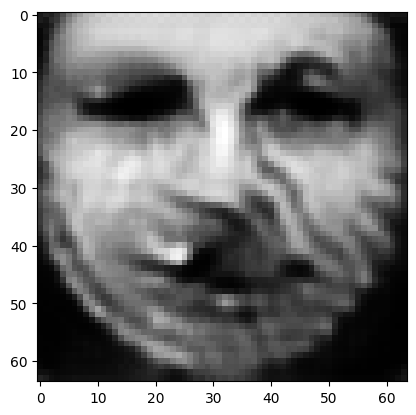

tensor([[9.7371e-05, 8.5792e-04, 9.6826e-04, 9.8709e-01, 3.6129e-05, 2.8689e-04,
         9.6125e-06, 4.6537e-04, 1.5534e-03, 1.7607e-05, 3.6133e-05, 5.9534e-05,
         1.2123e-03, 8.2683e-05, 8.8093e-06, 1.4781e-05, 2.3829e-04, 2.5875e-05,
         1.9810e-04, 3.5340e-05, 1.7320e-05, 2.5804e-06, 9.7079e-05, 2.6717e-05,
         5.8064e-04, 1.1210e-03, 2.8540e-05, 5.4408e-05, 3.1758e-04, 2.7025e-04,
         7.7891e-04, 6.9746e-05, 4.7934e-05, 2.5261e-05, 9.9617e-04, 9.2284e-05,
         9.1605e-05, 1.7300e-03, 3.0076e-04, 5.8004e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012995196506381035
tensor([[9.7322e-05, 8.5741e-04, 9.6776e-04, 9.8710e-01, 3.6095e-05, 2.8668e-04,
         9.6041e-06, 4.6506e-04, 1.5525e-03, 1.7593e-05, 3.6102e-05, 5.9492e-05,
         1.2115e-03, 8.2614e-05, 8.8028e-06, 1.4769e-05, 2.3810e-04, 2.5852e-05,
         1.9796e-04, 3.5317e-05, 1.7305e-05, 2.5785e-06, 9.6984e-05, 2.6692e-05,
         5.8016e-04, 1.1200e-03, 2.8521e-

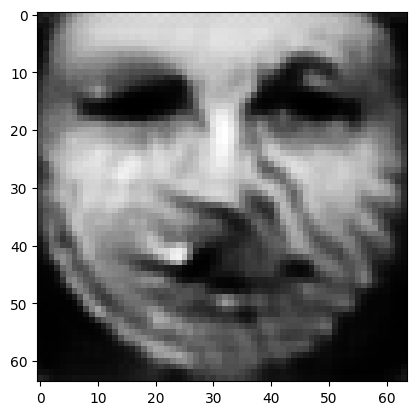

tensor([[9.7074e-05, 8.5553e-04, 9.6532e-04, 9.8713e-01, 3.5970e-05, 2.8567e-04,
         9.5679e-06, 4.6367e-04, 1.5485e-03, 1.7528e-05, 3.5971e-05, 5.9313e-05,
         1.2088e-03, 8.2398e-05, 8.7791e-06, 1.4717e-05, 2.3736e-04, 2.5770e-05,
         1.9739e-04, 3.5220e-05, 1.7243e-05, 2.5705e-06, 9.6708e-05, 2.6601e-05,
         5.7868e-04, 1.1166e-03, 2.8434e-05, 5.4121e-05, 3.1603e-04, 2.6948e-04,
         7.7675e-04, 6.9520e-05, 4.7753e-05, 2.5166e-05, 9.9214e-04, 9.1954e-05,
         9.1179e-05, 1.7261e-03, 2.9979e-04, 5.7755e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012952598743140697
tensor([[9.7026e-05, 8.5505e-04, 9.6488e-04, 9.8714e-01, 3.5938e-05, 2.8548e-04,
         9.5597e-06, 4.6337e-04, 1.5477e-03, 1.7515e-05, 3.5942e-05, 5.9274e-05,
         1.2080e-03, 8.2332e-05, 8.7732e-06, 1.4705e-05, 2.3718e-04, 2.5750e-05,
         1.9726e-04, 3.5198e-05, 1.7228e-05, 2.5687e-06, 9.6618e-05, 2.6577e-05,
         5.7823e-04, 1.1157e-03, 2.8415e-

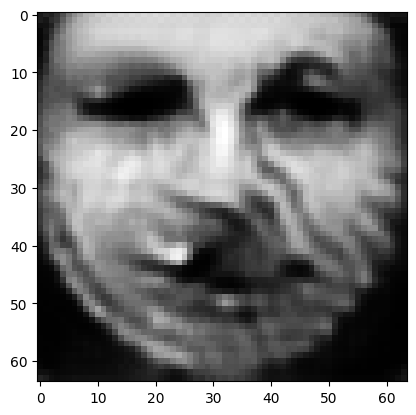

tensor([[9.6796e-05, 8.5332e-04, 9.6263e-04, 9.8717e-01, 3.5822e-05, 2.8454e-04,
         9.5256e-06, 4.6210e-04, 1.5439e-03, 1.7454e-05, 3.5819e-05, 5.9106e-05,
         1.2054e-03, 8.2131e-05, 8.7516e-06, 1.4656e-05, 2.3651e-04, 2.5674e-05,
         1.9672e-04, 3.5106e-05, 1.7170e-05, 2.5612e-06, 9.6361e-05, 2.6492e-05,
         5.7686e-04, 1.1125e-03, 2.8332e-05, 5.3853e-05, 3.1456e-04, 2.6875e-04,
         7.7473e-04, 6.9306e-05, 4.7584e-05, 2.5075e-05, 9.8836e-04, 9.1647e-05,
         9.0778e-05, 1.7223e-03, 2.9886e-04, 5.7520e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012912706471979618
tensor([[9.6735e-05, 8.5289e-04, 9.6205e-04, 9.8718e-01, 3.5795e-05, 2.8429e-04,
         9.5171e-06, 4.6178e-04, 1.5430e-03, 1.7439e-05, 3.5788e-05, 5.9064e-05,
         1.2048e-03, 8.2085e-05, 8.7463e-06, 1.4643e-05, 2.3634e-04, 2.5656e-05,
         1.9658e-04, 3.5084e-05, 1.7156e-05, 2.5594e-06, 9.6303e-05, 2.6472e-05,
         5.7656e-04, 1.1118e-03, 2.8310e-

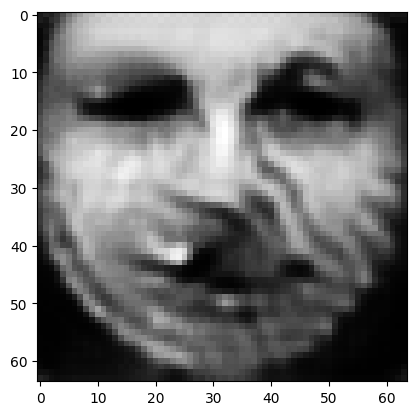

tensor([[9.6540e-05, 8.5115e-04, 9.6026e-04, 9.8721e-01, 3.5683e-05, 2.8350e-04,
         9.4860e-06, 4.6064e-04, 1.5397e-03, 1.7386e-05, 3.5678e-05, 5.8915e-05,
         1.2021e-03, 8.1862e-05, 8.7253e-06, 1.4599e-05, 2.3569e-04, 2.5584e-05,
         1.9609e-04, 3.4999e-05, 1.7102e-05, 2.5525e-06, 9.6008e-05, 2.6389e-05,
         5.7506e-04, 1.1086e-03, 2.8236e-05, 5.3596e-05, 3.1322e-04, 2.6805e-04,
         7.7273e-04, 6.9098e-05, 4.7425e-05, 2.4988e-05, 9.8471e-04, 9.1335e-05,
         9.0392e-05, 1.7189e-03, 2.9803e-04, 5.7303e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012874694541096687
tensor([[9.6483e-05, 8.5073e-04, 9.5971e-04, 9.8721e-01, 3.5657e-05, 2.8327e-04,
         9.4779e-06, 4.6034e-04, 1.5388e-03, 1.7372e-05, 3.5648e-05, 5.8875e-05,
         1.2015e-03, 8.1819e-05, 8.7203e-06, 1.4587e-05, 2.3553e-04, 2.5567e-05,
         1.9596e-04, 3.4978e-05, 1.7089e-05, 2.5508e-06, 9.5954e-05, 2.6370e-05,
         5.7478e-04, 1.1079e-03, 2.8216e-

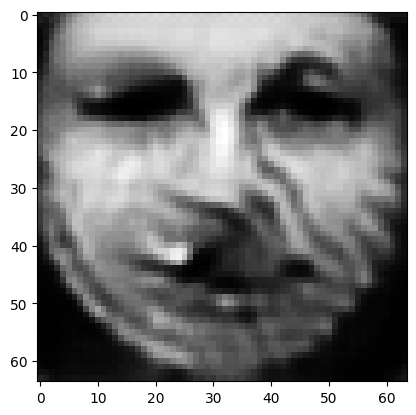

tensor([[9.6269e-05, 8.4917e-04, 9.5769e-04, 9.8724e-01, 3.5554e-05, 2.8241e-04,
         9.4470e-06, 4.5918e-04, 1.5354e-03, 1.7316e-05, 3.5537e-05, 5.8726e-05,
         1.1992e-03, 8.1638e-05, 8.7011e-06, 1.4542e-05, 2.3493e-04, 2.5499e-05,
         1.9547e-04, 3.4895e-05, 1.7037e-05, 2.5440e-06, 9.5733e-05, 2.6295e-05,
         5.7358e-04, 1.1051e-03, 2.8140e-05, 5.3355e-05, 3.1184e-04, 2.6739e-04,
         7.7099e-04, 6.8914e-05, 4.7275e-05, 2.4907e-05, 9.8137e-04, 9.1088e-05,
         9.0049e-05, 1.7155e-03, 2.9718e-04, 5.7084e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012838917784392834
tensor([[9.6217e-05, 8.4878e-04, 9.5719e-04, 9.8725e-01, 3.5529e-05, 2.8219e-04,
         9.4395e-06, 4.5890e-04, 1.5346e-03, 1.7303e-05, 3.5510e-05, 5.8689e-05,
         1.1986e-03, 8.1595e-05, 8.6964e-06, 1.4530e-05, 2.3478e-04, 2.5482e-05,
         1.9535e-04, 3.4875e-05, 1.7025e-05, 2.5424e-06, 9.5679e-05, 2.6277e-05,
         5.7330e-04, 1.1044e-03, 2.8121e-

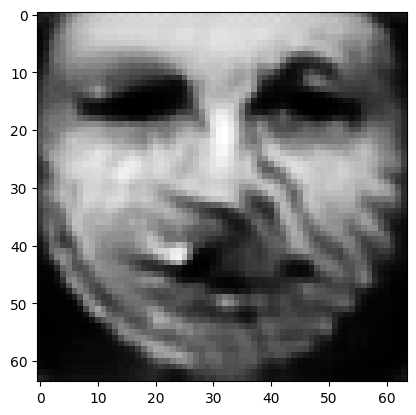

tensor([[9.6031e-05, 8.4727e-04, 9.5545e-04, 9.8728e-01, 3.5431e-05, 2.8144e-04,
         9.4111e-06, 4.5785e-04, 1.5315e-03, 1.7254e-05, 3.5409e-05, 5.8552e-05,
         1.1964e-03, 8.1413e-05, 8.6779e-06, 1.4489e-05, 2.3420e-04, 2.5418e-05,
         1.9490e-04, 3.4798e-05, 1.6976e-05, 2.5362e-06, 9.5443e-05, 2.6204e-05,
         5.7205e-04, 1.1017e-03, 2.8054e-05, 5.3131e-05, 3.1061e-04, 2.6677e-04,
         7.6929e-04, 6.8732e-05, 4.7133e-05, 2.4830e-05, 9.7816e-04, 9.0828e-05,
         8.9714e-05, 1.7123e-03, 2.9641e-04, 5.6886e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012805258855223656
tensor([[9.5984e-05, 8.4691e-04, 9.5502e-04, 9.8728e-01, 3.5407e-05, 2.8125e-04,
         9.4042e-06, 4.5759e-04, 1.5308e-03, 1.7241e-05, 3.5384e-05, 5.8519e-05,
         1.1958e-03, 8.1370e-05, 8.6735e-06, 1.4479e-05, 2.3406e-04, 2.5403e-05,
         1.9479e-04, 3.4779e-05, 1.6965e-05, 2.5347e-06, 9.5389e-05, 2.6187e-05,
         5.7177e-04, 1.1010e-03, 2.8037e-

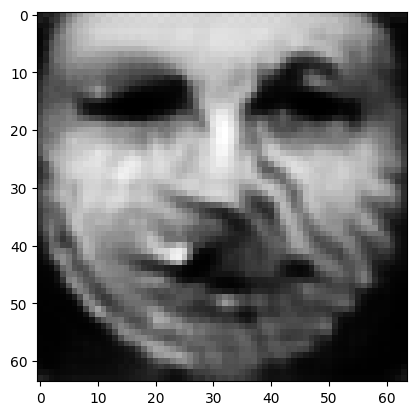

tensor([[9.5796e-05, 8.4549e-04, 9.5325e-04, 9.8731e-01, 3.5316e-05, 2.8049e-04,
         9.3768e-06, 4.5656e-04, 1.5277e-03, 1.7192e-05, 3.5284e-05, 5.8385e-05,
         1.1938e-03, 8.1208e-05, 8.6560e-06, 1.4439e-05, 2.3353e-04, 2.5342e-05,
         1.9435e-04, 3.4705e-05, 1.6918e-05, 2.5287e-06, 9.5187e-05, 2.6120e-05,
         5.7069e-04, 1.0985e-03, 2.7971e-05, 5.2919e-05, 3.0941e-04, 2.6618e-04,
         7.6773e-04, 6.8564e-05, 4.6998e-05, 2.4759e-05, 9.7515e-04, 9.0593e-05,
         8.9408e-05, 1.7093e-03, 2.9567e-04, 5.6694e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0127733638510108
tensor([[9.5752e-05, 8.4514e-04, 9.5284e-04, 9.8731e-01, 3.5294e-05, 2.8031e-04,
         9.3703e-06, 4.5632e-04, 1.5270e-03, 1.7181e-05, 3.5261e-05, 5.8353e-05,
         1.1933e-03, 8.1166e-05, 8.6517e-06, 1.4429e-05, 2.3340e-04, 2.5327e-05,
         1.9425e-04, 3.4688e-05, 1.6907e-05, 2.5272e-06, 9.5135e-05, 2.6103e-05,
         5.7041e-04, 1.0979e-03, 2.7955e-05

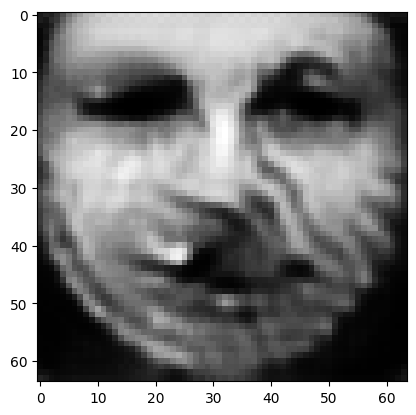

tensor([[9.5589e-05, 8.4372e-04, 9.5135e-04, 9.8734e-01, 3.5208e-05, 2.7966e-04,
         9.3452e-06, 4.5539e-04, 1.5243e-03, 1.7138e-05, 3.5171e-05, 5.8230e-05,
         1.1912e-03, 8.0998e-05, 8.6347e-06, 1.4393e-05, 2.3288e-04, 2.5270e-05,
         1.9385e-04, 3.4619e-05, 1.6864e-05, 2.5217e-06, 9.4914e-05, 2.6038e-05,
         5.6929e-04, 1.0954e-03, 2.7894e-05, 5.2722e-05, 3.0834e-04, 2.6562e-04,
         7.6617e-04, 6.8397e-05, 4.6869e-05, 2.4690e-05, 9.7226e-04, 9.0348e-05,
         8.9107e-05, 1.7065e-03, 2.9500e-04, 5.6520e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012743232771754265
tensor([[9.5548e-05, 8.4339e-04, 9.5097e-04, 9.8734e-01, 3.5187e-05, 2.7949e-04,
         9.3391e-06, 4.5517e-04, 1.5236e-03, 1.7127e-05, 3.5149e-05, 5.8200e-05,
         1.1907e-03, 8.0958e-05, 8.6307e-06, 1.4384e-05, 2.3276e-04, 2.5256e-05,
         1.9375e-04, 3.4603e-05, 1.6853e-05, 2.5203e-06, 9.4864e-05, 2.6023e-05,
         5.6902e-04, 1.0948e-03, 2.7879e-

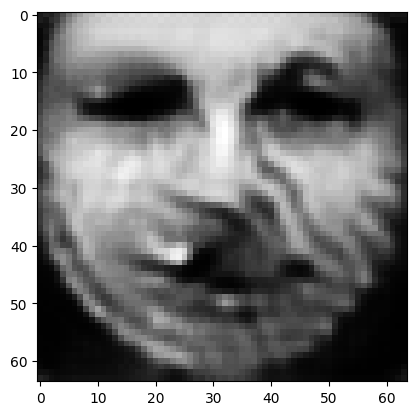

tensor([[9.5387e-05, 8.4210e-04, 9.4944e-04, 9.8737e-01, 3.5106e-05, 2.7885e-04,
         9.3151e-06, 4.5429e-04, 1.5208e-03, 1.7085e-05, 3.5061e-05, 5.8081e-05,
         1.1888e-03, 8.0805e-05, 8.6152e-06, 1.4348e-05, 2.3229e-04, 2.5203e-05,
         1.9336e-04, 3.4539e-05, 1.6811e-05, 2.5150e-06, 9.4669e-05, 2.5964e-05,
         5.6803e-04, 1.0925e-03, 2.7819e-05, 5.2533e-05, 3.0728e-04, 2.6507e-04,
         7.6472e-04, 6.8245e-05, 4.6748e-05, 2.4625e-05, 9.6954e-04, 9.0130e-05,
         8.8827e-05, 1.7037e-03, 2.9434e-04, 5.6348e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012714396230876446
tensor([[9.5349e-05, 8.4178e-04, 9.4908e-04, 9.8737e-01, 3.5087e-05, 2.7869e-04,
         9.3093e-06, 4.5407e-04, 1.5201e-03, 1.7075e-05, 3.5040e-05, 5.8053e-05,
         1.1883e-03, 8.0766e-05, 8.6114e-06, 1.4340e-05, 2.3218e-04, 2.5190e-05,
         1.9327e-04, 3.4524e-05, 1.6801e-05, 2.5137e-06, 9.4617e-05, 2.5949e-05,
         5.6778e-04, 1.0919e-03, 2.7805e-

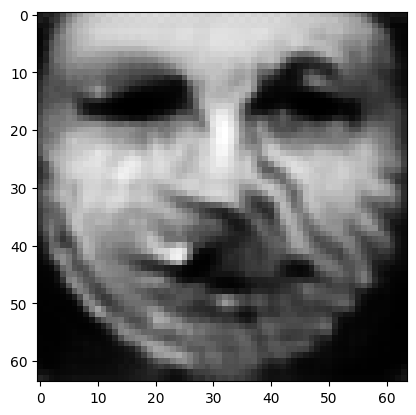

tensor([[9.5205e-05, 8.4033e-04, 9.4783e-04, 9.8739e-01, 3.5007e-05, 2.7811e-04,
         9.2865e-06, 4.5325e-04, 1.5177e-03, 1.7036e-05, 3.4958e-05, 5.7941e-05,
         1.1863e-03, 8.0600e-05, 8.5958e-06, 1.4306e-05, 2.3171e-04, 2.5138e-05,
         1.9289e-04, 3.4465e-05, 1.6762e-05, 2.5087e-06, 9.4389e-05, 2.5889e-05,
         5.6669e-04, 1.0895e-03, 2.7747e-05, 5.2352e-05, 3.0631e-04, 2.6452e-04,
         7.6328e-04, 6.8079e-05, 4.6628e-05, 2.4560e-05, 9.6686e-04, 8.9886e-05,
         8.8533e-05, 1.7010e-03, 2.9377e-04, 5.6190e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01268626470118761
tensor([[9.5170e-05, 8.3998e-04, 9.4752e-04, 9.8740e-01, 3.4988e-05, 2.7797e-04,
         9.2810e-06, 4.5305e-04, 1.5171e-03, 1.7027e-05, 3.4939e-05, 5.7915e-05,
         1.1858e-03, 8.0560e-05, 8.5921e-06, 1.4298e-05, 2.3160e-04, 2.5125e-05,
         1.9280e-04, 3.4452e-05, 1.6752e-05, 2.5075e-06, 9.4335e-05, 2.5876e-05,
         5.6643e-04, 1.0889e-03, 2.7732e-0

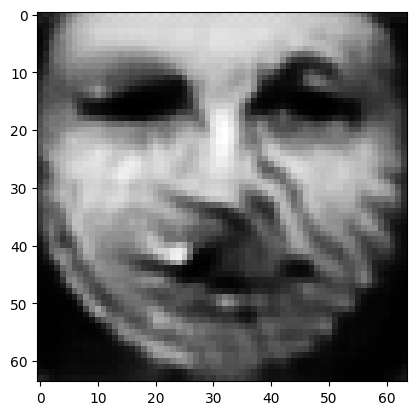

tensor([[9.5033e-05, 8.3863e-04, 9.4633e-04, 9.8742e-01, 3.4912e-05, 2.7741e-04,
         9.2596e-06, 4.5227e-04, 1.5149e-03, 1.6991e-05, 3.4861e-05, 5.7810e-05,
         1.1839e-03, 8.0403e-05, 8.5774e-06, 1.4267e-05, 2.3116e-04, 2.5075e-05,
         1.9245e-04, 3.4397e-05, 1.6716e-05, 2.5028e-06, 9.4122e-05, 2.5819e-05,
         5.6541e-04, 1.0866e-03, 2.7678e-05, 5.2179e-05, 3.0539e-04, 2.6401e-04,
         7.6192e-04, 6.7921e-05, 4.6516e-05, 2.4499e-05, 9.6431e-04, 8.9651e-05,
         8.8251e-05, 1.6984e-03, 2.9325e-04, 5.6041e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012659545056521893
tensor([[9.4998e-05, 8.3829e-04, 9.4604e-04, 9.8743e-01, 3.4894e-05, 2.7727e-04,
         9.2542e-06, 4.5207e-04, 1.5143e-03, 1.6981e-05, 3.4843e-05, 5.7784e-05,
         1.1834e-03, 8.0367e-05, 8.5738e-06, 1.4259e-05, 2.3105e-04, 2.5063e-05,
         1.9236e-04, 3.4383e-05, 1.6707e-05, 2.5016e-06, 9.4072e-05, 2.5805e-05,
         5.6517e-04, 1.0861e-03, 2.7664e-

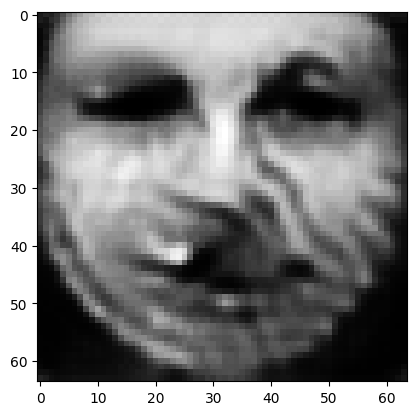

tensor([[9.4875e-05, 8.3700e-04, 9.4494e-04, 9.8745e-01, 3.4823e-05, 2.7676e-04,
         9.2343e-06, 4.5135e-04, 1.5122e-03, 1.6948e-05, 3.4770e-05, 5.7686e-05,
         1.1816e-03, 8.0213e-05, 8.5600e-06, 1.4230e-05, 2.3063e-04, 2.5016e-05,
         1.9203e-04, 3.4332e-05, 1.6672e-05, 2.4973e-06, 9.3861e-05, 2.5752e-05,
         5.6418e-04, 1.0838e-03, 2.7613e-05, 5.2016e-05, 3.0454e-04, 2.6351e-04,
         7.6063e-04, 6.7769e-05, 4.6408e-05, 2.4441e-05, 9.6188e-04, 8.9424e-05,
         8.7983e-05, 1.6960e-03, 2.9276e-04, 5.5900e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012634354643523693
tensor([[9.4848e-05, 8.3669e-04, 9.4469e-04, 9.8745e-01, 3.4806e-05, 2.7665e-04,
         9.2297e-06, 4.5118e-04, 1.5116e-03, 1.6940e-05, 3.4753e-05, 5.7662e-05,
         1.1811e-03, 8.0174e-05, 8.5566e-06, 1.4223e-05, 2.3053e-04, 2.5005e-05,
         1.9196e-04, 3.4320e-05, 1.6663e-05, 2.4962e-06, 9.3808e-05, 2.5740e-05,
         5.6393e-04, 1.0833e-03, 2.7601e-

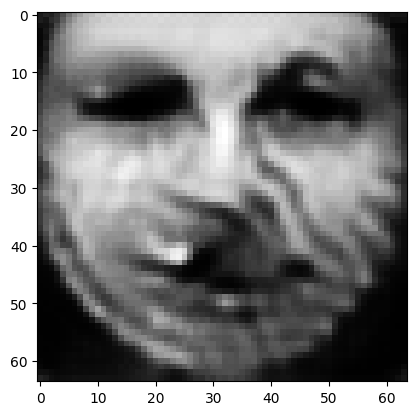

tensor([[9.4741e-05, 8.3547e-04, 9.4368e-04, 9.8747e-01, 3.4742e-05, 2.7619e-04,
         9.2127e-06, 4.5055e-04, 1.5096e-03, 1.6910e-05, 3.4688e-05, 5.7572e-05,
         1.1793e-03, 8.0028e-05, 8.5442e-06, 1.4197e-05, 2.3015e-04, 2.4963e-05,
         1.9167e-04, 3.4273e-05, 1.6630e-05, 2.4922e-06, 9.3604e-05, 2.5692e-05,
         5.6299e-04, 1.0812e-03, 2.7555e-05, 5.1870e-05, 3.0375e-04, 2.6305e-04,
         7.5937e-04, 6.7631e-05, 4.6311e-05, 2.4387e-05, 9.5959e-04, 8.9210e-05,
         8.7736e-05, 1.6937e-03, 2.9231e-04, 5.5770e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01261057611554861
tensor([[9.4714e-05, 8.3516e-04, 9.4342e-04, 9.8747e-01, 3.4727e-05, 2.7607e-04,
         9.2085e-06, 4.5039e-04, 1.5091e-03, 1.6903e-05, 3.4672e-05, 5.7550e-05,
         1.1789e-03, 7.9995e-05, 8.5412e-06, 1.4190e-05, 2.3005e-04, 2.4953e-05,
         1.9159e-04, 3.4262e-05, 1.6623e-05, 2.4912e-06, 9.3557e-05, 2.5680e-05,
         5.6277e-04, 1.0807e-03, 2.7544e-0

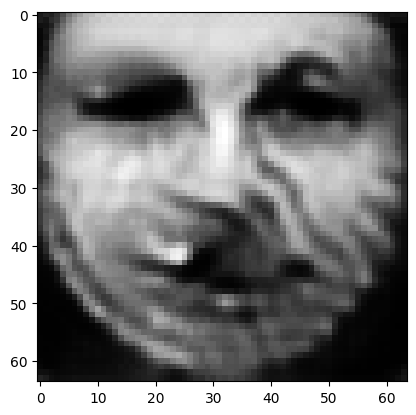

tensor([[9.4613e-05, 8.3403e-04, 9.4244e-04, 9.8749e-01, 3.4668e-05, 2.7564e-04,
         9.1929e-06, 4.4980e-04, 1.5072e-03, 1.6875e-05, 3.4611e-05, 5.7465e-05,
         1.1772e-03, 7.9858e-05, 8.5296e-06, 1.4166e-05, 2.2969e-04, 2.4915e-05,
         1.9132e-04, 3.4219e-05, 1.6591e-05, 2.4874e-06, 9.3369e-05, 2.5637e-05,
         5.6189e-04, 1.0787e-03, 2.7501e-05, 5.1736e-05, 3.0301e-04, 2.6261e-04,
         7.5818e-04, 6.7508e-05, 4.6222e-05, 2.4336e-05, 9.5744e-04, 8.9020e-05,
         8.7507e-05, 1.6917e-03, 2.9188e-04, 5.5646e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012588327750563622
tensor([[9.4589e-05, 8.3374e-04, 9.4221e-04, 9.8749e-01, 3.4653e-05, 2.7553e-04,
         9.1891e-06, 4.4965e-04, 1.5067e-03, 1.6868e-05, 3.4596e-05, 5.7445e-05,
         1.1768e-03, 7.9825e-05, 8.5268e-06, 1.4160e-05, 2.2960e-04, 2.4905e-05,
         1.9126e-04, 3.4209e-05, 1.6584e-05, 2.4865e-06, 9.3324e-05, 2.5626e-05,
         5.6167e-04, 1.0783e-03, 2.7491e-

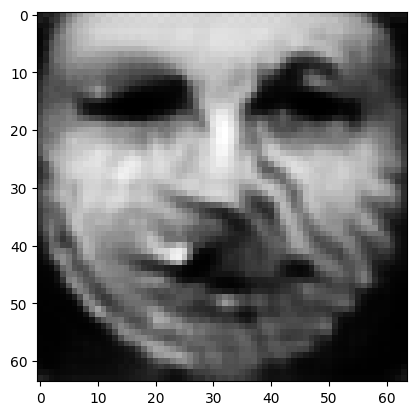

tensor([[9.4494e-05, 8.3265e-04, 9.4129e-04, 9.8751e-01, 3.4596e-05, 2.7512e-04,
         9.1745e-06, 4.4909e-04, 1.5050e-03, 1.6841e-05, 3.4539e-05, 5.7369e-05,
         1.1752e-03, 7.9696e-05, 8.5161e-06, 1.4137e-05, 2.2926e-04, 2.4868e-05,
         1.9101e-04, 3.4170e-05, 1.6556e-05, 2.4831e-06, 9.3148e-05, 2.5585e-05,
         5.6085e-04, 1.0764e-03, 2.7451e-05, 5.1610e-05, 3.0231e-04, 2.6220e-04,
         7.5712e-04, 6.7392e-05, 4.6140e-05, 2.4288e-05, 9.5544e-04, 8.8842e-05,
         8.7296e-05, 1.6897e-03, 2.9148e-04, 5.5531e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012567609548568726
tensor([[9.4470e-05, 8.3238e-04, 9.4106e-04, 9.8752e-01, 3.4583e-05, 2.7502e-04,
         9.1709e-06, 4.4895e-04, 1.5045e-03, 1.6835e-05, 3.4525e-05, 5.7349e-05,
         1.1749e-03, 7.9666e-05, 8.5134e-06, 1.4131e-05, 2.2918e-04, 2.4859e-05,
         1.9095e-04, 3.4160e-05, 1.6549e-05, 2.4823e-06, 9.3106e-05, 2.5575e-05,
         5.6065e-04, 1.0760e-03, 2.7442e-

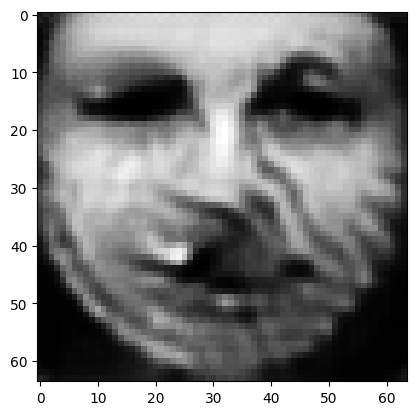

tensor([[9.4382e-05, 8.3135e-04, 9.4020e-04, 9.8753e-01, 3.4529e-05, 2.7464e-04,
         9.1573e-06, 4.4842e-04, 1.5029e-03, 1.6810e-05, 3.4472e-05, 5.7277e-05,
         1.1734e-03, 7.9544e-05, 8.5033e-06, 1.4109e-05, 2.2885e-04, 2.4824e-05,
         1.9071e-04, 3.4123e-05, 1.6523e-05, 2.4790e-06, 9.2940e-05, 2.5536e-05,
         5.5987e-04, 1.0743e-03, 2.7404e-05, 5.1492e-05, 3.0166e-04, 2.6180e-04,
         7.5611e-04, 6.7283e-05, 4.6063e-05, 2.4244e-05, 9.5357e-04, 8.8676e-05,
         8.7097e-05, 1.6879e-03, 2.9111e-04, 5.5422e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012548067606985569
tensor([[9.4359e-05, 8.3110e-04, 9.3999e-04, 9.8753e-01, 3.4515e-05, 2.7454e-04,
         9.1538e-06, 4.4828e-04, 1.5025e-03, 1.6804e-05, 3.4459e-05, 5.7260e-05,
         1.1730e-03, 7.9515e-05, 8.5008e-06, 1.4104e-05, 2.2877e-04, 2.4815e-05,
         1.9065e-04, 3.4114e-05, 1.6516e-05, 2.4782e-06, 9.2900e-05, 2.5526e-05,
         5.5968e-04, 1.0739e-03, 2.7395e-

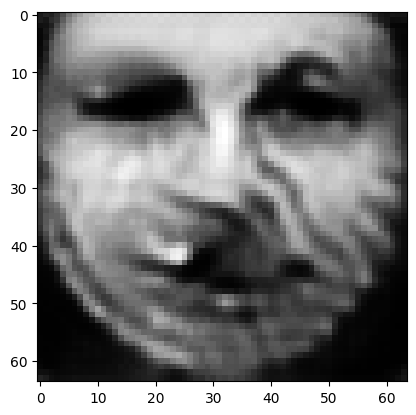

tensor([[9.4269e-05, 8.3011e-04, 9.3916e-04, 9.8755e-01, 3.4465e-05, 2.7416e-04,
         9.1404e-06, 4.4776e-04, 1.5010e-03, 1.6779e-05, 3.4407e-05, 5.7191e-05,
         1.1716e-03, 7.9402e-05, 8.4911e-06, 1.4082e-05, 2.2846e-04, 2.4781e-05,
         1.9042e-04, 3.4078e-05, 1.6491e-05, 2.4751e-06, 9.2747e-05, 2.5489e-05,
         5.5896e-04, 1.0723e-03, 2.7358e-05, 5.1379e-05, 3.0103e-04, 2.6144e-04,
         7.5518e-04, 6.7179e-05, 4.5989e-05, 2.4202e-05, 9.5179e-04, 8.8519e-05,
         8.6908e-05, 1.6862e-03, 2.9075e-04, 5.5319e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012529467232525349
tensor([[9.4248e-05, 8.2986e-04, 9.3896e-04, 9.8755e-01, 3.4452e-05, 2.7406e-04,
         9.1371e-06, 4.4762e-04, 1.5006e-03, 1.6773e-05, 3.4394e-05, 5.7174e-05,
         1.1713e-03, 7.9374e-05, 8.4887e-06, 1.4077e-05, 2.2838e-04, 2.4773e-05,
         1.9036e-04, 3.4069e-05, 1.6485e-05, 2.4744e-06, 9.2709e-05, 2.5479e-05,
         5.5877e-04, 1.0719e-03, 2.7350e-

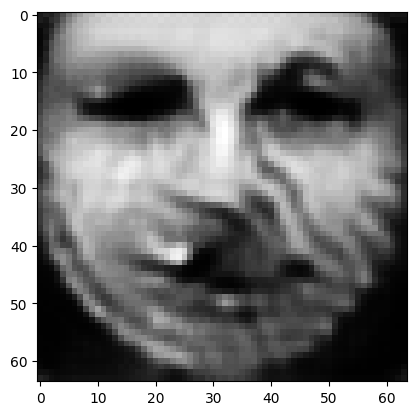

tensor([[9.4162e-05, 8.2891e-04, 9.3817e-04, 9.8757e-01, 3.4404e-05, 2.7370e-04,
         9.1245e-06, 4.4713e-04, 1.4991e-03, 1.6750e-05, 3.4345e-05, 5.7108e-05,
         1.1700e-03, 7.9266e-05, 8.4795e-06, 1.4057e-05, 2.2810e-04, 2.4741e-05,
         1.9014e-04, 3.4036e-05, 1.6461e-05, 2.4715e-06, 9.2564e-05, 2.5444e-05,
         5.5810e-04, 1.0703e-03, 2.7315e-05, 5.1270e-05, 3.0043e-04, 2.6108e-04,
         7.5431e-04, 6.7080e-05, 4.5920e-05, 2.4162e-05, 9.5009e-04, 8.8369e-05,
         8.6730e-05, 1.6845e-03, 2.9042e-04, 5.5221e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012512044049799442
tensor([[9.4142e-05, 8.2868e-04, 9.3798e-04, 9.8757e-01, 3.4393e-05, 2.7362e-04,
         9.1215e-06, 4.4701e-04, 1.4988e-03, 1.6745e-05, 3.4333e-05, 5.7093e-05,
         1.1697e-03, 7.9239e-05, 8.4773e-06, 1.4052e-05, 2.2803e-04, 2.4734e-05,
         1.9009e-04, 3.4029e-05, 1.6456e-05, 2.4708e-06, 9.2529e-05, 2.5436e-05,
         5.5794e-04, 1.0700e-03, 2.7306e-

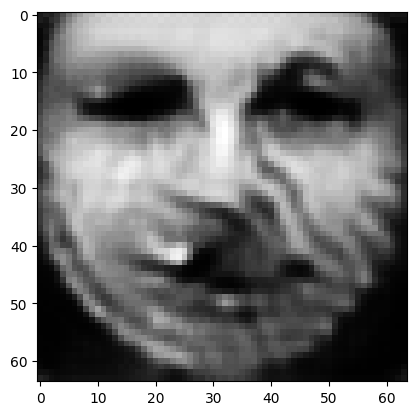

tensor([[9.4061e-05, 8.2777e-04, 9.3723e-04, 9.8758e-01, 3.4349e-05, 2.7328e-04,
         9.1097e-06, 4.4655e-04, 1.4974e-03, 1.6723e-05, 3.4286e-05, 5.7030e-05,
         1.1684e-03, 7.9138e-05, 8.4685e-06, 1.4033e-05, 2.2776e-04, 2.4704e-05,
         1.8988e-04, 3.3997e-05, 1.6433e-05, 2.4680e-06, 9.2394e-05, 2.5403e-05,
         5.5732e-04, 1.0685e-03, 2.7273e-05, 5.1169e-05, 2.9986e-04, 2.6074e-04,
         7.5348e-04, 6.6989e-05, 4.5856e-05, 2.4125e-05, 9.4849e-04, 8.8231e-05,
         8.6564e-05, 1.6829e-03, 2.9011e-04, 5.5128e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01249532587826252
tensor([[9.4042e-05, 8.2755e-04, 9.3705e-04, 9.8759e-01, 3.4338e-05, 2.7319e-04,
         9.1068e-06, 4.4643e-04, 1.4970e-03, 1.6717e-05, 3.4275e-05, 5.7015e-05,
         1.1681e-03, 7.9114e-05, 8.4664e-06, 1.4028e-05, 2.2769e-04, 2.4696e-05,
         1.8983e-04, 3.3989e-05, 1.6428e-05, 2.4674e-06, 9.2361e-05, 2.5395e-05,
         5.5716e-04, 1.0682e-03, 2.7265e-0

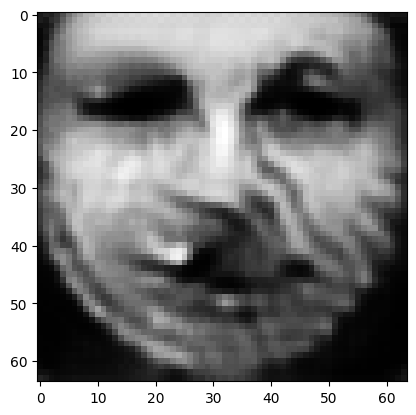

tensor([[9.3964e-05, 8.2671e-04, 9.3633e-04, 9.8760e-01, 3.4296e-05, 2.7287e-04,
         9.0957e-06, 4.4599e-04, 1.4957e-03, 1.6697e-05, 3.4230e-05, 5.6956e-05,
         1.1670e-03, 7.9021e-05, 8.4581e-06, 1.4010e-05, 2.2743e-04, 2.4668e-05,
         1.8963e-04, 3.3959e-05, 1.6406e-05, 2.4648e-06, 9.2236e-05, 2.5364e-05,
         5.5658e-04, 1.0668e-03, 2.7234e-05, 5.1074e-05, 2.9932e-04, 2.6042e-04,
         7.5272e-04, 6.6904e-05, 4.5796e-05, 2.4091e-05, 9.4699e-04, 8.8103e-05,
         8.6412e-05, 1.6815e-03, 2.8981e-04, 5.5040e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012479785829782486
tensor([[9.3946e-05, 8.2650e-04, 9.3615e-04, 9.8760e-01, 3.4286e-05, 2.7279e-04,
         9.0930e-06, 4.4589e-04, 1.4954e-03, 1.6692e-05, 3.4220e-05, 5.6942e-05,
         1.1667e-03, 7.8998e-05, 8.4561e-06, 1.4006e-05, 2.2737e-04, 2.4661e-05,
         1.8958e-04, 3.3952e-05, 1.6401e-05, 2.4642e-06, 9.2206e-05, 2.5357e-05,
         5.5644e-04, 1.0665e-03, 2.7226e-

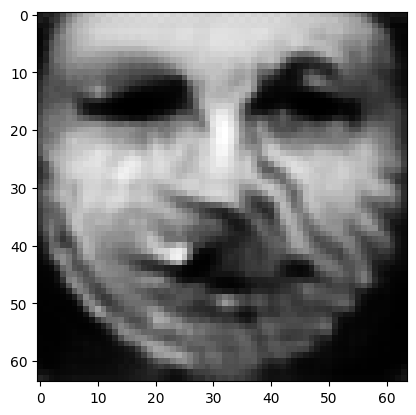

tensor([[9.3873e-05, 8.2572e-04, 9.3547e-04, 9.8761e-01, 3.4246e-05, 2.7248e-04,
         9.0825e-06, 4.4547e-04, 1.4942e-03, 1.6672e-05, 3.4178e-05, 5.6886e-05,
         1.1656e-03, 7.8912e-05, 8.4483e-06, 1.3988e-05, 2.2713e-04, 2.4635e-05,
         1.8940e-04, 3.3923e-05, 1.6381e-05, 2.4618e-06, 9.2090e-05, 2.5328e-05,
         5.5588e-04, 1.0653e-03, 2.7197e-05, 5.0984e-05, 2.9881e-04, 2.6012e-04,
         7.5200e-04, 6.6824e-05, 4.5739e-05, 2.4058e-05, 9.4558e-04, 8.7984e-05,
         8.6268e-05, 1.6801e-03, 2.8953e-04, 5.4958e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012465187348425388
tensor([[9.3855e-05, 8.2553e-04, 9.3529e-04, 9.8761e-01, 3.4236e-05, 2.7240e-04,
         9.0799e-06, 4.4536e-04, 1.4939e-03, 1.6667e-05, 3.4168e-05, 5.6872e-05,
         1.1653e-03, 7.8891e-05, 8.4464e-06, 1.3984e-05, 2.2707e-04, 2.4628e-05,
         1.8935e-04, 3.3916e-05, 1.6376e-05, 2.4612e-06, 9.2062e-05, 2.5320e-05,
         5.5574e-04, 1.0650e-03, 2.7190e-

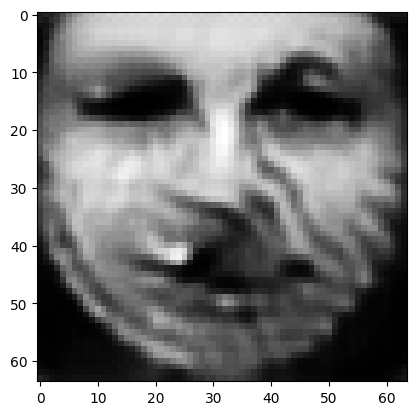

tensor([[9.3786e-05, 8.2480e-04, 9.3463e-04, 9.8763e-01, 3.4199e-05, 2.7211e-04,
         9.0700e-06, 4.4497e-04, 1.4927e-03, 1.6648e-05, 3.4129e-05, 5.6820e-05,
         1.1643e-03, 7.8808e-05, 8.4391e-06, 1.3968e-05, 2.2684e-04, 2.4603e-05,
         1.8918e-04, 3.3889e-05, 1.6357e-05, 2.4588e-06, 9.1953e-05, 2.5293e-05,
         5.5522e-04, 1.0638e-03, 2.7163e-05, 5.0900e-05, 2.9833e-04, 2.5984e-04,
         7.5132e-04, 6.6749e-05, 4.5685e-05, 2.4027e-05, 9.4425e-04, 8.7873e-05,
         8.6132e-05, 1.6788e-03, 2.8925e-04, 5.4879e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01245129480957985
tensor([[9.3768e-05, 8.2461e-04, 9.3446e-04, 9.8763e-01, 3.4190e-05, 2.7203e-04,
         9.0674e-06, 4.4487e-04, 1.4924e-03, 1.6644e-05, 3.4119e-05, 5.6806e-05,
         1.1641e-03, 7.8789e-05, 8.4372e-06, 1.3964e-05, 2.2678e-04, 2.4597e-05,
         1.8914e-04, 3.3882e-05, 1.6353e-05, 2.4583e-06, 9.1928e-05, 2.5286e-05,
         5.5510e-04, 1.0635e-03, 2.7156e-0

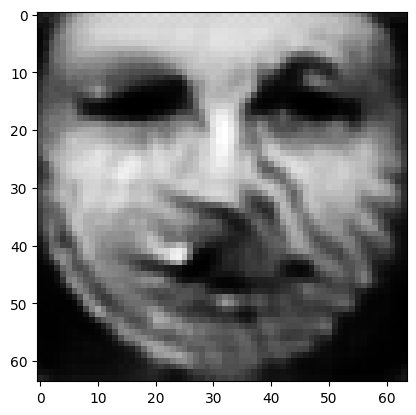

tensor([[9.3700e-05, 8.2393e-04, 9.3382e-04, 9.8764e-01, 3.4154e-05, 2.7175e-04,
         9.0580e-06, 4.4449e-04, 1.4913e-03, 1.6626e-05, 3.4082e-05, 5.6756e-05,
         1.1631e-03, 7.8715e-05, 8.4303e-06, 1.3949e-05, 2.2657e-04, 2.4573e-05,
         1.8897e-04, 3.3856e-05, 1.6335e-05, 2.4561e-06, 9.1829e-05, 2.5260e-05,
         5.5461e-04, 1.0624e-03, 2.7130e-05, 5.0820e-05, 2.9787e-04, 2.5957e-04,
         7.5069e-04, 6.6678e-05, 4.5634e-05, 2.3998e-05, 9.4299e-04, 8.7771e-05,
         8.6006e-05, 1.6776e-03, 2.8899e-04, 5.4805e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012438343837857246
tensor([[9.3685e-05, 8.2376e-04, 9.3367e-04, 9.8764e-01, 3.4146e-05, 2.7168e-04,
         9.0558e-06, 4.4440e-04, 1.4910e-03, 1.6622e-05, 3.4073e-05, 5.6745e-05,
         1.1629e-03, 7.8696e-05, 8.4286e-06, 1.3945e-05, 2.2652e-04, 2.4568e-05,
         1.8893e-04, 3.3850e-05, 1.6331e-05, 2.4555e-06, 9.1804e-05, 2.5254e-05,
         5.5449e-04, 1.0621e-03, 2.7123e-

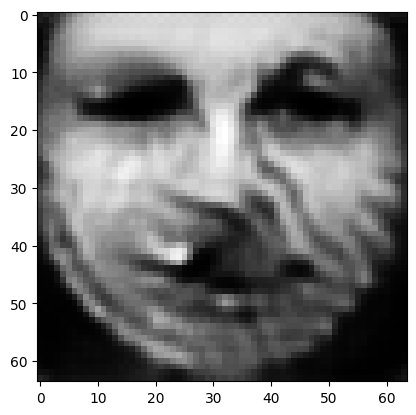

tensor([[9.3621e-05, 8.2311e-04, 9.3305e-04, 9.8765e-01, 3.4112e-05, 2.7141e-04,
         9.0469e-06, 4.4404e-04, 1.4900e-03, 1.6605e-05, 3.4038e-05, 5.6697e-05,
         1.1619e-03, 7.8626e-05, 8.4221e-06, 1.3930e-05, 2.2631e-04, 2.4545e-05,
         1.8878e-04, 3.3825e-05, 1.6314e-05, 2.4534e-06, 9.1710e-05, 2.5229e-05,
         5.5403e-04, 1.0611e-03, 2.7099e-05, 5.0746e-05, 2.9743e-04, 2.5932e-04,
         7.5009e-04, 6.6613e-05, 4.5586e-05, 2.3970e-05, 9.4180e-04, 8.7675e-05,
         8.5886e-05, 1.6765e-03, 2.8874e-04, 5.4733e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012426098808646202
tensor([[9.3605e-05, 8.2296e-04, 9.3290e-04, 9.8765e-01, 3.4104e-05, 2.7135e-04,
         9.0448e-06, 4.4395e-04, 1.4897e-03, 1.6600e-05, 3.4029e-05, 5.6685e-05,
         1.1617e-03, 7.8609e-05, 8.4206e-06, 1.3927e-05, 2.2626e-04, 2.4540e-05,
         1.8874e-04, 3.3820e-05, 1.6310e-05, 2.4529e-06, 9.1689e-05, 2.5224e-05,
         5.5393e-04, 1.0609e-03, 2.7092e-

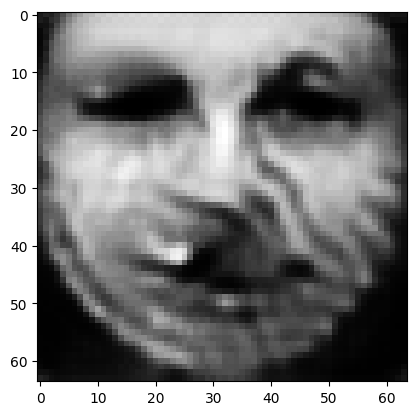

tensor([[9.3545e-05, 8.2236e-04, 9.3231e-04, 9.8766e-01, 3.4072e-05, 2.7109e-04,
         9.0363e-06, 4.4361e-04, 1.4887e-03, 1.6584e-05, 3.3996e-05, 5.6641e-05,
         1.1609e-03, 7.8543e-05, 8.4145e-06, 1.3913e-05, 2.2606e-04, 2.4519e-05,
         1.8859e-04, 3.3796e-05, 1.6294e-05, 2.4510e-06, 9.1600e-05, 2.5201e-05,
         5.5349e-04, 1.0599e-03, 2.7069e-05, 5.0674e-05, 2.9701e-04, 2.5908e-04,
         7.4953e-04, 6.6552e-05, 4.5542e-05, 2.3944e-05, 9.4067e-04, 8.7585e-05,
         8.5773e-05, 1.6754e-03, 2.8850e-04, 5.4665e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01241409033536911
tensor([[9.3530e-05, 8.2220e-04, 9.3216e-04, 9.8766e-01, 3.4064e-05, 2.7102e-04,
         9.0342e-06, 4.4352e-04, 1.4885e-03, 1.6580e-05, 3.3988e-05, 5.6629e-05,
         1.1607e-03, 7.8528e-05, 8.4129e-06, 1.3910e-05, 2.2601e-04, 2.4513e-05,
         1.8855e-04, 3.3790e-05, 1.6290e-05, 2.4505e-06, 9.1578e-05, 2.5195e-05,
         5.5338e-04, 1.0596e-03, 2.7063e-0

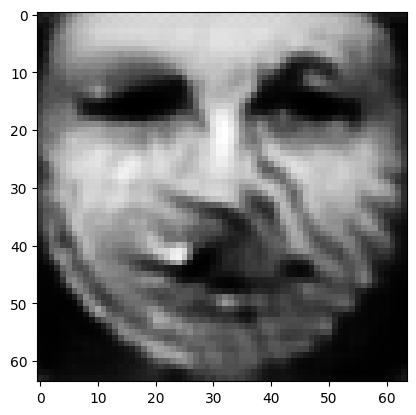

tensor([[9.3474e-05, 8.2164e-04, 9.3161e-04, 9.8767e-01, 3.4034e-05, 2.7079e-04,
         9.0264e-06, 4.4320e-04, 1.4875e-03, 1.6565e-05, 3.3956e-05, 5.6587e-05,
         1.1598e-03, 7.8464e-05, 8.4072e-06, 1.3897e-05, 2.2583e-04, 2.4494e-05,
         1.8842e-04, 3.3769e-05, 1.6275e-05, 2.4486e-06, 9.1492e-05, 2.5173e-05,
         5.5296e-04, 1.0587e-03, 2.7042e-05, 5.0607e-05, 2.9662e-04, 2.5885e-04,
         7.4898e-04, 6.6494e-05, 4.5499e-05, 2.3919e-05, 9.3961e-04, 8.7500e-05,
         8.5666e-05, 1.6743e-03, 2.8827e-04, 5.4600e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012403139844536781
tensor([[9.3460e-05, 8.2149e-04, 9.3147e-04, 9.8768e-01, 3.4027e-05, 2.7072e-04,
         9.0243e-06, 4.4312e-04, 1.4873e-03, 1.6561e-05, 3.3948e-05, 5.6576e-05,
         1.1596e-03, 7.8449e-05, 8.4057e-06, 1.3894e-05, 2.2578e-04, 2.4489e-05,
         1.8838e-04, 3.3763e-05, 1.6271e-05, 2.4481e-06, 9.1472e-05, 2.5168e-05,
         5.5286e-04, 1.0585e-03, 2.7036e-

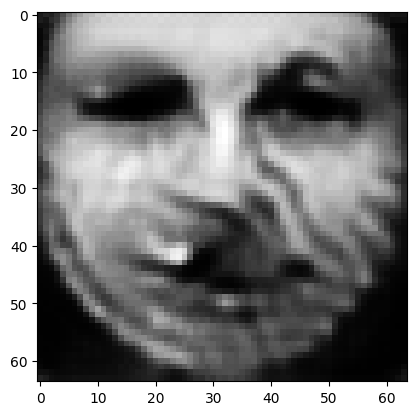

tensor([[9.3407e-05, 8.2096e-04, 9.3096e-04, 9.8768e-01, 3.3998e-05, 2.7050e-04,
         9.0169e-06, 4.4281e-04, 1.4864e-03, 1.6547e-05, 3.3919e-05, 5.6537e-05,
         1.1589e-03, 7.8390e-05, 8.4004e-06, 1.3882e-05, 2.2560e-04, 2.4470e-05,
         1.8825e-04, 3.3743e-05, 1.6257e-05, 2.4464e-06, 9.1392e-05, 2.5147e-05,
         5.5246e-04, 1.0576e-03, 2.7016e-05, 5.0544e-05, 2.9625e-04, 2.5864e-04,
         7.4847e-04, 6.6439e-05, 4.5458e-05, 2.3895e-05, 9.3861e-04, 8.7418e-05,
         8.5565e-05, 1.6734e-03, 2.8805e-04, 5.4540e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012392661534249783
tensor([[9.3394e-05, 8.2083e-04, 9.3083e-04, 9.8769e-01, 3.3991e-05, 2.7045e-04,
         9.0152e-06, 4.4274e-04, 1.4862e-03, 1.6544e-05, 3.3912e-05, 5.6528e-05,
         1.1587e-03, 7.8375e-05, 8.3991e-06, 1.3879e-05, 2.2556e-04, 2.4466e-05,
         1.8822e-04, 3.3738e-05, 1.6253e-05, 2.4459e-06, 9.1373e-05, 2.5142e-05,
         5.5236e-04, 1.0573e-03, 2.7011e-

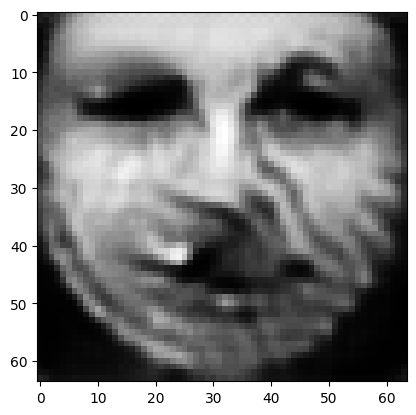

tensor([[9.3343e-05, 8.2033e-04, 9.3034e-04, 9.8769e-01, 3.3964e-05, 2.7023e-04,
         9.0082e-06, 4.4245e-04, 1.4854e-03, 1.6530e-05, 3.3885e-05, 5.6490e-05,
         1.1580e-03, 7.8321e-05, 8.3940e-06, 1.3867e-05, 2.2540e-04, 2.4448e-05,
         1.8810e-04, 3.3719e-05, 1.6240e-05, 2.4443e-06, 9.1300e-05, 2.5123e-05,
         5.5199e-04, 1.0565e-03, 2.6992e-05, 5.0485e-05, 2.9590e-04, 2.5845e-04,
         7.4800e-04, 6.6389e-05, 4.5421e-05, 2.3874e-05, 9.3766e-04, 8.7343e-05,
         8.5472e-05, 1.6725e-03, 2.8785e-04, 5.4482e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012383006513118744
tensor([[9.3330e-05, 8.2021e-04, 9.3023e-04, 9.8770e-01, 3.3957e-05, 2.7017e-04,
         9.0065e-06, 4.4238e-04, 1.4852e-03, 1.6527e-05, 3.3878e-05, 5.6481e-05,
         1.1578e-03, 7.8308e-05, 8.3928e-06, 1.3865e-05, 2.2536e-04, 2.4444e-05,
         1.8807e-04, 3.3714e-05, 1.6237e-05, 2.4439e-06, 9.1283e-05, 2.5118e-05,
         5.5190e-04, 1.0563e-03, 2.6987e-

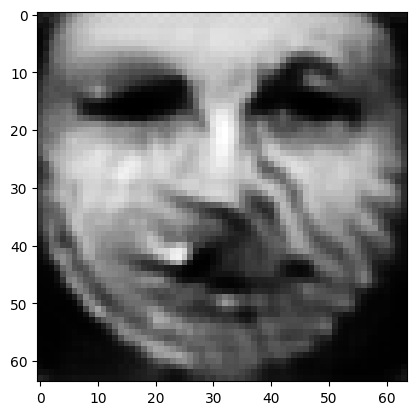

tensor([[9.3282e-05, 8.1973e-04, 9.2977e-04, 9.8770e-01, 3.3931e-05, 2.6997e-04,
         9.0000e-06, 4.4211e-04, 1.4844e-03, 1.6514e-05, 3.3852e-05, 5.6447e-05,
         1.1571e-03, 7.8255e-05, 8.3880e-06, 1.3854e-05, 2.2521e-04, 2.4428e-05,
         1.8796e-04, 3.3696e-05, 1.6224e-05, 2.4423e-06, 9.1212e-05, 2.5100e-05,
         5.5155e-04, 1.0555e-03, 2.6969e-05, 5.0429e-05, 2.9558e-04, 2.5826e-04,
         7.4755e-04, 6.6340e-05, 4.5385e-05, 2.3853e-05, 9.3676e-04, 8.7271e-05,
         8.5382e-05, 1.6716e-03, 2.8766e-04, 5.4428e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012373587116599083
tensor([[9.3270e-05, 8.1961e-04, 9.2966e-04, 9.8770e-01, 3.3925e-05, 2.6992e-04,
         8.9983e-06, 4.4204e-04, 1.4842e-03, 1.6511e-05, 3.3845e-05, 5.6438e-05,
         1.1570e-03, 7.8243e-05, 8.3869e-06, 1.3851e-05, 2.2517e-04, 2.4423e-05,
         1.8793e-04, 3.3692e-05, 1.6221e-05, 2.4420e-06, 9.1196e-05, 2.5096e-05,
         5.5146e-04, 1.0553e-03, 2.6964e-

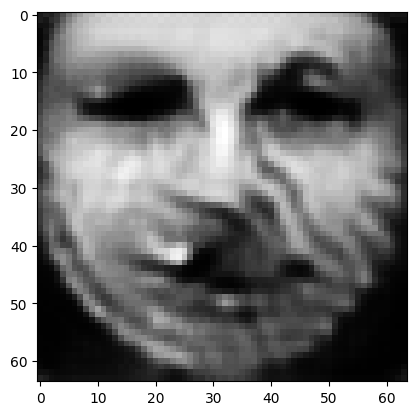

tensor([[9.3224e-05, 8.1915e-04, 9.2923e-04, 9.8771e-01, 3.3900e-05, 2.6973e-04,
         8.9920e-06, 4.4178e-04, 1.4835e-03, 1.6499e-05, 3.3821e-05, 5.6405e-05,
         1.1563e-03, 7.8194e-05, 8.3823e-06, 1.3841e-05, 2.2502e-04, 2.4408e-05,
         1.8782e-04, 3.3675e-05, 1.6210e-05, 2.4405e-06, 9.1130e-05, 2.5078e-05,
         5.5113e-04, 1.0546e-03, 2.6947e-05, 5.0376e-05, 2.9526e-04, 2.5808e-04,
         7.4713e-04, 6.6294e-05, 4.5351e-05, 2.3833e-05, 9.3591e-04, 8.7202e-05,
         8.5299e-05, 1.6708e-03, 2.8748e-04, 5.4377e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01236487366259098
tensor([[9.3213e-05, 8.1904e-04, 9.2912e-04, 9.8771e-01, 3.3894e-05, 2.6968e-04,
         8.9905e-06, 4.4172e-04, 1.4833e-03, 1.6496e-05, 3.3815e-05, 5.6396e-05,
         1.1562e-03, 7.8182e-05, 8.3811e-06, 1.3838e-05, 2.2499e-04, 2.4404e-05,
         1.8779e-04, 3.3670e-05, 1.6207e-05, 2.4401e-06, 9.1114e-05, 2.5074e-05,
         5.5104e-04, 1.0544e-03, 2.6942e-0

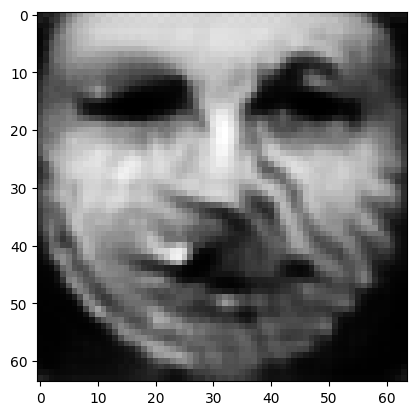

tensor([[9.3170e-05, 8.1860e-04, 9.2871e-04, 9.8772e-01, 3.3871e-05, 2.6950e-04,
         8.9846e-06, 4.4147e-04, 1.4826e-03, 1.6484e-05, 3.3791e-05, 5.6365e-05,
         1.1555e-03, 7.8135e-05, 8.3769e-06, 1.3829e-05, 2.2485e-04, 2.4389e-05,
         1.8769e-04, 3.3654e-05, 1.6195e-05, 2.4387e-06, 9.1050e-05, 2.5058e-05,
         5.5073e-04, 1.0537e-03, 2.6926e-05, 5.0326e-05, 2.9497e-04, 2.5790e-04,
         7.4673e-04, 6.6250e-05, 4.5319e-05, 2.3815e-05, 9.3510e-04, 8.7137e-05,
         8.5218e-05, 1.6700e-03, 2.8731e-04, 5.4328e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012356514111161232
tensor([[9.3159e-05, 8.1849e-04, 9.2862e-04, 9.8772e-01, 3.3865e-05, 2.6945e-04,
         8.9831e-06, 4.4141e-04, 1.4824e-03, 1.6481e-05, 3.3785e-05, 5.6357e-05,
         1.1554e-03, 7.8123e-05, 8.3759e-06, 1.3826e-05, 2.2481e-04, 2.4385e-05,
         1.8766e-04, 3.3650e-05, 1.6193e-05, 2.4384e-06, 9.1034e-05, 2.5054e-05,
         5.5064e-04, 1.0535e-03, 2.6922e-

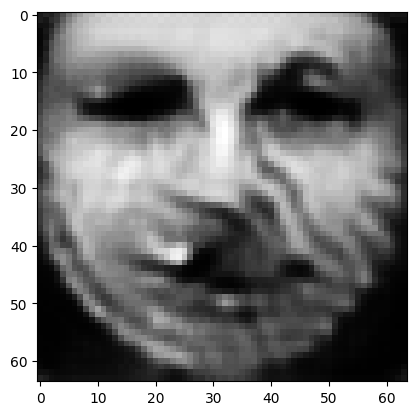

tensor([[9.3118e-05, 8.1809e-04, 9.2821e-04, 9.8773e-01, 3.3844e-05, 2.6928e-04,
         8.9775e-06, 4.4118e-04, 1.4817e-03, 1.6470e-05, 3.3763e-05, 5.6327e-05,
         1.1548e-03, 7.8078e-05, 8.3718e-06, 1.3817e-05, 2.2468e-04, 2.4372e-05,
         1.8756e-04, 3.3635e-05, 1.6182e-05, 2.4370e-06, 9.0975e-05, 2.5039e-05,
         5.5034e-04, 1.0528e-03, 2.6906e-05, 5.0278e-05, 2.9468e-04, 2.5774e-04,
         7.4634e-04, 6.6209e-05, 4.5289e-05, 2.3797e-05, 9.3432e-04, 8.7076e-05,
         8.5142e-05, 1.6692e-03, 2.8715e-04, 5.4281e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012348624877631664
tensor([[9.3108e-05, 8.1799e-04, 9.2813e-04, 9.8773e-01, 3.3838e-05, 2.6924e-04,
         8.9761e-06, 4.4112e-04, 1.4816e-03, 1.6468e-05, 3.3758e-05, 5.6320e-05,
         1.1547e-03, 7.8067e-05, 8.3708e-06, 1.3815e-05, 2.2465e-04, 2.4368e-05,
         1.8754e-04, 3.3631e-05, 1.6179e-05, 2.4367e-06, 9.0959e-05, 2.5035e-05,
         5.5027e-04, 1.0527e-03, 2.6902e-

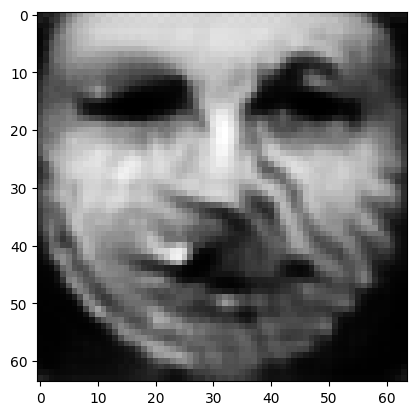

tensor([[9.3068e-05, 8.1759e-04, 9.2775e-04, 9.8773e-01, 3.3817e-05, 2.6907e-04,
         8.9706e-06, 4.4090e-04, 1.4810e-03, 1.6457e-05, 3.3736e-05, 5.6291e-05,
         1.1541e-03, 7.8025e-05, 8.3669e-06, 1.3806e-05, 2.2452e-04, 2.4355e-05,
         1.8744e-04, 3.3616e-05, 1.6169e-05, 2.4354e-06, 9.0903e-05, 2.5020e-05,
         5.4998e-04, 1.0520e-03, 2.6887e-05, 5.0232e-05, 2.9441e-04, 2.5758e-04,
         7.4598e-04, 6.6169e-05, 4.5260e-05, 2.3780e-05, 9.3359e-04, 8.7017e-05,
         8.5070e-05, 1.6685e-03, 2.8699e-04, 5.4237e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012340971268713474
tensor([[9.3060e-05, 8.1750e-04, 9.2766e-04, 9.8774e-01, 3.3812e-05, 2.6903e-04,
         8.9694e-06, 4.4085e-04, 1.4808e-03, 1.6455e-05, 3.3731e-05, 5.6284e-05,
         1.1540e-03, 7.8014e-05, 8.3660e-06, 1.3804e-05, 2.2449e-04, 2.4351e-05,
         1.8742e-04, 3.3613e-05, 1.6167e-05, 2.4351e-06, 9.0888e-05, 2.5016e-05,
         5.4990e-04, 1.0519e-03, 2.6884e-

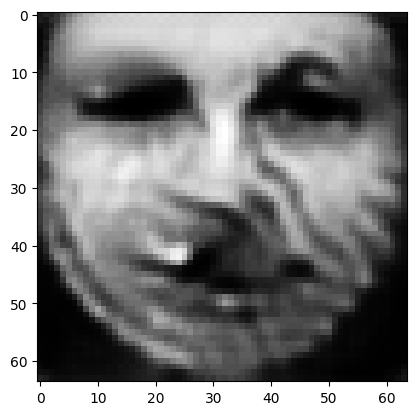

tensor([[9.3023e-05, 8.1713e-04, 9.2731e-04, 9.8774e-01, 3.3792e-05, 2.6887e-04,
         8.9643e-06, 4.4064e-04, 1.4802e-03, 1.6445e-05, 3.3711e-05, 5.6258e-05,
         1.1535e-03, 7.7973e-05, 8.3624e-06, 1.3795e-05, 2.2437e-04, 2.4339e-05,
         1.8733e-04, 3.3599e-05, 1.6157e-05, 2.4339e-06, 9.0834e-05, 2.5002e-05,
         5.4963e-04, 1.0512e-03, 2.6870e-05, 5.0189e-05, 2.9416e-04, 2.5744e-04,
         7.4563e-04, 6.6132e-05, 4.5233e-05, 2.3764e-05, 9.3289e-04, 8.6960e-05,
         8.5001e-05, 1.6679e-03, 2.8685e-04, 5.4196e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01233378890901804
tensor([[9.3013e-05, 8.1704e-04, 9.2721e-04, 9.8774e-01, 3.3787e-05, 2.6883e-04,
         8.9630e-06, 4.4058e-04, 1.4801e-03, 1.6442e-05, 3.3706e-05, 5.6251e-05,
         1.1533e-03, 7.7965e-05, 8.3614e-06, 1.3793e-05, 2.2434e-04, 2.4335e-05,
         1.8731e-04, 3.3595e-05, 1.6155e-05, 2.4336e-06, 9.0822e-05, 2.4999e-05,
         5.4956e-04, 1.0511e-03, 2.6866e-0

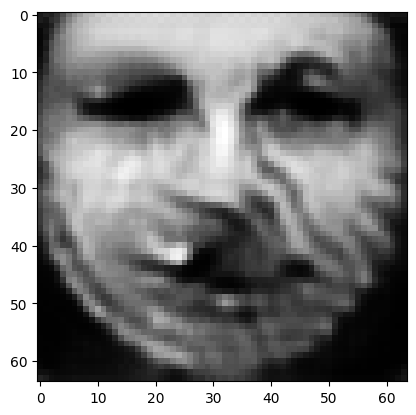

tensor([[9.2974e-05, 8.1671e-04, 9.2682e-04, 9.8775e-01, 3.3769e-05, 2.6867e-04,
         8.9581e-06, 4.4038e-04, 1.4794e-03, 1.6432e-05, 3.3686e-05, 5.6223e-05,
         1.1529e-03, 7.7930e-05, 8.3580e-06, 1.3785e-05, 2.2422e-04, 2.4323e-05,
         1.8722e-04, 3.3581e-05, 1.6145e-05, 2.4324e-06, 9.0777e-05, 2.4986e-05,
         5.4933e-04, 1.0506e-03, 2.6852e-05, 5.0147e-05, 2.9390e-04, 2.5730e-04,
         7.4532e-04, 6.6100e-05, 4.5208e-05, 2.3749e-05, 9.3223e-04, 8.6915e-05,
         8.4940e-05, 1.6673e-03, 2.8669e-04, 5.4153e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012326959520578384
tensor([[9.2965e-05, 8.1663e-04, 9.2673e-04, 9.8775e-01, 3.3765e-05, 2.6863e-04,
         8.9568e-06, 4.4033e-04, 1.4793e-03, 1.6430e-05, 3.3681e-05, 5.6217e-05,
         1.1528e-03, 7.7921e-05, 8.3571e-06, 1.3783e-05, 2.2419e-04, 2.4320e-05,
         1.8720e-04, 3.3577e-05, 1.6143e-05, 2.4322e-06, 9.0767e-05, 2.4982e-05,
         5.4928e-04, 1.0504e-03, 2.6849e-

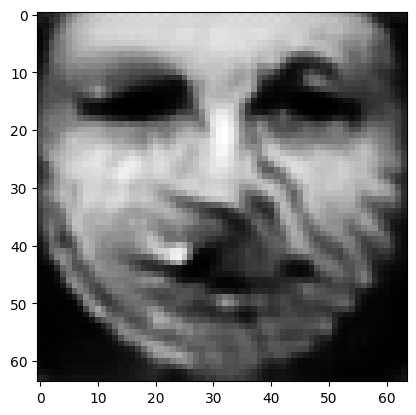

tensor([[9.2929e-05, 8.1631e-04, 9.2636e-04, 9.8775e-01, 3.3747e-05, 2.6847e-04,
         8.9521e-06, 4.4013e-04, 1.4787e-03, 1.6420e-05, 3.3662e-05, 5.6191e-05,
         1.1523e-03, 7.7888e-05, 8.3538e-06, 1.3775e-05, 2.2408e-04, 2.4309e-05,
         1.8712e-04, 3.3564e-05, 1.6134e-05, 2.4311e-06, 9.0725e-05, 2.4970e-05,
         5.4906e-04, 1.0499e-03, 2.6836e-05, 5.0108e-05, 2.9365e-04, 2.5716e-04,
         7.4502e-04, 6.6070e-05, 4.5184e-05, 2.3735e-05, 9.3160e-04, 8.6873e-05,
         8.4884e-05, 1.6667e-03, 2.8655e-04, 5.4113e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012320718728005886
tensor([[9.2920e-05, 8.1623e-04, 9.2627e-04, 9.8776e-01, 3.3743e-05, 2.6843e-04,
         8.9509e-06, 4.4008e-04, 1.4786e-03, 1.6418e-05, 3.3657e-05, 5.6184e-05,
         1.1522e-03, 7.7881e-05, 8.3531e-06, 1.3773e-05, 2.2406e-04, 2.4306e-05,
         1.8710e-04, 3.3560e-05, 1.6132e-05, 2.4308e-06, 9.0716e-05, 2.4967e-05,
         5.4900e-04, 1.0498e-03, 2.6832e-

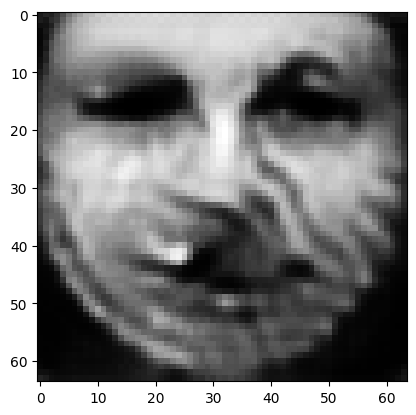

tensor([[9.2885e-05, 8.1594e-04, 9.2592e-04, 9.8776e-01, 3.3727e-05, 2.6828e-04,
         8.9464e-06, 4.3990e-04, 1.4780e-03, 1.6409e-05, 3.3639e-05, 5.6160e-05,
         1.1518e-03, 7.7850e-05, 8.3500e-06, 1.3765e-05, 2.2395e-04, 2.4295e-05,
         1.8702e-04, 3.3548e-05, 1.6123e-05, 2.4297e-06, 9.0676e-05, 2.4955e-05,
         5.4880e-04, 1.0493e-03, 2.6820e-05, 5.0071e-05, 2.9342e-04, 2.5704e-04,
         7.4475e-04, 6.6041e-05, 4.5162e-05, 2.3722e-05, 9.3101e-04, 8.6833e-05,
         8.4830e-05, 1.6661e-03, 2.8641e-04, 5.4075e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012314360588788986
tensor([[9.2877e-05, 8.1586e-04, 9.2584e-04, 9.8776e-01, 3.3723e-05, 2.6825e-04,
         8.9454e-06, 4.3986e-04, 1.4779e-03, 1.6406e-05, 3.3635e-05, 5.6154e-05,
         1.1517e-03, 7.7842e-05, 8.3492e-06, 1.3763e-05, 2.2393e-04, 2.4293e-05,
         1.8700e-04, 3.3545e-05, 1.6121e-05, 2.4295e-06, 9.0666e-05, 2.4953e-05,
         5.4875e-04, 1.0492e-03, 2.6817e-

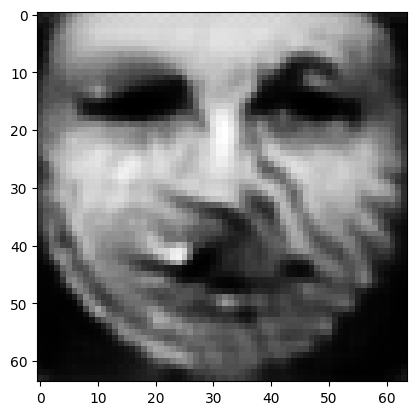

tensor([[9.2844e-05, 8.1558e-04, 9.2550e-04, 9.8777e-01, 3.3707e-05, 2.6811e-04,
         8.9410e-06, 4.3968e-04, 1.4774e-03, 1.6398e-05, 3.3617e-05, 5.6130e-05,
         1.1513e-03, 7.7812e-05, 8.3463e-06, 1.3756e-05, 2.2383e-04, 2.4282e-05,
         1.8692e-04, 3.3532e-05, 1.6113e-05, 2.4285e-06, 9.0629e-05, 2.4942e-05,
         5.4855e-04, 1.0487e-03, 2.6805e-05, 5.0035e-05, 2.9320e-04, 2.5691e-04,
         7.4448e-04, 6.6014e-05, 4.5140e-05, 2.3709e-05, 9.3044e-04, 8.6796e-05,
         8.4779e-05, 1.6656e-03, 2.8628e-04, 5.4039e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012308591045439243
tensor([[9.2837e-05, 8.1551e-04, 9.2542e-04, 9.8777e-01, 3.3703e-05, 2.6808e-04,
         8.9400e-06, 4.3964e-04, 1.4772e-03, 1.6396e-05, 3.3613e-05, 5.6125e-05,
         1.1512e-03, 7.7805e-05, 8.3456e-06, 1.3754e-05, 2.2381e-04, 2.4280e-05,
         1.8691e-04, 3.3530e-05, 1.6111e-05, 2.4283e-06, 9.0620e-05, 2.4939e-05,
         5.4851e-04, 1.0486e-03, 2.6802e-

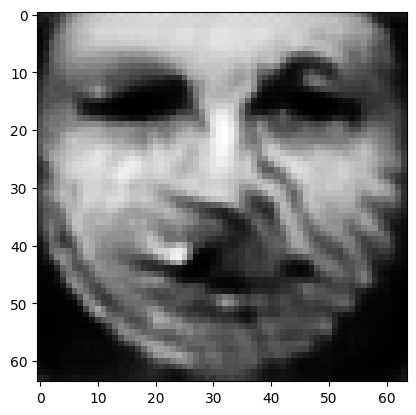

tensor([[9.2805e-05, 8.1524e-04, 9.2510e-04, 9.8777e-01, 3.3688e-05, 2.6794e-04,
         8.9359e-06, 4.3947e-04, 1.4767e-03, 1.6387e-05, 3.3597e-05, 5.6102e-05,
         1.1508e-03, 7.7777e-05, 8.3427e-06, 1.3747e-05, 2.2372e-04, 2.4270e-05,
         1.8683e-04, 3.3518e-05, 1.6103e-05, 2.4273e-06, 9.0584e-05, 2.4929e-05,
         5.4832e-04, 1.0482e-03, 2.6790e-05, 5.0002e-05, 2.9298e-04, 2.5680e-04,
         7.4422e-04, 6.5988e-05, 4.5120e-05, 2.3697e-05, 9.2991e-04, 8.6760e-05,
         8.4731e-05, 1.6650e-03, 2.8615e-04, 5.4004e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01230317447334528
tensor([[9.2798e-05, 8.1517e-04, 9.2502e-04, 9.8777e-01, 3.3685e-05, 2.6791e-04,
         8.9348e-06, 4.3943e-04, 1.4766e-03, 1.6385e-05, 3.3593e-05, 5.6096e-05,
         1.1507e-03, 7.7770e-05, 8.3420e-06, 1.3746e-05, 2.2369e-04, 2.4268e-05,
         1.8682e-04, 3.3515e-05, 1.6101e-05, 2.4271e-06, 9.0575e-05, 2.4926e-05,
         5.4827e-04, 1.0481e-03, 2.6787e-0

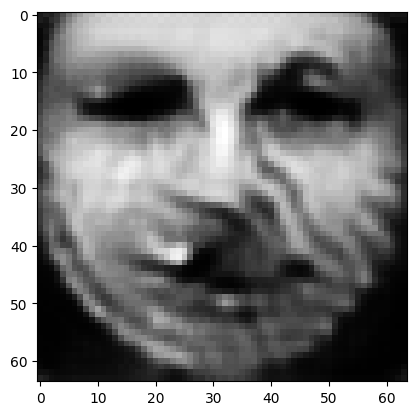

tensor([[9.2768e-05, 8.1491e-04, 9.2471e-04, 9.8778e-01, 3.3670e-05, 2.6778e-04,
         8.9309e-06, 4.3927e-04, 1.4761e-03, 1.6377e-05, 3.3577e-05, 5.6074e-05,
         1.1503e-03, 7.7743e-05, 8.3394e-06, 1.3739e-05, 2.2360e-04, 2.4258e-05,
         1.8675e-04, 3.3503e-05, 1.6093e-05, 2.4262e-06, 9.0541e-05, 2.4916e-05,
         5.4810e-04, 1.0476e-03, 2.6776e-05, 4.9970e-05, 2.9278e-04, 2.5668e-04,
         7.4397e-04, 6.5963e-05, 4.5100e-05, 2.3685e-05, 9.2940e-04, 8.6726e-05,
         8.4685e-05, 1.6646e-03, 2.8603e-04, 5.3970e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012297875247895718
tensor([[9.2760e-05, 8.1485e-04, 9.2464e-04, 9.8778e-01, 3.3667e-05, 2.6774e-04,
         8.9299e-06, 4.3923e-04, 1.4760e-03, 1.6375e-05, 3.3573e-05, 5.6069e-05,
         1.1502e-03, 7.7736e-05, 8.3387e-06, 1.3737e-05, 2.2358e-04, 2.4256e-05,
         1.8673e-04, 3.3501e-05, 1.6092e-05, 2.4259e-06, 9.0533e-05, 2.4913e-05,
         5.4805e-04, 1.0475e-03, 2.6773e-

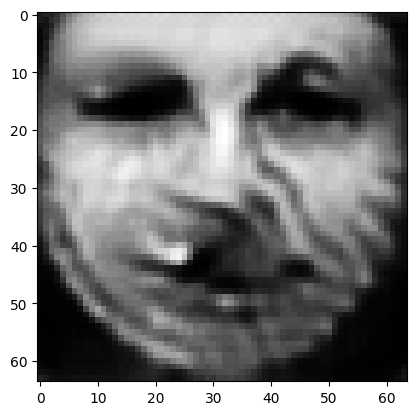

tensor([[9.2732e-05, 8.1459e-04, 9.2434e-04, 9.8778e-01, 3.3653e-05, 2.6762e-04,
         8.9261e-06, 4.3908e-04, 1.4755e-03, 1.6367e-05, 3.3558e-05, 5.6048e-05,
         1.1499e-03, 7.7710e-05, 8.3361e-06, 1.3731e-05, 2.2350e-04, 2.4247e-05,
         1.8667e-04, 3.3490e-05, 1.6084e-05, 2.4251e-06, 9.0500e-05, 2.4904e-05,
         5.4788e-04, 1.0471e-03, 2.6763e-05, 4.9939e-05, 2.9258e-04, 2.5658e-04,
         7.4373e-04, 6.5939e-05, 4.5081e-05, 2.3674e-05, 9.2891e-04, 8.6693e-05,
         8.4641e-05, 1.6641e-03, 2.8591e-04, 5.3938e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012292576022446156
tensor([[9.2725e-05, 8.1453e-04, 9.2427e-04, 9.8778e-01, 3.3650e-05, 2.6759e-04,
         8.9252e-06, 4.3904e-04, 1.4754e-03, 1.6366e-05, 3.3554e-05, 5.6043e-05,
         1.1498e-03, 7.7704e-05, 8.3355e-06, 1.3729e-05, 2.2348e-04, 2.4245e-05,
         1.8665e-04, 3.3487e-05, 1.6083e-05, 2.4249e-06, 9.0493e-05, 2.4902e-05,
         5.4784e-04, 1.0470e-03, 2.6760e-

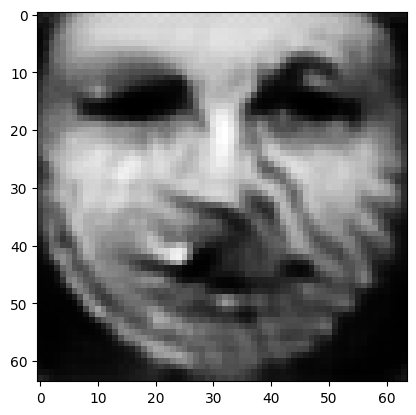

tensor([[9.2697e-05, 8.1429e-04, 9.2399e-04, 9.8779e-01, 3.3637e-05, 2.6747e-04,
         8.9215e-06, 4.3889e-04, 1.4750e-03, 1.6358e-05, 3.3539e-05, 5.6023e-05,
         1.1494e-03, 7.7680e-05, 8.3330e-06, 1.3723e-05, 2.2339e-04, 2.4236e-05,
         1.8659e-04, 3.3477e-05, 1.6076e-05, 2.4240e-06, 9.0462e-05, 2.4892e-05,
         5.4768e-04, 1.0467e-03, 2.6750e-05, 4.9909e-05, 2.9240e-04, 2.5647e-04,
         7.4351e-04, 6.5916e-05, 4.5063e-05, 2.3663e-05, 9.2844e-04, 8.6662e-05,
         8.4599e-05, 1.6636e-03, 2.8580e-04, 5.3907e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012287748046219349
tensor([[9.2691e-05, 8.1424e-04, 9.2393e-04, 9.8779e-01, 3.3634e-05, 2.6744e-04,
         8.9207e-06, 4.3885e-04, 1.4749e-03, 1.6356e-05, 3.3536e-05, 5.6019e-05,
         1.1494e-03, 7.7674e-05, 8.3324e-06, 1.3722e-05, 2.2337e-04, 2.4234e-05,
         1.8657e-04, 3.3474e-05, 1.6074e-05, 2.4238e-06, 9.0454e-05, 2.4890e-05,
         5.4763e-04, 1.0466e-03, 2.6748e-

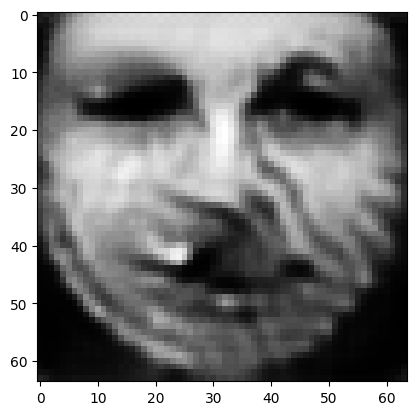

tensor([[9.2665e-05, 8.1401e-04, 9.2366e-04, 9.8779e-01, 3.3621e-05, 2.6733e-04,
         8.9172e-06, 4.3871e-04, 1.4745e-03, 1.6350e-05, 3.3522e-05, 5.6000e-05,
         1.1490e-03, 7.7650e-05, 8.3301e-06, 1.3716e-05, 2.2330e-04, 2.4226e-05,
         1.8651e-04, 3.3465e-05, 1.6068e-05, 2.4231e-06, 9.0425e-05, 2.4881e-05,
         5.4748e-04, 1.0462e-03, 2.6738e-05, 4.9881e-05, 2.9222e-04, 2.5638e-04,
         7.4330e-04, 6.5895e-05, 4.5046e-05, 2.3653e-05, 9.2801e-04, 8.6632e-05,
         8.4559e-05, 1.6632e-03, 2.8569e-04, 5.3879e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012283273972570896
tensor([[9.2658e-05, 8.1396e-04, 9.2360e-04, 9.8779e-01, 3.3618e-05, 2.6730e-04,
         8.9164e-06, 4.3868e-04, 1.4744e-03, 1.6348e-05, 3.3519e-05, 5.5996e-05,
         1.1490e-03, 7.7645e-05, 8.3295e-06, 1.3715e-05, 2.2328e-04, 2.4224e-05,
         1.8650e-04, 3.3462e-05, 1.6066e-05, 2.4229e-06, 9.0418e-05, 2.4879e-05,
         5.4744e-04, 1.0461e-03, 2.6736e-

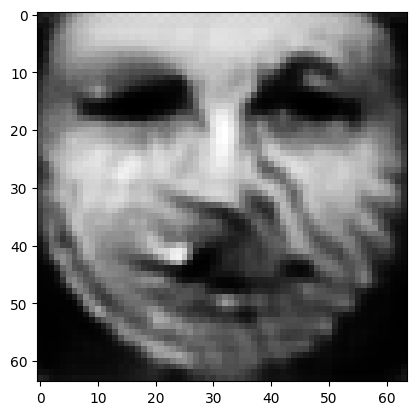

tensor([[9.2633e-05, 8.1375e-04, 9.2335e-04, 9.8780e-01, 3.3606e-05, 2.6720e-04,
         8.9131e-06, 4.3855e-04, 1.4740e-03, 1.6341e-05, 3.3506e-05, 5.5979e-05,
         1.1487e-03, 7.7622e-05, 8.3273e-06, 1.3709e-05, 2.2320e-04, 2.4216e-05,
         1.8644e-04, 3.3453e-05, 1.6060e-05, 2.4221e-06, 9.0391e-05, 2.4871e-05,
         5.4730e-04, 1.0458e-03, 2.6727e-05, 4.9855e-05, 2.9206e-04, 2.5629e-04,
         7.4309e-04, 6.5875e-05, 4.5030e-05, 2.3644e-05, 9.2759e-04, 8.6604e-05,
         8.4521e-05, 1.6628e-03, 2.8559e-04, 5.3852e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012278917245566845
tensor([[9.2628e-05, 8.1370e-04, 9.2329e-04, 9.8780e-01, 3.3604e-05, 2.6718e-04,
         8.9124e-06, 4.3852e-04, 1.4739e-03, 1.6340e-05, 3.3503e-05, 5.5974e-05,
         1.1486e-03, 7.7616e-05, 8.3268e-06, 1.3708e-05, 2.2319e-04, 2.4214e-05,
         1.8643e-04, 3.3451e-05, 1.6059e-05, 2.4220e-06, 9.0383e-05, 2.4869e-05,
         5.4726e-04, 1.0457e-03, 2.6725e-

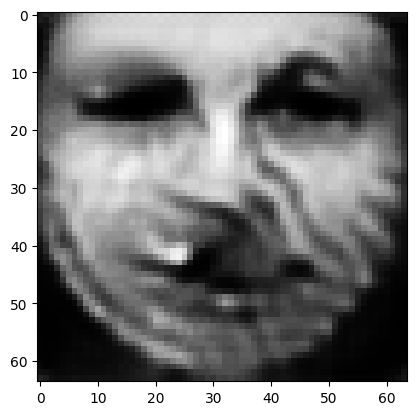

tensor([[9.2605e-05, 8.1349e-04, 9.2306e-04, 9.8780e-01, 3.3593e-05, 2.6708e-04,
         8.9093e-06, 4.3839e-04, 1.4735e-03, 1.6333e-05, 3.3491e-05, 5.5958e-05,
         1.1483e-03, 7.7595e-05, 8.3247e-06, 1.3703e-05, 2.2312e-04, 2.4207e-05,
         1.8638e-04, 3.3442e-05, 1.6053e-05, 2.4213e-06, 9.0357e-05, 2.4861e-05,
         5.4712e-04, 1.0453e-03, 2.6716e-05, 4.9830e-05, 2.9190e-04, 2.5620e-04,
         7.4289e-04, 6.5856e-05, 4.5015e-05, 2.3634e-05, 9.2719e-04, 8.6577e-05,
         8.4486e-05, 1.6624e-03, 2.8550e-04, 5.3826e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012274677865207195
tensor([[9.2599e-05, 8.1344e-04, 9.2300e-04, 9.8780e-01, 3.3590e-05, 2.6705e-04,
         8.9086e-06, 4.3836e-04, 1.4734e-03, 1.6332e-05, 3.3487e-05, 5.5954e-05,
         1.1482e-03, 7.7590e-05, 8.3241e-06, 1.3702e-05, 2.2310e-04, 2.4205e-05,
         1.8636e-04, 3.3440e-05, 1.6052e-05, 2.4211e-06, 9.0350e-05, 2.4859e-05,
         5.4709e-04, 1.0453e-03, 2.6714e-

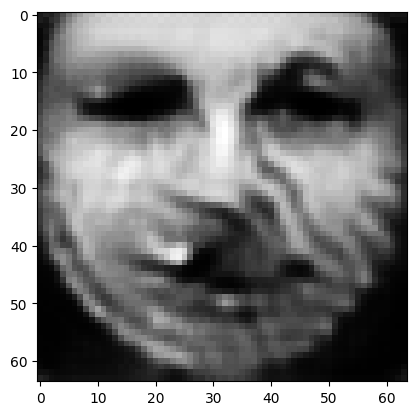

tensor([[9.2577e-05, 8.1325e-04, 9.2277e-04, 9.8780e-01, 3.3579e-05, 2.6696e-04,
         8.9057e-06, 4.3824e-04, 1.4731e-03, 1.6326e-05, 3.3476e-05, 5.5938e-05,
         1.1480e-03, 7.7570e-05, 8.3222e-06, 1.3697e-05, 2.2303e-04, 2.4198e-05,
         1.8631e-04, 3.3431e-05, 1.6046e-05, 2.4204e-06, 9.0325e-05, 2.4852e-05,
         5.4695e-04, 1.0450e-03, 2.6706e-05, 4.9806e-05, 2.9175e-04, 2.5612e-04,
         7.4271e-04, 6.5837e-05, 4.5000e-05, 2.3626e-05, 9.2682e-04, 8.6552e-05,
         8.4452e-05, 1.6621e-03, 2.8541e-04, 5.3802e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012270791456103325
tensor([[9.2572e-05, 8.1320e-04, 9.2272e-04, 9.8780e-01, 3.3577e-05, 2.6693e-04,
         8.9050e-06, 4.3821e-04, 1.4730e-03, 1.6325e-05, 3.3473e-05, 5.5934e-05,
         1.1479e-03, 7.7565e-05, 8.3217e-06, 1.3696e-05, 2.2302e-04, 2.4196e-05,
         1.8630e-04, 3.3429e-05, 1.6045e-05, 2.4203e-06, 9.0319e-05, 2.4850e-05,
         5.4692e-04, 1.0449e-03, 2.6704e-

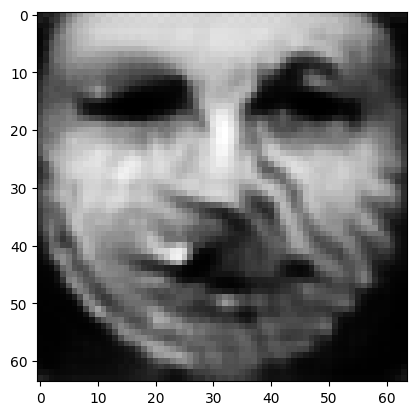

tensor([[9.2550e-05, 8.1302e-04, 9.2250e-04, 9.8781e-01, 3.3567e-05, 2.6684e-04,
         8.9022e-06, 4.3810e-04, 1.4727e-03, 1.6319e-05, 3.3462e-05, 5.5919e-05,
         1.1476e-03, 7.7546e-05, 8.3198e-06, 1.3691e-05, 2.2295e-04, 2.4189e-05,
         1.8625e-04, 3.3421e-05, 1.6040e-05, 2.4196e-06, 9.0296e-05, 2.4843e-05,
         5.4680e-04, 1.0446e-03, 2.6696e-05, 4.9783e-05, 2.9160e-04, 2.5604e-04,
         7.4253e-04, 6.5820e-05, 4.4986e-05, 2.3618e-05, 9.2646e-04, 8.6528e-05,
         8.4420e-05, 1.6617e-03, 2.8532e-04, 5.3778e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012267141602933407
tensor([[9.2545e-05, 8.1297e-04, 9.2245e-04, 9.8781e-01, 3.3564e-05, 2.6682e-04,
         8.9016e-06, 4.3807e-04, 1.4726e-03, 1.6318e-05, 3.3459e-05, 5.5915e-05,
         1.1476e-03, 7.7542e-05, 8.3194e-06, 1.3690e-05, 2.2294e-04, 2.4188e-05,
         1.8624e-04, 3.3420e-05, 1.6038e-05, 2.4195e-06, 9.0289e-05, 2.4841e-05,
         5.4676e-04, 1.0445e-03, 2.6694e-

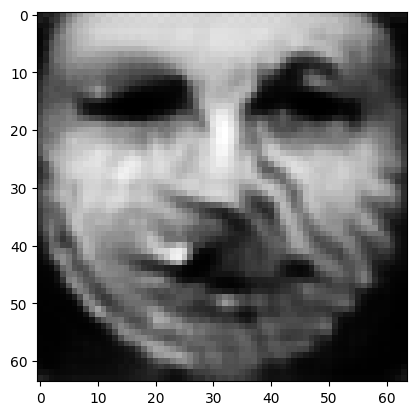

tensor([[9.2526e-05, 8.1280e-04, 9.2225e-04, 9.8781e-01, 3.3555e-05, 2.6674e-04,
         8.8990e-06, 4.3797e-04, 1.4723e-03, 1.6312e-05, 3.3449e-05, 5.5901e-05,
         1.1473e-03, 7.7523e-05, 8.3176e-06, 1.3685e-05, 2.2288e-04, 2.4182e-05,
         1.8620e-04, 3.3412e-05, 1.6033e-05, 2.4189e-06, 9.0267e-05, 2.4835e-05,
         5.4664e-04, 1.0442e-03, 2.6687e-05, 4.9762e-05, 2.9147e-04, 2.5596e-04,
         7.4237e-04, 6.5804e-05, 4.4973e-05, 2.3610e-05, 9.2612e-04, 8.6505e-05,
         8.4389e-05, 1.6614e-03, 2.8524e-04, 5.3756e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01226360909640789
tensor([[9.2520e-05, 8.1276e-04, 9.2220e-04, 9.8781e-01, 3.3553e-05, 2.6672e-04,
         8.8983e-06, 4.3794e-04, 1.4722e-03, 1.6311e-05, 3.3446e-05, 5.5898e-05,
         1.1473e-03, 7.7519e-05, 8.3171e-06, 1.3684e-05, 2.2286e-04, 2.4180e-05,
         1.8619e-04, 3.3410e-05, 1.6032e-05, 2.4187e-06, 9.0262e-05, 2.4833e-05,
         5.4662e-04, 1.0442e-03, 2.6685e-0

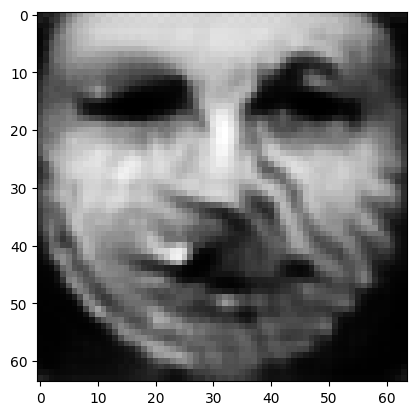

tensor([[9.2501e-05, 8.1260e-04, 9.2200e-04, 9.8781e-01, 3.3544e-05, 2.6663e-04,
         8.8959e-06, 4.3784e-04, 1.4719e-03, 1.6306e-05, 3.3436e-05, 5.5884e-05,
         1.1470e-03, 7.7502e-05, 8.3154e-06, 1.3680e-05, 2.2281e-04, 2.4174e-05,
         1.8614e-04, 3.3403e-05, 1.6027e-05, 2.4182e-06, 9.0241e-05, 2.4827e-05,
         5.4651e-04, 1.0439e-03, 2.6678e-05, 4.9741e-05, 2.9134e-04, 2.5589e-04,
         7.4221e-04, 6.5789e-05, 4.4961e-05, 2.3602e-05, 9.2580e-04, 8.6485e-05,
         8.4360e-05, 1.6611e-03, 2.8516e-04, 5.3735e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012260193936526775
tensor([[9.2497e-05, 8.1256e-04, 9.2195e-04, 9.8782e-01, 3.3541e-05, 2.6661e-04,
         8.8953e-06, 4.3781e-04, 1.4718e-03, 1.6305e-05, 3.3434e-05, 5.5881e-05,
         1.1470e-03, 7.7498e-05, 8.3150e-06, 1.3679e-05, 2.2279e-04, 2.4173e-05,
         1.8613e-04, 3.3401e-05, 1.6026e-05, 2.4180e-06, 9.0236e-05, 2.4825e-05,
         5.4648e-04, 1.0438e-03, 2.6677e-

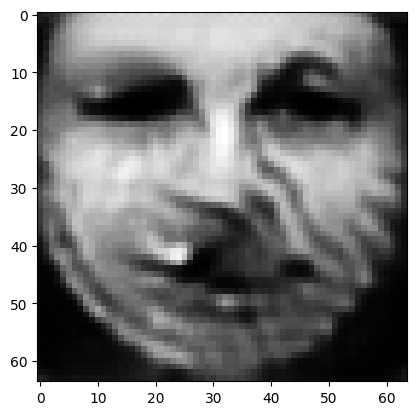

tensor([[9.2478e-05, 8.1240e-04, 9.2176e-04, 9.8782e-01, 3.3533e-05, 2.6654e-04,
         8.8929e-06, 4.3772e-04, 1.4715e-03, 1.6300e-05, 3.3424e-05, 5.5868e-05,
         1.1468e-03, 7.7482e-05, 8.3134e-06, 1.3675e-05, 2.2274e-04, 2.4167e-05,
         1.8609e-04, 3.3395e-05, 1.6022e-05, 2.4175e-06, 9.0216e-05, 2.4819e-05,
         5.4637e-04, 1.0436e-03, 2.6670e-05, 4.9722e-05, 2.9122e-04, 2.5583e-04,
         7.4206e-04, 6.5774e-05, 4.4949e-05, 2.3596e-05, 9.2549e-04, 8.6464e-05,
         8.4333e-05, 1.6608e-03, 2.8509e-04, 5.3715e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012257014401257038
tensor([[9.2474e-05, 8.1236e-04, 9.2172e-04, 9.8782e-01, 3.3531e-05, 2.6652e-04,
         8.8923e-06, 4.3769e-04, 1.4714e-03, 1.6299e-05, 3.3422e-05, 5.5865e-05,
         1.1467e-03, 7.7478e-05, 8.3130e-06, 1.3674e-05, 2.2272e-04, 2.4166e-05,
         1.8608e-04, 3.3393e-05, 1.6021e-05, 2.4173e-06, 9.0211e-05, 2.4817e-05,
         5.4634e-04, 1.0435e-03, 2.6669e-

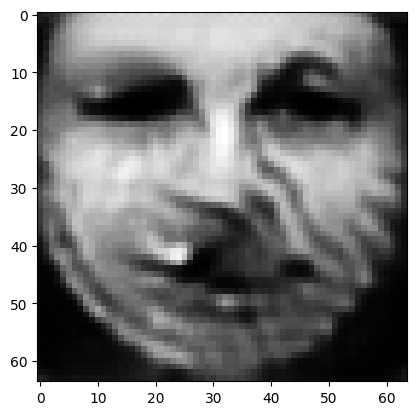

tensor([[9.2456e-05, 8.1222e-04, 9.2154e-04, 9.8782e-01, 3.3523e-05, 2.6644e-04,
         8.8901e-06, 4.3760e-04, 1.4712e-03, 1.6294e-05, 3.3413e-05, 5.5853e-05,
         1.1465e-03, 7.7463e-05, 8.3115e-06, 1.3670e-05, 2.2267e-04, 2.4160e-05,
         1.8604e-04, 3.3386e-05, 1.6016e-05, 2.4168e-06, 9.0192e-05, 2.4812e-05,
         5.4624e-04, 1.0433e-03, 2.6662e-05, 4.9703e-05, 2.9110e-04, 2.5576e-04,
         7.4191e-04, 6.5760e-05, 4.4938e-05, 2.3589e-05, 9.2520e-04, 8.6445e-05,
         8.4307e-05, 1.6605e-03, 2.8501e-04, 5.3696e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012253953143954277
tensor([[9.2453e-05, 8.1218e-04, 9.2150e-04, 9.8782e-01, 3.3521e-05, 2.6643e-04,
         8.8896e-06, 4.3758e-04, 1.4711e-03, 1.6293e-05, 3.3411e-05, 5.5850e-05,
         1.1464e-03, 7.7459e-05, 8.3112e-06, 1.3669e-05, 2.2266e-04, 2.4159e-05,
         1.8603e-04, 3.3385e-05, 1.6015e-05, 2.4167e-06, 9.0187e-05, 2.4811e-05,
         5.4622e-04, 1.0432e-03, 2.6661e-

In [17]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=3)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.4202628135681152


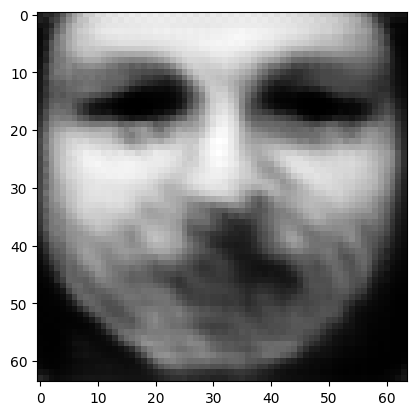

tensor([[0.0038, 0.0019, 0.0681, 0.0234, 0.1341, 0.0032, 0.0047, 0.0039, 0.0054,
         0.0006, 0.0007, 0.0011, 0.0331, 0.0043, 0.0006, 0.0006, 0.0209, 0.0053,
         0.0046, 0.0018, 0.0141, 0.0026, 0.0479, 0.0014, 0.2187, 0.0186, 0.0026,
         0.0081, 0.0234, 0.0087, 0.0090, 0.0015, 0.0236, 0.0255, 0.0320, 0.0091,
         0.0472, 0.0141, 0.1425, 0.0272]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.0089831352233887
tensor([[1.4811e-03, 8.9786e-04, 2.2924e-03, 1.5692e-03, 9.7619e-02, 3.6644e-04,
         6.6852e-04, 8.8845e-04, 9.5957e-04, 6.6928e-05, 2.8877e-04, 5.1570e-04,
         3.5997e-03, 2.3847e-02, 1.0853e-03, 3.0793e-04, 1.3904e-02, 4.2275e-03,
         8.0550e-04, 2.4321e-04, 8.3611e-03, 1.9532e-03, 2.4075e-01, 1.0046e-03,
         1.4336e-01, 4.8416e-02, 6.4582e-04, 1.3087e-03, 2.3701e-04, 2.2598e-03,
         1.4105e-03, 5.5316e-03, 8.8378e-03, 6.3390e-03, 5.4125e-03, 3.1253e-02,
         3.1982e-01, 1.2617e-02, 3.2877e-03, 1.5544e-03]], 

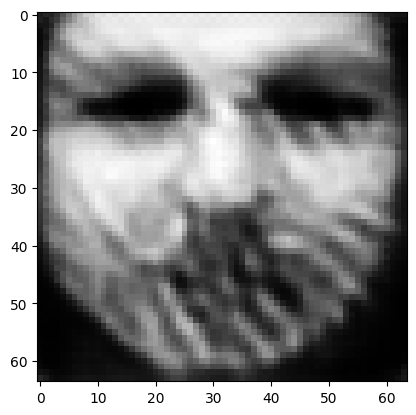

tensor([[1.3838e-03, 1.0432e-03, 7.4297e-03, 3.0953e-03, 5.8350e-01, 7.7747e-04,
         1.9444e-03, 2.1063e-03, 1.4504e-03, 1.1781e-04, 2.0831e-04, 3.4557e-04,
         2.1758e-02, 1.3123e-02, 1.1126e-03, 1.9347e-04, 1.5690e-02, 1.7353e-02,
         7.4866e-04, 9.2980e-04, 5.2347e-03, 9.8413e-04, 5.9524e-02, 4.0297e-04,
         1.1514e-01, 1.7884e-03, 1.6205e-03, 2.6548e-03, 6.6688e-04, 7.5779e-04,
         2.1712e-03, 4.0338e-03, 2.1271e-02, 7.7334e-03, 1.3349e-02, 1.4856e-02,
         4.5650e-02, 5.4509e-03, 1.9607e-02, 2.7853e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5387036800384521
tensor([[2.2578e-03, 9.5054e-04, 1.5886e-02, 3.2255e-03, 6.7203e-01, 1.6471e-03,
         4.2090e-03, 3.4735e-03, 2.0844e-03, 2.1281e-04, 2.0531e-04, 4.3689e-04,
         2.2741e-02, 6.3046e-03, 1.0320e-03, 2.1603e-04, 9.6817e-03, 3.6112e-02,
         5.8604e-04, 2.0137e-03, 4.0456e-03, 7.1139e-04, 1.2034e-02, 2.6079e-04,
         6.9822e-02, 4.1207e-04, 4.5358e-03

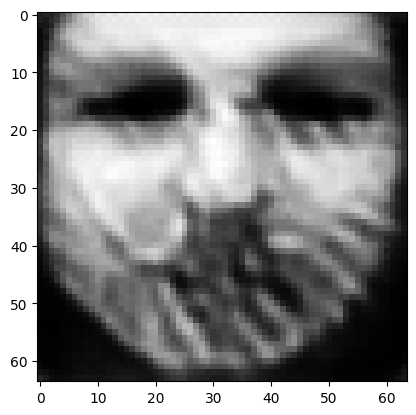

tensor([[1.3034e-03, 6.0905e-04, 8.8501e-03, 1.9940e-03, 7.8634e-01, 6.0897e-04,
         1.8742e-03, 1.8790e-03, 9.4202e-04, 6.8910e-05, 8.1363e-05, 1.8495e-04,
         1.1053e-02, 4.9774e-03, 5.5285e-04, 9.3466e-05, 6.8400e-03, 1.9365e-02,
         3.5366e-04, 6.5823e-04, 2.1109e-03, 4.3557e-04, 1.4310e-02, 1.8115e-04,
         6.0983e-02, 3.2942e-04, 1.7194e-03, 1.8780e-03, 3.7608e-04, 2.2508e-04,
         8.7574e-04, 1.9223e-03, 1.2117e-02, 3.9424e-03, 7.5620e-03, 5.9694e-03,
         1.2418e-02, 3.0168e-03, 1.8778e-02, 2.2220e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24036820232868195
tensor([[1.2187e-03, 5.8141e-04, 8.4158e-03, 1.8916e-03, 7.9747e-01, 5.5224e-04,
         1.6743e-03, 1.6814e-03, 8.8574e-04, 6.0018e-05, 7.0338e-05, 1.6884e-04,
         1.0400e-02, 4.7844e-03, 4.9678e-04, 8.3215e-05, 6.3001e-03, 1.7838e-02,
         3.2531e-04, 5.9077e-04, 1.9555e-03, 4.0796e-04, 1.4250e-02, 1.6663e-04,
         5.8749e-02, 3.1521e-04, 1.5856e-0

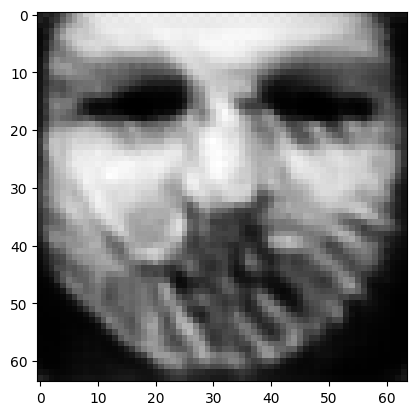

tensor([[1.0932e-03, 4.9715e-04, 7.8296e-03, 1.6014e-03, 8.2813e-01, 4.4852e-04,
         1.3452e-03, 1.3527e-03, 7.2645e-04, 4.3557e-05, 4.7399e-05, 1.2581e-04,
         8.6388e-03, 3.7774e-03, 3.7876e-04, 6.1069e-05, 5.0542e-03, 1.4987e-02,
         2.5856e-04, 5.1620e-04, 1.5227e-03, 3.2931e-04, 1.1124e-02, 1.3280e-04,
         5.1800e-02, 2.3993e-04, 1.3214e-03, 1.3838e-03, 2.4935e-04, 1.4755e-04,
         6.4496e-04, 1.4606e-03, 9.3741e-03, 2.7636e-03, 6.6801e-03, 4.3584e-03,
         8.7977e-03, 2.4102e-03, 1.6571e-02, 1.7702e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18858012557029724
tensor([[1.0758e-03, 4.8455e-04, 7.6320e-03, 1.5402e-03, 8.3405e-01, 4.3044e-04,
         1.3015e-03, 1.2924e-03, 6.9655e-04, 4.1286e-05, 4.4090e-05, 1.1893e-04,
         8.3579e-03, 3.6041e-03, 3.6549e-04, 5.7887e-05, 4.8394e-03, 1.4611e-02,
         2.4655e-04, 5.1007e-04, 1.4495e-03, 3.1566e-04, 1.0511e-02, 1.2706e-04,
         5.0102e-02, 2.2481e-04, 1.2870e-0

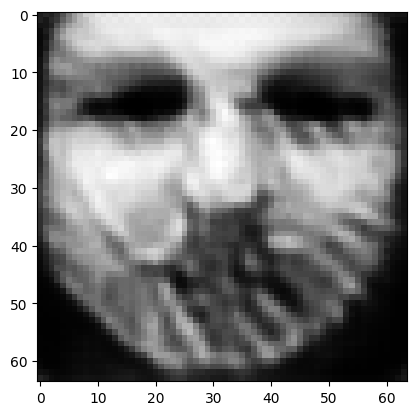

tensor([[1.0133e-03, 4.2961e-04, 6.9384e-03, 1.3056e-03, 8.5532e-01, 3.6967e-04,
         1.1439e-03, 1.1281e-03, 5.8247e-04, 3.3492e-05, 3.4731e-05, 9.6234e-05,
         7.1780e-03, 2.9836e-03, 3.2137e-04, 4.7398e-05, 4.1819e-03, 1.3105e-02,
         2.0800e-04, 4.8715e-04, 1.1972e-03, 2.6363e-04, 8.1172e-03, 1.0890e-04,
         4.4074e-02, 1.8101e-04, 1.1216e-03, 1.1323e-03, 1.9764e-04, 1.1334e-04,
         4.9561e-04, 1.2733e-03, 8.0235e-03, 2.1500e-03, 6.1438e-03, 3.4903e-03,
         6.4716e-03, 1.9068e-03, 1.5194e-02, 1.4373e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1562805473804474
tensor([[9.9243e-04, 4.2297e-04, 6.7788e-03, 1.2684e-03, 8.5936e-01, 3.5834e-04,
         1.0994e-03, 1.0960e-03, 5.6048e-04, 3.2118e-05, 3.2729e-05, 9.1492e-05,
         6.9983e-03, 2.8774e-03, 3.0852e-04, 4.5115e-05, 4.0546e-03, 1.2663e-02,
         2.0092e-04, 4.7686e-04, 1.1437e-03, 2.5369e-04, 7.7755e-03, 1.0487e-04,
         4.3099e-02, 1.7580e-04, 1.0789e-03

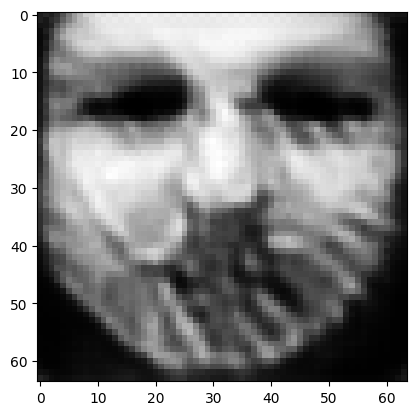

tensor([[9.4085e-04, 3.9717e-04, 6.2892e-03, 1.1366e-03, 8.7171e-01, 3.1885e-04,
         9.6666e-04, 9.9636e-04, 4.8779e-04, 2.7803e-05, 2.7556e-05, 7.8424e-05,
         6.2661e-03, 2.6006e-03, 2.7868e-04, 3.9116e-05, 3.7297e-03, 1.1609e-02,
         1.7962e-04, 4.4688e-04, 9.9868e-04, 2.2313e-04, 6.7247e-03, 9.4636e-05,
         3.9967e-02, 1.5818e-04, 9.4767e-04, 1.0010e-03, 1.6538e-04, 9.4147e-05,
         4.1205e-04, 1.1264e-03, 7.0426e-03, 1.7936e-03, 5.7100e-03, 3.0066e-03,
         5.4492e-03, 1.6297e-03, 1.3715e-02, 1.2110e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1372951865196228
tensor([[9.3338e-04, 3.9140e-04, 6.2084e-03, 1.1101e-03, 8.7419e-01, 3.1225e-04,
         9.4191e-04, 9.8117e-04, 4.7269e-04, 2.6991e-05, 2.6663e-05, 7.5980e-05,
         6.0789e-03, 2.5450e-03, 2.7326e-04, 3.8060e-05, 3.6798e-03, 1.1448e-02,
         1.7527e-04, 4.4081e-04, 9.6928e-04, 2.1633e-04, 6.4887e-03, 9.2712e-05,
         3.9344e-02, 1.5438e-04, 9.2348e-04

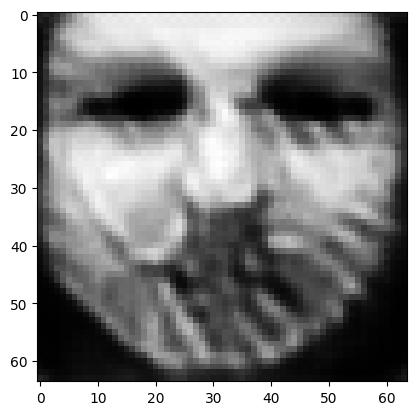

tensor([[8.9658e-04, 3.7587e-04, 5.8906e-03, 1.0304e-03, 8.8261e-01, 2.8947e-04,
         8.7142e-04, 9.0839e-04, 4.3563e-04, 2.4542e-05, 2.3408e-05, 6.8997e-05,
         5.6064e-03, 2.3568e-03, 2.5272e-04, 3.4294e-05, 3.3940e-03, 1.0814e-02,
         1.5988e-04, 4.1491e-04, 8.7722e-04, 1.9542e-04, 5.8211e-03, 8.4358e-05,
         3.6885e-02, 1.4189e-04, 8.6722e-04, 9.1742e-04, 1.4570e-04, 8.2092e-05,
         3.5292e-04, 1.0347e-03, 6.3612e-03, 1.5790e-03, 5.4281e-03, 2.7359e-03,
         4.7751e-03, 1.4554e-03, 1.2720e-02, 1.0843e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12487383931875229
tensor([[8.8558e-04, 3.7210e-04, 5.8433e-03, 1.0153e-03, 8.8454e-01, 2.8522e-04,
         8.5575e-04, 8.9125e-04, 4.2843e-04, 2.4052e-05, 2.2536e-05, 6.7341e-05,
         5.5095e-03, 2.2979e-03, 2.4566e-04, 3.3260e-05, 3.3076e-03, 1.0644e-02,
         1.5561e-04, 4.0924e-04, 8.5389e-04, 1.9046e-04, 5.6279e-03, 8.1943e-05,
         3.6340e-02, 1.3892e-04, 8.5429e-0

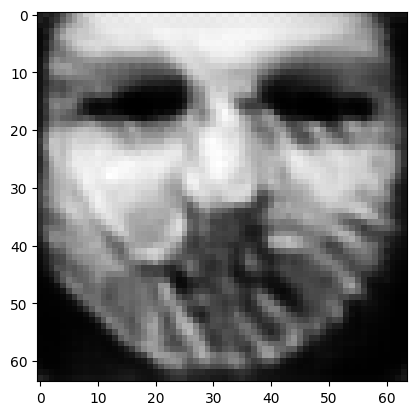

tensor([[8.6770e-04, 3.4983e-04, 5.6880e-03, 9.4224e-04, 8.9193e-01, 2.7820e-04,
         8.2925e-04, 8.6324e-04, 4.0061e-04, 2.3028e-05, 2.0287e-05, 6.2869e-05,
         5.0497e-03, 2.0494e-03, 2.2673e-04, 3.0253e-05, 3.0009e-03, 1.0435e-02,
         1.4145e-04, 3.9832e-04, 7.7705e-04, 1.7190e-04, 4.6789e-03, 7.4700e-05,
         3.3880e-02, 1.2351e-04, 8.2376e-04, 8.6727e-04, 1.3378e-04, 7.1244e-05,
         2.9955e-04, 9.5283e-04, 5.7646e-03, 1.4310e-03, 5.1112e-03, 2.4446e-03,
         4.1086e-03, 1.3071e-03, 1.2387e-02, 1.0012e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11436442285776138
tensor([[8.6197e-04, 3.4339e-04, 5.6195e-03, 9.2164e-04, 8.9378e-01, 2.7484e-04,
         8.1905e-04, 8.5893e-04, 3.9157e-04, 2.2664e-05, 1.9818e-05, 6.1719e-05,
         4.9127e-03, 2.0030e-03, 2.2345e-04, 2.9612e-05, 2.9496e-03, 1.0394e-02,
         1.3873e-04, 3.9272e-04, 7.5879e-04, 1.6737e-04, 4.4929e-03, 7.3539e-05,
         3.3338e-02, 1.2035e-04, 8.1090e-0

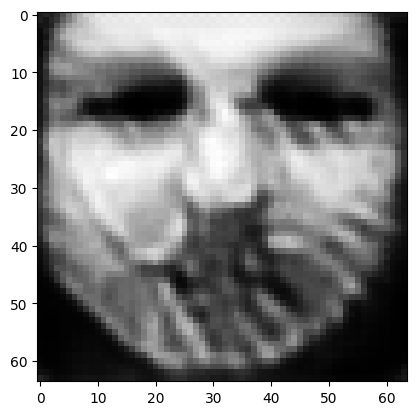

tensor([[8.3289e-04, 3.2637e-04, 5.6200e-03, 8.7529e-04, 9.0034e-01, 2.7198e-04,
         7.7754e-04, 8.3228e-04, 3.6961e-04, 2.1639e-05, 1.7531e-05, 5.7108e-05,
         4.5016e-03, 1.8018e-03, 2.0041e-04, 2.6662e-05, 2.6621e-03, 1.0121e-02,
         1.2593e-04, 3.7386e-04, 6.8557e-04, 1.5120e-04, 3.7813e-03, 6.5639e-05,
         3.1125e-02, 1.0737e-04, 7.8027e-04, 8.2967e-04, 1.2299e-04, 6.2400e-05,
         2.5150e-04, 8.6034e-04, 5.1380e-03, 1.2984e-03, 4.8153e-03, 2.1467e-03,
         3.5409e-03, 1.1828e-03, 1.1975e-02, 9.2916e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10498788207769394
tensor([[8.2351e-04, 3.2288e-04, 5.5996e-03, 8.6548e-04, 9.0177e-01, 2.6966e-04,
         7.6357e-04, 8.2224e-04, 3.6346e-04, 2.1287e-05, 1.6996e-05, 5.5866e-05,
         4.4134e-03, 1.7663e-03, 1.9511e-04, 2.5971e-05, 2.6046e-03, 1.0021e-02,
         1.2327e-04, 3.6779e-04, 6.6974e-04, 1.4801e-04, 3.6662e-03, 6.3975e-05,
         3.0692e-02, 1.0515e-04, 7.6957e-0

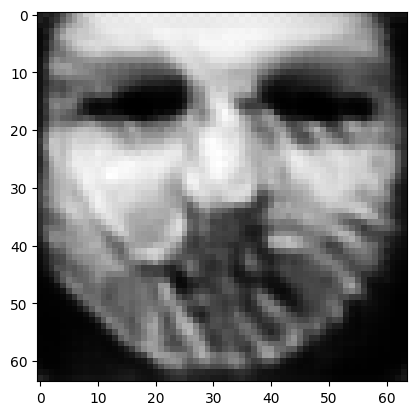

tensor([[7.8845e-04, 3.0929e-04, 5.4400e-03, 8.2406e-04, 9.0660e-01, 2.5743e-04,
         7.1414e-04, 7.8236e-04, 3.4194e-04, 1.9904e-05, 1.5388e-05, 5.1846e-05,
         4.1280e-03, 1.6628e-03, 1.8065e-04, 2.3812e-05, 2.4280e-03, 9.6396e-03,
         1.1468e-04, 3.4765e-04, 6.2127e-04, 1.3825e-04, 3.3505e-03, 5.9147e-05,
         2.9293e-02, 9.8389e-05, 7.2930e-04, 7.7987e-04, 1.1161e-04, 5.6426e-05,
         2.2337e-04, 7.9047e-04, 4.6844e-03, 1.1909e-03, 4.6162e-03, 1.9641e-03,
         3.2138e-03, 1.1052e-03, 1.1440e-02, 8.6259e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09805236756801605
tensor([[7.8210e-04, 3.0580e-04, 5.4091e-03, 8.1411e-04, 9.0769e-01, 2.5516e-04,
         7.0481e-04, 7.7524e-04, 3.3671e-04, 1.9610e-05, 1.5071e-05, 5.1013e-05,
         4.0592e-03, 1.6375e-03, 1.7772e-04, 2.3399e-05, 2.3951e-03, 9.5842e-03,
         1.1295e-04, 3.4354e-04, 6.1042e-04, 1.3592e-04, 3.2722e-03, 5.8242e-05,
         2.8948e-02, 9.6559e-05, 7.2136e-0

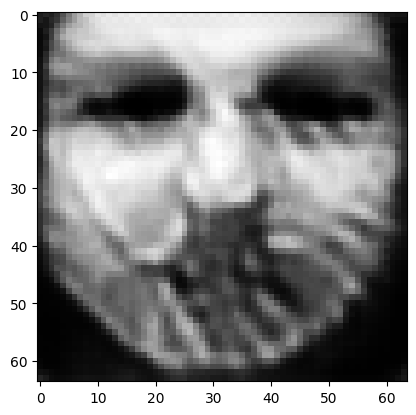

tensor([[7.5030e-04, 2.9567e-04, 5.2470e-03, 7.8033e-04, 9.1201e-01, 2.4331e-04,
         6.6070e-04, 7.3554e-04, 3.1754e-04, 1.8399e-05, 1.3642e-05, 4.7468e-05,
         3.8065e-03, 1.5530e-03, 1.6531e-04, 2.1686e-05, 2.2508e-03, 9.2048e-03,
         1.0643e-04, 3.2507e-04, 5.6715e-04, 1.2827e-04, 3.0381e-03, 5.4807e-05,
         2.7629e-02, 9.1544e-05, 6.8699e-04, 7.3499e-04, 1.0186e-04, 5.1651e-05,
         2.0258e-04, 7.3508e-04, 4.3103e-03, 1.0948e-03, 4.4510e-03, 1.8263e-03,
         2.9705e-03, 1.0418e-03, 1.0928e-02, 8.0196e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09210451692342758
tensor([[7.4188e-04, 2.9335e-04, 5.1857e-03, 7.7125e-04, 9.1300e-01, 2.3988e-04,
         6.5115e-04, 7.2617e-04, 3.1324e-04, 1.8121e-05, 1.3357e-05, 4.6685e-05,
         3.7617e-03, 1.5358e-03, 1.6298e-04, 2.1309e-05, 2.2216e-03, 9.1026e-03,
         1.0511e-04, 3.2063e-04, 5.5794e-04, 1.2660e-04, 2.9990e-03, 5.4108e-05,
         2.7340e-02, 9.0712e-05, 6.7904e-0

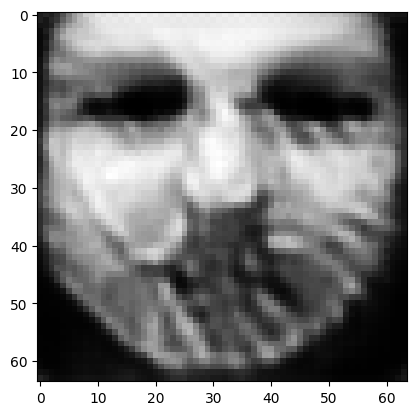

tensor([[7.1299e-04, 2.8596e-04, 4.9922e-03, 7.4126e-04, 9.1671e-01, 2.2902e-04,
         6.1554e-04, 6.9208e-04, 2.9822e-04, 1.7215e-05, 1.2218e-05, 4.3753e-05,
         3.5887e-03, 1.4602e-03, 1.5267e-04, 1.9880e-05, 2.0973e-03, 8.6918e-03,
         9.9892e-05, 3.0518e-04, 5.2214e-04, 1.2038e-04, 2.8295e-03, 5.1270e-05,
         2.6280e-02, 8.7159e-05, 6.4960e-04, 6.9096e-04, 9.2997e-05, 4.7867e-05,
         1.8913e-04, 6.8763e-04, 4.0028e-03, 1.0065e-03, 4.3356e-03, 1.7254e-03,
         2.7492e-03, 9.8257e-04, 1.0433e-02, 7.5033e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08696343004703522
tensor([[7.0722e-04, 2.8417e-04, 4.9502e-03, 7.3435e-04, 9.1755e-01, 2.2683e-04,
         6.0780e-04, 6.8576e-04, 2.9490e-04, 1.7025e-05, 1.1975e-05, 4.3095e-05,
         3.5510e-03, 1.4401e-03, 1.5029e-04, 1.9555e-05, 2.0700e-03, 8.5993e-03,
         9.8732e-05, 3.0202e-04, 5.1404e-04, 1.1900e-04, 2.7863e-03, 5.0646e-05,
         2.6035e-02, 8.6279e-05, 6.4225e-0

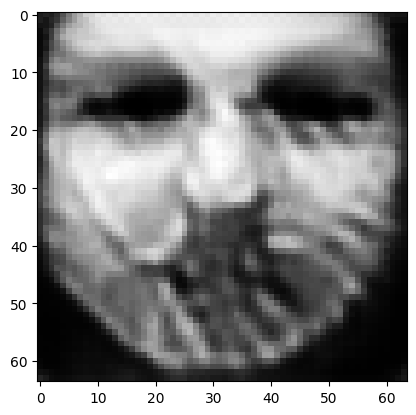

tensor([[6.8060e-04, 2.7770e-04, 4.7713e-03, 7.0707e-04, 9.2063e-01, 2.1631e-04,
         5.7553e-04, 6.5512e-04, 2.8340e-04, 1.6191e-05, 1.1051e-05, 4.0778e-05,
         3.4134e-03, 1.3811e-03, 1.4159e-04, 1.8354e-05, 1.9658e-03, 8.2073e-03,
         9.4411e-05, 2.8762e-04, 4.8583e-04, 1.1443e-04, 2.6754e-03, 4.8130e-05,
         2.5176e-02, 8.3487e-05, 6.1403e-04, 6.5278e-04, 8.5363e-05, 4.4937e-05,
         1.7933e-04, 6.4541e-04, 3.7651e-03, 9.3673e-04, 4.2252e-03, 1.6368e-03,
         2.5665e-03, 9.3289e-04, 1.0046e-02, 7.0896e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08269447088241577
tensor([[6.7788e-04, 2.7608e-04, 4.7420e-03, 7.0054e-04, 9.2137e-01, 2.1505e-04,
         5.7185e-04, 6.5269e-04, 2.8141e-04, 1.6096e-05, 1.0891e-05, 4.0380e-05,
         3.3841e-03, 1.3622e-03, 1.4014e-04, 1.8139e-05, 1.9382e-03, 8.1641e-03,
         9.3574e-05, 2.8602e-04, 4.7912e-04, 1.1328e-04, 2.6241e-03, 4.7622e-05,
         2.4901e-02, 8.2390e-05, 6.1161e-0

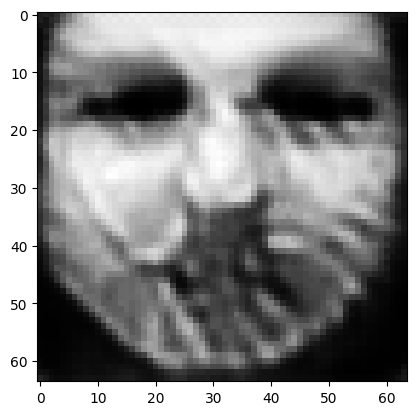

tensor([[6.5052e-04, 2.6842e-04, 4.5801e-03, 6.7172e-04, 9.2407e-01, 2.0345e-04,
         5.3933e-04, 6.2371e-04, 2.7010e-04, 1.5207e-05, 1.0072e-05, 3.8064e-05,
         3.2589e-03, 1.3136e-03, 1.3247e-04, 1.7035e-05, 1.8501e-03, 7.7858e-03,
         8.9662e-05, 2.7324e-04, 4.5377e-04, 1.0946e-04, 2.5305e-03, 4.5329e-05,
         2.4152e-02, 7.9683e-05, 5.8190e-04, 6.1755e-04, 7.8807e-05, 4.2455e-05,
         1.7119e-04, 6.0850e-04, 3.5861e-03, 8.8001e-04, 4.1052e-03, 1.5480e-03,
         2.4060e-03, 8.8831e-04, 9.7786e-03, 6.7148e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07896333932876587
tensor([[6.4911e-04, 2.6605e-04, 4.5488e-03, 6.6422e-04, 9.2473e-01, 2.0218e-04,
         5.3694e-04, 6.2183e-04, 2.6804e-04, 1.5116e-05, 9.9497e-06, 3.7777e-05,
         3.2200e-03, 1.2960e-03, 1.3171e-04, 1.6890e-05, 1.8263e-03, 7.7783e-03,
         8.8871e-05, 2.7263e-04, 4.4844e-04, 1.0844e-04, 2.4748e-03, 4.5012e-05,
         2.3888e-02, 7.8435e-05, 5.8019e-0

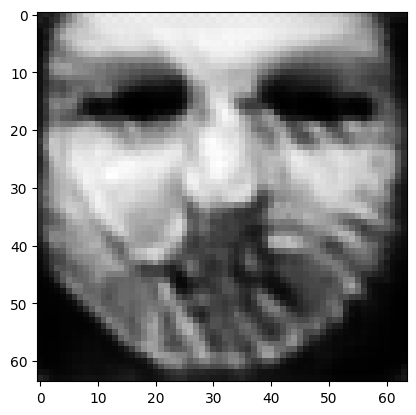

tensor([[6.3240e-04, 2.5886e-04, 4.3942e-03, 6.3902e-04, 9.2713e-01, 1.9346e-04,
         5.1554e-04, 6.0260e-04, 2.5868e-04, 1.4483e-05, 9.3351e-06, 3.6099e-05,
         3.1046e-03, 1.2445e-03, 1.2678e-04, 1.6077e-05, 1.7466e-03, 7.5608e-03,
         8.5680e-05, 2.6437e-04, 4.2778e-04, 1.0480e-04, 2.3576e-03, 4.3442e-05,
         2.3133e-02, 7.5287e-05, 5.6043e-04, 5.8761e-04, 7.3451e-05, 4.0123e-05,
         1.6280e-04, 5.8561e-04, 3.4568e-03, 8.3060e-04, 3.9690e-03, 1.4763e-03,
         2.2571e-03, 8.4621e-04, 9.5414e-03, 6.3406e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0756586417555809
tensor([[6.2696e-04, 2.5752e-04, 4.3485e-03, 6.3371e-04, 9.2771e-01, 1.9094e-04,
         5.0941e-04, 5.9636e-04, 2.5661e-04, 1.4316e-05, 9.1757e-06, 3.5692e-05,
         3.0799e-03, 1.2346e-03, 1.2545e-04, 1.5869e-05, 1.7272e-03, 7.4882e-03,
         8.4938e-05, 2.6154e-04, 4.2312e-04, 1.0398e-04, 2.3417e-03, 4.3022e-05,
         2.2984e-02, 7.4805e-05, 5.5513e-04

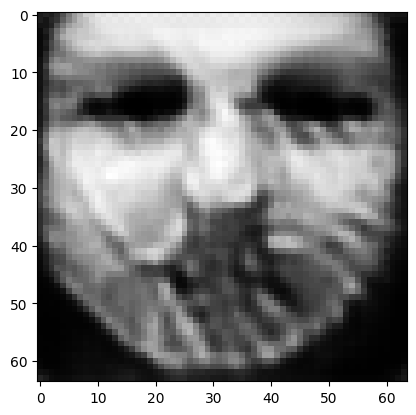

tensor([[6.1250e-04, 2.5157e-04, 4.1759e-03, 6.1191e-04, 9.2981e-01, 1.8231e-04,
         4.9132e-04, 5.7746e-04, 2.4874e-04, 1.3722e-05, 8.6511e-06, 3.4287e-05,
         2.9644e-03, 1.1932e-03, 1.2169e-04, 1.5210e-05, 1.6572e-03, 7.3013e-03,
         8.2131e-05, 2.5329e-04, 4.0601e-04, 1.0070e-04, 2.2538e-03, 4.1737e-05,
         2.2433e-02, 7.2071e-05, 5.3743e-04, 5.5651e-04, 6.7975e-05, 3.8141e-05,
         1.5579e-04, 5.6337e-04, 3.3366e-03, 7.8532e-04, 3.8561e-03, 1.4294e-03,
         2.1320e-03, 8.1038e-04, 9.2204e-03, 5.9899e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07277736812829971
tensor([[6.0960e-04, 2.4997e-04, 4.1364e-03, 6.0649e-04, 9.3031e-01, 1.8042e-04,
         4.8722e-04, 5.7382e-04, 2.4652e-04, 1.3577e-05, 8.5347e-06, 3.3937e-05,
         2.9356e-03, 1.1825e-03, 1.2080e-04, 1.5067e-05, 1.6432e-03, 7.2654e-03,
         8.1507e-05, 2.5159e-04, 4.0182e-04, 9.9848e-05, 2.2294e-03, 4.1496e-05,
         2.2298e-02, 7.1328e-05, 5.3312e-0

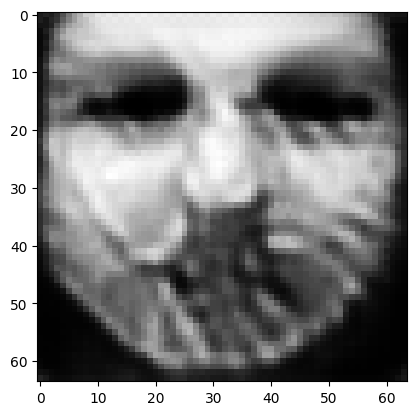

tensor([[5.9670e-04, 2.4404e-04, 3.9972e-03, 5.8670e-04, 9.3217e-01, 1.7357e-04,
         4.7156e-04, 5.5865e-04, 2.3882e-04, 1.3054e-05, 8.1271e-06, 3.2672e-05,
         2.8426e-03, 1.1432e-03, 1.1695e-04, 1.4502e-05, 1.5923e-03, 7.0957e-03,
         7.9088e-05, 2.4528e-04, 3.8710e-04, 9.6917e-05, 2.1484e-03, 4.0452e-05,
         2.1783e-02, 6.8811e-05, 5.1614e-04, 5.3204e-04, 6.3472e-05, 3.6292e-05,
         1.4903e-04, 5.4426e-04, 3.2297e-03, 7.4526e-04, 3.7370e-03, 1.3817e-03,
         2.0276e-03, 7.7729e-04, 8.9440e-03, 5.6639e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0702347531914711
tensor([[5.9277e-04, 2.4277e-04, 3.9654e-03, 5.8239e-04, 9.3261e-01, 1.7170e-04,
         4.6656e-04, 5.5412e-04, 2.3665e-04, 1.2907e-05, 8.0183e-06, 3.2293e-05,
         2.8219e-03, 1.1356e-03, 1.1582e-04, 1.4355e-05, 1.5825e-03, 7.0396e-03,
         7.8518e-05, 2.4346e-04, 3.8349e-04, 9.6303e-05, 2.1347e-03, 4.0208e-05,
         2.1681e-02, 6.8346e-05, 5.1073e-04

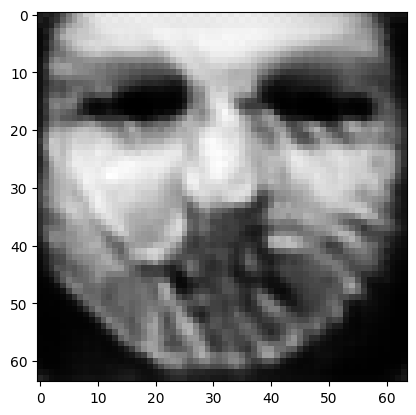

tensor([[5.8023e-04, 2.3886e-04, 3.8505e-03, 5.6729e-04, 9.3424e-01, 1.6594e-04,
         4.5102e-04, 5.3855e-04, 2.2997e-04, 1.2476e-05, 7.6395e-06, 3.1047e-05,
         2.7565e-03, 1.1025e-03, 1.1169e-04, 1.3840e-05, 1.5359e-03, 6.8422e-03,
         7.6411e-05, 2.3779e-04, 3.7018e-04, 9.3974e-05, 2.0717e-03, 3.9170e-05,
         2.1239e-02, 6.6456e-05, 4.9549e-04, 5.1038e-04, 5.9645e-05, 3.4746e-05,
         1.4440e-04, 5.2580e-04, 3.1295e-03, 7.0972e-04, 3.6600e-03, 1.3324e-03,
         1.9387e-03, 7.4924e-04, 8.7004e-03, 5.3918e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06802238523960114
tensor([[5.7898e-04, 2.3781e-04, 3.8329e-03, 5.6331e-04, 9.3466e-01, 1.6545e-04,
         4.4964e-04, 5.3870e-04, 2.2881e-04, 1.2437e-05, 7.5791e-06, 3.0794e-05,
         2.7453e-03, 1.0888e-03, 1.1069e-04, 1.3724e-05, 1.5249e-03, 6.8118e-03,
         7.6053e-05, 2.3769e-04, 3.6666e-04, 9.3294e-05, 2.0409e-03, 3.8979e-05,
         2.1068e-02, 6.5888e-05, 4.9352e-0

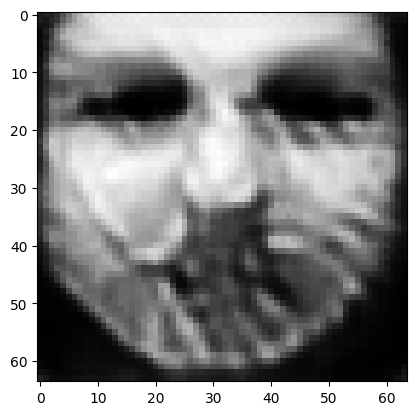

tensor([[5.7504e-04, 2.3376e-04, 3.7754e-03, 5.4937e-04, 9.3621e-01, 1.6385e-04,
         4.4420e-04, 5.3937e-04, 2.2406e-04, 1.2280e-05, 7.3408e-06, 2.9788e-05,
         2.6987e-03, 1.0370e-03, 1.0678e-04, 1.3287e-05, 1.4839e-03, 6.7011e-03,
         7.4686e-05, 2.3736e-04, 3.5309e-04, 9.0641e-05, 1.9224e-03, 3.8259e-05,
         2.0460e-02, 6.3654e-05, 4.8483e-04, 5.0191e-04, 5.7518e-05, 3.3312e-05,
         1.4014e-04, 5.0602e-04, 3.0293e-03, 6.8236e-04, 3.5522e-03, 1.2670e-03,
         1.8164e-03, 7.1685e-04, 8.6472e-03, 5.1842e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06591371446847916
tensor([[5.7521e-04, 2.3297e-04, 3.7637e-03, 5.4642e-04, 9.3656e-01, 1.6378e-04,
         4.4375e-04, 5.4019e-04, 2.2308e-04, 1.2264e-05, 7.2953e-06, 2.9589e-05,
         2.6874e-03, 1.0253e-03, 1.0608e-04, 1.3204e-05, 1.4739e-03, 6.6903e-03,
         7.4387e-05, 2.3759e-04, 3.5015e-04, 8.9982e-05, 1.8923e-03, 3.8111e-05,
         2.0310e-02, 6.3052e-05, 4.8373e-0

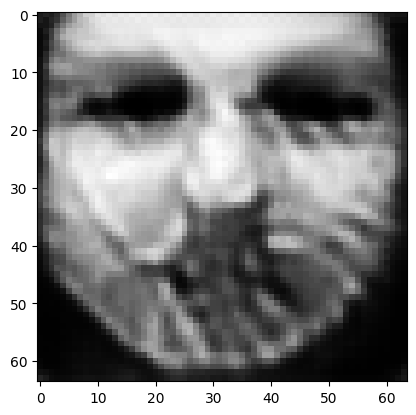

tensor([[5.6780e-04, 2.2989e-04, 3.6884e-03, 5.3473e-04, 9.3795e-01, 1.6074e-04,
         4.3481e-04, 5.3352e-04, 2.1864e-04, 1.2037e-05, 7.0251e-06, 2.8713e-05,
         2.6361e-03, 9.9186e-04, 1.0253e-04, 1.2807e-05, 1.4347e-03, 6.5561e-03,
         7.2854e-05, 2.3462e-04, 3.3909e-04, 8.7957e-05, 1.8218e-03, 3.7300e-05,
         1.9836e-02, 6.1510e-05, 4.7428e-04, 4.9113e-04, 5.5223e-05, 3.2079e-05,
         1.3632e-04, 4.8925e-04, 2.9361e-03, 6.5592e-04, 3.4754e-03, 1.2209e-03,
         1.7256e-03, 6.9263e-04, 8.5235e-03, 4.9988e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06405811756849289
tensor([[5.6630e-04, 2.2910e-04, 3.6769e-03, 5.3211e-04, 9.3829e-01, 1.6035e-04,
         4.3323e-04, 5.3312e-04, 2.1768e-04, 1.2001e-05, 6.9662e-06, 2.8508e-05,
         2.6226e-03, 9.8216e-04, 1.0153e-04, 1.2704e-05, 1.4242e-03, 6.5275e-03,
         7.2462e-05, 2.3409e-04, 3.3622e-04, 8.7438e-05, 1.8002e-03, 3.7079e-05,
         1.9708e-02, 6.1065e-05, 4.7228e-0

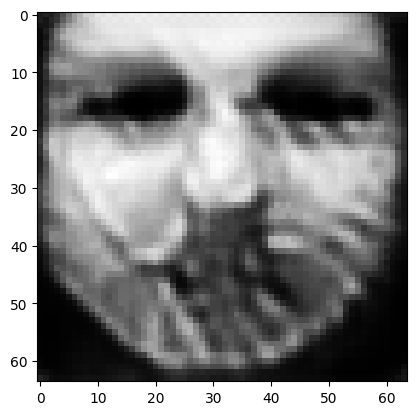

tensor([[5.5806e-04, 2.2642e-04, 3.5998e-03, 5.2216e-04, 9.3957e-01, 1.5679e-04,
         4.2355e-04, 5.2469e-04, 2.1290e-04, 1.1749e-05, 6.7116e-06, 2.7668e-05,
         2.5723e-03, 9.5599e-04, 9.8369e-05, 1.2338e-05, 1.3921e-03, 6.3988e-03,
         7.1014e-05, 2.2998e-04, 3.2679e-04, 8.5628e-05, 1.7490e-03, 3.6343e-05,
         1.9310e-02, 5.9743e-05, 4.6199e-04, 4.7942e-04, 5.2934e-05, 3.0999e-05,
         1.3299e-04, 4.7304e-04, 2.8484e-03, 6.3110e-04, 3.3993e-03, 1.1827e-03,
         1.6556e-03, 6.7292e-04, 8.3564e-03, 4.8295e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0623321458697319
tensor([[5.5595e-04, 2.2591e-04, 3.5800e-03, 5.1993e-04, 9.3987e-01, 1.5592e-04,
         4.2143e-04, 5.2247e-04, 2.1185e-04, 1.1696e-05, 6.6542e-06, 2.7481e-05,
         2.5630e-03, 9.4998e-04, 9.7659e-05, 1.2252e-05, 1.3845e-03, 6.3675e-03,
         7.0677e-05, 2.2900e-04, 3.2471e-04, 8.5223e-05, 1.7383e-03, 3.6165e-05,
         1.9216e-02, 5.9465e-05, 4.5978e-04

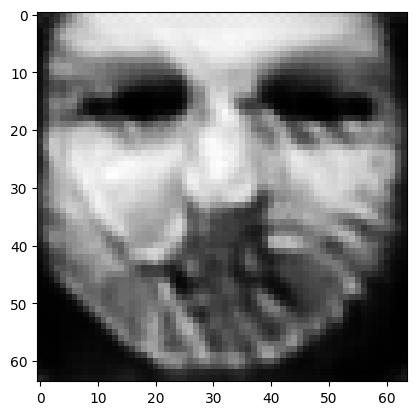

tensor([[5.4896e-04, 2.2334e-04, 3.5004e-03, 5.1018e-04, 9.4099e-01, 1.5238e-04,
         4.1285e-04, 5.1469e-04, 2.0731e-04, 1.1454e-05, 6.4481e-06, 2.6769e-05,
         2.5181e-03, 9.2887e-04, 9.5347e-05, 1.1954e-05, 1.3611e-03, 6.2638e-03,
         6.9443e-05, 2.2494e-04, 3.1694e-04, 8.3573e-05, 1.6998e-03, 3.5636e-05,
         1.8888e-02, 5.8333e-05, 4.5007e-04, 4.6796e-04, 5.0833e-05, 3.0077e-05,
         1.3014e-04, 4.6070e-04, 2.7728e-03, 6.0859e-04, 3.3342e-03, 1.1567e-03,
         1.6019e-03, 6.5526e-04, 8.1558e-03, 4.6646e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06082475930452347
tensor([[5.4485e-04, 2.2267e-04, 3.4692e-03, 5.0725e-04, 9.4126e-01, 1.5058e-04,
         4.0864e-04, 5.0981e-04, 2.0580e-04, 1.1335e-05, 6.3791e-06, 2.6563e-05,
         2.5087e-03, 9.2673e-04, 9.4732e-05, 1.1859e-05, 1.3572e-03, 6.2107e-03,
         6.9088e-05, 2.2318e-04, 3.1527e-04, 8.3270e-05, 1.7041e-03, 3.5458e-05,
         1.8843e-02, 5.8268e-05, 4.4608e-0

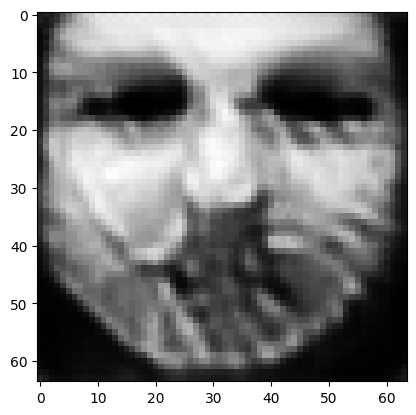

tensor([[5.3694e-04, 2.2059e-04, 3.3930e-03, 4.9814e-04, 9.4223e-01, 1.4689e-04,
         4.0040e-04, 5.0056e-04, 2.0199e-04, 1.1109e-05, 6.1980e-06, 2.5957e-05,
         2.4775e-03, 9.0951e-04, 9.2667e-05, 1.1564e-05, 1.3350e-03, 6.0947e-03,
         6.7987e-05, 2.1957e-04, 3.0896e-04, 8.2049e-05, 1.6818e-03, 3.4913e-05,
         1.8548e-02, 5.7458e-05, 4.3771e-04, 4.5496e-04, 4.8645e-05, 2.9274e-05,
         1.2854e-04, 4.5070e-04, 2.7194e-03, 5.8990e-04, 3.2777e-03, 1.1406e-03,
         1.5623e-03, 6.4150e-04, 7.9705e-03, 4.5141e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.059502359479665756
tensor([[5.3581e-04, 2.1995e-04, 3.3794e-03, 4.9596e-04, 9.4247e-01, 1.4633e-04,
         3.9916e-04, 4.9954e-04, 2.0116e-04, 1.1066e-05, 6.1611e-06, 2.5817e-05,
         2.4665e-03, 9.0367e-04, 9.2156e-05, 1.1499e-05, 1.3294e-03, 6.0743e-03,
         6.7725e-05, 2.1900e-04, 3.0715e-04, 8.1690e-05, 1.6710e-03, 3.4802e-05,
         1.8468e-02, 5.7147e-05, 4.3594e-

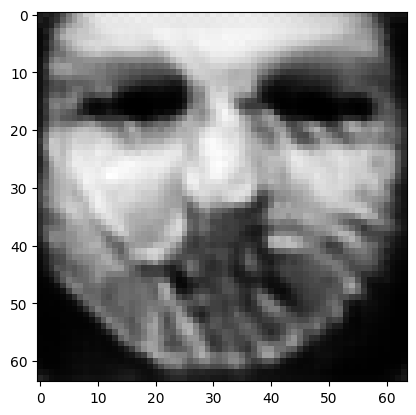

tensor([[5.2975e-04, 2.1819e-04, 3.3078e-03, 4.8807e-04, 9.4336e-01, 1.4306e-04,
         3.9185e-04, 4.9152e-04, 1.9775e-04, 1.0872e-05, 6.0005e-06, 2.5293e-05,
         2.4346e-03, 8.8859e-04, 9.0562e-05, 1.1258e-05, 1.3089e-03, 5.9797e-03,
         6.6775e-05, 2.1580e-04, 3.0143e-04, 8.0572e-05, 1.6495e-03, 3.4359e-05,
         1.8191e-02, 5.6383e-05, 4.2888e-04, 4.4462e-04, 4.6909e-05, 2.8591e-05,
         1.2665e-04, 4.4163e-04, 2.6696e-03, 5.7378e-04, 3.2216e-03, 1.1239e-03,
         1.5192e-03, 6.2888e-04, 7.8233e-03, 4.3874e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.058303266763687134
tensor([[5.2906e-04, 2.1763e-04, 3.2967e-03, 4.8625e-04, 9.4358e-01, 1.4264e-04,
         3.9098e-04, 4.9073e-04, 1.9714e-04, 1.0843e-05, 5.9679e-06, 2.5174e-05,
         2.4250e-03, 8.8304e-04, 9.0136e-05, 1.1203e-05, 1.3030e-03, 5.9653e-03,
         6.6536e-05, 2.1541e-04, 2.9979e-04, 8.0245e-05, 1.6378e-03, 3.4251e-05,
         1.8108e-02, 5.6074e-05, 4.2774e-

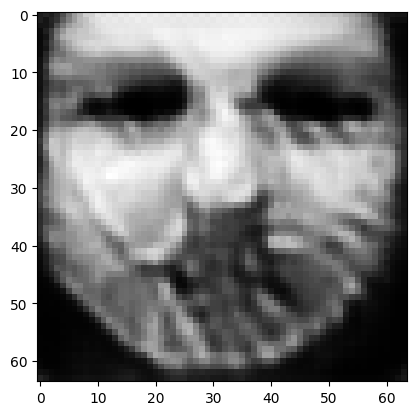

tensor([[5.2309e-04, 2.1579e-04, 3.2335e-03, 4.7924e-04, 9.4441e-01, 1.3967e-04,
         3.8420e-04, 4.8347e-04, 1.9408e-04, 1.0657e-05, 5.8148e-06, 2.4656e-05,
         2.3939e-03, 8.6788e-04, 8.8536e-05, 1.0967e-05, 1.2835e-03, 5.8735e-03,
         6.5604e-05, 2.1249e-04, 2.9407e-04, 7.9167e-05, 1.6152e-03, 3.3785e-05,
         1.7854e-02, 5.5338e-05, 4.2069e-04, 4.3503e-04, 4.5388e-05, 2.7972e-05,
         1.2483e-04, 4.3281e-04, 2.6214e-03, 5.5895e-04, 3.1702e-03, 1.1061e-03,
         1.4759e-03, 6.1723e-04, 7.7062e-03, 4.2730e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.057196520268917084
tensor([[5.2184e-04, 2.1525e-04, 3.2185e-03, 4.7738e-04, 9.4461e-01, 1.3909e-04,
         3.8296e-04, 4.8218e-04, 1.9340e-04, 1.0619e-05, 5.7848e-06, 2.4553e-05,
         2.3856e-03, 8.6354e-04, 8.8192e-05, 1.0914e-05, 1.2791e-03, 5.8550e-03,
         6.5397e-05, 2.1192e-04, 2.9272e-04, 7.8899e-05, 1.6086e-03, 3.3698e-05,
         1.7789e-02, 5.5135e-05, 4.1916e-

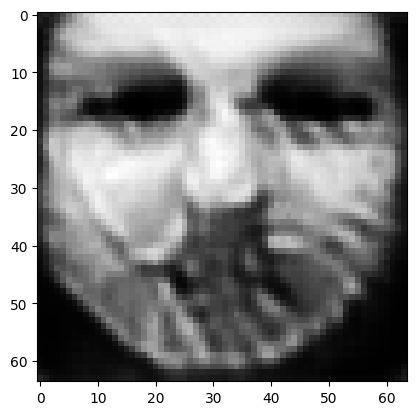

tensor([[5.1481e-04, 2.1378e-04, 3.1567e-03, 4.7107e-04, 9.4541e-01, 1.3618e-04,
         3.7550e-04, 4.7472e-04, 1.9051e-04, 1.0439e-05, 5.6360e-06, 2.4011e-05,
         2.3603e-03, 8.4902e-04, 8.6424e-05, 1.0677e-05, 1.2607e-03, 5.7444e-03,
         6.4540e-05, 2.0906e-04, 2.8684e-04, 7.7868e-05, 1.5909e-03, 3.3235e-05,
         1.7571e-02, 5.4616e-05, 4.1151e-04, 4.2564e-04, 4.3886e-05, 2.7370e-05,
         1.2347e-04, 4.2367e-04, 2.5711e-03, 5.4397e-04, 3.1239e-03, 1.0897e-03,
         1.4351e-03, 6.0530e-04, 7.5808e-03, 4.1605e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056141629815101624
tensor([[5.1269e-04, 2.1336e-04, 3.1399e-03, 4.6958e-04, 9.4561e-01, 1.3535e-04,
         3.7323e-04, 4.7266e-04, 1.8959e-04, 1.0379e-05, 5.5964e-06, 2.3851e-05,
         2.3526e-03, 8.4533e-04, 8.5932e-05, 1.0613e-05, 1.2574e-03, 5.7107e-03,
         6.4343e-05, 2.0829e-04, 2.8527e-04, 7.7592e-05, 1.5878e-03, 3.3138e-05,
         1.7527e-02, 5.4520e-05, 4.0890e-

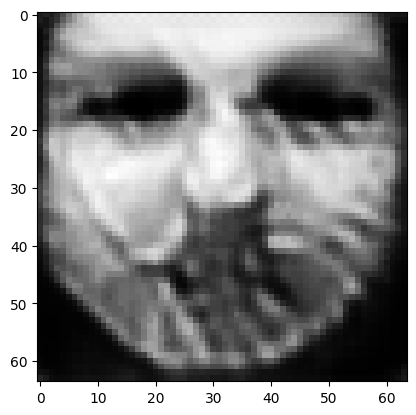

tensor([[5.0423e-04, 2.1195e-04, 3.0751e-03, 4.6364e-04, 9.4643e-01, 1.3250e-04,
         3.6501e-04, 4.6512e-04, 1.8654e-04, 1.0188e-05, 5.4459e-06, 2.3280e-05,
         2.3235e-03, 8.3034e-04, 8.3840e-05, 1.0366e-05, 1.2415e-03, 5.5842e-03,
         6.3497e-05, 2.0508e-04, 2.7916e-04, 7.6493e-05, 1.5725e-03, 3.2684e-05,
         1.7331e-02, 5.4184e-05, 3.9972e-04, 4.1633e-04, 4.2339e-05, 2.6746e-05,
         1.2218e-04, 4.1327e-04, 2.5088e-03, 5.2780e-04, 3.0777e-03, 1.0728e-03,
         1.3963e-03, 5.9301e-04, 7.4353e-03, 4.0438e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05505651980638504
tensor([[5.0268e-04, 2.1163e-04, 3.0639e-03, 4.6235e-04, 9.4664e-01, 1.3206e-04,
         3.6355e-04, 4.6403e-04, 1.8595e-04, 1.0158e-05, 5.4110e-06, 2.3129e-05,
         2.3160e-03, 8.2542e-04, 8.3244e-05, 1.0306e-05, 1.2365e-03, 5.5573e-03,
         6.3258e-05, 2.0453e-04, 2.7734e-04, 7.6174e-05, 1.5634e-03, 3.2555e-05,
         1.7272e-02, 5.4035e-05, 3.9791e-0

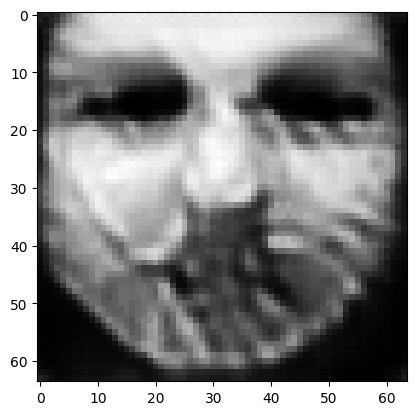

tensor([[4.9736e-04, 2.1045e-04, 3.0144e-03, 4.5749e-04, 9.4741e-01, 1.3022e-04,
         3.5790e-04, 4.5982e-04, 1.8330e-04, 1.0037e-05, 5.2813e-06, 2.2575e-05,
         2.2848e-03, 8.0911e-04, 8.1270e-05, 1.0096e-05, 1.2186e-03, 5.4670e-03,
         6.2398e-05, 2.0197e-04, 2.7104e-04, 7.4931e-05, 1.5316e-03, 3.2130e-05,
         1.7071e-02, 5.3463e-05, 3.9083e-04, 4.1018e-04, 4.1181e-05, 2.6194e-05,
         1.2037e-04, 4.0123e-04, 2.4436e-03, 5.1344e-04, 3.0273e-03, 1.0493e-03,
         1.3488e-03, 5.8066e-04, 7.3278e-03, 3.9536e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.054028283804655075
tensor([[4.9527e-04, 2.1018e-04, 2.9979e-03, 4.5634e-04, 9.4759e-01, 1.2944e-04,
         3.5563e-04, 4.5765e-04, 1.8240e-04, 9.9779e-06, 5.2443e-06, 2.2447e-05,
         2.2763e-03, 8.0714e-04, 8.0874e-05, 1.0044e-05, 1.2159e-03, 5.4389e-03,
         6.2219e-05, 2.0094e-04, 2.6984e-04, 7.4694e-05, 1.5307e-03, 3.2045e-05,
         1.7035e-02, 5.3427e-05, 3.8836e-

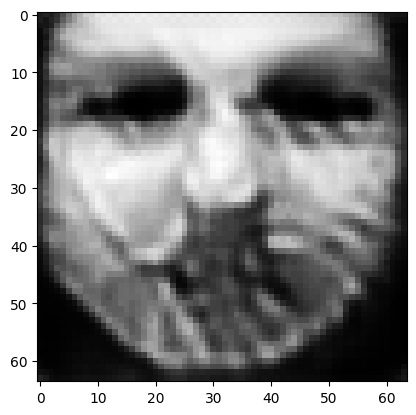

tensor([[4.8998e-04, 2.0897e-04, 2.9550e-03, 4.5190e-04, 9.4831e-01, 1.2774e-04,
         3.5059e-04, 4.5392e-04, 1.7969e-04, 9.8626e-06, 5.1253e-06, 2.1932e-05,
         2.2452e-03, 7.9312e-04, 7.9055e-05, 9.8502e-06, 1.2002e-03, 5.3522e-03,
         6.1407e-05, 1.9821e-04, 2.6401e-04, 7.3489e-05, 1.5009e-03, 3.1648e-05,
         1.6851e-02, 5.2878e-05, 3.8155e-04, 4.0427e-04, 4.0060e-05, 2.5714e-05,
         1.1845e-04, 3.9069e-04, 2.3821e-03, 5.0060e-04, 2.9784e-03, 1.0307e-03,
         1.3122e-03, 5.7011e-04, 7.1989e-03, 3.8686e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05307213217020035
tensor([[4.8821e-04, 2.0873e-04, 2.9412e-03, 4.5086e-04, 9.4849e-01, 1.2709e-04,
         3.4877e-04, 4.5223e-04, 1.7892e-04, 9.8201e-06, 5.0894e-06, 2.1798e-05,
         2.2373e-03, 7.9058e-04, 7.8607e-05, 9.7985e-06, 1.1962e-03, 5.3258e-03,
         6.1184e-05, 1.9725e-04, 2.6267e-04, 7.3217e-05, 1.4968e-03, 3.1532e-05,
         1.6812e-02, 5.2798e-05, 3.7958e-0

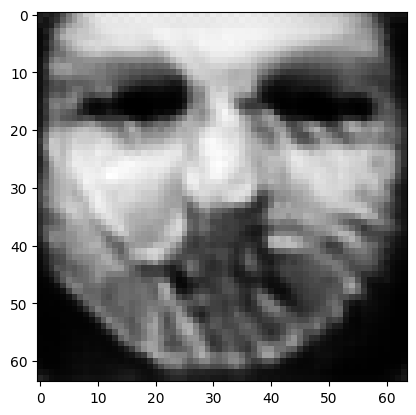

tensor([[4.8323e-04, 2.0752e-04, 2.8991e-03, 4.4642e-04, 9.4918e-01, 1.2534e-04,
         3.4365e-04, 4.4868e-04, 1.7631e-04, 9.7020e-06, 4.9776e-06, 2.1328e-05,
         2.2063e-03, 7.7796e-04, 7.6966e-05, 9.6194e-06, 1.1818e-03, 5.2439e-03,
         6.0398e-05, 1.9455e-04, 2.5735e-04, 7.2115e-05, 1.4708e-03, 3.1165e-05,
         1.6638e-02, 5.2324e-05, 3.7304e-04, 3.9877e-04, 3.8995e-05, 2.5260e-05,
         1.1659e-04, 3.8040e-04, 2.3259e-03, 4.8878e-04, 2.9288e-03, 1.0124e-03,
         1.2765e-03, 5.6032e-04, 7.0783e-03, 3.7912e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05215930938720703
tensor([[4.8164e-04, 2.0732e-04, 2.8864e-03, 4.4549e-04, 9.4934e-01, 1.2473e-04,
         3.4196e-04, 4.4705e-04, 1.7563e-04, 9.6622e-06, 4.9453e-06, 2.1212e-05,
         2.1987e-03, 7.7585e-04, 7.6578e-05, 9.5740e-06, 1.1781e-03, 5.2197e-03,
         6.0197e-05, 1.9367e-04, 2.5619e-04, 7.1881e-05, 1.4678e-03, 3.1062e-05,
         1.6603e-02, 5.2262e-05, 3.7129e-0

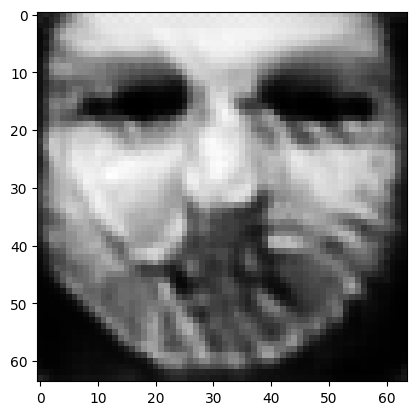

tensor([[4.7701e-04, 2.0610e-04, 2.8458e-03, 4.4155e-04, 9.4999e-01, 1.2310e-04,
         3.3700e-04, 4.4332e-04, 1.7327e-04, 9.5568e-06, 4.8365e-06, 2.0759e-05,
         2.1665e-03, 7.6374e-04, 7.4908e-05, 9.4100e-06, 1.1630e-03, 5.1407e-03,
         5.9369e-05, 1.9111e-04, 2.5107e-04, 7.0834e-05, 1.4394e-03, 3.0691e-05,
         1.6444e-02, 5.1787e-05, 3.6517e-04, 3.9346e-04, 3.8034e-05, 2.4868e-05,
         1.1463e-04, 3.7076e-04, 2.2711e-03, 4.7750e-04, 2.8837e-03, 9.9503e-04,
         1.2433e-03, 5.5197e-04, 6.9687e-03, 3.7227e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05130307003855705
tensor([[4.7576e-04, 2.0574e-04, 2.8362e-03, 4.4055e-04, 9.5015e-01, 1.2272e-04,
         3.3578e-04, 4.4239e-04, 1.7274e-04, 9.5321e-06, 4.8098e-06, 2.0647e-05,
         2.1584e-03, 7.6035e-04, 7.4437e-05, 9.3676e-06, 1.1590e-03, 5.1188e-03,
         5.9136e-05, 1.9050e-04, 2.4976e-04, 7.0567e-05, 1.4316e-03, 3.0585e-05,
         1.6406e-02, 5.1661e-05, 3.6367e-0

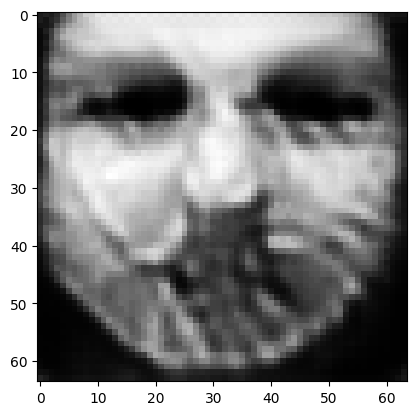

tensor([[4.7086e-04, 2.0443e-04, 2.7974e-03, 4.3695e-04, 9.5075e-01, 1.2108e-04,
         3.3057e-04, 4.3852e-04, 1.7053e-04, 9.4174e-06, 4.7066e-06, 2.0207e-05,
         2.1268e-03, 7.4897e-04, 7.2759e-05, 9.2081e-06, 1.1453e-03, 5.0371e-03,
         5.8280e-05, 1.8798e-04, 2.4490e-04, 6.9572e-05, 1.4057e-03, 3.0202e-05,
         1.6273e-02, 5.1222e-05, 3.5745e-04, 3.8851e-04, 3.7160e-05, 2.4513e-05,
         1.1258e-04, 3.6136e-04, 2.2172e-03, 4.6698e-04, 2.8398e-03, 9.7669e-04,
         1.2112e-03, 5.4445e-04, 6.8775e-03, 3.6635e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05050129443407059
tensor([[4.7027e-04, 2.0416e-04, 2.7906e-03, 4.3616e-04, 9.5089e-01, 1.2091e-04,
         3.3001e-04, 4.3806e-04, 1.7023e-04, 9.4103e-06, 4.6851e-06, 2.0116e-05,
         2.1198e-03, 7.4528e-04, 7.2359e-05, 9.1743e-06, 1.1403e-03, 5.0235e-03,
         5.8041e-05, 1.8767e-04, 2.4365e-04, 6.9324e-05, 1.3953e-03, 3.0088e-05,
         1.6234e-02, 5.1031e-05, 3.5672e-0

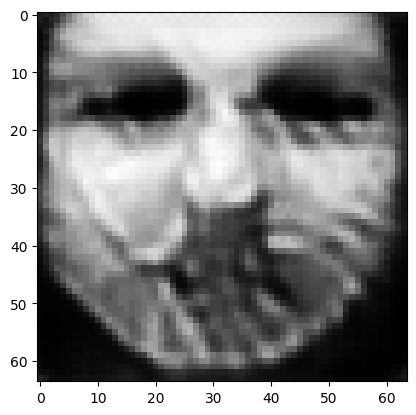

tensor([[4.6642e-04, 2.0308e-04, 2.7564e-03, 4.3306e-04, 9.5141e-01, 1.1958e-04,
         3.2591e-04, 4.3458e-04, 1.6852e-04, 9.3217e-06, 4.5963e-06, 1.9768e-05,
         2.0908e-03, 7.3522e-04, 7.0973e-05, 9.0400e-06, 1.1261e-03, 4.9590e-03,
         5.7234e-05, 1.8555e-04, 2.3952e-04, 6.8447e-05, 1.3706e-03, 2.9715e-05,
         1.6117e-02, 5.0548e-05, 3.5194e-04, 3.8419e-04, 3.6459e-05, 2.4215e-05,
         1.1063e-04, 3.5322e-04, 2.1736e-03, 4.5849e-04, 2.8023e-03, 9.6042e-04,
         1.1799e-03, 5.3805e-04, 6.8070e-03, 3.6199e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04981377348303795
tensor([[4.6514e-04, 2.0287e-04, 2.7464e-03, 4.3234e-04, 9.5152e-01, 1.1909e-04,
         3.2457e-04, 4.3346e-04, 1.6803e-04, 9.2884e-06, 4.5746e-06, 1.9687e-05,
         2.0841e-03, 7.3396e-04, 7.0699e-05, 9.0062e-06, 1.1240e-03, 4.9418e-03,
         5.7072e-05, 1.8490e-04, 2.3875e-04, 6.8265e-05, 1.3685e-03, 2.9644e-05,
         1.6095e-02, 5.0499e-05, 3.5044e-0

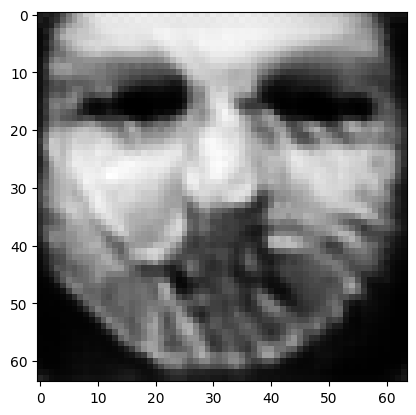

tensor([[4.6177e-04, 2.0190e-04, 2.7119e-03, 4.2945e-04, 9.5198e-01, 1.1785e-04,
         3.2101e-04, 4.3032e-04, 1.6672e-04, 9.2094e-06, 4.4963e-06, 1.9412e-05,
         2.0568e-03, 7.2528e-04, 6.9577e-05, 8.8918e-06, 1.1106e-03, 4.8863e-03,
         5.6341e-05, 1.8301e-04, 2.3515e-04, 6.7525e-05, 1.3479e-03, 2.9309e-05,
         1.5993e-02, 5.0077e-05, 3.4638e-04, 3.7984e-04, 3.5744e-05, 2.3959e-05,
         1.0900e-04, 3.4657e-04, 2.1365e-03, 4.5063e-04, 2.7700e-03, 9.4986e-04,
         1.1551e-03, 5.3259e-04, 6.7299e-03, 3.5733e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.049208737909793854
tensor([[4.6111e-04, 2.0165e-04, 2.7037e-03, 4.2875e-04, 9.5210e-01, 1.1761e-04,
         3.2027e-04, 4.2959e-04, 1.6645e-04, 9.1942e-06, 4.4779e-06, 1.9350e-05,
         2.0497e-03, 7.2295e-04, 6.9305e-05, 8.8667e-06, 1.1070e-03, 4.8738e-03,
         5.6155e-05, 1.8261e-04, 2.3422e-04, 6.7343e-05, 1.3417e-03, 2.9227e-05,
         1.5967e-02, 4.9957e-05, 3.4558e-

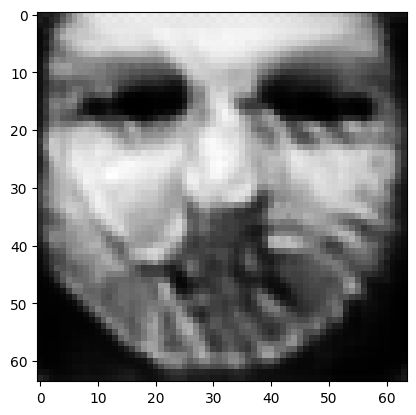

tensor([[4.5728e-04, 2.0056e-04, 2.6699e-03, 4.2599e-04, 9.5254e-01, 1.1628e-04,
         3.1620e-04, 4.2539e-04, 1.6507e-04, 9.1037e-06, 4.3979e-06, 1.9080e-05,
         2.0225e-03, 7.1531e-04, 6.8119e-05, 8.7511e-06, 1.0944e-03, 4.8104e-03,
         5.5405e-05, 1.8057e-04, 2.3082e-04, 6.6661e-05, 1.3231e-03, 2.8874e-05,
         1.5876e-02, 4.9582e-05, 3.4141e-04, 3.7529e-04, 3.5055e-05, 2.3705e-05,
         1.0727e-04, 3.4051e-04, 2.1004e-03, 4.4302e-04, 2.7419e-03, 9.3936e-04,
         1.1316e-03, 5.2792e-04, 6.6585e-03, 3.5300e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04862184822559357
tensor([[4.5637e-04, 2.0031e-04, 2.6618e-03, 4.2533e-04, 9.5265e-01, 1.1597e-04,
         3.1525e-04, 4.2440e-04, 1.6474e-04, 9.0821e-06, 4.3794e-06, 1.9017e-05,
         2.0159e-03, 7.1362e-04, 6.7853e-05, 8.7231e-06, 1.0913e-03, 4.7962e-03,
         5.5234e-05, 1.8004e-04, 2.3006e-04, 6.6498e-05, 1.3189e-03, 2.8794e-05,
         1.5852e-02, 4.9488e-05, 3.4045e-0

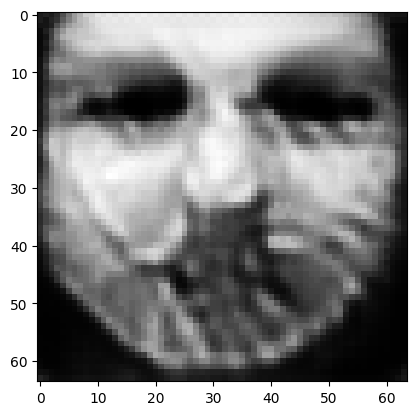

tensor([[4.5341e-04, 1.9933e-04, 2.6335e-03, 4.2310e-04, 9.5309e-01, 1.1495e-04,
         3.1193e-04, 4.2104e-04, 1.6358e-04, 9.0158e-06, 4.3067e-06, 1.8751e-05,
         1.9883e-03, 7.0594e-04, 6.6697e-05, 8.6182e-06, 1.0781e-03, 4.7436e-03,
         5.4535e-05, 1.7813e-04, 2.2679e-04, 6.5853e-05, 1.2962e-03, 2.8465e-05,
         1.5743e-02, 4.9026e-05, 3.3729e-04, 3.7143e-04, 3.4460e-05, 2.3455e-05,
         1.0558e-04, 3.3436e-04, 2.0640e-03, 4.3583e-04, 2.7139e-03, 9.2766e-04,
         1.1080e-03, 5.2357e-04, 6.5921e-03, 3.4893e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04804302006959915
tensor([[4.5228e-04, 1.9911e-04, 2.6251e-03, 4.2250e-04, 9.5320e-01, 1.1453e-04,
         3.1069e-04, 4.1994e-04, 1.6317e-04, 8.9862e-06, 4.2868e-06, 1.8681e-05,
         1.9817e-03, 7.0487e-04, 6.6434e-05, 8.5894e-06, 1.0760e-03, 4.7276e-03,
         5.4382e-05, 1.7750e-04, 2.2610e-04, 6.5707e-05, 1.2939e-03, 2.8397e-05,
         1.5725e-02, 4.8970e-05, 3.3604e-0

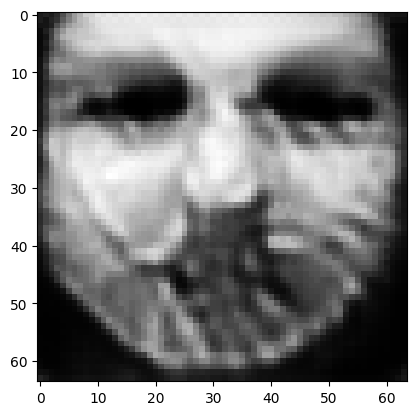

tensor([[4.4936e-04, 1.9814e-04, 2.5957e-03, 4.2007e-04, 9.5361e-01, 1.1348e-04,
         3.0741e-04, 4.1685e-04, 1.6206e-04, 8.9200e-06, 4.2208e-06, 1.8452e-05,
         1.9558e-03, 6.9774e-04, 6.5415e-05, 8.4914e-06, 1.0640e-03, 4.6767e-03,
         5.3739e-05, 1.7573e-04, 2.2314e-04, 6.5103e-05, 1.2746e-03, 2.8111e-05,
         1.5628e-02, 4.8579e-05, 3.3286e-04, 3.6771e-04, 3.3839e-05, 2.3217e-05,
         1.0413e-04, 3.2871e-04, 2.0307e-03, 4.2900e-04, 2.6858e-03, 9.1790e-04,
         1.0873e-03, 5.1927e-04, 6.5233e-03, 3.4461e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04749898612499237
tensor([[4.4884e-04, 1.9792e-04, 2.5887e-03, 4.1947e-04, 9.5371e-01, 1.1328e-04,
         3.0679e-04, 4.1623e-04, 1.6185e-04, 8.9092e-06, 4.2064e-06, 1.8404e-05,
         1.9497e-03, 6.9581e-04, 6.5193e-05, 8.4707e-06, 1.0609e-03, 4.6665e-03,
         5.3587e-05, 1.7539e-04, 2.2243e-04, 6.4961e-05, 1.2693e-03, 2.8048e-05,
         1.5602e-02, 4.8472e-05, 3.3231e-0

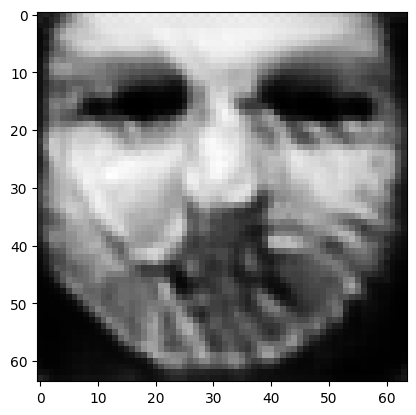

tensor([[4.4649e-04, 1.9697e-04, 2.5640e-03, 4.1719e-04, 9.5409e-01, 1.1240e-04,
         3.0416e-04, 4.1398e-04, 1.6087e-04, 8.8562e-06, 4.1504e-06, 1.8200e-05,
         1.9268e-03, 6.8874e-04, 6.4303e-05, 8.3828e-06, 1.0501e-03, 4.6246e-03,
         5.3029e-05, 1.7395e-04, 2.1968e-04, 6.4402e-05, 1.2501e-03, 2.7804e-05,
         1.5504e-02, 4.8081e-05, 3.2955e-04, 3.6465e-04, 3.3331e-05, 2.3000e-05,
         1.0278e-04, 3.2356e-04, 2.0008e-03, 4.2305e-04, 2.6580e-03, 9.0820e-04,
         1.0662e-03, 5.1501e-04, 6.4708e-03, 3.4088e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046998899430036545
tensor([[4.4621e-04, 1.9676e-04, 2.5592e-03, 4.1676e-04, 9.5418e-01, 1.1227e-04,
         3.0374e-04, 4.1360e-04, 1.6068e-04, 8.8499e-06, 4.1381e-06, 1.8155e-05,
         1.9209e-03, 6.8688e-04, 6.4103e-05, 8.3646e-06, 1.0471e-03, 4.6173e-03,
         5.2890e-05, 1.7366e-04, 2.1902e-04, 6.4265e-05, 1.2440e-03, 2.7745e-05,
         1.5479e-02, 4.7954e-05, 3.2912e-

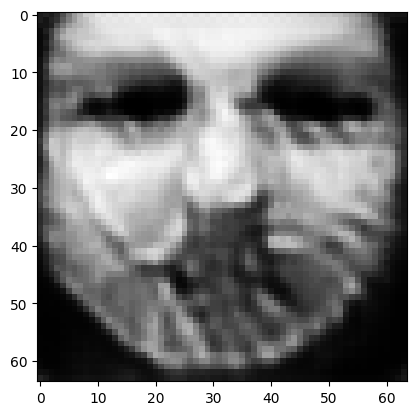

tensor([[4.4364e-04, 1.9593e-04, 2.5341e-03, 4.1450e-04, 9.5452e-01, 1.1124e-04,
         3.0088e-04, 4.1101e-04, 1.5970e-04, 8.7849e-06, 4.0853e-06, 1.7976e-05,
         1.9009e-03, 6.8171e-04, 6.3390e-05, 8.2835e-06, 1.0383e-03, 4.5780e-03,
         5.2408e-05, 1.7217e-04, 2.1673e-04, 6.3790e-05, 1.2308e-03, 2.7540e-05,
         1.5393e-02, 4.7666e-05, 3.2625e-04, 3.6175e-04, 3.2842e-05, 2.2808e-05,
         1.0161e-04, 3.1914e-04, 1.9742e-03, 4.1764e-04, 2.6336e-03, 9.0036e-04,
         1.0489e-03, 5.1113e-04, 6.4175e-03, 3.3716e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04654783383011818
tensor([[4.4335e-04, 1.9572e-04, 2.5295e-03, 4.1409e-04, 9.5460e-01, 1.1113e-04,
         3.0052e-04, 4.1066e-04, 1.5955e-04, 8.7825e-06, 4.0735e-06, 1.7931e-05,
         1.8961e-03, 6.7977e-04, 6.3172e-05, 8.2652e-06, 1.0351e-03, 4.5703e-03,
         5.2268e-05, 1.7189e-04, 2.1606e-04, 6.3649e-05, 1.2247e-03, 2.7470e-05,
         1.5368e-02, 4.7546e-05, 3.2592e-0

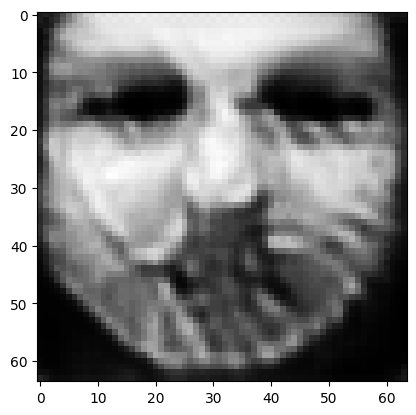

tensor([[4.4136e-04, 1.9492e-04, 2.5078e-03, 4.1202e-04, 9.5492e-01, 1.1034e-04,
         2.9825e-04, 4.0866e-04, 1.5875e-04, 8.7383e-06, 4.0265e-06, 1.7766e-05,
         1.8771e-03, 6.7399e-04, 6.2470e-05, 8.1922e-06, 1.0258e-03, 4.5349e-03,
         5.1794e-05, 1.7066e-04, 2.1377e-04, 6.3189e-05, 1.2088e-03, 2.7267e-05,
         1.5285e-02, 4.7223e-05, 3.2359e-04, 3.5926e-04, 3.2428e-05, 2.2628e-05,
         1.0047e-04, 3.1466e-04, 1.9490e-03, 4.1276e-04, 2.6099e-03, 8.9157e-04,
         1.0303e-03, 5.0734e-04, 6.3759e-03, 3.3405e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04612388461828232
tensor([[4.4106e-04, 1.9471e-04, 2.5028e-03, 4.1159e-04, 9.5500e-01, 1.1020e-04,
         2.9782e-04, 4.0828e-04, 1.5857e-04, 8.7328e-06, 4.0151e-06, 1.7726e-05,
         1.8718e-03, 6.7231e-04, 6.2283e-05, 8.1758e-06, 1.0230e-03, 4.5273e-03,
         5.1662e-05, 1.7037e-04, 2.1316e-04, 6.3062e-05, 1.2036e-03, 2.7209e-05,
         1.5265e-02, 4.7117e-05, 3.2319e-0

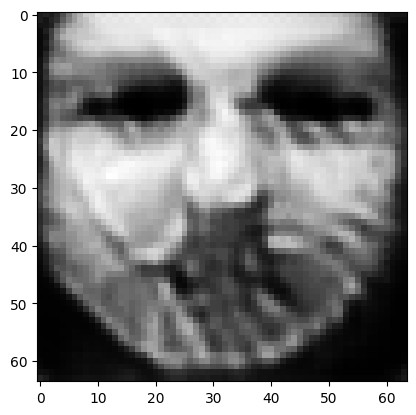

tensor([[4.3925e-04, 1.9389e-04, 2.4817e-03, 4.0952e-04, 9.5531e-01, 1.0945e-04,
         2.9563e-04, 4.0657e-04, 1.5779e-04, 8.6908e-06, 3.9698e-06, 1.7564e-05,
         1.8524e-03, 6.6650e-04, 6.1605e-05, 8.1054e-06, 1.0138e-03, 4.4930e-03,
         5.1197e-05, 1.6917e-04, 2.1081e-04, 6.2606e-05, 1.1874e-03, 2.7011e-05,
         1.5186e-02, 4.6793e-05, 3.2091e-04, 3.5686e-04, 3.2024e-05, 2.2449e-05,
         9.9318e-05, 3.1045e-04, 1.9245e-03, 4.0810e-04, 2.5861e-03, 8.8314e-04,
         1.0125e-03, 5.0366e-04, 6.3345e-03, 3.3095e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04571570083498955
tensor([[4.3846e-04, 1.9371e-04, 2.4747e-03, 4.0887e-04, 9.5539e-01, 1.0912e-04,
         2.9477e-04, 4.0593e-04, 1.5750e-04, 8.6680e-06, 3.9578e-06, 1.7524e-05,
         1.8481e-03, 6.6574e-04, 6.1483e-05, 8.0869e-06, 1.0127e-03, 4.4826e-03,
         5.1111e-05, 1.6880e-04, 2.1035e-04, 6.2516e-05, 1.1863e-03, 2.6982e-05,
         1.5169e-02, 4.6771e-05, 3.1997e-0

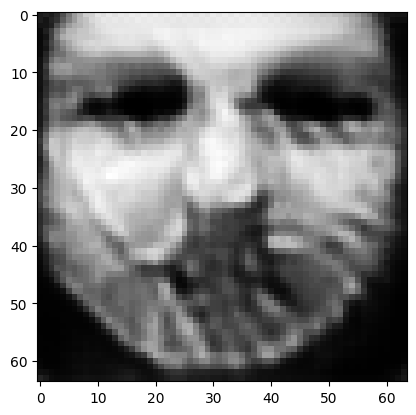

tensor([[4.3671e-04, 1.9296e-04, 2.4539e-03, 4.0696e-04, 9.5569e-01, 1.0840e-04,
         2.9262e-04, 4.0416e-04, 1.5672e-04, 8.6282e-06, 3.9135e-06, 1.7365e-05,
         1.8298e-03, 6.6013e-04, 6.0814e-05, 8.0190e-06, 1.0037e-03, 4.4473e-03,
         5.0656e-05, 1.6766e-04, 2.0806e-04, 6.2089e-05, 1.1709e-03, 2.6785e-05,
         1.5097e-02, 4.6468e-05, 3.1774e-04, 3.5426e-04, 3.1592e-05, 2.2276e-05,
         9.8343e-05, 3.0669e-04, 1.9020e-03, 4.0352e-04, 2.5636e-03, 8.7614e-04,
         9.9712e-04, 5.0016e-04, 6.2908e-03, 3.2761e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04532546550035477
tensor([[4.3638e-04, 1.9277e-04, 2.4497e-03, 4.0656e-04, 9.5576e-01, 1.0826e-04,
         2.9219e-04, 4.0383e-04, 1.5656e-04, 8.6222e-06, 3.9033e-06, 1.7326e-05,
         1.8255e-03, 6.5861e-04, 6.0640e-05, 8.0029e-06, 1.0013e-03, 4.4393e-03,
         5.0544e-05, 1.6742e-04, 2.0749e-04, 6.1986e-05, 1.1664e-03, 2.6734e-05,
         1.5079e-02, 4.6384e-05, 3.1729e-0

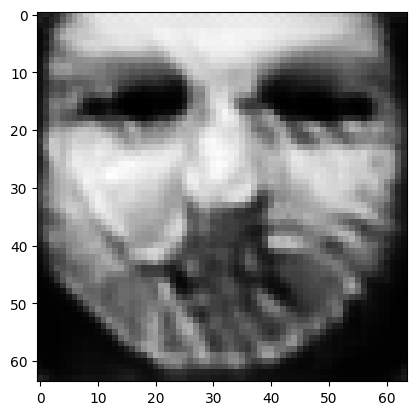

tensor([[4.3471e-04, 1.9211e-04, 2.4298e-03, 4.0480e-04, 9.5603e-01, 1.0757e-04,
         2.9014e-04, 4.0218e-04, 1.5581e-04, 8.5823e-06, 3.8630e-06, 1.7186e-05,
         1.8087e-03, 6.5380e-04, 6.0053e-05, 7.9425e-06, 9.9354e-04, 4.4070e-03,
         5.0141e-05, 1.6634e-04, 2.0546e-04, 6.1596e-05, 1.1533e-03, 2.6568e-05,
         1.5015e-02, 4.6135e-05, 3.1516e-04, 3.5204e-04, 3.1220e-05, 2.2123e-05,
         9.7386e-05, 3.0303e-04, 1.8806e-03, 3.9938e-04, 2.5430e-03, 8.6897e-04,
         9.8202e-04, 4.9691e-04, 6.2537e-03, 3.2479e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04496835544705391
tensor([[4.3432e-04, 1.9196e-04, 2.4247e-03, 4.0430e-04, 9.5609e-01, 1.0741e-04,
         2.8968e-04, 4.0182e-04, 1.5565e-04, 8.5728e-06, 3.8540e-06, 1.7155e-05,
         1.8048e-03, 6.5266e-04, 5.9935e-05, 7.9292e-06, 9.9176e-04, 4.4002e-03,
         5.0053e-05, 1.6612e-04, 2.0498e-04, 6.1508e-05, 1.1503e-03, 2.6535e-05,
         1.4997e-02, 4.6079e-05, 3.1470e-0

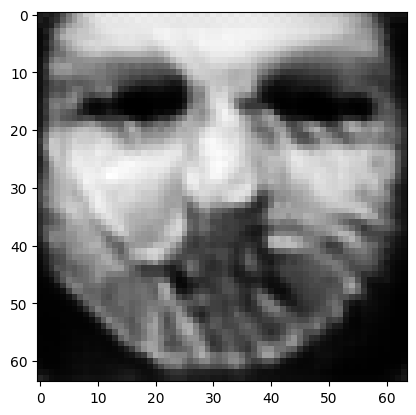

tensor([[4.3361e-04, 1.9120e-04, 2.4073e-03, 4.0250e-04, 9.5640e-01, 1.0716e-04,
         2.8870e-04, 4.0208e-04, 1.5494e-04, 8.5771e-06, 3.8232e-06, 1.6977e-05,
         1.7880e-03, 6.4506e-04, 5.9248e-05, 7.8717e-06, 9.8288e-04, 4.3747e-03,
         4.9636e-05, 1.6568e-04, 2.0239e-04, 6.0983e-05, 1.1255e-03, 2.6372e-05,
         1.4904e-02, 4.5751e-05, 3.1290e-04, 3.5088e-04, 3.0943e-05, 2.1989e-05,
         9.6354e-05, 2.9867e-04, 1.8570e-03, 3.9564e-04, 2.5161e-03, 8.5923e-04,
         9.6277e-04, 4.9303e-04, 6.2310e-03, 3.2217e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04458295553922653
tensor([[4.3320e-04, 1.9100e-04, 2.4024e-03, 4.0198e-04, 9.5647e-01, 1.0704e-04,
         2.8831e-04, 4.0197e-04, 1.5473e-04, 8.5704e-06, 3.8155e-06, 1.6934e-05,
         1.7842e-03, 6.4344e-04, 5.9090e-05, 7.8563e-06, 9.8124e-04, 4.3677e-03,
         4.9546e-05, 1.6553e-04, 2.0180e-04, 6.0858e-05, 1.1208e-03, 2.6338e-05,
         1.4881e-02, 4.5693e-05, 3.1223e-0

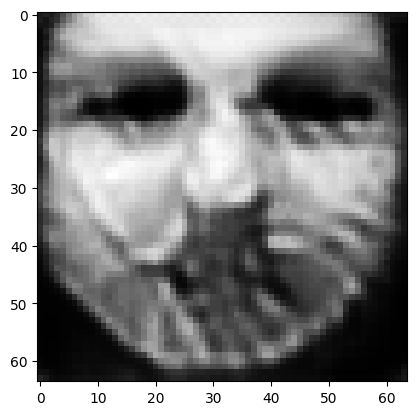

tensor([[4.3201e-04, 1.9015e-04, 2.3832e-03, 4.0012e-04, 9.5677e-01, 1.0668e-04,
         2.8710e-04, 4.0165e-04, 1.5401e-04, 8.5551e-06, 3.7855e-06, 1.6766e-05,
         1.7675e-03, 6.3669e-04, 5.8455e-05, 7.7996e-06, 9.7351e-04, 4.3440e-03,
         4.9155e-05, 1.6493e-04, 1.9937e-04, 6.0322e-05, 1.0994e-03, 2.6192e-05,
         1.4787e-02, 4.5388e-05, 3.1004e-04, 3.4982e-04, 3.0635e-05, 2.1864e-05,
         9.5354e-05, 2.9434e-04, 1.8324e-03, 3.9201e-04, 2.4892e-03, 8.5016e-04,
         9.4479e-04, 4.8905e-04, 6.2055e-03, 3.1930e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04419056698679924
tensor([[4.3181e-04, 1.8995e-04, 2.3794e-03, 3.9977e-04, 9.5684e-01, 1.0663e-04,
         2.8691e-04, 4.0168e-04, 1.5385e-04, 8.5554e-06, 3.7787e-06, 1.6723e-05,
         1.7636e-03, 6.3499e-04, 5.8291e-05, 7.7859e-06, 9.7145e-04, 4.3389e-03,
         4.9058e-05, 1.6480e-04, 1.9877e-04, 6.0182e-05, 1.0935e-03, 2.6152e-05,
         1.4764e-02, 4.5303e-05, 3.0959e-0

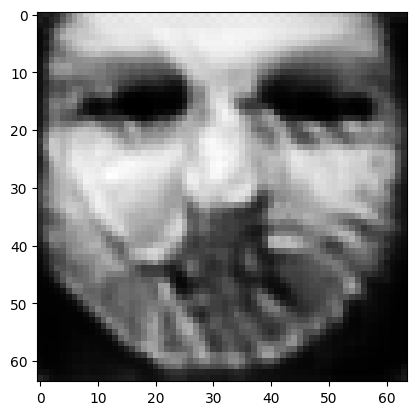

tensor([[4.3070e-04, 1.8912e-04, 2.3607e-03, 3.9788e-04, 9.5712e-01, 1.0632e-04,
         2.8589e-04, 4.0123e-04, 1.5321e-04, 8.5412e-06, 3.7515e-06, 1.6579e-05,
         1.7481e-03, 6.2877e-04, 5.7738e-05, 7.7338e-06, 9.6386e-04, 4.3179e-03,
         4.8684e-05, 1.6420e-04, 1.9659e-04, 5.9689e-05, 1.0743e-03, 2.6008e-05,
         1.4680e-02, 4.5017e-05, 3.0774e-04, 3.4881e-04, 3.0346e-05, 2.1747e-05,
         9.4367e-05, 2.9023e-04, 1.8097e-03, 3.8867e-04, 2.4640e-03, 8.4193e-04,
         9.2782e-04, 4.8524e-04, 6.1811e-03, 3.1680e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.043827690184116364
tensor([[4.3026e-04, 1.8889e-04, 2.3555e-03, 3.9738e-04, 9.5718e-01, 1.0617e-04,
         2.8542e-04, 4.0093e-04, 1.5301e-04, 8.5299e-06, 3.7433e-06, 1.6542e-05,
         1.7442e-03, 6.2750e-04, 5.7610e-05, 7.7196e-06, 9.6241e-04, 4.3110e-03,
         4.8593e-05, 1.6398e-04, 1.9608e-04, 5.9579e-05, 1.0709e-03, 2.5975e-05,
         1.4663e-02, 4.4968e-05, 3.0708e-

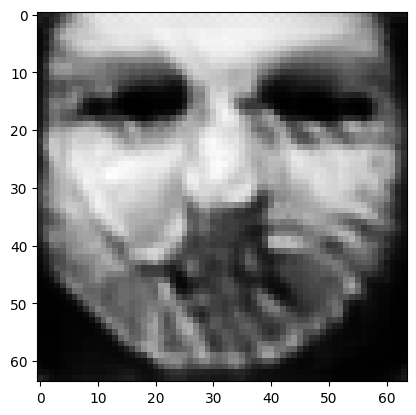

tensor([[4.2886e-04, 1.8805e-04, 2.3369e-03, 3.9565e-04, 9.5744e-01, 1.0575e-04,
         2.8411e-04, 4.0011e-04, 1.5238e-04, 8.5037e-06, 3.7139e-06, 1.6400e-05,
         1.7304e-03, 6.2206e-04, 5.7100e-05, 7.6659e-06, 9.5553e-04, 4.2869e-03,
         4.8225e-05, 1.6325e-04, 1.9411e-04, 5.9133e-05, 1.0553e-03, 2.5825e-05,
         1.4596e-02, 4.4733e-05, 3.0505e-04, 3.4735e-04, 3.0007e-05, 2.1613e-05,
         9.3486e-05, 2.8661e-04, 1.7883e-03, 3.8513e-04, 2.4423e-03, 8.3519e-04,
         9.1394e-04, 4.8159e-04, 6.1522e-03, 3.1401e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.043495383113622665
tensor([[4.2874e-04, 1.8785e-04, 2.3337e-03, 3.9536e-04, 9.5750e-01, 1.0575e-04,
         2.8406e-04, 4.0011e-04, 1.5230e-04, 8.5064e-06, 3.7080e-06, 1.6366e-05,
         1.7272e-03, 6.2038e-04, 5.6958e-05, 7.6539e-06, 9.5325e-04, 4.2828e-03,
         4.8128e-05, 1.6314e-04, 1.9359e-04, 5.9009e-05, 1.0498e-03, 2.5779e-05,
         1.4578e-02, 4.4647e-05, 3.0480e-

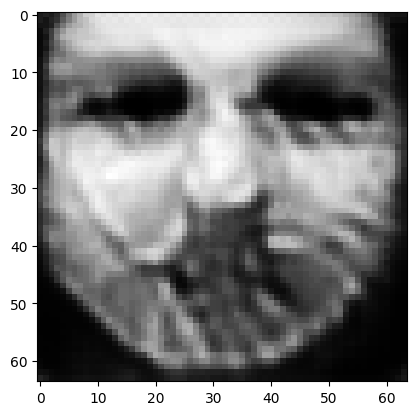

tensor([[4.2718e-04, 1.8710e-04, 2.3156e-03, 3.9376e-04, 9.5772e-01, 1.0527e-04,
         2.8257e-04, 3.9900e-04, 1.5168e-04, 8.4737e-06, 3.6798e-06, 1.6240e-05,
         1.7147e-03, 6.1587e-04, 5.6502e-05, 7.6036e-06, 9.4738e-04, 4.2583e-03,
         4.7795e-05, 1.6239e-04, 1.9188e-04, 5.8625e-05, 1.0376e-03, 2.5646e-05,
         1.4520e-02, 4.4468e-05, 3.0277e-04, 3.4604e-04, 2.9705e-05, 2.1494e-05,
         9.2661e-05, 2.8324e-04, 1.7684e-03, 3.8192e-04, 2.4236e-03, 8.2885e-04,
         9.0111e-04, 4.7821e-04, 6.1265e-03, 3.1163e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.043195389211177826
tensor([[4.2697e-04, 1.8691e-04, 2.3118e-03, 3.9336e-04, 9.5778e-01, 1.0523e-04,
         2.8243e-04, 3.9892e-04, 1.5160e-04, 8.4728e-06, 3.6742e-06, 1.6213e-05,
         1.7118e-03, 6.1443e-04, 5.6388e-05, 7.5928e-06, 9.4549e-04, 4.2540e-03,
         4.7712e-05, 1.6228e-04, 1.9142e-04, 5.8523e-05, 1.0334e-03, 2.5609e-05,
         1.4503e-02, 4.4402e-05, 3.0248e-

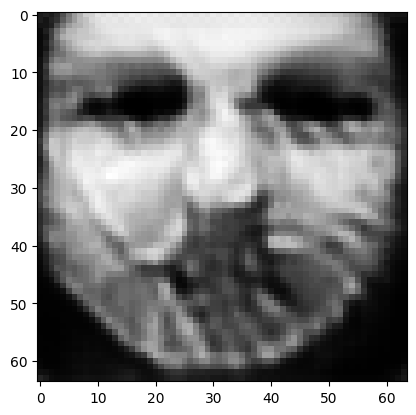

tensor([[4.2562e-04, 1.8621e-04, 2.2956e-03, 3.9184e-04, 9.5799e-01, 1.0486e-04,
         2.8119e-04, 3.9804e-04, 1.5109e-04, 8.4494e-06, 3.6486e-06, 1.6099e-05,
         1.7004e-03, 6.0987e-04, 5.5944e-05, 7.5459e-06, 9.3951e-04, 4.2313e-03,
         4.7394e-05, 1.6165e-04, 1.8977e-04, 5.8160e-05, 1.0209e-03, 2.5477e-05,
         1.4447e-02, 4.4220e-05, 3.0077e-04, 3.4476e-04, 2.9421e-05, 2.1378e-05,
         9.1906e-05, 2.8021e-04, 1.7506e-03, 3.7897e-04, 2.4058e-03, 8.2310e-04,
         8.8903e-04, 4.7504e-04, 6.1036e-03, 3.0947e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04291323572397232
tensor([[4.2514e-04, 1.8604e-04, 2.2909e-03, 3.9143e-04, 9.5805e-01, 1.0471e-04,
         2.8071e-04, 3.9766e-04, 1.5094e-04, 8.4380e-06, 3.6414e-06, 1.6072e-05,
         1.6976e-03, 6.0907e-04, 5.5846e-05, 7.5336e-06, 9.3842e-04, 4.2246e-03,
         4.7321e-05, 1.6144e-04, 1.8942e-04, 5.8084e-05, 1.0191e-03, 2.5449e-05,
         1.4436e-02, 4.4196e-05, 3.0022e-0

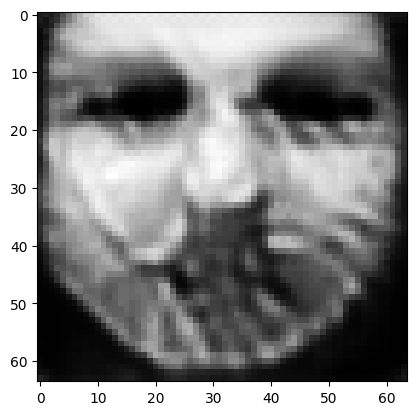

tensor([[4.2378e-04, 1.8538e-04, 2.2755e-03, 3.9006e-04, 9.5825e-01, 1.0432e-04,
         2.7938e-04, 3.9670e-04, 1.5044e-04, 8.4134e-06, 3.6157e-06, 1.5959e-05,
         1.6865e-03, 6.0501e-04, 5.5412e-05, 7.4880e-06, 9.3281e-04, 4.2020e-03,
         4.7013e-05, 1.6076e-04, 1.8785e-04, 5.7739e-05, 1.0076e-03, 2.5318e-05,
         1.4384e-02, 4.4027e-05, 2.9850e-04, 3.4339e-04, 2.9120e-05, 2.1264e-05,
         9.1221e-05, 2.7745e-04, 1.7337e-03, 3.7603e-04, 2.3897e-03, 8.1817e-04,
         8.7879e-04, 4.7224e-04, 6.0762e-03, 3.0721e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042646538466215134
tensor([[4.2351e-04, 1.8521e-04, 2.2719e-03, 3.8968e-04, 9.5830e-01, 1.0425e-04,
         2.7914e-04, 3.9652e-04, 1.5034e-04, 8.4091e-06, 3.6101e-06, 1.5935e-05,
         1.6839e-03, 6.0394e-04, 5.5313e-05, 7.4778e-06, 9.3134e-04, 4.1974e-03,
         4.6939e-05, 1.6063e-04, 1.8748e-04, 5.7658e-05, 1.0046e-03, 2.5286e-05,
         1.4370e-02, 4.3978e-05, 2.9816e-

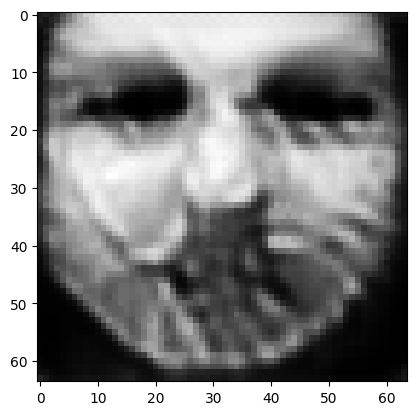

tensor([[4.2237e-04, 1.8457e-04, 2.2576e-03, 3.8835e-04, 9.5849e-01, 1.0391e-04,
         2.7799e-04, 3.9564e-04, 1.4992e-04, 8.3874e-06, 3.5875e-06, 1.5839e-05,
         1.6733e-03, 6.0011e-04, 5.4927e-05, 7.4380e-06, 9.2614e-04, 4.1781e-03,
         4.6655e-05, 1.6003e-04, 1.8607e-04, 5.7341e-05, 9.9403e-04, 2.5166e-05,
         1.4321e-02, 4.3807e-05, 2.9669e-04, 3.4217e-04, 2.8853e-05, 2.1159e-05,
         9.0542e-05, 2.7491e-04, 1.7182e-03, 3.7339e-04, 2.3743e-03, 8.1344e-04,
         8.6872e-04, 4.6961e-04, 6.0533e-03, 3.0528e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04239896684885025
tensor([[4.2196e-04, 1.8443e-04, 2.2539e-03, 3.8802e-04, 9.5853e-01, 1.0380e-04,
         2.7764e-04, 3.9533e-04, 1.4982e-04, 8.3802e-06, 3.5815e-06, 1.5815e-05,
         1.6713e-03, 5.9925e-04, 5.4822e-05, 7.4267e-06, 9.2496e-04, 4.1719e-03,
         4.6586e-05, 1.5987e-04, 1.8574e-04, 5.7270e-05, 9.9207e-04, 2.5133e-05,
         1.4311e-02, 4.3780e-05, 2.9628e-0

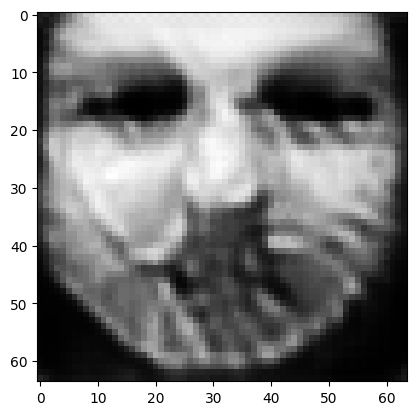

tensor([[4.2013e-04, 1.8389e-04, 2.2387e-03, 3.8683e-04, 9.5870e-01, 1.0325e-04,
         2.7592e-04, 3.9370e-04, 1.4932e-04, 8.3422e-06, 3.5554e-06, 1.5715e-05,
         1.6627e-03, 5.9654e-04, 5.4410e-05, 7.3808e-06, 9.2079e-04, 4.1452e-03,
         4.6313e-05, 1.5907e-04, 1.8454e-04, 5.6998e-05, 9.8605e-04, 2.5004e-05,
         1.4279e-02, 4.3696e-05, 2.9441e-04, 3.4064e-04, 2.8555e-05, 2.1055e-05,
         9.0044e-05, 2.7257e-04, 1.7044e-03, 3.7074e-04, 2.3615e-03, 8.0977e-04,
         8.6093e-04, 4.6735e-04, 6.0265e-03, 3.0338e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04217556118965149
tensor([[4.1970e-04, 1.8376e-04, 2.2348e-03, 3.8652e-04, 9.5874e-01, 1.0312e-04,
         2.7551e-04, 3.9327e-04, 1.4920e-04, 8.3327e-06, 3.5491e-06, 1.5693e-05,
         1.6604e-03, 5.9590e-04, 5.4317e-05, 7.3704e-06, 9.1976e-04, 4.1390e-03,
         4.6246e-05, 1.5888e-04, 1.8426e-04, 5.6935e-05, 9.8467e-04, 2.4974e-05,
         1.4271e-02, 4.3674e-05, 2.9398e-0

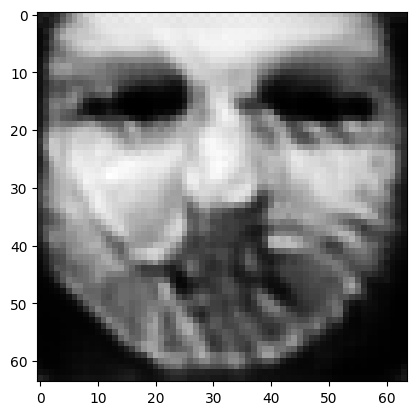

tensor([[4.1802e-04, 1.8323e-04, 2.2209e-03, 3.8542e-04, 9.5891e-01, 1.0263e-04,
         2.7393e-04, 3.9164e-04, 1.4872e-04, 8.2967e-06, 3.5246e-06, 1.5602e-05,
         1.6513e-03, 5.9323e-04, 5.3913e-05, 7.3294e-06, 9.1576e-04, 4.1148e-03,
         4.5988e-05, 1.5813e-04, 1.8313e-04, 5.6677e-05, 9.7846e-04, 2.4856e-05,
         1.4237e-02, 4.3570e-05, 2.9224e-04, 3.3907e-04, 2.8269e-05, 2.0958e-05,
         8.9522e-05, 2.7044e-04, 1.6912e-03, 3.6816e-04, 2.3495e-03, 8.0647e-04,
         8.5401e-04, 4.6534e-04, 5.9990e-03, 3.0157e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041959766298532486
tensor([[4.1764e-04, 1.8310e-04, 2.2176e-03, 3.8515e-04, 9.5895e-01, 1.0253e-04,
         2.7357e-04, 3.9129e-04, 1.4862e-04, 8.2887e-06, 3.5191e-06, 1.5582e-05,
         1.6492e-03, 5.9257e-04, 5.3821e-05, 7.3201e-06, 9.1483e-04, 4.1095e-03,
         4.5931e-05, 1.5797e-04, 1.8287e-04, 5.6619e-05, 9.7696e-04, 2.4831e-05,
         1.4227e-02, 4.3546e-05, 2.9184e-

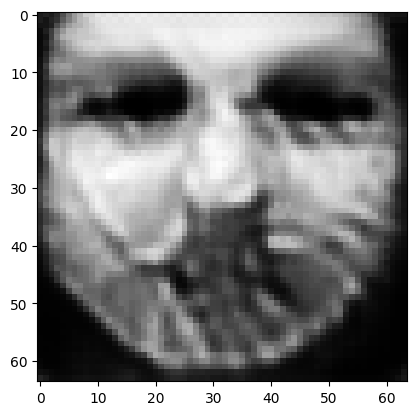

tensor([[4.1636e-04, 1.8260e-04, 2.2057e-03, 3.8425e-04, 9.5910e-01, 1.0218e-04,
         2.7239e-04, 3.9005e-04, 1.4824e-04, 8.2652e-06, 3.4982e-06, 1.5499e-05,
         1.6412e-03, 5.8973e-04, 5.3441e-05, 7.2843e-06, 9.1074e-04, 4.0898e-03,
         4.5700e-05, 1.5735e-04, 1.8181e-04, 5.6369e-05, 9.6967e-04, 2.4721e-05,
         1.4192e-02, 4.3425e-05, 2.9049e-04, 3.3787e-04, 2.8028e-05, 2.0871e-05,
         8.9014e-05, 2.6831e-04, 1.6783e-03, 3.6586e-04, 2.3380e-03, 8.0288e-04,
         8.4697e-04, 4.6337e-04, 5.9757e-03, 3.0006e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04175741598010063
tensor([[4.1602e-04, 1.8249e-04, 2.2026e-03, 3.8398e-04, 9.5914e-01, 1.0209e-04,
         2.7207e-04, 3.8974e-04, 1.4814e-04, 8.2583e-06, 3.4932e-06, 1.5480e-05,
         1.6393e-03, 5.8905e-04, 5.3353e-05, 7.2754e-06, 9.0981e-04, 4.0847e-03,
         4.5646e-05, 1.5721e-04, 1.8155e-04, 5.6314e-05, 9.6811e-04, 2.4697e-05,
         1.4182e-02, 4.3400e-05, 2.9013e-0

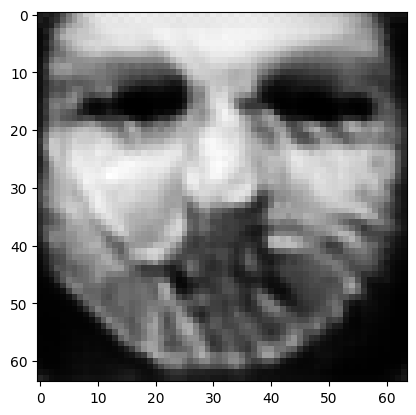

tensor([[4.1482e-04, 1.8202e-04, 2.1910e-03, 3.8308e-04, 9.5929e-01, 1.0176e-04,
         2.7096e-04, 3.8860e-04, 1.4780e-04, 8.2359e-06, 3.4737e-06, 1.5404e-05,
         1.6317e-03, 5.8633e-04, 5.3008e-05, 7.2420e-06, 9.0597e-04, 4.0663e-03,
         4.5433e-05, 1.5666e-04, 1.8054e-04, 5.6086e-05, 9.6134e-04, 2.4599e-05,
         1.4147e-02, 4.3289e-05, 2.8885e-04, 3.3673e-04, 2.7799e-05, 2.0788e-05,
         8.8552e-05, 2.6635e-04, 1.6664e-03, 3.6372e-04, 2.3270e-03, 7.9953e-04,
         8.4026e-04, 4.6147e-04, 5.9549e-03, 2.9860e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04156600311398506
tensor([[4.1453e-04, 1.8191e-04, 2.1881e-03, 3.8284e-04, 9.5932e-01, 1.0167e-04,
         2.7068e-04, 3.8829e-04, 1.4772e-04, 8.2301e-06, 3.4690e-06, 1.5388e-05,
         1.6298e-03, 5.8569e-04, 5.2931e-05, 7.2342e-06, 9.0503e-04, 4.0619e-03,
         4.5381e-05, 1.5653e-04, 1.8031e-04, 5.6034e-05, 9.5982e-04, 2.4576e-05,
         1.4139e-02, 4.3262e-05, 2.8855e-0

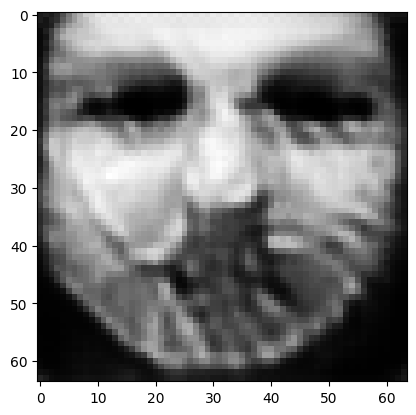

tensor([[4.1348e-04, 1.8147e-04, 2.1773e-03, 3.8197e-04, 9.5946e-01, 1.0137e-04,
         2.6972e-04, 3.8725e-04, 1.4744e-04, 8.2110e-06, 3.4512e-06, 1.5322e-05,
         1.6230e-03, 5.8312e-04, 5.2625e-05, 7.2033e-06, 9.0112e-04, 4.0458e-03,
         4.5184e-05, 1.5603e-04, 1.7940e-04, 5.5826e-05, 9.5339e-04, 2.4481e-05,
         1.4105e-02, 4.3147e-05, 2.8749e-04, 3.3566e-04, 2.7589e-05, 2.0713e-05,
         8.8114e-05, 2.6454e-04, 1.6554e-03, 3.6176e-04, 2.3167e-03, 7.9654e-04,
         8.3381e-04, 4.5964e-04, 5.9358e-03, 2.9730e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04138793423771858
tensor([[4.1324e-04, 1.8136e-04, 2.1746e-03, 3.8174e-04, 9.5949e-01, 1.0131e-04,
         2.6951e-04, 3.8701e-04, 1.4737e-04, 8.2068e-06, 3.4472e-06, 1.5307e-05,
         1.6214e-03, 5.8248e-04, 5.2555e-05, 7.1959e-06, 9.0017e-04, 4.0420e-03,
         4.5138e-05, 1.5592e-04, 1.7918e-04, 5.5777e-05, 9.5181e-04, 2.4459e-05,
         1.4096e-02, 4.3120e-05, 2.8724e-0

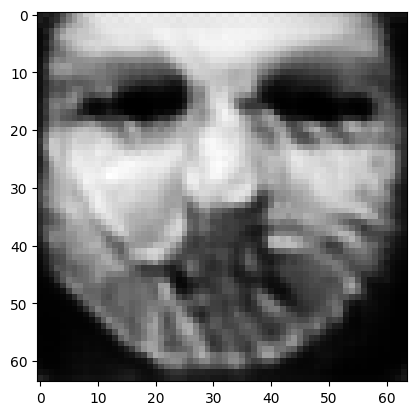

tensor([[4.1231e-04, 1.8097e-04, 2.1649e-03, 3.8101e-04, 9.5961e-01, 1.0103e-04,
         2.6861e-04, 3.8605e-04, 1.4711e-04, 8.1888e-06, 3.4310e-06, 1.5246e-05,
         1.6151e-03, 5.8022e-04, 5.2285e-05, 7.1675e-06, 8.9660e-04, 4.0274e-03,
         4.4962e-05, 1.5544e-04, 1.7836e-04, 5.5588e-05, 9.4599e-04, 2.4372e-05,
         1.4064e-02, 4.3017e-05, 2.8627e-04, 3.3473e-04, 2.7400e-05, 2.0646e-05,
         8.7705e-05, 2.6282e-04, 1.6450e-03, 3.5998e-04, 2.3074e-03, 7.9370e-04,
         8.2771e-04, 4.5790e-04, 5.9184e-03, 2.9610e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04122379049658775
tensor([[4.1197e-04, 1.8089e-04, 2.1619e-03, 3.8079e-04, 9.5964e-01, 1.0091e-04,
         2.6827e-04, 3.8569e-04, 1.4701e-04, 8.1799e-06, 3.4265e-06, 1.5232e-05,
         1.6135e-03, 5.7991e-04, 5.2232e-05, 7.1604e-06, 8.9604e-04, 4.0230e-03,
         4.4923e-05, 1.5529e-04, 1.7819e-04, 5.5551e-05, 9.4551e-04, 2.4355e-05,
         1.4058e-02, 4.3009e-05, 2.8593e-0

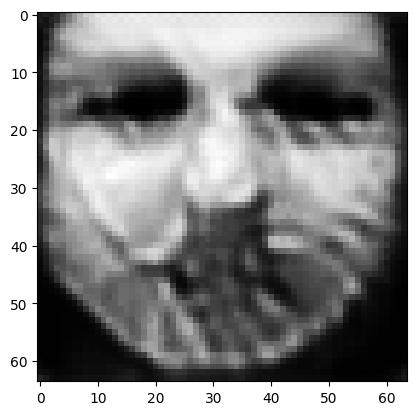

tensor([[4.1105e-04, 1.8053e-04, 2.1525e-03, 3.8005e-04, 9.5976e-01, 1.0063e-04,
         2.6742e-04, 3.8475e-04, 1.4677e-04, 8.1613e-06, 3.4116e-06, 1.5177e-05,
         1.6079e-03, 5.7784e-04, 5.1991e-05, 7.1341e-06, 8.9282e-04, 4.0090e-03,
         4.4762e-05, 1.5487e-04, 1.7744e-04, 5.5382e-05, 9.4057e-04, 2.4276e-05,
         1.4029e-02, 4.2919e-05, 2.8501e-04, 3.3374e-04, 2.7213e-05, 2.0584e-05,
         8.7359e-05, 2.6138e-04, 1.6356e-03, 3.5828e-04, 2.2993e-03, 7.9166e-04,
         8.2269e-04, 4.5636e-04, 5.9003e-03, 2.9490e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04107300937175751
tensor([[4.1089e-04, 1.8044e-04, 2.1506e-03, 3.7992e-04, 9.5979e-01, 1.0060e-04,
         2.6728e-04, 3.8458e-04, 1.4672e-04, 8.1596e-06, 3.4082e-06, 1.5163e-05,
         1.6065e-03, 5.7720e-04, 5.1923e-05, 7.1278e-06, 8.9185e-04, 4.0061e-03,
         4.4720e-05, 1.5478e-04, 1.7723e-04, 5.5334e-05, 9.3878e-04, 2.4253e-05,
         1.4022e-02, 4.2887e-05, 2.8485e-0

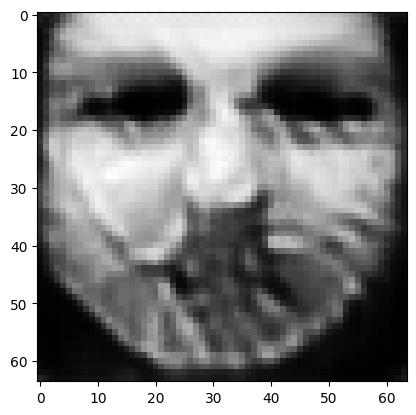

tensor([[4.1004e-04, 1.8010e-04, 2.1419e-03, 3.7922e-04, 9.5990e-01, 1.0036e-04,
         2.6651e-04, 3.8373e-04, 1.4650e-04, 8.1434e-06, 3.3943e-06, 1.5111e-05,
         1.6014e-03, 5.7517e-04, 5.1694e-05, 7.1031e-06, 8.8881e-04, 3.9930e-03,
         4.4570e-05, 1.5441e-04, 1.7651e-04, 5.5175e-05, 9.3400e-04, 2.4178e-05,
         1.3994e-02, 4.2802e-05, 2.8401e-04, 3.3293e-04, 2.7053e-05, 2.0527e-05,
         8.7008e-05, 2.5989e-04, 1.6266e-03, 3.5674e-04, 2.2915e-03, 7.8913e-04,
         8.1727e-04, 4.5480e-04, 5.8861e-03, 2.9391e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04093112796545029
tensor([[4.0974e-04, 1.8004e-04, 2.1394e-03, 3.7903e-04, 9.5992e-01, 1.0026e-04,
         2.6622e-04, 3.8345e-04, 1.4642e-04, 8.1360e-06, 3.3905e-06, 1.5098e-05,
         1.6002e-03, 5.7489e-04, 5.1646e-05, 7.0968e-06, 8.8834e-04, 3.9890e-03,
         4.4539e-05, 1.5429e-04, 1.7637e-04, 5.5142e-05, 9.3359e-04, 2.4164e-05,
         1.3988e-02, 4.2796e-05, 2.8372e-0

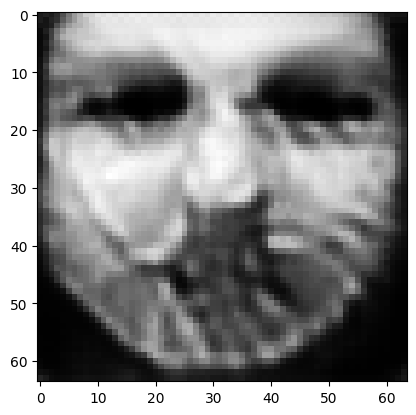

tensor([[4.0894e-04, 1.7973e-04, 2.1313e-03, 3.7842e-04, 9.6002e-01, 1.0003e-04,
         2.6548e-04, 3.8259e-04, 1.4620e-04, 8.1208e-06, 3.3768e-06, 1.5048e-05,
         1.5954e-03, 5.7301e-04, 5.1423e-05, 7.0736e-06, 8.8542e-04, 3.9764e-03,
         4.4395e-05, 1.5391e-04, 1.7568e-04, 5.4991e-05, 9.2914e-04, 2.4090e-05,
         1.3963e-02, 4.2714e-05, 2.8295e-04, 3.3206e-04, 2.6892e-05, 2.0471e-05,
         8.6712e-05, 2.5859e-04, 1.6183e-03, 3.5522e-04, 2.2849e-03, 7.8721e-04,
         8.1273e-04, 4.5343e-04, 5.8704e-03, 2.9290e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04079986736178398
tensor([[4.0881e-04, 1.7966e-04, 2.1296e-03, 3.7831e-04, 9.6005e-01, 9.9997e-05,
         2.6535e-04, 3.8243e-04, 1.4616e-04, 8.1193e-06, 3.3736e-06, 1.5035e-05,
         1.5943e-03, 5.7248e-04, 5.1363e-05, 7.0681e-06, 8.8458e-04, 3.9736e-03,
         4.4359e-05, 1.5383e-04, 1.7551e-04, 5.4950e-05, 9.2769e-04, 2.4070e-05,
         1.3957e-02, 4.2688e-05, 2.8282e-0

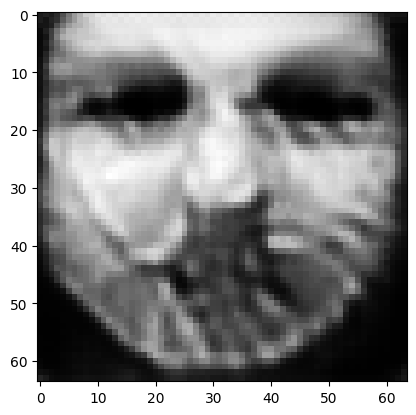

tensor([[4.0797e-04, 1.7938e-04, 2.1216e-03, 3.7767e-04, 9.6014e-01, 9.9748e-05,
         2.6457e-04, 3.8157e-04, 1.4594e-04, 8.1020e-06, 3.3606e-06, 1.4989e-05,
         1.5899e-03, 5.7084e-04, 5.1164e-05, 7.0461e-06, 8.8202e-04, 3.9610e-03,
         4.4230e-05, 1.5347e-04, 1.7489e-04, 5.4818e-05, 9.2419e-04, 2.4006e-05,
         1.3934e-02, 4.2626e-05, 2.8202e-04, 3.3125e-04, 2.6744e-05, 2.0419e-05,
         8.6427e-05, 2.5734e-04, 1.6105e-03, 3.5382e-04, 2.2784e-03, 7.8529e-04,
         8.0830e-04, 4.5212e-04, 5.8564e-03, 2.9199e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040676604956388474
tensor([[4.0778e-04, 1.7931e-04, 2.1196e-03, 3.7751e-04, 9.6016e-01, 9.9693e-05,
         2.6440e-04, 3.8135e-04, 1.4589e-04, 8.0981e-06, 3.3575e-06, 1.4979e-05,
         1.5888e-03, 5.7041e-04, 5.1116e-05, 7.0409e-06, 8.8136e-04, 3.9580e-03,
         4.4198e-05, 1.5338e-04, 1.7474e-04, 5.4786e-05, 9.2331e-04, 2.3990e-05,
         1.3929e-02, 4.2610e-05, 2.8184e-

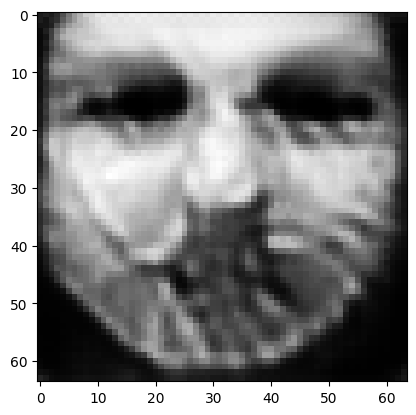

tensor([[4.0695e-04, 1.7905e-04, 2.1122e-03, 3.7696e-04, 9.6025e-01, 9.9451e-05,
         2.6361e-04, 3.8050e-04, 1.4565e-04, 8.0811e-06, 3.3445e-06, 1.4933e-05,
         1.5843e-03, 5.6886e-04, 5.0912e-05, 7.0191e-06, 8.7896e-04, 3.9454e-03,
         4.4071e-05, 1.5301e-04, 1.7414e-04, 5.4657e-05, 9.1995e-04, 2.3926e-05,
         1.3910e-02, 4.2551e-05, 2.8103e-04, 3.3042e-04, 2.6600e-05, 2.0367e-05,
         8.6163e-05, 2.5620e-04, 1.6030e-03, 3.5246e-04, 2.2726e-03, 7.8358e-04,
         8.0442e-04, 4.5093e-04, 5.8419e-03, 2.9107e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04056042432785034
tensor([[4.0673e-04, 1.7898e-04, 2.1103e-03, 3.7681e-04, 9.6027e-01, 9.9391e-05,
         2.6342e-04, 3.8028e-04, 1.4559e-04, 8.0768e-06, 3.3413e-06, 1.4921e-05,
         1.5832e-03, 5.6846e-04, 5.0861e-05, 7.0137e-06, 8.7837e-04, 3.9421e-03,
         4.4039e-05, 1.5292e-04, 1.7400e-04, 5.4625e-05, 9.1915e-04, 2.3910e-05,
         1.3905e-02, 4.2536e-05, 2.8082e-0

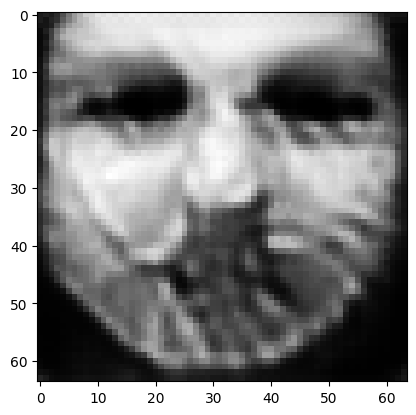

tensor([[4.0591e-04, 1.7871e-04, 2.1030e-03, 3.7627e-04, 9.6036e-01, 9.9165e-05,
         2.6266e-04, 3.7940e-04, 1.4536e-04, 8.0606e-06, 3.3285e-06, 1.4877e-05,
         1.5789e-03, 5.6692e-04, 5.0657e-05, 6.9929e-06, 8.7600e-04, 3.9295e-03,
         4.3913e-05, 1.5257e-04, 1.7342e-04, 5.4500e-05, 9.1587e-04, 2.3844e-05,
         1.3888e-02, 4.2475e-05, 2.8005e-04, 3.2958e-04, 2.6459e-05, 2.0312e-05,
         8.5906e-05, 2.5509e-04, 1.5958e-03, 3.5111e-04, 2.2673e-03, 7.8188e-04,
         8.0071e-04, 4.4980e-04, 5.8273e-03, 2.9017e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04044892266392708
tensor([[4.0571e-04, 1.7865e-04, 2.1012e-03, 3.7613e-04, 9.6038e-01, 9.9111e-05,
         2.6248e-04, 3.7919e-04, 1.4531e-04, 8.0567e-06, 3.3255e-06, 1.4866e-05,
         1.5779e-03, 5.6655e-04, 5.0607e-05, 6.9878e-06, 8.7544e-04, 3.9264e-03,
         4.3883e-05, 1.5249e-04, 1.7328e-04, 5.4470e-05, 9.1511e-04, 2.3829e-05,
         1.3884e-02, 4.2462e-05, 2.7987e-0

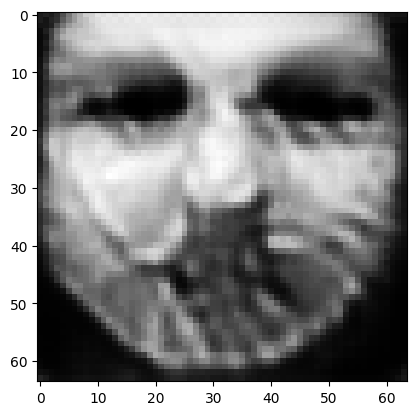

tensor([[4.0488e-04, 1.7840e-04, 2.0945e-03, 3.7566e-04, 9.6046e-01, 9.8887e-05,
         2.6172e-04, 3.7833e-04, 1.4507e-04, 8.0407e-06, 3.3130e-06, 1.4821e-05,
         1.5739e-03, 5.6514e-04, 5.0402e-05, 6.9672e-06, 8.7331e-04, 3.9137e-03,
         4.3762e-05, 1.5213e-04, 1.7273e-04, 5.4346e-05, 9.1208e-04, 2.3765e-05,
         1.3869e-02, 4.2410e-05, 2.7908e-04, 3.2881e-04, 2.6328e-05, 2.0261e-05,
         8.5665e-05, 2.5400e-04, 1.5888e-03, 3.4983e-04, 2.2625e-03, 7.8009e-04,
         7.9724e-04, 4.4872e-04, 5.8133e-03, 2.8933e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04034451022744179
tensor([[4.0468e-04, 1.7834e-04, 2.0929e-03, 3.7552e-04, 9.6048e-01, 9.8833e-05,
         2.6154e-04, 3.7813e-04, 1.4502e-04, 8.0367e-06, 3.3102e-06, 1.4811e-05,
         1.5730e-03, 5.6478e-04, 5.0356e-05, 6.9624e-06, 8.7279e-04, 3.9107e-03,
         4.3734e-05, 1.5205e-04, 1.7260e-04, 5.4318e-05, 9.1139e-04, 2.3751e-05,
         1.3865e-02, 4.2397e-05, 2.7890e-0

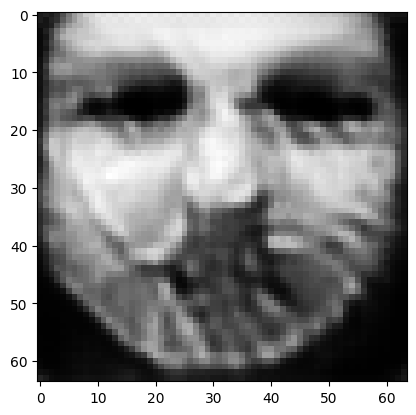

tensor([[4.0389e-04, 1.7810e-04, 2.0863e-03, 3.7500e-04, 9.6055e-01, 9.8623e-05,
         2.6084e-04, 3.7732e-04, 1.4481e-04, 8.0215e-06, 3.2987e-06, 1.4771e-05,
         1.5692e-03, 5.6338e-04, 5.0172e-05, 6.9432e-06, 8.7069e-04, 3.8989e-03,
         4.3620e-05, 1.5174e-04, 1.7209e-04, 5.4208e-05, 9.0860e-04, 2.3692e-05,
         1.3850e-02, 4.2347e-05, 2.7819e-04, 3.2803e-04, 2.6201e-05, 2.0213e-05,
         8.5449e-05, 2.5302e-04, 1.5825e-03, 3.4863e-04, 2.2578e-03, 7.7856e-04,
         7.9401e-04, 4.4768e-04, 5.8006e-03, 2.8854e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04024500772356987
tensor([[4.0370e-04, 1.7805e-04, 2.0847e-03, 3.7487e-04, 9.6057e-01, 9.8574e-05,
         2.6067e-04, 3.7713e-04, 1.4477e-04, 8.0180e-06, 3.2960e-06, 1.4762e-05,
         1.5684e-03, 5.6304e-04, 5.0127e-05, 6.9386e-06, 8.7019e-04, 3.8961e-03,
         4.3592e-05, 1.5166e-04, 1.7197e-04, 5.4181e-05, 9.0791e-04, 2.3678e-05,
         1.3846e-02, 4.2335e-05, 2.7802e-0

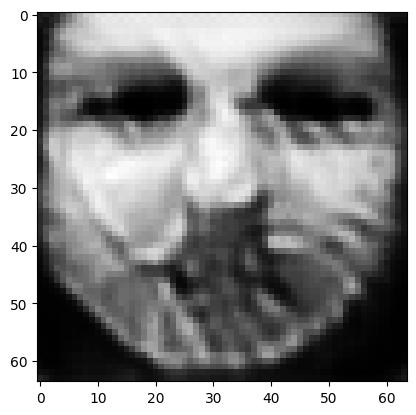

tensor([[4.0291e-04, 1.7784e-04, 2.0785e-03, 3.7440e-04, 9.6064e-01, 9.8353e-05,
         2.5994e-04, 3.7631e-04, 1.4455e-04, 8.0019e-06, 3.2848e-06, 1.4723e-05,
         1.5648e-03, 5.6186e-04, 4.9952e-05, 6.9200e-06, 8.6836e-04, 3.8844e-03,
         4.3487e-05, 1.5134e-04, 1.7149e-04, 5.4078e-05, 9.0560e-04, 2.3624e-05,
         1.3833e-02, 4.2295e-05, 2.7729e-04, 3.2730e-04, 2.6080e-05, 2.0167e-05,
         8.5246e-05, 2.5210e-04, 1.5764e-03, 3.4748e-04, 2.2535e-03, 7.7713e-04,
         7.9112e-04, 4.4672e-04, 5.7875e-03, 2.8775e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04015122354030609
tensor([[4.0274e-04, 1.7778e-04, 2.0771e-03, 3.7428e-04, 9.6066e-01, 9.8314e-05,
         2.5981e-04, 3.7616e-04, 1.4450e-04, 7.9992e-06, 3.2824e-06, 1.4714e-05,
         1.5640e-03, 5.6149e-04, 4.9910e-05, 6.9158e-06, 8.6786e-04, 3.8819e-03,
         4.3461e-05, 1.5127e-04, 1.7137e-04, 5.4052e-05, 9.0483e-04, 2.3610e-05,
         1.3829e-02, 4.2281e-05, 2.7714e-0

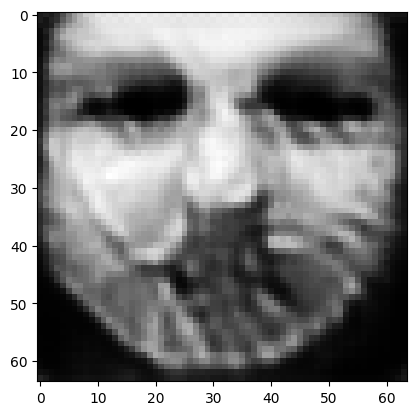

tensor([[4.0214e-04, 1.7757e-04, 2.0716e-03, 3.7385e-04, 9.6073e-01, 9.8164e-05,
         2.5929e-04, 3.7557e-04, 1.4434e-04, 7.9892e-06, 3.2729e-06, 1.4679e-05,
         1.5609e-03, 5.6011e-04, 4.9746e-05, 6.8995e-06, 8.6588e-04, 3.8722e-03,
         4.3364e-05, 1.5103e-04, 1.7090e-04, 5.3949e-05, 9.0185e-04, 2.3559e-05,
         1.3814e-02, 4.2229e-05, 2.7658e-04, 3.2670e-04, 2.5977e-05, 2.0125e-05,
         8.5042e-05, 2.5118e-04, 1.5707e-03, 3.4646e-04, 2.2491e-03, 7.7554e-04,
         7.8793e-04, 4.4573e-04, 5.7775e-03, 2.8711e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04006269574165344
tensor([[4.0199e-04, 1.7752e-04, 2.0703e-03, 3.7374e-04, 9.6075e-01, 9.8125e-05,
         2.5916e-04, 3.7542e-04, 1.4430e-04, 7.9865e-06, 3.2707e-06, 1.4671e-05,
         1.5602e-03, 5.5979e-04, 4.9708e-05, 6.8955e-06, 8.6544e-04, 3.8698e-03,
         4.3341e-05, 1.5097e-04, 1.7079e-04, 5.3926e-05, 9.0119e-04, 2.3547e-05,
         1.3810e-02, 4.2218e-05, 2.7644e-0

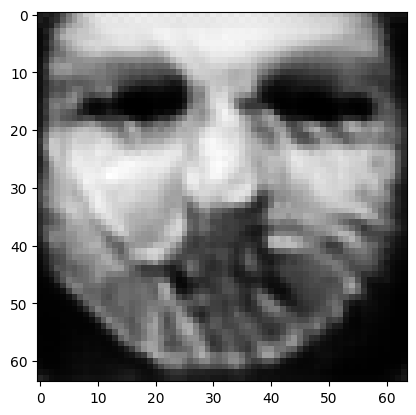

tensor([[4.0138e-04, 1.7733e-04, 2.0650e-03, 3.7331e-04, 9.6081e-01, 9.7969e-05,
         2.5864e-04, 3.7485e-04, 1.4415e-04, 7.9758e-06, 3.2619e-06, 1.4640e-05,
         1.5574e-03, 5.5857e-04, 4.9561e-05, 6.8800e-06, 8.6369e-04, 3.8606e-03,
         4.3253e-05, 1.5074e-04, 1.7036e-04, 5.3836e-05, 8.9871e-04, 2.3500e-05,
         1.3796e-02, 4.2175e-05, 2.7589e-04, 3.2611e-04, 2.5879e-05, 2.0087e-05,
         8.4866e-05, 2.5036e-04, 1.5656e-03, 3.4551e-04, 2.2450e-03, 7.7420e-04,
         7.8510e-04, 4.4483e-04, 5.7681e-03, 2.8649e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0399806909263134
tensor([[4.0124e-04, 1.7728e-04, 2.0638e-03, 3.7320e-04, 9.6082e-01, 9.7932e-05,
         2.5852e-04, 3.7472e-04, 1.4411e-04, 7.9732e-06, 3.2598e-06, 1.4632e-05,
         1.5567e-03, 5.5828e-04, 4.9526e-05, 6.8763e-06, 8.6328e-04, 3.8584e-03,
         4.3232e-05, 1.5068e-04, 1.7026e-04, 5.3814e-05, 8.9811e-04, 2.3489e-05,
         1.3793e-02, 4.2164e-05, 2.7576e-04

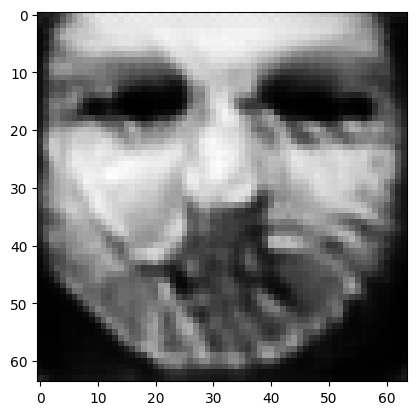

tensor([[4.0062e-04, 1.7710e-04, 2.0589e-03, 3.7281e-04, 9.6088e-01, 9.7765e-05,
         2.5798e-04, 3.7414e-04, 1.4395e-04, 7.9614e-06, 3.2512e-06, 1.4601e-05,
         1.5540e-03, 5.5725e-04, 4.9385e-05, 6.8613e-06, 8.6176e-04, 3.8492e-03,
         4.3149e-05, 1.5044e-04, 1.6987e-04, 5.3731e-05, 8.9604e-04, 2.3446e-05,
         1.3781e-02, 4.2130e-05, 2.7518e-04, 3.2555e-04, 2.5786e-05, 2.0051e-05,
         8.4704e-05, 2.4960e-04, 1.5608e-03, 3.4460e-04, 2.2413e-03, 7.7296e-04,
         7.8259e-04, 4.4401e-04, 5.7586e-03, 2.8587e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03990417718887329
tensor([[4.0047e-04, 1.7705e-04, 2.0577e-03, 3.7271e-04, 9.6090e-01, 9.7728e-05,
         2.5785e-04, 3.7399e-04, 1.4392e-04, 7.9587e-06, 3.2491e-06, 1.4595e-05,
         1.5533e-03, 5.5698e-04, 4.9352e-05, 6.8578e-06, 8.6136e-04, 3.8471e-03,
         4.3128e-05, 1.5039e-04, 1.6977e-04, 5.3711e-05, 8.9553e-04, 2.3435e-05,
         1.3777e-02, 4.2120e-05, 2.7505e-0

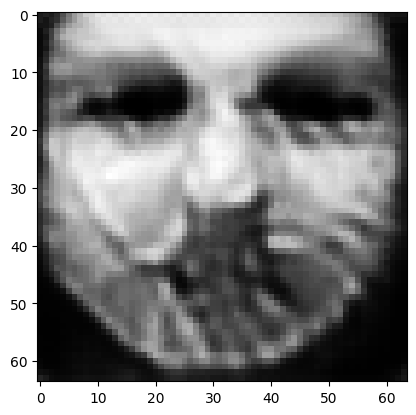

tensor([[3.9994e-04, 1.7687e-04, 2.0534e-03, 3.7235e-04, 9.6095e-01, 9.7602e-05,
         2.5743e-04, 3.7349e-04, 1.4380e-04, 7.9502e-06, 3.2416e-06, 1.4567e-05,
         1.5509e-03, 5.5589e-04, 4.9217e-05, 6.8443e-06, 8.5975e-04, 3.8391e-03,
         4.3051e-05, 1.5018e-04, 1.6940e-04, 5.3630e-05, 8.9318e-04, 2.3392e-05,
         1.3765e-02, 4.2080e-05, 2.7460e-04, 3.2504e-04, 2.5703e-05, 2.0017e-05,
         8.4543e-05, 2.4886e-04, 1.5562e-03, 3.4377e-04, 2.2378e-03, 7.7171e-04,
         7.8009e-04, 4.4324e-04, 5.7506e-03, 2.8537e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039832353591918945
tensor([[3.9981e-04, 1.7683e-04, 2.0523e-03, 3.7226e-04, 9.6096e-01, 9.7570e-05,
         2.5732e-04, 3.7337e-04, 1.4377e-04, 7.9481e-06, 3.2398e-06, 1.4561e-05,
         1.5503e-03, 5.5564e-04, 4.9187e-05, 6.8411e-06, 8.5938e-04, 3.8373e-03,
         4.3033e-05, 1.5013e-04, 1.6931e-04, 5.3611e-05, 8.9267e-04, 2.3382e-05,
         1.3761e-02, 4.2071e-05, 2.7449e-

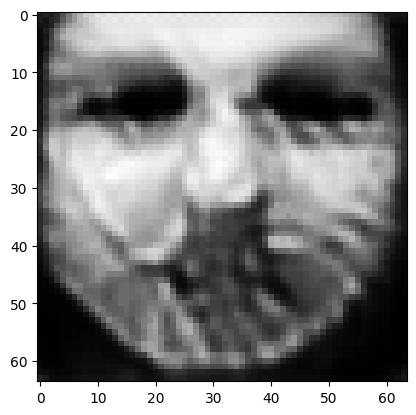

tensor([[3.9925e-04, 1.7666e-04, 2.0480e-03, 3.7191e-04, 9.6102e-01, 9.7424e-05,
         2.5685e-04, 3.7284e-04, 1.4364e-04, 7.9376e-06, 3.2323e-06, 1.4535e-05,
         1.5480e-03, 5.5474e-04, 4.9064e-05, 6.8279e-06, 8.5801e-04, 3.8292e-03,
         4.2960e-05, 1.4992e-04, 1.6897e-04, 5.3538e-05, 8.9087e-04, 2.3343e-05,
         1.3750e-02, 4.2041e-05, 2.7399e-04, 3.2455e-04, 2.5621e-05, 1.9986e-05,
         8.4401e-05, 2.4819e-04, 1.5518e-03, 3.4297e-04, 2.2347e-03, 7.7066e-04,
         7.7792e-04, 4.4253e-04, 5.7422e-03, 2.8485e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039764534682035446
tensor([[3.9912e-04, 1.7662e-04, 2.0470e-03, 3.7182e-04, 9.6103e-01, 9.7393e-05,
         2.5675e-04, 3.7272e-04, 1.4362e-04, 7.9356e-06, 3.2306e-06, 1.4529e-05,
         1.5475e-03, 5.5449e-04, 4.9034e-05, 6.8248e-06, 8.5766e-04, 3.8274e-03,
         4.2943e-05, 1.4987e-04, 1.6889e-04, 5.3520e-05, 8.9036e-04, 2.3333e-05,
         1.3747e-02, 4.2033e-05, 2.7388e-

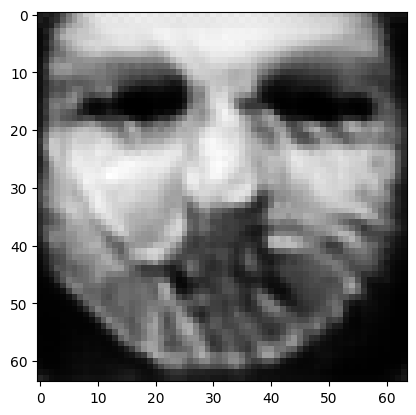

tensor([[3.9863e-04, 1.7646e-04, 2.0430e-03, 3.7148e-04, 9.6108e-01, 9.7274e-05,
         2.5634e-04, 3.7225e-04, 1.4351e-04, 7.9273e-06, 3.2239e-06, 1.4506e-05,
         1.5453e-03, 5.5354e-04, 4.8919e-05, 6.8127e-06, 8.5625e-04, 3.8201e-03,
         4.2873e-05, 1.4969e-04, 1.6856e-04, 5.3451e-05, 8.8842e-04, 2.3295e-05,
         1.3736e-02, 4.2000e-05, 2.7347e-04, 3.2409e-04, 2.5546e-05, 1.9956e-05,
         8.4264e-05, 2.4756e-04, 1.5478e-03, 3.4222e-04, 2.2316e-03, 7.6962e-04,
         7.7574e-04, 4.4184e-04, 5.7350e-03, 2.8439e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03970026597380638
tensor([[3.9853e-04, 1.7642e-04, 2.0422e-03, 3.7142e-04, 9.6109e-01, 9.7253e-05,
         2.5626e-04, 3.7215e-04, 1.4349e-04, 7.9261e-06, 3.2222e-06, 1.4499e-05,
         1.5448e-03, 5.5328e-04, 4.8886e-05, 6.8096e-06, 8.5587e-04, 3.8184e-03,
         4.2855e-05, 1.4965e-04, 1.6847e-04, 5.3431e-05, 8.8777e-04, 2.3285e-05,
         1.3733e-02, 4.1990e-05, 2.7337e-0

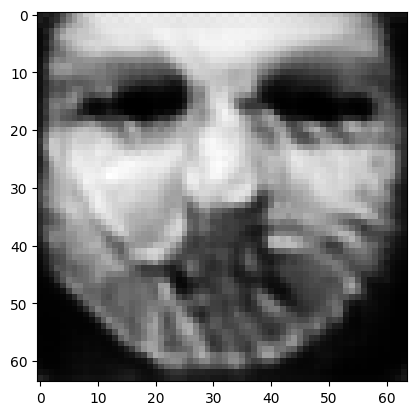

tensor([[3.9802e-04, 1.7626e-04, 2.0383e-03, 3.7110e-04, 9.6114e-01, 9.7123e-05,
         2.5583e-04, 3.7168e-04, 1.4336e-04, 7.9167e-06, 3.2155e-06, 1.4475e-05,
         1.5426e-03, 5.5242e-04, 4.8772e-05, 6.7977e-06, 8.5467e-04, 3.8110e-03,
         4.2789e-05, 1.4945e-04, 1.6816e-04, 5.3362e-05, 8.8611e-04, 2.3250e-05,
         1.3724e-02, 4.1963e-05, 2.7291e-04, 3.2368e-04, 2.5475e-05, 1.9927e-05,
         8.4125e-05, 2.4693e-04, 1.5436e-03, 3.4149e-04, 2.2287e-03, 7.6853e-04,
         7.7367e-04, 4.4117e-04, 5.7275e-03, 2.8392e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0396394245326519
tensor([[3.9790e-04, 1.7623e-04, 2.0374e-03, 3.7102e-04, 9.6115e-01, 9.7095e-05,
         2.5574e-04, 3.7158e-04, 1.4334e-04, 7.9148e-06, 3.2140e-06, 1.4469e-05,
         1.5421e-03, 5.5220e-04, 4.8745e-05, 6.7949e-06, 8.5435e-04, 3.8093e-03,
         4.2773e-05, 1.4941e-04, 1.6808e-04, 5.3346e-05, 8.8565e-04, 2.3241e-05,
         1.3721e-02, 4.1956e-05, 2.7281e-04

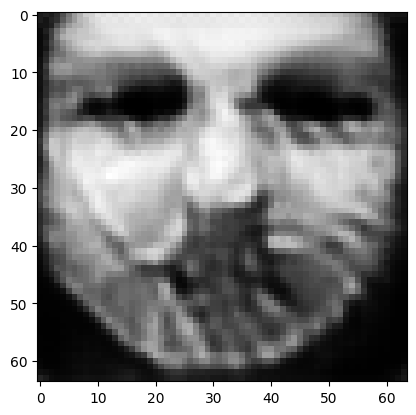

tensor([[3.9747e-04, 1.7608e-04, 2.0338e-03, 3.7071e-04, 9.6119e-01, 9.6990e-05,
         2.5539e-04, 3.7117e-04, 1.4324e-04, 7.9076e-06, 3.2080e-06, 1.4448e-05,
         1.5402e-03, 5.5131e-04, 4.8640e-05, 6.7839e-06, 8.5311e-04, 3.8028e-03,
         4.2711e-05, 1.4925e-04, 1.6778e-04, 5.3280e-05, 8.8383e-04, 2.3207e-05,
         1.3711e-02, 4.1926e-05, 2.7242e-04, 3.2327e-04, 2.5408e-05, 1.9900e-05,
         8.3997e-05, 2.4635e-04, 1.5399e-03, 3.4082e-04, 2.2259e-03, 7.6754e-04,
         7.7166e-04, 4.4053e-04, 5.7211e-03, 2.8350e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03958122059702873
tensor([[3.9730e-04, 1.7605e-04, 2.0327e-03, 3.7063e-04, 9.6120e-01, 9.6940e-05,
         2.5524e-04, 3.7102e-04, 1.4320e-04, 7.9038e-06, 3.2062e-06, 1.4442e-05,
         1.5397e-03, 5.5120e-04, 4.8617e-05, 6.7810e-06, 8.5295e-04, 3.8007e-03,
         4.2696e-05, 1.4919e-04, 1.6773e-04, 5.3267e-05, 8.8377e-04, 2.3201e-05,
         1.3709e-02, 4.1926e-05, 2.7227e-0

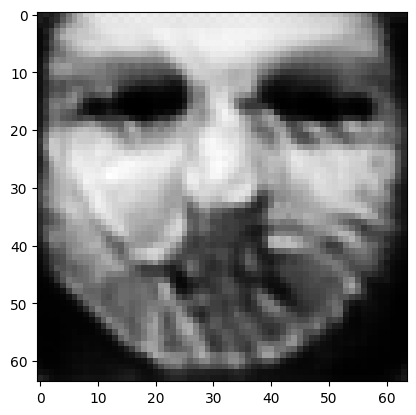

tensor([[3.9691e-04, 1.7590e-04, 2.0294e-03, 3.7035e-04, 9.6124e-01, 9.6850e-05,
         2.5492e-04, 3.7067e-04, 1.4311e-04, 7.8978e-06, 3.2005e-06, 1.4421e-05,
         1.5378e-03, 5.5031e-04, 4.8513e-05, 6.7706e-06, 8.5170e-04, 3.7946e-03,
         4.2635e-05, 1.4904e-04, 1.6743e-04, 5.3201e-05, 8.8181e-04, 2.3167e-05,
         1.3700e-02, 4.1894e-05, 2.7192e-04, 3.2289e-04, 2.5342e-05, 1.9874e-05,
         8.3874e-05, 2.4580e-04, 1.5363e-03, 3.4016e-04, 2.2232e-03, 7.6664e-04,
         7.6982e-04, 4.3992e-04, 5.7144e-03, 2.8308e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03952610492706299
tensor([[3.9683e-04, 1.7587e-04, 2.0287e-03, 3.7030e-04, 9.6126e-01, 9.6833e-05,
         2.5485e-04, 3.7059e-04, 1.4308e-04, 7.8967e-06, 3.1991e-06, 1.4415e-05,
         1.5373e-03, 5.5007e-04, 4.8484e-05, 6.7679e-06, 8.5138e-04, 3.7931e-03,
         4.2620e-05, 1.4900e-04, 1.6735e-04, 5.3183e-05, 8.8122e-04, 2.3158e-05,
         1.3697e-02, 4.1885e-05, 2.7184e-0

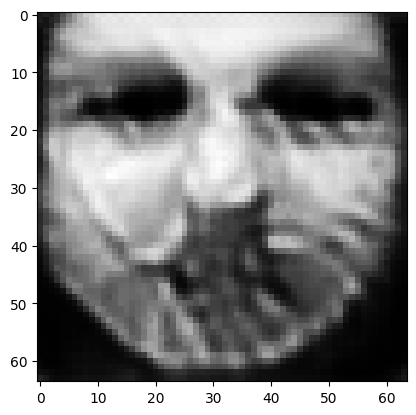

tensor([[3.9641e-04, 1.7573e-04, 2.0254e-03, 3.7002e-04, 9.6130e-01, 9.6726e-05,
         2.5450e-04, 3.7022e-04, 1.4298e-04, 7.8891e-06, 3.1935e-06, 1.4394e-05,
         1.5354e-03, 5.4932e-04, 4.8388e-05, 6.7578e-06, 8.5034e-04, 3.7869e-03,
         4.2564e-05, 1.4884e-04, 1.6708e-04, 5.3123e-05, 8.7971e-04, 2.3128e-05,
         1.3689e-02, 4.1862e-05, 2.7145e-04, 3.2255e-04, 2.5282e-05, 1.9848e-05,
         8.3751e-05, 2.4526e-04, 1.5327e-03, 3.3955e-04, 2.2206e-03, 7.6568e-04,
         7.6799e-04, 4.3934e-04, 5.7082e-03, 2.8268e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03947373479604721
tensor([[3.9632e-04, 1.7570e-04, 2.0246e-03, 3.6995e-04, 9.6131e-01, 9.6705e-05,
         2.5443e-04, 3.7014e-04, 1.4296e-04, 7.8877e-06, 3.1923e-06, 1.4390e-05,
         1.5350e-03, 5.4912e-04, 4.8365e-05, 6.7555e-06, 8.5006e-04, 3.7855e-03,
         4.2550e-05, 1.4881e-04, 1.6701e-04, 5.3109e-05, 8.7928e-04, 2.3121e-05,
         1.3687e-02, 4.1855e-05, 2.7136e-0

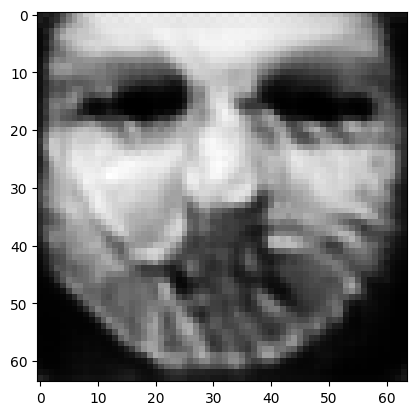

tensor([[3.9596e-04, 1.7556e-04, 2.0215e-03, 3.6967e-04, 9.6134e-01, 9.6618e-05,
         2.5413e-04, 3.6983e-04, 1.4288e-04, 7.8819e-06, 3.1872e-06, 1.4371e-05,
         1.5333e-03, 5.4830e-04, 4.8274e-05, 6.7460e-06, 8.4898e-04, 3.7801e-03,
         4.2496e-05, 1.4868e-04, 1.6674e-04, 5.3049e-05, 8.7755e-04, 2.3092e-05,
         1.3677e-02, 4.1828e-05, 2.7103e-04, 3.2223e-04, 2.5226e-05, 1.9825e-05,
         8.3638e-05, 2.4475e-04, 1.5295e-03, 3.3898e-04, 2.2179e-03, 7.6480e-04,
         7.6616e-04, 4.3876e-04, 5.7030e-03, 2.8231e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039423082023859024
tensor([[3.9587e-04, 1.7553e-04, 2.0208e-03, 3.6962e-04, 9.6135e-01, 9.6595e-05,
         2.5406e-04, 3.6975e-04, 1.4286e-04, 7.8806e-06, 3.1858e-06, 1.4365e-05,
         1.5329e-03, 5.4811e-04, 4.8249e-05, 6.7435e-06, 8.4869e-04, 3.7787e-03,
         4.2482e-05, 1.4864e-04, 1.6667e-04, 5.3035e-05, 8.7710e-04, 2.3084e-05,
         1.3675e-02, 4.1821e-05, 2.7094e-

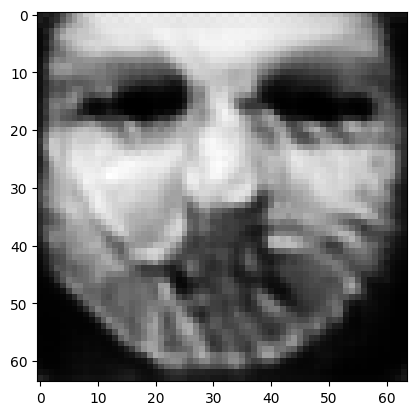

tensor([[3.9551e-04, 1.7540e-04, 2.0176e-03, 3.6936e-04, 9.6139e-01, 9.6493e-05,
         2.5375e-04, 3.6940e-04, 1.4278e-04, 7.8741e-06, 3.1806e-06, 1.4348e-05,
         1.5312e-03, 5.4744e-04, 4.8163e-05, 6.7344e-06, 8.4766e-04, 3.7733e-03,
         4.2429e-05, 1.4850e-04, 1.6643e-04, 5.2982e-05, 8.7568e-04, 2.3056e-05,
         1.3667e-02, 4.1798e-05, 2.7060e-04, 3.2190e-04, 2.5169e-05, 1.9804e-05,
         8.3532e-05, 2.4427e-04, 1.5265e-03, 3.3843e-04, 2.2154e-03, 7.6403e-04,
         7.6450e-04, 4.3827e-04, 5.6976e-03, 2.8196e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039375752210617065
tensor([[3.9542e-04, 1.7537e-04, 2.0169e-03, 3.6929e-04, 9.6140e-01, 9.6468e-05,
         2.5367e-04, 3.6932e-04, 1.4276e-04, 7.8725e-06, 3.1794e-06, 1.4344e-05,
         1.5308e-03, 5.4728e-04, 4.8143e-05, 6.7321e-06, 8.4742e-04, 3.7720e-03,
         4.2416e-05, 1.4846e-04, 1.6637e-04, 5.2970e-05, 8.7535e-04, 2.3049e-05,
         1.3665e-02, 4.1792e-05, 2.7052e-

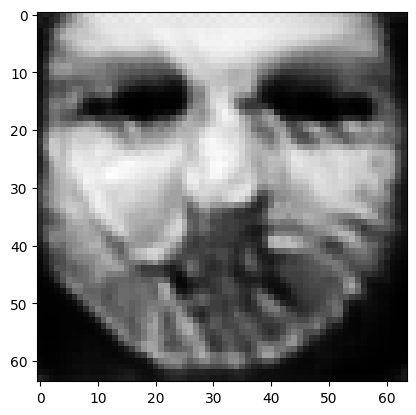

tensor([[3.9508e-04, 1.7525e-04, 2.0139e-03, 3.6904e-04, 9.6143e-01, 9.6373e-05,
         2.5338e-04, 3.6900e-04, 1.4268e-04, 7.8666e-06, 3.1745e-06, 1.4327e-05,
         1.5293e-03, 5.4664e-04, 4.8061e-05, 6.7235e-06, 8.4644e-04, 3.7669e-03,
         4.2367e-05, 1.4833e-04, 1.6614e-04, 5.2920e-05, 8.7397e-04, 2.3023e-05,
         1.3658e-02, 4.1770e-05, 2.7020e-04, 3.2159e-04, 2.5115e-05, 1.9784e-05,
         8.3438e-05, 2.4384e-04, 1.5238e-03, 3.3792e-04, 2.2131e-03, 7.6335e-04,
         7.6295e-04, 4.3780e-04, 5.6926e-03, 2.8162e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039330825209617615
tensor([[3.9499e-04, 1.7523e-04, 2.0132e-03, 3.6898e-04, 9.6144e-01, 9.6349e-05,
         2.5331e-04, 3.6891e-04, 1.4266e-04, 7.8649e-06, 3.1732e-06, 1.4323e-05,
         1.5289e-03, 5.4649e-04, 4.8043e-05, 6.7214e-06, 8.4620e-04, 3.7656e-03,
         4.2354e-05, 1.4830e-04, 1.6609e-04, 5.2908e-05, 8.7368e-04, 2.3016e-05,
         1.3656e-02, 4.1765e-05, 2.7012e-

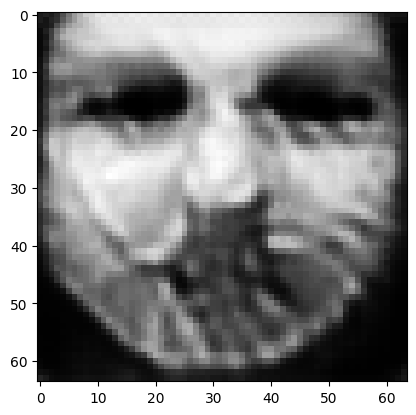

tensor([[3.9467e-04, 1.7512e-04, 2.0104e-03, 3.6875e-04, 9.6147e-01, 9.6257e-05,
         2.5303e-04, 3.6860e-04, 1.4259e-04, 7.8591e-06, 3.1686e-06, 1.4307e-05,
         1.5275e-03, 5.4590e-04, 4.7966e-05, 6.7132e-06, 8.4528e-04, 3.7608e-03,
         4.2308e-05, 1.4817e-04, 1.6587e-04, 5.2862e-05, 8.7242e-04, 2.2991e-05,
         1.3649e-02, 4.1745e-05, 2.6982e-04, 3.2129e-04, 2.5064e-05, 1.9765e-05,
         8.3350e-05, 2.4343e-04, 1.5213e-03, 3.3743e-04, 2.2108e-03, 7.6273e-04,
         7.6152e-04, 4.3737e-04, 5.6877e-03, 2.8129e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03928830102086067
tensor([[3.9460e-04, 1.7509e-04, 2.0098e-03, 3.6870e-04, 9.6148e-01, 9.6238e-05,
         2.5297e-04, 3.6853e-04, 1.4257e-04, 7.8581e-06, 3.1674e-06, 1.4303e-05,
         1.5271e-03, 5.4574e-04, 4.7946e-05, 6.7112e-06, 8.4503e-04, 3.7596e-03,
         4.2295e-05, 1.4814e-04, 1.6582e-04, 5.2849e-05, 8.7203e-04, 2.2985e-05,
         1.3647e-02, 4.1738e-05, 2.6975e-0

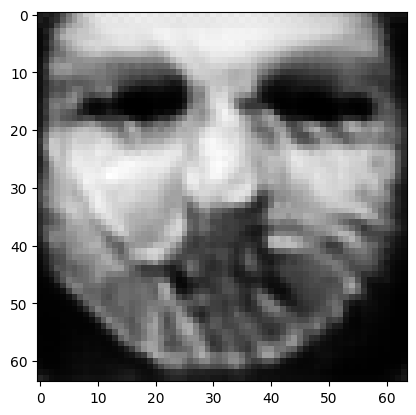

tensor([[3.9424e-04, 1.7498e-04, 2.0070e-03, 3.6847e-04, 9.6151e-01, 9.6135e-05,
         2.5266e-04, 3.6821e-04, 1.4249e-04, 7.8511e-06, 3.1629e-06, 1.4287e-05,
         1.5257e-03, 5.4525e-04, 4.7875e-05, 6.7031e-06, 8.4427e-04, 3.7546e-03,
         4.2252e-05, 1.4800e-04, 1.6562e-04, 5.2807e-05, 8.7111e-04, 2.2962e-05,
         1.3641e-02, 4.1724e-05, 2.6942e-04, 3.2099e-04, 2.5013e-05, 1.9747e-05,
         8.3268e-05, 2.4305e-04, 1.5188e-03, 3.3696e-04, 2.2088e-03, 7.6217e-04,
         7.6024e-04, 4.3696e-04, 5.6827e-03, 2.8096e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03924841433763504
tensor([[3.9418e-04, 1.7496e-04, 2.0064e-03, 3.6843e-04, 9.6152e-01, 9.6116e-05,
         2.5260e-04, 3.6814e-04, 1.4247e-04, 7.8500e-06, 3.1618e-06, 1.4283e-05,
         1.5253e-03, 5.4510e-04, 4.7855e-05, 6.7012e-06, 8.4404e-04, 3.7535e-03,
         4.2240e-05, 1.4797e-04, 1.6557e-04, 5.2794e-05, 8.7076e-04, 2.2956e-05,
         1.3639e-02, 4.1718e-05, 2.6935e-0

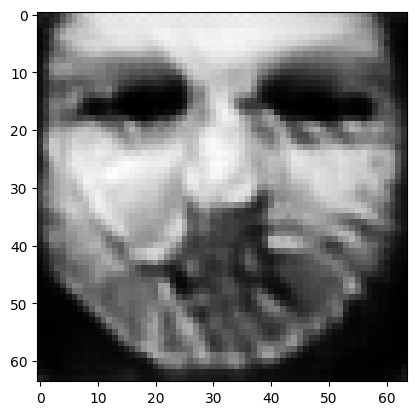

tensor([[3.9388e-04, 1.7486e-04, 2.0039e-03, 3.6821e-04, 9.6155e-01, 9.6033e-05,
         2.5235e-04, 3.6786e-04, 1.4241e-04, 7.8447e-06, 3.1576e-06, 1.4269e-05,
         1.5241e-03, 5.4458e-04, 4.7788e-05, 6.6939e-06, 8.4322e-04, 3.7491e-03,
         4.2199e-05, 1.4785e-04, 1.6537e-04, 5.2754e-05, 8.6970e-04, 2.2933e-05,
         1.3633e-02, 4.1702e-05, 2.6908e-04, 3.2072e-04, 2.4968e-05, 1.9730e-05,
         8.3189e-05, 2.4268e-04, 1.5165e-03, 3.3652e-04, 2.2069e-03, 7.6161e-04,
         7.5896e-04, 4.3658e-04, 5.6784e-03, 2.8068e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03921104967594147
tensor([[3.9380e-04, 1.7484e-04, 2.0032e-03, 3.6816e-04, 9.6155e-01, 9.6010e-05,
         2.5228e-04, 3.6778e-04, 1.4239e-04, 7.8432e-06, 3.1566e-06, 1.4266e-05,
         1.5237e-03, 5.4446e-04, 4.7773e-05, 6.6922e-06, 8.4303e-04, 3.7480e-03,
         4.2188e-05, 1.4782e-04, 1.6533e-04, 5.2744e-05, 8.6948e-04, 2.2928e-05,
         1.3632e-02, 4.1698e-05, 2.6901e-0

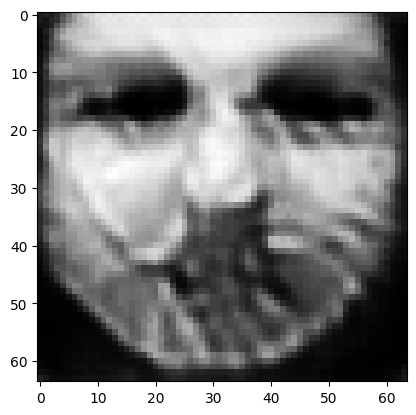

tensor([[3.9352e-04, 1.7474e-04, 2.0009e-03, 3.6797e-04, 9.6158e-01, 9.5933e-05,
         2.5205e-04, 3.6751e-04, 1.4233e-04, 7.8385e-06, 3.1526e-06, 1.4252e-05,
         1.5225e-03, 5.4395e-04, 4.7706e-05, 6.6851e-06, 8.4223e-04, 3.7438e-03,
         4.2148e-05, 1.4771e-04, 1.6514e-04, 5.2704e-05, 8.6836e-04, 2.2906e-05,
         1.3626e-02, 4.1680e-05, 2.6876e-04, 3.2046e-04, 2.4924e-05, 1.9714e-05,
         8.3113e-05, 2.4234e-04, 1.5143e-03, 3.3611e-04, 2.2050e-03, 7.6109e-04,
         7.5775e-04, 4.3622e-04, 5.6742e-03, 2.8041e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03917505592107773
tensor([[3.9345e-04, 1.7472e-04, 2.0002e-03, 3.6791e-04, 9.6159e-01, 9.5911e-05,
         2.5198e-04, 3.6743e-04, 1.4231e-04, 7.8369e-06, 3.1516e-06, 1.4249e-05,
         1.5222e-03, 5.4384e-04, 4.7691e-05, 6.6834e-06, 8.4205e-04, 3.7428e-03,
         4.2138e-05, 1.4769e-04, 1.6510e-04, 5.2695e-05, 8.6817e-04, 2.2901e-05,
         1.3624e-02, 4.1676e-05, 2.6870e-0

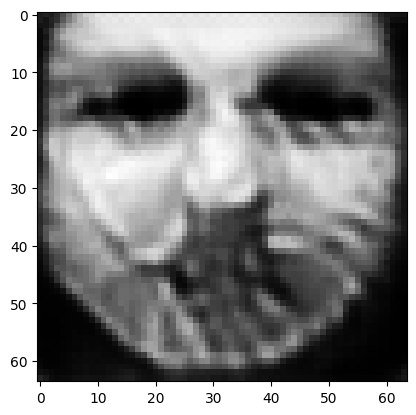

tensor([[3.9318e-04, 1.7463e-04, 1.9980e-03, 3.6772e-04, 9.6162e-01, 9.5836e-05,
         2.5176e-04, 3.6717e-04, 1.4226e-04, 7.8322e-06, 3.1479e-06, 1.4237e-05,
         1.5210e-03, 5.4336e-04, 4.7631e-05, 6.6768e-06, 8.4130e-04, 3.7389e-03,
         4.2101e-05, 1.4759e-04, 1.6493e-04, 5.2659e-05, 8.6717e-04, 2.2881e-05,
         1.3618e-02, 4.1660e-05, 2.6846e-04, 3.2020e-04, 2.4882e-05, 1.9699e-05,
         8.3044e-05, 2.4203e-04, 1.5122e-03, 3.3572e-04, 2.2033e-03, 7.6066e-04,
         7.5663e-04, 4.3588e-04, 5.6703e-03, 2.8014e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03914089500904083
tensor([[3.9312e-04, 1.7461e-04, 1.9974e-03, 3.6769e-04, 9.6162e-01, 9.5819e-05,
         2.5170e-04, 3.6711e-04, 1.4224e-04, 7.8312e-06, 3.1469e-06, 1.4233e-05,
         1.5207e-03, 5.4324e-04, 4.7615e-05, 6.6752e-06, 8.4110e-04, 3.7379e-03,
         4.2091e-05, 1.4756e-04, 1.6488e-04, 5.2649e-05, 8.6688e-04, 2.2876e-05,
         1.3617e-02, 4.1655e-05, 2.6841e-0

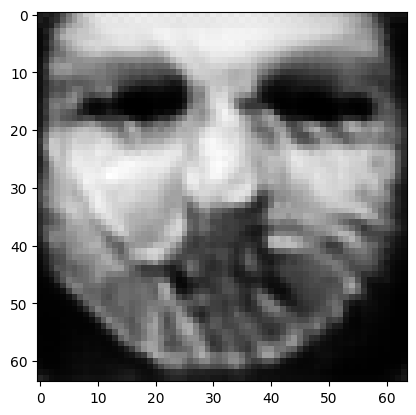

tensor([[3.9287e-04, 1.7452e-04, 1.9953e-03, 3.6750e-04, 9.6165e-01, 9.5748e-05,
         2.5149e-04, 3.6687e-04, 1.4219e-04, 7.8268e-06, 3.1434e-06, 1.4222e-05,
         1.5196e-03, 5.4279e-04, 4.7558e-05, 6.6689e-06, 8.4040e-04, 3.7341e-03,
         4.2055e-05, 1.4746e-04, 1.6472e-04, 5.2614e-05, 8.6595e-04, 2.2857e-05,
         1.3611e-02, 4.1640e-05, 2.6818e-04, 3.1996e-04, 2.4843e-05, 1.9684e-05,
         8.2978e-05, 2.4172e-04, 1.5103e-03, 3.3535e-04, 2.2016e-03, 7.6019e-04,
         7.5554e-04, 4.3555e-04, 5.6667e-03, 2.7989e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03910868242383003
tensor([[3.9281e-04, 1.7450e-04, 1.9947e-03, 3.6746e-04, 9.6165e-01, 9.5729e-05,
         2.5144e-04, 3.6680e-04, 1.4217e-04, 7.8255e-06, 3.1425e-06, 1.4219e-05,
         1.5193e-03, 5.4268e-04, 4.7545e-05, 6.6674e-06, 8.4024e-04, 3.7332e-03,
         4.2047e-05, 1.4744e-04, 1.6468e-04, 5.2606e-05, 8.6575e-04, 2.2852e-05,
         1.3610e-02, 4.1636e-05, 2.6812e-0

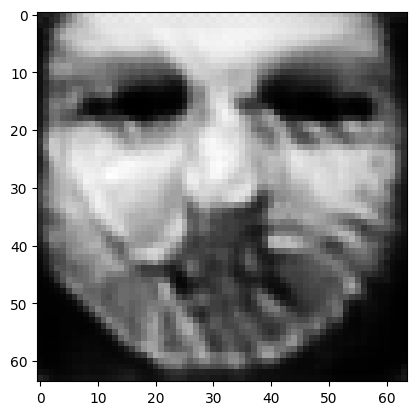

tensor([[3.9257e-04, 1.7442e-04, 1.9927e-03, 3.6730e-04, 9.6168e-01, 9.5664e-05,
         2.5123e-04, 3.6657e-04, 1.4212e-04, 7.8215e-06, 3.1391e-06, 1.4207e-05,
         1.5183e-03, 5.4225e-04, 4.7489e-05, 6.6614e-06, 8.3955e-04, 3.7297e-03,
         4.2012e-05, 1.4735e-04, 1.6453e-04, 5.2572e-05, 8.6480e-04, 2.2834e-05,
         1.3605e-02, 4.1621e-05, 2.6791e-04, 3.1974e-04, 2.4806e-05, 1.9671e-05,
         8.2913e-05, 2.4142e-04, 1.5084e-03, 3.3499e-04, 2.2000e-03, 7.5975e-04,
         7.5451e-04, 4.3524e-04, 5.6631e-03, 2.7965e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03907795995473862
tensor([[3.9251e-04, 1.7440e-04, 1.9922e-03, 3.6725e-04, 9.6168e-01, 9.5647e-05,
         2.5119e-04, 3.6651e-04, 1.4211e-04, 7.8205e-06, 3.1384e-06, 1.4205e-05,
         1.5180e-03, 5.4214e-04, 4.7476e-05, 6.6600e-06, 8.3939e-04, 3.7288e-03,
         4.2004e-05, 1.4732e-04, 1.6449e-04, 5.2564e-05, 8.6459e-04, 2.2829e-05,
         1.3603e-02, 4.1618e-05, 2.6786e-0

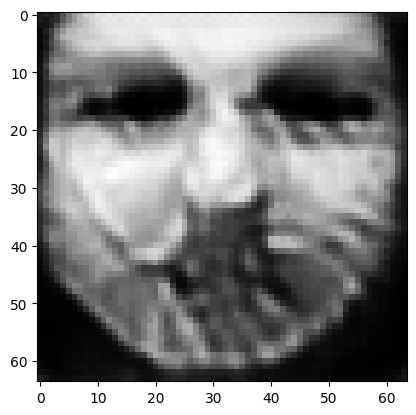

tensor([[3.9229e-04, 1.7433e-04, 1.9903e-03, 3.6710e-04, 9.6170e-01, 9.5585e-05,
         2.5100e-04, 3.6629e-04, 1.4206e-04, 7.8167e-06, 3.1351e-06, 1.4193e-05,
         1.5170e-03, 5.4173e-04, 4.7423e-05, 6.6543e-06, 8.3874e-04, 3.7254e-03,
         4.1972e-05, 1.4724e-04, 1.6434e-04, 5.2532e-05, 8.6369e-04, 2.2812e-05,
         1.3599e-02, 4.1603e-05, 2.6766e-04, 3.1953e-04, 2.4771e-05, 1.9658e-05,
         8.2852e-05, 2.4114e-04, 1.5066e-03, 3.3466e-04, 2.1985e-03, 7.5932e-04,
         7.5351e-04, 4.3494e-04, 5.6599e-03, 2.7943e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03904895484447479
tensor([[3.9223e-04, 1.7431e-04, 1.9899e-03, 3.6706e-04, 9.6171e-01, 9.5568e-05,
         2.5095e-04, 3.6624e-04, 1.4205e-04, 7.8155e-06, 3.1344e-06, 1.4191e-05,
         1.5168e-03, 5.4164e-04, 4.7411e-05, 6.6529e-06, 8.3860e-04, 3.7246e-03,
         4.1964e-05, 1.4722e-04, 1.6430e-04, 5.2525e-05, 8.6352e-04, 2.2808e-05,
         1.3597e-02, 4.1601e-05, 2.6760e-0

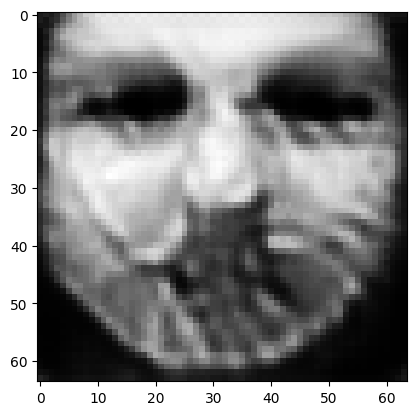

tensor([[3.9202e-04, 1.7424e-04, 1.9880e-03, 3.6690e-04, 9.6173e-01, 9.5507e-05,
         2.5076e-04, 3.6603e-04, 1.4200e-04, 7.8117e-06, 3.1314e-06, 1.4181e-05,
         1.5159e-03, 5.4125e-04, 4.7363e-05, 6.6475e-06, 8.3800e-04, 3.7214e-03,
         4.1934e-05, 1.4713e-04, 1.6417e-04, 5.2495e-05, 8.6273e-04, 2.2792e-05,
         1.3593e-02, 4.1588e-05, 2.6741e-04, 3.1932e-04, 2.4737e-05, 1.9645e-05,
         8.2799e-05, 2.4089e-04, 1.5050e-03, 3.3434e-04, 2.1971e-03, 7.5895e-04,
         7.5261e-04, 4.3466e-04, 5.6567e-03, 2.7921e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039021555334329605
tensor([[3.9197e-04, 1.7422e-04, 1.9877e-03, 3.6688e-04, 9.6174e-01, 9.5495e-05,
         2.5072e-04, 3.6599e-04, 1.4199e-04, 7.8111e-06, 3.1307e-06, 1.4178e-05,
         1.5156e-03, 5.4116e-04, 4.7350e-05, 6.6462e-06, 8.3785e-04, 3.7207e-03,
         4.1927e-05, 1.4711e-04, 1.6413e-04, 5.2487e-05, 8.6248e-04, 2.2788e-05,
         1.3591e-02, 4.1584e-05, 2.6736e-

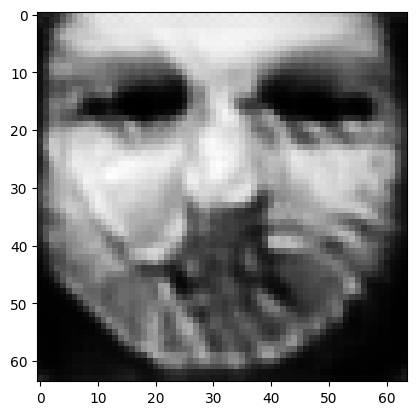

tensor([[3.9177e-04, 1.7415e-04, 1.9859e-03, 3.6673e-04, 9.6176e-01, 9.5439e-05,
         2.5055e-04, 3.6579e-04, 1.4194e-04, 7.8075e-06, 3.1279e-06, 1.4168e-05,
         1.5148e-03, 5.4080e-04, 4.7305e-05, 6.6412e-06, 8.3728e-04, 3.7177e-03,
         4.1898e-05, 1.4704e-04, 1.6400e-04, 5.2459e-05, 8.6173e-04, 2.2772e-05,
         1.3587e-02, 4.1572e-05, 2.6719e-04, 3.1914e-04, 2.4706e-05, 1.9634e-05,
         8.2745e-05, 2.4064e-04, 1.5034e-03, 3.3405e-04, 2.1958e-03, 7.5856e-04,
         7.5172e-04, 4.3439e-04, 5.6538e-03, 2.7901e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0389954149723053
tensor([[3.9172e-04, 1.7414e-04, 1.9855e-03, 3.6670e-04, 9.6176e-01, 9.5424e-05,
         2.5051e-04, 3.6574e-04, 1.4193e-04, 7.8066e-06, 3.1272e-06, 1.4166e-05,
         1.5145e-03, 5.4071e-04, 4.7294e-05, 6.6400e-06, 8.3716e-04, 3.7170e-03,
         4.1892e-05, 1.4702e-04, 1.6397e-04, 5.2453e-05, 8.6157e-04, 2.2769e-05,
         1.3586e-02, 4.1569e-05, 2.6714e-04

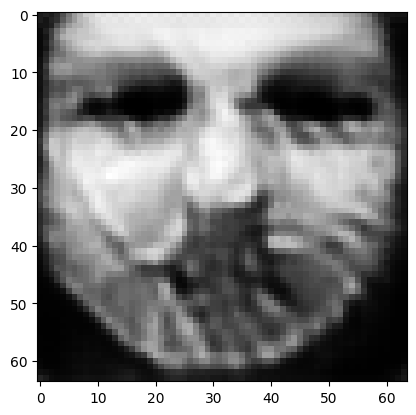

tensor([[3.9153e-04, 1.7407e-04, 1.9840e-03, 3.6657e-04, 9.6178e-01, 9.5373e-05,
         2.5035e-04, 3.6556e-04, 1.4189e-04, 7.8035e-06, 3.1245e-06, 1.4157e-05,
         1.5137e-03, 5.4036e-04, 4.7249e-05, 6.6351e-06, 8.3661e-04, 3.7141e-03,
         4.1864e-05, 1.4694e-04, 1.6384e-04, 5.2425e-05, 8.6079e-04, 2.2754e-05,
         1.3581e-02, 4.1557e-05, 2.6697e-04, 3.1897e-04, 2.4677e-05, 1.9623e-05,
         8.2695e-05, 2.4040e-04, 1.5019e-03, 3.3377e-04, 2.1945e-03, 7.5818e-04,
         7.5088e-04, 4.3414e-04, 5.6511e-03, 2.7882e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03897088021039963
tensor([[3.9148e-04, 1.7406e-04, 1.9835e-03, 3.6653e-04, 9.6178e-01, 9.5359e-05,
         2.5031e-04, 3.6551e-04, 1.4188e-04, 7.8025e-06, 3.1239e-06, 1.4154e-05,
         1.5135e-03, 5.4028e-04, 4.7239e-05, 6.6340e-06, 8.3648e-04, 3.7134e-03,
         4.1858e-05, 1.4693e-04, 1.6381e-04, 5.2419e-05, 8.6064e-04, 2.2751e-05,
         1.3580e-02, 4.1554e-05, 2.6693e-0

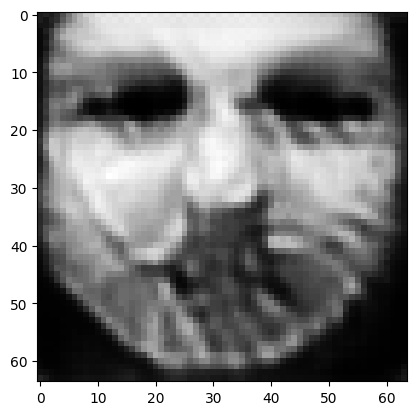

tensor([[3.9130e-04, 1.7400e-04, 1.9820e-03, 3.6640e-04, 9.6180e-01, 9.5309e-05,
         2.5016e-04, 3.6534e-04, 1.4184e-04, 7.7994e-06, 3.1214e-06, 1.4146e-05,
         1.5127e-03, 5.3995e-04, 4.7198e-05, 6.6294e-06, 8.3597e-04, 3.7107e-03,
         4.1832e-05, 1.4686e-04, 1.6369e-04, 5.2394e-05, 8.5993e-04, 2.2737e-05,
         1.3576e-02, 4.1543e-05, 2.6676e-04, 3.1880e-04, 2.4649e-05, 1.9612e-05,
         8.2647e-05, 2.4018e-04, 1.5004e-03, 3.3350e-04, 2.1933e-03, 7.5785e-04,
         7.5010e-04, 4.3390e-04, 5.6484e-03, 2.7864e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03894725814461708
tensor([[3.9126e-04, 1.7398e-04, 1.9816e-03, 3.6637e-04, 9.6181e-01, 9.5296e-05,
         2.5012e-04, 3.6529e-04, 1.4183e-04, 7.7986e-06, 3.1208e-06, 1.4144e-05,
         1.5125e-03, 5.3987e-04, 4.7188e-05, 6.6283e-06, 8.3585e-04, 3.7101e-03,
         4.1826e-05, 1.4684e-04, 1.6366e-04, 5.2387e-05, 8.5977e-04, 2.2734e-05,
         1.3575e-02, 4.1540e-05, 2.6672e-0

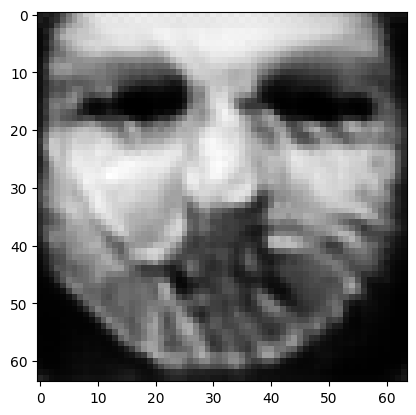

tensor([[3.9110e-04, 1.7392e-04, 1.9802e-03, 3.6626e-04, 9.6182e-01, 9.5254e-05,
         2.4999e-04, 3.6515e-04, 1.4179e-04, 7.7961e-06, 3.1184e-06, 1.4135e-05,
         1.5117e-03, 5.3953e-04, 4.7147e-05, 6.6240e-06, 8.3535e-04, 3.7076e-03,
         4.1801e-05, 1.4678e-04, 1.6354e-04, 5.2361e-05, 8.5900e-04, 2.2721e-05,
         1.3571e-02, 4.1528e-05, 2.6657e-04, 3.1865e-04, 2.4623e-05, 1.9602e-05,
         8.2598e-05, 2.3995e-04, 1.4990e-03, 3.3324e-04, 2.1921e-03, 7.5748e-04,
         7.4929e-04, 4.3366e-04, 5.6460e-03, 2.7847e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03892490267753601
tensor([[3.9106e-04, 1.7391e-04, 1.9798e-03, 3.6623e-04, 9.6183e-01, 9.5242e-05,
         2.4995e-04, 3.6510e-04, 1.4179e-04, 7.7952e-06, 3.1178e-06, 1.4133e-05,
         1.5115e-03, 5.3946e-04, 4.7138e-05, 6.6230e-06, 8.3524e-04, 3.7069e-03,
         4.1796e-05, 1.4677e-04, 1.6352e-04, 5.2356e-05, 8.5886e-04, 2.2718e-05,
         1.3570e-02, 4.1526e-05, 2.6653e-0

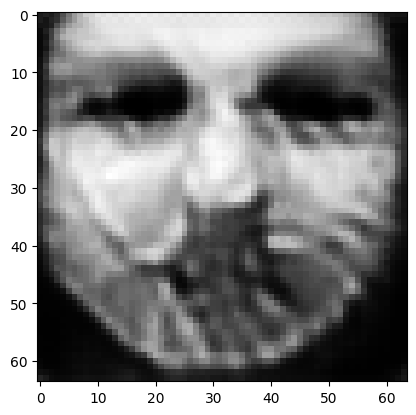

tensor([[3.9091e-04, 1.7385e-04, 1.9785e-03, 3.6612e-04, 9.6184e-01, 9.5201e-05,
         2.4983e-04, 3.6496e-04, 1.4175e-04, 7.7927e-06, 3.1157e-06, 1.4125e-05,
         1.5108e-03, 5.3914e-04, 4.7101e-05, 6.6190e-06, 8.3477e-04, 3.7047e-03,
         4.1773e-05, 1.4671e-04, 1.6340e-04, 5.2332e-05, 8.5814e-04, 2.2706e-05,
         1.3567e-02, 4.1513e-05, 2.6639e-04, 3.1851e-04, 2.4599e-05, 1.9593e-05,
         8.2551e-05, 2.3975e-04, 1.4977e-03, 3.3301e-04, 2.1910e-03, 7.5716e-04,
         7.4855e-04, 4.3344e-04, 5.6437e-03, 2.7831e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03890380635857582
tensor([[3.9087e-04, 1.7384e-04, 1.9782e-03, 3.6609e-04, 9.6185e-01, 9.5189e-05,
         2.4979e-04, 3.6492e-04, 1.4174e-04, 7.7919e-06, 3.1151e-06, 1.4123e-05,
         1.5106e-03, 5.3908e-04, 4.7093e-05, 6.6181e-06, 8.3467e-04, 3.7041e-03,
         4.1767e-05, 1.4669e-04, 1.6338e-04, 5.2326e-05, 8.5801e-04, 2.2703e-05,
         1.3566e-02, 4.1511e-05, 2.6636e-0

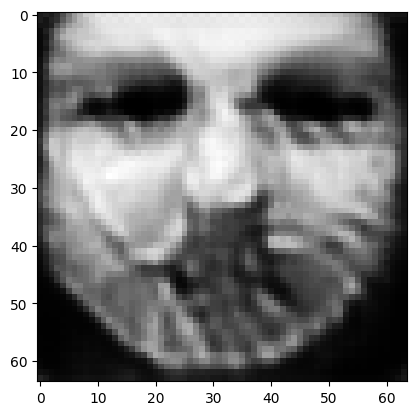

tensor([[3.9073e-04, 1.7379e-04, 1.9769e-03, 3.6598e-04, 9.6186e-01, 9.5150e-05,
         2.4968e-04, 3.6479e-04, 1.4171e-04, 7.7895e-06, 3.1131e-06, 1.4116e-05,
         1.5099e-03, 5.3879e-04, 4.7059e-05, 6.6143e-06, 8.3424e-04, 3.7021e-03,
         4.1746e-05, 1.4664e-04, 1.6328e-04, 5.2304e-05, 8.5735e-04, 2.2692e-05,
         1.3562e-02, 4.1500e-05, 2.6622e-04, 3.1837e-04, 2.4576e-05, 1.9585e-05,
         8.2506e-05, 2.3957e-04, 1.4965e-03, 3.3278e-04, 2.1899e-03, 7.5688e-04,
         7.4787e-04, 4.3323e-04, 5.6414e-03, 2.7815e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03888373821973801
tensor([[3.9070e-04, 1.7378e-04, 1.9766e-03, 3.6595e-04, 9.6187e-01, 9.5140e-05,
         2.4965e-04, 3.6476e-04, 1.4170e-04, 7.7888e-06, 3.1126e-06, 1.4114e-05,
         1.5097e-03, 5.3872e-04, 4.7052e-05, 6.6134e-06, 8.3414e-04, 3.7016e-03,
         4.1741e-05, 1.4663e-04, 1.6325e-04, 5.2299e-05, 8.5721e-04, 2.2689e-05,
         1.3561e-02, 4.1497e-05, 2.6619e-0

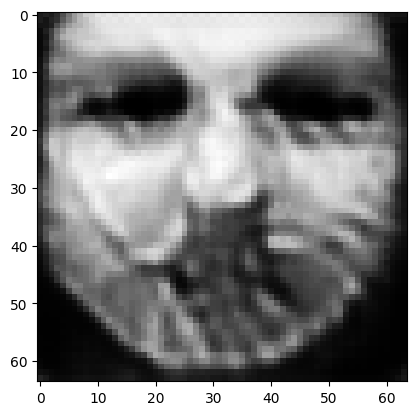

tensor([[3.9055e-04, 1.7372e-04, 1.9754e-03, 3.6586e-04, 9.6188e-01, 9.5098e-05,
         2.4952e-04, 3.6462e-04, 1.4166e-04, 7.7860e-06, 3.1105e-06, 1.4106e-05,
         1.5090e-03, 5.3847e-04, 4.7018e-05, 6.6097e-06, 8.3376e-04, 3.6994e-03,
         4.1720e-05, 1.4657e-04, 1.6316e-04, 5.2278e-05, 8.5665e-04, 2.2678e-05,
         1.3558e-02, 4.1488e-05, 2.6605e-04, 3.1824e-04, 2.4554e-05, 1.9576e-05,
         8.2463e-05, 2.3939e-04, 1.4954e-03, 3.3256e-04, 2.1889e-03, 7.5660e-04,
         7.4724e-04, 4.3303e-04, 5.6391e-03, 2.7799e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03886504843831062
tensor([[3.9052e-04, 1.7371e-04, 1.9751e-03, 3.6583e-04, 9.6188e-01, 9.5088e-05,
         2.4949e-04, 3.6459e-04, 1.4166e-04, 7.7854e-06, 3.1101e-06, 1.4105e-05,
         1.5089e-03, 5.3841e-04, 4.7011e-05, 6.6089e-06, 8.3367e-04, 3.6989e-03,
         4.1716e-05, 1.4655e-04, 1.6313e-04, 5.2273e-05, 8.5652e-04, 2.2676e-05,
         1.3557e-02, 4.1486e-05, 2.6602e-0

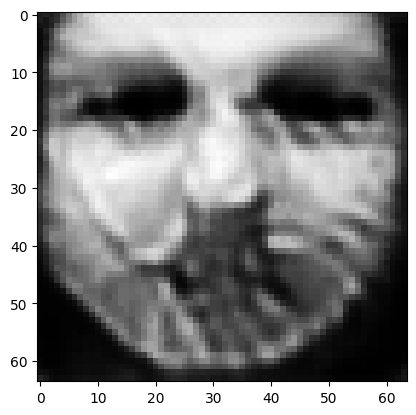

tensor([[3.9040e-04, 1.7367e-04, 1.9740e-03, 3.6574e-04, 9.6190e-01, 9.5054e-05,
         2.4939e-04, 3.6447e-04, 1.4163e-04, 7.7833e-06, 3.1083e-06, 1.4098e-05,
         1.5082e-03, 5.3814e-04, 4.6980e-05, 6.6055e-06, 8.3328e-04, 3.6970e-03,
         4.1696e-05, 1.4651e-04, 1.6304e-04, 5.2252e-05, 8.5589e-04, 2.2666e-05,
         1.3554e-02, 4.1475e-05, 2.6590e-04, 3.1813e-04, 2.4534e-05, 1.9569e-05,
         8.2422e-05, 2.3922e-04, 1.4943e-03, 3.3237e-04, 2.1879e-03, 7.5631e-04,
         7.4660e-04, 4.3284e-04, 5.6372e-03, 2.7786e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0388469323515892
tensor([[3.9036e-04, 1.7365e-04, 1.9737e-03, 3.6571e-04, 9.6190e-01, 9.5045e-05,
         2.4936e-04, 3.6444e-04, 1.4162e-04, 7.7827e-06, 3.1078e-06, 1.4096e-05,
         1.5081e-03, 5.3808e-04, 4.6974e-05, 6.6047e-06, 8.3319e-04, 3.6966e-03,
         4.1691e-05, 1.4649e-04, 1.6302e-04, 5.2247e-05, 8.5577e-04, 2.2663e-05,
         1.3553e-02, 4.1473e-05, 2.6587e-04

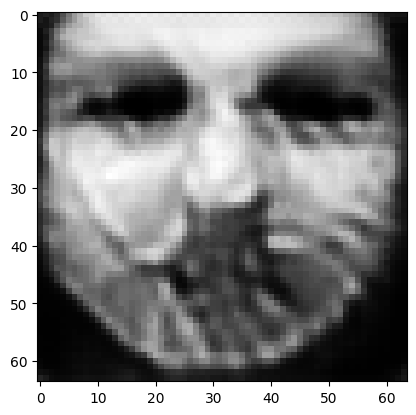

tensor([[3.9025e-04, 1.7361e-04, 1.9726e-03, 3.6562e-04, 9.6191e-01, 9.5013e-05,
         2.4926e-04, 3.6433e-04, 1.4159e-04, 7.7808e-06, 3.1061e-06, 1.4090e-05,
         1.5075e-03, 5.3782e-04, 4.6944e-05, 6.6014e-06, 8.3281e-04, 3.6948e-03,
         4.1673e-05, 1.4645e-04, 1.6293e-04, 5.2228e-05, 8.5517e-04, 2.2653e-05,
         1.3550e-02, 4.1463e-05, 2.6576e-04, 3.1802e-04, 2.4515e-05, 1.9561e-05,
         8.2383e-05, 2.3905e-04, 1.4932e-03, 3.3217e-04, 2.1870e-03, 7.5603e-04,
         7.4600e-04, 4.3266e-04, 5.6354e-03, 2.7773e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03882984444499016
tensor([[3.9022e-04, 1.7360e-04, 1.9723e-03, 3.6560e-04, 9.6192e-01, 9.5004e-05,
         2.4924e-04, 3.6430e-04, 1.4159e-04, 7.7802e-06, 3.1057e-06, 1.4088e-05,
         1.5073e-03, 5.3776e-04, 4.6937e-05, 6.6007e-06, 8.3272e-04, 3.6943e-03,
         4.1668e-05, 1.4644e-04, 1.6291e-04, 5.2223e-05, 8.5504e-04, 2.2651e-05,
         1.3549e-02, 4.1461e-05, 2.6573e-0

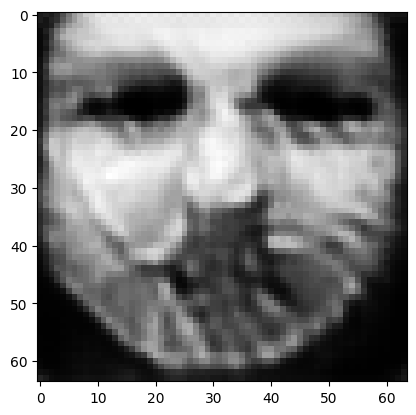

tensor([[3.9011e-04, 1.7355e-04, 1.9714e-03, 3.6551e-04, 9.6193e-01, 9.4975e-05,
         2.4915e-04, 3.6420e-04, 1.4156e-04, 7.7785e-06, 3.1040e-06, 1.4082e-05,
         1.5068e-03, 5.3752e-04, 4.6909e-05, 6.5976e-06, 8.3237e-04, 3.6926e-03,
         4.1651e-05, 1.4640e-04, 1.6282e-04, 5.2204e-05, 8.5448e-04, 2.2642e-05,
         1.3546e-02, 4.1451e-05, 2.6562e-04, 3.1791e-04, 2.4497e-05, 1.9554e-05,
         8.2346e-05, 2.3890e-04, 1.4922e-03, 3.3199e-04, 2.1861e-03, 7.5577e-04,
         7.4541e-04, 4.3248e-04, 5.6337e-03, 2.7760e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03881367668509483
tensor([[3.9008e-04, 1.7354e-04, 1.9711e-03, 3.6549e-04, 9.6193e-01, 9.4966e-05,
         2.4913e-04, 3.6417e-04, 1.4156e-04, 7.7779e-06, 3.1036e-06, 1.4081e-05,
         1.5067e-03, 5.3746e-04, 4.6903e-05, 6.5969e-06, 8.3229e-04, 3.6922e-03,
         4.1647e-05, 1.4639e-04, 1.6280e-04, 5.2200e-05, 8.5437e-04, 2.2640e-05,
         1.3545e-02, 4.1450e-05, 2.6559e-0

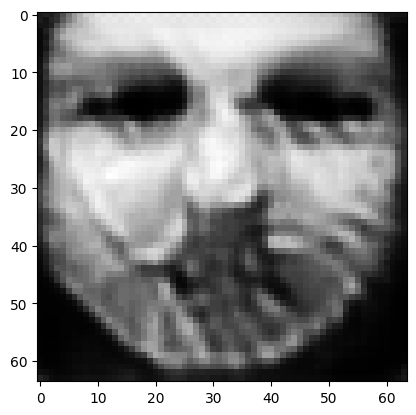

tensor([[3.8996e-04, 1.7350e-04, 1.9701e-03, 3.6541e-04, 9.6194e-01, 9.4933e-05,
         2.4903e-04, 3.6407e-04, 1.4153e-04, 7.7758e-06, 3.1020e-06, 1.4075e-05,
         1.5061e-03, 5.3725e-04, 4.6876e-05, 6.5939e-06, 8.3198e-04, 3.6905e-03,
         4.1630e-05, 1.4634e-04, 1.6272e-04, 5.2183e-05, 8.5389e-04, 2.2631e-05,
         1.3543e-02, 4.1442e-05, 2.6548e-04, 3.1781e-04, 2.4479e-05, 1.9547e-05,
         8.2312e-05, 2.3875e-04, 1.4912e-03, 3.3182e-04, 2.1853e-03, 7.5552e-04,
         7.4489e-04, 4.3231e-04, 5.6319e-03, 2.7748e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03879830986261368
tensor([[3.8993e-04, 1.7349e-04, 1.9699e-03, 3.6539e-04, 9.6195e-01, 9.4925e-05,
         2.4900e-04, 3.6404e-04, 1.4152e-04, 7.7753e-06, 3.1017e-06, 1.4073e-05,
         1.5060e-03, 5.3719e-04, 4.6871e-05, 6.5931e-06, 8.3190e-04, 3.6901e-03,
         4.1627e-05, 1.4633e-04, 1.6270e-04, 5.2179e-05, 8.5378e-04, 2.2629e-05,
         1.3542e-02, 4.1440e-05, 2.6546e-0

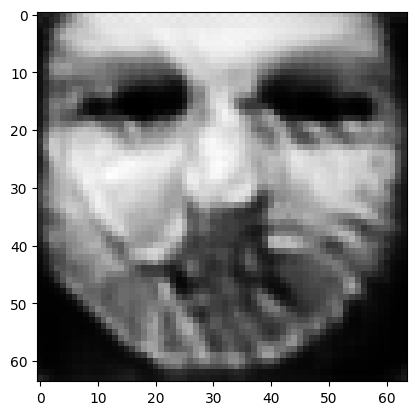

tensor([[3.8983e-04, 1.7345e-04, 1.9690e-03, 3.6531e-04, 9.6196e-01, 9.4898e-05,
         2.4892e-04, 3.6395e-04, 1.4150e-04, 7.7736e-06, 3.1002e-06, 1.4068e-05,
         1.5055e-03, 5.3697e-04, 4.6846e-05, 6.5904e-06, 8.3158e-04, 3.6885e-03,
         4.1611e-05, 1.4629e-04, 1.6263e-04, 5.2162e-05, 8.5329e-04, 2.2621e-05,
         1.3539e-02, 4.1432e-05, 2.6536e-04, 3.1772e-04, 2.4463e-05, 1.9541e-05,
         8.2280e-05, 2.3861e-04, 1.4904e-03, 3.3166e-04, 2.1845e-03, 7.5529e-04,
         7.4437e-04, 4.3215e-04, 5.6304e-03, 2.7737e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03878363221883774
tensor([[3.8981e-04, 1.7344e-04, 1.9688e-03, 3.6529e-04, 9.6196e-01, 9.4892e-05,
         2.4890e-04, 3.6393e-04, 1.4149e-04, 7.7733e-06, 3.0998e-06, 1.4066e-05,
         1.5054e-03, 5.3691e-04, 4.6839e-05, 6.5897e-06, 8.3150e-04, 3.6882e-03,
         4.1607e-05, 1.4628e-04, 1.6261e-04, 5.2158e-05, 8.5314e-04, 2.2618e-05,
         1.3539e-02, 4.1430e-05, 2.6534e-0

In [18]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=4)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.073729991912842


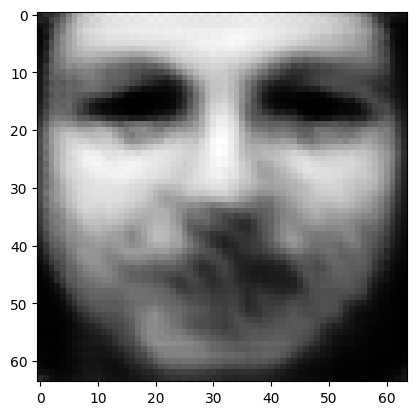

tensor([[0.0059, 0.0026, 0.0186, 0.0120, 0.1421, 0.0025, 0.0061, 0.0057, 0.0031,
         0.0004, 0.0012, 0.0016, 0.0137, 0.0207, 0.0041, 0.0010, 0.0351, 0.0130,
         0.0051, 0.0020, 0.0147, 0.0058, 0.1136, 0.0055, 0.2216, 0.0222, 0.0047,
         0.0076, 0.0049, 0.0139, 0.0048, 0.0061, 0.0229, 0.0229, 0.0134, 0.0289,
         0.1155, 0.0270, 0.0368, 0.0106]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.992345809936523
tensor([[0.0066, 0.0016, 0.0138, 0.0077, 0.1152, 0.0033, 0.0111, 0.0124, 0.0029,
         0.0006, 0.0023, 0.0014, 0.0073, 0.0262, 0.0047, 0.0013, 0.0396, 0.0278,
         0.0050, 0.0023, 0.0115, 0.0034, 0.0366, 0.0089, 0.3330, 0.0177, 0.0036,
         0.0128, 0.0076, 0.0089, 0.0028, 0.0062, 0.0509, 0.0253, 0.0055, 0.0300,
         0.0844, 0.0223, 0.0282, 0.0074]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.712935447692871
tensor([[0.0113, 0.0012, 0.0709, 0.0031, 0.0361, 0.0372, 0.0714, 0.0528, 0.0026,
         0.

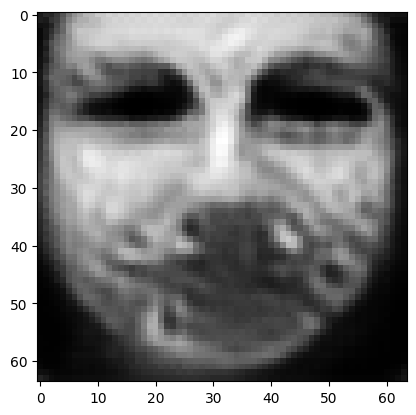

tensor([[1.9331e-03, 2.7814e-04, 1.1281e-01, 2.7275e-04, 1.8118e-03, 7.0415e-01,
         9.4343e-03, 2.7802e-02, 3.2520e-04, 3.5687e-03, 5.3642e-03, 1.4825e-02,
         2.7639e-04, 7.3476e-06, 8.5508e-06, 3.5906e-03, 2.3696e-03, 3.2107e-03,
         9.1231e-04, 4.4215e-03, 4.6776e-04, 6.9702e-04, 1.0164e-05, 1.9547e-04,
         7.2868e-05, 1.6645e-04, 9.8382e-03, 3.3863e-03, 2.3757e-02, 1.2677e-04,
         5.3731e-05, 4.1020e-04, 6.9965e-03, 1.4605e-03, 7.5907e-04, 6.7656e-05,
         5.1096e-04, 1.5507e-03, 2.1409e-03, 4.9960e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3507620096206665
tensor([[2.3444e-03, 2.1987e-04, 7.0046e-02, 1.7534e-04, 1.4445e-03, 8.0174e-01,
         9.2403e-03, 3.6579e-02, 1.1104e-04, 2.0086e-03, 4.8001e-03, 9.9036e-03,
         1.3601e-04, 4.5689e-06, 7.6132e-06, 4.1345e-03, 2.5583e-03, 3.1210e-03,
         7.2473e-04, 2.9986e-03, 2.7005e-04, 4.3153e-04, 5.3028e-06, 3.0968e-04,
         4.8018e-05, 8.9777e-05, 5.7420e-03

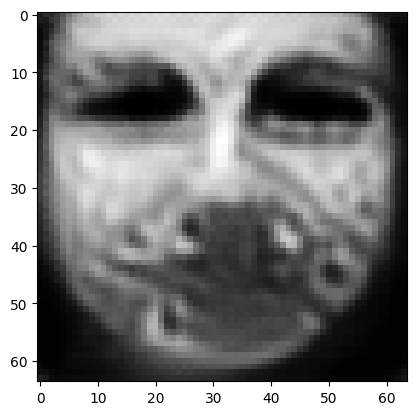

tensor([[1.9280e-03, 1.6870e-04, 4.1685e-02, 1.0091e-04, 9.1681e-04, 8.8320e-01,
         6.2239e-03, 2.0304e-02, 5.0607e-05, 1.0366e-03, 3.0169e-03, 6.1557e-03,
         7.3340e-05, 1.9760e-06, 3.5609e-06, 3.6364e-03, 1.4744e-03, 2.0803e-03,
         4.0529e-04, 1.6618e-03, 1.4963e-04, 2.0630e-04, 2.5572e-06, 1.8162e-04,
         1.7750e-05, 3.7764e-05, 4.0459e-03, 1.9496e-03, 5.6368e-03, 3.1219e-05,
         9.9984e-06, 2.0832e-04, 1.4678e-03, 3.1299e-04, 2.8353e-04, 2.0478e-05,
         1.8927e-04, 3.9658e-04, 3.2543e-04, 1.0408e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.12420918047428131
tensor([[1.8419e-03, 1.5900e-04, 3.9340e-02, 9.2543e-05, 8.5624e-04, 8.9120e-01,
         5.7873e-03, 1.8534e-02, 4.6315e-05, 9.5982e-04, 2.7802e-03, 5.6764e-03,
         6.7127e-05, 1.7208e-06, 3.0953e-06, 3.4346e-03, 1.3265e-03, 1.9034e-03,
         3.6934e-04, 1.5213e-03, 1.3469e-04, 1.8975e-04, 2.2976e-06, 1.6245e-04,
         1.5330e-05, 3.3930e-05, 3.8607e-0

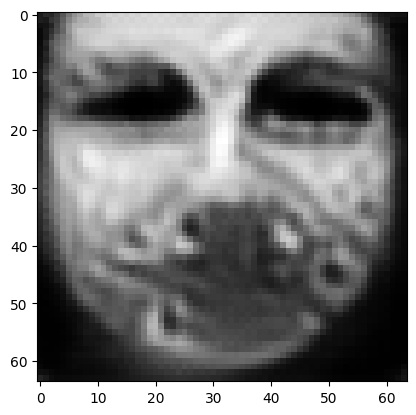

tensor([[1.7630e-03, 1.4281e-04, 3.0597e-02, 7.6321e-05, 7.2545e-04, 9.1214e-01,
         5.2917e-03, 1.4739e-02, 3.4853e-05, 7.6054e-04, 2.3440e-03, 4.7273e-03,
         5.4466e-05, 1.3111e-06, 2.4763e-06, 3.2523e-03, 1.0652e-03, 1.7496e-03,
         3.0222e-04, 1.2856e-03, 1.0829e-04, 1.4563e-04, 1.7581e-06, 1.3626e-04,
         1.1027e-05, 2.3450e-05, 3.5044e-03, 1.5233e-03, 3.5641e-03, 2.1165e-05,
         6.2134e-06, 1.5747e-04, 9.5409e-04, 1.9964e-04, 2.3121e-04, 1.4285e-05,
         1.3802e-04, 2.5731e-04, 1.9915e-04, 7.7458e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09195860475301743
tensor([[1.7362e-03, 1.3851e-04, 2.9093e-02, 7.2852e-05, 6.9921e-04, 9.1593e-01,
         5.1327e-03, 1.4221e-02, 3.2853e-05, 7.2787e-04, 2.2603e-03, 4.5043e-03,
         5.1897e-05, 1.2237e-06, 2.3161e-06, 3.1620e-03, 1.0096e-03, 1.6834e-03,
         2.8655e-04, 1.2279e-03, 1.0190e-04, 1.3763e-04, 1.6427e-06, 1.2993e-04,
         1.0228e-05, 2.1861e-05, 3.4081e-0

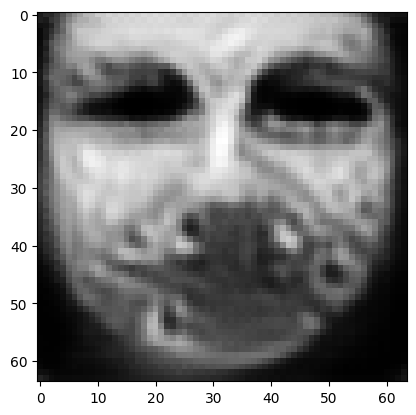

tensor([[1.6504e-03, 1.2526e-04, 2.4820e-02, 6.3331e-05, 6.2684e-04, 9.2749e-01,
         4.6220e-03, 1.2296e-02, 2.6770e-05, 6.1713e-04, 1.9998e-03, 3.7849e-03,
         4.4207e-05, 9.8101e-07, 1.8571e-06, 2.8931e-03, 8.6014e-04, 1.4948e-03,
         2.4179e-04, 1.0500e-03, 8.3819e-05, 1.1250e-04, 1.3349e-06, 1.1108e-04,
         8.0341e-06, 1.7362e-05, 3.0843e-03, 1.2681e-03, 2.5854e-03, 1.6102e-05,
         4.5785e-06, 1.2374e-04, 7.1670e-04, 1.4387e-04, 1.9718e-04, 1.0821e-05,
         1.0884e-04, 1.9418e-04, 1.4366e-04, 6.3616e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07527539134025574
tensor([[1.6405e-03, 1.2337e-04, 2.3960e-02, 6.1885e-05, 6.1441e-04, 9.2957e-01,
         4.5578e-03, 1.1918e-02, 2.5675e-05, 5.9639e-04, 1.9585e-03, 3.6865e-03,
         4.2955e-05, 9.4710e-07, 1.7995e-06, 2.8636e-03, 8.3729e-04, 1.4786e-03,
         2.3510e-04, 1.0234e-03, 8.1304e-05, 1.0758e-04, 1.2826e-06, 1.0813e-04,
         7.6758e-06, 1.6503e-05, 3.0342e-0

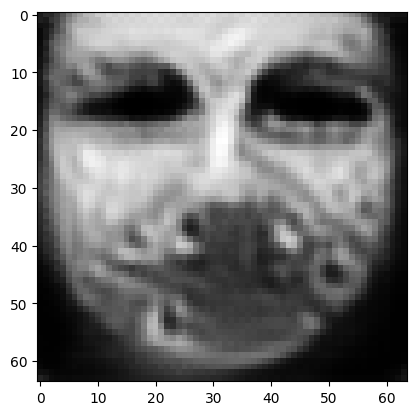

tensor([[1.6213e-03, 1.1436e-04, 2.1331e-02, 5.6283e-05, 5.6954e-04, 9.3639e-01,
         4.3497e-03, 1.0806e-02, 2.2043e-05, 5.2731e-04, 1.7850e-03, 3.2755e-03,
         3.8303e-05, 8.1872e-07, 1.5859e-06, 2.7109e-03, 7.5071e-04, 1.4081e-03,
         2.0946e-04, 9.3349e-04, 7.1224e-05, 9.2442e-05, 1.0962e-06, 9.8340e-05,
         6.5583e-06, 1.3791e-05, 2.8394e-03, 1.1228e-03, 2.0699e-03, 1.3439e-05,
         3.6413e-06, 1.0774e-04, 5.8318e-04, 1.1499e-04, 1.7984e-04, 9.0310e-06,
         9.3718e-05, 1.5918e-04, 1.1410e-04, 5.4036e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06572218239307404
tensor([[1.6204e-03, 1.1218e-04, 2.0726e-02, 5.4885e-05, 5.5876e-04, 9.3791e-01,
         4.3054e-03, 1.0599e-02, 2.1230e-05, 5.1222e-04, 1.7441e-03, 3.1831e-03,
         3.7233e-05, 7.9032e-07, 1.5413e-06, 2.6740e-03, 7.2941e-04, 1.3933e-03,
         2.0333e-04, 9.1385e-04, 6.8939e-05, 8.9103e-05, 1.0514e-06, 9.6437e-05,
         6.3159e-06, 1.3197e-05, 2.7904e-0

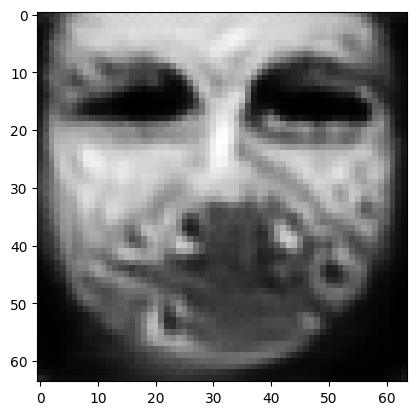

tensor([[1.6199e-03, 1.0369e-04, 1.8479e-02, 4.9606e-05, 5.1566e-04, 9.4363e-01,
         4.1411e-03, 9.7617e-03, 1.8511e-05, 4.5870e-04, 1.5775e-03, 2.7977e-03,
         3.3404e-05, 6.8056e-07, 1.3714e-06, 2.5137e-03, 6.3521e-04, 1.3320e-03,
         1.7982e-04, 8.4252e-04, 5.9849e-05, 7.7290e-05, 8.9070e-07, 8.7622e-05,
         5.3761e-06, 1.1006e-05, 2.6458e-03, 1.0080e-03, 1.6634e-03, 1.1283e-05,
         2.9029e-06, 9.5365e-05, 4.7760e-04, 9.3364e-05, 1.6339e-04, 7.6571e-06,
         7.9186e-05, 1.3015e-04, 9.2695e-05, 4.5992e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05802512168884277
tensor([[1.6225e-03, 1.0220e-04, 1.7937e-02, 4.8416e-05, 5.0406e-04, 9.4488e-01,
         4.1146e-03, 9.5623e-03, 1.7883e-05, 4.4836e-04, 1.5395e-03, 2.7302e-03,
         3.2597e-05, 6.5760e-07, 1.3423e-06, 2.4981e-03, 6.1316e-04, 1.3216e-03,
         1.7522e-04, 8.2754e-04, 5.8067e-05, 7.4796e-05, 8.5335e-07, 8.5730e-05,
         5.1359e-06, 1.0491e-05, 2.6255e-0

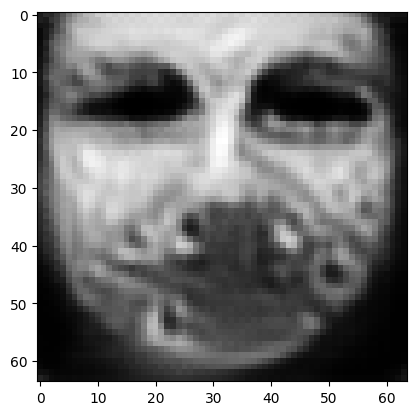

tensor([[1.6403e-03, 9.7375e-05, 1.5920e-02, 4.4486e-05, 4.6956e-04, 9.4917e-01,
         4.0603e-03, 8.9541e-03, 1.5817e-05, 4.1154e-04, 1.4367e-03, 2.5230e-03,
         3.0366e-05, 5.9980e-07, 1.2781e-06, 2.4542e-03, 5.5051e-04, 1.3243e-03,
         1.5938e-04, 7.8992e-04, 5.2918e-05, 6.6549e-05, 7.3702e-07, 8.1539e-05,
         4.4837e-06, 8.8215e-06, 2.5426e-03, 9.2604e-04, 1.3868e-03, 9.7828e-06,
         2.3836e-06, 9.0235e-05, 4.0484e-04, 7.9271e-05, 1.5081e-04, 6.7721e-06,
         6.9636e-05, 1.0888e-04, 7.6289e-05, 3.8772e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05216711759567261
tensor([[1.6356e-03, 9.5914e-05, 1.5588e-02, 4.3627e-05, 4.6306e-04, 9.5002e-01,
         4.0188e-03, 8.8468e-03, 1.5408e-05, 4.0367e-04, 1.4153e-03, 2.4656e-03,
         2.9814e-05, 5.8391e-07, 1.2500e-06, 2.4279e-03, 5.3840e-04, 1.3101e-03,
         1.5561e-04, 7.7845e-04, 5.1503e-05, 6.4874e-05, 7.1420e-07, 8.0172e-05,
         4.3524e-06, 8.5406e-06, 2.5095e-0

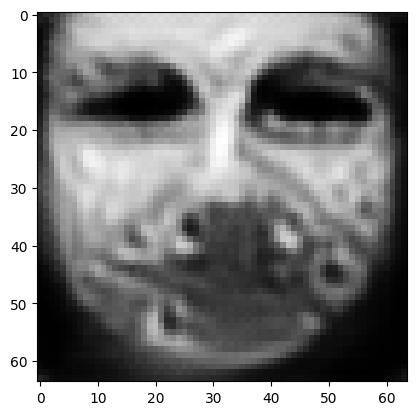

tensor([[1.6311e-03, 9.1450e-05, 1.4322e-02, 4.0878e-05, 4.4062e-04, 9.5299e-01,
         3.9240e-03, 8.4209e-03, 1.3955e-05, 3.7542e-04, 1.3463e-03, 2.2926e-03,
         2.8089e-05, 5.3869e-07, 1.1791e-06, 2.3707e-03, 5.0354e-04, 1.2918e-03,
         1.4396e-04, 7.4816e-04, 4.7323e-05, 5.8779e-05, 6.3754e-07, 7.6286e-05,
         3.9409e-06, 7.5157e-06, 2.4116e-03, 8.6599e-04, 1.2184e-03, 8.6935e-06,
         2.0526e-06, 8.3917e-05, 3.5836e-04, 6.9874e-05, 1.4091e-04, 6.0577e-06,
         6.2435e-05, 9.5367e-05, 6.6090e-05, 3.4363e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04814799875020981
tensor([[1.6306e-03, 9.0233e-05, 1.4083e-02, 4.0271e-05, 4.3650e-04, 9.5363e-01,
         3.9004e-03, 8.3429e-03, 1.3623e-05, 3.6883e-04, 1.3271e-03, 2.2408e-03,
         2.7652e-05, 5.2639e-07, 1.1593e-06, 2.3481e-03, 4.9672e-04, 1.2823e-03,
         1.4137e-04, 7.4002e-04, 4.6217e-05, 5.7451e-05, 6.2088e-07, 7.5472e-05,
         3.8635e-06, 7.3150e-06, 2.3798e-0

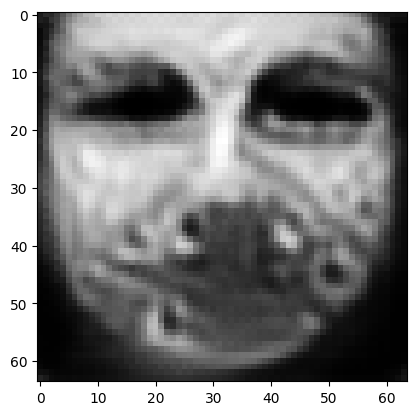

tensor([[1.6185e-03, 8.5916e-05, 1.3256e-02, 3.8093e-05, 4.2182e-04, 9.5591e-01,
         3.7974e-03, 8.0532e-03, 1.2510e-05, 3.4676e-04, 1.2600e-03, 2.0646e-03,
         2.6113e-05, 4.8235e-07, 1.0827e-06, 2.2653e-03, 4.7217e-04, 1.2398e-03,
         1.3209e-04, 7.0937e-04, 4.2361e-05, 5.2815e-05, 5.6368e-07, 7.2158e-05,
         3.5774e-06, 6.6440e-06, 2.2667e-03, 8.1613e-04, 1.0972e-03, 7.8539e-06,
         1.8053e-06, 7.7394e-05, 3.2172e-04, 6.2303e-05, 1.3292e-04, 5.4752e-06,
         5.6577e-05, 8.4805e-05, 5.9340e-05, 3.1250e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04509633034467697
tensor([[1.6141e-03, 8.4871e-05, 1.3067e-02, 3.7570e-05, 4.1832e-04, 9.5642e-01,
         3.7713e-03, 7.9970e-03, 1.2264e-05, 3.4187e-04, 1.2452e-03, 2.0237e-03,
         2.5748e-05, 4.7187e-07, 1.0642e-06, 2.2437e-03, 4.6639e-04, 1.2281e-03,
         1.2990e-04, 7.0204e-04, 4.1455e-05, 5.1761e-05, 5.5049e-07, 7.1352e-05,
         3.5119e-06, 6.4966e-06, 2.2384e-0

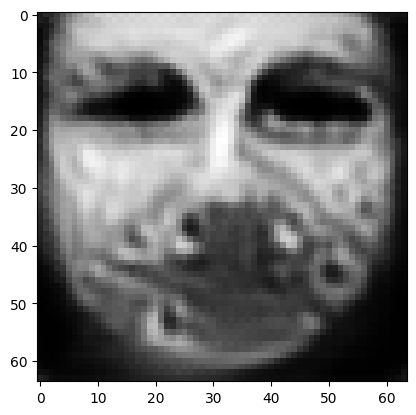

tensor([[1.5941e-03, 8.1238e-05, 1.2363e-02, 3.5650e-05, 4.0411e-04, 9.5839e-01,
         3.6586e-03, 7.7632e-03, 1.1304e-05, 3.2397e-04, 1.1853e-03, 1.8730e-03,
         2.4336e-05, 4.3125e-07, 9.9231e-07, 2.1724e-03, 4.4509e-04, 1.1800e-03,
         1.2191e-04, 6.7293e-04, 3.8065e-05, 4.7698e-05, 5.0005e-07, 6.7926e-05,
         3.2389e-06, 5.9386e-06, 2.1310e-03, 7.7094e-04, 1.0053e-03, 7.1295e-06,
         1.6030e-06, 7.1308e-05, 2.9089e-04, 5.5910e-05, 1.2573e-04, 4.9493e-06,
         5.1474e-05, 7.5845e-05, 5.3815e-05, 2.8893e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04249996691942215
tensor([[1.5848e-03, 8.0311e-05, 1.2226e-02, 3.5223e-05, 4.0091e-04, 9.5885e-01,
         3.6223e-03, 7.6929e-03, 1.1108e-05, 3.2006e-04, 1.1707e-03, 1.8371e-03,
         2.4001e-05, 4.2119e-07, 9.7156e-07, 2.1501e-03, 4.3966e-04, 1.1650e-03,
         1.1999e-04, 6.6475e-04, 3.7232e-05, 4.6789e-05, 4.8931e-07, 6.6825e-05,
         3.1738e-06, 5.8237e-06, 2.1059e-0

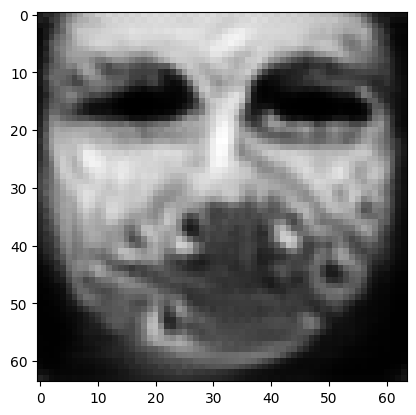

tensor([[1.5550e-03, 7.7317e-05, 1.1669e-02, 3.3708e-05, 3.8899e-04, 9.6056e-01,
         3.4880e-03, 7.4405e-03, 1.0400e-05, 3.0671e-04, 1.1190e-03, 1.7193e-03,
         2.2845e-05, 3.8732e-07, 9.0273e-07, 2.0762e-03, 4.1964e-04, 1.1107e-03,
         1.1323e-04, 6.3565e-04, 3.4431e-05, 4.3592e-05, 4.5009e-07, 6.2988e-05,
         2.9337e-06, 5.4133e-06, 2.0206e-03, 7.2635e-04, 9.3565e-04, 6.5456e-06,
         1.4488e-06, 6.5277e-05, 2.6622e-04, 5.0652e-05, 1.1972e-04, 4.4879e-06,
         4.7319e-05, 6.8630e-05, 4.9563e-05, 2.7428e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04024168848991394
tensor([[1.5495e-03, 7.6731e-05, 1.1536e-02, 3.3392e-05, 3.8622e-04, 9.6094e-01,
         3.4602e-03, 7.3770e-03, 1.0242e-05, 3.0373e-04, 1.1081e-03, 1.6957e-03,
         2.2600e-05, 3.8057e-07, 8.8908e-07, 2.0627e-03, 4.1507e-04, 1.1010e-03,
         1.1178e-04, 6.2945e-04, 3.3857e-05, 4.2847e-05, 4.4155e-07, 6.2141e-05,
         2.8794e-06, 5.3176e-06, 2.0049e-0

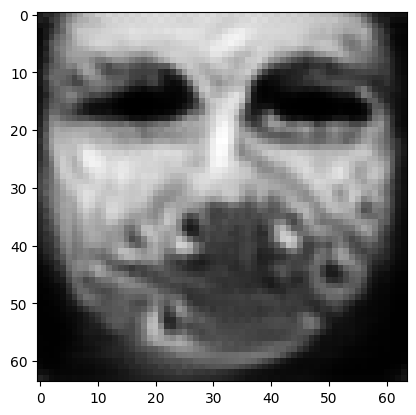

tensor([[1.5347e-03, 7.4198e-05, 1.1070e-02, 3.2176e-05, 3.7789e-04, 9.6234e-01,
         3.3615e-03, 7.1882e-03, 9.6242e-06, 2.9184e-04, 1.0623e-03, 1.5918e-03,
         2.1577e-05, 3.5379e-07, 8.3647e-07, 2.0042e-03, 4.0035e-04, 1.0613e-03,
         1.0651e-04, 6.0435e-04, 3.1541e-05, 4.0112e-05, 4.1043e-07, 5.9538e-05,
         2.7072e-06, 4.9807e-06, 1.9275e-03, 6.9239e-04, 8.7647e-04, 6.0869e-06,
         1.3205e-06, 6.0642e-05, 2.4505e-04, 4.6340e-05, 1.1510e-04, 4.1201e-06,
         4.4147e-05, 6.2817e-05, 4.5939e-05, 2.5999e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03838850185275078
tensor([[1.5314e-03, 7.3606e-05, 1.0958e-02, 3.1897e-05, 3.7572e-04, 9.6267e-01,
         3.3381e-03, 7.1373e-03, 9.4830e-06, 2.8913e-04, 1.0516e-03, 1.5703e-03,
         2.1348e-05, 3.4794e-07, 8.2544e-07, 1.9916e-03, 3.9660e-04, 1.0525e-03,
         1.0536e-04, 5.9864e-04, 3.1047e-05, 3.9513e-05, 4.0346e-07, 5.8918e-05,
         2.6672e-06, 4.9015e-06, 1.9115e-0

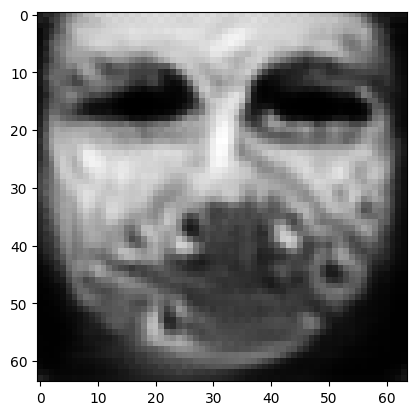

tensor([[1.5185e-03, 7.1116e-05, 1.0503e-02, 3.0779e-05, 3.6688e-04, 9.6400e-01,
         3.2498e-03, 6.9434e-03, 8.9171e-06, 2.7810e-04, 1.0080e-03, 1.4809e-03,
         2.0397e-05, 3.2436e-07, 7.8120e-07, 1.9406e-03, 3.8138e-04, 1.0181e-03,
         1.0062e-04, 5.7529e-04, 2.9038e-05, 3.7030e-05, 3.7503e-07, 5.6458e-05,
         2.5109e-06, 4.5793e-06, 1.8448e-03, 6.6169e-04, 8.2075e-04, 5.6779e-06,
         1.2036e-06, 5.6730e-05, 2.2561e-04, 4.2529e-05, 1.1088e-04, 3.7974e-06,
         4.1402e-05, 5.7436e-05, 4.2554e-05, 2.4590e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036664728075265884
tensor([[1.5152e-03, 7.0517e-05, 1.0393e-02, 3.0487e-05, 3.6454e-04, 9.6431e-01,
         3.2290e-03, 6.9038e-03, 8.7846e-06, 2.7559e-04, 9.9834e-04, 1.4607e-03,
         2.0172e-05, 3.1893e-07, 7.7120e-07, 1.9294e-03, 3.7747e-04, 1.0101e-03,
         9.9472e-05, 5.7004e-04, 2.8561e-05, 3.6488e-05, 3.6824e-07, 5.5924e-05,
         2.4728e-06, 4.5032e-06, 1.8293e-

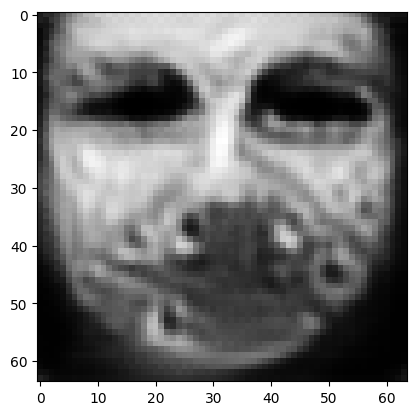

tensor([[1.5041e-03, 6.8503e-05, 9.9570e-03, 2.9492e-05, 3.5497e-04, 9.6550e-01,
         3.1560e-03, 6.7136e-03, 8.2801e-06, 2.6606e-04, 9.6482e-04, 1.3944e-03,
         1.9381e-05, 3.0028e-07, 7.3698e-07, 1.8963e-03, 3.6402e-04, 9.8314e-04,
         9.5514e-05, 5.5113e-04, 2.6985e-05, 3.4467e-05, 3.4327e-07, 5.4009e-05,
         2.3272e-06, 4.2243e-06, 1.7755e-03, 6.3444e-04, 7.7210e-04, 5.3273e-06,
         1.1050e-06, 5.3838e-05, 2.0895e-04, 3.9404e-05, 1.0691e-04, 3.5358e-06,
         3.9064e-05, 5.2928e-05, 3.9444e-05, 2.3191e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03511098399758339
tensor([[1.5010e-03, 6.8061e-05, 9.8568e-03, 2.9274e-05, 3.5276e-04, 9.6577e-01,
         3.1384e-03, 6.6655e-03, 8.1687e-06, 2.6391e-04, 9.5766e-04, 1.3807e-03,
         1.9218e-05, 2.9631e-07, 7.2934e-07, 1.8888e-03, 3.6109e-04, 9.7687e-04,
         9.4630e-05, 5.4681e-04, 2.6652e-05, 3.4025e-05, 3.3776e-07, 5.3565e-05,
         2.2947e-06, 4.1637e-06, 1.7637e-0

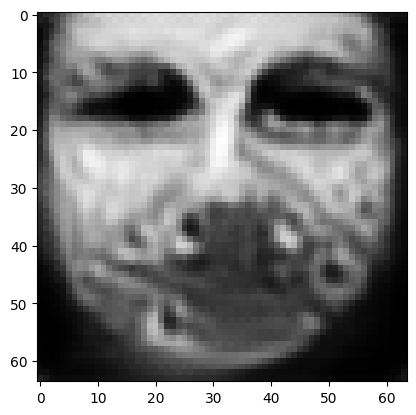

tensor([[1.4866e-03, 6.6597e-05, 9.5107e-03, 2.8565e-05, 3.4501e-04, 9.6680e-01,
         3.0626e-03, 6.4447e-03, 7.7722e-06, 2.5581e-04, 9.3009e-04, 1.3349e-03,
         1.8622e-05, 2.8223e-07, 7.0008e-07, 1.8639e-03, 3.4978e-04, 9.5157e-04,
         9.1656e-05, 5.2906e-04, 2.5516e-05, 3.2416e-05, 3.1925e-07, 5.1660e-05,
         2.1707e-06, 3.9487e-06, 1.7246e-03, 6.0897e-04, 7.3450e-04, 5.0664e-06,
         1.0318e-06, 5.1368e-05, 1.9582e-04, 3.6845e-05, 1.0391e-04, 3.3306e-06,
         3.7372e-05, 4.9346e-05, 3.6822e-05, 2.2164e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03376379609107971
tensor([[1.4763e-03, 6.6172e-05, 9.4659e-03, 2.8414e-05, 3.4350e-04, 9.6703e-01,
         3.0325e-03, 6.3814e-03, 7.7076e-06, 2.5418e-04, 9.2426e-04, 1.3257e-03,
         1.8500e-05, 2.7872e-07, 6.8978e-07, 1.8500e-03, 3.4723e-04, 9.4033e-04,
         9.0920e-05, 5.2355e-04, 2.5259e-05, 3.2114e-05, 3.1582e-07, 5.0977e-05,
         2.1444e-06, 3.9184e-06, 1.7135e-0

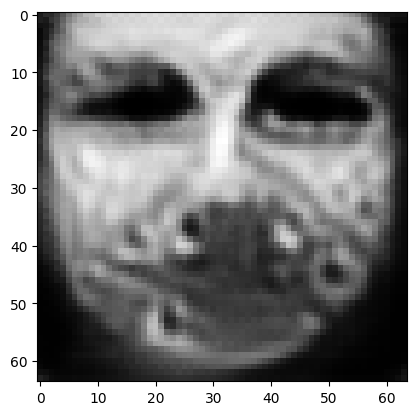

tensor([[1.4542e-03, 6.4737e-05, 9.2302e-03, 2.7831e-05, 3.3758e-04, 9.6788e-01,
         2.9528e-03, 6.1978e-03, 7.4009e-06, 2.4751e-04, 9.0314e-04, 1.2891e-03,
         1.7988e-05, 2.6691e-07, 6.6121e-07, 1.8154e-03, 3.3954e-04, 9.1133e-04,
         8.8501e-05, 5.0677e-04, 2.4339e-05, 3.0824e-05, 3.0120e-07, 4.9267e-05,
         2.0530e-06, 3.7709e-06, 1.6706e-03, 5.8596e-04, 7.0785e-04, 4.8626e-06,
         9.8138e-07, 4.8712e-05, 1.8601e-04, 3.4798e-05, 1.0129e-04, 3.1471e-06,
         3.5964e-05, 4.6669e-05, 3.4872e-05, 2.1581e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032650306820869446
tensor([[1.4482e-03, 6.4383e-05, 9.1772e-03, 2.7692e-05, 3.3623e-04, 9.6807e-01,
         2.9331e-03, 6.1535e-03, 7.3319e-06, 2.4597e-04, 8.9846e-04, 1.2811e-03,
         1.7871e-05, 2.6418e-07, 6.5439e-07, 1.8062e-03, 3.3764e-04, 9.0442e-04,
         8.7901e-05, 5.0280e-04, 2.4124e-05, 3.0511e-05, 2.9772e-07, 4.8834e-05,
         2.0317e-06, 3.7364e-06, 1.6607e-

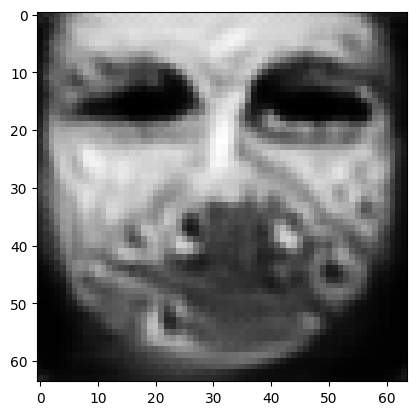

tensor([[1.4264e-03, 6.3104e-05, 8.9864e-03, 2.7210e-05, 3.3106e-04, 9.6880e-01,
         2.8635e-03, 5.9766e-03, 7.0909e-06, 2.4036e-04, 8.8029e-04, 1.2520e-03,
         1.7456e-05, 2.5429e-07, 6.2978e-07, 1.7737e-03, 3.3007e-04, 8.7981e-04,
         8.5722e-05, 4.8857e-04, 2.3344e-05, 2.9398e-05, 2.8547e-07, 4.7126e-05,
         1.9512e-06, 3.6074e-06, 1.6290e-03, 5.6684e-04, 6.8603e-04, 4.6862e-06,
         9.3660e-07, 4.6510e-05, 1.7747e-04, 3.3098e-05, 9.9154e-05, 2.9929e-06,
         3.4707e-05, 4.4385e-05, 3.3190e-05, 2.1086e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0317007414996624
tensor([[1.4218e-03, 6.2793e-05, 8.9417e-03, 2.7092e-05, 3.2979e-04, 9.6896e-01,
         2.8471e-03, 5.9385e-03, 7.0345e-06, 2.3910e-04, 8.7568e-04, 1.2445e-03,
         1.7356e-05, 2.5184e-07, 6.2400e-07, 1.7659e-03, 3.2811e-04, 8.7406e-04,
         8.5206e-05, 4.8521e-04, 2.3150e-05, 2.9140e-05, 2.8254e-07, 4.6718e-05,
         1.9318e-06, 3.5758e-06, 1.6217e-03

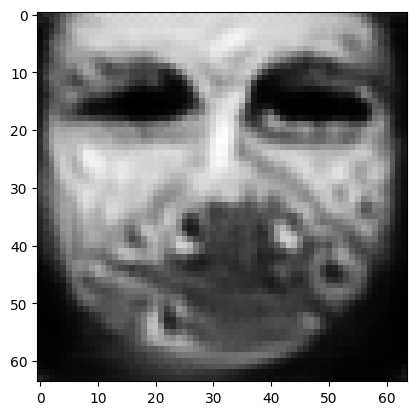

tensor([[1.4048e-03, 6.1580e-05, 8.7785e-03, 2.6624e-05, 3.2518e-04, 9.6957e-01,
         2.7872e-03, 5.8125e-03, 6.8326e-06, 2.3462e-04, 8.5948e-04, 1.2167e-03,
         1.7001e-05, 2.4297e-07, 6.0305e-07, 1.7348e-03, 3.2090e-04, 8.5319e-04,
         8.3162e-05, 4.7319e-04, 2.2424e-05, 2.8229e-05, 2.7166e-07, 4.5290e-05,
         1.8629e-06, 3.4619e-06, 1.5926e-03, 5.5101e-04, 6.6537e-04, 4.5245e-06,
         8.9713e-07, 4.4680e-05, 1.7016e-04, 3.1670e-05, 9.7078e-05, 2.8588e-06,
         3.3531e-05, 4.2442e-05, 3.1817e-05, 2.0623e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030902158468961716
tensor([[1.4016e-03, 6.1295e-05, 8.7359e-03, 2.6511e-05, 3.2408e-04, 9.6971e-01,
         2.7748e-03, 5.7858e-03, 6.7806e-06, 2.3344e-04, 8.5595e-04, 1.2099e-03,
         1.6915e-05, 2.4103e-07, 5.9871e-07, 1.7279e-03, 3.1951e-04, 8.4918e-04,
         8.2686e-05, 4.7058e-04, 2.2257e-05, 2.8002e-05, 2.6898e-07, 4.5014e-05,
         1.8480e-06, 3.4338e-06, 1.5848e-

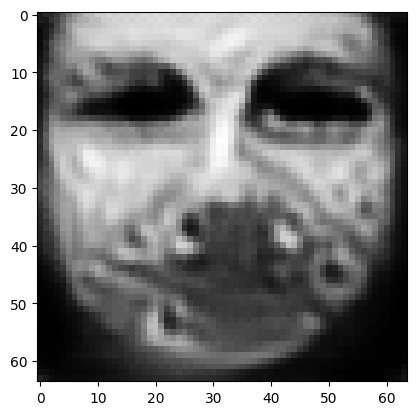

tensor([[1.3877e-03, 6.0145e-05, 8.5895e-03, 2.6068e-05, 3.2030e-04, 9.7026e-01,
         2.7258e-03, 5.6840e-03, 6.5954e-06, 2.2897e-04, 8.4177e-04, 1.1828e-03,
         1.6605e-05, 2.3351e-07, 5.8164e-07, 1.6968e-03, 3.1404e-04, 8.3300e-04,
         8.0824e-05, 4.6061e-04, 2.1600e-05, 2.7204e-05, 2.5932e-07, 4.3952e-05,
         1.7955e-06, 3.3341e-06, 1.5540e-03, 5.3825e-04, 6.4471e-04, 4.3791e-06,
         8.6241e-07, 4.3216e-05, 1.6388e-04, 3.0448e-05, 9.5143e-05, 2.7456e-06,
         3.2530e-05, 4.0819e-05, 3.0649e-05, 2.0080e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030195588245987892
tensor([[1.3853e-03, 5.9877e-05, 8.5519e-03, 2.5962e-05, 3.1941e-04, 9.7038e-01,
         2.7155e-03, 5.6655e-03, 6.5486e-06, 2.2792e-04, 8.3832e-04, 1.1758e-03,
         1.6527e-05, 2.3171e-07, 5.7791e-07, 1.6897e-03, 3.1286e-04, 8.2939e-04,
         8.0403e-05, 4.5836e-04, 2.1442e-05, 2.7008e-05, 2.5692e-07, 4.3737e-05,
         1.7837e-06, 3.3099e-06, 1.5460e-

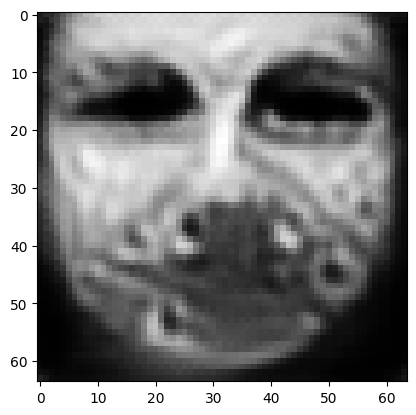

tensor([[1.3757e-03, 5.8866e-05, 8.4110e-03, 2.5563e-05, 3.1592e-04, 9.7086e-01,
         2.6760e-03, 5.5903e-03, 6.3712e-06, 2.2370e-04, 8.2592e-04, 1.1511e-03,
         1.6242e-05, 2.2527e-07, 5.6450e-07, 1.6639e-03, 3.0851e-04, 8.1658e-04,
         7.8781e-05, 4.4989e-04, 2.0879e-05, 2.6281e-05, 2.4806e-07, 4.2945e-05,
         1.7403e-06, 3.2194e-06, 1.5163e-03, 5.2758e-04, 6.2584e-04, 4.2534e-06,
         8.3055e-07, 4.2040e-05, 1.5818e-04, 2.9388e-05, 9.3417e-05, 2.6481e-06,
         3.1669e-05, 3.9355e-05, 2.9598e-05, 1.9503e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029574977234005928
tensor([[1.3736e-03, 5.8633e-05, 8.3759e-03, 2.5470e-05, 3.1502e-04, 9.7097e-01,
         2.6669e-03, 5.5701e-03, 6.3306e-06, 2.2271e-04, 8.2280e-04, 1.1453e-03,
         1.6175e-05, 2.2373e-07, 5.6134e-07, 1.6579e-03, 3.0729e-04, 8.1361e-04,
         7.8400e-05, 4.4793e-04, 2.0749e-05, 2.6112e-05, 2.4600e-07, 4.2742e-05,
         1.7295e-06, 3.1974e-06, 1.5100e-

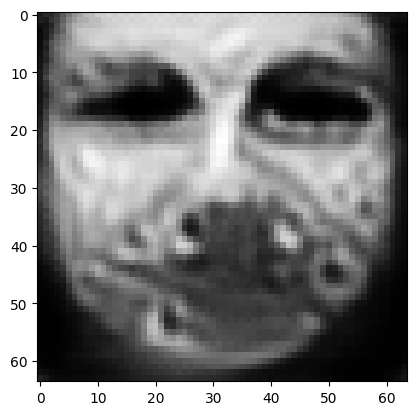

tensor([[1.3618e-03, 5.7761e-05, 8.2538e-03, 2.5157e-05, 3.1177e-04, 9.7142e-01,
         2.6282e-03, 5.4747e-03, 6.1857e-06, 2.1882e-04, 8.1177e-04, 1.1245e-03,
         1.5942e-05, 2.1815e-07, 5.4816e-07, 1.6336e-03, 3.0317e-04, 8.0065e-04,
         7.6997e-05, 4.4008e-04, 2.0279e-05, 2.5482e-05, 2.3893e-07, 4.1858e-05,
         1.6896e-06, 3.1210e-06, 1.4861e-03, 5.1652e-04, 6.0977e-04, 4.1456e-06,
         8.0434e-07, 4.0887e-05, 1.5346e-04, 2.8442e-05, 9.1992e-05, 2.5636e-06,
         3.0934e-05, 3.8074e-05, 2.8693e-05, 1.9077e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028994744643568993
tensor([[1.3594e-03, 5.7560e-05, 8.2227e-03, 2.5082e-05, 3.1094e-04, 9.7153e-01,
         2.6195e-03, 5.4532e-03, 6.1507e-06, 2.1793e-04, 8.0911e-04, 1.1194e-03,
         1.5885e-05, 2.1682e-07, 5.4521e-07, 1.6282e-03, 3.0209e-04, 7.9771e-04,
         7.6665e-05, 4.3830e-04, 2.0165e-05, 2.5329e-05, 2.3718e-07, 4.1651e-05,
         1.6797e-06, 3.1019e-06, 1.4807e-

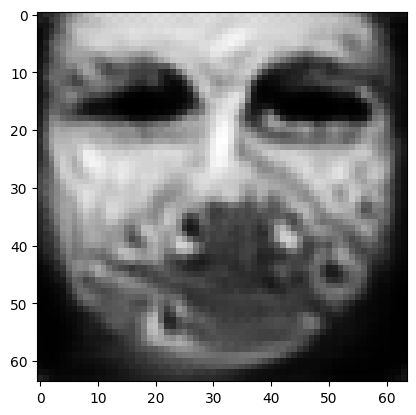

tensor([[1.3496e-03, 5.6775e-05, 8.1095e-03, 2.4802e-05, 3.0791e-04, 9.7193e-01,
         2.5850e-03, 5.3710e-03, 6.0173e-06, 2.1442e-04, 7.9918e-04, 1.1001e-03,
         1.5677e-05, 2.1187e-07, 5.3380e-07, 1.6064e-03, 2.9821e-04, 7.8616e-04,
         7.5378e-05, 4.3117e-04, 1.9737e-05, 2.4765e-05, 2.3076e-07, 4.0871e-05,
         1.6439e-06, 3.0329e-06, 1.4593e-03, 5.0647e-04, 5.9525e-04, 4.0474e-06,
         7.8108e-07, 3.9861e-05, 1.4927e-04, 2.7600e-05, 9.0637e-05, 2.4886e-06,
         3.0281e-05, 3.6937e-05, 2.7882e-05, 1.8686e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028469210490584373
tensor([[1.3481e-03, 5.6608e-05, 8.0792e-03, 2.4741e-05, 3.0719e-04, 9.7203e-01,
         2.5783e-03, 5.3518e-03, 5.9840e-06, 2.1356e-04, 7.9681e-04, 1.0956e-03,
         1.5626e-05, 2.1078e-07, 5.3150e-07, 1.6022e-03, 2.9734e-04, 7.8407e-04,
         7.5100e-05, 4.2964e-04, 1.9644e-05, 2.4622e-05, 2.2922e-07, 4.0710e-05,
         1.6356e-06, 3.0151e-06, 1.4546e-

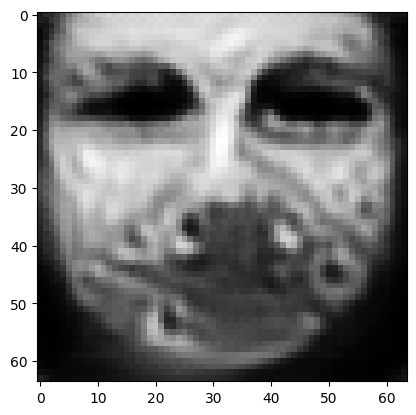

tensor([[1.3405e-03, 5.5949e-05, 7.9737e-03, 2.4494e-05, 3.0442e-04, 9.7239e-01,
         2.5492e-03, 5.2764e-03, 5.8631e-06, 2.1047e-04, 7.8789e-04, 1.0795e-03,
         1.5437e-05, 2.0654e-07, 5.2212e-07, 1.5854e-03, 2.9388e-04, 7.7472e-04,
         7.4010e-05, 4.2344e-04, 1.9291e-05, 2.4105e-05, 2.2345e-07, 4.0058e-05,
         1.6031e-06, 2.9515e-06, 1.4366e-03, 4.9757e-04, 5.8270e-04, 3.9647e-06,
         7.5948e-07, 3.9018e-05, 1.4534e-04, 2.6850e-05, 8.9529e-05, 2.4242e-06,
         2.9724e-05, 3.5901e-05, 2.7120e-05, 1.8311e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028001245111227036
tensor([[1.3388e-03, 5.5782e-05, 7.9471e-03, 2.4425e-05, 3.0367e-04, 9.7247e-01,
         2.5422e-03, 5.2601e-03, 5.8332e-06, 2.0972e-04, 7.8579e-04, 1.0758e-03,
         1.5390e-05, 2.0553e-07, 5.2005e-07, 1.5814e-03, 2.9299e-04, 7.7259e-04,
         7.3727e-05, 4.2200e-04, 1.9205e-05, 2.3983e-05, 2.2196e-07, 3.9915e-05,
         1.5952e-06, 2.9356e-06, 1.4321e-

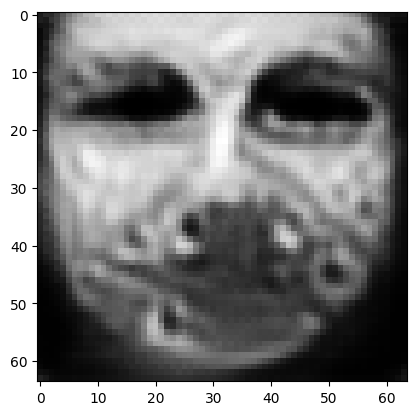

tensor([[1.3335e-03, 5.5159e-05, 7.8388e-03, 2.4168e-05, 3.0085e-04, 9.7281e-01,
         2.5190e-03, 5.1960e-03, 5.7110e-06, 2.0654e-04, 7.7752e-04, 1.0604e-03,
         1.5200e-05, 2.0182e-07, 5.1287e-07, 1.5676e-03, 2.8989e-04, 7.6595e-04,
         7.2653e-05, 4.1662e-04, 1.8878e-05, 2.3492e-05, 2.1625e-07, 3.9426e-05,
         1.5664e-06, 2.8714e-06, 1.4148e-03, 4.8977e-04, 5.7050e-04, 3.8837e-06,
         7.3850e-07, 3.8347e-05, 1.4164e-04, 2.6189e-05, 8.8408e-05, 2.3662e-06,
         2.9201e-05, 3.4929e-05, 2.6397e-05, 1.7885e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02756483480334282
tensor([[1.3314e-03, 5.5001e-05, 7.8141e-03, 2.4114e-05, 3.0020e-04, 9.7290e-01,
         2.5123e-03, 5.1774e-03, 5.6809e-06, 2.0574e-04, 7.7512e-04, 1.0560e-03,
         1.5148e-05, 2.0072e-07, 5.1032e-07, 1.5638e-03, 2.8914e-04, 7.6358e-04,
         7.2394e-05, 4.1498e-04, 1.8788e-05, 2.3353e-05, 2.1491e-07, 3.9250e-05,
         1.5583e-06, 2.8557e-06, 1.4104e-0

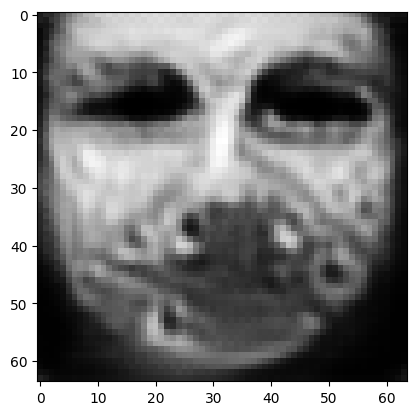

tensor([[1.3233e-03, 5.4388e-05, 7.7201e-03, 2.3895e-05, 2.9763e-04, 9.7322e-01,
         2.4864e-03, 5.1068e-03, 5.5692e-06, 2.0263e-04, 7.6601e-04, 1.0396e-03,
         1.4956e-05, 1.9666e-07, 5.0098e-07, 1.5490e-03, 2.8598e-04, 7.5467e-04,
         7.1363e-05, 4.0889e-04, 1.8449e-05, 2.2844e-05, 2.0983e-07, 3.8579e-05,
         1.5278e-06, 2.7954e-06, 1.3942e-03, 4.8185e-04, 5.6008e-04, 3.8030e-06,
         7.1752e-07, 3.7374e-05, 1.3782e-04, 2.5483e-05, 8.7409e-05, 2.3009e-06,
         2.8646e-05, 3.3914e-05, 2.5714e-05, 1.7598e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02714030258357525
tensor([[1.3218e-03, 5.4257e-05, 7.6961e-03, 2.3847e-05, 2.9701e-04, 9.7330e-01,
         2.4813e-03, 5.0895e-03, 5.5428e-06, 2.0189e-04, 7.6389e-04, 1.0359e-03,
         1.4912e-05, 1.9579e-07, 4.9909e-07, 1.5460e-03, 2.8527e-04, 7.5298e-04,
         7.1141e-05, 4.0761e-04, 1.8375e-05, 2.2726e-05, 2.0865e-07, 3.8439e-05,
         1.5209e-06, 2.7809e-06, 1.3908e-0

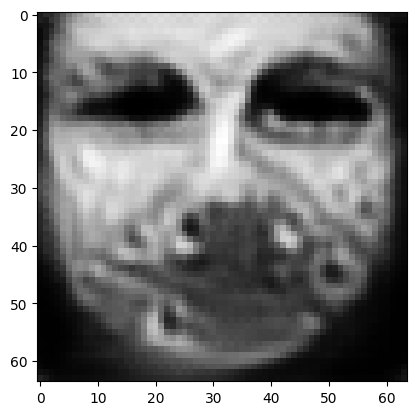

tensor([[1.3135e-03, 5.3663e-05, 7.6109e-03, 2.3645e-05, 2.9461e-04, 9.7361e-01,
         2.4560e-03, 5.0214e-03, 5.4460e-06, 1.9906e-04, 7.5572e-04, 1.0213e-03,
         1.4746e-05, 1.9226e-07, 4.9086e-07, 1.5318e-03, 2.8237e-04, 7.4429e-04,
         7.0188e-05, 4.0194e-04, 1.8079e-05, 2.2290e-05, 2.0424e-07, 3.7844e-05,
         1.4948e-06, 2.7290e-06, 1.3763e-03, 4.7471e-04, 5.5069e-04, 3.7317e-06,
         6.9979e-07, 3.6530e-05, 1.3450e-04, 2.4863e-05, 8.6515e-05, 2.2445e-06,
         2.8180e-05, 3.3036e-05, 2.5119e-05, 1.7334e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026749130338430405
tensor([[1.3114e-03, 5.3511e-05, 7.5918e-03, 2.3595e-05, 2.9403e-04, 9.7368e-01,
         2.4495e-03, 5.0061e-03, 5.4235e-06, 1.9843e-04, 7.5361e-04, 1.0175e-03,
         1.4704e-05, 1.9132e-07, 4.8864e-07, 1.5280e-03, 2.8162e-04, 7.4181e-04,
         6.9956e-05, 4.0052e-04, 1.8001e-05, 2.2188e-05, 2.0316e-07, 3.7689e-05,
         1.4883e-06, 2.7172e-06, 1.3727e-

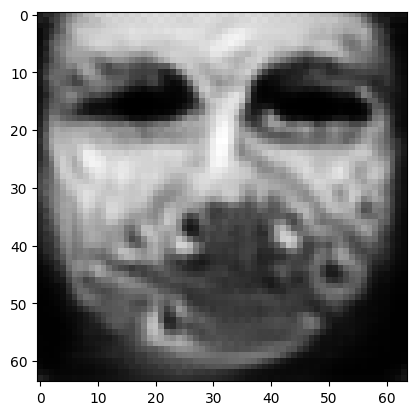

tensor([[1.3041e-03, 5.2975e-05, 7.5156e-03, 2.3404e-05, 2.9176e-04, 9.7395e-01,
         2.4256e-03, 4.9471e-03, 5.3417e-06, 1.9614e-04, 7.4557e-04, 1.0041e-03,
         1.4551e-05, 1.8796e-07, 4.8094e-07, 1.5150e-03, 2.7845e-04, 7.3320e-04,
         6.9079e-05, 3.9545e-04, 1.7727e-05, 2.1819e-05, 1.9919e-07, 3.7118e-05,
         1.4634e-06, 2.6716e-06, 1.3606e-03, 4.6797e-04, 5.4234e-04, 3.6665e-06,
         6.8392e-07, 3.5746e-05, 1.3153e-04, 2.4298e-05, 8.5651e-05, 2.1927e-06,
         2.7727e-05, 3.2241e-05, 2.4607e-05, 1.7131e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026396818459033966
tensor([[1.3027e-03, 5.2859e-05, 7.4961e-03, 2.3359e-05, 2.9117e-04, 9.7401e-01,
         2.4205e-03, 4.9336e-03, 5.3226e-06, 1.9563e-04, 7.4370e-04, 1.0011e-03,
         1.4515e-05, 1.8719e-07, 4.7928e-07, 1.5123e-03, 2.7766e-04, 7.3136e-04,
         6.8882e-05, 3.9437e-04, 1.7665e-05, 2.1731e-05, 1.9823e-07, 3.6986e-05,
         1.4572e-06, 2.6603e-06, 1.3582e-

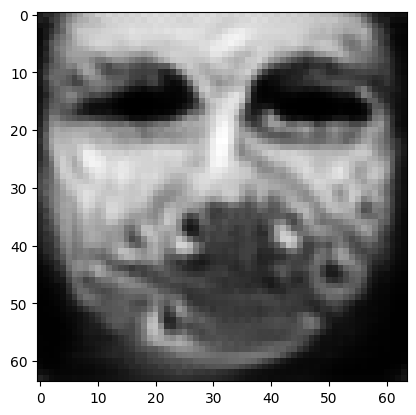

tensor([[1.2966e-03, 5.2362e-05, 7.4279e-03, 2.3173e-05, 2.8893e-04, 9.7425e-01,
         2.3985e-03, 4.8868e-03, 5.2471e-06, 1.9370e-04, 7.3610e-04, 9.8834e-04,
         1.4365e-05, 1.8386e-07, 4.7194e-07, 1.5006e-03, 2.7452e-04, 7.2294e-04,
         6.8066e-05, 3.8960e-04, 1.7399e-05, 2.1395e-05, 1.9440e-07, 3.6450e-05,
         1.4326e-06, 2.6178e-06, 1.3470e-03, 4.6182e-04, 5.3496e-04, 3.6069e-06,
         6.6895e-07, 3.5062e-05, 1.2880e-04, 2.3788e-05, 8.4818e-05, 2.1449e-06,
         2.7286e-05, 3.1508e-05, 2.4140e-05, 1.6949e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026085611432790756
tensor([[1.2957e-03, 5.2255e-05, 7.4088e-03, 2.3127e-05, 2.8837e-04, 9.7431e-01,
         2.3941e-03, 4.8773e-03, 5.2273e-06, 1.9324e-04, 7.3421e-04, 9.8519e-04,
         1.4325e-05, 1.8309e-07, 4.7042e-07, 1.4985e-03, 2.7377e-04, 7.2129e-04,
         6.7884e-05, 3.8858e-04, 1.7335e-05, 2.1307e-05, 1.9342e-07, 3.6337e-05,
         1.4264e-06, 2.6064e-06, 1.3444e-

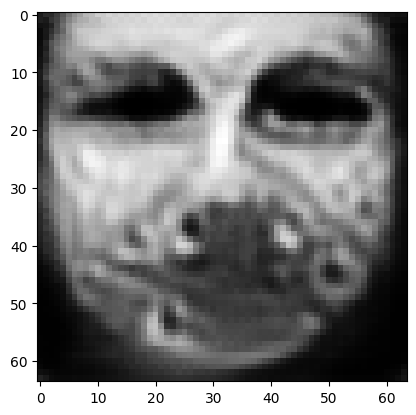

tensor([[1.2905e-03, 5.1841e-05, 7.3411e-03, 2.2956e-05, 2.8618e-04, 9.7453e-01,
         2.3751e-03, 4.8340e-03, 5.1548e-06, 1.9152e-04, 7.2714e-04, 9.7410e-04,
         1.4184e-05, 1.8012e-07, 4.6408e-07, 1.4899e-03, 2.7067e-04, 7.1423e-04,
         6.7168e-05, 3.8434e-04, 1.7098e-05, 2.0992e-05, 1.8985e-07, 3.5849e-05,
         1.4023e-06, 2.5646e-06, 1.3355e-03, 4.5624e-04, 5.2799e-04, 3.5518e-06,
         6.5433e-07, 3.4479e-05, 1.2614e-04, 2.3314e-05, 8.4030e-05, 2.1015e-06,
         2.6874e-05, 3.0813e-05, 2.3684e-05, 1.6770e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025801029056310654
tensor([[1.2902e-03, 5.1751e-05, 7.3212e-03, 2.2912e-05, 2.8562e-04, 9.7458e-01,
         2.3719e-03, 4.8272e-03, 5.1330e-06, 1.9106e-04, 7.2557e-04, 9.7147e-04,
         1.4146e-05, 1.7947e-07, 4.6299e-07, 1.4887e-03, 2.7009e-04, 7.1317e-04,
         6.7017e-05, 3.8345e-04, 1.7043e-05, 2.0907e-05, 1.8889e-07, 3.5773e-05,
         1.3966e-06, 2.5531e-06, 1.3330e-

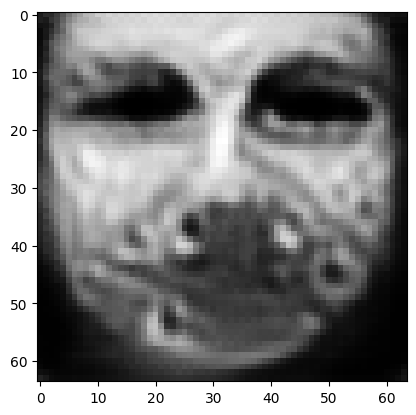

tensor([[1.2868e-03, 5.1411e-05, 7.2508e-03, 2.2760e-05, 2.8351e-04, 9.7478e-01,
         2.3566e-03, 4.7906e-03, 5.0599e-06, 1.8936e-04, 7.1956e-04, 9.6203e-04,
         1.4015e-05, 1.7705e-07, 4.5843e-07, 1.4831e-03, 2.6753e-04, 7.0834e-04,
         6.6414e-05, 3.7984e-04, 1.6842e-05, 2.0601e-05, 1.8553e-07, 3.5394e-05,
         1.3750e-06, 2.5118e-06, 1.3250e-03, 4.5149e-04, 5.2139e-04, 3.5015e-06,
         6.4067e-07, 3.4050e-05, 1.2366e-04, 2.2897e-05, 8.3295e-05, 2.0647e-06,
         2.6529e-05, 3.0179e-05, 2.3227e-05, 1.6544e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025540882721543312
tensor([[1.2861e-03, 5.1337e-05, 7.2327e-03, 2.2728e-05, 2.8302e-04, 9.7483e-01,
         2.3529e-03, 4.7799e-03, 5.0431e-06, 1.8894e-04, 7.1793e-04, 9.5952e-04,
         1.3983e-05, 1.7648e-07, 4.5745e-07, 1.4819e-03, 2.6683e-04, 7.0742e-04,
         6.6273e-05, 3.7899e-04, 1.6793e-05, 2.0518e-05, 1.8471e-07, 3.5289e-05,
         1.3696e-06, 2.5010e-06, 1.3235e-

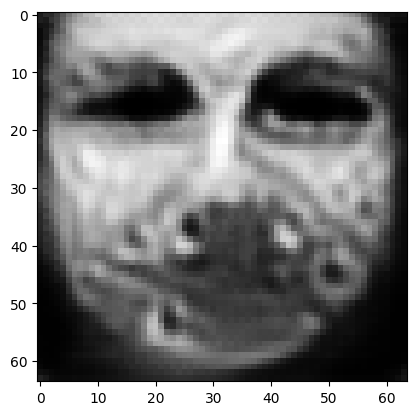

tensor([[1.2821e-03, 5.1043e-05, 7.1678e-03, 2.2607e-05, 2.8121e-04, 9.7503e-01,
         2.3365e-03, 4.7345e-03, 4.9826e-06, 1.8732e-04, 7.1180e-04, 9.5047e-04,
         1.3867e-05, 1.7432e-07, 4.5326e-07, 1.4765e-03, 2.6413e-04, 7.0331e-04,
         6.5710e-05, 3.7549e-04, 1.6612e-05, 2.0209e-05, 1.8174e-07, 3.4850e-05,
         1.3493e-06, 2.4616e-06, 1.3179e-03, 4.4670e-04, 5.1606e-04, 3.4572e-06,
         6.2822e-07, 3.3568e-05, 1.2127e-04, 2.2498e-05, 8.2783e-05, 2.0300e-06,
         2.6205e-05, 2.9564e-05, 2.2809e-05, 1.6388e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025286830961704254
tensor([[1.2813e-03, 5.0973e-05, 7.1518e-03, 2.2580e-05, 2.8080e-04, 9.7508e-01,
         2.3327e-03, 4.7231e-03, 4.9673e-06, 1.8690e-04, 7.1022e-04, 9.4816e-04,
         1.3838e-05, 1.7380e-07, 4.5227e-07, 1.4753e-03, 2.6352e-04, 7.0241e-04,
         6.5580e-05, 3.7464e-04, 1.6568e-05, 2.0131e-05, 1.8103e-07, 3.4747e-05,
         1.3446e-06, 2.4519e-06, 1.3164e-

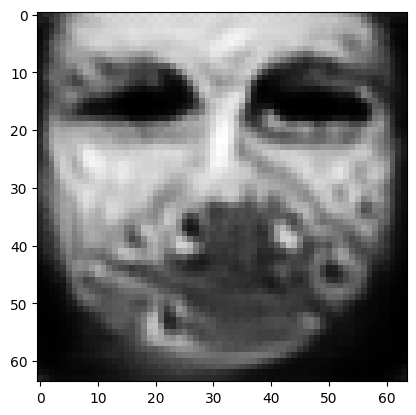

tensor([[1.2775e-03, 5.0696e-05, 7.0916e-03, 2.2470e-05, 2.7918e-04, 9.7527e-01,
         2.3171e-03, 4.6765e-03, 4.9104e-06, 1.8529e-04, 7.0418e-04, 9.3956e-04,
         1.3729e-05, 1.7181e-07, 4.4838e-07, 1.4700e-03, 2.6105e-04, 6.9864e-04,
         6.5046e-05, 3.7131e-04, 1.6402e-05, 1.9838e-05, 1.7829e-07, 3.4334e-05,
         1.3263e-06, 2.4153e-06, 1.3110e-03, 4.4209e-04, 5.1118e-04, 3.4166e-06,
         6.1679e-07, 3.3090e-05, 1.1904e-04, 2.2122e-05, 8.2350e-05, 1.9975e-06,
         2.5914e-05, 2.8987e-05, 2.2419e-05, 1.6247e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025043759495019913
tensor([[1.2765e-03, 5.0627e-05, 7.0779e-03, 2.2443e-05, 2.7883e-04, 9.7531e-01,
         2.3130e-03, 4.6659e-03, 4.8966e-06, 1.8488e-04, 7.0273e-04, 9.3739e-04,
         1.3702e-05, 1.7134e-07, 4.4740e-07, 1.4686e-03, 2.6050e-04, 6.9762e-04,
         6.4913e-05, 3.7048e-04, 1.6361e-05, 1.9768e-05, 1.7765e-07, 3.4238e-05,
         1.3221e-06, 2.4069e-06, 1.3094e-

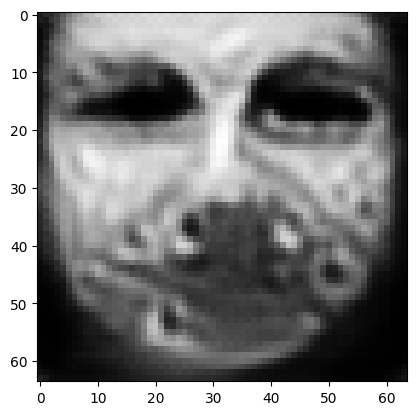

tensor([[1.2733e-03, 5.0358e-05, 7.0212e-03, 2.2341e-05, 2.7744e-04, 9.7549e-01,
         2.2987e-03, 4.6244e-03, 4.8439e-06, 1.8335e-04, 6.9721e-04, 9.2899e-04,
         1.3603e-05, 1.6956e-07, 4.4396e-07, 1.4630e-03, 2.5829e-04, 6.9423e-04,
         6.4400e-05, 3.6753e-04, 1.6205e-05, 1.9500e-05, 1.7513e-07, 3.3883e-05,
         1.3064e-06, 2.3741e-06, 1.3036e-03, 4.3795e-04, 5.0630e-04, 3.3790e-06,
         6.0658e-07, 3.2647e-05, 1.1703e-04, 2.1781e-05, 8.1935e-05, 1.9679e-06,
         2.5643e-05, 2.8467e-05, 2.2068e-05, 1.6106e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024816792458295822
tensor([[1.2722e-03, 5.0289e-05, 7.0088e-03, 2.2316e-05, 2.7711e-04, 9.7553e-01,
         2.2946e-03, 4.6135e-03, 4.8319e-06, 1.8298e-04, 6.9586e-04, 9.2710e-04,
         1.3580e-05, 1.6913e-07, 4.4304e-07, 1.4614e-03, 2.5774e-04, 6.9321e-04,
         6.4266e-05, 3.6674e-04, 1.6168e-05, 1.9438e-05, 1.7454e-07, 3.3789e-05,
         1.3026e-06, 2.3666e-06, 1.3022e-

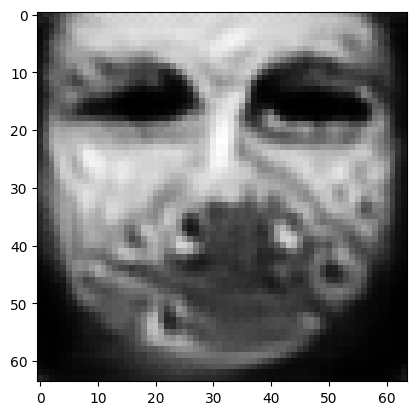

tensor([[1.2694e-03, 5.0048e-05, 6.9544e-03, 2.2229e-05, 2.7577e-04, 9.7570e-01,
         2.2811e-03, 4.5716e-03, 4.7813e-06, 1.8146e-04, 6.9076e-04, 9.1977e-04,
         1.3488e-05, 1.6755e-07, 4.4002e-07, 1.4565e-03, 2.5571e-04, 6.9047e-04,
         6.3795e-05, 3.6387e-04, 1.6029e-05, 1.9175e-05, 1.7214e-07, 3.3448e-05,
         1.2876e-06, 2.3345e-06, 1.2971e-03, 4.3392e-04, 5.0183e-04, 3.3444e-06,
         5.9695e-07, 3.2233e-05, 1.1511e-04, 2.1461e-05, 8.1580e-05, 1.9404e-06,
         2.5398e-05, 2.7979e-05, 2.1723e-05, 1.5969e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024599427357316017
tensor([[1.2690e-03, 5.0000e-05, 6.9394e-03, 2.2206e-05, 2.7538e-04, 9.7574e-01,
         2.2783e-03, 4.5614e-03, 4.7684e-06, 1.8109e-04, 6.8955e-04, 9.1841e-04,
         1.3467e-05, 1.6722e-07, 4.3957e-07, 1.4557e-03, 2.5515e-04, 6.9012e-04,
         6.3684e-05, 3.6325e-04, 1.6000e-05, 1.9113e-05, 1.7152e-07, 3.3377e-05,
         1.2837e-06, 2.3260e-06, 1.2963e-

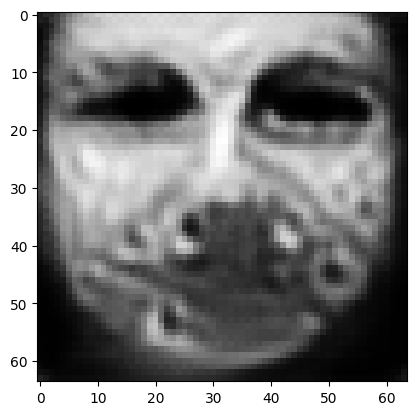

tensor([[1.2672e-03, 4.9785e-05, 6.8875e-03, 2.2129e-05, 2.7417e-04, 9.7590e-01,
         2.2668e-03, 4.5243e-03, 4.7203e-06, 1.7966e-04, 6.8478e-04, 9.1151e-04,
         1.3382e-05, 1.6581e-07, 4.3713e-07, 1.4517e-03, 2.5340e-04, 6.8792e-04,
         6.3270e-05, 3.6070e-04, 1.5875e-05, 1.8877e-05, 1.6934e-07, 3.3097e-05,
         1.2706e-06, 2.2967e-06, 1.2914e-03, 4.3022e-04, 4.9743e-04, 3.3136e-06,
         5.8791e-07, 3.1907e-05, 1.1330e-04, 2.1169e-05, 8.1260e-05, 1.9170e-06,
         2.5187e-05, 2.7528e-05, 2.1395e-05, 1.5814e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024398302659392357
tensor([[1.2667e-03, 4.9733e-05, 6.8753e-03, 2.2112e-05, 2.7390e-04, 9.7593e-01,
         2.2640e-03, 4.5156e-03, 4.7087e-06, 1.7931e-04, 6.8365e-04, 9.0984e-04,
         1.3362e-05, 1.6549e-07, 4.3655e-07, 1.4506e-03, 2.5303e-04, 6.8741e-04,
         6.3172e-05, 3.6009e-04, 1.5845e-05, 1.8820e-05, 1.6883e-07, 3.3032e-05,
         1.2678e-06, 2.2898e-06, 1.2901e-

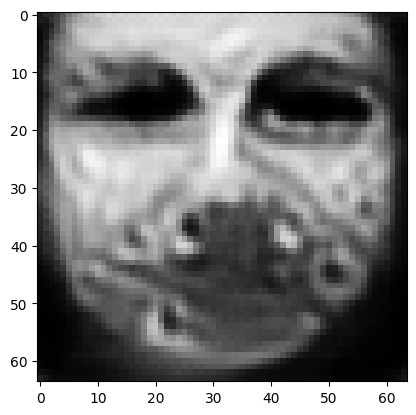

tensor([[1.2646e-03, 4.9523e-05, 6.8292e-03, 2.2042e-05, 2.7286e-04, 9.7608e-01,
         2.2520e-03, 4.4812e-03, 4.6636e-06, 1.7797e-04, 6.7898e-04, 9.0304e-04,
         1.3279e-05, 1.6411e-07, 4.3395e-07, 1.4461e-03, 2.5143e-04, 6.8487e-04,
         6.2777e-05, 3.5748e-04, 1.5720e-05, 1.8598e-05, 1.6682e-07, 3.2759e-05,
         1.2558e-06, 2.2634e-06, 1.2848e-03, 4.2679e-04, 4.9343e-04, 3.2841e-06,
         5.7967e-07, 3.1565e-05, 1.1163e-04, 2.0890e-05, 8.0959e-05, 1.8941e-06,
         2.4990e-05, 2.7113e-05, 2.1097e-05, 1.5676e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024210751056671143
tensor([[1.2642e-03, 4.9473e-05, 6.8166e-03, 2.2026e-05, 2.7259e-04, 9.7612e-01,
         2.2493e-03, 4.4719e-03, 4.6521e-06, 1.7762e-04, 6.7777e-04, 9.0154e-04,
         1.3258e-05, 1.6380e-07, 4.3340e-07, 1.4451e-03, 2.5106e-04, 6.8445e-04,
         6.2687e-05, 3.5685e-04, 1.5691e-05, 1.8541e-05, 1.6631e-07, 3.2696e-05,
         1.2529e-06, 2.2565e-06, 1.2835e-

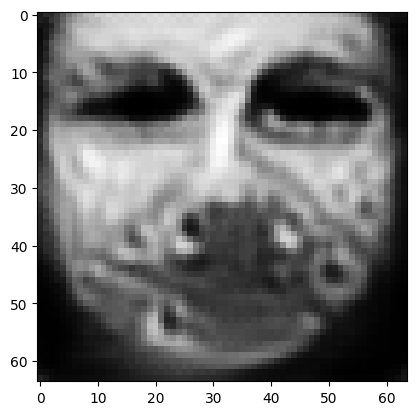

tensor([[1.2611e-03, 4.9264e-05, 6.7745e-03, 2.1973e-05, 2.7158e-04, 9.7626e-01,
         2.2366e-03, 4.4335e-03, 4.6144e-06, 1.7640e-04, 6.7334e-04, 8.9544e-04,
         1.3183e-05, 1.6252e-07, 4.3053e-07, 1.4401e-03, 2.4946e-04, 6.8158e-04,
         6.2321e-05, 3.5427e-04, 1.5576e-05, 1.8335e-05, 1.6452e-07, 3.2386e-05,
         1.2414e-06, 2.2328e-06, 1.2789e-03, 4.2320e-04, 4.8996e-04, 3.2570e-06,
         5.7213e-07, 3.1228e-05, 1.1003e-04, 2.0623e-05, 8.0728e-05, 1.8727e-06,
         2.4806e-05, 2.6723e-05, 2.0818e-05, 1.5564e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024025259539484978
tensor([[1.2603e-03, 4.9208e-05, 6.7648e-03, 2.1957e-05, 2.7132e-04, 9.7630e-01,
         2.2334e-03, 4.4243e-03, 4.6053e-06, 1.7609e-04, 6.7229e-04, 8.9406e-04,
         1.3165e-05, 1.6222e-07, 4.2983e-07, 1.4388e-03, 2.4908e-04, 6.8087e-04,
         6.2224e-05, 3.5364e-04, 1.5549e-05, 1.8286e-05, 1.6407e-07, 3.2311e-05,
         1.2386e-06, 2.2270e-06, 1.2777e-

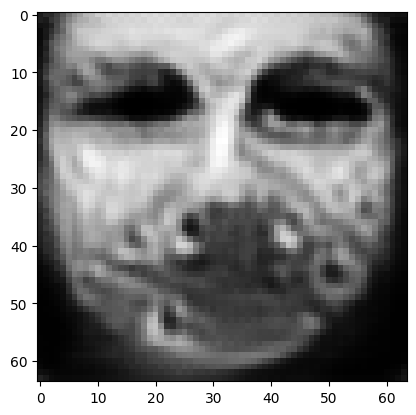

tensor([[1.2542e-03, 4.8954e-05, 6.7371e-03, 2.1915e-05, 2.7029e-04, 9.7644e-01,
         2.2157e-03, 4.3835e-03, 4.5740e-06, 1.7504e-04, 6.6774e-04, 8.8702e-04,
         1.3091e-05, 1.6058e-07, 4.2501e-07, 1.4310e-03, 2.4753e-04, 6.7539e-04,
         6.1835e-05, 3.5035e-04, 1.5420e-05, 1.8093e-05, 1.6247e-07, 3.1917e-05,
         1.2268e-06, 2.2100e-06, 1.2720e-03, 4.1926e-04, 4.8749e-04, 3.2284e-06,
         5.6616e-07, 3.0763e-05, 1.0856e-04, 2.0362e-05, 8.0473e-05, 1.8475e-06,
         2.4600e-05, 2.6364e-05, 2.0580e-05, 1.5518e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023844506591558456
tensor([[1.2525e-03, 4.8890e-05, 6.7307e-03, 2.1905e-05, 2.7002e-04, 9.7647e-01,
         2.2110e-03, 4.3733e-03, 4.5669e-06, 1.7480e-04, 6.6662e-04, 8.8527e-04,
         1.3073e-05, 1.6016e-07, 4.2372e-07, 1.4289e-03, 2.4713e-04, 6.7389e-04,
         6.1738e-05, 3.4953e-04, 1.5388e-05, 1.8045e-05, 1.6208e-07, 3.1812e-05,
         1.2238e-06, 2.2061e-06, 1.2706e-

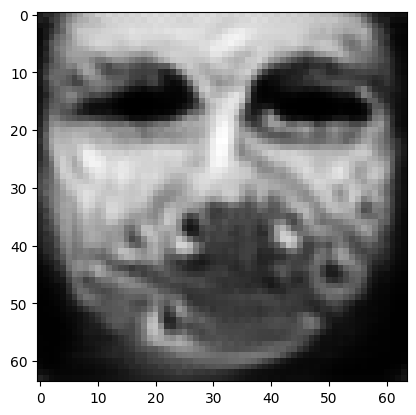

tensor([[1.2471e-03, 4.8655e-05, 6.7020e-03, 2.1863e-05, 2.6900e-04, 9.7660e-01,
         2.1956e-03, 4.3364e-03, 4.5372e-06, 1.7383e-04, 6.6235e-04, 8.7877e-04,
         1.3004e-05, 1.5866e-07, 4.1948e-07, 1.4219e-03, 2.4570e-04, 6.6910e-04,
         6.1383e-05, 3.4669e-04, 1.5270e-05, 1.7867e-05, 1.6056e-07, 3.1456e-05,
         1.2128e-06, 2.1893e-06, 1.2655e-03, 4.1535e-04, 4.8541e-04, 3.2015e-06,
         5.6073e-07, 3.0311e-05, 1.0722e-04, 2.0120e-05, 8.0239e-05, 1.8235e-06,
         2.4395e-05, 2.6027e-05, 2.0362e-05, 1.5486e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023673849180340767
tensor([[1.2459e-03, 4.8603e-05, 6.6948e-03, 2.1853e-05, 2.6875e-04, 9.7664e-01,
         2.1919e-03, 4.3276e-03, 4.5309e-06, 1.7361e-04, 6.6132e-04, 8.7730e-04,
         1.2989e-05, 1.5831e-07, 4.1851e-07, 1.4202e-03, 2.4531e-04, 6.6796e-04,
         6.1298e-05, 3.4604e-04, 1.5243e-05, 1.7827e-05, 1.6021e-07, 3.1369e-05,
         1.2102e-06, 2.1854e-06, 1.2646e-

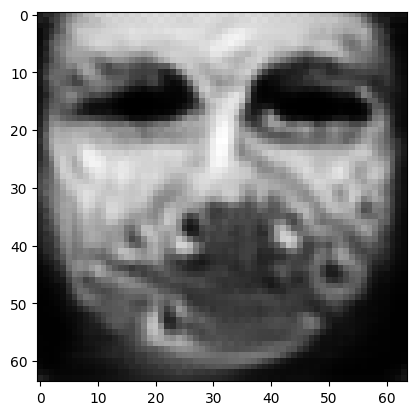

tensor([[1.2421e-03, 4.8392e-05, 6.6632e-03, 2.1806e-05, 2.6784e-04, 9.7676e-01,
         2.1797e-03, 4.2973e-03, 4.5004e-06, 1.7264e-04, 6.5730e-04, 8.7114e-04,
         1.2926e-05, 1.5700e-07, 4.1514e-07, 1.4142e-03, 2.4408e-04, 6.6421e-04,
         6.0980e-05, 3.4368e-04, 1.5135e-05, 1.7663e-05, 1.5874e-07, 3.1087e-05,
         1.2009e-06, 2.1684e-06, 1.2595e-03, 4.1191e-04, 4.8297e-04, 3.1775e-06,
         5.5552e-07, 2.9957e-05, 1.0600e-04, 1.9906e-05, 8.0006e-05, 1.8033e-06,
         2.4211e-05, 2.5711e-05, 2.0159e-05, 1.5425e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023516669869422913
tensor([[1.2412e-03, 4.8338e-05, 6.6556e-03, 2.1794e-05, 2.6762e-04, 9.7679e-01,
         2.1768e-03, 4.2901e-03, 4.4930e-06, 1.7241e-04, 6.5633e-04, 8.6964e-04,
         1.2911e-05, 1.5667e-07, 4.1429e-07, 1.4127e-03, 2.4380e-04, 6.6328e-04,
         6.0902e-05, 3.4311e-04, 1.5109e-05, 1.7623e-05, 1.5838e-07, 3.1019e-05,
         1.1987e-06, 2.1643e-06, 1.2582e-

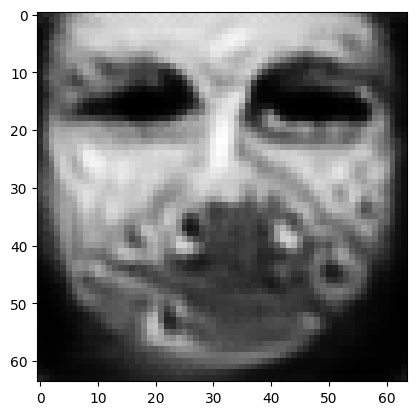

tensor([[1.2373e-03, 4.8130e-05, 6.6274e-03, 2.1750e-05, 2.6678e-04, 9.7690e-01,
         2.1649e-03, 4.2625e-03, 4.4655e-06, 1.7155e-04, 6.5258e-04, 8.6372e-04,
         1.2851e-05, 1.5538e-07, 4.1087e-07, 1.4067e-03, 2.4262e-04, 6.5940e-04,
         6.0595e-05, 3.4085e-04, 1.5007e-05, 1.7473e-05, 1.5703e-07, 3.0745e-05,
         1.1901e-06, 2.1492e-06, 1.2532e-03, 4.0873e-04, 4.8070e-04, 3.1549e-06,
         5.5060e-07, 2.9616e-05, 1.0486e-04, 1.9706e-05, 7.9773e-05, 1.7839e-06,
         2.4033e-05, 2.5417e-05, 1.9972e-05, 1.5368e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0233705285936594
tensor([[1.2365e-03, 4.8082e-05, 6.6202e-03, 2.1739e-05, 2.6658e-04, 9.7693e-01,
         2.1623e-03, 4.2561e-03, 4.4585e-06, 1.7134e-04, 6.5165e-04, 8.6227e-04,
         1.2836e-05, 1.5507e-07, 4.1010e-07, 1.4054e-03, 2.4235e-04, 6.5854e-04,
         6.0525e-05, 3.4033e-04, 1.4982e-05, 1.7436e-05, 1.5670e-07, 3.0684e-05,
         1.1880e-06, 2.1454e-06, 1.2520e-03

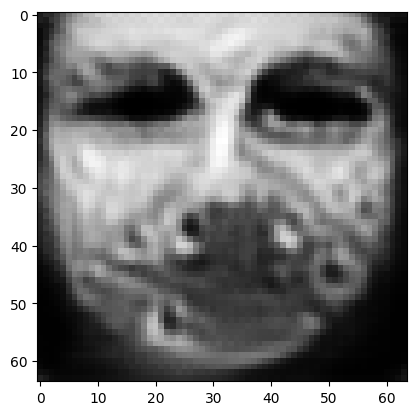

tensor([[1.2330e-03, 4.7886e-05, 6.5933e-03, 2.1696e-05, 2.6580e-04, 9.7703e-01,
         2.1515e-03, 4.2309e-03, 4.4328e-06, 1.7052e-04, 6.4817e-04, 8.5688e-04,
         1.2781e-05, 1.5389e-07, 4.0703e-07, 1.3998e-03, 2.4128e-04, 6.5504e-04,
         6.0235e-05, 3.3825e-04, 1.4888e-05, 1.7297e-05, 1.5546e-07, 3.0436e-05,
         1.1802e-06, 2.1313e-06, 1.2475e-03, 4.0579e-04, 4.7857e-04, 3.1341e-06,
         5.4604e-07, 2.9306e-05, 1.0380e-04, 1.9522e-05, 7.9560e-05, 1.7661e-06,
         2.3870e-05, 2.5144e-05, 1.9798e-05, 1.5313e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023235663771629333
tensor([[1.2321e-03, 4.7839e-05, 6.5870e-03, 2.1686e-05, 2.6561e-04, 9.7706e-01,
         2.1486e-03, 4.2247e-03, 4.4271e-06, 1.7034e-04, 6.4732e-04, 8.5554e-04,
         1.2768e-05, 1.5360e-07, 4.0622e-07, 1.3983e-03, 2.4098e-04, 6.5408e-04,
         6.0162e-05, 3.3771e-04, 1.4865e-05, 1.7265e-05, 1.5516e-07, 3.0371e-05,
         1.1782e-06, 2.1282e-06, 1.2464e-

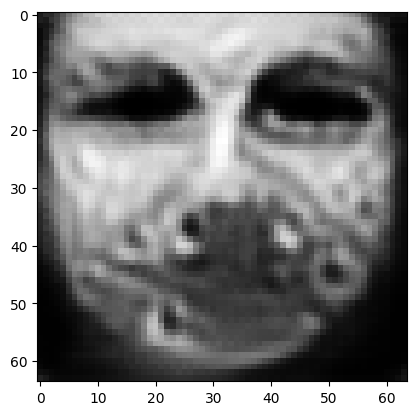

tensor([[1.2284e-03, 4.7646e-05, 6.5621e-03, 2.1648e-05, 2.6483e-04, 9.7716e-01,
         2.1373e-03, 4.1995e-03, 4.4034e-06, 1.6958e-04, 6.4382e-04, 8.5001e-04,
         1.2714e-05, 1.5240e-07, 4.0295e-07, 1.3926e-03, 2.3987e-04, 6.5031e-04,
         5.9879e-05, 3.3558e-04, 1.4770e-05, 1.7131e-05, 1.5400e-07, 3.0111e-05,
         1.1704e-06, 2.1152e-06, 1.2420e-03, 4.0289e-04, 4.7665e-04, 3.1139e-06,
         5.4182e-07, 2.8984e-05, 1.0278e-04, 1.9344e-05, 7.9355e-05, 1.7484e-06,
         2.3703e-05, 2.4884e-05, 1.9637e-05, 1.5274e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02310415916144848
tensor([[1.2274e-03, 4.7596e-05, 6.5563e-03, 2.1640e-05, 2.6464e-04, 9.7719e-01,
         2.1344e-03, 4.1932e-03, 4.3977e-06, 1.6940e-04, 6.4293e-04, 8.4856e-04,
         1.2700e-05, 1.5209e-07, 4.0208e-07, 1.3911e-03, 2.3959e-04, 6.4931e-04,
         5.9809e-05, 3.3503e-04, 1.4746e-05, 1.7098e-05, 1.5372e-07, 3.0045e-05,
         1.1685e-06, 2.1122e-06, 1.2408e-0

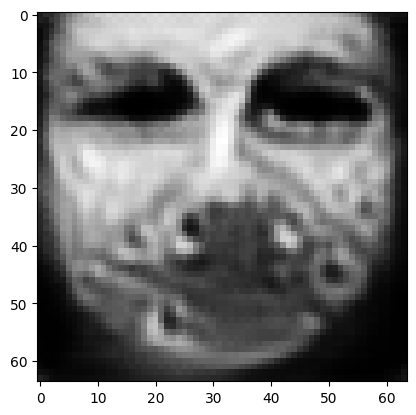

tensor([[1.2236e-03, 4.7422e-05, 6.5323e-03, 2.1607e-05, 2.6388e-04, 9.7728e-01,
         2.1239e-03, 4.1673e-03, 4.3766e-06, 1.6869e-04, 6.3967e-04, 8.4362e-04,
         1.2652e-05, 1.5100e-07, 3.9903e-07, 1.3858e-03, 2.3855e-04, 6.4580e-04,
         5.9550e-05, 3.3307e-04, 1.4662e-05, 1.6974e-05, 1.5268e-07, 2.9799e-05,
         1.1611e-06, 2.1001e-06, 1.2370e-03, 4.0004e-04, 4.7488e-04, 3.0951e-06,
         5.3795e-07, 2.8675e-05, 1.0183e-04, 1.9175e-05, 7.9184e-05, 1.7321e-06,
         2.3548e-05, 2.4640e-05, 1.9486e-05, 1.5243e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022977296262979507
tensor([[1.2226e-03, 4.7375e-05, 6.5269e-03, 2.1598e-05, 2.6370e-04, 9.7731e-01,
         2.1212e-03, 4.1609e-03, 4.3716e-06, 1.6851e-04, 6.3889e-04, 8.4246e-04,
         1.2640e-05, 1.5073e-07, 3.9824e-07, 1.3844e-03, 2.3829e-04, 6.4487e-04,
         5.9481e-05, 3.3256e-04, 1.4641e-05, 1.6944e-05, 1.5243e-07, 2.9736e-05,
         1.1594e-06, 2.0973e-06, 1.2361e-

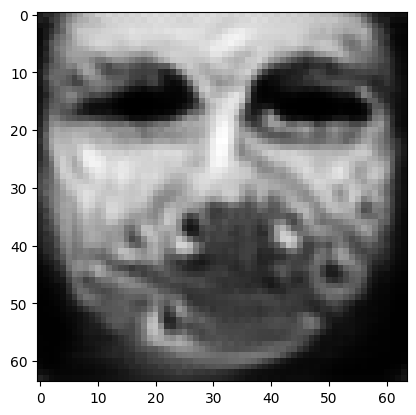

tensor([[1.2187e-03, 4.7194e-05, 6.5035e-03, 2.1564e-05, 2.6296e-04, 9.7741e-01,
         2.1108e-03, 4.1355e-03, 4.3514e-06, 1.6779e-04, 6.3557e-04, 8.3737e-04,
         1.2592e-05, 1.4964e-07, 3.9518e-07, 1.3788e-03, 2.3723e-04, 6.4138e-04,
         5.9218e-05, 3.3062e-04, 1.4556e-05, 1.6822e-05, 1.5143e-07, 2.9489e-05,
         1.1522e-06, 2.0855e-06, 1.2322e-03, 3.9724e-04, 4.7315e-04, 3.0762e-06,
         5.3421e-07, 2.8370e-05, 1.0092e-04, 1.9010e-05, 7.9016e-05, 1.7163e-06,
         2.3396e-05, 2.4401e-05, 1.9340e-05, 1.5214e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022852981463074684
tensor([[1.2178e-03, 4.7149e-05, 6.4978e-03, 2.1556e-05, 2.6277e-04, 9.7743e-01,
         2.1082e-03, 4.1293e-03, 4.3464e-06, 1.6761e-04, 6.3475e-04, 8.3612e-04,
         1.2580e-05, 1.4937e-07, 3.9442e-07, 1.3775e-03, 2.3697e-04, 6.4050e-04,
         5.9152e-05, 3.3014e-04, 1.4535e-05, 1.6791e-05, 1.5118e-07, 2.9428e-05,
         1.1505e-06, 2.0826e-06, 1.2313e-

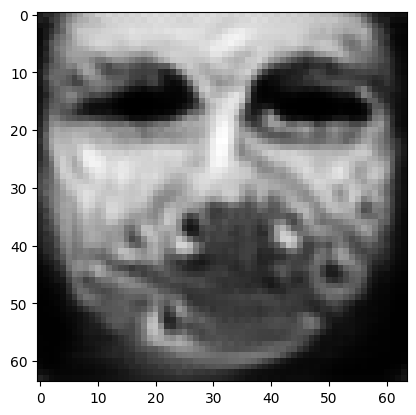

tensor([[1.2143e-03, 4.6979e-05, 6.4755e-03, 2.1522e-05, 2.6206e-04, 9.7752e-01,
         2.0983e-03, 4.1059e-03, 4.3272e-06, 1.6691e-04, 6.3160e-04, 8.3137e-04,
         1.2534e-05, 1.4834e-07, 3.9160e-07, 1.3723e-03, 2.3595e-04, 6.3722e-04,
         5.8899e-05, 3.2831e-04, 1.4455e-05, 1.6676e-05, 1.5022e-07, 2.9197e-05,
         1.1438e-06, 2.0712e-06, 1.2277e-03, 3.9458e-04, 4.7151e-04, 3.0580e-06,
         5.3056e-07, 2.8083e-05, 1.0005e-04, 1.8853e-05, 7.8858e-05, 1.7013e-06,
         2.3249e-05, 2.4168e-05, 1.9201e-05, 1.5185e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022734595462679863
tensor([[1.2135e-03, 4.6940e-05, 6.4699e-03, 2.1514e-05, 2.6189e-04, 9.7754e-01,
         2.0959e-03, 4.1003e-03, 4.3225e-06, 1.6675e-04, 6.3081e-04, 8.3016e-04,
         1.2523e-05, 1.4808e-07, 3.9092e-07, 1.3711e-03, 2.3569e-04, 6.3642e-04,
         5.8839e-05, 3.2788e-04, 1.4435e-05, 1.6647e-05, 1.4999e-07, 2.9141e-05,
         1.1421e-06, 2.0683e-06, 1.2269e-

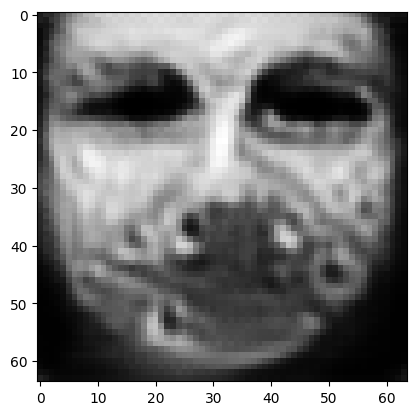

tensor([[1.2099e-03, 4.6768e-05, 6.4510e-03, 2.1480e-05, 2.6126e-04, 9.7763e-01,
         2.0865e-03, 4.0792e-03, 4.3056e-06, 1.6613e-04, 6.2807e-04, 8.2585e-04,
         1.2482e-05, 1.4714e-07, 3.8817e-07, 1.3658e-03, 2.3484e-04, 6.3314e-04,
         5.8599e-05, 3.2620e-04, 1.4361e-05, 1.6546e-05, 1.4913e-07, 2.8930e-05,
         1.1364e-06, 2.0588e-06, 1.2232e-03, 3.9211e-04, 4.7003e-04, 3.0415e-06,
         5.2740e-07, 2.7817e-05, 9.9286e-05, 1.8711e-05, 7.8709e-05, 1.6874e-06,
         2.3113e-05, 2.3964e-05, 1.9077e-05, 1.5160e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022626565769314766
tensor([[1.2092e-03, 4.6728e-05, 6.4458e-03, 2.1472e-05, 2.6112e-04, 9.7765e-01,
         2.0846e-03, 4.0748e-03, 4.3009e-06, 1.6598e-04, 6.2741e-04, 8.2475e-04,
         1.2471e-05, 1.4690e-07, 3.8754e-07, 1.3647e-03, 2.3466e-04, 6.3242e-04,
         5.8544e-05, 3.2582e-04, 1.4343e-05, 1.6520e-05, 1.4890e-07, 2.8886e-05,
         1.1350e-06, 2.0563e-06, 1.2222e-

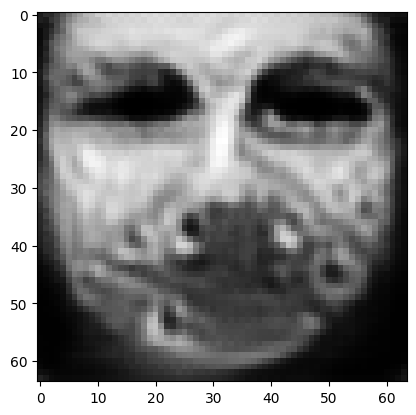

tensor([[1.2062e-03, 4.6568e-05, 6.4265e-03, 2.1436e-05, 2.6053e-04, 9.7772e-01,
         2.0768e-03, 4.0572e-03, 4.2833e-06, 1.6540e-04, 6.2486e-04, 8.2068e-04,
         1.2430e-05, 1.4599e-07, 3.8504e-07, 1.3602e-03, 2.3391e-04, 6.2950e-04,
         5.8327e-05, 3.2431e-04, 1.4272e-05, 1.6423e-05, 1.4805e-07, 2.8703e-05,
         1.1296e-06, 2.0467e-06, 1.2186e-03, 3.8992e-04, 4.6852e-04, 3.0258e-06,
         5.2428e-07, 2.7588e-05, 9.8557e-05, 1.8577e-05, 7.8558e-05, 1.6746e-06,
         2.2986e-05, 2.3774e-05, 1.8957e-05, 1.5125e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022528082132339478
tensor([[1.2055e-03, 4.6532e-05, 6.4216e-03, 2.1428e-05, 2.6040e-04, 9.7774e-01,
         2.0750e-03, 4.0529e-03, 4.2791e-06, 1.6526e-04, 6.2423e-04, 8.1966e-04,
         1.2420e-05, 1.4578e-07, 3.8447e-07, 1.3592e-03, 2.3372e-04, 6.2885e-04,
         5.8277e-05, 3.2396e-04, 1.4255e-05, 1.6400e-05, 1.4784e-07, 2.8659e-05,
         1.1283e-06, 2.0443e-06, 1.2178e-

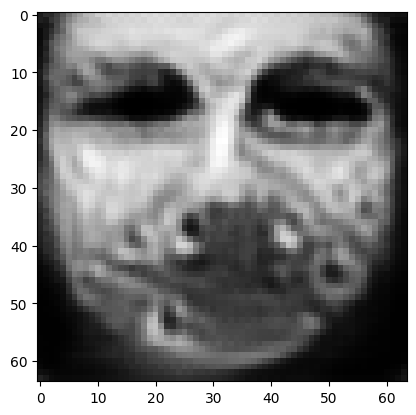

tensor([[1.2029e-03, 4.6385e-05, 6.4031e-03, 2.1395e-05, 2.5984e-04, 9.7781e-01,
         2.0678e-03, 4.0371e-03, 4.2629e-06, 1.6474e-04, 6.2191e-04, 8.1593e-04,
         1.2383e-05, 1.4495e-07, 3.8222e-07, 1.3550e-03, 2.3299e-04, 6.2617e-04,
         5.8072e-05, 3.2259e-04, 1.4189e-05, 1.6312e-05, 1.4704e-07, 2.8492e-05,
         1.1233e-06, 2.0353e-06, 1.2145e-03, 3.8789e-04, 4.6708e-04, 3.0113e-06,
         5.2137e-07, 2.7385e-05, 9.7892e-05, 1.8454e-05, 7.8416e-05, 1.6629e-06,
         2.2867e-05, 2.3599e-05, 1.8846e-05, 1.5091e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02243623323738575
tensor([[1.2022e-03, 4.6350e-05, 6.3987e-03, 2.1387e-05, 2.5970e-04, 9.7783e-01,
         2.0660e-03, 4.0332e-03, 4.2590e-06, 1.6462e-04, 6.2134e-04, 8.1505e-04,
         1.2374e-05, 1.4474e-07, 3.8166e-07, 1.3540e-03, 2.3281e-04, 6.2549e-04,
         5.8021e-05, 3.2225e-04, 1.4173e-05, 1.6291e-05, 1.4684e-07, 2.8451e-05,
         1.1220e-06, 2.0332e-06, 1.2137e-0

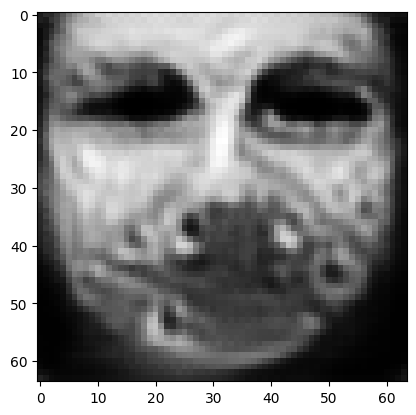

tensor([[1.1997e-03, 4.6214e-05, 6.3814e-03, 2.1356e-05, 2.5918e-04, 9.7790e-01,
         2.0591e-03, 4.0183e-03, 4.2445e-06, 1.6414e-04, 6.1921e-04, 8.1166e-04,
         1.2340e-05, 1.4398e-07, 3.7958e-07, 1.3500e-03, 2.3210e-04, 6.2297e-04,
         5.7828e-05, 3.2097e-04, 1.4113e-05, 1.6211e-05, 1.4611e-07, 2.8295e-05,
         1.1173e-06, 2.0250e-06, 1.2108e-03, 3.8598e-04, 4.6574e-04, 2.9979e-06,
         5.1876e-07, 2.7197e-05, 9.7291e-05, 1.8342e-05, 7.8277e-05, 1.6521e-06,
         2.2758e-05, 2.3440e-05, 1.8744e-05, 1.5061e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022351020947098732
tensor([[1.1991e-03, 4.6180e-05, 6.3774e-03, 2.1347e-05, 2.5904e-04, 9.7791e-01,
         2.0574e-03, 4.0148e-03, 4.2409e-06, 1.6402e-04, 6.1870e-04, 8.1089e-04,
         1.2332e-05, 1.4379e-07, 3.7906e-07, 1.3491e-03, 2.3193e-04, 6.2233e-04,
         5.7779e-05, 3.2065e-04, 1.4099e-05, 1.6191e-05, 1.4592e-07, 2.8257e-05,
         1.1161e-06, 2.0230e-06, 1.2100e-

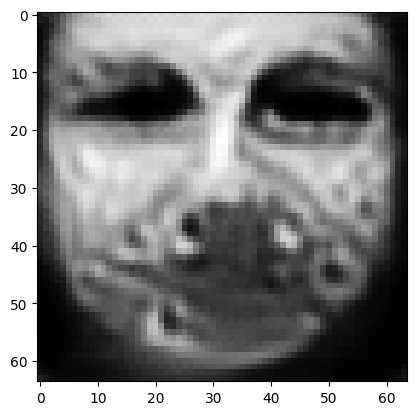

tensor([[1.1968e-03, 4.6052e-05, 6.3615e-03, 2.1318e-05, 2.5855e-04, 9.7798e-01,
         2.0509e-03, 4.0009e-03, 4.2270e-06, 1.6357e-04, 6.1669e-04, 8.0769e-04,
         1.2299e-05, 1.4306e-07, 3.7710e-07, 1.3454e-03, 2.3127e-04, 6.1992e-04,
         5.7597e-05, 3.1942e-04, 1.4042e-05, 1.6116e-05, 1.4523e-07, 2.8111e-05,
         1.1116e-06, 2.0155e-06, 1.2071e-03, 3.8420e-04, 4.6448e-04, 2.9851e-06,
         5.1633e-07, 2.7019e-05, 9.6727e-05, 1.8237e-05, 7.8141e-05, 1.6419e-06,
         2.2655e-05, 2.3293e-05, 1.8648e-05, 1.5033e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022271165624260902
tensor([[1.1962e-03, 4.6022e-05, 6.3574e-03, 2.1311e-05, 2.5842e-04, 9.7799e-01,
         2.0494e-03, 3.9975e-03, 4.2235e-06, 1.6346e-04, 6.1621e-04, 8.0695e-04,
         1.2291e-05, 1.4289e-07, 3.7664e-07, 1.3445e-03, 2.3111e-04, 6.1938e-04,
         5.7553e-05, 3.1913e-04, 1.4028e-05, 1.6097e-05, 1.4506e-07, 2.8077e-05,
         1.1105e-06, 2.0136e-06, 1.2065e-

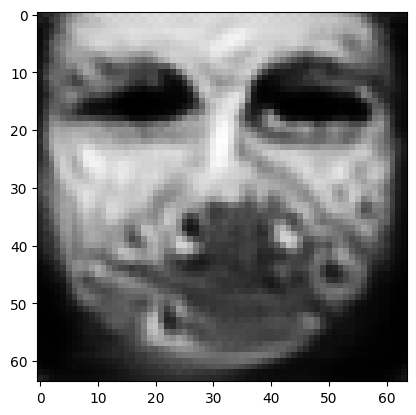

tensor([[1.1941e-03, 4.5902e-05, 6.3421e-03, 2.1282e-05, 2.5795e-04, 9.7805e-01,
         2.0431e-03, 3.9849e-03, 4.2098e-06, 1.6303e-04, 6.1430e-04, 8.0390e-04,
         1.2260e-05, 1.4220e-07, 3.7482e-07, 1.3411e-03, 2.3050e-04, 6.1713e-04,
         5.7378e-05, 3.1796e-04, 1.3974e-05, 1.6025e-05, 1.4439e-07, 2.7942e-05,
         1.1063e-06, 2.0062e-06, 1.2036e-03, 3.8255e-04, 4.6326e-04, 2.9728e-06,
         5.1396e-07, 2.6855e-05, 9.6185e-05, 1.8136e-05, 7.8009e-05, 1.6322e-06,
         2.2558e-05, 2.3151e-05, 1.8556e-05, 1.5002e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022195616737008095
tensor([[1.1936e-03, 4.5873e-05, 6.3380e-03, 2.1275e-05, 2.5784e-04, 9.7806e-01,
         2.0418e-03, 3.9819e-03, 4.2062e-06, 1.6291e-04, 6.1383e-04, 8.0312e-04,
         1.2252e-05, 1.4204e-07, 3.7440e-07, 1.3403e-03, 2.3035e-04, 6.1664e-04,
         5.7338e-05, 3.1769e-04, 1.3960e-05, 1.6007e-05, 1.4422e-07, 2.7911e-05,
         1.1053e-06, 2.0043e-06, 1.2029e-

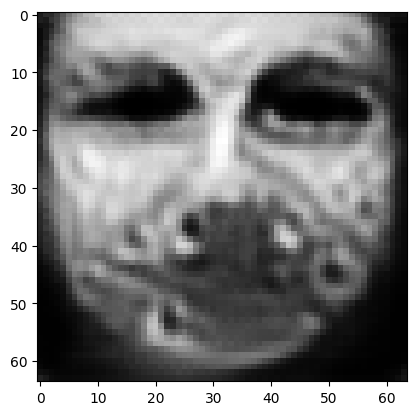

tensor([[1.1917e-03, 4.5757e-05, 6.3235e-03, 2.1248e-05, 2.5743e-04, 9.7812e-01,
         2.0360e-03, 3.9706e-03, 4.1928e-06, 1.6250e-04, 6.1202e-04, 8.0007e-04,
         1.2222e-05, 1.4138e-07, 3.7266e-07, 1.3369e-03, 2.2980e-04, 6.1451e-04,
         5.7174e-05, 3.1660e-04, 1.3907e-05, 1.5938e-05, 1.4359e-07, 2.7788e-05,
         1.1014e-06, 1.9975e-06, 1.2001e-03, 3.8102e-04, 4.6203e-04, 2.9611e-06,
         5.1167e-07, 2.6699e-05, 9.5667e-05, 1.8040e-05, 7.7880e-05, 1.6230e-06,
         2.2466e-05, 2.3017e-05, 1.8469e-05, 1.4971e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022124258801341057
tensor([[1.1913e-03, 4.5731e-05, 6.3197e-03, 2.1242e-05, 2.5732e-04, 9.7813e-01,
         2.0348e-03, 3.9678e-03, 4.1895e-06, 1.6240e-04, 6.1159e-04, 7.9939e-04,
         1.2215e-05, 1.4124e-07, 3.7228e-07, 1.3363e-03, 2.2968e-04, 6.1405e-04,
         5.7137e-05, 3.1635e-04, 1.3895e-05, 1.5922e-05, 1.4344e-07, 2.7760e-05,
         1.1005e-06, 1.9957e-06, 1.1995e-

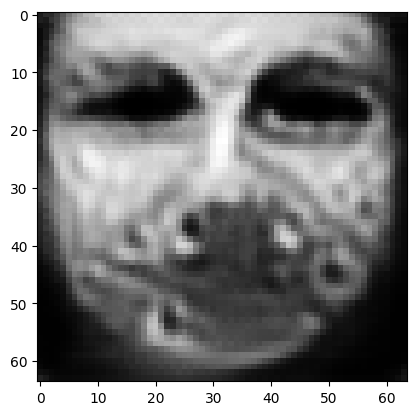

tensor([[1.1895e-03, 4.5624e-05, 6.3063e-03, 2.1218e-05, 2.5692e-04, 9.7818e-01,
         2.0294e-03, 3.9569e-03, 4.1775e-06, 1.6202e-04, 6.0993e-04, 7.9666e-04,
         1.2188e-05, 1.4063e-07, 3.7067e-07, 1.3332e-03, 2.2916e-04, 6.1204e-04,
         5.6986e-05, 3.1535e-04, 1.3846e-05, 1.5860e-05, 1.4287e-07, 2.7645e-05,
         1.0970e-06, 1.9895e-06, 1.1969e-03, 3.7957e-04, 4.6093e-04, 2.9506e-06,
         5.0962e-07, 2.6556e-05, 9.5203e-05, 1.7953e-05, 7.7763e-05, 1.6146e-06,
         2.2380e-05, 2.2896e-05, 1.8389e-05, 1.4943e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022058026865124702
tensor([[1.1890e-03, 4.5598e-05, 6.3033e-03, 2.1212e-05, 2.5683e-04, 9.7820e-01,
         2.0280e-03, 3.9542e-03, 4.1748e-06, 1.6193e-04, 6.0952e-04, 7.9599e-04,
         1.2182e-05, 1.4048e-07, 3.7025e-07, 1.3324e-03, 2.2903e-04, 6.1150e-04,
         5.6949e-05, 3.1509e-04, 1.3834e-05, 1.5846e-05, 1.4274e-07, 2.7615e-05,
         1.0961e-06, 1.9882e-06, 1.1963e-

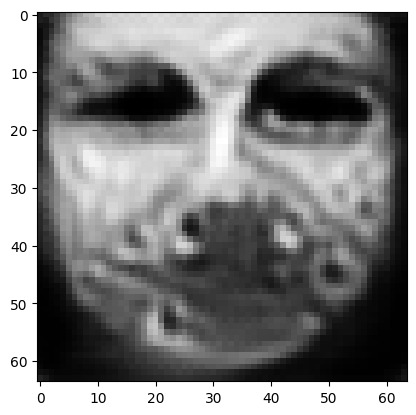

tensor([[1.1875e-03, 4.5494e-05, 6.2899e-03, 2.1184e-05, 2.5643e-04, 9.7824e-01,
         2.0235e-03, 3.9456e-03, 4.1633e-06, 1.6161e-04, 6.0802e-04, 7.9347e-04,
         1.2156e-05, 1.3991e-07, 3.6882e-07, 1.3294e-03, 2.2850e-04, 6.0969e-04,
         5.6805e-05, 3.1423e-04, 1.3788e-05, 1.5793e-05, 1.4217e-07, 2.7518e-05,
         1.0928e-06, 1.9823e-06, 1.1939e-03, 3.7824e-04, 4.5978e-04, 2.9408e-06,
         5.0770e-07, 2.6431e-05, 9.4789e-05, 1.7874e-05, 7.7632e-05, 1.6069e-06,
         2.2298e-05, 2.2785e-05, 1.8319e-05, 1.4915e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021997040137648582
tensor([[1.1870e-03, 4.5467e-05, 6.2871e-03, 2.1177e-05, 2.5634e-04, 9.7825e-01,
         2.0222e-03, 3.9435e-03, 4.1607e-06, 1.6154e-04, 6.0765e-04, 7.9281e-04,
         1.2150e-05, 1.3976e-07, 3.6842e-07, 1.3286e-03, 2.2836e-04, 6.0914e-04,
         5.6767e-05, 3.1399e-04, 1.3776e-05, 1.5781e-05, 1.4204e-07, 2.7491e-05,
         1.0919e-06, 1.9811e-06, 1.1932e-

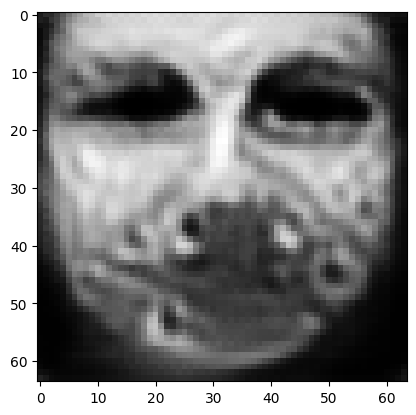

tensor([[1.1856e-03, 4.5367e-05, 6.2744e-03, 2.1148e-05, 2.5595e-04, 9.7830e-01,
         2.0179e-03, 3.9356e-03, 4.1497e-06, 1.6123e-04, 6.0624e-04, 7.9045e-04,
         1.2126e-05, 1.3922e-07, 3.6707e-07, 1.3258e-03, 2.2783e-04, 6.0743e-04,
         5.6627e-05, 3.1318e-04, 1.3732e-05, 1.5731e-05, 1.4150e-07, 2.7400e-05,
         1.0887e-06, 1.9754e-06, 1.1909e-03, 3.7702e-04, 4.5862e-04, 2.9312e-06,
         5.0584e-07, 2.6316e-05, 9.4401e-05, 1.7799e-05, 7.7493e-05, 1.5996e-06,
         2.2218e-05, 2.2681e-05, 1.8252e-05, 1.4886e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021940013393759727
tensor([[1.1853e-03, 4.5343e-05, 6.2713e-03, 2.1140e-05, 2.5585e-04, 9.7831e-01,
         2.0169e-03, 3.9337e-03, 4.1471e-06, 1.6116e-04, 6.0591e-04, 7.8992e-04,
         1.2120e-05, 1.3909e-07, 3.6675e-07, 1.3251e-03, 2.2771e-04, 6.0701e-04,
         5.6592e-05, 3.1298e-04, 1.3721e-05, 1.5720e-05, 1.4137e-07, 2.7377e-05,
         1.0879e-06, 1.9740e-06, 1.1904e-

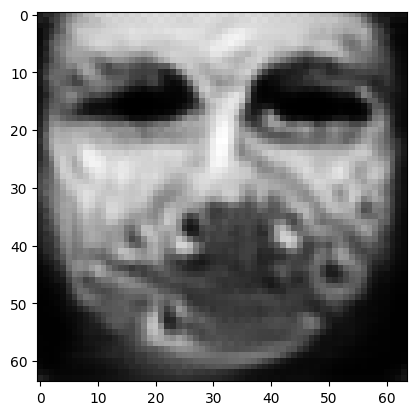

tensor([[1.1839e-03, 4.5247e-05, 6.2597e-03, 2.1113e-05, 2.5550e-04, 9.7835e-01,
         2.0128e-03, 3.9263e-03, 4.1370e-06, 1.6087e-04, 6.0458e-04, 7.8770e-04,
         1.2098e-05, 1.3857e-07, 3.6547e-07, 1.3224e-03, 2.2720e-04, 6.0537e-04,
         5.6458e-05, 3.1221e-04, 1.3679e-05, 1.5674e-05, 1.4086e-07, 2.7291e-05,
         1.0848e-06, 1.9688e-06, 1.1882e-03, 3.7589e-04, 4.5752e-04, 2.9222e-06,
         5.0409e-07, 2.6212e-05, 9.4041e-05, 1.7730e-05, 7.7362e-05, 1.5929e-06,
         2.2143e-05, 2.2585e-05, 1.8190e-05, 1.4858e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02188648097217083
tensor([[1.1835e-03, 4.5223e-05, 6.2571e-03, 2.1105e-05, 2.5541e-04, 9.7836e-01,
         2.0117e-03, 3.9245e-03, 4.1346e-06, 1.6080e-04, 6.0425e-04, 7.8716e-04,
         1.2092e-05, 1.3844e-07, 3.6514e-07, 1.3217e-03, 2.2707e-04, 6.0493e-04,
         5.6422e-05, 3.1200e-04, 1.3669e-05, 1.5663e-05, 1.4073e-07, 2.7268e-05,
         1.0840e-06, 1.9676e-06, 1.1876e-0

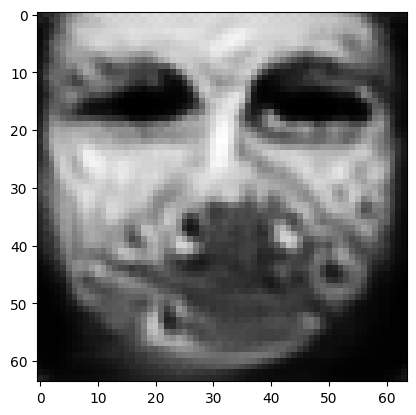

tensor([[1.1823e-03, 4.5132e-05, 6.2460e-03, 2.1078e-05, 2.5507e-04, 9.7840e-01,
         2.0079e-03, 3.9177e-03, 4.1249e-06, 1.6053e-04, 6.0299e-04, 7.8506e-04,
         1.2070e-05, 1.3796e-07, 3.6396e-07, 1.3192e-03, 2.2659e-04, 6.0344e-04,
         5.6296e-05, 3.1129e-04, 1.3629e-05, 1.5620e-05, 1.4025e-07, 2.7188e-05,
         1.0812e-06, 1.9625e-06, 1.1856e-03, 3.7483e-04, 4.5644e-04, 2.9134e-06,
         5.0239e-07, 2.6113e-05, 9.3695e-05, 1.7664e-05, 7.7236e-05, 1.5864e-06,
         2.2072e-05, 2.2492e-05, 1.8131e-05, 1.4831e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02183598093688488
tensor([[1.1819e-03, 4.5109e-05, 6.2436e-03, 2.1071e-05, 2.5498e-04, 9.7841e-01,
         2.0069e-03, 3.9159e-03, 4.1227e-06, 1.6047e-04, 6.0268e-04, 7.8456e-04,
         1.2065e-05, 1.3784e-07, 3.6364e-07, 1.3185e-03, 2.2647e-04, 6.0303e-04,
         5.6263e-05, 3.1110e-04, 1.3619e-05, 1.5611e-05, 1.4013e-07, 2.7167e-05,
         1.0804e-06, 1.9614e-06, 1.1851e-0

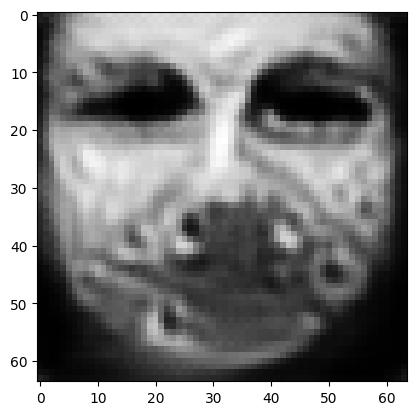

tensor([[1.1810e-03, 4.5023e-05, 6.2325e-03, 2.1041e-05, 2.5463e-04, 9.7845e-01,
         2.0034e-03, 3.9099e-03, 4.1127e-06, 1.6020e-04, 6.0144e-04, 7.8263e-04,
         1.2043e-05, 1.3737e-07, 3.6262e-07, 1.3162e-03, 2.2599e-04, 6.0168e-04,
         5.6141e-05, 3.1043e-04, 1.3581e-05, 1.5570e-05, 1.3963e-07, 2.7098e-05,
         1.0776e-06, 1.9562e-06, 1.1830e-03, 3.7383e-04, 4.5535e-04, 2.9052e-06,
         5.0066e-07, 2.6028e-05, 9.3353e-05, 1.7602e-05, 7.7110e-05, 1.5803e-06,
         2.2004e-05, 2.2403e-05, 1.8073e-05, 1.4800e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021787576377391815
tensor([[1.1807e-03, 4.5001e-05, 6.2298e-03, 2.1033e-05, 2.5454e-04, 9.7846e-01,
         2.0025e-03, 3.9084e-03, 4.1103e-06, 1.6014e-04, 6.0113e-04, 7.8217e-04,
         1.2038e-05, 1.3725e-07, 3.6236e-07, 1.3156e-03, 2.2586e-04, 6.0133e-04,
         5.6109e-05, 3.1026e-04, 1.3572e-05, 1.5561e-05, 1.3950e-07, 2.7081e-05,
         1.0769e-06, 1.9550e-06, 1.1825e-

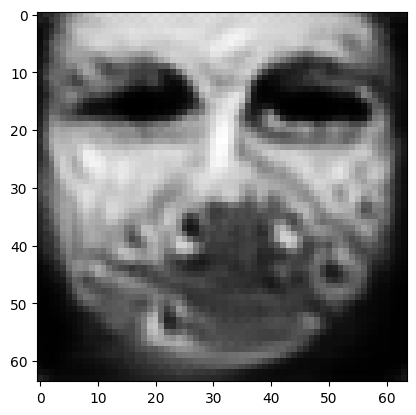

tensor([[1.1799e-03, 4.4920e-05, 6.2196e-03, 2.1003e-05, 2.5422e-04, 9.7849e-01,
         1.9991e-03, 3.9028e-03, 4.1010e-06, 1.5990e-04, 5.9993e-04, 7.8037e-04,
         1.2018e-05, 1.3682e-07, 3.6142e-07, 1.3134e-03, 2.2540e-04, 6.0004e-04,
         5.5993e-05, 3.0963e-04, 1.3536e-05, 1.5524e-05, 1.3902e-07, 2.7018e-05,
         1.0742e-06, 1.9502e-06, 1.1806e-03, 3.7290e-04, 4.5424e-04, 2.8975e-06,
         4.9899e-07, 2.5954e-05, 9.3024e-05, 1.7543e-05, 7.6987e-05, 1.5747e-06,
         2.1939e-05, 2.2318e-05, 1.8018e-05, 1.4767e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021741852164268494
tensor([[1.1797e-03, 4.4901e-05, 6.2169e-03, 2.0995e-05, 2.5414e-04, 9.7850e-01,
         1.9983e-03, 3.9015e-03, 4.0987e-06, 1.5985e-04, 5.9964e-04, 7.7991e-04,
         1.2013e-05, 1.3671e-07, 3.6120e-07, 1.3129e-03, 2.2528e-04, 5.9976e-04,
         5.5966e-05, 3.0949e-04, 1.3527e-05, 1.5515e-05, 1.3891e-07, 2.7004e-05,
         1.0735e-06, 1.9490e-06, 1.1801e-

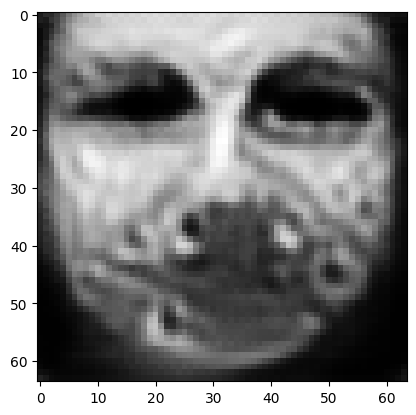

tensor([[1.1788e-03, 4.4825e-05, 6.2073e-03, 2.0967e-05, 2.5385e-04, 9.7853e-01,
         1.9952e-03, 3.8962e-03, 4.0901e-06, 1.5962e-04, 5.9854e-04, 7.7824e-04,
         1.1995e-05, 1.3631e-07, 3.6031e-07, 1.3107e-03, 2.2486e-04, 5.9855e-04,
         5.5857e-05, 3.0890e-04, 1.3494e-05, 1.5482e-05, 1.3847e-07, 2.6946e-05,
         1.0711e-06, 1.9446e-06, 1.1783e-03, 3.7205e-04, 4.5318e-04, 2.8904e-06,
         4.9743e-07, 2.5886e-05, 9.2722e-05, 1.7489e-05, 7.6873e-05, 1.5695e-06,
         2.1879e-05, 2.2239e-05, 1.7967e-05, 1.4736e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02169904112815857
tensor([[1.1786e-03, 4.4807e-05, 6.2049e-03, 2.0961e-05, 2.5378e-04, 9.7854e-01,
         1.9945e-03, 3.8950e-03, 4.0880e-06, 1.5956e-04, 5.9827e-04, 7.7781e-04,
         1.1990e-05, 1.3621e-07, 3.6011e-07, 1.3103e-03, 2.2476e-04, 5.9828e-04,
         5.5832e-05, 3.0877e-04, 1.3486e-05, 1.5473e-05, 1.3836e-07, 2.6933e-05,
         1.0705e-06, 1.9435e-06, 1.1779e-0

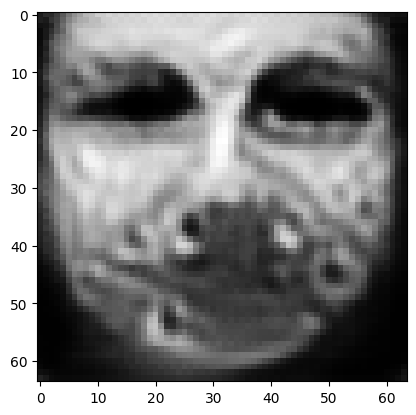

tensor([[1.1779e-03, 4.4736e-05, 6.1958e-03, 2.0934e-05, 2.5349e-04, 9.7857e-01,
         1.9916e-03, 3.8903e-03, 4.0798e-06, 1.5935e-04, 5.9728e-04, 7.7627e-04,
         1.1973e-05, 1.3584e-07, 3.5929e-07, 1.3083e-03, 2.2437e-04, 5.9717e-04,
         5.5732e-05, 3.0824e-04, 1.3455e-05, 1.5443e-05, 1.3795e-07, 2.6881e-05,
         1.0682e-06, 1.9394e-06, 1.1761e-03, 3.7124e-04, 4.5218e-04, 2.8838e-06,
         4.9598e-07, 2.5825e-05, 9.2443e-05, 1.7439e-05, 7.6763e-05, 1.5647e-06,
         2.1822e-05, 2.2168e-05, 1.7920e-05, 1.4706e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021659262478351593
tensor([[1.1777e-03, 4.4719e-05, 6.1936e-03, 2.0927e-05, 2.5341e-04, 9.7858e-01,
         1.9909e-03, 3.8891e-03, 4.0779e-06, 1.5931e-04, 5.9705e-04, 7.7591e-04,
         1.1969e-05, 1.3575e-07, 3.5909e-07, 1.3078e-03, 2.2427e-04, 5.9688e-04,
         5.5707e-05, 3.0811e-04, 1.3447e-05, 1.5436e-05, 1.3785e-07, 2.6867e-05,
         1.0676e-06, 1.9385e-06, 1.1757e-

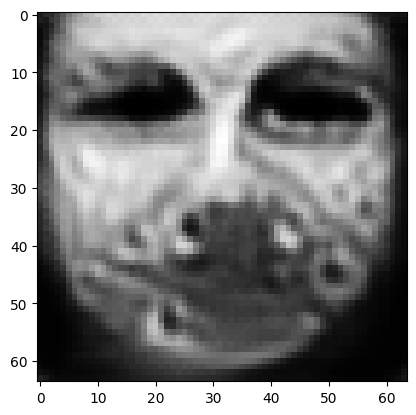

tensor([[1.1769e-03, 4.4653e-05, 6.1848e-03, 2.0902e-05, 2.5314e-04, 9.7861e-01,
         1.9884e-03, 3.8846e-03, 4.0703e-06, 1.5911e-04, 5.9615e-04, 7.7451e-04,
         1.1953e-05, 1.3541e-07, 3.5836e-07, 1.3060e-03, 2.2391e-04, 5.9589e-04,
         5.5615e-05, 3.0764e-04, 1.3419e-05, 1.5407e-05, 1.3746e-07, 2.6820e-05,
         1.0654e-06, 1.9346e-06, 1.1742e-03, 3.7049e-04, 4.5125e-04, 2.8776e-06,
         4.9467e-07, 2.5771e-05, 9.2196e-05, 1.7393e-05, 7.6657e-05, 1.5604e-06,
         2.1771e-05, 2.2103e-05, 1.7877e-05, 1.4678e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021621933206915855
tensor([[1.1768e-03, 4.4638e-05, 6.1826e-03, 2.0896e-05, 2.5307e-04, 9.7862e-01,
         1.9878e-03, 3.8835e-03, 4.0685e-06, 1.5906e-04, 5.9592e-04, 7.7415e-04,
         1.1949e-05, 1.3533e-07, 3.5818e-07, 1.3056e-03, 2.2382e-04, 5.9564e-04,
         5.5594e-05, 3.0753e-04, 1.3412e-05, 1.5401e-05, 1.3737e-07, 2.6809e-05,
         1.0649e-06, 1.9337e-06, 1.1738e-

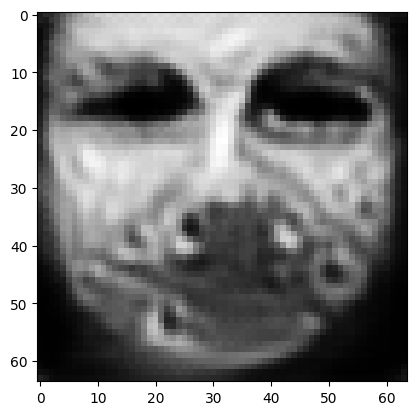

tensor([[1.1761e-03, 4.4576e-05, 6.1743e-03, 2.0872e-05, 2.5281e-04, 9.7864e-01,
         1.9855e-03, 3.8793e-03, 4.0613e-06, 1.5888e-04, 5.9506e-04, 7.7281e-04,
         1.1934e-05, 1.3500e-07, 3.5748e-07, 1.3040e-03, 2.2348e-04, 5.9469e-04,
         5.5508e-05, 3.0708e-04, 1.3385e-05, 1.5374e-05, 1.3701e-07, 2.6764e-05,
         1.0629e-06, 1.9301e-06, 1.1723e-03, 3.6977e-04, 4.5037e-04, 2.8719e-06,
         4.9343e-07, 2.5720e-05, 9.1962e-05, 1.7350e-05, 7.6558e-05, 1.5563e-06,
         2.1723e-05, 2.2041e-05, 1.7836e-05, 1.4651e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02158716693520546
tensor([[1.1759e-03, 4.4560e-05, 6.1723e-03, 2.0867e-05, 2.5274e-04, 9.7865e-01,
         1.9849e-03, 3.8783e-03, 4.0595e-06, 1.5883e-04, 5.9486e-04, 7.7249e-04,
         1.1931e-05, 1.3493e-07, 3.5730e-07, 1.3036e-03, 2.2340e-04, 5.9446e-04,
         5.5486e-05, 3.0697e-04, 1.3378e-05, 1.5367e-05, 1.3692e-07, 2.6753e-05,
         1.0624e-06, 1.9292e-06, 1.1719e-0

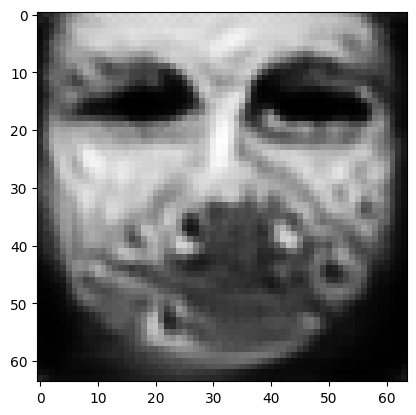

tensor([[1.1753e-03, 4.4502e-05, 6.1643e-03, 2.0844e-05, 2.5250e-04, 9.7868e-01,
         1.9826e-03, 3.8744e-03, 4.0526e-06, 1.5866e-04, 5.9403e-04, 7.7118e-04,
         1.1916e-05, 1.3462e-07, 3.5663e-07, 1.3020e-03, 2.2308e-04, 5.9354e-04,
         5.5405e-05, 3.0655e-04, 1.3352e-05, 1.5342e-05, 1.3658e-07, 2.6710e-05,
         1.0605e-06, 1.9257e-06, 1.1705e-03, 3.6910e-04, 4.4953e-04, 2.8664e-06,
         4.9225e-07, 2.5670e-05, 9.1738e-05, 1.7309e-05, 7.6463e-05, 1.5524e-06,
         2.1677e-05, 2.1982e-05, 1.7797e-05, 1.4626e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021553918719291687
tensor([[1.1752e-03, 4.4487e-05, 6.1623e-03, 2.0839e-05, 2.5244e-04, 9.7868e-01,
         1.9821e-03, 3.8735e-03, 4.0509e-06, 1.5861e-04, 5.9383e-04, 7.7086e-04,
         1.1913e-05, 1.3454e-07, 3.5647e-07, 1.3016e-03, 2.2300e-04, 5.9332e-04,
         5.5385e-05, 3.0645e-04, 1.3346e-05, 1.5336e-05, 1.3649e-07, 2.6700e-05,
         1.0600e-06, 1.9249e-06, 1.1701e-

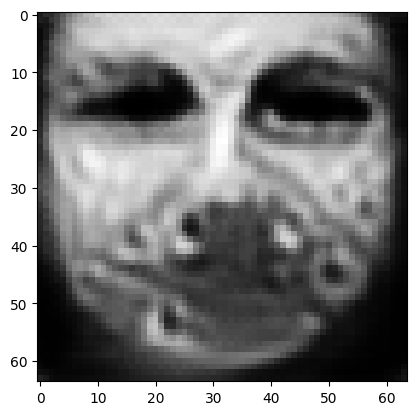

tensor([[1.1746e-03, 4.4431e-05, 6.1549e-03, 2.0817e-05, 2.5220e-04, 9.7871e-01,
         1.9798e-03, 3.8700e-03, 4.0443e-06, 1.5845e-04, 5.9306e-04, 7.6961e-04,
         1.1899e-05, 1.3425e-07, 3.5582e-07, 1.3000e-03, 2.2270e-04, 5.9244e-04,
         5.5305e-05, 3.0604e-04, 1.3320e-05, 1.5311e-05, 1.3616e-07, 2.6659e-05,
         1.0582e-06, 1.9216e-06, 1.1687e-03, 3.6847e-04, 4.4873e-04, 2.8610e-06,
         4.9112e-07, 2.5623e-05, 9.1525e-05, 1.7270e-05, 7.6370e-05, 1.5486e-06,
         2.1632e-05, 2.1926e-05, 1.7760e-05, 1.4602e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02152230031788349
tensor([[1.1744e-03, 4.4418e-05, 6.1530e-03, 2.0812e-05, 2.5215e-04, 9.7871e-01,
         1.9793e-03, 3.8691e-03, 4.0426e-06, 1.5841e-04, 5.9287e-04, 7.6932e-04,
         1.1896e-05, 1.3418e-07, 3.5567e-07, 1.2997e-03, 2.2263e-04, 5.9224e-04,
         5.5286e-05, 3.0594e-04, 1.3314e-05, 1.5305e-05, 1.3608e-07, 2.6649e-05,
         1.0578e-06, 1.9208e-06, 1.1684e-0

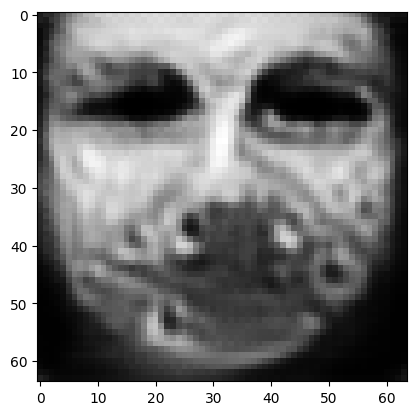

tensor([[1.1738e-03, 4.4365e-05, 6.1460e-03, 2.0791e-05, 2.5193e-04, 9.7874e-01,
         1.9772e-03, 3.8658e-03, 4.0364e-06, 1.5825e-04, 5.9214e-04, 7.6814e-04,
         1.1883e-05, 1.3390e-07, 3.5506e-07, 1.2982e-03, 2.2234e-04, 5.9140e-04,
         5.5211e-05, 3.0556e-04, 1.3291e-05, 1.5282e-05, 1.3577e-07, 2.6611e-05,
         1.0560e-06, 1.9178e-06, 1.1671e-03, 3.6787e-04, 4.4797e-04, 2.8560e-06,
         4.9006e-07, 2.5578e-05, 9.1325e-05, 1.7233e-05, 7.6282e-05, 1.5450e-06,
         2.1590e-05, 2.1874e-05, 1.7725e-05, 1.4579e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021492432802915573
tensor([[1.1737e-03, 4.4352e-05, 6.1442e-03, 2.0786e-05, 2.5187e-04, 9.7874e-01,
         1.9767e-03, 3.8649e-03, 4.0349e-06, 1.5821e-04, 5.9196e-04, 7.6786e-04,
         1.1880e-05, 1.3383e-07, 3.5492e-07, 1.2979e-03, 2.2227e-04, 5.9121e-04,
         5.5193e-05, 3.0547e-04, 1.3285e-05, 1.5276e-05, 1.3569e-07, 2.6601e-05,
         1.0556e-06, 1.9170e-06, 1.1668e-

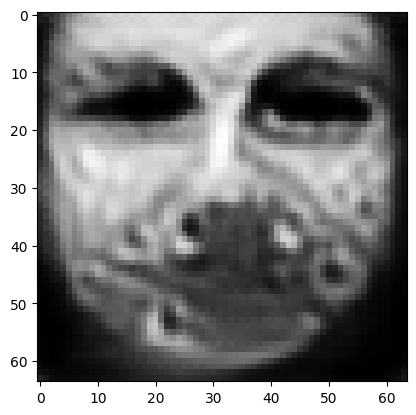

tensor([[1.1731e-03, 4.4302e-05, 6.1377e-03, 2.0767e-05, 2.5166e-04, 9.7876e-01,
         1.9746e-03, 3.8616e-03, 4.0291e-06, 1.5806e-04, 5.9127e-04, 7.6676e-04,
         1.1868e-05, 1.3357e-07, 3.5433e-07, 1.2965e-03, 2.2199e-04, 5.9040e-04,
         5.5122e-05, 3.0509e-04, 1.3262e-05, 1.5255e-05, 1.3540e-07, 2.6563e-05,
         1.0539e-06, 1.9141e-06, 1.1655e-03, 3.6730e-04, 4.4727e-04, 2.8512e-06,
         4.8907e-07, 2.5534e-05, 9.1134e-05, 1.7198e-05, 7.6201e-05, 1.5416e-06,
         2.1550e-05, 2.1823e-05, 1.7692e-05, 1.4559e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02146407961845398
tensor([[1.1729e-03, 4.4289e-05, 6.1360e-03, 2.0762e-05, 2.5161e-04, 9.7877e-01,
         1.9742e-03, 3.8608e-03, 4.0276e-06, 1.5803e-04, 5.9110e-04, 7.6649e-04,
         1.1865e-05, 1.3350e-07, 3.5420e-07, 1.2961e-03, 2.2193e-04, 5.9022e-04,
         5.5105e-05, 3.0501e-04, 1.3257e-05, 1.5249e-05, 1.3533e-07, 2.6554e-05,
         1.0535e-06, 1.9134e-06, 1.1652e-0

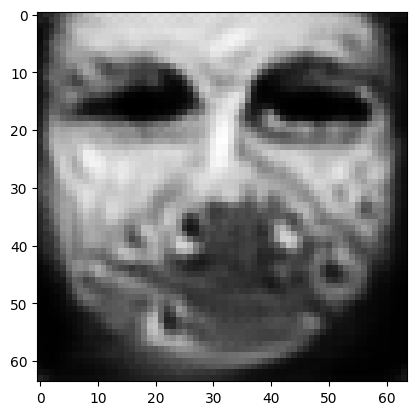

tensor([[1.1724e-03, 4.4243e-05, 6.1296e-03, 2.0744e-05, 2.5141e-04, 9.7879e-01,
         1.9722e-03, 3.8575e-03, 4.0223e-06, 1.5789e-04, 5.9044e-04, 7.6546e-04,
         1.1853e-05, 1.3325e-07, 3.5365e-07, 1.2948e-03, 2.2166e-04, 5.8946e-04,
         5.5038e-05, 3.0466e-04, 1.3236e-05, 1.5228e-05, 1.3505e-07, 2.6517e-05,
         1.0519e-06, 1.9106e-06, 1.1641e-03, 3.6675e-04, 4.4661e-04, 2.8467e-06,
         4.8812e-07, 2.5494e-05, 9.0954e-05, 1.7165e-05, 7.6124e-05, 1.5384e-06,
         2.1512e-05, 2.1776e-05, 1.7660e-05, 1.4539e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02143724448978901
tensor([[1.1722e-03, 4.4231e-05, 6.1281e-03, 2.0739e-05, 2.5136e-04, 9.7880e-01,
         1.9717e-03, 3.8568e-03, 4.0208e-06, 1.5785e-04, 5.9027e-04, 7.6520e-04,
         1.1850e-05, 1.3319e-07, 3.5351e-07, 1.2945e-03, 2.2159e-04, 5.8927e-04,
         5.5021e-05, 3.0457e-04, 1.3231e-05, 1.5223e-05, 1.3498e-07, 2.6509e-05,
         1.0515e-06, 1.9099e-06, 1.1638e-0

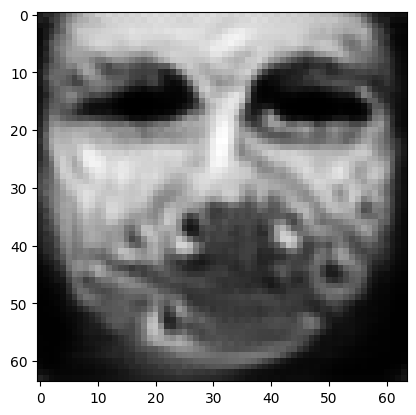

tensor([[1.1717e-03, 4.4187e-05, 6.1220e-03, 2.0722e-05, 2.5117e-04, 9.7882e-01,
         1.9699e-03, 3.8538e-03, 4.0156e-06, 1.5772e-04, 5.8964e-04, 7.6420e-04,
         1.1840e-05, 1.3295e-07, 3.5299e-07, 1.2933e-03, 2.2134e-04, 5.8855e-04,
         5.4957e-05, 3.0424e-04, 1.3211e-05, 1.5203e-05, 1.3472e-07, 2.6474e-05,
         1.0500e-06, 1.9072e-06, 1.1627e-03, 3.6623e-04, 4.4597e-04, 2.8424e-06,
         4.8722e-07, 2.5453e-05, 9.0781e-05, 1.7133e-05, 7.6049e-05, 1.5353e-06,
         2.1475e-05, 2.1730e-05, 1.7630e-05, 1.4520e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021411458030343056
tensor([[1.1716e-03, 4.4177e-05, 6.1205e-03, 2.0718e-05, 2.5112e-04, 9.7882e-01,
         1.9695e-03, 3.8531e-03, 4.0144e-06, 1.5769e-04, 5.8950e-04, 7.6397e-04,
         1.1837e-05, 1.3290e-07, 3.5287e-07, 1.2930e-03, 2.2128e-04, 5.8839e-04,
         5.4942e-05, 3.0417e-04, 1.3206e-05, 1.5198e-05, 1.3465e-07, 2.6466e-05,
         1.0496e-06, 1.9066e-06, 1.1625e-

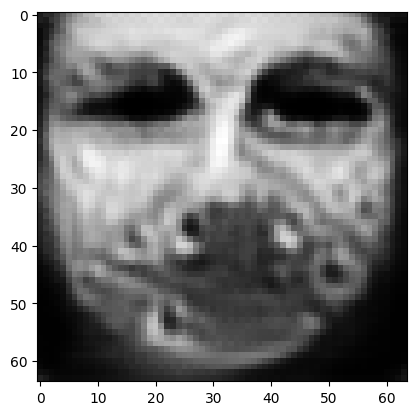

tensor([[1.1711e-03, 4.4136e-05, 6.1147e-03, 2.0701e-05, 2.5094e-04, 9.7884e-01,
         1.9677e-03, 3.8503e-03, 4.0094e-06, 1.5756e-04, 5.8890e-04, 7.6303e-04,
         1.1827e-05, 1.3268e-07, 3.5237e-07, 1.2918e-03, 2.2104e-04, 5.8771e-04,
         5.4882e-05, 3.0385e-04, 1.3187e-05, 1.5180e-05, 1.3440e-07, 2.6434e-05,
         1.0482e-06, 1.9041e-06, 1.1615e-03, 3.6574e-04, 4.4537e-04, 2.8384e-06,
         4.8637e-07, 2.5417e-05, 9.0618e-05, 1.7103e-05, 7.5979e-05, 1.5324e-06,
         2.1441e-05, 2.1687e-05, 1.7602e-05, 1.4502e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021387070417404175
tensor([[1.1710e-03, 4.4126e-05, 6.1132e-03, 2.0697e-05, 2.5090e-04, 9.7884e-01,
         1.9673e-03, 3.8495e-03, 4.0082e-06, 1.5753e-04, 5.8875e-04, 7.6281e-04,
         1.1825e-05, 1.3262e-07, 3.5226e-07, 1.2916e-03, 2.2098e-04, 5.8755e-04,
         5.4867e-05, 3.0378e-04, 1.3182e-05, 1.5175e-05, 1.3434e-07, 2.6426e-05,
         1.0478e-06, 1.9034e-06, 1.1613e-

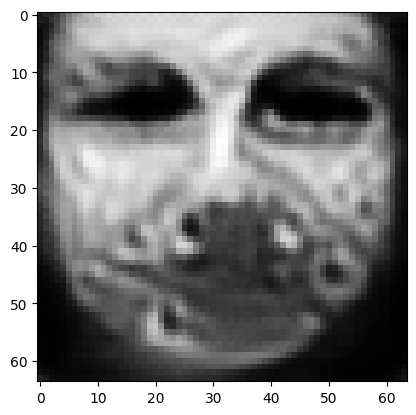

tensor([[1.1705e-03, 4.4087e-05, 6.1077e-03, 2.0681e-05, 2.5073e-04, 9.7886e-01,
         1.9657e-03, 3.8468e-03, 4.0035e-06, 1.5742e-04, 5.8819e-04, 7.6194e-04,
         1.1815e-05, 1.3241e-07, 3.5180e-07, 1.2905e-03, 2.2076e-04, 5.8692e-04,
         5.4811e-05, 3.0349e-04, 1.3164e-05, 1.5157e-05, 1.3410e-07, 2.6396e-05,
         1.0464e-06, 1.9010e-06, 1.1603e-03, 3.6528e-04, 4.4480e-04, 2.8346e-06,
         4.8557e-07, 2.5383e-05, 9.0465e-05, 1.7075e-05, 7.5914e-05, 1.5297e-06,
         2.1408e-05, 2.1646e-05, 1.7575e-05, 1.4486e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021364081650972366
tensor([[1.1704e-03, 4.4078e-05, 6.1063e-03, 2.0678e-05, 2.5069e-04, 9.7887e-01,
         1.9654e-03, 3.8461e-03, 4.0023e-06, 1.5739e-04, 5.8805e-04, 7.6172e-04,
         1.1813e-05, 1.3236e-07, 3.5169e-07, 1.2902e-03, 2.2070e-04, 5.8678e-04,
         5.4798e-05, 3.0342e-04, 1.3160e-05, 1.5153e-05, 1.3404e-07, 2.6388e-05,
         1.0461e-06, 1.9004e-06, 1.1601e-

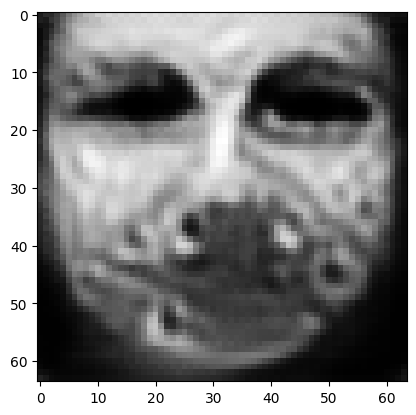

tensor([[1.1700e-03, 4.4040e-05, 6.1011e-03, 2.0663e-05, 2.5053e-04, 9.7888e-01,
         1.9638e-03, 3.8435e-03, 3.9979e-06, 1.5727e-04, 5.8752e-04, 7.6090e-04,
         1.1804e-05, 1.3216e-07, 3.5126e-07, 1.2892e-03, 2.2049e-04, 5.8619e-04,
         5.4744e-05, 3.0315e-04, 1.3143e-05, 1.5136e-05, 1.3382e-07, 2.6360e-05,
         1.0448e-06, 1.8982e-06, 1.1592e-03, 3.6483e-04, 4.4427e-04, 2.8310e-06,
         4.8481e-07, 2.5351e-05, 9.0319e-05, 1.7048e-05, 7.5853e-05, 1.5272e-06,
         2.1378e-05, 2.1607e-05, 1.7549e-05, 1.4469e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021342378109693527
tensor([[1.1698e-03, 4.4031e-05, 6.0998e-03, 2.0659e-05, 2.5049e-04, 9.7889e-01,
         1.9634e-03, 3.8429e-03, 3.9968e-06, 1.5725e-04, 5.8738e-04, 7.6069e-04,
         1.1802e-05, 1.3211e-07, 3.5115e-07, 1.2889e-03, 2.2044e-04, 5.8603e-04,
         5.4731e-05, 3.0308e-04, 1.3139e-05, 1.5132e-05, 1.3376e-07, 2.6352e-05,
         1.0445e-06, 1.8976e-06, 1.1590e-

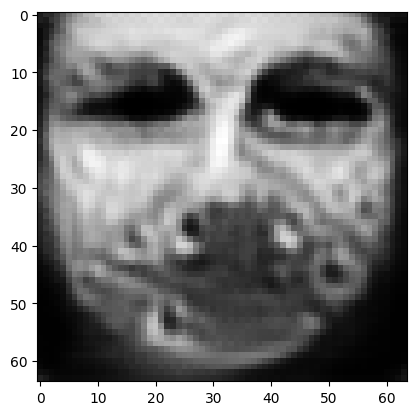

tensor([[1.1694e-03, 4.3997e-05, 6.0948e-03, 2.0646e-05, 2.5034e-04, 9.7890e-01,
         1.9620e-03, 3.8403e-03, 3.9926e-06, 1.5714e-04, 5.8688e-04, 7.5991e-04,
         1.1793e-05, 1.3193e-07, 3.5074e-07, 1.2880e-03, 2.2024e-04, 5.8547e-04,
         5.4681e-05, 3.0281e-04, 1.3123e-05, 1.5115e-05, 1.3355e-07, 2.6325e-05,
         1.0433e-06, 1.8955e-06, 1.1581e-03, 3.6442e-04, 4.4376e-04, 2.8276e-06,
         4.8410e-07, 2.5319e-05, 9.0180e-05, 1.7022e-05, 7.5795e-05, 1.5248e-06,
         2.1349e-05, 2.1570e-05, 1.7525e-05, 1.4454e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021321605890989304
tensor([[1.1693e-03, 4.3988e-05, 6.0936e-03, 2.0642e-05, 2.5030e-04, 9.7891e-01,
         1.9616e-03, 3.8397e-03, 3.9916e-06, 1.5711e-04, 5.8675e-04, 7.5973e-04,
         1.1791e-05, 1.3188e-07, 3.5064e-07, 1.2877e-03, 2.2019e-04, 5.8533e-04,
         5.4668e-05, 3.0275e-04, 1.3119e-05, 1.5111e-05, 1.3350e-07, 2.6318e-05,
         1.0430e-06, 1.8949e-06, 1.1579e-

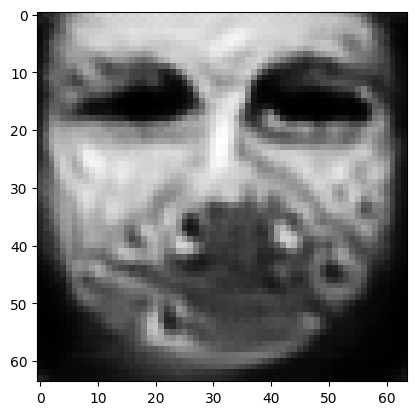

tensor([[1.1689e-03, 4.3956e-05, 6.0888e-03, 2.0629e-05, 2.5016e-04, 9.7892e-01,
         1.9602e-03, 3.8372e-03, 3.9876e-06, 1.5701e-04, 5.8627e-04, 7.5899e-04,
         1.1783e-05, 1.3171e-07, 3.5025e-07, 1.2868e-03, 2.2000e-04, 5.8480e-04,
         5.4621e-05, 3.0250e-04, 1.3104e-05, 1.5096e-05, 1.3330e-07, 2.6292e-05,
         1.0418e-06, 1.8929e-06, 1.1571e-03, 3.6401e-04, 4.4327e-04, 2.8243e-06,
         4.8343e-07, 2.5290e-05, 9.0048e-05, 1.6998e-05, 7.5741e-05, 1.5225e-06,
         2.1322e-05, 2.1535e-05, 1.7502e-05, 1.4440e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021301651373505592
tensor([[1.1688e-03, 4.3948e-05, 6.0876e-03, 2.0626e-05, 2.5012e-04, 9.7893e-01,
         1.9599e-03, 3.8366e-03, 3.9866e-06, 1.5698e-04, 5.8615e-04, 7.5881e-04,
         1.1781e-05, 1.3167e-07, 3.5016e-07, 1.2866e-03, 2.1995e-04, 5.8469e-04,
         5.4610e-05, 3.0244e-04, 1.3101e-05, 1.5092e-05, 1.3325e-07, 2.6286e-05,
         1.0415e-06, 1.8923e-06, 1.1570e-

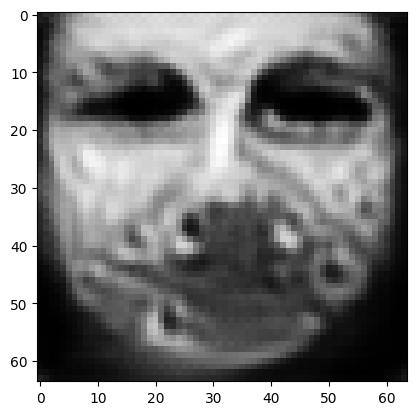

tensor([[1.1684e-03, 4.3917e-05, 6.0830e-03, 2.0614e-05, 2.4998e-04, 9.7894e-01,
         1.9586e-03, 3.8342e-03, 3.9828e-06, 1.5689e-04, 5.8568e-04, 7.5811e-04,
         1.1774e-05, 1.3150e-07, 3.4979e-07, 1.2857e-03, 2.1977e-04, 5.8418e-04,
         5.4564e-05, 3.0221e-04, 1.3086e-05, 1.5077e-05, 1.3306e-07, 2.6260e-05,
         1.0404e-06, 1.8904e-06, 1.1562e-03, 3.6363e-04, 4.4280e-04, 2.8213e-06,
         4.8278e-07, 2.5263e-05, 8.9922e-05, 1.6975e-05, 7.5690e-05, 1.5204e-06,
         2.1296e-05, 2.1502e-05, 1.7479e-05, 1.4426e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021282630041241646
tensor([[1.1684e-03, 4.3910e-05, 6.0818e-03, 2.0611e-05, 2.4995e-04, 9.7895e-01,
         1.9583e-03, 3.8336e-03, 3.9819e-06, 1.5686e-04, 5.8557e-04, 7.5793e-04,
         1.1772e-05, 1.3146e-07, 3.4970e-07, 1.2855e-03, 2.1972e-04, 5.8406e-04,
         5.4553e-05, 3.0215e-04, 1.3083e-05, 1.5074e-05, 1.3301e-07, 2.6255e-05,
         1.0401e-06, 1.8899e-06, 1.1560e-

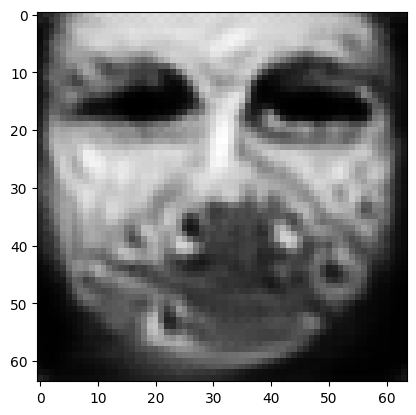

tensor([[1.1680e-03, 4.3879e-05, 6.0775e-03, 2.0599e-05, 2.4982e-04, 9.7896e-01,
         1.9570e-03, 3.8315e-03, 3.9781e-06, 1.5677e-04, 5.8513e-04, 7.5726e-04,
         1.1764e-05, 1.3130e-07, 3.4935e-07, 1.2847e-03, 2.1956e-04, 5.8358e-04,
         5.4510e-05, 3.0192e-04, 1.3069e-05, 1.5060e-05, 1.3283e-07, 2.6232e-05,
         1.0390e-06, 1.8880e-06, 1.1553e-03, 3.6327e-04, 4.4236e-04, 2.8183e-06,
         4.8216e-07, 2.5237e-05, 8.9801e-05, 1.6953e-05, 7.5641e-05, 1.5183e-06,
         2.1272e-05, 2.1471e-05, 1.7458e-05, 1.4412e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021264541894197464
tensor([[1.1679e-03, 4.3871e-05, 6.0765e-03, 2.0597e-05, 2.4979e-04, 9.7896e-01,
         1.9567e-03, 3.8309e-03, 3.9772e-06, 1.5675e-04, 5.8502e-04, 7.5709e-04,
         1.1762e-05, 1.3125e-07, 3.4925e-07, 1.2845e-03, 2.1952e-04, 5.8345e-04,
         5.4499e-05, 3.0186e-04, 1.3065e-05, 1.5056e-05, 1.3278e-07, 2.6225e-05,
         1.0388e-06, 1.8876e-06, 1.1551e-

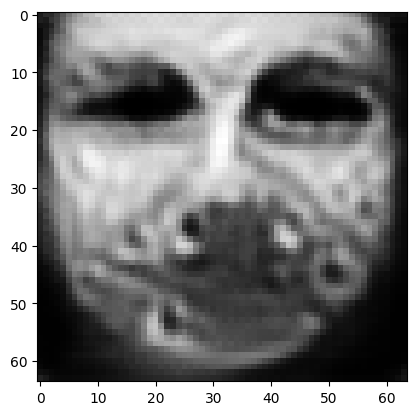

tensor([[1.1675e-03, 4.3842e-05, 6.0723e-03, 2.0585e-05, 2.4966e-04, 9.7898e-01,
         1.9555e-03, 3.8289e-03, 3.9737e-06, 1.5665e-04, 5.8460e-04, 7.5643e-04,
         1.1755e-05, 1.3110e-07, 3.4891e-07, 1.2837e-03, 2.1936e-04, 5.8298e-04,
         5.4458e-05, 3.0164e-04, 1.3052e-05, 1.5043e-05, 1.3261e-07, 2.6203e-05,
         1.0378e-06, 1.8858e-06, 1.1544e-03, 3.6292e-04, 4.4194e-04, 2.8154e-06,
         4.8157e-07, 2.5210e-05, 8.9685e-05, 1.6931e-05, 7.5593e-05, 1.5163e-06,
         2.1248e-05, 2.1441e-05, 1.7438e-05, 1.4399e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0212475024163723
tensor([[1.1675e-03, 4.3835e-05, 6.0713e-03, 2.0583e-05, 2.4963e-04, 9.7898e-01,
         1.9552e-03, 3.8284e-03, 3.9728e-06, 1.5663e-04, 5.8451e-04, 7.5628e-04,
         1.1753e-05, 1.3106e-07, 3.4883e-07, 1.2835e-03, 2.1933e-04, 5.8288e-04,
         5.4448e-05, 3.0159e-04, 1.3049e-05, 1.5039e-05, 1.3256e-07, 2.6198e-05,
         1.0376e-06, 1.8854e-06, 1.1542e-03

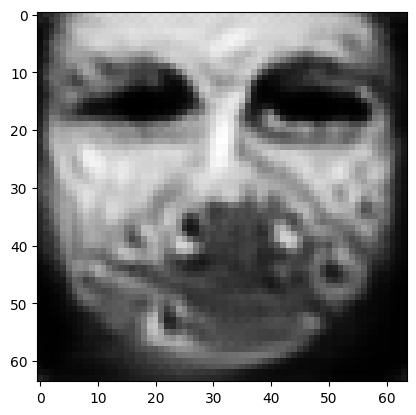

tensor([[1.1671e-03, 4.3807e-05, 6.0674e-03, 2.0572e-05, 2.4951e-04, 9.7899e-01,
         1.9541e-03, 3.8264e-03, 3.9694e-06, 1.5655e-04, 5.8410e-04, 7.5565e-04,
         1.1746e-05, 1.3092e-07, 3.4850e-07, 1.2827e-03, 2.1918e-04, 5.8243e-04,
         5.4409e-05, 3.0138e-04, 1.3036e-05, 1.5027e-05, 1.3240e-07, 2.6177e-05,
         1.0366e-06, 1.8837e-06, 1.1535e-03, 3.6260e-04, 4.4154e-04, 2.8127e-06,
         4.8100e-07, 2.5186e-05, 8.9574e-05, 1.6911e-05, 7.5548e-05, 1.5144e-06,
         2.1226e-05, 2.1412e-05, 1.7418e-05, 1.4387e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021231047809123993
tensor([[1.1670e-03, 4.3800e-05, 6.0665e-03, 2.0569e-05, 2.4949e-04, 9.7900e-01,
         1.9538e-03, 3.8260e-03, 3.9685e-06, 1.5652e-04, 5.8401e-04, 7.5550e-04,
         1.1745e-05, 1.3088e-07, 3.4842e-07, 1.2825e-03, 2.1915e-04, 5.8232e-04,
         5.4399e-05, 3.0133e-04, 1.3033e-05, 1.5023e-05, 1.3236e-07, 2.6172e-05,
         1.0364e-06, 1.8834e-06, 1.1533e-

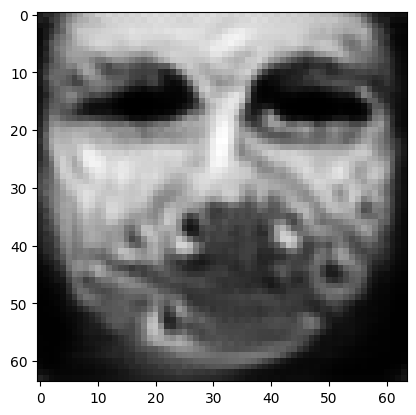

tensor([[1.1667e-03, 4.3773e-05, 6.0628e-03, 2.0559e-05, 2.4937e-04, 9.7901e-01,
         1.9527e-03, 3.8241e-03, 3.9653e-06, 1.5644e-04, 5.8363e-04, 7.5490e-04,
         1.1738e-05, 1.3074e-07, 3.4811e-07, 1.2818e-03, 2.1901e-04, 5.8190e-04,
         5.4362e-05, 3.0113e-04, 1.3021e-05, 1.5011e-05, 1.3220e-07, 2.6153e-05,
         1.0355e-06, 1.8818e-06, 1.1526e-03, 3.6229e-04, 4.4117e-04, 2.8101e-06,
         4.8047e-07, 2.5163e-05, 8.9470e-05, 1.6892e-05, 7.5505e-05, 1.5126e-06,
         2.1205e-05, 2.1385e-05, 1.7400e-05, 1.4375e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02121552638709545
tensor([[1.1667e-03, 4.3767e-05, 6.0619e-03, 2.0557e-05, 2.4935e-04, 9.7901e-01,
         1.9525e-03, 3.8237e-03, 3.9645e-06, 1.5642e-04, 5.8354e-04, 7.5476e-04,
         1.1737e-05, 1.3071e-07, 3.4804e-07, 1.2816e-03, 2.1898e-04, 5.8180e-04,
         5.4353e-05, 3.0108e-04, 1.3018e-05, 1.5008e-05, 1.3216e-07, 2.6148e-05,
         1.0353e-06, 1.8814e-06, 1.1525e-0

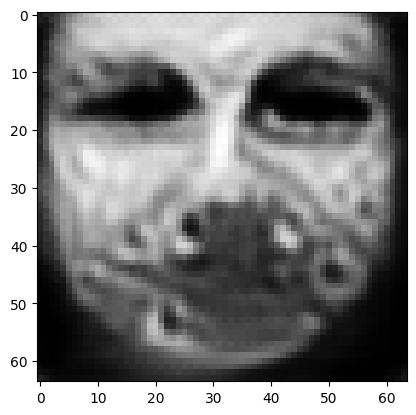

tensor([[1.1664e-03, 4.3742e-05, 6.0583e-03, 2.0548e-05, 2.4924e-04, 9.7902e-01,
         1.9515e-03, 3.8219e-03, 3.9615e-06, 1.5634e-04, 5.8318e-04, 7.5421e-04,
         1.1730e-05, 1.3057e-07, 3.4774e-07, 1.2810e-03, 2.1884e-04, 5.8141e-04,
         5.4318e-05, 3.0089e-04, 1.3007e-05, 1.4997e-05, 1.3201e-07, 2.6129e-05,
         1.0344e-06, 1.8799e-06, 1.1519e-03, 3.6200e-04, 4.4081e-04, 2.8077e-06,
         4.7996e-07, 2.5141e-05, 8.9371e-05, 1.6873e-05, 7.5465e-05, 1.5109e-06,
         2.1185e-05, 2.1360e-05, 1.7382e-05, 1.4364e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021200820803642273
tensor([[1.1663e-03, 4.3736e-05, 6.0574e-03, 2.0545e-05, 2.4921e-04, 9.7903e-01,
         1.9512e-03, 3.8215e-03, 3.9607e-06, 1.5632e-04, 5.8309e-04, 7.5406e-04,
         1.1729e-05, 1.3054e-07, 3.4767e-07, 1.2808e-03, 2.1881e-04, 5.8131e-04,
         5.4310e-05, 3.0085e-04, 1.3004e-05, 1.4994e-05, 1.3198e-07, 2.6124e-05,
         1.0342e-06, 1.8795e-06, 1.1517e-

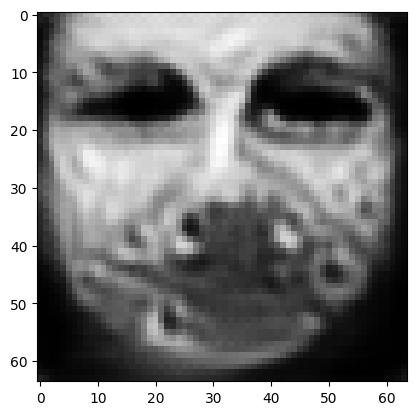

tensor([[1.1660e-03, 4.3712e-05, 6.0541e-03, 2.0536e-05, 2.4911e-04, 9.7904e-01,
         1.9503e-03, 3.8198e-03, 3.9578e-06, 1.5625e-04, 5.8275e-04, 7.5353e-04,
         1.1723e-05, 1.3042e-07, 3.4739e-07, 1.2801e-03, 2.1869e-04, 5.8093e-04,
         5.4276e-05, 3.0067e-04, 1.2993e-05, 1.4983e-05, 1.3183e-07, 2.6106e-05,
         1.0334e-06, 1.8781e-06, 1.1511e-03, 3.6172e-04, 4.4047e-04, 2.8053e-06,
         4.7948e-07, 2.5120e-05, 8.9277e-05, 1.6856e-05, 7.5427e-05, 1.5093e-06,
         2.1166e-05, 2.1335e-05, 1.7366e-05, 1.4353e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021186815574765205
tensor([[1.1659e-03, 4.3706e-05, 6.0533e-03, 2.0534e-05, 2.4909e-04, 9.7904e-01,
         1.9500e-03, 3.8194e-03, 3.9571e-06, 1.5623e-04, 5.8267e-04, 7.5340e-04,
         1.1722e-05, 1.3039e-07, 3.4732e-07, 1.2800e-03, 2.1866e-04, 5.8084e-04,
         5.4268e-05, 3.0062e-04, 1.2990e-05, 1.4980e-05, 1.3180e-07, 2.6102e-05,
         1.0332e-06, 1.8777e-06, 1.1510e-

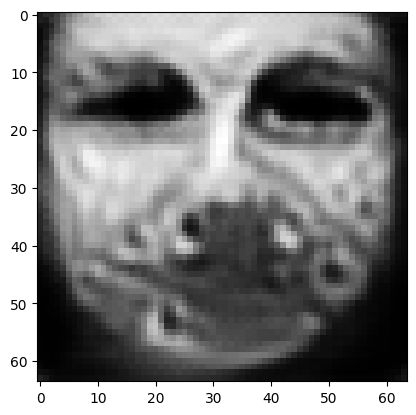

tensor([[1.1657e-03, 4.3683e-05, 6.0501e-03, 2.0526e-05, 2.4899e-04, 9.7905e-01,
         1.9491e-03, 3.8178e-03, 3.9544e-06, 1.5616e-04, 5.8235e-04, 7.5290e-04,
         1.1716e-05, 1.3027e-07, 3.4706e-07, 1.2794e-03, 2.1854e-04, 5.8048e-04,
         5.4236e-05, 3.0045e-04, 1.2980e-05, 1.4970e-05, 1.3166e-07, 2.6085e-05,
         1.0324e-06, 1.8764e-06, 1.1504e-03, 3.6145e-04, 4.4015e-04, 2.8031e-06,
         4.7902e-07, 2.5100e-05, 8.9188e-05, 1.6840e-05, 7.5390e-05, 1.5078e-06,
         2.1149e-05, 2.1312e-05, 1.7350e-05, 1.4343e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021173743531107903
tensor([[1.1656e-03, 4.3678e-05, 6.0494e-03, 2.0524e-05, 2.4897e-04, 9.7905e-01,
         1.9489e-03, 3.8174e-03, 3.9537e-06, 1.5614e-04, 5.8227e-04, 7.5277e-04,
         1.1715e-05, 1.3024e-07, 3.4699e-07, 1.2792e-03, 2.1851e-04, 5.8039e-04,
         5.4228e-05, 3.0041e-04, 1.2978e-05, 1.4967e-05, 1.3163e-07, 2.6081e-05,
         1.0323e-06, 1.8761e-06, 1.1503e-

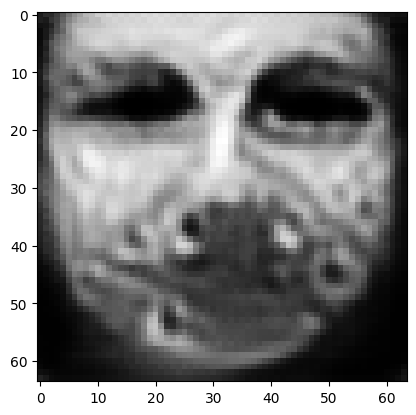

tensor([[1.1654e-03, 4.3657e-05, 6.0463e-03, 2.0515e-05, 2.4888e-04, 9.7906e-01,
         1.9480e-03, 3.8159e-03, 3.9511e-06, 1.5608e-04, 5.8196e-04, 7.5230e-04,
         1.1709e-05, 1.3012e-07, 3.4675e-07, 1.2786e-03, 2.1840e-04, 5.8006e-04,
         5.4198e-05, 3.0025e-04, 1.2968e-05, 1.4957e-05, 1.3150e-07, 2.6065e-05,
         1.0315e-06, 1.8747e-06, 1.1497e-03, 3.6120e-04, 4.3985e-04, 2.8011e-06,
         4.7859e-07, 2.5081e-05, 8.9102e-05, 1.6824e-05, 7.5356e-05, 1.5063e-06,
         2.1132e-05, 2.1290e-05, 1.7335e-05, 1.4334e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021160906180739403
tensor([[1.1653e-03, 4.3651e-05, 6.0456e-03, 2.0514e-05, 2.4886e-04, 9.7906e-01,
         1.9478e-03, 3.8156e-03, 3.9505e-06, 1.5606e-04, 5.8189e-04, 7.5218e-04,
         1.1708e-05, 1.3010e-07, 3.4668e-07, 1.2785e-03, 2.1837e-04, 5.7997e-04,
         5.4191e-05, 3.0021e-04, 1.2966e-05, 1.4955e-05, 1.3147e-07, 2.6061e-05,
         1.0314e-06, 1.8744e-06, 1.1496e-

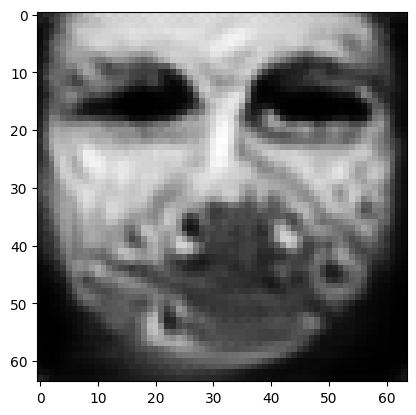

tensor([[1.1651e-03, 4.3631e-05, 6.0427e-03, 2.0506e-05, 2.4877e-04, 9.7907e-01,
         1.9470e-03, 3.8142e-03, 3.9480e-06, 1.5600e-04, 5.8160e-04, 7.5171e-04,
         1.1703e-05, 1.2999e-07, 3.4644e-07, 1.2779e-03, 2.1826e-04, 5.7964e-04,
         5.4163e-05, 3.0006e-04, 1.2956e-05, 1.4945e-05, 1.3135e-07, 2.6046e-05,
         1.0307e-06, 1.8732e-06, 1.1491e-03, 3.6096e-04, 4.3956e-04, 2.7990e-06,
         4.7817e-07, 2.5063e-05, 8.9021e-05, 1.6809e-05, 7.5323e-05, 1.5049e-06,
         2.1115e-05, 2.1269e-05, 1.7320e-05, 1.4325e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02114911749958992
tensor([[1.1650e-03, 4.3626e-05, 6.0420e-03, 2.0504e-05, 2.4875e-04, 9.7908e-01,
         1.9468e-03, 3.8138e-03, 3.9473e-06, 1.5598e-04, 5.8152e-04, 7.5159e-04,
         1.1702e-05, 1.2996e-07, 3.4638e-07, 1.2778e-03, 2.1824e-04, 5.7957e-04,
         5.4156e-05, 3.0002e-04, 1.2954e-05, 1.4943e-05, 1.3132e-07, 2.6042e-05,
         1.0305e-06, 1.8729e-06, 1.1489e-0

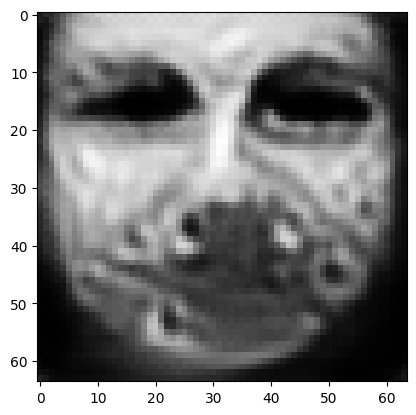

tensor([[1.1648e-03, 4.3607e-05, 6.0392e-03, 2.0497e-05, 2.4867e-04, 9.7908e-01,
         1.9460e-03, 3.8125e-03, 3.9450e-06, 1.5592e-04, 5.8125e-04, 7.5116e-04,
         1.1697e-05, 1.2986e-07, 3.4616e-07, 1.2773e-03, 2.1813e-04, 5.7926e-04,
         5.4129e-05, 2.9988e-04, 1.2945e-05, 1.4934e-05, 1.3121e-07, 2.6027e-05,
         1.0298e-06, 1.8717e-06, 1.1485e-03, 3.6074e-04, 4.3928e-04, 2.7971e-06,
         4.7778e-07, 2.5045e-05, 8.8944e-05, 1.6795e-05, 7.5291e-05, 1.5036e-06,
         2.1100e-05, 2.1249e-05, 1.7307e-05, 1.4316e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021137796342372894
tensor([[1.1647e-03, 4.3602e-05, 6.0386e-03, 2.0495e-05, 2.4865e-04, 9.7909e-01,
         1.9458e-03, 3.8122e-03, 3.9444e-06, 1.5591e-04, 5.8118e-04, 7.5105e-04,
         1.1696e-05, 1.2983e-07, 3.4610e-07, 1.2772e-03, 2.1811e-04, 5.7918e-04,
         5.4123e-05, 2.9984e-04, 1.2943e-05, 1.4932e-05, 1.3118e-07, 2.6024e-05,
         1.0297e-06, 1.8715e-06, 1.1483e-

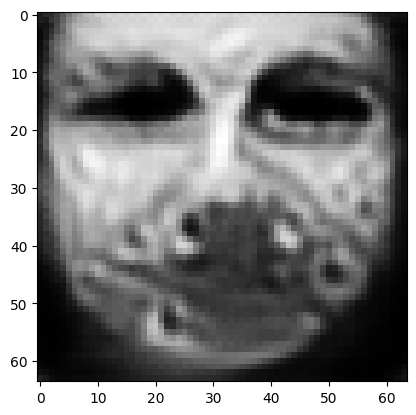

tensor([[1.1645e-03, 4.3583e-05, 6.0359e-03, 2.0488e-05, 2.4858e-04, 9.7909e-01,
         1.9451e-03, 3.8109e-03, 3.9422e-06, 1.5585e-04, 5.8091e-04, 7.5064e-04,
         1.1691e-05, 1.2973e-07, 3.4589e-07, 1.2767e-03, 2.1801e-04, 5.7890e-04,
         5.4097e-05, 2.9970e-04, 1.2934e-05, 1.4923e-05, 1.3107e-07, 2.6010e-05,
         1.0290e-06, 1.8703e-06, 1.1479e-03, 3.6052e-04, 4.3902e-04, 2.7953e-06,
         4.7741e-07, 2.5029e-05, 8.8871e-05, 1.6782e-05, 7.5262e-05, 1.5024e-06,
         2.1086e-05, 2.1231e-05, 1.7294e-05, 1.4308e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021127058193087578
tensor([[1.1645e-03, 4.3579e-05, 6.0353e-03, 2.0486e-05, 2.4856e-04, 9.7910e-01,
         1.9449e-03, 3.8106e-03, 3.9416e-06, 1.5584e-04, 5.8085e-04, 7.5053e-04,
         1.1690e-05, 1.2971e-07, 3.4584e-07, 1.2766e-03, 2.1799e-04, 5.7883e-04,
         5.4092e-05, 2.9967e-04, 1.2932e-05, 1.4921e-05, 1.3104e-07, 2.6007e-05,
         1.0289e-06, 1.8701e-06, 1.1478e-

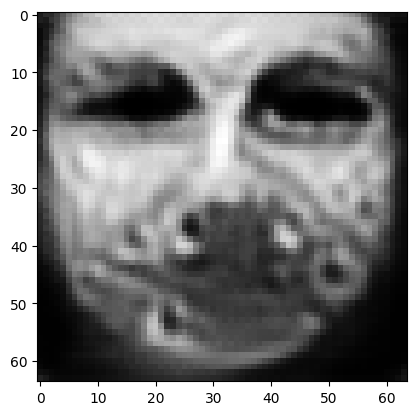

tensor([[1.1643e-03, 4.3562e-05, 6.0328e-03, 2.0480e-05, 2.4848e-04, 9.7910e-01,
         1.9443e-03, 3.8094e-03, 3.9395e-06, 1.5578e-04, 5.8060e-04, 7.5013e-04,
         1.1686e-05, 1.2962e-07, 3.4563e-07, 1.2761e-03, 2.1790e-04, 5.7855e-04,
         5.4068e-05, 2.9954e-04, 1.2924e-05, 1.4913e-05, 1.3094e-07, 2.5994e-05,
         1.0283e-06, 1.8690e-06, 1.1473e-03, 3.6032e-04, 4.3877e-04, 2.7936e-06,
         4.7706e-07, 2.5013e-05, 8.8801e-05, 1.6769e-05, 7.5233e-05, 1.5012e-06,
         2.1073e-05, 2.1213e-05, 1.7281e-05, 1.4300e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02111690305173397
tensor([[1.1642e-03, 4.3557e-05, 6.0322e-03, 2.0478e-05, 2.4847e-04, 9.7911e-01,
         1.9441e-03, 3.8091e-03, 3.9390e-06, 1.5577e-04, 5.8054e-04, 7.5004e-04,
         1.1685e-05, 1.2959e-07, 3.4558e-07, 1.2760e-03, 2.1788e-04, 5.7848e-04,
         5.4061e-05, 2.9950e-04, 1.2922e-05, 1.4911e-05, 1.3091e-07, 2.5991e-05,
         1.0281e-06, 1.8688e-06, 1.1472e-0

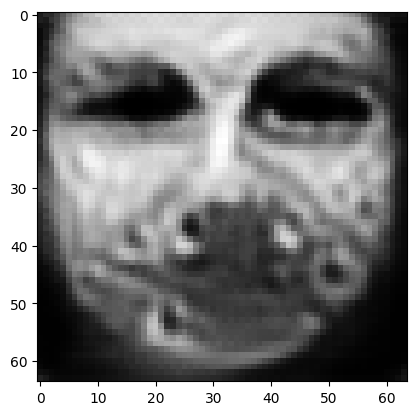

tensor([[1.1641e-03, 4.3541e-05, 6.0299e-03, 2.0472e-05, 2.4840e-04, 9.7911e-01,
         1.9434e-03, 3.8080e-03, 3.9370e-06, 1.5572e-04, 5.8030e-04, 7.4966e-04,
         1.1680e-05, 1.2951e-07, 3.4538e-07, 1.2756e-03, 2.1779e-04, 5.7822e-04,
         5.4039e-05, 2.9938e-04, 1.2915e-05, 1.4903e-05, 1.3082e-07, 2.5979e-05,
         1.0276e-06, 1.8678e-06, 1.1468e-03, 3.6013e-04, 4.3853e-04, 2.7919e-06,
         4.7672e-07, 2.4998e-05, 8.8735e-05, 1.6757e-05, 7.5206e-05, 1.5001e-06,
         2.1060e-05, 2.1196e-05, 1.7270e-05, 1.4293e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021107332780957222
tensor([[1.1640e-03, 4.3537e-05, 6.0293e-03, 2.0471e-05, 2.4838e-04, 9.7912e-01,
         1.9433e-03, 3.8077e-03, 3.9365e-06, 1.5571e-04, 5.8024e-04, 7.4958e-04,
         1.1680e-05, 1.2949e-07, 3.4534e-07, 1.2755e-03, 2.1777e-04, 5.7816e-04,
         5.4034e-05, 2.9935e-04, 1.2913e-05, 1.4902e-05, 1.3079e-07, 2.5976e-05,
         1.0274e-06, 1.8675e-06, 1.1467e-

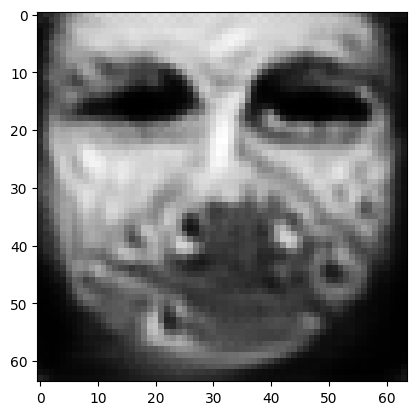

tensor([[1.1639e-03, 4.3521e-05, 6.0270e-03, 2.0465e-05, 2.4831e-04, 9.7912e-01,
         1.9427e-03, 3.8066e-03, 3.9345e-06, 1.5566e-04, 5.8002e-04, 7.4922e-04,
         1.1676e-05, 1.2940e-07, 3.4516e-07, 1.2751e-03, 2.1769e-04, 5.7792e-04,
         5.4013e-05, 2.9923e-04, 1.2906e-05, 1.4894e-05, 1.3070e-07, 2.5965e-05,
         1.0269e-06, 1.8666e-06, 1.1463e-03, 3.5995e-04, 4.3831e-04, 2.7904e-06,
         4.7641e-07, 2.4985e-05, 8.8672e-05, 1.6746e-05, 7.5181e-05, 1.4990e-06,
         2.1048e-05, 2.1180e-05, 1.7258e-05, 1.4286e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02109811082482338
tensor([[1.1638e-03, 4.3517e-05, 6.0265e-03, 2.0463e-05, 2.4830e-04, 9.7912e-01,
         1.9425e-03, 3.8063e-03, 3.9341e-06, 1.5565e-04, 5.7997e-04, 7.4914e-04,
         1.1675e-05, 1.2938e-07, 3.4511e-07, 1.2750e-03, 2.1767e-04, 5.7785e-04,
         5.4007e-05, 2.9920e-04, 1.2904e-05, 1.4892e-05, 1.3068e-07, 2.5961e-05,
         1.0268e-06, 1.8664e-06, 1.1462e-0

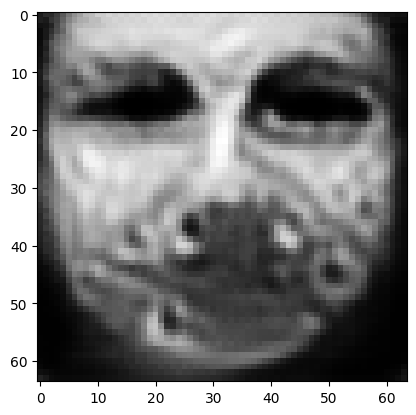

tensor([[1.1637e-03, 4.3503e-05, 6.0243e-03, 2.0458e-05, 2.4823e-04, 9.7913e-01,
         1.9419e-03, 3.8053e-03, 3.9322e-06, 1.5560e-04, 5.7975e-04, 7.4880e-04,
         1.1671e-05, 1.2930e-07, 3.4493e-07, 1.2746e-03, 2.1760e-04, 5.7762e-04,
         5.3987e-05, 2.9909e-04, 1.2898e-05, 1.4885e-05, 1.3059e-07, 2.5951e-05,
         1.0263e-06, 1.8654e-06, 1.1458e-03, 3.5977e-04, 4.3810e-04, 2.7889e-06,
         4.7610e-07, 2.4971e-05, 8.8612e-05, 1.6735e-05, 7.5157e-05, 1.4980e-06,
         2.1036e-05, 2.1164e-05, 1.7248e-05, 1.4279e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021089358255267143
tensor([[1.1636e-03, 4.3499e-05, 6.0238e-03, 2.0456e-05, 2.4822e-04, 9.7913e-01,
         1.9418e-03, 3.8051e-03, 3.9318e-06, 1.5559e-04, 5.7970e-04, 7.4872e-04,
         1.1670e-05, 1.2928e-07, 3.4489e-07, 1.2745e-03, 2.1758e-04, 5.7756e-04,
         5.3982e-05, 2.9906e-04, 1.2896e-05, 1.4884e-05, 1.3057e-07, 2.5948e-05,
         1.0261e-06, 1.8652e-06, 1.1457e-

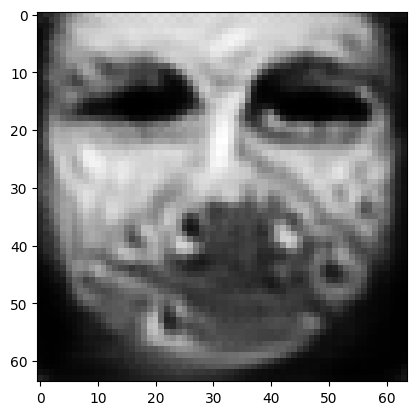

tensor([[1.1634e-03, 4.3485e-05, 6.0218e-03, 2.0451e-05, 2.4816e-04, 9.7914e-01,
         1.9412e-03, 3.8041e-03, 3.9300e-06, 1.5554e-04, 5.7950e-04, 7.4841e-04,
         1.1666e-05, 1.2921e-07, 3.4472e-07, 1.2741e-03, 2.1751e-04, 5.7734e-04,
         5.3963e-05, 2.9896e-04, 1.2889e-05, 1.4877e-05, 1.3048e-07, 2.5937e-05,
         1.0257e-06, 1.8644e-06, 1.1454e-03, 3.5961e-04, 4.3790e-04, 2.7875e-06,
         4.7582e-07, 2.4958e-05, 8.8555e-05, 1.6724e-05, 7.5134e-05, 1.4971e-06,
         2.1025e-05, 2.1150e-05, 1.7237e-05, 1.4273e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021081069484353065
tensor([[1.1634e-03, 4.3481e-05, 6.0213e-03, 2.0450e-05, 2.4815e-04, 9.7914e-01,
         1.9411e-03, 3.8039e-03, 3.9296e-06, 1.5553e-04, 5.7945e-04, 7.4832e-04,
         1.1665e-05, 1.2919e-07, 3.4469e-07, 1.2740e-03, 2.1749e-04, 5.7729e-04,
         5.3958e-05, 2.9893e-04, 1.2888e-05, 1.4875e-05, 1.3046e-07, 2.5935e-05,
         1.0255e-06, 1.8642e-06, 1.1453e-

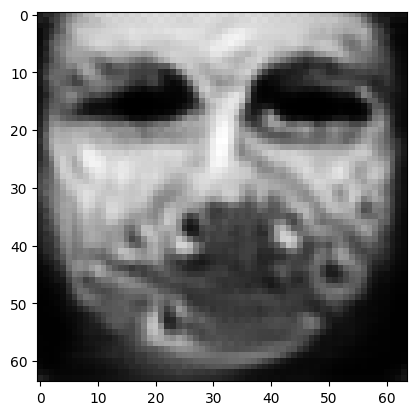

tensor([[1.1633e-03, 4.3468e-05, 6.0194e-03, 2.0445e-05, 2.4809e-04, 9.7915e-01,
         1.9406e-03, 3.8029e-03, 3.9279e-06, 1.5549e-04, 5.7926e-04, 7.4802e-04,
         1.1662e-05, 1.2912e-07, 3.4453e-07, 1.2737e-03, 2.1742e-04, 5.7707e-04,
         5.3940e-05, 2.9883e-04, 1.2882e-05, 1.4869e-05, 1.3038e-07, 2.5925e-05,
         1.0251e-06, 1.8634e-06, 1.1449e-03, 3.5945e-04, 4.3770e-04, 2.7861e-06,
         4.7554e-07, 2.4946e-05, 8.8501e-05, 1.6714e-05, 7.5113e-05, 1.4962e-06,
         2.1015e-05, 2.1136e-05, 1.7228e-05, 1.4266e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021073250100016594
tensor([[1.1632e-03, 4.3464e-05, 6.0189e-03, 2.0443e-05, 2.4808e-04, 9.7915e-01,
         1.9404e-03, 3.8027e-03, 3.9275e-06, 1.5548e-04, 5.7921e-04, 7.4794e-04,
         1.1661e-05, 1.2910e-07, 3.4449e-07, 1.2736e-03, 2.1740e-04, 5.7702e-04,
         5.3935e-05, 2.9880e-04, 1.2880e-05, 1.4868e-05, 1.3036e-07, 2.5923e-05,
         1.0250e-06, 1.8632e-06, 1.1449e-

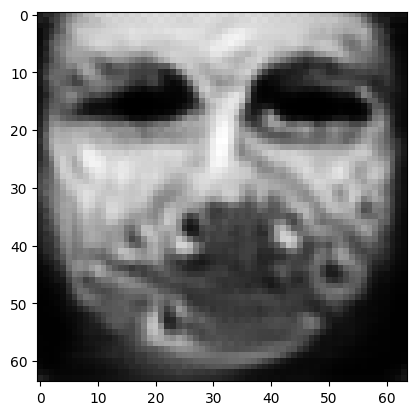

tensor([[1.1631e-03, 4.3452e-05, 6.0171e-03, 2.0439e-05, 2.4802e-04, 9.7915e-01,
         1.9399e-03, 3.8018e-03, 3.9260e-06, 1.5544e-04, 5.7903e-04, 7.4766e-04,
         1.1658e-05, 1.2903e-07, 3.4433e-07, 1.2732e-03, 2.1733e-04, 5.7681e-04,
         5.3918e-05, 2.9870e-04, 1.2874e-05, 1.4862e-05, 1.3029e-07, 2.5913e-05,
         1.0245e-06, 1.8624e-06, 1.1445e-03, 3.5930e-04, 4.3753e-04, 2.7848e-06,
         4.7529e-07, 2.4934e-05, 8.8450e-05, 1.6705e-05, 7.5092e-05, 1.4953e-06,
         2.1005e-05, 2.1123e-05, 1.7219e-05, 1.4261e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02106577903032303
tensor([[1.1630e-03, 4.3449e-05, 6.0167e-03, 2.0437e-05, 2.4801e-04, 9.7916e-01,
         1.9398e-03, 3.8016e-03, 3.9256e-06, 1.5543e-04, 5.7898e-04, 7.4758e-04,
         1.1657e-05, 1.2901e-07, 3.4430e-07, 1.2732e-03, 2.1732e-04, 5.7676e-04,
         5.3914e-05, 2.9868e-04, 1.2873e-05, 1.4860e-05, 1.3027e-07, 2.5911e-05,
         1.0244e-06, 1.8622e-06, 1.1444e-0

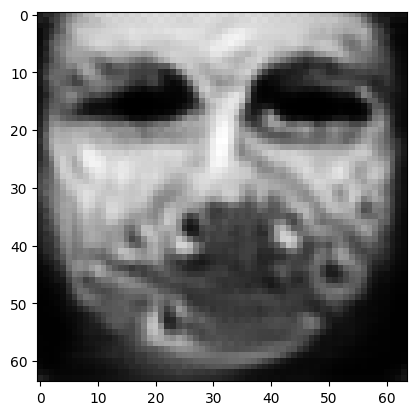

tensor([[1.1629e-03, 4.3436e-05, 6.0150e-03, 2.0433e-05, 2.4796e-04, 9.7916e-01,
         1.9393e-03, 3.8008e-03, 3.9241e-06, 1.5539e-04, 5.7881e-04, 7.4731e-04,
         1.1654e-05, 1.2895e-07, 3.4415e-07, 1.2728e-03, 2.1726e-04, 5.7656e-04,
         5.3897e-05, 2.9859e-04, 1.2867e-05, 1.4854e-05, 1.3020e-07, 2.5902e-05,
         1.0240e-06, 1.8615e-06, 1.1441e-03, 3.5916e-04, 4.3735e-04, 2.7836e-06,
         4.7504e-07, 2.4923e-05, 8.8400e-05, 1.6696e-05, 7.5072e-05, 1.4944e-06,
         2.0995e-05, 2.1110e-05, 1.7210e-05, 1.4256e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021058660000562668
tensor([[1.1629e-03, 4.3433e-05, 6.0146e-03, 2.0432e-05, 2.4795e-04, 9.7916e-01,
         1.9392e-03, 3.8006e-03, 3.9237e-06, 1.5538e-04, 5.7877e-04, 7.4724e-04,
         1.1653e-05, 1.2893e-07, 3.4411e-07, 1.2728e-03, 2.1724e-04, 5.7651e-04,
         5.3893e-05, 2.9856e-04, 1.2866e-05, 1.4853e-05, 1.3018e-07, 2.5899e-05,
         1.0239e-06, 1.8613e-06, 1.1440e-

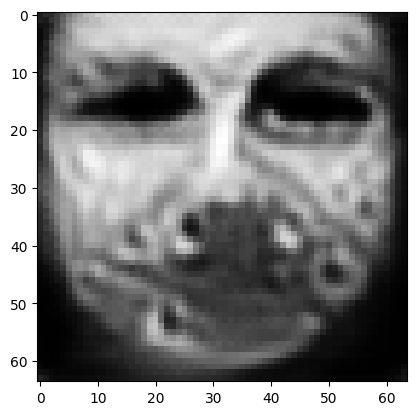

tensor([[1.1627e-03, 4.3422e-05, 6.0129e-03, 2.0427e-05, 2.4790e-04, 9.7917e-01,
         1.9387e-03, 3.7998e-03, 3.9223e-06, 1.5535e-04, 5.7860e-04, 7.4698e-04,
         1.1650e-05, 1.2887e-07, 3.4397e-07, 1.2725e-03, 2.1718e-04, 5.7633e-04,
         5.3877e-05, 2.9847e-04, 1.2861e-05, 1.4848e-05, 1.3011e-07, 2.5891e-05,
         1.0235e-06, 1.8606e-06, 1.1437e-03, 3.5903e-04, 4.3719e-04, 2.7825e-06,
         4.7481e-07, 2.4913e-05, 8.8354e-05, 1.6688e-05, 7.5053e-05, 1.4936e-06,
         2.0986e-05, 2.1099e-05, 1.7202e-05, 1.4250e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021051889285445213
tensor([[1.1627e-03, 4.3419e-05, 6.0126e-03, 2.0426e-05, 2.4788e-04, 9.7917e-01,
         1.9386e-03, 3.7996e-03, 3.9219e-06, 1.5534e-04, 5.7856e-04, 7.4692e-04,
         1.1650e-05, 1.2885e-07, 3.4394e-07, 1.2724e-03, 2.1717e-04, 5.7628e-04,
         5.3873e-05, 2.9845e-04, 1.2859e-05, 1.4846e-05, 1.3009e-07, 2.5889e-05,
         1.0234e-06, 1.8605e-06, 1.1437e-

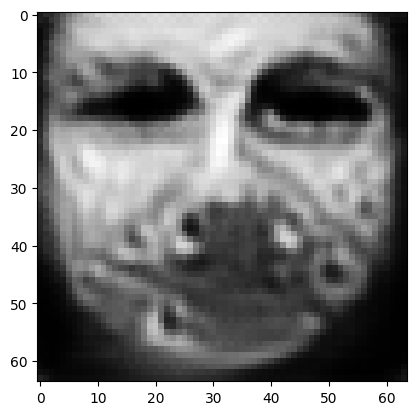

tensor([[1.1626e-03, 4.3408e-05, 6.0110e-03, 2.0422e-05, 2.4784e-04, 9.7917e-01,
         1.9382e-03, 3.7988e-03, 3.9206e-06, 1.5531e-04, 5.7841e-04, 7.4667e-04,
         1.1647e-05, 1.2880e-07, 3.4381e-07, 1.2721e-03, 2.1711e-04, 5.7610e-04,
         5.3859e-05, 2.9837e-04, 1.2854e-05, 1.4841e-05, 1.3003e-07, 2.5880e-05,
         1.0230e-06, 1.8598e-06, 1.1434e-03, 3.5890e-04, 4.3704e-04, 2.7814e-06,
         4.7459e-07, 2.4902e-05, 8.8310e-05, 1.6680e-05, 7.5035e-05, 1.4929e-06,
         2.0978e-05, 2.1087e-05, 1.7194e-05, 1.4246e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021045586094260216
tensor([[1.1626e-03, 4.3405e-05, 6.0106e-03, 2.0421e-05, 2.4783e-04, 9.7918e-01,
         1.9381e-03, 3.7986e-03, 3.9202e-06, 1.5530e-04, 5.7837e-04, 7.4661e-04,
         1.1646e-05, 1.2878e-07, 3.4378e-07, 1.2720e-03, 2.1710e-04, 5.7606e-04,
         5.3855e-05, 2.9835e-04, 1.2853e-05, 1.4840e-05, 1.3001e-07, 2.5879e-05,
         1.0229e-06, 1.8597e-06, 1.1433e-

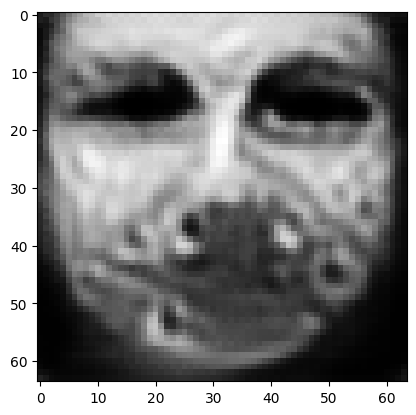

tensor([[1.1624e-03, 4.3395e-05, 6.0092e-03, 2.0417e-05, 2.4778e-04, 9.7918e-01,
         1.9377e-03, 3.7979e-03, 3.9190e-06, 1.5526e-04, 5.7822e-04, 7.4637e-04,
         1.1644e-05, 1.2872e-07, 3.4365e-07, 1.2718e-03, 2.1704e-04, 5.7589e-04,
         5.3841e-05, 2.9826e-04, 1.2848e-05, 1.4835e-05, 1.2995e-07, 2.5871e-05,
         1.0226e-06, 1.8590e-06, 1.1431e-03, 3.5878e-04, 4.3689e-04, 2.7803e-06,
         4.7437e-07, 2.4893e-05, 8.8268e-05, 1.6672e-05, 7.5018e-05, 1.4922e-06,
         2.0970e-05, 2.1077e-05, 1.7186e-05, 1.4241e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021039515733718872
tensor([[1.1624e-03, 4.3393e-05, 6.0088e-03, 2.0417e-05, 2.4777e-04, 9.7918e-01,
         1.9376e-03, 3.7977e-03, 3.9186e-06, 1.5526e-04, 5.7819e-04, 7.4631e-04,
         1.1643e-05, 1.2871e-07, 3.4362e-07, 1.2717e-03, 2.1703e-04, 5.7585e-04,
         5.3837e-05, 2.9825e-04, 1.2847e-05, 1.4834e-05, 1.2994e-07, 2.5869e-05,
         1.0225e-06, 1.8589e-06, 1.1430e-

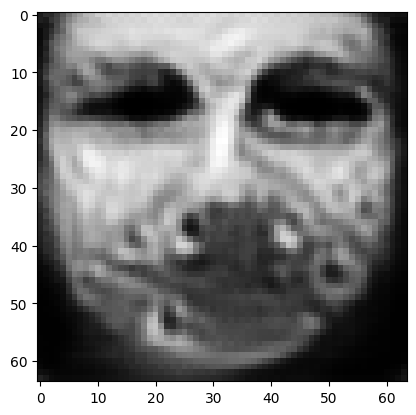

tensor([[1.1623e-03, 4.3382e-05, 6.0074e-03, 2.0413e-05, 2.4773e-04, 9.7919e-01,
         1.9372e-03, 3.7971e-03, 3.9174e-06, 1.5522e-04, 5.7805e-04, 7.4609e-04,
         1.1640e-05, 1.2866e-07, 3.4350e-07, 1.2714e-03, 2.1698e-04, 5.7569e-04,
         5.3823e-05, 2.9817e-04, 1.2843e-05, 1.4829e-05, 1.2988e-07, 2.5861e-05,
         1.0221e-06, 1.8583e-06, 1.1427e-03, 3.5866e-04, 4.3675e-04, 2.7793e-06,
         4.7417e-07, 2.4884e-05, 8.8228e-05, 1.6665e-05, 7.5002e-05, 1.4915e-06,
         2.0962e-05, 2.1067e-05, 1.7179e-05, 1.4237e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02103368006646633
tensor([[1.1623e-03, 4.3380e-05, 6.0071e-03, 2.0412e-05, 2.4772e-04, 9.7919e-01,
         1.9371e-03, 3.7969e-03, 3.9171e-06, 1.5522e-04, 5.7801e-04, 7.4604e-04,
         1.1640e-05, 1.2864e-07, 3.4347e-07, 1.2714e-03, 2.1697e-04, 5.7565e-04,
         5.3820e-05, 2.9815e-04, 1.2842e-05, 1.4828e-05, 1.2986e-07, 2.5860e-05,
         1.0221e-06, 1.8582e-06, 1.1427e-0

In [19]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=5)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.429856300354004


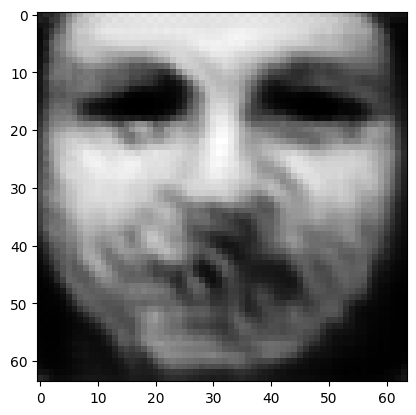

tensor([[0.0034, 0.0030, 0.0273, 0.0142, 0.0901, 0.0030, 0.0076, 0.0061, 0.0055,
         0.0007, 0.0025, 0.0014, 0.0292, 0.0219, 0.0030, 0.0010, 0.0390, 0.0112,
         0.0062, 0.0019, 0.0212, 0.0016, 0.0952, 0.0027, 0.2476, 0.0300, 0.0039,
         0.0162, 0.0186, 0.0173, 0.0062, 0.0029, 0.0252, 0.0233, 0.0206, 0.0224,
         0.0589, 0.0190, 0.0662, 0.0228]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.881272315979004
tensor([[0.0113, 0.0012, 0.0350, 0.0035, 0.0442, 0.0136, 0.0593, 0.0304, 0.0022,
         0.0022, 0.0076, 0.0020, 0.0085, 0.0074, 0.0077, 0.0061, 0.0893, 0.0984,
         0.0057, 0.0406, 0.0101, 0.0019, 0.0017, 0.0156, 0.0475, 0.0010, 0.0091,
         0.0184, 0.0969, 0.0134, 0.0019, 0.0090, 0.1642, 0.0283, 0.0078, 0.0055,
         0.0170, 0.0152, 0.0461, 0.0133]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.82539963722229
tensor([[2.5185e-02, 5.2301e-04, 2.4541e-02, 1.1827e-03, 8.8178e-03, 4.7277e-02,
         2.8

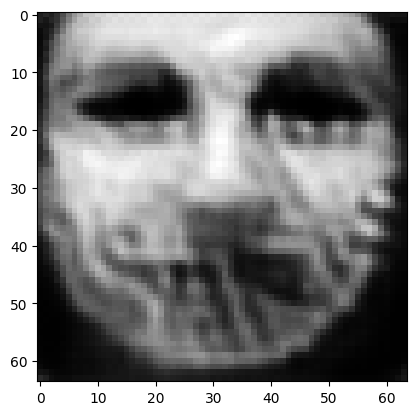

tensor([[1.7174e-02, 3.4730e-04, 4.2815e-03, 5.5894e-04, 2.6523e-03, 1.2838e-02,
         7.0848e-01, 2.0266e-02, 7.0940e-05, 1.1683e-03, 2.0289e-03, 3.2936e-04,
         9.8173e-04, 5.0919e-05, 1.9123e-03, 1.1075e-02, 7.3743e-03, 8.5906e-02,
         5.9647e-03, 3.1340e-02, 1.0741e-03, 3.2800e-04, 1.8341e-05, 7.2959e-03,
         6.8048e-04, 6.3180e-06, 1.0087e-02, 5.6018e-03, 2.9456e-02, 9.4223e-04,
         4.2445e-05, 3.0997e-03, 1.6298e-02, 2.3892e-03, 4.4514e-04, 1.6150e-03,
         4.9202e-04, 6.6192e-04, 2.9326e-03, 1.7326e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34463250637054443
tensor([[1.5730e-02, 2.0551e-04, 5.7974e-03, 3.9935e-04, 1.5808e-03, 1.9504e-02,
         7.4515e-01, 2.5762e-02, 5.1330e-05, 1.4922e-03, 2.0525e-03, 3.2391e-04,
         6.3256e-04, 2.1393e-05, 9.2607e-04, 1.0503e-02, 6.1093e-03, 4.2737e-02,
         5.7052e-03, 2.9914e-02, 6.9871e-04, 2.9400e-04, 8.5772e-06, 5.6137e-03,
         3.9370e-04, 6.2447e-06, 8.1759e-0

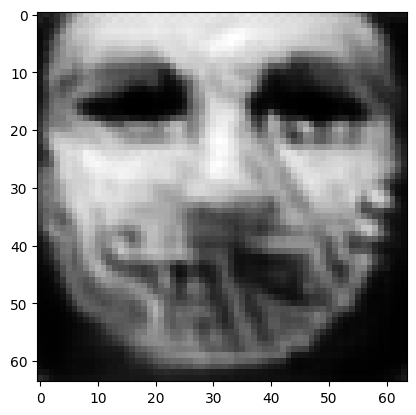

tensor([[1.3238e-02, 1.5082e-04, 3.0926e-03, 3.2841e-04, 1.1935e-03, 1.0696e-02,
         8.3009e-01, 1.6900e-02, 2.9799e-05, 8.5642e-04, 1.2359e-03, 1.6729e-04,
         4.6526e-04, 1.3944e-05, 7.3804e-04, 7.7955e-03, 4.6649e-03, 3.2783e-02,
         4.7943e-03, 1.8536e-02, 5.2760e-04, 1.6835e-04, 7.4600e-06, 4.8195e-03,
         2.6646e-04, 2.8128e-06, 5.8879e-03, 3.3594e-03, 2.0988e-02, 4.2130e-04,
         2.0416e-05, 1.3978e-03, 8.5928e-03, 1.1484e-03, 2.4436e-04, 7.4342e-04,
         2.4827e-04, 3.2958e-04, 1.8483e-03, 1.2090e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18622206151485443
tensor([[1.2977e-02, 1.3934e-04, 2.7485e-03, 3.0776e-04, 1.1085e-03, 9.8172e-03,
         8.4068e-01, 1.6234e-02, 2.6056e-05, 7.6820e-04, 1.1494e-03, 1.4762e-04,
         4.2635e-04, 1.2568e-05, 6.9966e-04, 7.4256e-03, 4.4491e-03, 3.0962e-02,
         4.6199e-03, 1.7314e-02, 4.8776e-04, 1.5470e-04, 6.8273e-06, 4.7201e-03,
         2.4543e-04, 2.4470e-06, 5.4788e-0

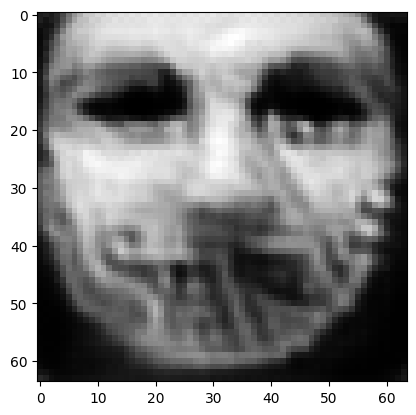

tensor([[1.1312e-02, 1.0229e-04, 2.1659e-03, 2.5867e-04, 8.5756e-04, 7.8188e-03,
         8.7471e-01, 1.3985e-02, 1.8958e-05, 5.9701e-04, 8.7494e-04, 9.9852e-05,
         3.1754e-04, 8.1629e-06, 5.0520e-04, 5.9453e-03, 3.8768e-03, 2.2808e-02,
         4.0599e-03, 1.3158e-02, 3.8059e-04, 1.0625e-04, 5.2041e-06, 3.8739e-03,
         1.7628e-04, 1.6335e-06, 4.2543e-03, 2.5662e-03, 1.4258e-02, 2.6265e-04,
         1.3309e-05, 9.3487e-04, 5.6308e-03, 7.9722e-04, 1.7535e-04, 5.3803e-04,
         1.6794e-04, 2.0284e-04, 1.3321e-03, 8.4132e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13386119902133942
tensor([[1.0841e-02, 9.4152e-05, 2.0519e-03, 2.4698e-04, 7.7959e-04, 7.5766e-03,
         8.8175e-01, 1.3573e-02, 1.7409e-05, 5.7354e-04, 8.2489e-04, 9.1158e-05,
         2.8901e-04, 7.0831e-06, 4.6124e-04, 5.7246e-03, 3.7216e-03, 2.0526e-02,
         3.9264e-03, 1.2543e-02, 3.5586e-04, 9.6575e-05, 4.6743e-06, 3.6543e-03,
         1.5698e-04, 1.4910e-06, 3.9697e-0

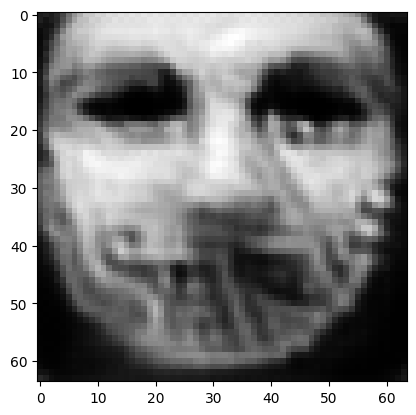

tensor([[9.7524e-03, 7.7602e-05, 1.6367e-03, 2.2073e-04, 6.4617e-04, 6.1272e-03,
         9.0147e-01, 1.1758e-02, 1.3780e-05, 4.6734e-04, 6.5573e-04, 6.7476e-05,
         2.3416e-04, 5.2149e-06, 3.8709e-04, 4.9541e-03, 3.2919e-03, 1.6498e-02,
         3.4638e-03, 1.0295e-02, 3.0759e-04, 7.4894e-05, 3.7474e-06, 3.1986e-03,
         1.2811e-04, 1.0861e-06, 3.2647e-03, 2.0869e-03, 1.1020e-02, 1.8799e-04,
         9.8026e-06, 6.7858e-04, 3.8989e-03, 5.8547e-04, 1.4655e-04, 4.0761e-04,
         1.2454e-04, 1.3292e-04, 1.0715e-03, 6.4859e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1037287712097168
tensor([[9.4595e-03, 7.5371e-05, 1.5541e-03, 2.1541e-04, 6.1464e-04, 5.8947e-03,
         9.0521e-01, 1.1299e-02, 1.3272e-05, 4.5004e-04, 6.2286e-04, 6.3836e-05,
         2.2525e-04, 4.8449e-06, 3.7180e-04, 4.8232e-03, 3.1448e-03, 1.5759e-02,
         3.3532e-03, 1.0017e-02, 2.9973e-04, 7.0694e-05, 3.5540e-06, 3.0286e-03,
         1.2084e-04, 1.0043e-06, 3.2030e-03

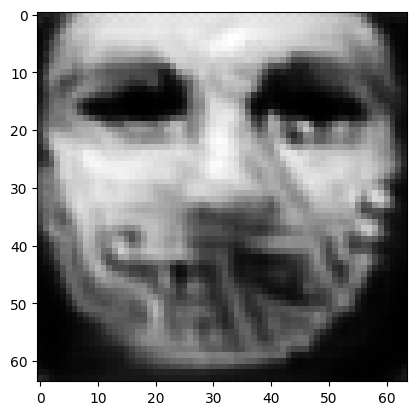

tensor([[8.5349e-03, 6.5530e-05, 1.3262e-03, 1.9565e-04, 5.1204e-04, 5.3441e-03,
         9.1638e-01, 1.0059e-02, 1.1178e-05, 3.9760e-04, 5.4304e-04, 5.3274e-05,
         1.9038e-04, 3.7516e-06, 3.1556e-04, 4.4973e-03, 2.8156e-03, 1.3101e-02,
         3.0515e-03, 9.0396e-03, 2.6490e-04, 5.9188e-05, 2.9010e-06, 2.6205e-03,
         9.8300e-05, 7.9884e-07, 2.8900e-03, 1.7677e-03, 9.4388e-03, 1.4937e-04,
         7.7765e-06, 5.5675e-04, 3.0790e-03, 4.8158e-04, 1.3110e-04, 3.3646e-04,
         9.8668e-05, 9.8398e-05, 9.1749e-04, 5.6060e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08732148259878159
tensor([[8.3895e-03, 6.3385e-05, 1.2725e-03, 1.9197e-04, 5.0091e-04, 5.0926e-03,
         9.1863e-01, 9.8280e-03, 1.0772e-05, 3.8092e-04, 5.2962e-04, 5.0836e-05,
         1.8615e-04, 3.6750e-06, 3.0942e-04, 4.3870e-03, 2.8147e-03, 1.2765e-02,
         3.0057e-03, 8.7702e-03, 2.6082e-04, 5.7676e-05, 2.8792e-06, 2.6207e-03,
         9.7406e-05, 7.7072e-07, 2.7773e-0

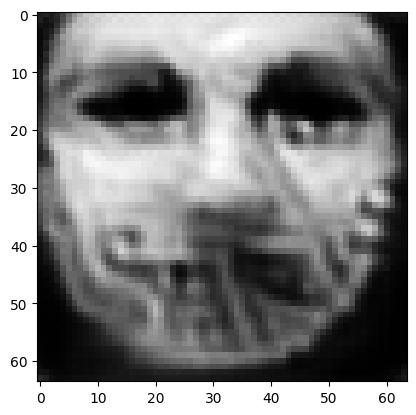

tensor([[7.8953e-03, 5.7605e-05, 1.1207e-03, 1.7905e-04, 4.5336e-04, 4.4979e-03,
         9.2563e-01, 9.0449e-03, 9.6673e-06, 3.4107e-04, 4.7614e-04, 4.4201e-05,
         1.7116e-04, 3.2251e-06, 2.8111e-04, 4.0744e-03, 2.6600e-03, 1.1559e-02,
         2.8269e-03, 8.1118e-03, 2.4334e-04, 5.1831e-05, 2.6805e-06, 2.4580e-03,
         8.9057e-05, 6.6169e-07, 2.5451e-03, 1.5861e-03, 7.8567e-03, 1.3102e-04,
         6.9578e-06, 4.8024e-04, 2.7371e-03, 4.3293e-04, 1.1866e-04, 3.1107e-04,
         8.5820e-05, 8.3615e-05, 8.5208e-04, 4.9268e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07728421688079834
tensor([[7.6911e-03, 5.7670e-05, 1.0878e-03, 1.7865e-04, 4.4865e-04, 4.3795e-03,
         9.2708e-01, 8.7484e-03, 9.7432e-06, 3.3343e-04, 4.6080e-04, 4.3403e-05,
         1.7159e-04, 3.1690e-06, 2.7730e-04, 4.0179e-03, 2.6007e-03, 1.1454e-02,
         2.7917e-03, 8.0100e-03, 2.4483e-04, 5.0352e-05, 2.7005e-06, 2.3559e-03,
         8.7933e-05, 6.3980e-07, 2.5522e-0

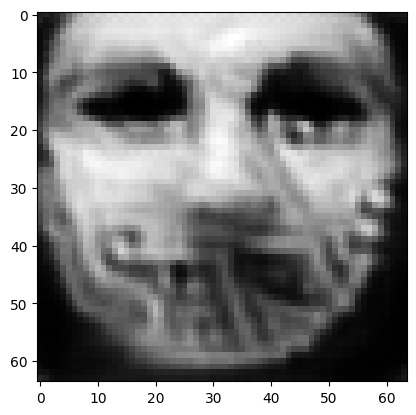

tensor([[7.2732e-03, 5.3672e-05, 9.6163e-04, 1.6650e-04, 4.0710e-04, 3.8815e-03,
         9.3241e-01, 8.0277e-03, 8.7763e-06, 3.0294e-04, 4.1839e-04, 3.8776e-05,
         1.5970e-04, 2.8293e-06, 2.5968e-04, 3.8149e-03, 2.4409e-03, 1.0674e-02,
         2.6556e-03, 7.5592e-03, 2.3238e-04, 4.6052e-05, 2.5207e-06, 2.2474e-03,
         8.0784e-05, 5.5052e-07, 2.3697e-03, 1.4302e-03, 6.8348e-03, 1.1796e-04,
         6.3107e-06, 4.2799e-04, 2.4791e-03, 3.9486e-04, 1.1014e-04, 2.9467e-04,
         7.6228e-05, 7.2211e-05, 8.0108e-04, 4.5459e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06997902691364288
tensor([[7.1804e-03, 5.3025e-05, 9.3021e-04, 1.6407e-04, 3.9908e-04, 3.7459e-03,
         9.3359e-01, 7.8468e-03, 8.5987e-06, 2.9565e-04, 4.0811e-04, 3.7791e-05,
         1.5782e-04, 2.7756e-06, 2.5803e-04, 3.7691e-03, 2.4027e-03, 1.0556e-02,
         2.6277e-03, 7.4598e-03, 2.3079e-04, 4.5142e-05, 2.4925e-06, 2.2227e-03,
         7.9562e-05, 5.2990e-07, 2.3308e-0

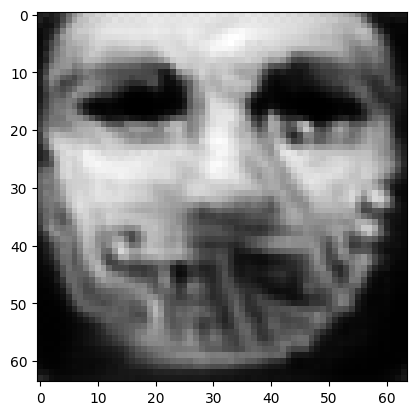

tensor([[6.8089e-03, 5.0034e-05, 8.4807e-04, 1.5621e-04, 3.7347e-04, 3.3778e-03,
         9.3762e-01, 7.3319e-03, 7.9797e-06, 2.7392e-04, 3.7805e-04, 3.4736e-05,
         1.4999e-04, 2.5567e-06, 2.4564e-04, 3.5937e-03, 2.3083e-03, 9.9472e-03,
         2.5252e-03, 7.0500e-03, 2.2279e-04, 4.1651e-05, 2.3640e-06, 2.1348e-03,
         7.5112e-05, 4.7134e-07, 2.1682e-03, 1.3278e-03, 6.1224e-03, 1.0846e-04,
         5.8457e-06, 3.8416e-04, 2.2693e-03, 3.6385e-04, 1.0252e-04, 2.8084e-04,
         6.9133e-05, 6.3774e-05, 7.5484e-04, 4.1697e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06440937519073486
tensor([[6.7178e-03, 4.9772e-05, 8.2809e-04, 1.5510e-04, 3.6924e-04, 3.3111e-03,
         9.3844e-01, 7.1999e-03, 7.8864e-06, 2.6871e-04, 3.7032e-04, 3.4251e-05,
         1.4902e-04, 2.5169e-06, 2.4312e-04, 3.5613e-03, 2.2745e-03, 9.8990e-03,
         2.4978e-03, 6.9736e-03, 2.2187e-04, 4.0809e-05, 2.3498e-06, 2.0944e-03,
         7.4140e-05, 4.5792e-07, 2.1555e-0

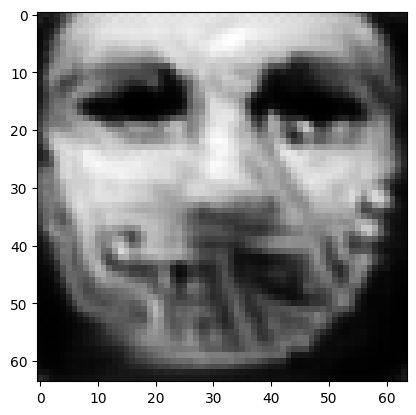

tensor([[6.4360e-03, 4.7044e-05, 7.8395e-04, 1.4954e-04, 3.5143e-04, 3.1512e-03,
         9.4125e-01, 6.9301e-03, 7.3586e-06, 2.5567e-04, 3.5198e-04, 3.2532e-05,
         1.4106e-04, 2.3209e-06, 2.2767e-04, 3.4238e-03, 2.2041e-03, 9.4019e-03,
         2.3965e-03, 6.6240e-03, 2.1267e-04, 3.7895e-05, 2.2264e-06, 2.0023e-03,
         7.0055e-05, 4.2206e-07, 2.0445e-03, 1.2509e-03, 5.7068e-03, 9.9949e-05,
         5.3980e-06, 3.5556e-04, 2.1110e-03, 3.3838e-04, 9.7588e-05, 2.6646e-04,
         6.4530e-05, 5.8317e-05, 7.0945e-04, 3.9759e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0605466403067112
tensor([[6.3903e-03, 4.6281e-05, 7.6772e-04, 1.4720e-04, 3.4260e-04, 3.0794e-03,
         9.4192e-01, 6.8324e-03, 7.1557e-06, 2.5250e-04, 3.4806e-04, 3.1942e-05,
         1.3855e-04, 2.2688e-06, 2.2605e-04, 3.4114e-03, 2.1802e-03, 9.2859e-03,
         2.3799e-03, 6.5766e-03, 2.1047e-04, 3.7369e-05, 2.1713e-06, 1.9975e-03,
         6.8394e-05, 4.0952e-07, 2.0056e-03

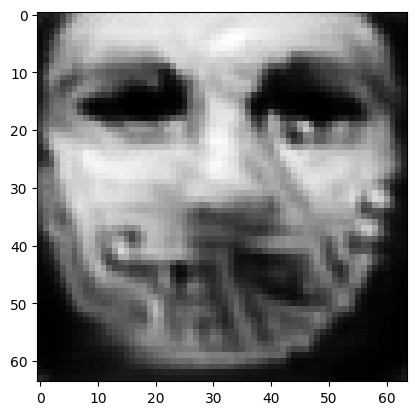

tensor([[6.1117e-03, 4.3539e-05, 7.3397e-04, 1.4186e-04, 3.2374e-04, 2.9487e-03,
         9.4438e-01, 6.5616e-03, 6.6729e-06, 2.4301e-04, 3.3534e-04, 3.0719e-05,
         1.3076e-04, 2.0915e-06, 2.1270e-04, 3.3166e-03, 2.1316e-03, 8.7738e-03,
         2.2969e-03, 6.2829e-03, 2.0291e-04, 3.4979e-05, 2.0480e-06, 1.9227e-03,
         6.4130e-05, 3.8127e-07, 1.8889e-03, 1.1760e-03, 5.4931e-03, 9.3395e-05,
         4.9942e-06, 3.2834e-04, 1.9682e-03, 3.1377e-04, 9.2392e-05, 2.4960e-04,
         6.0295e-05, 5.4084e-05, 6.6524e-04, 3.7695e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.057227253913879395
tensor([[6.0351e-03, 4.3355e-05, 7.2410e-04, 1.4147e-04, 3.2123e-04, 2.9120e-03,
         9.4493e-01, 6.4634e-03, 6.6353e-06, 2.4027e-04, 3.3133e-04, 3.0536e-05,
         1.3014e-04, 2.0700e-06, 2.1074e-04, 3.2990e-03, 2.1175e-03, 8.7103e-03,
         2.2820e-03, 6.2189e-03, 2.0295e-04, 3.4449e-05, 2.0481e-06, 1.8932e-03,
         6.3557e-05, 3.7532e-07, 1.8784e-

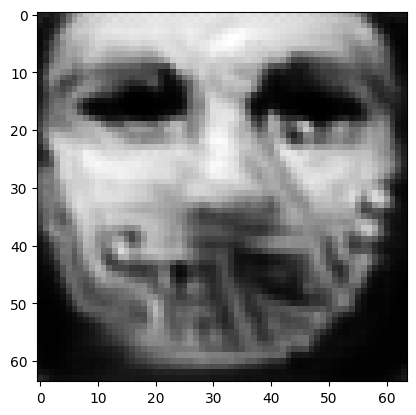

tensor([[5.8298e-03, 4.1279e-05, 6.9256e-04, 1.3630e-04, 3.0485e-04, 2.7930e-03,
         9.4689e-01, 6.2431e-03, 6.2496e-06, 2.3198e-04, 3.2092e-04, 2.9456e-05,
         1.2394e-04, 1.9313e-06, 2.0069e-04, 3.2294e-03, 2.0653e-03, 8.3334e-03,
         2.2114e-03, 6.0200e-03, 1.9691e-04, 3.2689e-05, 1.9411e-06, 1.8394e-03,
         5.9885e-05, 3.5007e-07, 1.7881e-03, 1.1176e-03, 5.2714e-03, 8.8188e-05,
         4.7007e-06, 3.0783e-04, 1.8613e-03, 2.9621e-04, 8.9090e-05, 2.3781e-04,
         5.7030e-05, 5.0764e-05, 6.3221e-04, 3.6481e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05457645282149315
tensor([[5.7783e-03, 4.0947e-05, 6.8478e-04, 1.3535e-04, 3.0146e-04, 2.7703e-03,
         9.4732e-01, 6.1817e-03, 6.1892e-06, 2.3005e-04, 3.1798e-04, 2.9244e-05,
         1.2288e-04, 1.9018e-06, 1.9852e-04, 3.2136e-03, 2.0443e-03, 8.2742e-03,
         2.1941e-03, 5.9831e-03, 1.9584e-04, 3.2276e-05, 1.9225e-06, 1.8143e-03,
         5.9000e-05, 3.4389e-07, 1.7796e-0

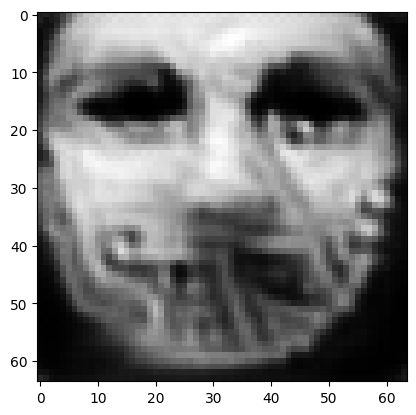

tensor([[5.5943e-03, 3.9491e-05, 6.5887e-04, 1.3253e-04, 2.8933e-04, 2.6669e-03,
         9.4899e-01, 5.9815e-03, 5.9347e-06, 2.2278e-04, 3.0913e-04, 2.8358e-05,
         1.1857e-04, 1.8007e-06, 1.9076e-04, 3.1525e-03, 2.0036e-03, 7.9760e-03,
         2.1425e-03, 5.7972e-03, 1.9168e-04, 3.0665e-05, 1.8503e-06, 1.7564e-03,
         5.6149e-05, 3.2471e-07, 1.7078e-03, 1.0716e-03, 5.0835e-03, 8.3854e-05,
         4.4439e-06, 2.9061e-04, 1.7632e-03, 2.8061e-04, 8.6605e-05, 2.2770e-04,
         5.4147e-05, 4.8027e-05, 6.0403e-04, 3.5593e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05235820636153221
tensor([[5.5532e-03, 3.9256e-05, 6.5080e-04, 1.3213e-04, 2.8702e-04, 2.6296e-03,
         9.4938e-01, 5.9153e-03, 5.8872e-06, 2.2044e-04, 3.0673e-04, 2.8145e-05,
         1.1799e-04, 1.7895e-06, 1.8983e-04, 3.1388e-03, 1.9976e-03, 7.9381e-03,
         2.1338e-03, 5.7499e-03, 1.9155e-04, 3.0320e-05, 1.8475e-06, 1.7456e-03,
         5.5739e-05, 3.2045e-07, 1.6927e-0

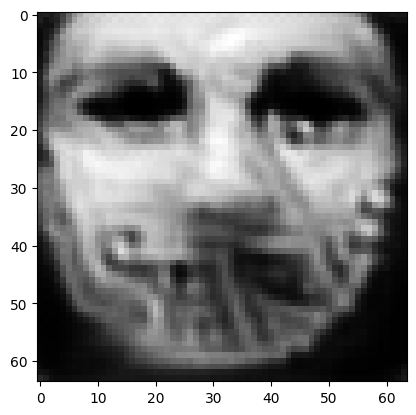

tensor([[5.3848e-03, 3.8200e-05, 6.2885e-04, 1.3072e-04, 2.7832e-04, 2.5356e-03,
         9.5080e-01, 5.7293e-03, 5.7300e-06, 2.1393e-04, 2.9913e-04, 2.7452e-05,
         1.1522e-04, 1.7191e-06, 1.8384e-04, 3.0808e-03, 1.9693e-03, 7.7061e-03,
         2.0925e-03, 5.5821e-03, 1.8906e-04, 2.8894e-05, 1.8045e-06, 1.6888e-03,
         5.3746e-05, 3.0612e-07, 1.6369e-03, 1.0403e-03, 4.9083e-03, 8.0952e-05,
         4.2745e-06, 2.7527e-04, 1.6795e-03, 2.6831e-04, 8.5165e-05, 2.2098e-04,
         5.2057e-05, 4.6027e-05, 5.8255e-04, 3.5066e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05044904351234436
tensor([[5.3464e-03, 3.7733e-05, 6.2453e-04, 1.2992e-04, 2.7491e-04, 2.5162e-03,
         9.5114e-01, 5.6977e-03, 5.6533e-06, 2.1269e-04, 2.9836e-04, 2.7237e-05,
         1.1391e-04, 1.6948e-06, 1.8201e-04, 3.0696e-03, 1.9679e-03, 7.6199e-03,
         2.0826e-03, 5.5438e-03, 1.8772e-04, 2.8564e-05, 1.7803e-06, 1.6837e-03,
         5.3041e-05, 3.0279e-07, 1.6141e-0

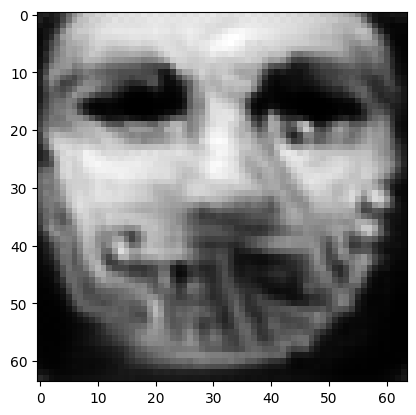

tensor([[5.1865e-03, 3.6652e-05, 6.0541e-04, 1.2868e-04, 2.6650e-04, 2.4244e-03,
         9.5242e-01, 5.5169e-03, 5.5008e-06, 2.0688e-04, 2.9258e-04, 2.6568e-05,
         1.1146e-04, 1.6384e-06, 1.7673e-04, 3.0192e-03, 1.9601e-03, 7.3835e-03,
         2.0531e-03, 5.3945e-03, 1.8583e-04, 2.7392e-05, 1.7462e-06, 1.6476e-03,
         5.1418e-05, 2.9161e-07, 1.5544e-03, 1.0129e-03, 4.7966e-03, 7.8667e-05,
         4.1239e-06, 2.5967e-04, 1.6046e-03, 2.5644e-04, 8.3584e-05, 2.1305e-04,
         5.0248e-05, 4.4366e-05, 5.6301e-04, 3.4494e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0487467497587204
tensor([[5.1486e-03, 3.6467e-05, 6.0046e-04, 1.2867e-04, 2.6527e-04, 2.3990e-03,
         9.5272e-01, 5.4709e-03, 5.4764e-06, 2.0517e-04, 2.9084e-04, 2.6401e-05,
         1.1109e-04, 1.6306e-06, 1.7589e-04, 3.0052e-03, 1.9600e-03, 7.3469e-03,
         2.0465e-03, 5.3551e-03, 1.8574e-04, 2.7134e-05, 1.7455e-06, 1.6386e-03,
         5.1231e-05, 2.8930e-07, 1.5430e-03

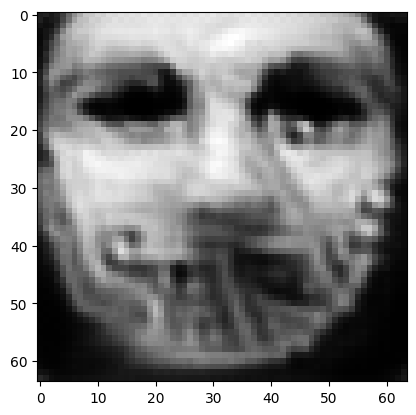

tensor([[5.0317e-03, 3.5443e-05, 5.8306e-04, 1.2670e-04, 2.5839e-04, 2.3231e-03,
         9.5378e-01, 5.3414e-03, 5.3251e-06, 1.9994e-04, 2.8478e-04, 2.5742e-05,
         1.0857e-04, 1.5764e-06, 1.7139e-04, 2.9521e-03, 1.9335e-03, 7.1918e-03,
         2.0094e-03, 5.2431e-03, 1.8293e-04, 2.6249e-05, 1.7035e-06, 1.6040e-03,
         4.9771e-05, 2.7800e-07, 1.5011e-03, 9.8668e-04, 4.6446e-03, 7.6316e-05,
         3.9898e-06, 2.4926e-04, 1.5473e-03, 2.4762e-04, 8.1894e-05, 2.0842e-04,
         4.8738e-05, 4.2928e-05, 5.4744e-04, 3.3779e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0473179928958416
tensor([[5.0055e-03, 3.5221e-05, 5.8004e-04, 1.2617e-04, 2.5690e-04, 2.3113e-03,
         9.5404e-01, 5.3135e-03, 5.3039e-06, 1.9899e-04, 2.8311e-04, 2.5598e-05,
         1.0802e-04, 1.5613e-06, 1.6999e-04, 2.9350e-03, 1.9195e-03, 7.1517e-03,
         1.9989e-03, 5.2187e-03, 1.8211e-04, 2.6036e-05, 1.6929e-06, 1.5900e-03,
         4.9372e-05, 2.7544e-07, 1.4962e-03

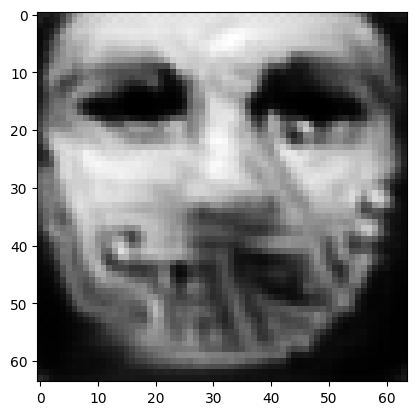

tensor([[4.9082e-03, 3.4273e-05, 5.6817e-04, 1.2453e-04, 2.5195e-04, 2.2537e-03,
         9.5496e-01, 5.2141e-03, 5.1972e-06, 1.9493e-04, 2.7771e-04, 2.5019e-05,
         1.0599e-04, 1.5142e-06, 1.6547e-04, 2.8761e-03, 1.8982e-03, 6.9911e-03,
         1.9659e-03, 5.1177e-03, 1.7946e-04, 2.5328e-05, 1.6621e-06, 1.5605e-03,
         4.8371e-05, 2.6761e-07, 1.4610e-03, 9.6175e-04, 4.5178e-03, 7.4124e-05,
         3.8789e-06, 2.3996e-04, 1.5056e-03, 2.4012e-04, 8.0224e-05, 2.0366e-04,
         4.7400e-05, 4.1736e-05, 5.3815e-04, 3.3368e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04609064385294914
tensor([[4.8843e-03, 3.4114e-05, 5.6475e-04, 1.2414e-04, 2.5078e-04, 2.2390e-03,
         9.5517e-01, 5.1850e-03, 5.1799e-06, 1.9391e-04, 2.7622e-04, 2.4894e-05,
         1.0563e-04, 1.5049e-06, 1.6458e-04, 2.8630e-03, 1.8894e-03, 6.9647e-03,
         1.9580e-03, 5.0976e-03, 1.7908e-04, 2.5172e-05, 1.6583e-06, 1.5509e-03,
         4.8128e-05, 2.6555e-07, 1.4564e-0

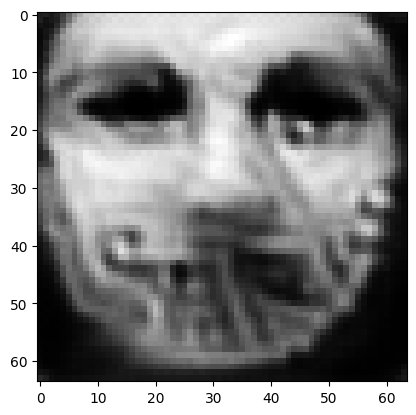

tensor([[4.8004e-03, 3.3201e-05, 5.5575e-04, 1.2244e-04, 2.4576e-04, 2.1970e-03,
         9.5596e-01, 5.1076e-03, 5.0709e-06, 1.9079e-04, 2.7215e-04, 2.4422e-05,
         1.0351e-04, 1.4580e-06, 1.6015e-04, 2.8144e-03, 1.8691e-03, 6.8122e-03,
         1.9267e-03, 5.0101e-03, 1.7617e-04, 2.4520e-05, 1.6209e-06, 1.5237e-03,
         4.7021e-05, 2.5855e-07, 1.4248e-03, 9.3938e-04, 4.4158e-03, 7.2133e-05,
         3.7771e-06, 2.3217e-04, 1.4687e-03, 2.3334e-04, 7.8662e-05, 1.9916e-04,
         4.6211e-05, 4.0732e-05, 5.2925e-04, 3.2965e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.045038215816020966
tensor([[4.7726e-03, 3.3080e-05, 5.5414e-04, 1.2234e-04, 2.4515e-04, 2.1910e-03,
         9.5615e-01, 5.0837e-03, 5.0676e-06, 1.9007e-04, 2.7100e-04, 2.4357e-05,
         1.0329e-04, 1.4497e-06, 1.5897e-04, 2.8019e-03, 1.8626e-03, 6.7804e-03,
         1.9198e-03, 4.9874e-03, 1.7585e-04, 2.4345e-05, 1.6199e-06, 1.5107e-03,
         4.6820e-05, 2.5739e-07, 1.4229e-

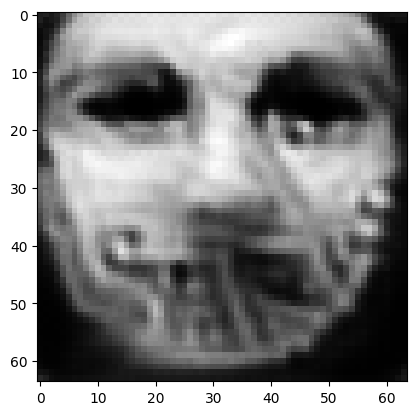

tensor([[4.6923e-03, 3.2383e-05, 5.4487e-04, 1.2095e-04, 2.4125e-04, 2.1482e-03,
         9.5687e-01, 5.0039e-03, 4.9866e-06, 1.8691e-04, 2.6682e-04, 2.3929e-05,
         1.0166e-04, 1.4147e-06, 1.5539e-04, 2.7574e-03, 1.8425e-03, 6.6626e-03,
         1.8937e-03, 4.9076e-03, 1.7380e-04, 2.3782e-05, 1.5966e-06, 1.4843e-03,
         4.5940e-05, 2.5120e-07, 1.3989e-03, 9.2016e-04, 4.3175e-03, 7.0469e-05,
         3.6937e-06, 2.2573e-04, 1.4386e-03, 2.2806e-04, 7.7565e-05, 1.9582e-04,
         4.5216e-05, 3.9870e-05, 5.2276e-04, 3.2788e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.044088367372751236
tensor([[4.6656e-03, 3.2300e-05, 5.4356e-04, 1.2102e-04, 2.4099e-04, 2.1428e-03,
         9.5704e-01, 4.9825e-03, 4.9873e-06, 1.8620e-04, 2.6581e-04, 2.3880e-05,
         1.0153e-04, 1.4091e-06, 1.5438e-04, 2.7469e-03, 1.8399e-03, 6.6329e-03,
         1.8887e-03, 4.8850e-03, 1.7365e-04, 2.3629e-05, 1.5988e-06, 1.4738e-03,
         4.5836e-05, 2.5052e-07, 1.3966e-

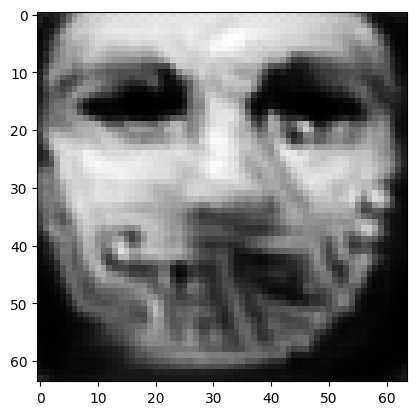

tensor([[4.5960e-03, 3.1633e-05, 5.3492e-04, 1.2006e-04, 2.3842e-04, 2.0944e-03,
         9.5769e-01, 4.9044e-03, 4.9036e-06, 1.8291e-04, 2.6196e-04, 2.3489e-05,
         1.0019e-04, 1.3862e-06, 1.5172e-04, 2.7042e-03, 1.8352e-03, 6.5380e-03,
         1.8692e-03, 4.7969e-03, 1.7215e-04, 2.3148e-05, 1.5885e-06, 1.4596e-03,
         4.5383e-05, 2.4561e-07, 1.3684e-03, 9.0583e-04, 4.2227e-03, 6.9247e-05,
         3.6373e-06, 2.1995e-04, 1.4121e-03, 2.2368e-04, 7.6654e-05, 1.9374e-04,
         4.4607e-05, 3.9243e-05, 5.1690e-04, 3.2563e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04323568940162659
tensor([[4.5770e-03, 3.1456e-05, 5.3399e-04, 1.1981e-04, 2.3781e-04, 2.0903e-03,
         9.5784e-01, 4.8905e-03, 4.8843e-06, 1.8239e-04, 2.6119e-04, 2.3429e-05,
         9.9782e-05, 1.3778e-06, 1.5067e-04, 2.6941e-03, 1.8334e-03, 6.5054e-03,
         1.8631e-03, 4.7746e-03, 1.7153e-04, 2.3012e-05, 1.5835e-06, 1.4531e-03,
         4.5208e-05, 2.4474e-07, 1.3631e-0

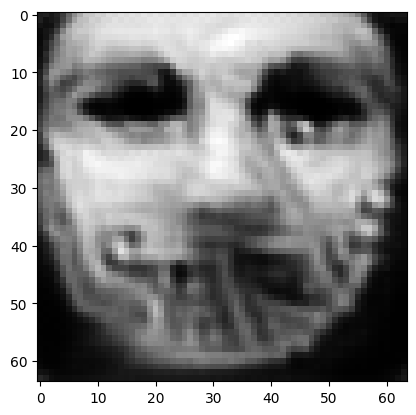

tensor([[4.5132e-03, 3.0882e-05, 5.2671e-04, 1.1899e-04, 2.3523e-04, 2.0529e-03,
         9.5841e-01, 4.8211e-03, 4.8121e-06, 1.7968e-04, 2.5774e-04, 2.3099e-05,
         9.8491e-05, 1.3535e-06, 1.4813e-04, 2.6577e-03, 1.8256e-03, 6.4184e-03,
         1.8444e-03, 4.6994e-03, 1.7006e-04, 2.2575e-05, 1.5707e-06, 1.4358e-03,
         4.4709e-05, 2.4036e-07, 1.3405e-03, 8.9147e-04, 4.1485e-03, 6.8006e-05,
         3.5747e-06, 2.1491e-04, 1.3867e-03, 2.1930e-04, 7.5708e-05, 1.9120e-04,
         4.4010e-05, 3.8661e-05, 5.1058e-04, 3.2297e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04247849062085152
tensor([[4.4929e-03, 3.0782e-05, 5.2551e-04, 1.1896e-04, 2.3483e-04, 2.0479e-03,
         9.5855e-01, 4.8046e-03, 4.8032e-06, 1.7908e-04, 2.5699e-04, 2.3051e-05,
         9.8270e-05, 1.3481e-06, 1.4735e-04, 2.6494e-03, 1.8250e-03, 6.3934e-03,
         1.8400e-03, 4.6800e-03, 1.6978e-04, 2.2454e-05, 1.5702e-06, 1.4288e-03,
         4.4610e-05, 2.3972e-07, 1.3368e-0

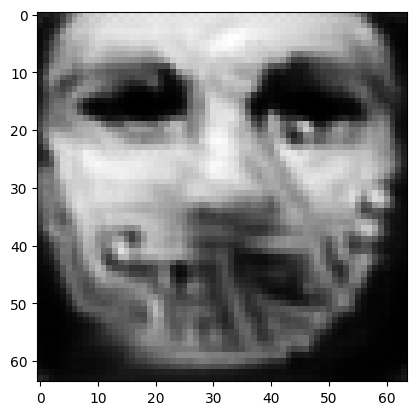

tensor([[4.4309e-03, 3.0330e-05, 5.1865e-04, 1.1835e-04, 2.3250e-04, 2.0147e-03,
         9.5907e-01, 4.7352e-03, 4.7458e-06, 1.7657e-04, 2.5377e-04, 2.2771e-05,
         9.7257e-05, 1.3274e-06, 1.4508e-04, 2.6182e-03, 1.8171e-03, 6.3174e-03,
         1.8235e-03, 4.6139e-03, 1.6867e-04, 2.2048e-05, 1.5616e-06, 1.4102e-03,
         4.4153e-05, 2.3576e-07, 1.3190e-03, 8.7945e-04, 4.0769e-03, 6.6969e-05,
         3.5225e-06, 2.1056e-04, 1.3641e-03, 2.1562e-04, 7.5054e-05, 1.8929e-04,
         4.3496e-05, 3.8132e-05, 5.0507e-04, 3.2151e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041789084672927856
tensor([[4.4210e-03, 3.0121e-05, 5.1725e-04, 1.1792e-04, 2.3149e-04, 2.0053e-03,
         9.5920e-01, 4.7259e-03, 4.7169e-06, 1.7607e-04, 2.5326e-04, 2.2665e-05,
         9.6741e-05, 1.3190e-06, 1.4448e-04, 2.6095e-03, 1.8155e-03, 6.2910e-03,
         1.8185e-03, 4.5990e-03, 1.6799e-04, 2.1953e-05, 1.5509e-06, 1.4099e-03,
         4.3967e-05, 2.3451e-07, 1.3100e-

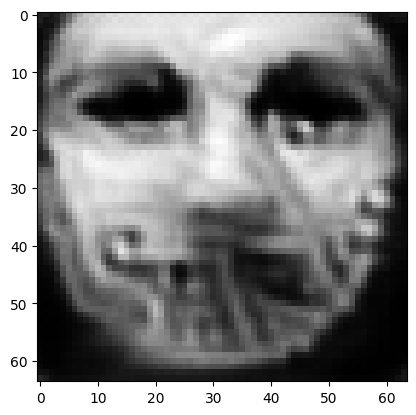

tensor([[4.3552e-03, 2.9414e-05, 5.1442e-04, 1.1690e-04, 2.2871e-04, 1.9886e-03,
         9.5970e-01, 4.6798e-03, 4.6373e-06, 1.7433e-04, 2.5132e-04, 2.2418e-05,
         9.5147e-05, 1.2916e-06, 1.4092e-04, 2.5798e-03, 1.8180e-03, 6.1599e-03,
         1.8016e-03, 4.5313e-03, 1.6560e-04, 2.1557e-05, 1.5291e-06, 1.3966e-03,
         4.3389e-05, 2.3206e-07, 1.2845e-03, 8.6705e-04, 4.0395e-03, 6.5936e-05,
         3.4630e-06, 2.0508e-04, 1.3394e-03, 2.1112e-04, 7.3867e-05, 1.8564e-04,
         4.2946e-05, 3.7696e-05, 4.9940e-04, 3.1866e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041131243109703064
tensor([[4.3444e-03, 2.9240e-05, 5.1254e-04, 1.1653e-04, 2.2780e-04, 1.9781e-03,
         9.5982e-01, 4.6673e-03, 4.6115e-06, 1.7372e-04, 2.5081e-04, 2.2318e-05,
         9.4738e-05, 1.2863e-06, 1.4041e-04, 2.5729e-03, 1.8184e-03, 6.1365e-03,
         1.7985e-03, 4.5189e-03, 1.6512e-04, 2.1487e-05, 1.5235e-06, 1.3974e-03,
         4.3266e-05, 2.3104e-07, 1.2766e-

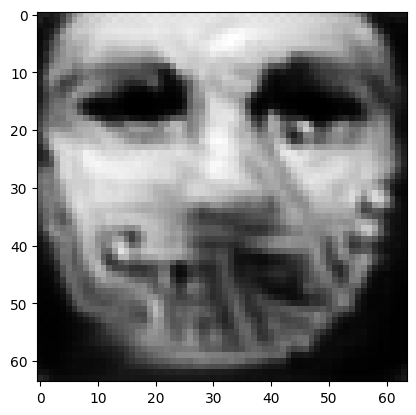

tensor([[4.2890e-03, 2.8769e-05, 5.0790e-04, 1.1575e-04, 2.2541e-04, 1.9573e-03,
         9.6026e-01, 4.6170e-03, 4.5530e-06, 1.7175e-04, 2.4871e-04, 2.2092e-05,
         9.3644e-05, 1.2671e-06, 1.3782e-04, 2.5481e-03, 1.8158e-03, 6.0485e-03,
         1.7841e-03, 4.4662e-03, 1.6359e-04, 2.1144e-05, 1.5116e-06, 1.3839e-03,
         4.2804e-05, 2.2830e-07, 1.2591e-03, 8.5614e-04, 3.9841e-03, 6.5065e-05,
         3.4172e-06, 2.0090e-04, 1.3215e-03, 2.0782e-04, 7.2821e-05, 1.8338e-04,
         4.2439e-05, 3.7308e-05, 4.9396e-04, 3.1599e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04055206850171089
tensor([[4.2750e-03, 2.8691e-05, 5.0685e-04, 1.1566e-04, 2.2494e-04, 1.9535e-03,
         9.6036e-01, 4.6046e-03, 4.5441e-06, 1.7130e-04, 2.4820e-04, 2.2049e-05,
         9.3456e-05, 1.2629e-06, 1.3721e-04, 2.5423e-03, 1.8146e-03, 6.0290e-03,
         1.7807e-03, 4.4540e-03, 1.6331e-04, 2.1054e-05, 1.5100e-06, 1.3789e-03,
         4.2699e-05, 2.2773e-07, 1.2563e-0

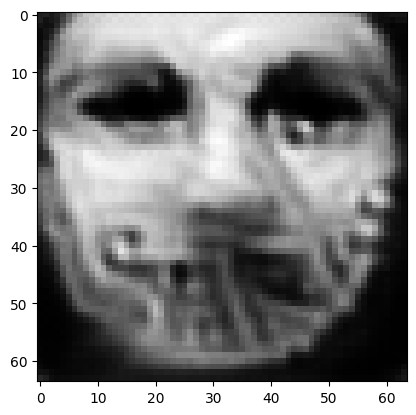

tensor([[4.2278e-03, 2.8353e-05, 5.0120e-04, 1.1495e-04, 2.2256e-04, 1.9310e-03,
         9.6075e-01, 4.5528e-03, 4.4953e-06, 1.6945e-04, 2.4603e-04, 2.1828e-05,
         9.2602e-05, 1.2463e-06, 1.3527e-04, 2.5215e-03, 1.8057e-03, 5.9637e-03,
         1.7681e-03, 4.4132e-03, 1.6214e-04, 2.0747e-05, 1.4995e-06, 1.3639e-03,
         4.2222e-05, 2.2460e-07, 1.2440e-03, 8.4662e-04, 3.9298e-03, 6.4271e-05,
         3.3735e-06, 1.9767e-04, 1.3058e-03, 2.0507e-04, 7.2068e-05, 1.8165e-04,
         4.1947e-05, 3.6920e-05, 4.8900e-04, 3.1462e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040036238729953766
tensor([[4.2194e-03, 2.8285e-05, 4.9881e-04, 1.1476e-04, 2.2189e-04, 1.9198e-03,
         9.6085e-01, 4.5362e-03, 4.4816e-06, 1.6881e-04, 2.4537e-04, 2.1748e-05,
         9.2427e-05, 1.2441e-06, 1.3514e-04, 2.5169e-03, 1.8035e-03, 5.9566e-03,
         1.7661e-03, 4.4047e-03, 1.6206e-04, 2.0691e-05, 1.4987e-06, 1.3629e-03,
         4.2136e-05, 2.2351e-07, 1.2402e-

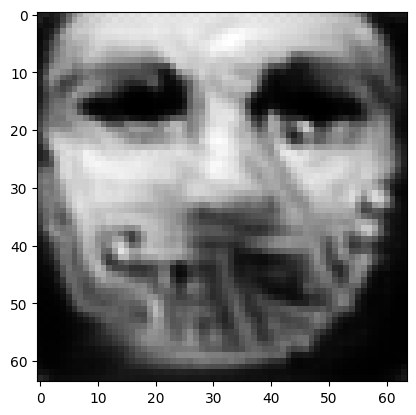

tensor([[4.1758e-03, 2.8025e-05, 4.9372e-04, 1.1425e-04, 2.2001e-04, 1.9004e-03,
         9.6122e-01, 4.4898e-03, 4.4420e-06, 1.6702e-04, 2.4341e-04, 2.1569e-05,
         9.1678e-05, 1.2303e-06, 1.3333e-04, 2.4981e-03, 1.7959e-03, 5.8998e-03,
         1.7541e-03, 4.3595e-03, 1.6109e-04, 2.0393e-05, 1.4922e-06, 1.3475e-03,
         4.1704e-05, 2.2072e-07, 1.2297e-03, 8.3753e-04, 3.8660e-03, 6.3539e-05,
         3.3346e-06, 1.9493e-04, 1.2907e-03, 2.0264e-04, 7.1355e-05, 1.8057e-04,
         4.1479e-05, 3.6525e-05, 4.8353e-04, 3.1256e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03955074027180672
tensor([[4.1679e-03, 2.7957e-05, 4.9174e-04, 1.1405e-04, 2.1949e-04, 1.8906e-03,
         9.6131e-01, 4.4758e-03, 4.4305e-06, 1.6645e-04, 2.4276e-04, 2.1498e-05,
         9.1525e-05, 1.2282e-06, 1.3316e-04, 2.4931e-03, 1.7935e-03, 5.8937e-03,
         1.7519e-03, 4.3513e-03, 1.6099e-04, 2.0343e-05, 1.4914e-06, 1.3461e-03,
         4.1632e-05, 2.1975e-07, 1.2264e-0

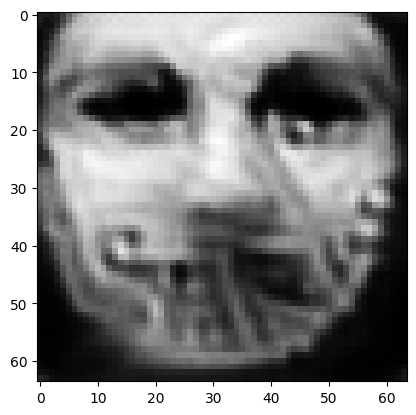

tensor([[4.1289e-03, 2.7664e-05, 4.8773e-04, 1.1344e-04, 2.1776e-04, 1.8747e-03,
         9.6165e-01, 4.4431e-03, 4.3851e-06, 1.6488e-04, 2.4114e-04, 2.1322e-05,
         9.0669e-05, 1.2139e-06, 1.3130e-04, 2.4745e-03, 1.7893e-03, 5.8312e-03,
         1.7407e-03, 4.3067e-03, 1.5970e-04, 2.0072e-05, 1.4819e-06, 1.3340e-03,
         4.1226e-05, 2.1737e-07, 1.2142e-03, 8.2925e-04, 3.8098e-03, 6.2808e-05,
         3.2976e-06, 1.9227e-04, 1.2760e-03, 2.0038e-04, 7.0587e-05, 1.7932e-04,
         4.1049e-05, 3.6162e-05, 4.7865e-04, 3.1025e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03910604491829872
tensor([[4.1211e-03, 2.7633e-05, 4.8565e-04, 1.1335e-04, 2.1765e-04, 1.8635e-03,
         9.6173e-01, 4.4291e-03, 4.3787e-06, 1.6422e-04, 2.4046e-04, 2.1258e-05,
         9.0651e-05, 1.2149e-06, 1.3126e-04, 2.4687e-03, 1.7895e-03, 5.8290e-03,
         1.7397e-03, 4.2966e-03, 1.5981e-04, 2.0041e-05, 1.4863e-06, 1.3335e-03,
         4.1263e-05, 2.1678e-07, 1.2115e-0

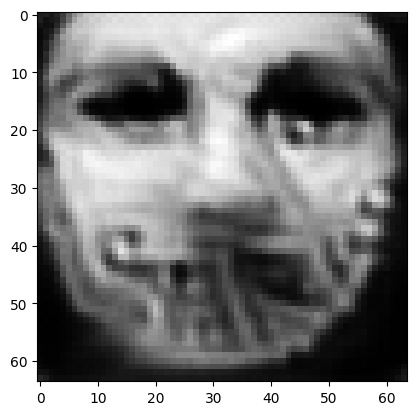

tensor([[4.0813e-03, 2.7384e-05, 4.8248e-04, 1.1315e-04, 2.1677e-04, 1.8424e-03,
         9.6206e-01, 4.3932e-03, 4.3554e-06, 1.6256e-04, 2.3879e-04, 2.1086e-05,
         9.0154e-05, 1.2066e-06, 1.2971e-04, 2.4467e-03, 1.7927e-03, 5.7673e-03,
         1.7311e-03, 4.2483e-03, 1.5918e-04, 1.9790e-05, 1.4862e-06, 1.3238e-03,
         4.1116e-05, 2.1542e-07, 1.1982e-03, 8.2296e-04, 3.7494e-03, 6.2415e-05,
         3.2840e-06, 1.8933e-04, 1.2651e-03, 1.9887e-04, 7.0157e-05, 1.7893e-04,
         4.0765e-05, 3.5901e-05, 4.7636e-04, 3.0929e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03867560252547264
tensor([[4.0691e-03, 2.7345e-05, 4.8204e-04, 1.1318e-04, 2.1673e-04, 1.8400e-03,
         9.6214e-01, 4.3840e-03, 4.3565e-06, 1.6222e-04, 2.3836e-04, 2.1066e-05,
         9.0113e-05, 1.2048e-06, 1.2924e-04, 2.4413e-03, 1.7928e-03, 5.7531e-03,
         1.7285e-03, 4.2369e-03, 1.5910e-04, 1.9721e-05, 1.4876e-06, 1.3190e-03,
         4.1087e-05, 2.1527e-07, 1.1969e-0

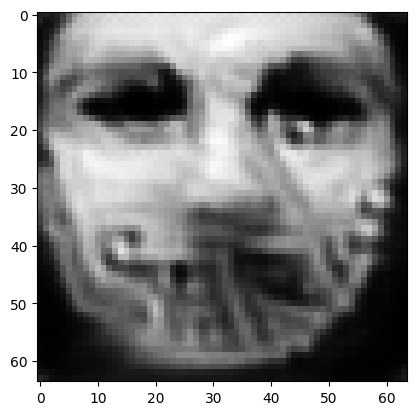

tensor([[4.0333e-03, 2.7133e-05, 4.7762e-04, 1.1282e-04, 2.1570e-04, 1.8157e-03,
         9.6244e-01, 4.3456e-03, 4.3293e-06, 1.6044e-04, 2.3665e-04, 2.0885e-05,
         8.9673e-05, 1.1985e-06, 1.2814e-04, 2.4219e-03, 1.7932e-03, 5.7114e-03,
         1.7205e-03, 4.1981e-03, 1.5865e-04, 1.9508e-05, 1.4881e-06, 1.3114e-03,
         4.0946e-05, 2.1342e-07, 1.1852e-03, 8.1680e-04, 3.6958e-03, 6.2002e-05,
         3.2669e-06, 1.8683e-04, 1.2547e-03, 1.9742e-04, 6.9775e-05, 1.7839e-04,
         4.0459e-05, 3.5651e-05, 4.7427e-04, 3.0870e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03827916830778122
tensor([[4.0226e-03, 2.7089e-05, 4.7710e-04, 1.1278e-04, 2.1559e-04, 1.8132e-03,
         9.6251e-01, 4.3373e-03, 4.3269e-06, 1.6010e-04, 2.3628e-04, 2.0864e-05,
         8.9599e-05, 1.1967e-06, 1.2773e-04, 2.4170e-03, 1.7932e-03, 5.6995e-03,
         1.7181e-03, 4.1879e-03, 1.5853e-04, 1.9447e-05, 1.4886e-06, 1.3073e-03,
         4.0906e-05, 2.1320e-07, 1.1837e-0

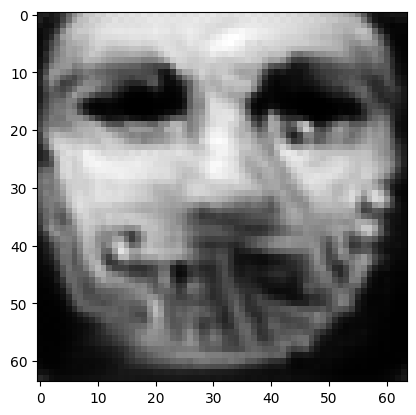

tensor([[3.9927e-03, 2.6845e-05, 4.7276e-04, 1.1233e-04, 2.1441e-04, 1.7895e-03,
         9.6279e-01, 4.3039e-03, 4.2907e-06, 1.5844e-04, 2.3475e-04, 2.0677e-05,
         8.9041e-05, 1.1893e-06, 1.2676e-04, 2.3988e-03, 1.7937e-03, 5.6631e-03,
         1.7095e-03, 4.1525e-03, 1.5790e-04, 1.9251e-05, 1.4851e-06, 1.3023e-03,
         4.0740e-05, 2.1117e-07, 1.1708e-03, 8.1063e-04, 3.6477e-03, 6.1539e-05,
         3.2444e-06, 1.8457e-04, 1.2442e-03, 1.9588e-04, 6.9296e-05, 1.7770e-04,
         4.0145e-05, 3.5400e-05, 4.7127e-04, 3.0696e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037916433066129684
tensor([[3.9835e-03, 2.6779e-05, 4.7244e-04, 1.1221e-04, 2.1397e-04, 1.7897e-03,
         9.6286e-01, 4.2978e-03, 4.2824e-06, 1.5823e-04, 2.3448e-04, 2.0657e-05,
         8.8839e-05, 1.1847e-06, 1.2622e-04, 2.3957e-03, 1.7920e-03, 5.6467e-03,
         1.7063e-03, 4.1441e-03, 1.5756e-04, 1.9182e-05, 1.4814e-06, 1.2980e-03,
         4.0602e-05, 2.1073e-07, 1.1690e-

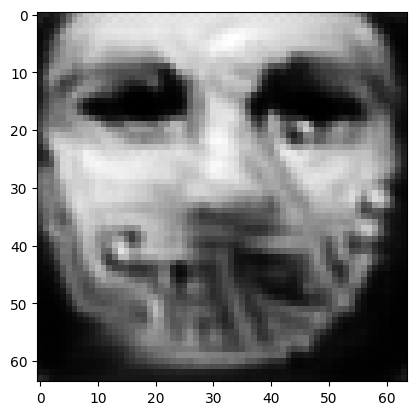

tensor([[3.9536e-03, 2.6575e-05, 4.6875e-04, 1.1176e-04, 2.1277e-04, 1.7737e-03,
         9.6312e-01, 4.2666e-03, 4.2543e-06, 1.5689e-04, 2.3301e-04, 2.0510e-05,
         8.8342e-05, 1.1756e-06, 1.2504e-04, 2.3796e-03, 1.7878e-03, 5.6085e-03,
         1.6971e-03, 4.1148e-03, 1.5690e-04, 1.8991e-05, 1.4779e-06, 1.2883e-03,
         4.0349e-05, 2.0886e-07, 1.1608e-03, 8.0381e-04, 3.6088e-03, 6.0969e-05,
         3.2143e-06, 1.8263e-04, 1.2345e-03, 1.9410e-04, 6.8834e-05, 1.7651e-04,
         3.9804e-05, 3.5144e-05, 4.6809e-04, 3.0615e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.037577562034130096
tensor([[3.9487e-03, 2.6492e-05, 4.6732e-04, 1.1150e-04, 2.1225e-04, 1.7670e-03,
         9.6318e-01, 4.2620e-03, 4.2380e-06, 1.5646e-04, 2.3275e-04, 2.0448e-05,
         8.8111e-05, 1.1731e-06, 1.2486e-04, 2.3757e-03, 1.7881e-03, 5.5990e-03,
         1.6949e-03, 4.1092e-03, 1.5661e-04, 1.8956e-05, 1.4749e-06, 1.2893e-03,
         4.0282e-05, 2.0817e-07, 1.1564e-

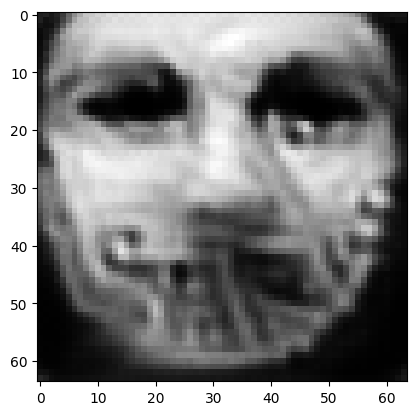

tensor([[3.9205e-03, 2.6296e-05, 4.6418e-04, 1.1103e-04, 2.1097e-04, 1.7550e-03,
         9.6342e-01, 4.2361e-03, 4.2107e-06, 1.5532e-04, 2.3152e-04, 2.0326e-05,
         8.7590e-05, 1.1630e-06, 1.2362e-04, 2.3619e-03, 1.7833e-03, 5.5610e-03,
         1.6855e-03, 4.0838e-03, 1.5588e-04, 1.8773e-05, 1.4693e-06, 1.2794e-03,
         3.9990e-05, 2.0640e-07, 1.1492e-03, 7.9725e-04, 3.5678e-03, 6.0400e-05,
         3.1863e-06, 1.8084e-04, 1.2261e-03, 1.9253e-04, 6.8237e-05, 1.7546e-04,
         3.9445e-05, 3.4884e-05, 4.6461e-04, 3.0418e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03726912662386894
tensor([[3.9150e-03, 2.6240e-05, 4.6323e-04, 1.1088e-04, 2.1054e-04, 1.7508e-03,
         9.6347e-01, 4.2298e-03, 4.2002e-06, 1.5502e-04, 2.3125e-04, 2.0286e-05,
         8.7420e-05, 1.1604e-06, 1.2339e-04, 2.3591e-03, 1.7824e-03, 5.5525e-03,
         1.6833e-03, 4.0778e-03, 1.5568e-04, 1.8729e-05, 1.4667e-06, 1.2783e-03,
         3.9910e-05, 2.0581e-07, 1.1464e-0

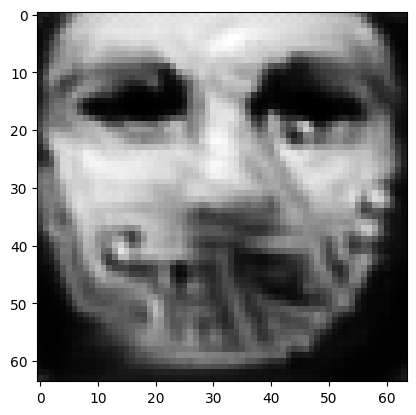

tensor([[3.8879e-03, 2.6069e-05, 4.5948e-04, 1.1042e-04, 2.0932e-04, 1.7348e-03,
         9.6370e-01, 4.2001e-03, 4.1750e-06, 1.5373e-04, 2.3001e-04, 2.0153e-05,
         8.6994e-05, 1.1534e-06, 1.2247e-04, 2.3460e-03, 1.7791e-03, 5.5236e-03,
         1.6753e-03, 4.0545e-03, 1.5522e-04, 1.8559e-05, 1.4647e-06, 1.2709e-03,
         3.9682e-05, 2.0401e-07, 1.1390e-03, 7.9114e-04, 3.5266e-03, 5.9925e-05,
         3.1619e-06, 1.7919e-04, 1.2182e-03, 1.9110e-04, 6.7743e-05, 1.7469e-04,
         3.9114e-05, 3.4653e-05, 4.6150e-04, 3.0257e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036975301802158356
tensor([[3.8803e-03, 2.6029e-05, 4.5901e-04, 1.1033e-04, 2.0907e-04, 1.7337e-03,
         9.6375e-01, 4.1948e-03, 4.1704e-06, 1.5351e-04, 2.2976e-04, 2.0134e-05,
         8.6878e-05, 1.1508e-06, 1.2210e-04, 2.3427e-03, 1.7779e-03, 5.5131e-03,
         1.6729e-03, 4.0482e-03, 1.5502e-04, 1.8508e-05, 1.4634e-06, 1.2675e-03,
         3.9603e-05, 2.0371e-07, 1.1379e-

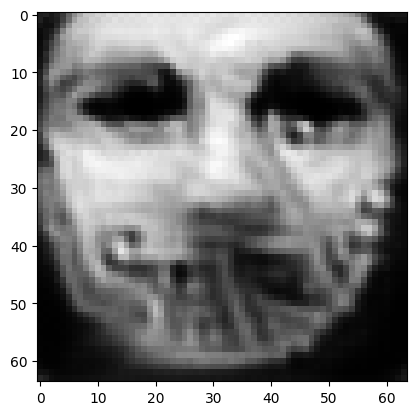

tensor([[3.8534e-03, 2.5871e-05, 4.5557e-04, 1.0989e-04, 2.0781e-04, 1.7193e-03,
         9.6396e-01, 4.1657e-03, 4.1495e-06, 1.5236e-04, 2.2862e-04, 2.0013e-05,
         8.6501e-05, 1.1438e-06, 1.2121e-04, 2.3312e-03, 1.7738e-03, 5.4842e-03,
         1.6655e-03, 4.0295e-03, 1.5464e-04, 1.8349e-05, 1.4610e-06, 1.2602e-03,
         3.9360e-05, 2.0201e-07, 1.1312e-03, 7.8531e-04, 3.4913e-03, 5.9491e-05,
         3.1396e-06, 1.7764e-04, 1.2116e-03, 1.8981e-04, 6.7348e-05, 1.7384e-04,
         3.8803e-05, 3.4446e-05, 4.5915e-04, 3.0201e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036700353026390076
tensor([[3.8484e-03, 2.5809e-05, 4.5465e-04, 1.0969e-04, 2.0745e-04, 1.7149e-03,
         9.6402e-01, 4.1608e-03, 4.1402e-06, 1.5207e-04, 2.2836e-04, 1.9973e-05,
         8.6348e-05, 1.1418e-06, 1.2100e-04, 2.3278e-03, 1.7729e-03, 5.4765e-03,
         1.6634e-03, 4.0247e-03, 1.5443e-04, 1.8317e-05, 1.4588e-06, 1.2598e-03,
         3.9301e-05, 2.0151e-07, 1.1285e-

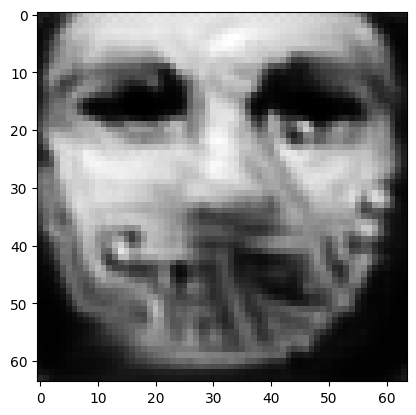

tensor([[3.8215e-03, 2.5662e-05, 4.5180e-04, 1.0942e-04, 2.0656e-04, 1.7014e-03,
         9.6423e-01, 4.1336e-03, 4.1271e-06, 1.5097e-04, 2.2730e-04, 1.9866e-05,
         8.6081e-05, 1.1363e-06, 1.2009e-04, 2.3142e-03, 1.7715e-03, 5.4445e-03,
         1.6571e-03, 4.0025e-03, 1.5407e-04, 1.8152e-05, 1.4583e-06, 1.2522e-03,
         3.9142e-05, 2.0030e-07, 1.1219e-03, 7.8009e-04, 3.4551e-03, 5.9140e-05,
         3.1228e-06, 1.7591e-04, 1.2048e-03, 1.8864e-04, 6.6963e-05, 1.7316e-04,
         3.8506e-05, 3.4253e-05, 4.5736e-04, 3.0125e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03643038496375084
tensor([[3.8147e-03, 2.5629e-05, 4.5106e-04, 1.0938e-04, 2.0636e-04, 1.6976e-03,
         9.6428e-01, 4.1261e-03, 4.1250e-06, 1.5068e-04, 2.2704e-04, 1.9839e-05,
         8.6041e-05, 1.1352e-06, 1.1988e-04, 2.3106e-03, 1.7714e-03, 5.4369e-03,
         1.6557e-03, 3.9971e-03, 1.5402e-04, 1.8110e-05, 1.4587e-06, 1.2504e-03,
         3.9113e-05, 2.0002e-07, 1.1203e-0

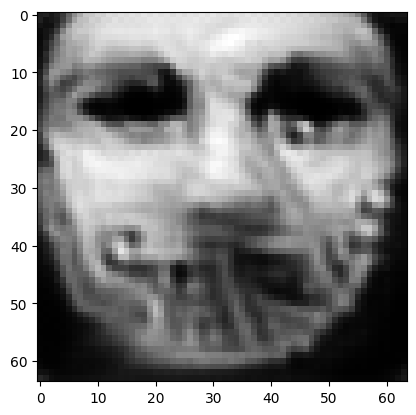

tensor([[3.7878e-03, 2.5474e-05, 4.4838e-04, 1.0909e-04, 2.0549e-04, 1.6849e-03,
         9.6448e-01, 4.1007e-03, 4.1138e-06, 1.4963e-04, 2.2608e-04, 1.9730e-05,
         8.5801e-05, 1.1297e-06, 1.1893e-04, 2.2963e-03, 1.7709e-03, 5.4019e-03,
         1.6497e-03, 3.9772e-03, 1.5362e-04, 1.7951e-05, 1.4582e-06, 1.2432e-03,
         3.8971e-05, 1.9897e-07, 1.1134e-03, 7.7547e-04, 3.4215e-03, 5.8861e-05,
         3.1101e-06, 1.7405e-04, 1.1987e-03, 1.8758e-04, 6.6676e-05, 1.7249e-04,
         3.8232e-05, 3.4080e-05, 4.5622e-04, 3.0124e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036166321486234665
tensor([[3.7821e-03, 2.5434e-05, 4.4766e-04, 1.0900e-04, 2.0520e-04, 1.6813e-03,
         9.6453e-01, 4.0944e-03, 4.1091e-06, 1.4939e-04, 2.2585e-04, 1.9698e-05,
         8.5714e-05, 1.1281e-06, 1.1873e-04, 2.2934e-03, 1.7706e-03, 5.3928e-03,
         1.6485e-03, 3.9727e-03, 1.5350e-04, 1.7915e-05, 1.4573e-06, 1.2419e-03,
         3.8922e-05, 1.9864e-07, 1.1115e-

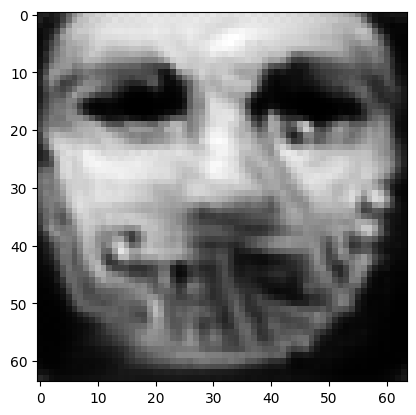

tensor([[3.7561e-03, 2.5296e-05, 4.4547e-04, 1.0879e-04, 2.0446e-04, 1.6719e-03,
         9.6471e-01, 4.0711e-03, 4.1008e-06, 1.4846e-04, 2.2499e-04, 1.9608e-05,
         8.5495e-05, 1.1225e-06, 1.1776e-04, 2.2803e-03, 1.7698e-03, 5.3596e-03,
         1.6427e-03, 3.9540e-03, 1.5309e-04, 1.7760e-05, 1.4569e-06, 1.2339e-03,
         3.8774e-05, 1.9779e-07, 1.1059e-03, 7.7120e-04, 3.3924e-03, 5.8587e-05,
         3.0961e-06, 1.7236e-04, 1.1925e-03, 1.8651e-04, 6.6413e-05, 1.7175e-04,
         3.7985e-05, 3.3924e-05, 4.5510e-04, 3.0143e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035923004150390625
tensor([[3.7511e-03, 2.5252e-05, 4.4475e-04, 1.0868e-04, 2.0421e-04, 1.6683e-03,
         9.6476e-01, 4.0659e-03, 4.0951e-06, 1.4821e-04, 2.2478e-04, 1.9577e-05,
         8.5403e-05, 1.1213e-06, 1.1758e-04, 2.2773e-03, 1.7699e-03, 5.3521e-03,
         1.6414e-03, 3.9494e-03, 1.5296e-04, 1.7729e-05, 1.4562e-06, 1.2333e-03,
         3.8738e-05, 1.9748e-07, 1.1037e-

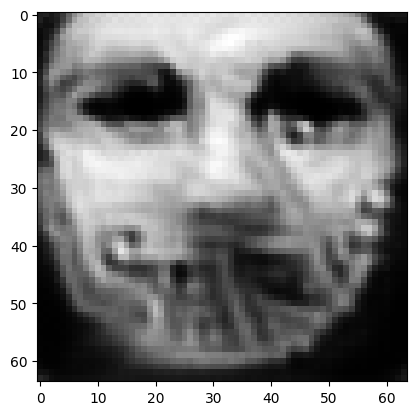

tensor([[3.7302e-03, 2.5128e-05, 4.4192e-04, 1.0840e-04, 2.0339e-04, 1.6556e-03,
         9.6493e-01, 4.0420e-03, 4.0818e-06, 1.4726e-04, 2.2387e-04, 1.9475e-05,
         8.5178e-05, 1.1171e-06, 1.1691e-04, 2.2658e-03, 1.7679e-03, 5.3280e-03,
         1.6367e-03, 3.9333e-03, 1.5265e-04, 1.7605e-05, 1.4559e-06, 1.2278e-03,
         3.8598e-05, 1.9634e-07, 1.0981e-03, 7.6669e-04, 3.3597e-03, 5.8322e-05,
         3.0838e-06, 1.7098e-04, 1.1874e-03, 1.8562e-04, 6.6041e-05, 1.7134e-04,
         3.7743e-05, 3.3769e-05, 4.5354e-04, 3.0061e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03569711372256279
tensor([[3.7223e-03, 2.5117e-05, 4.4156e-04, 1.0843e-04, 2.0334e-04, 1.6548e-03,
         9.6497e-01, 4.0353e-03, 4.0847e-06, 1.4706e-04, 2.2367e-04, 1.9471e-05,
         8.5198e-05, 1.1164e-06, 1.1666e-04, 2.2632e-03, 1.7679e-03, 5.3215e-03,
         1.6354e-03, 3.9286e-03, 1.5266e-04, 1.7562e-05, 1.4575e-06, 1.2246e-03,
         3.8578e-05, 1.9627e-07, 1.0978e-0

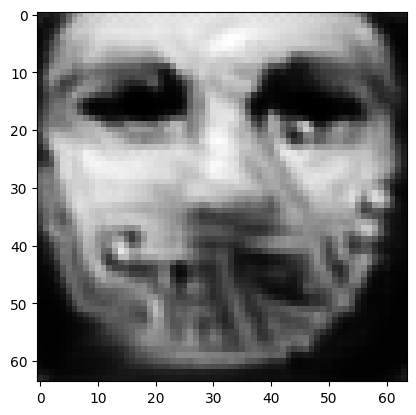

tensor([[3.7034e-03, 2.5000e-05, 4.3877e-04, 1.0813e-04, 2.0247e-04, 1.6427e-03,
         9.6513e-01, 4.0133e-03, 4.0691e-06, 1.4616e-04, 2.2284e-04, 1.9372e-05,
         8.4950e-05, 1.1123e-06, 1.1608e-04, 2.2535e-03, 1.7662e-03, 5.2994e-03,
         1.6311e-03, 3.9141e-03, 1.5234e-04, 1.7450e-05, 1.4565e-06, 1.2200e-03,
         3.8432e-05, 1.9511e-07, 1.0922e-03, 7.6285e-04, 3.3311e-03, 5.8084e-05,
         3.0721e-06, 1.6975e-04, 1.1824e-03, 1.8479e-04, 6.5789e-05, 1.7093e-04,
         3.7541e-05, 3.3632e-05, 4.5213e-04, 3.0043e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03548969700932503
tensor([[3.6984e-03, 2.4978e-05, 4.3812e-04, 1.0809e-04, 2.0230e-04, 1.6399e-03,
         9.6517e-01, 4.0078e-03, 4.0673e-06, 1.4594e-04, 2.2263e-04, 1.9351e-05,
         8.4917e-05, 1.1115e-06, 1.1594e-04, 2.2510e-03, 1.7657e-03, 5.2945e-03,
         1.6300e-03, 3.9106e-03, 1.5231e-04, 1.7421e-05, 1.4568e-06, 1.2186e-03,
         3.8406e-05, 1.9486e-07, 1.0911e-0

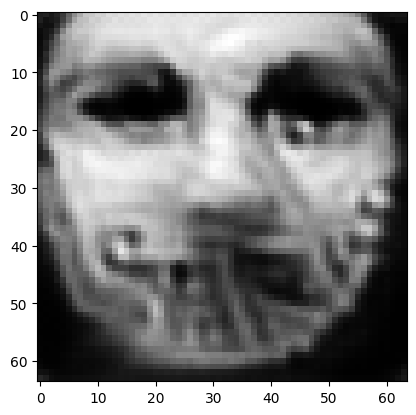

tensor([[3.6781e-03, 2.4879e-05, 4.3587e-04, 1.0790e-04, 2.0169e-04, 1.6310e-03,
         9.6532e-01, 3.9877e-03, 4.0601e-06, 1.4513e-04, 2.2186e-04, 1.9277e-05,
         8.4767e-05, 1.1078e-06, 1.1528e-04, 2.2410e-03, 1.7645e-03, 5.2730e-03,
         1.6254e-03, 3.8966e-03, 1.5207e-04, 1.7305e-05, 1.4577e-06, 1.2125e-03,
         3.8301e-05, 1.9403e-07, 1.0870e-03, 7.5932e-04, 3.3030e-03, 5.7851e-05,
         3.0613e-06, 1.6859e-04, 1.1781e-03, 1.8400e-04, 6.5569e-05, 1.7056e-04,
         3.7347e-05, 3.3507e-05, 4.5099e-04, 3.0042e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03529604151844978
tensor([[3.6738e-03, 2.4852e-05, 4.3530e-04, 1.0785e-04, 2.0152e-04, 1.6288e-03,
         9.6536e-01, 3.9830e-03, 4.0576e-06, 1.4494e-04, 2.2167e-04, 1.9257e-05,
         8.4720e-05, 1.1067e-06, 1.1513e-04, 2.2386e-03, 1.7639e-03, 5.2679e-03,
         1.6242e-03, 3.8933e-03, 1.5199e-04, 1.7279e-05, 1.4576e-06, 1.2112e-03,
         3.8271e-05, 1.9380e-07, 1.0859e-0

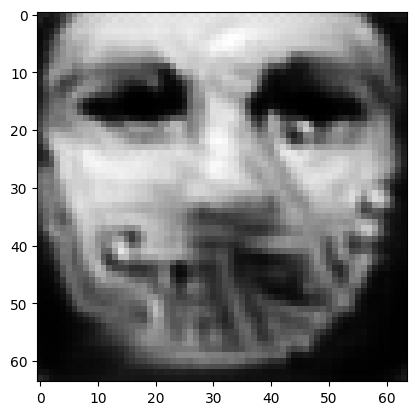

tensor([[3.6549e-03, 2.4757e-05, 4.3329e-04, 1.0766e-04, 2.0089e-04, 1.6211e-03,
         9.6549e-01, 3.9646e-03, 4.0492e-06, 1.4422e-04, 2.2098e-04, 1.9189e-05,
         8.4547e-05, 1.1027e-06, 1.1448e-04, 2.2296e-03, 1.7625e-03, 5.2462e-03,
         1.6198e-03, 3.8802e-03, 1.5171e-04, 1.7168e-05, 1.4575e-06, 1.2052e-03,
         3.8148e-05, 1.9301e-07, 1.0821e-03, 7.5586e-04, 3.2780e-03, 5.7616e-05,
         3.0499e-06, 1.6753e-04, 1.1738e-03, 1.8322e-04, 6.5348e-05, 1.7013e-04,
         3.7165e-05, 3.3389e-05, 4.4979e-04, 3.0038e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03511489927768707
tensor([[3.6515e-03, 2.4726e-05, 4.3268e-04, 1.0757e-04, 2.0066e-04, 1.6185e-03,
         9.6553e-01, 3.9605e-03, 4.0437e-06, 1.4403e-04, 2.2082e-04, 1.9166e-05,
         8.4461e-05, 1.1016e-06, 1.1436e-04, 2.2276e-03, 1.7620e-03, 5.2418e-03,
         1.6187e-03, 3.8769e-03, 1.5161e-04, 1.7145e-05, 1.4566e-06, 1.2046e-03,
         3.8107e-05, 1.9271e-07, 1.0806e-0

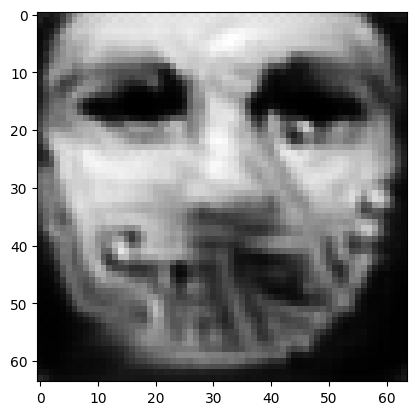

tensor([[3.6361e-03, 2.4614e-05, 4.3082e-04, 1.0728e-04, 1.9996e-04, 1.6117e-03,
         9.6565e-01, 3.9461e-03, 4.0301e-06, 1.4340e-04, 2.2021e-04, 1.9096e-05,
         8.4207e-05, 1.0968e-06, 1.1373e-04, 2.2191e-03, 1.7597e-03, 5.2219e-03,
         1.6137e-03, 3.8651e-03, 1.5118e-04, 1.7049e-05, 1.4539e-06, 1.1998e-03,
         3.7962e-05, 1.9183e-07, 1.0765e-03, 7.5228e-04, 3.2555e-03, 5.7345e-05,
         3.0360e-06, 1.6659e-04, 1.1695e-03, 1.8242e-04, 6.5041e-05, 1.6961e-04,
         3.6971e-05, 3.3265e-05, 4.4818e-04, 2.9961e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034949030727148056
tensor([[3.6329e-03, 2.4588e-05, 4.3024e-04, 1.0720e-04, 1.9975e-04, 1.6092e-03,
         9.6569e-01, 3.9422e-03, 4.0252e-06, 1.4323e-04, 2.2005e-04, 1.9074e-05,
         8.4134e-05, 1.0957e-06, 1.1363e-04, 2.2173e-03, 1.7592e-03, 5.2174e-03,
         1.6127e-03, 3.8623e-03, 1.5109e-04, 1.7028e-05, 1.4530e-06, 1.1992e-03,
         3.7926e-05, 1.9156e-07, 1.0752e-

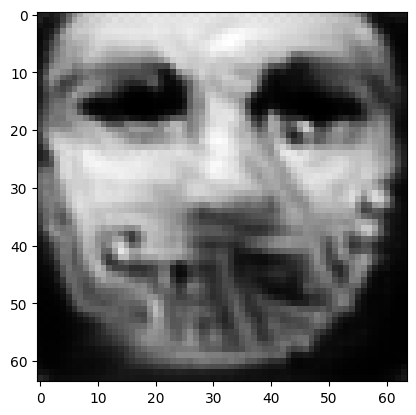

tensor([[3.6188e-03, 2.4489e-05, 4.2831e-04, 1.0695e-04, 1.9897e-04, 1.6015e-03,
         9.6581e-01, 3.9265e-03, 4.0116e-06, 1.4262e-04, 2.1949e-04, 1.9002e-05,
         8.3899e-05, 1.0913e-06, 1.1314e-04, 2.2101e-03, 1.7572e-03, 5.1994e-03,
         1.6084e-03, 3.8516e-03, 1.5075e-04, 1.6934e-05, 1.4500e-06, 1.1953e-03,
         3.7784e-05, 1.9062e-07, 1.0709e-03, 7.4899e-04, 3.2353e-03, 5.7117e-05,
         3.0226e-06, 1.6564e-04, 1.1647e-03, 1.8160e-04, 6.4772e-05, 1.6914e-04,
         3.6781e-05, 3.3136e-05, 4.4655e-04, 2.9875e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03479257598519325
tensor([[3.6135e-03, 2.4472e-05, 4.2813e-04, 1.0694e-04, 1.9892e-04, 1.6013e-03,
         9.6583e-01, 3.9229e-03, 4.0122e-06, 1.4251e-04, 2.1937e-04, 1.8998e-05,
         8.3889e-05, 1.0904e-06, 1.1293e-04, 2.2078e-03, 1.7571e-03, 5.1937e-03,
         1.6073e-03, 3.8483e-03, 1.5069e-04, 1.6907e-05, 1.4504e-06, 1.1931e-03,
         3.7763e-05, 1.9058e-07, 1.0705e-0

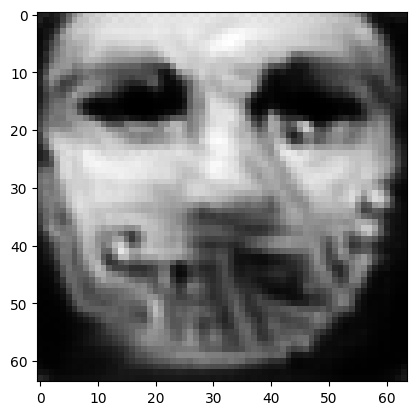

tensor([[3.6003e-03, 2.4379e-05, 4.2635e-04, 1.0670e-04, 1.9820e-04, 1.5939e-03,
         9.6595e-01, 3.9086e-03, 3.9991e-06, 1.4195e-04, 2.1885e-04, 1.8928e-05,
         8.3669e-05, 1.0863e-06, 1.1247e-04, 2.2008e-03, 1.7555e-03, 5.1752e-03,
         1.6035e-03, 3.8379e-03, 1.5035e-04, 1.6820e-05, 1.4475e-06, 1.1896e-03,
         3.7633e-05, 1.8972e-07, 1.0663e-03, 7.4619e-04, 3.2180e-03, 5.6918e-05,
         3.0114e-06, 1.6469e-04, 1.1603e-03, 1.8088e-04, 6.4579e-05, 1.6866e-04,
         3.6622e-05, 3.3026e-05, 4.4538e-04, 2.9852e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034644849598407745
tensor([[3.5968e-03, 2.4359e-05, 4.2592e-04, 1.0666e-04, 1.9806e-04, 1.5921e-03,
         9.6598e-01, 3.9048e-03, 3.9967e-06, 1.4180e-04, 2.1871e-04, 1.8913e-05,
         8.3629e-05, 1.0856e-06, 1.1236e-04, 2.1990e-03, 1.7553e-03, 5.1713e-03,
         1.6026e-03, 3.8352e-03, 1.5030e-04, 1.6799e-05, 1.4473e-06, 1.1887e-03,
         3.7610e-05, 1.8954e-07, 1.0654e-

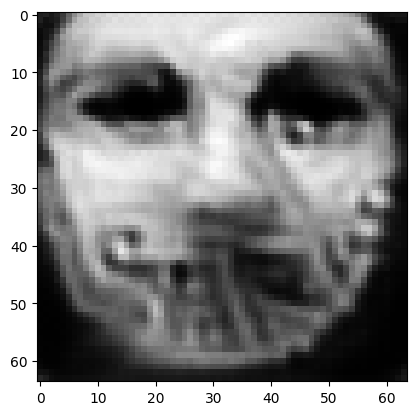

tensor([[3.5862e-03, 2.4228e-05, 4.2437e-04, 1.0632e-04, 1.9726e-04, 1.5860e-03,
         9.6608e-01, 3.8947e-03, 3.9713e-06, 1.4127e-04, 2.1834e-04, 1.8843e-05,
         8.3231e-05, 1.0803e-06, 1.1188e-04, 2.1929e-03, 1.7547e-03, 5.1542e-03,
         1.5980e-03, 3.8229e-03, 1.4971e-04, 1.6713e-05, 1.4405e-06, 1.1871e-03,
         3.7452e-05, 1.8861e-07, 1.0595e-03, 7.4334e-04, 3.2032e-03, 5.6674e-05,
         2.9956e-06, 1.6384e-04, 1.1548e-03, 1.7998e-04, 6.4267e-05, 1.6805e-04,
         3.6475e-05, 3.2917e-05, 4.4322e-04, 2.9712e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034507930278778076
tensor([[3.5814e-03, 2.4218e-05, 4.2424e-04, 1.0633e-04, 1.9723e-04, 1.5860e-03,
         9.6611e-01, 3.8913e-03, 3.9731e-06, 1.4118e-04, 2.1822e-04, 1.8841e-05,
         8.3234e-05, 1.0795e-06, 1.1169e-04, 2.1909e-03, 1.7544e-03, 5.1486e-03,
         1.5970e-03, 3.8198e-03, 1.4966e-04, 1.6687e-05, 1.4411e-06, 1.1848e-03,
         3.7434e-05, 1.8860e-07, 1.0595e-

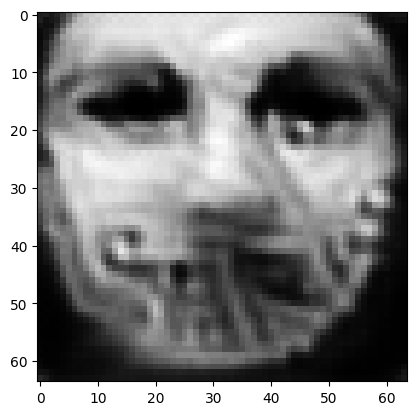

tensor([[3.5705e-03, 2.4124e-05, 4.2273e-04, 1.0609e-04, 1.9660e-04, 1.5799e-03,
         9.6621e-01, 3.8799e-03, 3.9572e-06, 1.4067e-04, 2.1777e-04, 1.8777e-05,
         8.2980e-05, 1.0755e-06, 1.1128e-04, 2.1844e-03, 1.7534e-03, 5.1327e-03,
         1.5933e-03, 3.8093e-03, 1.4927e-04, 1.6608e-05, 1.4373e-06, 1.1822e-03,
         3.7319e-05, 1.8783e-07, 1.0551e-03, 7.4092e-04, 3.1886e-03, 5.6484e-05,
         2.9839e-06, 1.6300e-04, 1.1503e-03, 1.7926e-04, 6.4089e-05, 1.6757e-04,
         3.6344e-05, 3.2818e-05, 4.4195e-04, 2.9674e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03437674418091774
tensor([[3.5675e-03, 2.4109e-05, 4.2236e-04, 1.0607e-04, 1.9651e-04, 1.5783e-03,
         9.6623e-01, 3.8766e-03, 3.9556e-06, 1.4054e-04, 2.1764e-04, 1.8763e-05,
         8.2957e-05, 1.0749e-06, 1.1119e-04, 2.1827e-03, 1.7533e-03, 5.1290e-03,
         1.5926e-03, 3.8069e-03, 1.4923e-04, 1.6589e-05, 1.4373e-06, 1.1814e-03,
         3.7304e-05, 1.8768e-07, 1.0543e-0

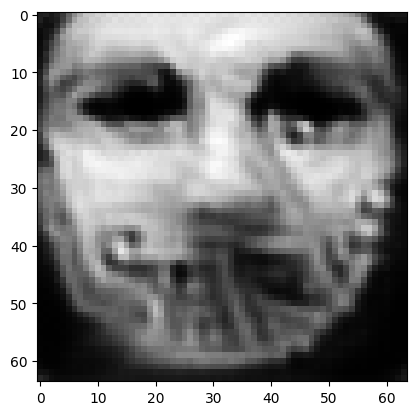

tensor([[3.5579e-03, 2.4001e-05, 4.2101e-04, 1.0580e-04, 1.9585e-04, 1.5731e-03,
         9.6633e-01, 3.8673e-03, 3.9348e-06, 1.4007e-04, 2.1729e-04, 1.8701e-05,
         8.2631e-05, 1.0705e-06, 1.1077e-04, 2.1769e-03, 1.7529e-03, 5.1135e-03,
         1.5887e-03, 3.7956e-03, 1.4872e-04, 1.6513e-05, 1.4319e-06, 1.1796e-03,
         3.7181e-05, 1.8693e-07, 1.0494e-03, 7.3857e-04, 3.1752e-03, 5.6286e-05,
         2.9706e-06, 1.6223e-04, 1.1453e-03, 1.7849e-04, 6.3849e-05, 1.6708e-04,
         3.6224e-05, 3.2719e-05, 4.4019e-04, 2.9566e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034254878759384155
tensor([[3.5537e-03, 2.3993e-05, 4.2089e-04, 1.0582e-04, 1.9584e-04, 1.5730e-03,
         9.6635e-01, 3.8641e-03, 3.9364e-06, 1.3999e-04, 2.1718e-04, 1.8699e-05,
         8.2641e-05, 1.0699e-06, 1.1061e-04, 2.1751e-03, 1.7528e-03, 5.1088e-03,
         1.5879e-03, 3.7930e-03, 1.4869e-04, 1.6491e-05, 1.4326e-06, 1.1776e-03,
         3.7168e-05, 1.8692e-07, 1.0494e-

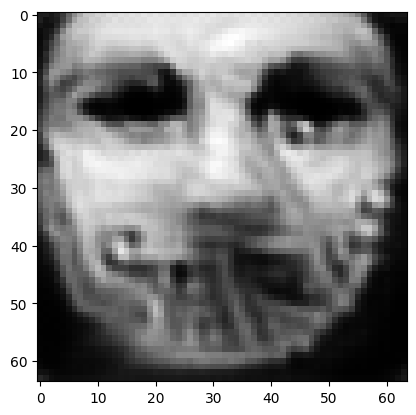

tensor([[3.5438e-03, 2.3900e-05, 4.1960e-04, 1.0560e-04, 1.9530e-04, 1.5680e-03,
         9.6644e-01, 3.8547e-03, 3.9198e-06, 1.3953e-04, 2.1681e-04, 1.8644e-05,
         8.2376e-05, 1.0663e-06, 1.1022e-04, 2.1693e-03, 1.7524e-03, 5.0952e-03,
         1.5842e-03, 3.7824e-03, 1.4828e-04, 1.6419e-05, 1.4287e-06, 1.1755e-03,
         3.7066e-05, 1.8627e-07, 1.0452e-03, 7.3649e-04, 3.1628e-03, 5.6109e-05,
         2.9595e-06, 1.6153e-04, 1.1411e-03, 1.7784e-04, 6.3683e-05, 1.6664e-04,
         3.6124e-05, 3.2638e-05, 4.3886e-04, 2.9519e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034138984978199005
tensor([[3.5412e-03, 2.3886e-05, 4.1924e-04, 1.0556e-04, 1.9520e-04, 1.5666e-03,
         9.6646e-01, 3.8518e-03, 3.9180e-06, 1.3941e-04, 2.1669e-04, 1.8632e-05,
         8.2347e-05, 1.0657e-06, 1.1014e-04, 2.1678e-03, 1.7520e-03, 5.0922e-03,
         1.5835e-03, 3.7805e-03, 1.4823e-04, 1.6402e-05, 1.4284e-06, 1.1747e-03,
         3.7048e-05, 1.8611e-07, 1.0445e-

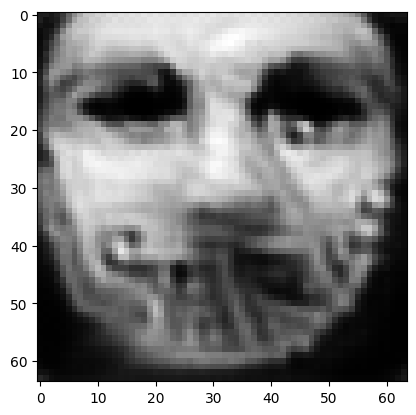

tensor([[3.5316e-03, 2.3811e-05, 4.1793e-04, 1.0540e-04, 1.9477e-04, 1.5616e-03,
         9.6654e-01, 3.8414e-03, 3.9048e-06, 1.3895e-04, 2.1628e-04, 1.8583e-05,
         8.2145e-05, 1.0629e-06, 1.0982e-04, 2.1624e-03, 1.7516e-03, 5.0815e-03,
         1.5803e-03, 3.7705e-03, 1.4794e-04, 1.6336e-05, 1.4264e-06, 1.1725e-03,
         3.6975e-05, 1.8553e-07, 1.0411e-03, 7.3445e-04, 3.1488e-03, 5.5952e-05,
         2.9496e-06, 1.6092e-04, 1.1372e-03, 1.7724e-04, 6.3511e-05, 1.6636e-04,
         3.6031e-05, 3.2559e-05, 4.3754e-04, 2.9451e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034030452370643616
tensor([[3.5293e-03, 2.3800e-05, 4.1759e-04, 1.0537e-04, 1.9469e-04, 1.5602e-03,
         9.6656e-01, 3.8384e-03, 3.9037e-06, 1.3884e-04, 2.1616e-04, 1.8571e-05,
         8.2129e-05, 1.0625e-06, 1.0975e-04, 2.1610e-03, 1.7513e-03, 5.0789e-03,
         1.5797e-03, 3.7686e-03, 1.4791e-04, 1.6321e-05, 1.4265e-06, 1.1718e-03,
         3.6965e-05, 1.8540e-07, 1.0405e-

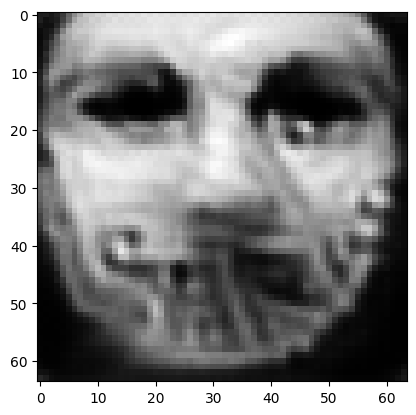

tensor([[3.5200e-03, 2.3735e-05, 4.1640e-04, 1.0524e-04, 1.9432e-04, 1.5556e-03,
         9.6664e-01, 3.8280e-03, 3.8928e-06, 1.3842e-04, 2.1578e-04, 1.8527e-05,
         8.1968e-05, 1.0602e-06, 1.0945e-04, 2.1560e-03, 1.7511e-03, 5.0686e-03,
         1.5769e-03, 3.7596e-03, 1.4768e-04, 1.6261e-05, 1.4250e-06, 1.1697e-03,
         3.6907e-05, 1.8491e-07, 1.0375e-03, 7.3263e-04, 3.1359e-03, 5.5826e-05,
         2.9415e-06, 1.6034e-04, 1.1338e-03, 1.7672e-04, 6.3375e-05, 1.6614e-04,
         3.5951e-05, 3.2488e-05, 4.3646e-04, 2.9402e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03393008932471275
tensor([[3.5195e-03, 2.3706e-05, 4.1593e-04, 1.0515e-04, 1.9411e-04, 1.5534e-03,
         9.6666e-01, 3.8263e-03, 3.8849e-06, 1.3829e-04, 2.1570e-04, 1.8505e-05,
         8.1860e-05, 1.0592e-06, 1.0944e-04, 2.1550e-03, 1.7509e-03, 5.0671e-03,
         1.5762e-03, 3.7576e-03, 1.4755e-04, 1.6250e-05, 1.4230e-06, 1.1704e-03,
         3.6878e-05, 1.8464e-07, 1.0359e-0

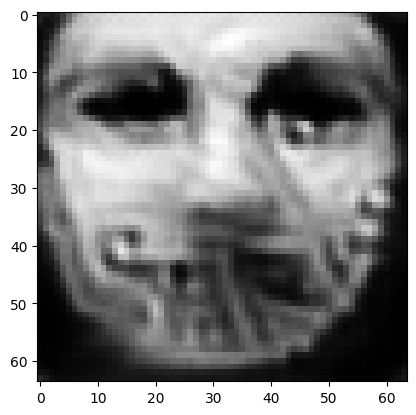

tensor([[3.5111e-03, 2.3645e-05, 4.1477e-04, 1.0502e-04, 1.9375e-04, 1.5490e-03,
         9.6673e-01, 3.8167e-03, 3.8749e-06, 1.3790e-04, 2.1533e-04, 1.8463e-05,
         8.1713e-05, 1.0570e-06, 1.0916e-04, 2.1502e-03, 1.7503e-03, 5.0575e-03,
         1.5736e-03, 3.7495e-03, 1.4732e-04, 1.6196e-05, 1.4215e-06, 1.1683e-03,
         3.6822e-05, 1.8416e-07, 1.0331e-03, 7.3069e-04, 3.1237e-03, 5.5681e-05,
         2.9320e-06, 1.5983e-04, 1.1303e-03, 1.7618e-04, 6.3178e-05, 1.6589e-04,
         3.5865e-05, 3.2412e-05, 4.3506e-04, 2.9296e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03383651748299599
tensor([[3.5077e-03, 2.3641e-05, 4.1470e-04, 1.0504e-04, 1.9375e-04, 1.5489e-03,
         9.6675e-01, 3.8141e-03, 3.8770e-06, 1.3783e-04, 2.1523e-04, 1.8463e-05,
         8.1730e-05, 1.0566e-06, 1.0903e-04, 2.1487e-03, 1.7502e-03, 5.0534e-03,
         1.5729e-03, 3.7473e-03, 1.4731e-04, 1.6178e-05, 1.4223e-06, 1.1667e-03,
         3.6816e-05, 1.8417e-07, 1.0331e-0

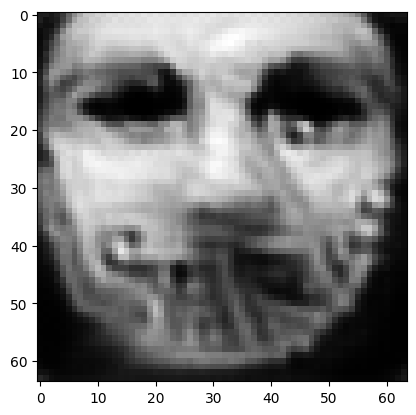

tensor([[3.4997e-03, 2.3577e-05, 4.1387e-04, 1.0491e-04, 1.9339e-04, 1.5460e-03,
         9.6682e-01, 3.8066e-03, 3.8669e-06, 1.3752e-04, 2.1493e-04, 1.8427e-05,
         8.1558e-05, 1.0537e-06, 1.0870e-04, 2.1444e-03, 1.7497e-03, 5.0418e-03,
         1.5703e-03, 3.7393e-03, 1.4702e-04, 1.6123e-05, 1.4198e-06, 1.1643e-03,
         3.6744e-05, 1.8376e-07, 1.0305e-03, 7.2917e-04, 3.1151e-03, 5.5560e-05,
         2.9244e-06, 1.5928e-04, 1.1272e-03, 1.7569e-04, 6.3097e-05, 1.6555e-04,
         3.5794e-05, 3.2353e-05, 4.3430e-04, 2.9296e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03374788910150528
tensor([[3.4997e-03, 2.3552e-05, 4.1327e-04, 1.0480e-04, 1.9313e-04, 1.5435e-03,
         9.6683e-01, 3.8045e-03, 3.8592e-06, 1.3741e-04, 2.1484e-04, 1.8403e-05,
         8.1456e-05, 1.0527e-06, 1.0872e-04, 2.1439e-03, 1.7489e-03, 5.0414e-03,
         1.5697e-03, 3.7388e-03, 1.4692e-04, 1.6116e-05, 1.4175e-06, 1.1651e-03,
         3.6704e-05, 1.8342e-07, 1.0291e-0

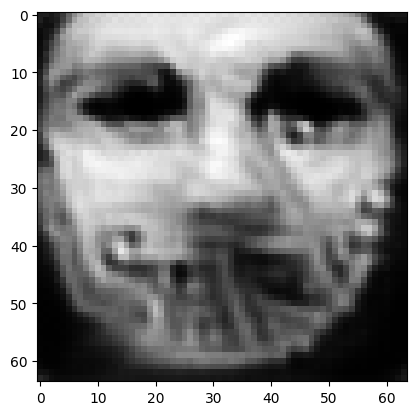

tensor([[3.4920e-03, 2.3503e-05, 4.1229e-04, 1.0470e-04, 1.9276e-04, 1.5402e-03,
         9.6689e-01, 3.7957e-03, 3.8512e-06, 1.3709e-04, 2.1450e-04, 1.8369e-05,
         8.1327e-05, 1.0503e-06, 1.0846e-04, 2.1403e-03, 1.7476e-03, 5.0325e-03,
         1.5673e-03, 3.7325e-03, 1.4672e-04, 1.6066e-05, 1.4158e-06, 1.1626e-03,
         3.6632e-05, 1.8296e-07, 1.0271e-03, 7.2723e-04, 3.1047e-03, 5.5419e-05,
         2.9147e-06, 1.5887e-04, 1.1240e-03, 1.7517e-04, 6.2916e-05, 1.6530e-04,
         3.5698e-05, 3.2276e-05, 4.3298e-04, 2.9201e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033666517585515976
tensor([[3.4891e-03, 2.3498e-05, 4.1225e-04, 1.0472e-04, 1.9277e-04, 1.5403e-03,
         9.6691e-01, 3.7935e-03, 3.8532e-06, 1.3704e-04, 2.1442e-04, 1.8369e-05,
         8.1345e-05, 1.0499e-06, 1.0835e-04, 2.1390e-03, 1.7476e-03, 5.0288e-03,
         1.5668e-03, 3.7307e-03, 1.4671e-04, 1.6051e-05, 1.4164e-06, 1.1612e-03,
         3.6629e-05, 1.8298e-07, 1.0272e-

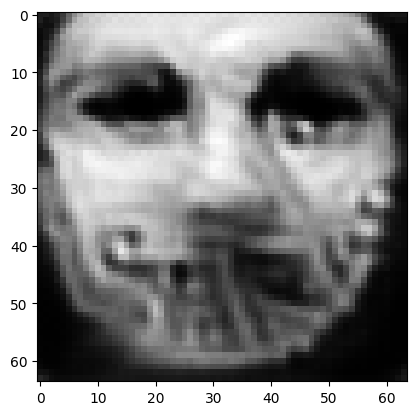

tensor([[3.4821e-03, 2.3451e-05, 4.1130e-04, 1.0461e-04, 1.9244e-04, 1.5369e-03,
         9.6697e-01, 3.7855e-03, 3.8453e-06, 1.3674e-04, 2.1411e-04, 1.8336e-05,
         8.1224e-05, 1.0478e-06, 1.0811e-04, 2.1355e-03, 1.7466e-03, 5.0205e-03,
         1.5647e-03, 3.7249e-03, 1.4652e-04, 1.6006e-05, 1.4149e-06, 1.1591e-03,
         3.6566e-05, 1.8255e-07, 1.0252e-03, 7.2580e-04, 3.0958e-03, 5.5317e-05,
         2.9087e-06, 1.5843e-04, 1.1217e-03, 1.7479e-04, 6.2838e-05, 1.6508e-04,
         3.5633e-05, 3.2223e-05, 4.3236e-04, 2.9200e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03358963504433632
tensor([[3.4808e-03, 2.3430e-05, 4.1110e-04, 1.0455e-04, 1.9231e-04, 1.5363e-03,
         9.6698e-01, 3.7842e-03, 3.8406e-06, 1.3667e-04, 2.1406e-04, 1.8325e-05,
         8.1150e-05, 1.0469e-06, 1.0804e-04, 2.1347e-03, 1.7465e-03, 5.0180e-03,
         1.5640e-03, 3.7229e-03, 1.4641e-04, 1.5994e-05, 1.4135e-06, 1.1589e-03,
         3.6540e-05, 1.8242e-07, 1.0243e-0

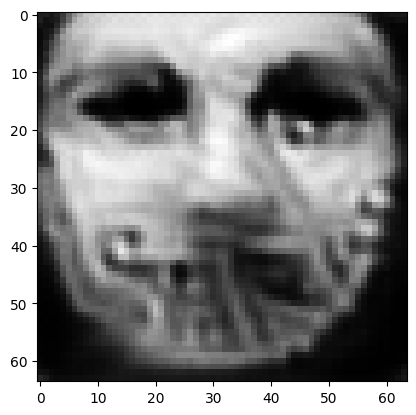

tensor([[3.4745e-03, 2.3391e-05, 4.1007e-04, 1.0445e-04, 1.9195e-04, 1.5326e-03,
         9.6704e-01, 3.7760e-03, 3.8337e-06, 1.3638e-04, 2.1373e-04, 1.8291e-05,
         8.1047e-05, 1.0448e-06, 1.0785e-04, 2.1316e-03, 1.7448e-03, 5.0109e-03,
         1.5620e-03, 3.7186e-03, 1.4626e-04, 1.5954e-05, 1.4119e-06, 1.1569e-03,
         3.6473e-05, 1.8194e-07, 1.0227e-03, 7.2418e-04, 3.0870e-03, 5.5197e-05,
         2.9007e-06, 1.5806e-04, 1.1190e-03, 1.7436e-04, 6.2704e-05, 1.6486e-04,
         3.5554e-05, 3.2158e-05, 4.3135e-04, 2.9141e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03351724147796631
tensor([[3.4728e-03, 2.3370e-05, 4.0986e-04, 1.0439e-04, 1.9184e-04, 1.5320e-03,
         9.6705e-01, 3.7750e-03, 3.8299e-06, 1.3631e-04, 2.1369e-04, 1.8281e-05,
         8.0983e-05, 1.0440e-06, 1.0778e-04, 2.1307e-03, 1.7447e-03, 5.0086e-03,
         1.5612e-03, 3.7169e-03, 1.4616e-04, 1.5943e-05, 1.4108e-06, 1.1567e-03,
         3.6452e-05, 1.8183e-07, 1.0218e-0

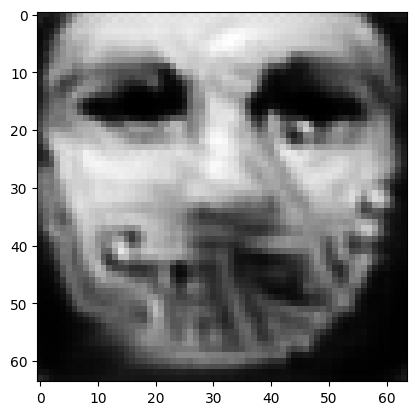

tensor([[3.4658e-03, 2.3327e-05, 4.0903e-04, 1.0427e-04, 1.9153e-04, 1.5294e-03,
         9.6711e-01, 3.7685e-03, 3.8241e-06, 1.3604e-04, 2.1341e-04, 1.8251e-05,
         8.0877e-05, 1.0418e-06, 1.0754e-04, 2.1273e-03, 1.7433e-03, 5.0003e-03,
         1.5590e-03, 3.7126e-03, 1.4597e-04, 1.5901e-05, 1.4090e-06, 1.1545e-03,
         3.6389e-05, 1.8144e-07, 1.0201e-03, 7.2264e-04, 3.0785e-03, 5.5072e-05,
         2.8931e-06, 1.5771e-04, 1.1167e-03, 1.7396e-04, 6.2573e-05, 1.6459e-04,
         3.5476e-05, 3.2101e-05, 4.3057e-04, 2.9099e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03344668820500374
tensor([[3.4644e-03, 2.3309e-05, 4.0881e-04, 1.0422e-04, 1.9142e-04, 1.5286e-03,
         9.6712e-01, 3.7673e-03, 3.8204e-06, 1.3597e-04, 2.1336e-04, 1.8241e-05,
         8.0819e-05, 1.0411e-06, 1.0749e-04, 2.1264e-03, 1.7432e-03, 4.9984e-03,
         1.5583e-03, 3.7111e-03, 1.4588e-04, 1.5891e-05, 1.4080e-06, 1.1543e-03,
         3.6369e-05, 1.8132e-07, 1.0194e-0

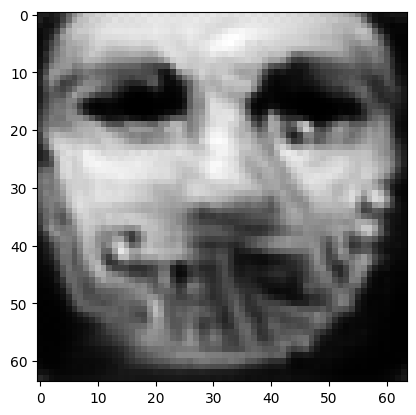

tensor([[3.4577e-03, 2.3271e-05, 4.0795e-04, 1.0412e-04, 1.9114e-04, 1.5258e-03,
         9.6717e-01, 3.7606e-03, 3.8154e-06, 1.3570e-04, 2.1308e-04, 1.8213e-05,
         8.0735e-05, 1.0393e-06, 1.0729e-04, 2.1231e-03, 1.7419e-03, 4.9914e-03,
         1.5562e-03, 3.7071e-03, 1.4574e-04, 1.5853e-05, 1.4070e-06, 1.1522e-03,
         3.6318e-05, 1.8095e-07, 1.0179e-03, 7.2118e-04, 3.0697e-03, 5.4957e-05,
         2.8864e-06, 1.5739e-04, 1.1146e-03, 1.7362e-04, 6.2450e-05, 1.6439e-04,
         3.5407e-05, 3.2047e-05, 4.2983e-04, 2.9059e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0333799347281456
tensor([[3.4564e-03, 2.3253e-05, 4.0775e-04, 1.0406e-04, 1.9102e-04, 1.5252e-03,
         9.6718e-01, 3.7596e-03, 3.8113e-06, 1.3564e-04, 2.1304e-04, 1.8203e-05,
         8.0668e-05, 1.0385e-06, 1.0723e-04, 2.1224e-03, 1.7417e-03, 4.9893e-03,
         1.5555e-03, 3.7057e-03, 1.4563e-04, 1.5843e-05, 1.4057e-06, 1.1521e-03,
         3.6294e-05, 1.8083e-07, 1.0171e-03

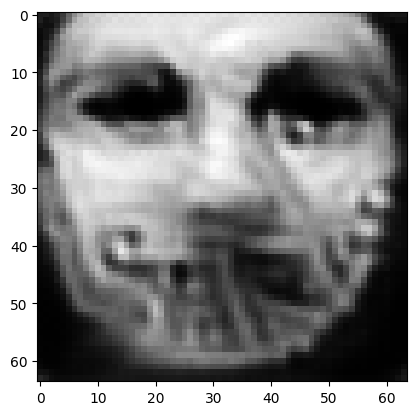

tensor([[3.4502e-03, 2.3216e-05, 4.0693e-04, 1.0396e-04, 1.9074e-04, 1.5226e-03,
         9.6723e-01, 3.7534e-03, 3.8063e-06, 1.3539e-04, 2.1277e-04, 1.8176e-05,
         8.0584e-05, 1.0367e-06, 1.0703e-04, 2.1193e-03, 1.7404e-03, 4.9827e-03,
         1.5535e-03, 3.7020e-03, 1.4548e-04, 1.5807e-05, 1.4045e-06, 1.1501e-03,
         3.6242e-05, 1.8047e-07, 1.0158e-03, 7.1974e-04, 3.0614e-03, 5.4841e-05,
         2.8795e-06, 1.5709e-04, 1.1125e-03, 1.7327e-04, 6.2326e-05, 1.6418e-04,
         3.5339e-05, 3.1994e-05, 4.2908e-04, 2.9016e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03331628814339638
tensor([[3.4489e-03, 2.3198e-05, 4.0675e-04, 1.0391e-04, 1.9063e-04, 1.5221e-03,
         9.6724e-01, 3.7526e-03, 3.8026e-06, 1.3533e-04, 2.1274e-04, 1.8166e-05,
         8.0521e-05, 1.0359e-06, 1.0698e-04, 2.1186e-03, 1.7403e-03, 4.9805e-03,
         1.5529e-03, 3.7006e-03, 1.4539e-04, 1.5797e-05, 1.4033e-06, 1.1499e-03,
         3.6221e-05, 1.8036e-07, 1.0150e-0

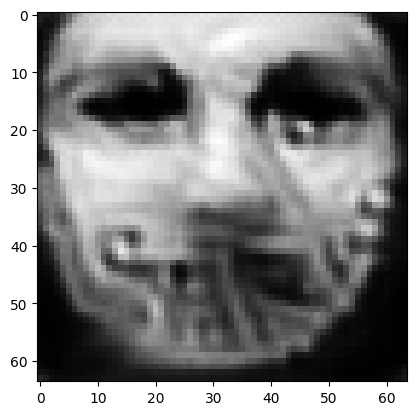

tensor([[3.4425e-03, 2.3167e-05, 4.0600e-04, 1.0383e-04, 1.9038e-04, 1.5197e-03,
         9.6729e-01, 3.7462e-03, 3.7990e-06, 1.3509e-04, 2.1249e-04, 1.8142e-05,
         8.0457e-05, 1.0343e-06, 1.0679e-04, 2.1159e-03, 1.7391e-03, 4.9744e-03,
         1.5510e-03, 3.6974e-03, 1.4528e-04, 1.5762e-05, 1.4025e-06, 1.1479e-03,
         3.6172e-05, 1.8003e-07, 1.0138e-03, 7.1845e-04, 3.0539e-03, 5.4737e-05,
         2.8731e-06, 1.5679e-04, 1.1105e-03, 1.7293e-04, 6.2223e-05, 1.6397e-04,
         3.5275e-05, 3.1944e-05, 4.2843e-04, 2.8986e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03325656056404114
tensor([[3.4413e-03, 2.3151e-05, 4.0582e-04, 1.0378e-04, 1.9027e-04, 1.5193e-03,
         9.6730e-01, 3.7453e-03, 3.7958e-06, 1.3503e-04, 2.1245e-04, 1.8134e-05,
         8.0403e-05, 1.0335e-06, 1.0674e-04, 2.1152e-03, 1.7388e-03, 4.9725e-03,
         1.5504e-03, 3.6962e-03, 1.4519e-04, 1.5752e-05, 1.4014e-06, 1.1477e-03,
         3.6151e-05, 1.7992e-07, 1.0131e-0

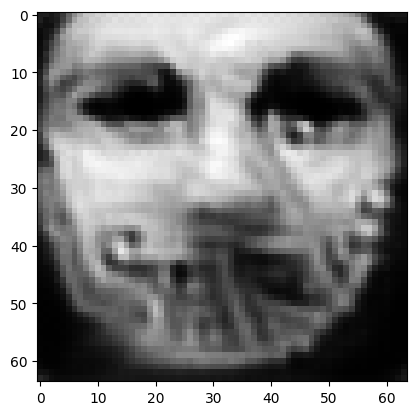

tensor([[3.4363e-03, 2.3108e-05, 4.0498e-04, 1.0364e-04, 1.8991e-04, 1.5165e-03,
         9.6735e-01, 3.7402e-03, 3.7872e-06, 1.3480e-04, 2.1225e-04, 1.8103e-05,
         8.0266e-05, 1.0314e-06, 1.0658e-04, 2.1130e-03, 1.7376e-03, 4.9664e-03,
         1.5485e-03, 3.6930e-03, 1.4500e-04, 1.5720e-05, 1.3988e-06, 1.1466e-03,
         3.6083e-05, 1.7949e-07, 1.0112e-03, 7.1707e-04, 3.0471e-03, 5.4620e-05,
         2.8655e-06, 1.5651e-04, 1.1082e-03, 1.7255e-04, 6.2079e-05, 1.6373e-04,
         3.5205e-05, 3.1887e-05, 4.2752e-04, 2.8918e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03319959715008736
tensor([[3.4342e-03, 2.3105e-05, 4.0498e-04, 1.0365e-04, 1.8992e-04, 1.5167e-03,
         9.6736e-01, 3.7389e-03, 3.7889e-06, 1.3476e-04, 2.1219e-04, 1.8103e-05,
         8.0282e-05, 1.0311e-06, 1.0650e-04, 2.1121e-03, 1.7375e-03, 4.9637e-03,
         1.5481e-03, 3.6921e-03, 1.4498e-04, 1.5711e-05, 1.3992e-06, 1.1456e-03,
         3.6079e-05, 1.7950e-07, 1.0113e-0

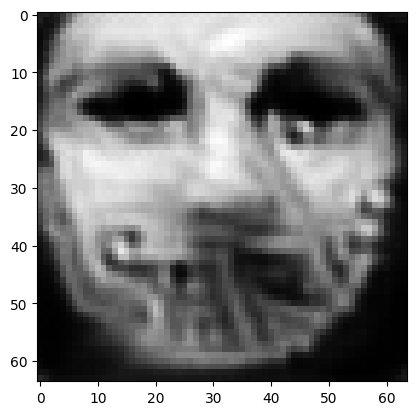

tensor([[3.4293e-03, 2.3055e-05, 4.0431e-04, 1.0350e-04, 1.8959e-04, 1.5148e-03,
         9.6740e-01, 3.7351e-03, 3.7785e-06, 1.3455e-04, 2.1204e-04, 1.8076e-05,
         8.0112e-05, 1.0288e-06, 1.0631e-04, 2.1098e-03, 1.7368e-03, 4.9574e-03,
         1.5460e-03, 3.6878e-03, 1.4473e-04, 1.5677e-05, 1.3961e-06, 1.1448e-03,
         3.6012e-05, 1.7914e-07, 1.0091e-03, 7.1598e-04, 3.0414e-03, 5.4515e-05,
         2.8589e-06, 1.5622e-04, 1.1061e-03, 1.7219e-04, 6.1977e-05, 1.6347e-04,
         3.5154e-05, 3.1845e-05, 4.2681e-04, 2.8888e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033145856112241745
tensor([[3.4272e-03, 2.3058e-05, 4.0422e-04, 1.0352e-04, 1.8962e-04, 1.5147e-03,
         9.6741e-01, 3.7331e-03, 3.7809e-06, 1.3450e-04, 2.1196e-04, 1.8077e-05,
         8.0147e-05, 1.0288e-06, 1.0625e-04, 2.1091e-03, 1.7366e-03, 4.9563e-03,
         1.5457e-03, 3.6870e-03, 1.4476e-04, 1.5669e-05, 1.3972e-06, 1.1437e-03,
         3.6016e-05, 1.7915e-07, 1.0095e-

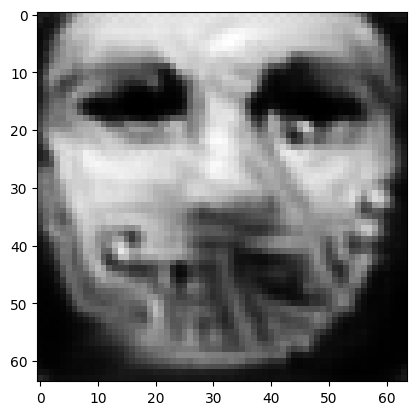

tensor([[3.4223e-03, 2.3024e-05, 4.0360e-04, 1.0342e-04, 1.8937e-04, 1.5127e-03,
         9.6745e-01, 3.7287e-03, 3.7755e-06, 1.3430e-04, 2.1178e-04, 1.8054e-05,
         8.0053e-05, 1.0271e-06, 1.0608e-04, 2.1068e-03, 1.7357e-03, 4.9500e-03,
         1.5441e-03, 3.6839e-03, 1.4460e-04, 1.5639e-05, 1.3955e-06, 1.1424e-03,
         3.5967e-05, 1.7884e-07, 1.0080e-03, 7.1500e-04, 3.0348e-03, 5.4440e-05,
         2.8549e-06, 1.5596e-04, 1.1046e-03, 1.7196e-04, 6.1917e-05, 1.6333e-04,
         3.5107e-05, 3.1805e-05, 4.2647e-04, 2.8891e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03309569135308266
tensor([[3.4217e-03, 2.3008e-05, 4.0335e-04, 1.0336e-04, 1.8923e-04, 1.5117e-03,
         9.6746e-01, 3.7280e-03, 3.7713e-06, 1.3424e-04, 2.1175e-04, 1.8041e-05,
         7.9986e-05, 1.0264e-06, 1.0606e-04, 2.1063e-03, 1.7355e-03, 4.9485e-03,
         1.5436e-03, 3.6830e-03, 1.4452e-04, 1.5633e-05, 1.3942e-06, 1.1428e-03,
         3.5944e-05, 1.7869e-07, 1.0071e-0

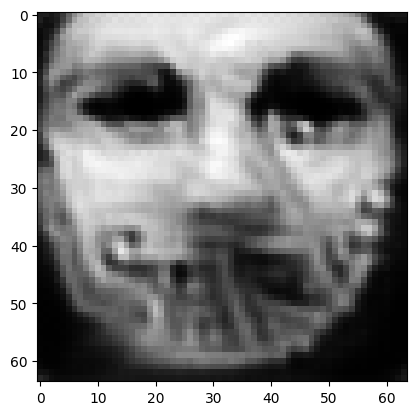

tensor([[3.4170e-03, 2.2974e-05, 4.0275e-04, 1.0326e-04, 1.8898e-04, 1.5099e-03,
         9.6749e-01, 3.7237e-03, 3.7654e-06, 1.3405e-04, 2.1158e-04, 1.8020e-05,
         7.9888e-05, 1.0248e-06, 1.0591e-04, 2.1043e-03, 1.7346e-03, 4.9433e-03,
         1.5420e-03, 3.6799e-03, 1.4437e-04, 1.5605e-05, 1.3926e-06, 1.1416e-03,
         3.5896e-05, 1.7840e-07, 1.0057e-03, 7.1387e-04, 3.0289e-03, 5.4345e-05,
         2.8488e-06, 1.5571e-04, 1.1027e-03, 1.7164e-04, 6.1791e-05, 1.6314e-04,
         3.5052e-05, 3.1759e-05, 4.2570e-04, 2.8832e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03304736688733101
tensor([[3.4153e-03, 2.2972e-05, 4.0273e-04, 1.0327e-04, 1.8899e-04, 1.5101e-03,
         9.6750e-01, 3.7226e-03, 3.7667e-06, 1.3402e-04, 2.1154e-04, 1.8021e-05,
         7.9900e-05, 1.0245e-06, 1.0584e-04, 2.1036e-03, 1.7345e-03, 4.9412e-03,
         1.5416e-03, 3.6792e-03, 1.4436e-04, 1.5597e-05, 1.3928e-06, 1.1407e-03,
         3.5892e-05, 1.7841e-07, 1.0058e-0

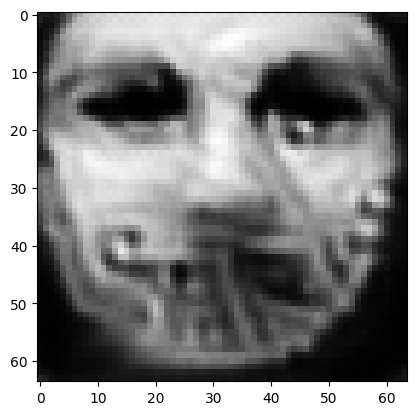

tensor([[3.4112e-03, 2.2938e-05, 4.0205e-04, 1.0315e-04, 1.8873e-04, 1.5077e-03,
         9.6754e-01, 3.7183e-03, 3.7599e-06, 1.3382e-04, 2.1137e-04, 1.7996e-05,
         7.9795e-05, 1.0231e-06, 1.0572e-04, 2.1016e-03, 1.7337e-03, 4.9367e-03,
         1.5401e-03, 3.6762e-03, 1.4422e-04, 1.5572e-05, 1.3912e-06, 1.1400e-03,
         3.5847e-05, 1.7808e-07, 1.0042e-03, 7.1292e-04, 3.0231e-03, 5.4269e-05,
         2.8444e-06, 1.5548e-04, 1.1012e-03, 1.7139e-04, 6.1713e-05, 1.6299e-04,
         3.5007e-05, 3.1722e-05, 4.2524e-04, 2.8810e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033002037554979324
tensor([[3.4103e-03, 2.2926e-05, 4.0194e-04, 1.0312e-04, 1.8865e-04, 1.5074e-03,
         9.6754e-01, 3.7178e-03, 3.7575e-06, 1.3379e-04, 2.1135e-04, 1.7990e-05,
         7.9753e-05, 1.0225e-06, 1.0568e-04, 2.1012e-03, 1.7336e-03, 4.9350e-03,
         1.5397e-03, 3.6753e-03, 1.4415e-04, 1.5565e-05, 1.3903e-06, 1.1399e-03,
         3.5830e-05, 1.7801e-07, 1.0037e-

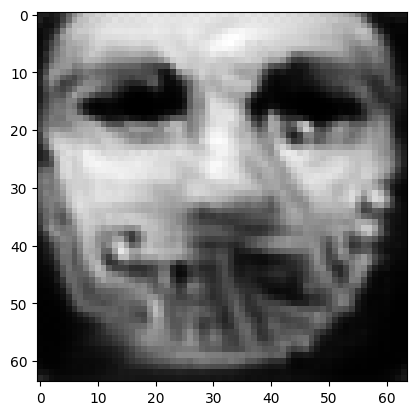

tensor([[3.4061e-03, 2.2898e-05, 4.0142e-04, 1.0303e-04, 1.8843e-04, 1.5058e-03,
         9.6758e-01, 3.7141e-03, 3.7532e-06, 1.3362e-04, 2.1120e-04, 1.7970e-05,
         7.9676e-05, 1.0210e-06, 1.0553e-04, 2.0992e-03, 1.7327e-03, 4.9295e-03,
         1.5383e-03, 3.6728e-03, 1.4402e-04, 1.5540e-05, 1.3889e-06, 1.1387e-03,
         3.5787e-05, 1.7775e-07, 1.0025e-03, 7.1199e-04, 3.0184e-03, 5.4189e-05,
         2.8393e-06, 1.5523e-04, 1.0995e-03, 1.7112e-04, 6.1624e-05, 1.6280e-04,
         3.4956e-05, 3.1682e-05, 4.2471e-04, 2.8781e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032959360629320145
tensor([[3.4050e-03, 2.2892e-05, 4.0127e-04, 1.0302e-04, 1.8839e-04, 1.5053e-03,
         9.6759e-01, 3.7129e-03, 3.7521e-06, 1.3357e-04, 2.1115e-04, 1.7966e-05,
         7.9662e-05, 1.0208e-06, 1.0551e-04, 2.0987e-03, 1.7326e-03, 4.9289e-03,
         1.5380e-03, 3.6720e-03, 1.4400e-04, 1.5534e-05, 1.3888e-06, 1.1385e-03,
         3.5782e-05, 1.7770e-07, 1.0023e-

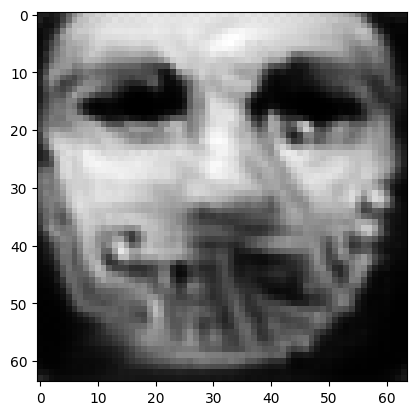

tensor([[3.4004e-03, 2.2872e-05, 4.0083e-04, 1.0296e-04, 1.8825e-04, 1.5041e-03,
         9.6762e-01, 3.7089e-03, 3.7501e-06, 1.3342e-04, 2.1100e-04, 1.7953e-05,
         7.9621e-05, 1.0197e-06, 1.0536e-04, 2.0968e-03, 1.7318e-03, 4.9240e-03,
         1.5367e-03, 3.6695e-03, 1.4391e-04, 1.5510e-05, 1.3884e-06, 1.1369e-03,
         3.5750e-05, 1.7751e-07, 1.0016e-03, 7.1120e-04, 3.0131e-03, 5.4126e-05,
         2.8358e-06, 1.5504e-04, 1.0983e-03, 1.7093e-04, 6.1570e-05, 1.6270e-04,
         3.4923e-05, 3.1651e-05, 4.2437e-04, 2.8778e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03291898965835571
tensor([[3.4001e-03, 2.2858e-05, 4.0064e-04, 1.0291e-04, 1.8814e-04, 1.5033e-03,
         9.6762e-01, 3.7084e-03, 3.7467e-06, 1.3338e-04, 2.1097e-04, 1.7943e-05,
         7.9567e-05, 1.0191e-06, 1.0534e-04, 2.0964e-03, 1.7316e-03, 4.9228e-03,
         1.5363e-03, 3.6688e-03, 1.4384e-04, 1.5505e-05, 1.3872e-06, 1.1371e-03,
         3.5731e-05, 1.7739e-07, 1.0009e-0

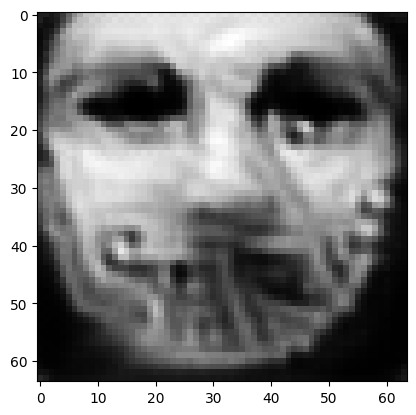

tensor([[3.3963e-03, 2.2832e-05, 4.0015e-04, 1.0284e-04, 1.8795e-04, 1.5018e-03,
         9.6765e-01, 3.7049e-03, 3.7421e-06, 1.3322e-04, 2.1083e-04, 1.7926e-05,
         7.9491e-05, 1.0178e-06, 1.0522e-04, 2.0947e-03, 1.7310e-03, 4.9186e-03,
         1.5350e-03, 3.6661e-03, 1.4372e-04, 1.5483e-05, 1.3861e-06, 1.1362e-03,
         3.5695e-05, 1.7716e-07, 9.9978e-04, 7.1029e-04, 3.0083e-03, 5.4050e-05,
         2.8310e-06, 1.5484e-04, 1.0968e-03, 1.7068e-04, 6.1471e-05, 1.6254e-04,
         3.4879e-05, 3.1615e-05, 4.2376e-04, 2.8731e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03288000077009201
tensor([[3.3949e-03, 2.2830e-05, 4.0013e-04, 1.0284e-04, 1.8795e-04, 1.5019e-03,
         9.6766e-01, 3.7040e-03, 3.7431e-06, 1.3320e-04, 2.1080e-04, 1.7926e-05,
         7.9499e-05, 1.0176e-06, 1.0516e-04, 2.0941e-03, 1.7308e-03, 4.9168e-03,
         1.5347e-03, 3.6656e-03, 1.4371e-04, 1.5476e-05, 1.3862e-06, 1.1355e-03,
         3.5690e-05, 1.7716e-07, 9.9982e-0

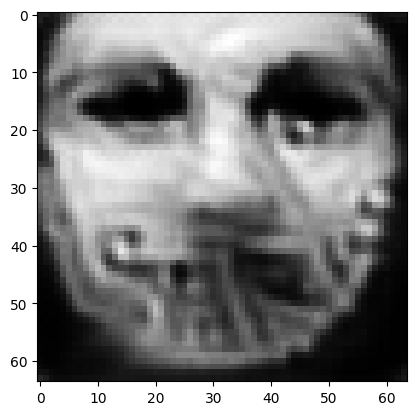

tensor([[3.3916e-03, 2.2802e-05, 3.9957e-04, 1.0275e-04, 1.8773e-04, 1.4999e-03,
         9.6769e-01, 3.7006e-03, 3.7375e-06, 1.3303e-04, 2.1066e-04, 1.7905e-05,
         7.9413e-05, 1.0164e-06, 1.0507e-04, 2.0925e-03, 1.7302e-03, 4.9132e-03,
         1.5335e-03, 3.6631e-03, 1.4359e-04, 1.5456e-05, 1.3849e-06, 1.1350e-03,
         3.5654e-05, 1.7690e-07, 9.9851e-04, 7.0952e-04, 3.0035e-03, 5.3987e-05,
         2.8273e-06, 1.5464e-04, 1.0955e-03, 1.7047e-04, 6.1404e-05, 1.6242e-04,
         3.4841e-05, 3.1582e-05, 4.2337e-04, 2.8711e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032842859625816345
tensor([[3.3909e-03, 2.2793e-05, 3.9948e-04, 1.0272e-04, 1.8767e-04, 1.4997e-03,
         9.6770e-01, 3.7002e-03, 3.7357e-06, 1.3300e-04, 2.1064e-04, 1.7900e-05,
         7.9381e-05, 1.0159e-06, 1.0503e-04, 2.0921e-03, 1.7300e-03, 4.9120e-03,
         1.5331e-03, 3.6625e-03, 1.4354e-04, 1.5450e-05, 1.3842e-06, 1.1348e-03,
         3.5641e-05, 1.7683e-07, 9.9812e-

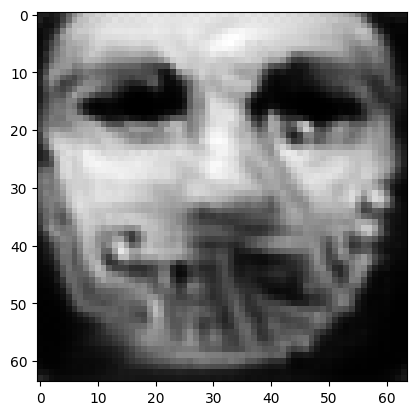

tensor([[3.3874e-03, 2.2772e-05, 3.9903e-04, 1.0266e-04, 1.8751e-04, 1.4982e-03,
         9.6772e-01, 3.6968e-03, 3.7327e-06, 1.3286e-04, 2.1050e-04, 1.7885e-05,
         7.9330e-05, 1.0149e-06, 1.0492e-04, 2.0905e-03, 1.7293e-03, 4.9079e-03,
         1.5321e-03, 3.6604e-03, 1.4346e-04, 1.5430e-05, 1.3834e-06, 1.1338e-03,
         3.5610e-05, 1.7663e-07, 9.9728e-04, 7.0876e-04, 2.9993e-03, 5.3924e-05,
         2.8235e-06, 1.5446e-04, 1.0942e-03, 1.7027e-04, 6.1335e-05, 1.6230e-04,
         3.4802e-05, 3.1551e-05, 4.2297e-04, 2.8691e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03280790522694588
tensor([[3.3866e-03, 2.2764e-05, 3.9894e-04, 1.0263e-04, 1.8746e-04, 1.4980e-03,
         9.6773e-01, 3.6963e-03, 3.7311e-06, 1.3283e-04, 2.1048e-04, 1.7881e-05,
         7.9302e-05, 1.0145e-06, 1.0489e-04, 2.0901e-03, 1.7292e-03, 4.9068e-03,
         1.5317e-03, 3.6596e-03, 1.4341e-04, 1.5425e-05, 1.3829e-06, 1.1337e-03,
         3.5600e-05, 1.7658e-07, 9.9692e-0

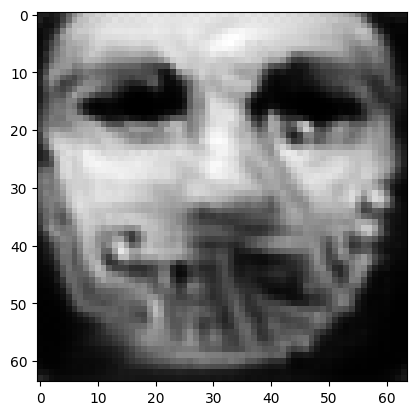

tensor([[3.3830e-03, 2.2742e-05, 3.9859e-04, 1.0257e-04, 1.8732e-04, 1.4971e-03,
         9.6776e-01, 3.6934e-03, 3.7278e-06, 1.3270e-04, 2.1037e-04, 1.7869e-05,
         7.9244e-05, 1.0134e-06, 1.0476e-04, 2.0886e-03, 1.7288e-03, 4.9027e-03,
         1.5306e-03, 3.6572e-03, 1.4331e-04, 1.5404e-05, 1.3820e-06, 1.1326e-03,
         3.5570e-05, 1.7641e-07, 9.9607e-04, 7.0809e-04, 2.9956e-03, 5.3861e-05,
         2.8198e-06, 1.5428e-04, 1.0930e-03, 1.7007e-04, 6.1274e-05, 1.6215e-04,
         3.4773e-05, 3.1525e-05, 4.2257e-04, 2.8674e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032774679362773895
tensor([[3.3823e-03, 2.2732e-05, 3.9852e-04, 1.0255e-04, 1.8726e-04, 1.4969e-03,
         9.6776e-01, 3.6931e-03, 3.7260e-06, 1.3268e-04, 2.1035e-04, 1.7864e-05,
         7.9211e-05, 1.0130e-06, 1.0473e-04, 2.0882e-03, 1.7287e-03, 4.9014e-03,
         1.5303e-03, 3.6566e-03, 1.4326e-04, 1.5399e-05, 1.3813e-06, 1.1325e-03,
         3.5557e-05, 1.7636e-07, 9.9567e-

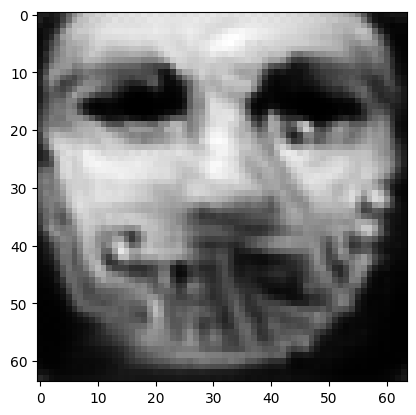

tensor([[3.3787e-03, 2.2719e-05, 3.9816e-04, 1.0252e-04, 1.8717e-04, 1.4959e-03,
         9.6779e-01, 3.6896e-03, 3.7250e-06, 1.3255e-04, 2.1021e-04, 1.7855e-05,
         7.9196e-05, 1.0123e-06, 1.0462e-04, 2.0866e-03, 1.7282e-03, 4.8984e-03,
         1.5293e-03, 3.6546e-03, 1.4322e-04, 1.5382e-05, 1.3815e-06, 1.1313e-03,
         3.5541e-05, 1.7623e-07, 9.9528e-04, 7.0747e-04, 2.9915e-03, 5.3808e-05,
         2.8170e-06, 1.5413e-04, 1.0921e-03, 1.6991e-04, 6.1228e-05, 1.6206e-04,
         3.4747e-05, 3.1503e-05, 4.2230e-04, 2.8669e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03274375945329666
tensor([[3.3784e-03, 2.2708e-05, 3.9801e-04, 1.0248e-04, 1.8709e-04, 1.4952e-03,
         9.6779e-01, 3.6893e-03, 3.7224e-06, 1.3251e-04, 2.1019e-04, 1.7847e-05,
         7.9153e-05, 1.0119e-06, 1.0461e-04, 2.0863e-03, 1.7280e-03, 4.8974e-03,
         1.5290e-03, 3.6541e-03, 1.4316e-04, 1.5378e-05, 1.3806e-06, 1.1315e-03,
         3.5527e-05, 1.7614e-07, 9.9471e-0

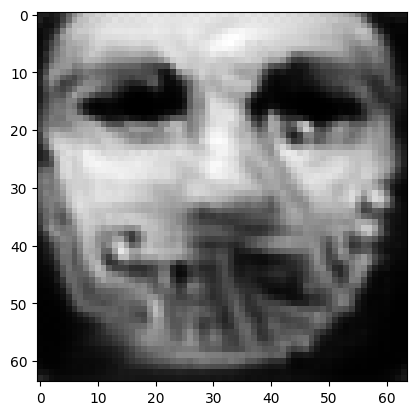

tensor([[3.3756e-03, 2.2685e-05, 3.9765e-04, 1.0241e-04, 1.8694e-04, 1.4941e-03,
         9.6782e-01, 3.6868e-03, 3.7186e-06, 1.3239e-04, 2.1009e-04, 1.7834e-05,
         7.9090e-05, 1.0109e-06, 1.0451e-04, 2.0849e-03, 1.7276e-03, 4.8940e-03,
         1.5279e-03, 3.6521e-03, 1.4306e-04, 1.5361e-05, 1.3796e-06, 1.1308e-03,
         3.5498e-05, 1.7596e-07, 9.9376e-04, 7.0676e-04, 2.9878e-03, 5.3746e-05,
         2.8132e-06, 1.5397e-04, 1.0909e-03, 1.6972e-04, 6.1145e-05, 1.6194e-04,
         3.4712e-05, 3.1475e-05, 4.2183e-04, 2.8630e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032713647931814194
tensor([[3.3746e-03, 2.2682e-05, 3.9764e-04, 1.0241e-04, 1.8693e-04, 1.4942e-03,
         9.6782e-01, 3.6863e-03, 3.7190e-06, 1.3237e-04, 2.1007e-04, 1.7834e-05,
         7.9091e-05, 1.0106e-06, 1.0446e-04, 2.0845e-03, 1.7274e-03, 4.8927e-03,
         1.5277e-03, 3.6517e-03, 1.4304e-04, 1.5356e-05, 1.3796e-06, 1.1303e-03,
         3.5493e-05, 1.7595e-07, 9.9378e-

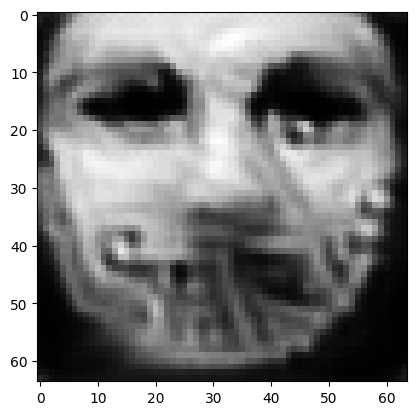

tensor([[3.3722e-03, 2.2658e-05, 3.9722e-04, 1.0233e-04, 1.8676e-04, 1.4927e-03,
         9.6784e-01, 3.6840e-03, 3.7144e-06, 1.3225e-04, 2.0997e-04, 1.7817e-05,
         7.9017e-05, 1.0096e-06, 1.0439e-04, 2.0832e-03, 1.7269e-03, 4.8897e-03,
         1.5267e-03, 3.6499e-03, 1.4294e-04, 1.5341e-05, 1.3784e-06, 1.1300e-03,
         3.5464e-05, 1.7575e-07, 9.9271e-04, 7.0614e-04, 2.9842e-03, 5.3691e-05,
         2.8101e-06, 1.5383e-04, 1.0899e-03, 1.6955e-04, 6.1085e-05, 1.6183e-04,
         3.4682e-05, 3.1450e-05, 4.2150e-04, 2.8610e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03268572688102722
tensor([[3.3711e-03, 2.2659e-05, 3.9718e-04, 1.0234e-04, 1.8677e-04, 1.4927e-03,
         9.6785e-01, 3.6830e-03, 3.7155e-06, 1.3223e-04, 2.0993e-04, 1.7818e-05,
         7.9033e-05, 1.0096e-06, 1.0435e-04, 2.0829e-03, 1.7268e-03, 4.8890e-03,
         1.5265e-03, 3.6495e-03, 1.4295e-04, 1.5337e-05, 1.3788e-06, 1.1294e-03,
         3.5464e-05, 1.7575e-07, 9.9287e-0

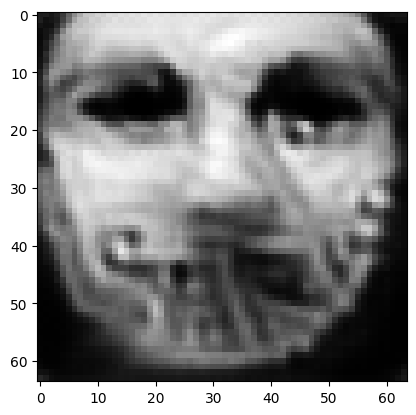

tensor([[3.3686e-03, 2.2638e-05, 3.9686e-04, 1.0227e-04, 1.8662e-04, 1.4918e-03,
         9.6787e-01, 3.6809e-03, 3.7118e-06, 1.3212e-04, 2.0984e-04, 1.7806e-05,
         7.8972e-05, 1.0086e-06, 1.0426e-04, 2.0816e-03, 1.7264e-03, 4.8859e-03,
         1.5256e-03, 3.6477e-03, 1.4285e-04, 1.5321e-05, 1.3778e-06, 1.1288e-03,
         3.5436e-05, 1.7558e-07, 9.9202e-04, 7.0560e-04, 2.9809e-03, 5.3645e-05,
         2.8076e-06, 1.5370e-04, 1.0891e-03, 1.6942e-04, 6.1044e-05, 1.6174e-04,
         3.4659e-05, 3.1430e-05, 4.2126e-04, 2.8606e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03265942260622978
tensor([[3.3684e-03, 2.2629e-05, 3.9674e-04, 1.0224e-04, 1.8655e-04, 1.4913e-03,
         9.6787e-01, 3.6807e-03, 3.7095e-06, 1.3210e-04, 2.0983e-04, 1.7800e-05,
         7.8935e-05, 1.0082e-06, 1.0425e-04, 2.0814e-03, 1.7262e-03, 4.8849e-03,
         1.5253e-03, 3.6473e-03, 1.4280e-04, 1.5318e-05, 1.3770e-06, 1.1290e-03,
         3.5423e-05, 1.7551e-07, 9.9155e-0

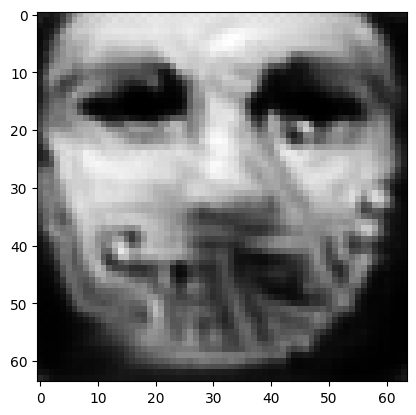

tensor([[3.3659e-03, 2.2610e-05, 3.9644e-04, 1.0218e-04, 1.8642e-04, 1.4904e-03,
         9.6789e-01, 3.6786e-03, 3.7063e-06, 1.3200e-04, 2.0975e-04, 1.7789e-05,
         7.8881e-05, 1.0073e-06, 1.0416e-04, 2.0802e-03, 1.7258e-03, 4.8819e-03,
         1.5244e-03, 3.6456e-03, 1.4271e-04, 1.5303e-05, 1.3761e-06, 1.1283e-03,
         3.5398e-05, 1.7536e-07, 9.9079e-04, 7.0501e-04, 2.9779e-03, 5.3590e-05,
         2.8042e-06, 1.5357e-04, 1.0881e-03, 1.6924e-04, 6.0976e-05, 1.6162e-04,
         3.4630e-05, 3.1407e-05, 4.2085e-04, 2.8574e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03263403847813606
tensor([[3.3649e-03, 2.2610e-05, 3.9640e-04, 1.0219e-04, 1.8643e-04, 1.4904e-03,
         9.6790e-01, 3.6778e-03, 3.7072e-06, 1.3198e-04, 2.0971e-04, 1.7789e-05,
         7.8894e-05, 1.0073e-06, 1.0413e-04, 2.0799e-03, 1.7257e-03, 4.8813e-03,
         1.5242e-03, 3.6453e-03, 1.4272e-04, 1.5299e-05, 1.3765e-06, 1.1278e-03,
         3.5398e-05, 1.7536e-07, 9.9093e-0

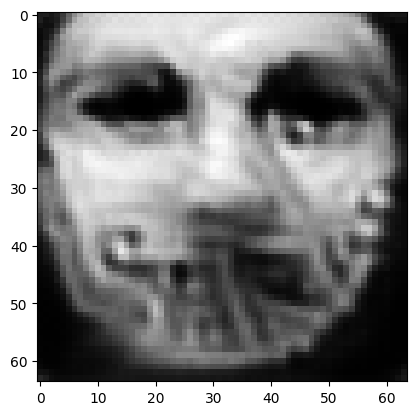

tensor([[3.3627e-03, 2.2593e-05, 3.9609e-04, 1.0213e-04, 1.8628e-04, 1.4894e-03,
         9.6792e-01, 3.6758e-03, 3.7044e-06, 1.3188e-04, 2.0963e-04, 1.7777e-05,
         7.8845e-05, 1.0064e-06, 1.0405e-04, 2.0788e-03, 1.7251e-03, 4.8781e-03,
         1.5234e-03, 3.6441e-03, 1.4263e-04, 1.5286e-05, 1.3755e-06, 1.1272e-03,
         3.5370e-05, 1.7519e-07, 9.9021e-04, 7.0449e-04, 2.9748e-03, 5.3550e-05,
         2.8020e-06, 1.5344e-04, 1.0874e-03, 1.6912e-04, 6.0938e-05, 1.6154e-04,
         3.4603e-05, 3.1386e-05, 4.2067e-04, 2.8571e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03261015564203262
tensor([[3.3624e-03, 2.2588e-05, 3.9595e-04, 1.0210e-04, 1.8623e-04, 1.4889e-03,
         9.6792e-01, 3.6752e-03, 3.7028e-06, 1.3185e-04, 2.0961e-04, 1.7772e-05,
         7.8823e-05, 1.0062e-06, 1.0405e-04, 2.0786e-03, 1.7250e-03, 4.8779e-03,
         1.5232e-03, 3.6438e-03, 1.4261e-04, 1.5284e-05, 1.3751e-06, 1.1273e-03,
         3.5362e-05, 1.7513e-07, 9.8991e-0

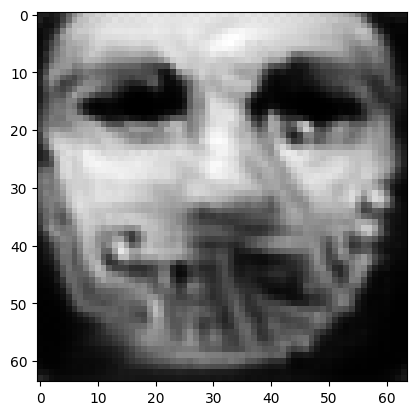

tensor([[3.3602e-03, 2.2570e-05, 3.9569e-04, 1.0205e-04, 1.8612e-04, 1.4881e-03,
         9.6794e-01, 3.6734e-03, 3.6999e-06, 1.3177e-04, 2.0953e-04, 1.7762e-05,
         7.8774e-05, 1.0053e-06, 1.0397e-04, 2.0776e-03, 1.7246e-03, 4.8750e-03,
         1.5224e-03, 3.6422e-03, 1.4253e-04, 1.5270e-05, 1.3743e-06, 1.1267e-03,
         3.5339e-05, 1.7500e-07, 9.8921e-04, 7.0397e-04, 2.9720e-03, 5.3504e-05,
         2.7992e-06, 1.5333e-04, 1.0866e-03, 1.6898e-04, 6.0882e-05, 1.6146e-04,
         3.4580e-05, 3.1366e-05, 4.2031e-04, 2.8545e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03258753940463066
tensor([[3.3597e-03, 2.2564e-05, 3.9564e-04, 1.0204e-04, 1.8608e-04, 1.4880e-03,
         9.6794e-01, 3.6731e-03, 3.6987e-06, 1.3175e-04, 2.0952e-04, 1.7760e-05,
         7.8754e-05, 1.0050e-06, 1.0394e-04, 2.0773e-03, 1.7246e-03, 4.8741e-03,
         1.5222e-03, 3.6418e-03, 1.4249e-04, 1.5267e-05, 1.3738e-06, 1.1266e-03,
         3.5331e-05, 1.7496e-07, 9.8896e-0

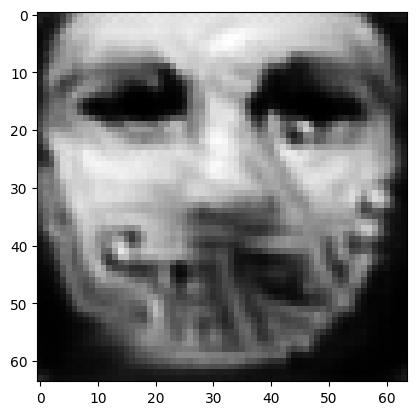

tensor([[3.3575e-03, 2.2551e-05, 3.9539e-04, 1.0200e-04, 1.8598e-04, 1.4872e-03,
         9.6796e-01, 3.6712e-03, 3.6969e-06, 1.3167e-04, 2.0944e-04, 1.7751e-05,
         7.8720e-05, 1.0043e-06, 1.0386e-04, 2.0763e-03, 1.7242e-03, 4.8714e-03,
         1.5215e-03, 3.6405e-03, 1.4243e-04, 1.5255e-05, 1.3733e-06, 1.1260e-03,
         3.5311e-05, 1.7485e-07, 9.8845e-04, 7.0350e-04, 2.9695e-03, 5.3463e-05,
         2.7969e-06, 1.5321e-04, 1.0858e-03, 1.6885e-04, 6.0840e-05, 1.6136e-04,
         3.4556e-05, 3.1348e-05, 4.2007e-04, 2.8533e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03256596252322197
tensor([[3.3569e-03, 2.2547e-05, 3.9532e-04, 1.0199e-04, 1.8595e-04, 1.4871e-03,
         9.6796e-01, 3.6707e-03, 3.6963e-06, 1.3164e-04, 2.0942e-04, 1.7749e-05,
         7.8711e-05, 1.0042e-06, 1.0385e-04, 2.0761e-03, 1.7241e-03, 4.8709e-03,
         1.5213e-03, 3.6401e-03, 1.4242e-04, 1.5252e-05, 1.3732e-06, 1.1258e-03,
         3.5307e-05, 1.7482e-07, 9.8833e-0

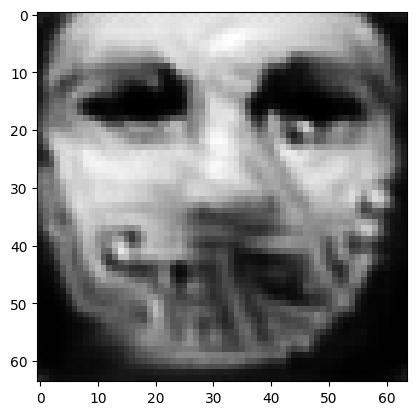

tensor([[3.3549e-03, 2.2531e-05, 3.9509e-04, 1.0194e-04, 1.8585e-04, 1.4864e-03,
         9.6798e-01, 3.6690e-03, 3.6937e-06, 1.3157e-04, 2.0935e-04, 1.7740e-05,
         7.8666e-05, 1.0034e-06, 1.0377e-04, 2.0751e-03, 1.7237e-03, 4.8683e-03,
         1.5205e-03, 3.6388e-03, 1.4234e-04, 1.5240e-05, 1.3724e-06, 1.1253e-03,
         3.5285e-05, 1.7470e-07, 9.8771e-04, 7.0306e-04, 2.9671e-03, 5.3422e-05,
         2.7945e-06, 1.5312e-04, 1.0851e-03, 1.6873e-04, 6.0797e-05, 1.6128e-04,
         3.4537e-05, 3.1332e-05, 4.1981e-04, 2.8519e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0325455367565155
tensor([[3.3546e-03, 2.2526e-05, 3.9499e-04, 1.0192e-04, 1.8581e-04, 1.4860e-03,
         9.6798e-01, 3.6685e-03, 3.6926e-06, 1.3154e-04, 2.0933e-04, 1.7736e-05,
         7.8652e-05, 1.0033e-06, 1.0376e-04, 2.0749e-03, 1.7236e-03, 4.8681e-03,
         1.5204e-03, 3.6385e-03, 1.4232e-04, 1.5238e-05, 1.3722e-06, 1.1253e-03,
         3.5280e-05, 1.7465e-07, 9.8749e-04

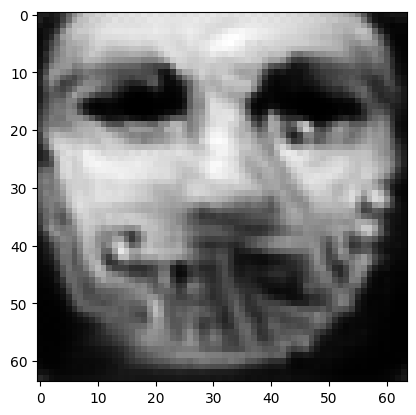

tensor([[3.3526e-03, 2.2511e-05, 3.9478e-04, 1.0188e-04, 1.8571e-04, 1.4854e-03,
         9.6800e-01, 3.6671e-03, 3.6906e-06, 1.3147e-04, 2.0927e-04, 1.7728e-05,
         7.8614e-05, 1.0025e-06, 1.0369e-04, 2.0739e-03, 1.7232e-03, 4.8652e-03,
         1.5197e-03, 3.6374e-03, 1.4225e-04, 1.5226e-05, 1.3714e-06, 1.1248e-03,
         3.5259e-05, 1.7454e-07, 9.8693e-04, 7.0261e-04, 2.9646e-03, 5.3384e-05,
         2.7924e-06, 1.5301e-04, 1.0844e-03, 1.6861e-04, 6.0753e-05, 1.6120e-04,
         3.4513e-05, 3.1314e-05, 4.1959e-04, 2.8504e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032526034861803055
tensor([[3.3521e-03, 2.2508e-05, 3.9473e-04, 1.0187e-04, 1.8569e-04, 1.4852e-03,
         9.6800e-01, 3.6666e-03, 3.6901e-06, 1.3145e-04, 2.0925e-04, 1.7726e-05,
         7.8606e-05, 1.0024e-06, 1.0367e-04, 2.0737e-03, 1.7231e-03, 4.8648e-03,
         1.5195e-03, 3.6370e-03, 1.4224e-04, 1.5223e-05, 1.3713e-06, 1.1246e-03,
         3.5256e-05, 1.7451e-07, 9.8682e-

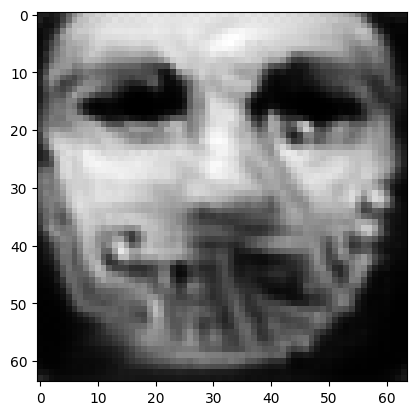

tensor([[3.3503e-03, 2.2492e-05, 3.9452e-04, 1.0182e-04, 1.8559e-04, 1.4846e-03,
         9.6802e-01, 3.6652e-03, 3.6876e-06, 1.3138e-04, 2.0919e-04, 1.7718e-05,
         7.8563e-05, 1.0016e-06, 1.0360e-04, 2.0729e-03, 1.7228e-03, 4.8624e-03,
         1.5188e-03, 3.6359e-03, 1.4216e-04, 1.5213e-05, 1.3705e-06, 1.1241e-03,
         3.5234e-05, 1.7440e-07, 9.8625e-04, 7.0219e-04, 2.9624e-03, 5.3345e-05,
         2.7901e-06, 1.5292e-04, 1.0838e-03, 1.6849e-04, 6.0711e-05, 1.6112e-04,
         3.4495e-05, 3.1299e-05, 4.1935e-04, 2.8490e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032507456839084625
tensor([[3.3496e-03, 2.2493e-05, 3.9449e-04, 1.0183e-04, 1.8559e-04, 1.4846e-03,
         9.6802e-01, 3.6646e-03, 3.6884e-06, 1.3137e-04, 2.0916e-04, 1.7718e-05,
         7.8574e-05, 1.0016e-06, 1.0357e-04, 2.0726e-03, 1.7227e-03, 4.8619e-03,
         1.5187e-03, 3.6357e-03, 1.4217e-04, 1.5210e-05, 1.3708e-06, 1.1237e-03,
         3.5234e-05, 1.7440e-07, 9.8638e-

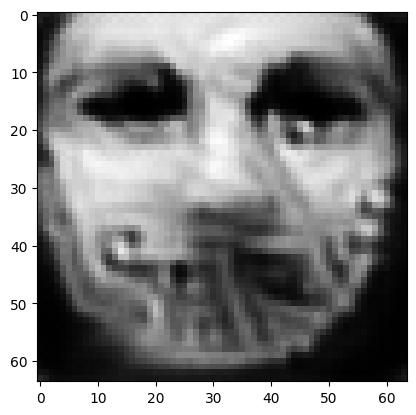

tensor([[3.3480e-03, 2.2478e-05, 3.9425e-04, 1.0178e-04, 1.8549e-04, 1.4838e-03,
         9.6803e-01, 3.6632e-03, 3.6857e-06, 1.3130e-04, 2.0910e-04, 1.7709e-05,
         7.8530e-05, 1.0009e-06, 1.0352e-04, 2.0718e-03, 1.7224e-03, 4.8598e-03,
         1.5180e-03, 3.6346e-03, 1.4210e-04, 1.5200e-05, 1.3700e-06, 1.1235e-03,
         3.5215e-05, 1.7428e-07, 9.8573e-04, 7.0182e-04, 2.9602e-03, 5.3313e-05,
         2.7884e-06, 1.5283e-04, 1.0832e-03, 1.6840e-04, 6.0680e-05, 1.6106e-04,
         3.4477e-05, 3.1285e-05, 4.1919e-04, 2.8484e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03249003365635872
tensor([[3.3479e-03, 2.2471e-05, 3.9418e-04, 1.0175e-04, 1.8544e-04, 1.4835e-03,
         9.6804e-01, 3.6630e-03, 3.6842e-06, 1.3128e-04, 2.0909e-04, 1.7705e-05,
         7.8506e-05, 1.0006e-06, 1.0351e-04, 2.0716e-03, 1.7223e-03, 4.8592e-03,
         1.5179e-03, 3.6344e-03, 1.4207e-04, 1.5198e-05, 1.3695e-06, 1.1236e-03,
         3.5207e-05, 1.7423e-07, 9.8543e-0

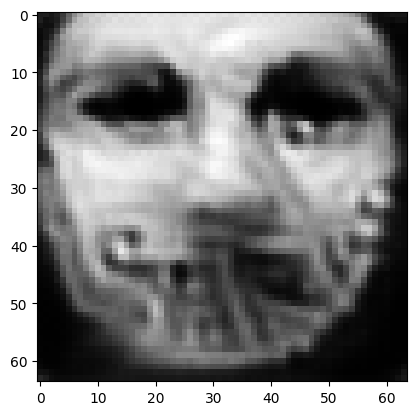

tensor([[3.3462e-03, 2.2459e-05, 3.9399e-04, 1.0172e-04, 1.8536e-04, 1.4829e-03,
         9.6805e-01, 3.6616e-03, 3.6826e-06, 1.3122e-04, 2.0903e-04, 1.7698e-05,
         7.8478e-05, 1.0000e-06, 1.0344e-04, 2.0708e-03, 1.7219e-03, 4.8570e-03,
         1.5173e-03, 3.6334e-03, 1.4201e-04, 1.5189e-05, 1.3690e-06, 1.1231e-03,
         3.5190e-05, 1.7413e-07, 9.8501e-04, 7.0141e-04, 2.9581e-03, 5.3278e-05,
         2.7864e-06, 1.5274e-04, 1.0826e-03, 1.6829e-04, 6.0637e-05, 1.6098e-04,
         3.4456e-05, 3.1270e-05, 4.1897e-04, 2.8467e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032473184168338776
tensor([[3.3458e-03, 2.2457e-05, 3.9393e-04, 1.0171e-04, 1.8534e-04, 1.4828e-03,
         9.6805e-01, 3.6612e-03, 3.6821e-06, 1.3120e-04, 2.0901e-04, 1.7696e-05,
         7.8470e-05, 9.9993e-07, 1.0343e-04, 2.0706e-03, 1.7218e-03, 4.8566e-03,
         1.5171e-03, 3.6331e-03, 1.4200e-04, 1.5186e-05, 1.3689e-06, 1.1230e-03,
         3.5187e-05, 1.7411e-07, 9.8489e-

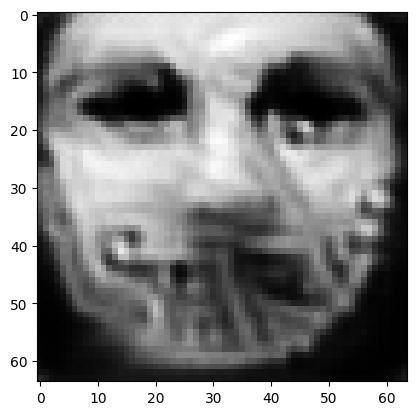

tensor([[3.3440e-03, 2.2446e-05, 3.9378e-04, 1.0168e-04, 1.8527e-04, 1.4824e-03,
         9.6806e-01, 3.6598e-03, 3.6811e-06, 1.3114e-04, 2.0895e-04, 1.7691e-05,
         7.8449e-05, 9.9937e-07, 1.0336e-04, 2.0698e-03, 1.7215e-03, 4.8545e-03,
         1.5165e-03, 3.6322e-03, 1.4195e-04, 1.5177e-05, 1.3685e-06, 1.1223e-03,
         3.5172e-05, 1.7403e-07, 9.8459e-04, 7.0109e-04, 2.9562e-03, 5.3248e-05,
         2.7848e-06, 1.5266e-04, 1.0821e-03, 1.6821e-04, 6.0611e-05, 1.6092e-04,
         3.4441e-05, 3.1258e-05, 4.1883e-04, 2.8465e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032457027584314346
tensor([[3.3438e-03, 2.2440e-05, 3.9371e-04, 1.0166e-04, 1.8523e-04, 1.4821e-03,
         9.6807e-01, 3.6597e-03, 3.6797e-06, 1.3113e-04, 2.0895e-04, 1.7687e-05,
         7.8427e-05, 9.9913e-07, 1.0335e-04, 2.0696e-03, 1.7214e-03, 4.8539e-03,
         1.5164e-03, 3.6320e-03, 1.4192e-04, 1.5175e-05, 1.3680e-06, 1.1224e-03,
         3.5164e-05, 1.7399e-07, 9.8429e-

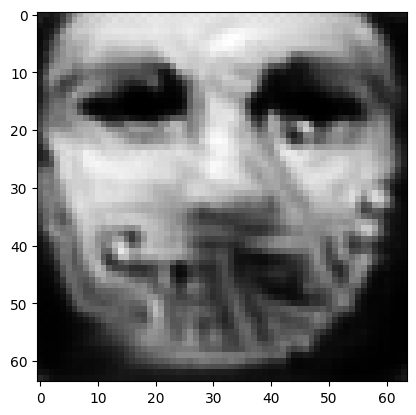

tensor([[3.3423e-03, 2.2429e-05, 3.9352e-04, 1.0162e-04, 1.8515e-04, 1.4815e-03,
         9.6808e-01, 3.6583e-03, 3.6779e-06, 1.3106e-04, 2.0889e-04, 1.7680e-05,
         7.8397e-05, 9.9861e-07, 1.0330e-04, 2.0689e-03, 1.7211e-03, 4.8522e-03,
         1.5158e-03, 3.6310e-03, 1.4187e-04, 1.5166e-05, 1.3676e-06, 1.1220e-03,
         3.5149e-05, 1.7389e-07, 9.8387e-04, 7.0072e-04, 2.9543e-03, 5.3216e-05,
         2.7828e-06, 1.5258e-04, 1.0816e-03, 1.6811e-04, 6.0570e-05, 1.6085e-04,
         3.4424e-05, 3.1244e-05, 4.1860e-04, 2.8446e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03244144842028618
tensor([[3.3419e-03, 2.2426e-05, 3.9348e-04, 1.0162e-04, 1.8513e-04, 1.4814e-03,
         9.6808e-01, 3.6579e-03, 3.6774e-06, 1.3105e-04, 2.0888e-04, 1.7679e-05,
         7.8389e-05, 9.9849e-07, 1.0329e-04, 2.0688e-03, 1.7211e-03, 4.8518e-03,
         1.5157e-03, 3.6307e-03, 1.4186e-04, 1.5164e-05, 1.3675e-06, 1.1219e-03,
         3.5146e-05, 1.7387e-07, 9.8377e-0

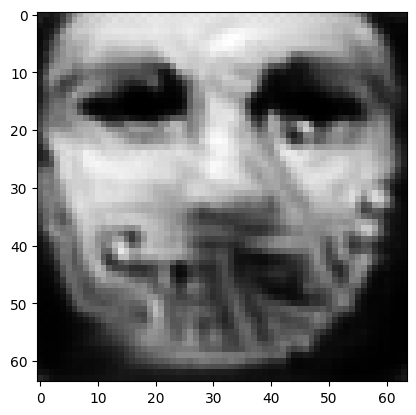

tensor([[3.3403e-03, 2.2416e-05, 3.9334e-04, 1.0159e-04, 1.8508e-04, 1.4810e-03,
         9.6809e-01, 3.6567e-03, 3.6765e-06, 1.3100e-04, 2.0882e-04, 1.7674e-05,
         7.8371e-05, 9.9798e-07, 1.0322e-04, 2.0680e-03, 1.7208e-03, 4.8498e-03,
         1.5152e-03, 3.6299e-03, 1.4182e-04, 1.5155e-05, 1.3671e-06, 1.1214e-03,
         3.5133e-05, 1.7381e-07, 9.8349e-04, 7.0042e-04, 2.9526e-03, 5.3189e-05,
         2.7814e-06, 1.5251e-04, 1.0811e-03, 1.6803e-04, 6.0546e-05, 1.6080e-04,
         3.4411e-05, 3.1234e-05, 4.1848e-04, 2.8444e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03242736682295799
tensor([[3.3402e-03, 2.2411e-05, 3.9328e-04, 1.0157e-04, 1.8503e-04, 1.4808e-03,
         9.6810e-01, 3.6566e-03, 3.6752e-06, 1.3099e-04, 2.0881e-04, 1.7670e-05,
         7.8349e-05, 9.9774e-07, 1.0322e-04, 2.0679e-03, 1.7207e-03, 4.8493e-03,
         1.5150e-03, 3.6297e-03, 1.4179e-04, 1.5154e-05, 1.3667e-06, 1.1215e-03,
         3.5125e-05, 1.7376e-07, 9.8322e-0

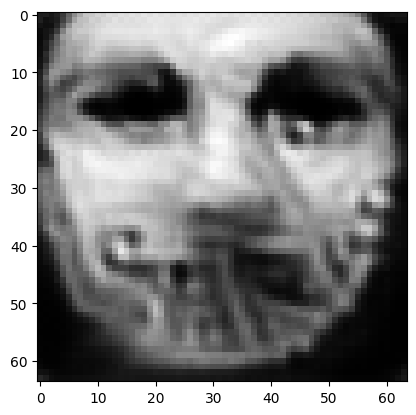

tensor([[3.3388e-03, 2.2399e-05, 3.9312e-04, 1.0153e-04, 1.8496e-04, 1.4803e-03,
         9.6811e-01, 3.6555e-03, 3.6734e-06, 1.3093e-04, 2.0877e-04, 1.7664e-05,
         7.8318e-05, 9.9721e-07, 1.0316e-04, 2.0672e-03, 1.7205e-03, 4.8475e-03,
         1.5145e-03, 3.6288e-03, 1.4173e-04, 1.5146e-05, 1.3661e-06, 1.1211e-03,
         3.5111e-05, 1.7368e-07, 9.8278e-04, 7.0008e-04, 2.9511e-03, 5.3158e-05,
         2.7795e-06, 1.5243e-04, 1.0806e-03, 1.6793e-04, 6.0507e-05, 1.6072e-04,
         3.4393e-05, 3.1221e-05, 4.1827e-04, 2.8426e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03241317346692085
tensor([[3.3383e-03, 2.2400e-05, 3.9310e-04, 1.0154e-04, 1.8497e-04, 1.4803e-03,
         9.6811e-01, 3.6550e-03, 3.6739e-06, 1.3092e-04, 2.0875e-04, 1.7664e-05,
         7.8326e-05, 9.9720e-07, 1.0315e-04, 2.0671e-03, 1.7204e-03, 4.8471e-03,
         1.5144e-03, 3.6286e-03, 1.4174e-04, 1.5144e-05, 1.3663e-06, 1.1209e-03,
         3.5111e-05, 1.7368e-07, 9.8286e-0

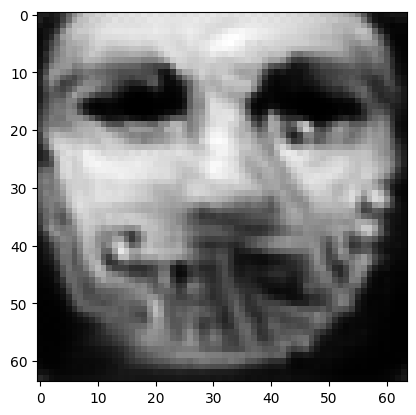

tensor([[3.3370e-03, 2.2389e-05, 3.9295e-04, 1.0151e-04, 1.8489e-04, 1.4799e-03,
         9.6812e-01, 3.6540e-03, 3.6722e-06, 1.3087e-04, 2.0871e-04, 1.7658e-05,
         7.8295e-05, 9.9666e-07, 1.0310e-04, 2.0664e-03, 1.7201e-03, 4.8454e-03,
         1.5139e-03, 3.6278e-03, 1.4169e-04, 1.5136e-05, 1.3657e-06, 1.1205e-03,
         3.5096e-05, 1.7360e-07, 9.8245e-04, 6.9981e-04, 2.9495e-03, 5.3134e-05,
         2.7782e-06, 1.5237e-04, 1.0802e-03, 1.6787e-04, 6.0486e-05, 1.6067e-04,
         3.4382e-05, 3.1211e-05, 4.1816e-04, 2.8424e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03240013122558594
tensor([[3.3369e-03, 2.2384e-05, 3.9290e-04, 1.0149e-04, 1.8486e-04, 1.4796e-03,
         9.6812e-01, 3.6539e-03, 3.6710e-06, 1.3086e-04, 2.0870e-04, 1.7655e-05,
         7.8277e-05, 9.9646e-07, 1.0309e-04, 2.0663e-03, 1.7201e-03, 4.8449e-03,
         1.5138e-03, 3.6276e-03, 1.4166e-04, 1.5135e-05, 1.3653e-06, 1.1206e-03,
         3.5090e-05, 1.7356e-07, 9.8220e-0

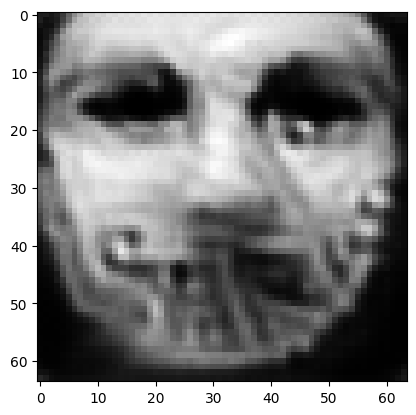

tensor([[3.3357e-03, 2.2375e-05, 3.9274e-04, 1.0146e-04, 1.8480e-04, 1.4792e-03,
         9.6813e-01, 3.6527e-03, 3.6696e-06, 1.3081e-04, 2.0865e-04, 1.7650e-05,
         7.8254e-05, 9.9604e-07, 1.0305e-04, 2.0657e-03, 1.7198e-03, 4.8435e-03,
         1.5134e-03, 3.6269e-03, 1.4162e-04, 1.5128e-05, 1.3650e-06, 1.1203e-03,
         3.5078e-05, 1.7349e-07, 9.8188e-04, 6.9950e-04, 2.9479e-03, 5.3108e-05,
         2.7767e-06, 1.5231e-04, 1.0797e-03, 1.6778e-04, 6.0452e-05, 1.6062e-04,
         3.4367e-05, 3.1200e-05, 4.1798e-04, 2.8409e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03238755464553833
tensor([[3.3353e-03, 2.2373e-05, 3.9271e-04, 1.0145e-04, 1.8478e-04, 1.4791e-03,
         9.6813e-01, 3.6525e-03, 3.6696e-06, 1.3080e-04, 2.0864e-04, 1.7648e-05,
         7.8252e-05, 9.9595e-07, 1.0303e-04, 2.0656e-03, 1.7197e-03, 4.8430e-03,
         1.5133e-03, 3.6268e-03, 1.4162e-04, 1.5126e-05, 1.3649e-06, 1.1202e-03,
         3.5075e-05, 1.7347e-07, 9.8183e-0

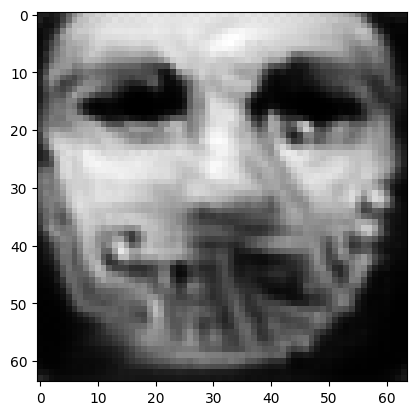

tensor([[3.3342e-03, 2.2363e-05, 3.9258e-04, 1.0142e-04, 1.8472e-04, 1.4786e-03,
         9.6814e-01, 3.6516e-03, 3.6679e-06, 1.3076e-04, 2.0860e-04, 1.7643e-05,
         7.8223e-05, 9.9548e-07, 1.0299e-04, 2.0650e-03, 1.7195e-03, 4.8415e-03,
         1.5128e-03, 3.6260e-03, 1.4157e-04, 1.5120e-05, 1.3644e-06, 1.1199e-03,
         3.5062e-05, 1.7340e-07, 9.8143e-04, 6.9924e-04, 2.9466e-03, 5.3085e-05,
         2.7754e-06, 1.5224e-04, 1.0793e-03, 1.6771e-04, 6.0427e-05, 1.6057e-04,
         3.4354e-05, 3.1190e-05, 4.1785e-04, 2.8402e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03237566724419594
tensor([[3.3339e-03, 2.2361e-05, 3.9254e-04, 1.0142e-04, 1.8470e-04, 1.4785e-03,
         9.6815e-01, 3.6513e-03, 3.6675e-06, 1.3074e-04, 2.0859e-04, 1.7641e-05,
         7.8217e-05, 9.9538e-07, 1.0298e-04, 2.0649e-03, 1.7194e-03, 4.8412e-03,
         1.5127e-03, 3.6258e-03, 1.4156e-04, 1.5118e-05, 1.3643e-06, 1.1198e-03,
         3.5059e-05, 1.7338e-07, 9.8136e-0

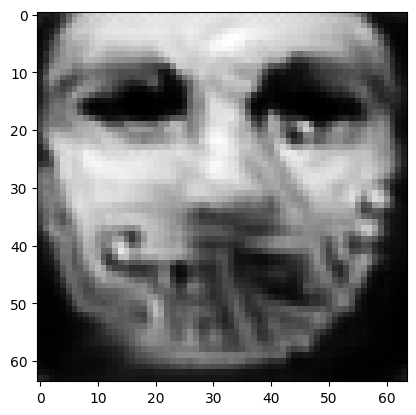

tensor([[3.3329e-03, 2.2351e-05, 3.9241e-04, 1.0139e-04, 1.8464e-04, 1.4781e-03,
         9.6815e-01, 3.6505e-03, 3.6662e-06, 1.3070e-04, 2.0855e-04, 1.7636e-05,
         7.8193e-05, 9.9494e-07, 1.0294e-04, 2.0643e-03, 1.7192e-03, 4.8396e-03,
         1.5123e-03, 3.6252e-03, 1.4151e-04, 1.5112e-05, 1.3638e-06, 1.1196e-03,
         3.5047e-05, 1.7331e-07, 9.8102e-04, 6.9899e-04, 2.9452e-03, 5.3063e-05,
         2.7741e-06, 1.5218e-04, 1.0789e-03, 1.6765e-04, 6.0402e-05, 1.6052e-04,
         3.4341e-05, 3.1180e-05, 4.1773e-04, 2.8394e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03236446902155876
tensor([[3.3326e-03, 2.2349e-05, 3.9238e-04, 1.0138e-04, 1.8463e-04, 1.4780e-03,
         9.6816e-01, 3.6502e-03, 3.6659e-06, 1.3069e-04, 2.0854e-04, 1.7635e-05,
         7.8188e-05, 9.9486e-07, 1.0293e-04, 2.0642e-03, 1.7191e-03, 4.8394e-03,
         1.5122e-03, 3.6250e-03, 1.4151e-04, 1.5110e-05, 1.3638e-06, 1.1195e-03,
         3.5045e-05, 1.7330e-07, 9.8094e-0

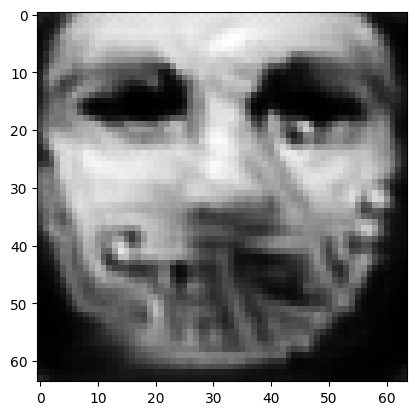

tensor([[3.3316e-03, 2.2341e-05, 3.9225e-04, 1.0136e-04, 1.8457e-04, 1.4776e-03,
         9.6816e-01, 3.6494e-03, 3.6645e-06, 1.3065e-04, 2.0851e-04, 1.7630e-05,
         7.8165e-05, 9.9446e-07, 1.0289e-04, 2.0637e-03, 1.7189e-03, 4.8381e-03,
         1.5118e-03, 3.6244e-03, 1.4147e-04, 1.5104e-05, 1.3633e-06, 1.1192e-03,
         3.5033e-05, 1.7323e-07, 9.8062e-04, 6.9875e-04, 2.9439e-03, 5.3042e-05,
         2.7729e-06, 1.5213e-04, 1.0786e-03, 1.6758e-04, 6.0378e-05, 1.6048e-04,
         3.4330e-05, 3.1172e-05, 4.1760e-04, 2.8386e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032353851944208145
tensor([[3.3312e-03, 2.2341e-05, 3.9224e-04, 1.0136e-04, 1.8458e-04, 1.4776e-03,
         9.6817e-01, 3.6490e-03, 3.6650e-06, 1.3064e-04, 2.0849e-04, 1.7630e-05,
         7.8172e-05, 9.9445e-07, 1.0288e-04, 2.0636e-03, 1.7189e-03, 4.8378e-03,
         1.5118e-03, 3.6243e-03, 1.4147e-04, 1.5103e-05, 1.3635e-06, 1.1190e-03,
         3.5034e-05, 1.7323e-07, 9.8069e-

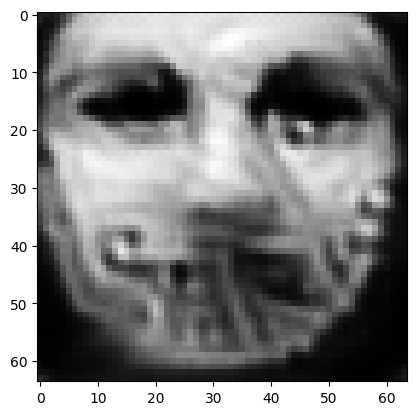

tensor([[3.3303e-03, 2.2330e-05, 3.9210e-04, 1.0133e-04, 1.8450e-04, 1.4771e-03,
         9.6817e-01, 3.6482e-03, 3.6631e-06, 1.3060e-04, 2.0846e-04, 1.7624e-05,
         7.8139e-05, 9.9401e-07, 1.0285e-04, 2.0631e-03, 1.7187e-03, 4.8365e-03,
         1.5114e-03, 3.6236e-03, 1.4142e-04, 1.5097e-05, 1.3629e-06, 1.1189e-03,
         3.5020e-05, 1.7316e-07, 9.8026e-04, 6.9852e-04, 2.9426e-03, 5.3022e-05,
         2.7718e-06, 1.5208e-04, 1.0782e-03, 1.6753e-04, 6.0355e-05, 1.6044e-04,
         3.4320e-05, 3.1164e-05, 4.1749e-04, 2.8379e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03234346583485603
tensor([[3.3299e-03, 2.2331e-05, 3.9208e-04, 1.0133e-04, 1.8451e-04, 1.4771e-03,
         9.6818e-01, 3.6478e-03, 3.6635e-06, 1.3059e-04, 2.0845e-04, 1.7624e-05,
         7.8146e-05, 9.9401e-07, 1.0283e-04, 2.0629e-03, 1.7186e-03, 4.8362e-03,
         1.5113e-03, 3.6235e-03, 1.4143e-04, 1.5096e-05, 1.3631e-06, 1.1187e-03,
         3.5021e-05, 1.7316e-07, 9.8032e-0

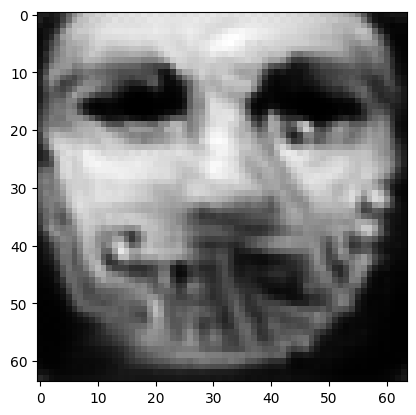

tensor([[3.3290e-03, 2.2323e-05, 3.9197e-04, 1.0131e-04, 1.8446e-04, 1.4767e-03,
         9.6818e-01, 3.6470e-03, 3.6624e-06, 1.3056e-04, 2.0841e-04, 1.7620e-05,
         7.8127e-05, 9.9365e-07, 1.0280e-04, 2.0625e-03, 1.7184e-03, 4.8350e-03,
         1.5110e-03, 3.6230e-03, 1.4139e-04, 1.5090e-05, 1.3627e-06, 1.1184e-03,
         3.5011e-05, 1.7310e-07, 9.8005e-04, 6.9831e-04, 2.9414e-03, 5.3006e-05,
         2.7710e-06, 1.5203e-04, 1.0780e-03, 1.6748e-04, 6.0341e-05, 1.6041e-04,
         3.4311e-05, 3.1158e-05, 4.1743e-04, 2.8379e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032334115356206894
tensor([[3.3289e-03, 2.2320e-05, 3.9193e-04, 1.0129e-04, 1.8443e-04, 1.4765e-03,
         9.6819e-01, 3.6469e-03, 3.6616e-06, 1.3055e-04, 2.0841e-04, 1.7617e-05,
         7.8113e-05, 9.9350e-07, 1.0279e-04, 2.0624e-03, 1.7183e-03, 4.8347e-03,
         1.5109e-03, 3.6228e-03, 1.4138e-04, 1.5089e-05, 1.3624e-06, 1.1185e-03,
         3.5006e-05, 1.7307e-07, 9.7987e-

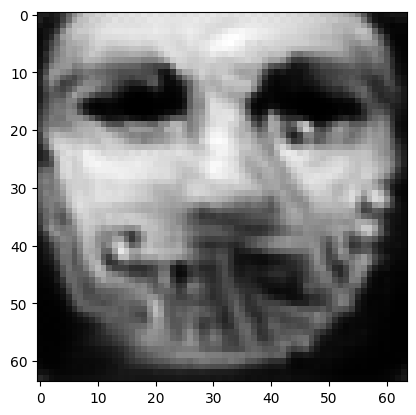

tensor([[3.3280e-03, 2.2312e-05, 3.9182e-04, 1.0127e-04, 1.8438e-04, 1.4762e-03,
         9.6819e-01, 3.6461e-03, 3.6606e-06, 1.3051e-04, 2.0837e-04, 1.7613e-05,
         7.8095e-05, 9.9319e-07, 1.0276e-04, 2.0619e-03, 1.7182e-03, 4.8335e-03,
         1.5106e-03, 3.6223e-03, 1.4134e-04, 1.5084e-05, 1.3622e-06, 1.1183e-03,
         3.4997e-05, 1.7302e-07, 9.7960e-04, 6.9809e-04, 2.9403e-03, 5.2987e-05,
         2.7699e-06, 1.5198e-04, 1.0776e-03, 1.6742e-04, 6.0316e-05, 1.6037e-04,
         3.4300e-05, 3.1150e-05, 4.1730e-04, 2.8369e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03232453763484955
tensor([[3.3278e-03, 2.2310e-05, 3.9180e-04, 1.0127e-04, 1.8437e-04, 1.4761e-03,
         9.6819e-01, 3.6460e-03, 3.6601e-06, 1.3050e-04, 2.0837e-04, 1.7612e-05,
         7.8087e-05, 9.9306e-07, 1.0275e-04, 2.0618e-03, 1.7181e-03, 4.8331e-03,
         1.5105e-03, 3.6221e-03, 1.4133e-04, 1.5083e-05, 1.3620e-06, 1.1182e-03,
         3.4994e-05, 1.7300e-07, 9.7950e-0

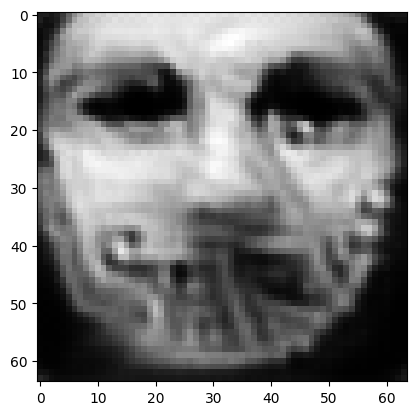

tensor([[3.3269e-03, 2.2302e-05, 3.9170e-04, 1.0125e-04, 1.8432e-04, 1.4758e-03,
         9.6820e-01, 3.6453e-03, 3.6591e-06, 1.3047e-04, 2.0834e-04, 1.7608e-05,
         7.8068e-05, 9.9273e-07, 1.0272e-04, 2.0614e-03, 1.7180e-03, 4.8320e-03,
         1.5102e-03, 3.6216e-03, 1.4130e-04, 1.5078e-05, 1.3616e-06, 1.1180e-03,
         3.4984e-05, 1.7295e-07, 9.7924e-04, 6.9789e-04, 2.9393e-03, 5.2969e-05,
         2.7688e-06, 1.5193e-04, 1.0773e-03, 1.6736e-04, 6.0295e-05, 1.6032e-04,
         3.4290e-05, 3.1143e-05, 4.1719e-04, 2.8362e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03231576457619667
tensor([[3.3267e-03, 2.2301e-05, 3.9167e-04, 1.0124e-04, 1.8431e-04, 1.4757e-03,
         9.6820e-01, 3.6450e-03, 3.6589e-06, 1.3046e-04, 2.0833e-04, 1.7607e-05,
         7.8065e-05, 9.9268e-07, 1.0271e-04, 2.0613e-03, 1.7179e-03, 4.8318e-03,
         1.5101e-03, 3.6214e-03, 1.4129e-04, 1.5076e-05, 1.3616e-06, 1.1179e-03,
         3.4983e-05, 1.7294e-07, 9.7920e-0

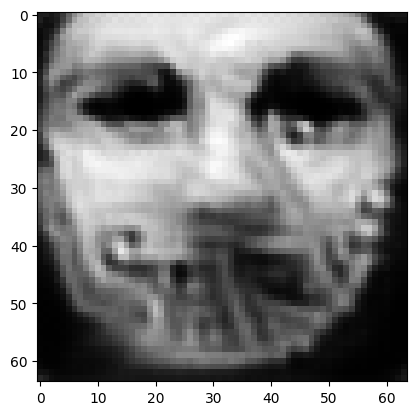

tensor([[3.3259e-03, 2.2294e-05, 3.9157e-04, 1.0122e-04, 1.8426e-04, 1.4754e-03,
         9.6821e-01, 3.6443e-03, 3.6579e-06, 1.3043e-04, 2.0830e-04, 1.7603e-05,
         7.8048e-05, 9.9237e-07, 1.0268e-04, 2.0609e-03, 1.7178e-03, 4.8308e-03,
         1.5098e-03, 3.6209e-03, 1.4126e-04, 1.5072e-05, 1.3613e-06, 1.1177e-03,
         3.4974e-05, 1.7289e-07, 9.7895e-04, 6.9770e-04, 2.9382e-03, 5.2953e-05,
         2.7679e-06, 1.5189e-04, 1.0770e-03, 1.6731e-04, 6.0277e-05, 1.6029e-04,
         3.4282e-05, 3.1136e-05, 4.1710e-04, 2.8356e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03230733796954155
tensor([[3.3256e-03, 2.2294e-05, 3.9157e-04, 1.0122e-04, 1.8426e-04, 1.4754e-03,
         9.6821e-01, 3.6442e-03, 3.6581e-06, 1.3043e-04, 2.0829e-04, 1.7603e-05,
         7.8050e-05, 9.9231e-07, 1.0267e-04, 2.0608e-03, 1.7177e-03, 4.8304e-03,
         1.5097e-03, 3.6208e-03, 1.4126e-04, 1.5070e-05, 1.3613e-06, 1.1176e-03,
         3.4973e-05, 1.7289e-07, 9.7897e-0

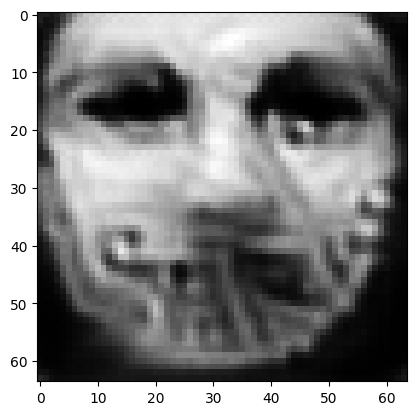

tensor([[3.3248e-03, 2.2287e-05, 3.9148e-04, 1.0121e-04, 1.8422e-04, 1.4751e-03,
         9.6822e-01, 3.6435e-03, 3.6572e-06, 1.3039e-04, 2.0827e-04, 1.7599e-05,
         7.8034e-05, 9.9203e-07, 1.0264e-04, 2.0604e-03, 1.7176e-03, 4.8294e-03,
         1.5095e-03, 3.6204e-03, 1.4123e-04, 1.5066e-05, 1.3611e-06, 1.1174e-03,
         3.4965e-05, 1.7284e-07, 9.7873e-04, 6.9754e-04, 2.9373e-03, 5.2939e-05,
         2.7671e-06, 1.5185e-04, 1.0768e-03, 1.6727e-04, 6.0265e-05, 1.6026e-04,
         3.4274e-05, 3.1131e-05, 4.1704e-04, 2.8356e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03229937702417374
tensor([[3.3247e-03, 2.2284e-05, 3.9144e-04, 1.0120e-04, 1.8420e-04, 1.4750e-03,
         9.6822e-01, 3.6434e-03, 3.6565e-06, 1.3039e-04, 2.0826e-04, 1.7598e-05,
         7.8023e-05, 9.9191e-07, 1.0263e-04, 2.0603e-03, 1.7175e-03, 4.8291e-03,
         1.5094e-03, 3.6202e-03, 1.4122e-04, 1.5065e-05, 1.3608e-06, 1.1174e-03,
         3.4961e-05, 1.7282e-07, 9.7858e-0

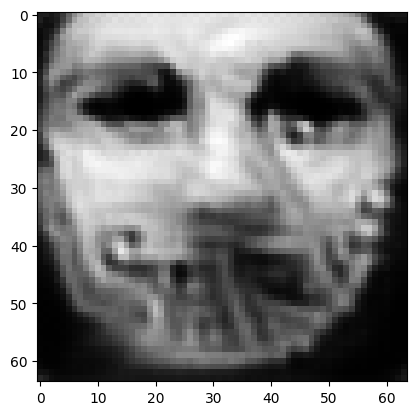

tensor([[3.3239e-03, 2.2280e-05, 3.9136e-04, 1.0118e-04, 1.8417e-04, 1.4748e-03,
         9.6822e-01, 3.6426e-03, 3.6561e-06, 1.3036e-04, 2.0823e-04, 1.7595e-05,
         7.8015e-05, 9.9170e-07, 1.0260e-04, 2.0600e-03, 1.7174e-03, 4.8283e-03,
         1.5091e-03, 3.6198e-03, 1.4120e-04, 1.5061e-05, 1.3608e-06, 1.1171e-03,
         3.4956e-05, 1.7278e-07, 9.7846e-04, 6.9737e-04, 2.9363e-03, 5.2924e-05,
         2.7663e-06, 1.5181e-04, 1.0766e-03, 1.6723e-04, 6.0248e-05, 1.6023e-04,
         3.4267e-05, 3.1125e-05, 4.1695e-04, 2.8351e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03229175880551338
tensor([[3.3238e-03, 2.2277e-05, 3.9133e-04, 1.0117e-04, 1.8415e-04, 1.4746e-03,
         9.6823e-01, 3.6426e-03, 3.6554e-06, 1.3035e-04, 2.0823e-04, 1.7593e-05,
         7.8004e-05, 9.9158e-07, 1.0260e-04, 2.0599e-03, 1.7173e-03, 4.8280e-03,
         1.5091e-03, 3.6197e-03, 1.4119e-04, 1.5060e-05, 1.3605e-06, 1.1172e-03,
         3.4952e-05, 1.7276e-07, 9.7833e-0

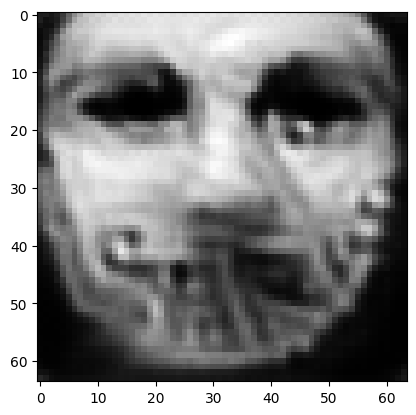

tensor([[3.3231e-03, 2.2271e-05, 3.9124e-04, 1.0116e-04, 1.8411e-04, 1.4743e-03,
         9.6823e-01, 3.6419e-03, 3.6546e-06, 1.3032e-04, 2.0820e-04, 1.7590e-05,
         7.7990e-05, 9.9134e-07, 1.0258e-04, 2.0596e-03, 1.7172e-03, 4.8271e-03,
         1.5088e-03, 3.6192e-03, 1.4116e-04, 1.5056e-05, 1.3603e-06, 1.1170e-03,
         3.4945e-05, 1.7272e-07, 9.7812e-04, 6.9720e-04, 2.9355e-03, 5.2910e-05,
         2.7654e-06, 1.5177e-04, 1.0763e-03, 1.6718e-04, 6.0228e-05, 1.6020e-04,
         3.4258e-05, 3.1119e-05, 4.1685e-04, 2.8342e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03228460252285004
tensor([[3.3229e-03, 2.2270e-05, 3.9122e-04, 1.0115e-04, 1.8411e-04, 1.4743e-03,
         9.6823e-01, 3.6418e-03, 3.6544e-06, 1.3031e-04, 2.0820e-04, 1.7589e-05,
         7.7987e-05, 9.9129e-07, 1.0257e-04, 2.0595e-03, 1.7172e-03, 4.8270e-03,
         1.5088e-03, 3.6191e-03, 1.4116e-04, 1.5055e-05, 1.3603e-06, 1.1170e-03,
         3.4944e-05, 1.7271e-07, 9.7807e-0

In [20]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=6)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.525046348571777


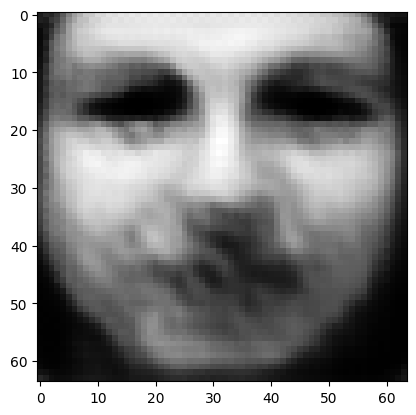

tensor([[0.0060, 0.0027, 0.0475, 0.0193, 0.1113, 0.0054, 0.0131, 0.0132, 0.0043,
         0.0008, 0.0023, 0.0015, 0.0251, 0.0122, 0.0032, 0.0015, 0.0538, 0.0151,
         0.0091, 0.0031, 0.0162, 0.0023, 0.0523, 0.0042, 0.2165, 0.0161, 0.0048,
         0.0201, 0.0291, 0.0164, 0.0061, 0.0029, 0.0248, 0.0266, 0.0140, 0.0192,
         0.0454, 0.0175, 0.0865, 0.0287]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.331026077270508
tensor([[0.0049, 0.0012, 0.0368, 0.0074, 0.1598, 0.0055, 0.0148, 0.0175, 0.0044,
         0.0008, 0.0035, 0.0015, 0.0153, 0.0243, 0.0028, 0.0016, 0.0411, 0.0475,
         0.0048, 0.0048, 0.0094, 0.0019, 0.0125, 0.0041, 0.2056, 0.0064, 0.0063,
         0.0205, 0.0205, 0.0063, 0.0039, 0.0068, 0.0691, 0.0405, 0.0077, 0.0158,
         0.0722, 0.0246, 0.0545, 0.0110]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.042793273925781
tensor([[2.7610e-02, 6.1975e-04, 9.5587e-02, 2.7708e-03, 2.1668e-02, 3.1591e-02,
         7.

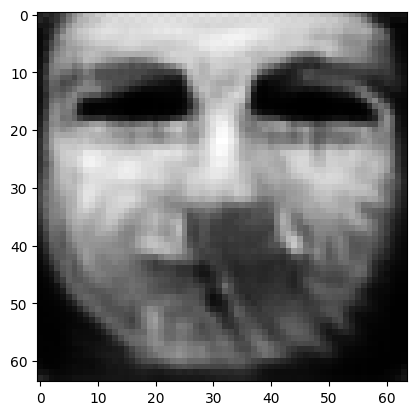

tensor([[1.3592e-02, 3.3576e-05, 2.6790e-02, 2.9714e-04, 3.7392e-03, 2.3275e-02,
         5.3252e-03, 8.8582e-01, 1.0570e-05, 1.3869e-03, 1.1416e-03, 6.2147e-05,
         2.2051e-05, 5.2461e-06, 5.0072e-05, 3.2478e-04, 6.4832e-03, 2.4582e-03,
         4.9961e-04, 9.6477e-04, 1.5085e-05, 1.3367e-04, 4.0685e-07, 2.2713e-03,
         7.9817e-04, 1.5513e-04, 2.0138e-04, 1.4266e-02, 6.0052e-03, 5.1826e-05,
         2.3724e-05, 1.5689e-04, 9.2118e-04, 5.7245e-04, 6.7926e-05, 2.9627e-05,
         1.3201e-04, 7.3415e-04, 9.8250e-04, 1.9709e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1212376281619072
tensor([[1.2346e-02, 2.9292e-05, 2.2504e-02, 2.4108e-04, 3.1548e-03, 2.0865e-02,
         4.4840e-03, 9.0351e-01, 8.1368e-06, 1.2092e-03, 9.0213e-04, 5.2470e-05,
         1.7235e-05, 3.6171e-06, 3.9515e-05, 2.6248e-04, 5.0430e-03, 1.9776e-03,
         3.9688e-04, 7.8893e-04, 1.1736e-05, 1.0935e-04, 2.9498e-07, 1.8682e-03,
         6.1170e-04, 1.2047e-04, 1.5826e-04

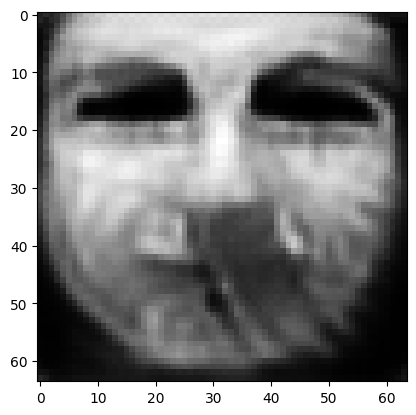

tensor([[8.8174e-03, 1.8897e-05, 1.5522e-02, 1.5206e-04, 1.9841e-03, 1.5561e-02,
         2.5630e-03, 9.3531e-01, 3.8315e-06, 8.4044e-04, 5.5908e-04, 2.9928e-05,
         8.4817e-06, 1.4538e-06, 2.1407e-05, 1.6644e-04, 3.0893e-03, 1.0072e-03,
         2.4507e-04, 4.4506e-04, 5.8235e-06, 6.5790e-05, 1.2332e-07, 1.2469e-03,
         2.8903e-04, 7.4893e-05, 7.8432e-05, 7.5736e-03, 2.6341e-03, 1.8328e-05,
         8.2518e-06, 8.1540e-05, 3.9280e-04, 2.4455e-04, 2.9441e-05, 1.1197e-05,
         4.6350e-05, 3.2724e-04, 4.4207e-04, 8.1562e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06687495112419128
tensor([[8.3140e-03, 1.7363e-05, 1.4502e-02, 1.3864e-04, 1.8261e-03, 1.4767e-02,
         2.3046e-03, 9.3984e-01, 3.3023e-06, 7.8555e-04, 5.1207e-04, 2.7263e-05,
         7.4142e-06, 1.2238e-06, 1.9190e-05, 1.5424e-04, 2.8405e-03, 8.8948e-04,
         2.2449e-04, 4.0002e-04, 5.1507e-06, 6.0342e-05, 1.0504e-07, 1.1817e-03,
         2.5231e-04, 6.7956e-05, 6.8467e-0

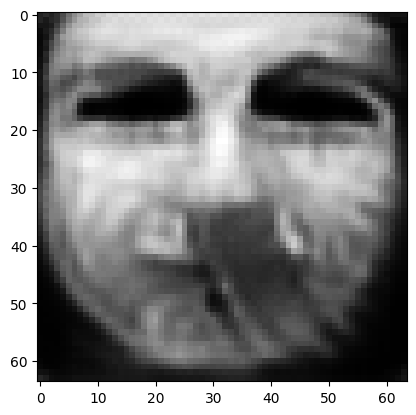

tensor([[7.0401e-03, 1.4225e-05, 1.1708e-02, 1.0821e-04, 1.4776e-03, 1.2771e-02,
         1.7582e-03, 9.5098e-01, 2.2623e-06, 6.5949e-04, 3.9836e-04, 2.1807e-05,
         5.3251e-06, 7.8335e-07, 1.4245e-05, 1.2494e-04, 2.1817e-03, 6.4862e-04,
         1.7481e-04, 3.0335e-04, 3.7383e-06, 4.7536e-05, 6.9662e-08, 9.8962e-04,
         1.7345e-04, 5.1632e-05, 4.8938e-05, 5.4088e-03, 1.7702e-03, 1.0845e-05,
         4.7870e-06, 6.3117e-05, 2.6004e-04, 1.5789e-04, 1.9469e-05, 7.0808e-06,
         2.8296e-05, 2.1865e-04, 2.8639e-04, 5.2228e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05025826767086983
tensor([[6.8243e-03, 1.3672e-05, 1.1232e-02, 1.0261e-04, 1.4233e-03, 1.2459e-02,
         1.6701e-03, 9.5286e-01, 2.1084e-06, 6.3750e-04, 3.8016e-04, 2.0952e-05,
         4.9926e-06, 7.1659e-07, 1.3479e-05, 1.1954e-04, 2.0678e-03, 6.1170e-04,
         1.6559e-04, 2.8763e-04, 3.5283e-06, 4.5487e-05, 6.4225e-08, 9.5636e-04,
         1.6187e-04, 4.8857e-05, 4.5756e-0

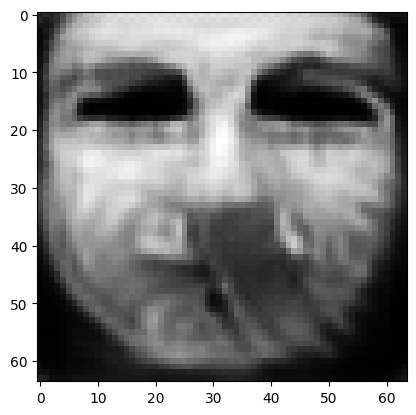

tensor([[6.1488e-03, 1.1968e-05, 9.8509e-03, 8.6839e-05, 1.2576e-03, 1.1301e-02,
         1.4132e-03, 9.5848e-01, 1.6700e-06, 5.7366e-04, 3.2973e-04, 1.8107e-05,
         4.0416e-06, 5.4432e-07, 1.1373e-05, 1.0506e-04, 1.7853e-03, 5.0759e-04,
         1.4157e-04, 2.4366e-04, 2.9161e-06, 3.9541e-05, 4.9592e-08, 8.7766e-04,
         1.2926e-04, 4.0931e-05, 3.6511e-05, 4.3653e-03, 1.3658e-03, 7.9372e-06,
         3.4290e-06, 5.5173e-05, 2.0414e-04, 1.2292e-04, 1.5226e-05, 5.3683e-06,
         2.1191e-05, 1.7291e-04, 2.2455e-04, 3.9649e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04241027683019638
tensor([[6.0240e-03, 1.1649e-05, 9.5899e-03, 8.3961e-05, 1.2308e-03, 1.1036e-02,
         1.3620e-03, 9.5955e-01, 1.5921e-06, 5.6070e-04, 3.2037e-04, 1.7519e-05,
         3.8687e-06, 5.1700e-07, 1.1060e-05, 1.0232e-04, 1.7413e-03, 4.8960e-04,
         1.3727e-04, 2.3529e-04, 2.8079e-06, 3.8494e-05, 4.7238e-08, 8.6788e-04,
         1.2414e-04, 3.9546e-05, 3.4702e-0

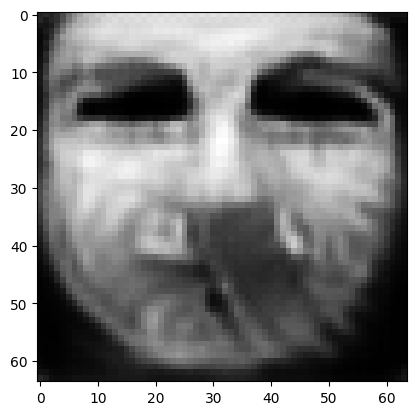

tensor([[5.6282e-03, 1.0589e-05, 8.7660e-03, 7.4308e-05, 1.1400e-03, 1.0294e-02,
         1.2147e-03, 9.6301e-01, 1.3746e-06, 5.2015e-04, 2.8828e-04, 1.5888e-05,
         3.3654e-06, 4.2787e-07, 1.0013e-05, 9.2848e-05, 1.5705e-03, 4.3687e-04,
         1.2192e-04, 2.1293e-04, 2.4821e-06, 3.5345e-05, 4.0041e-08, 8.1904e-04,
         1.0829e-04, 3.4993e-05, 2.9410e-05, 3.6596e-03, 1.1436e-03, 6.4509e-06,
         2.7209e-06, 5.0670e-05, 1.7746e-04, 1.0504e-04, 1.2950e-05, 4.4502e-06,
         1.7358e-05, 1.4759e-04, 1.9579e-04, 3.2592e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03768984228372574
tensor([[5.5510e-03, 1.0389e-05, 8.6108e-03, 7.2579e-05, 1.1205e-03, 1.0151e-02,
         1.1868e-03, 9.6368e-01, 1.3370e-06, 5.1310e-04, 2.8190e-04, 1.5610e-05,
         3.2746e-06, 4.1178e-07, 9.7964e-06, 9.0986e-05, 1.5329e-03, 4.2719e-04,
         1.1900e-04, 2.0880e-04, 2.4225e-06, 3.4736e-05, 3.8778e-08, 8.0519e-04,
         1.0521e-04, 3.4172e-05, 2.8585e-0

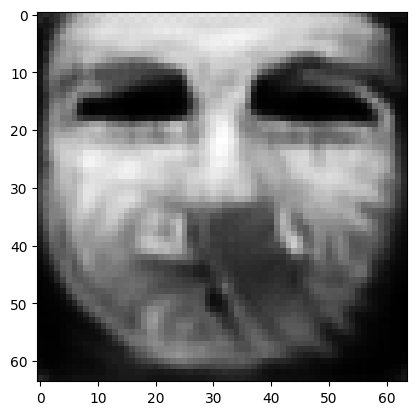

tensor([[5.2366e-03, 9.7935e-06, 8.0813e-03, 6.7517e-05, 1.0459e-03, 9.7152e-03,
         1.0963e-03, 9.6587e-01, 1.2133e-06, 4.9330e-04, 2.6298e-04, 1.4594e-05,
         2.9686e-06, 3.6107e-07, 8.9315e-06, 8.4568e-05, 1.4093e-03, 3.9050e-04,
         1.0998e-04, 1.9403e-04, 2.2070e-06, 3.2169e-05, 3.4253e-08, 7.4713e-04,
         9.3678e-05, 3.1582e-05, 2.6096e-05, 3.2577e-03, 1.0288e-03, 5.5906e-06,
         2.3426e-06, 4.7277e-05, 1.6106e-04, 9.5212e-05, 1.1579e-05, 3.8897e-06,
         1.5110e-05, 1.3371e-04, 1.7757e-04, 2.9186e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034723035991191864
tensor([[5.1646e-03, 9.6582e-06, 7.9680e-03, 6.6466e-05, 1.0288e-03, 9.6172e-03,
         1.0766e-03, 9.6635e-01, 1.1869e-06, 4.8906e-04, 2.5889e-04, 1.4361e-05,
         2.9030e-06, 3.5053e-07, 8.7369e-06, 8.3127e-05, 1.3831e-03, 3.8241e-04,
         1.0804e-04, 1.9094e-04, 2.1589e-06, 3.1594e-05, 3.3282e-08, 7.3384e-04,
         9.1211e-05, 3.1039e-05, 2.5566e-

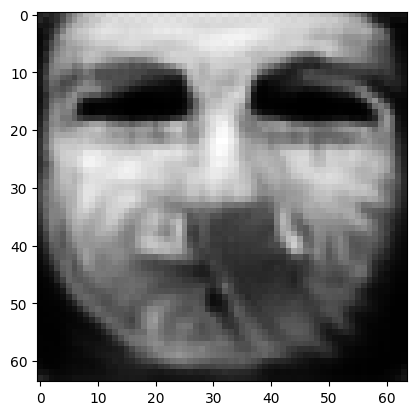

tensor([[4.9293e-03, 9.1740e-06, 7.5575e-03, 6.2855e-05, 9.7450e-04, 9.2670e-03,
         1.0091e-03, 9.6802e-01, 1.0915e-06, 4.7505e-04, 2.4471e-04, 1.3536e-05,
         2.6792e-06, 3.1488e-07, 8.1022e-06, 7.8253e-05, 1.2979e-03, 3.5537e-04,
         1.0117e-04, 1.8042e-04, 1.9969e-06, 2.9658e-05, 2.9952e-08, 6.9138e-04,
         8.3090e-05, 2.9107e-05, 2.3645e-05, 2.9798e-03, 9.4476e-04, 4.9900e-06,
         2.0850e-06, 4.4425e-05, 1.4801e-04, 8.7698e-05, 1.0585e-05, 3.4689e-06,
         1.3476e-05, 1.2345e-04, 1.6409e-04, 2.6636e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03250284120440483
tensor([[4.8765e-03, 9.0709e-06, 7.4724e-03, 6.2059e-05, 9.6310e-04, 9.1894e-03,
         9.9554e-04, 9.6837e-01, 1.0716e-06, 4.7184e-04, 2.4182e-04, 1.3363e-05,
         2.6335e-06, 3.0794e-07, 7.9693e-06, 7.7267e-05, 1.2809e-03, 3.4990e-04,
         9.9691e-05, 1.7829e-04, 1.9634e-06, 2.9232e-05, 2.9275e-08, 6.8233e-04,
         8.1428e-05, 2.8676e-05, 2.3257e-0

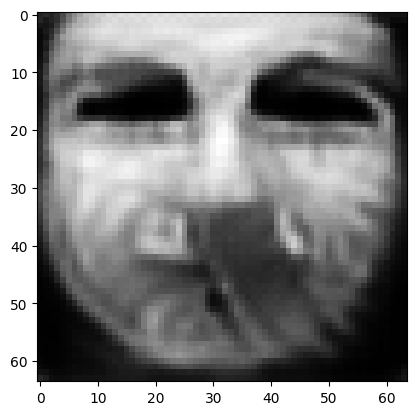

tensor([[4.6976e-03, 8.7223e-06, 7.1691e-03, 5.9242e-05, 9.2600e-04, 8.9167e-03,
         9.4967e-04, 9.6959e-01, 1.0071e-06, 4.5960e-04, 2.3184e-04, 1.2730e-05,
         2.4839e-06, 2.8557e-07, 7.5467e-06, 7.3780e-05, 1.2226e-03, 3.3246e-04,
         9.4560e-05, 1.7141e-04, 1.8486e-06, 2.7821e-05, 2.7089e-08, 6.5175e-04,
         7.6156e-05, 2.7289e-05, 2.1940e-05, 2.7955e-03, 8.8104e-04, 4.5827e-06,
         1.9044e-06, 4.2379e-05, 1.3880e-04, 8.2802e-05, 9.9189e-06, 3.1798e-06,
         1.2376e-05, 1.1599e-04, 1.5430e-04, 2.4785e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030883781611919403
tensor([[4.6595e-03, 8.6392e-06, 7.1011e-03, 5.8663e-05, 9.1821e-04, 8.8520e-03,
         9.3921e-04, 9.6986e-01, 9.9200e-07, 4.5674e-04, 2.2965e-04, 1.2581e-05,
         2.4494e-06, 2.8069e-07, 7.4556e-06, 7.3012e-05, 1.2103e-03, 3.2854e-04,
         9.3432e-05, 1.6972e-04, 1.8229e-06, 2.7515e-05, 2.6601e-08, 6.4550e-04,
         7.5002e-05, 2.6998e-05, 2.1632e-

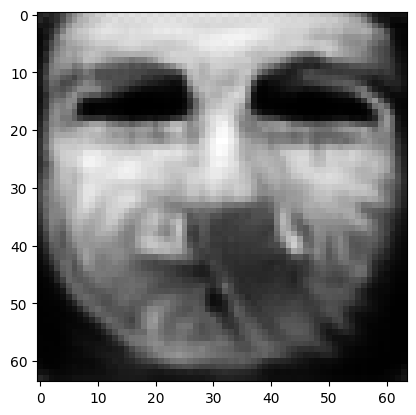

tensor([[4.5179e-03, 8.3556e-06, 6.8402e-03, 5.6410e-05, 8.8553e-04, 8.6086e-03,
         9.0109e-04, 9.7089e-01, 9.3581e-07, 4.4671e-04, 2.2134e-04, 1.2017e-05,
         2.3249e-06, 2.6226e-07, 7.1112e-06, 7.0257e-05, 1.1634e-03, 3.1319e-04,
         8.9528e-05, 1.6388e-04, 1.7258e-06, 2.6283e-05, 2.4790e-08, 6.2146e-04,
         7.0501e-05, 2.5830e-05, 2.0506e-05, 2.6506e-03, 8.2912e-04, 4.2553e-06,
         1.7580e-06, 4.0593e-05, 1.3061e-04, 7.8503e-05, 9.3776e-06, 2.9452e-06,
         1.1490e-05, 1.0970e-04, 1.4598e-04, 2.3177e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02954581193625927
tensor([[4.4870e-03, 8.2930e-06, 6.7807e-03, 5.5875e-05, 8.7790e-04, 8.5503e-03,
         8.9203e-04, 9.7112e-01, 9.2327e-07, 4.4434e-04, 2.1947e-04, 1.1894e-05,
         2.2963e-06, 2.5812e-07, 7.0330e-06, 6.9639e-05, 1.1529e-03, 3.0967e-04,
         8.8656e-05, 1.6252e-04, 1.7041e-06, 2.6013e-05, 2.4406e-08, 6.1636e-04,
         6.9518e-05, 2.5569e-05, 2.0247e-0

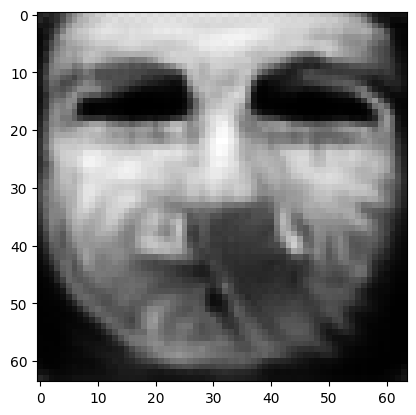

tensor([[4.3693e-03, 8.0610e-06, 6.5626e-03, 5.3836e-05, 8.5081e-04, 8.3339e-03,
         8.5922e-04, 9.7199e-01, 8.7711e-07, 4.3565e-04, 2.1216e-04, 1.1447e-05,
         2.1937e-06, 2.4328e-07, 6.7491e-06, 6.7531e-05, 1.1169e-03, 2.9693e-04,
         8.5595e-05, 1.5757e-04, 1.6252e-06, 2.5045e-05, 2.3062e-08, 5.9923e-04,
         6.5942e-05, 2.4599e-05, 1.9284e-05, 2.5243e-03, 7.8697e-04, 3.9921e-06,
         1.6372e-06, 3.9115e-05, 1.2395e-04, 7.4961e-05, 8.9284e-06, 2.7516e-06,
         1.0760e-05, 1.0451e-04, 1.3917e-04, 2.1856e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02841011807322502
tensor([[4.3408e-03, 7.9904e-06, 6.5088e-03, 5.3281e-05, 8.4489e-04, 8.2793e-03,
         8.4940e-04, 9.7222e-01, 8.6313e-07, 4.3283e-04, 2.1010e-04, 1.1336e-05,
         2.1624e-06, 2.3893e-07, 6.6727e-06, 6.6988e-05, 1.1063e-03, 2.9338e-04,
         8.4596e-05, 1.5578e-04, 1.6054e-06, 2.4821e-05, 2.2687e-08, 5.9535e-04,
         6.4966e-05, 2.4354e-05, 1.9002e-0

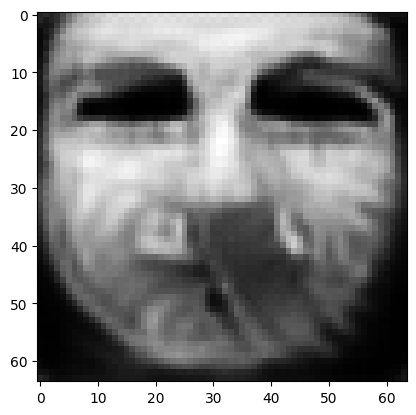

tensor([[4.2203e-03, 7.7645e-06, 6.3024e-03, 5.1235e-05, 8.1945e-04, 8.0736e-03,
         8.1388e-04, 9.7308e-01, 8.1465e-07, 4.2422e-04, 2.0287e-04, 1.0933e-05,
         2.0534e-06, 2.2380e-07, 6.3761e-06, 6.5018e-05, 1.0654e-03, 2.8027e-04,
         8.1325e-05, 1.4983e-04, 1.5349e-06, 2.3942e-05, 2.1385e-08, 5.7907e-04,
         6.1285e-05, 2.3423e-05, 1.8042e-05, 2.3887e-03, 7.4464e-04, 3.7334e-06,
         1.5139e-06, 3.7706e-05, 1.1709e-04, 7.1157e-05, 8.4690e-06, 2.5670e-06,
         1.0054e-05, 9.9129e-05, 1.3219e-04, 2.0540e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027291925624012947
tensor([[4.1866e-03, 7.7116e-06, 6.2588e-03, 5.0782e-05, 8.1306e-04, 8.0256e-03,
         8.0584e-04, 9.7327e-01, 8.0438e-07, 4.2224e-04, 2.0137e-04, 1.0836e-05,
         2.0292e-06, 2.2066e-07, 6.3060e-06, 6.4522e-05, 1.0565e-03, 2.7723e-04,
         8.0607e-05, 1.4849e-04, 1.5185e-06, 2.3733e-05, 2.1097e-08, 5.7484e-04,
         6.0461e-05, 2.3223e-05, 1.7830e-

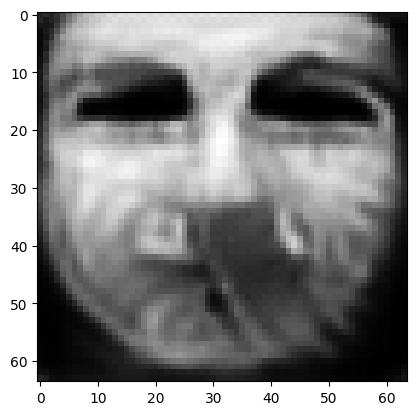

tensor([[4.0667e-03, 7.5147e-06, 6.0846e-03, 4.9092e-05, 7.8973e-04, 7.8668e-03,
         7.7571e-04, 9.7401e-01, 7.6583e-07, 4.1405e-04, 1.9550e-04, 1.0491e-05,
         1.9385e-06, 2.0825e-07, 6.0330e-06, 6.2597e-05, 1.0191e-03, 2.6570e-04,
         7.7700e-05, 1.4331e-04, 1.4561e-06, 2.2936e-05, 2.0000e-08, 5.5771e-04,
         5.7353e-05, 2.2458e-05, 1.7053e-05, 2.2870e-03, 7.0913e-04, 3.5155e-06,
         1.4157e-06, 3.6395e-05, 1.1117e-04, 6.7998e-05, 8.0864e-06, 2.4109e-06,
         9.4710e-06, 9.4545e-05, 1.2606e-04, 1.9521e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026337021961808205
tensor([[4.0398e-03, 7.4658e-06, 6.0457e-03, 4.8706e-05, 7.8450e-04, 7.8276e-03,
         7.6874e-04, 9.7418e-01, 7.5699e-07, 4.1219e-04, 1.9418e-04, 1.0414e-05,
         1.9173e-06, 2.0548e-07, 5.9720e-06, 6.2153e-05, 1.0107e-03, 2.6311e-04,
         7.7017e-05, 1.4209e-04, 1.4423e-06, 2.2762e-05, 1.9750e-08, 5.5392e-04,
         5.6666e-05, 2.2285e-05, 1.6871e-

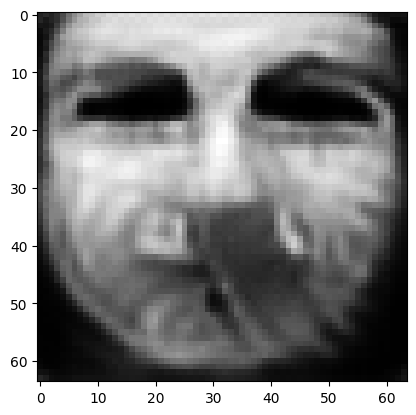

tensor([[3.9488e-03, 7.2986e-06, 5.8900e-03, 4.7223e-05, 7.6570e-04, 7.6924e-03,
         7.4486e-04, 9.7480e-01, 7.2635e-07, 4.0485e-04, 1.8908e-04, 1.0148e-05,
         1.8451e-06, 1.9566e-07, 5.7597e-06, 6.0505e-05, 9.7771e-04, 2.5451e-04,
         7.4441e-05, 1.3799e-04, 1.3929e-06, 2.2136e-05, 1.8893e-08, 5.3984e-04,
         5.4319e-05, 2.1621e-05, 1.6264e-05, 2.1947e-03, 6.7764e-04, 3.3332e-06,
         1.3342e-06, 3.5435e-05, 1.0661e-04, 6.5455e-05, 7.7729e-06, 2.2888e-06,
         9.0042e-06, 9.0873e-05, 1.2083e-04, 1.8657e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025526706129312515
tensor([[3.9264e-03, 7.2594e-06, 5.8550e-03, 4.6883e-05, 7.6103e-04, 7.6601e-03,
         7.3924e-04, 9.7494e-01, 7.1907e-07, 4.0320e-04, 1.8795e-04, 1.0082e-05,
         1.8278e-06, 1.9340e-07, 5.7094e-06, 6.0135e-05, 9.7072e-04, 2.5238e-04,
         7.3891e-05, 1.3701e-04, 1.3813e-06, 2.1984e-05, 1.8691e-08, 5.3662e-04,
         5.3756e-05, 2.1468e-05, 1.6118e-

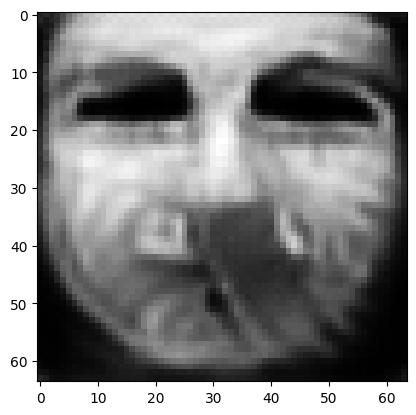

tensor([[3.8419e-03, 7.1052e-06, 5.7193e-03, 4.5676e-05, 7.4397e-04, 7.5246e-03,
         7.1690e-04, 9.7549e-01, 6.9124e-07, 3.9628e-04, 1.8377e-04, 9.8028e-06,
         1.7622e-06, 1.8519e-07, 5.5260e-06, 5.8708e-05, 9.4693e-04, 2.4417e-04,
         7.1875e-05, 1.3331e-04, 1.3348e-06, 2.1400e-05, 1.7960e-08, 5.2582e-04,
         5.1711e-05, 2.0948e-05, 1.5529e-05, 2.1235e-03, 6.5030e-04, 3.1789e-06,
         1.2669e-06, 3.4435e-05, 1.0235e-04, 6.3111e-05, 7.4994e-06, 2.1777e-06,
         8.5989e-06, 8.7630e-05, 1.1626e-04, 1.7868e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024812722578644753
tensor([[3.8213e-03, 7.0710e-06, 5.6836e-03, 4.5388e-05, 7.3995e-04, 7.4982e-03,
         7.1185e-04, 9.7563e-01, 6.8463e-07, 3.9449e-04, 1.8266e-04, 9.7366e-06,
         1.7469e-06, 1.8307e-07, 5.4766e-06, 5.8341e-05, 9.4013e-04, 2.4216e-04,
         7.1340e-05, 1.3242e-04, 1.3227e-06, 2.1245e-05, 1.7774e-08, 5.2258e-04,
         5.1169e-05, 2.0814e-05, 1.5395e-

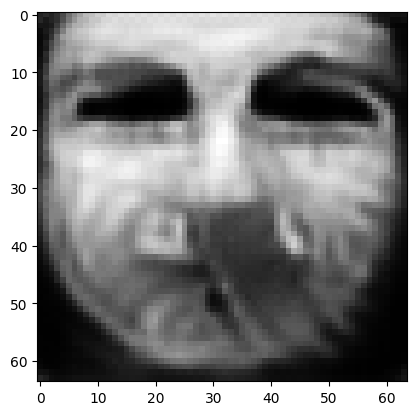

tensor([[3.7472e-03, 6.9278e-06, 5.5583e-03, 4.4264e-05, 7.2398e-04, 7.3726e-03,
         6.9196e-04, 9.7613e-01, 6.5726e-07, 3.8800e-04, 1.7881e-04, 9.4731e-06,
         1.6854e-06, 1.7540e-07, 5.3133e-06, 5.7134e-05, 9.2023e-04, 2.3449e-04,
         6.9627e-05, 1.2895e-04, 1.2803e-06, 2.0686e-05, 1.7077e-08, 5.1345e-04,
         4.9229e-05, 2.0277e-05, 1.4844e-05, 2.0596e-03, 6.2520e-04, 3.0367e-06,
         1.2032e-06, 3.3490e-05, 9.8162e-05, 6.0818e-05, 7.2433e-06, 2.0740e-06,
         8.2193e-06, 8.4431e-05, 1.1186e-04, 1.7125e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024161648005247116
tensor([[3.7292e-03, 6.8930e-06, 5.5286e-03, 4.4002e-05, 7.2024e-04, 7.3476e-03,
         6.8756e-04, 9.7624e-01, 6.5125e-07, 3.8635e-04, 1.7787e-04, 9.4127e-06,
         1.6715e-06, 1.7360e-07, 5.2719e-06, 5.6821e-05, 9.1492e-04, 2.3274e-04,
         6.9175e-05, 1.2817e-04, 1.2697e-06, 2.0550e-05, 1.6909e-08, 5.1074e-04,
         4.8766e-05, 2.0154e-05, 1.4725e-

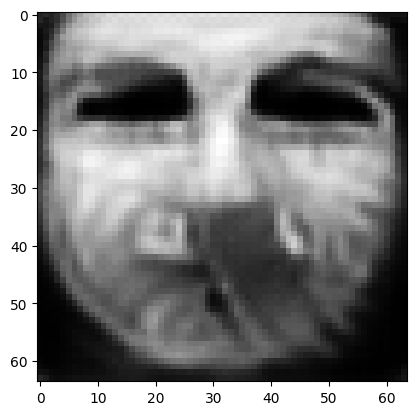

tensor([[3.6601e-03, 6.7696e-06, 5.4267e-03, 4.3070e-05, 7.0583e-04, 7.2424e-03,
         6.7029e-04, 9.7667e-01, 6.2867e-07, 3.8094e-04, 1.7462e-04, 9.1769e-06,
         1.6204e-06, 1.6703e-07, 5.1224e-06, 5.5690e-05, 8.9721e-04, 2.2581e-04,
         6.7721e-05, 1.2525e-04, 1.2310e-06, 2.0045e-05, 1.6290e-08, 5.0138e-04,
         4.7074e-05, 1.9705e-05, 1.4269e-05, 2.0082e-03, 6.0456e-04, 2.9131e-06,
         1.1500e-06, 3.2623e-05, 9.4496e-05, 5.8864e-05, 7.0171e-06, 1.9833e-06,
         7.8925e-06, 8.1676e-05, 1.0808e-04, 1.6503e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023605158552527428
tensor([[3.6436e-03, 6.7397e-06, 5.4017e-03, 4.2863e-05, 7.0257e-04, 7.2187e-03,
         6.6629e-04, 9.7677e-01, 6.2374e-07, 3.7952e-04, 1.7386e-04, 9.1199e-06,
         1.6089e-06, 1.6557e-07, 5.0874e-06, 5.5396e-05, 8.9263e-04, 2.2427e-04,
         6.7349e-05, 1.2457e-04, 1.2215e-06, 1.9927e-05, 1.6149e-08, 4.9890e-04,
         4.6695e-05, 1.9610e-05, 1.4168e-

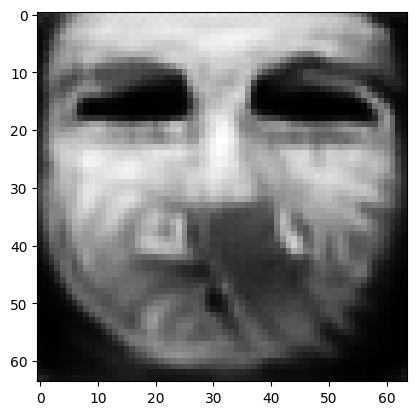

tensor([[3.5869e-03, 6.6318e-06, 5.3064e-03, 4.2011e-05, 6.9006e-04, 7.1217e-03,
         6.5090e-04, 9.7716e-01, 6.0452e-07, 3.7478e-04, 1.7081e-04, 8.9157e-06,
         1.5648e-06, 1.6000e-07, 4.9631e-06, 5.4399e-05, 8.7618e-04, 2.1853e-04,
         6.6036e-05, 1.2206e-04, 1.1883e-06, 1.9512e-05, 1.5632e-08, 4.9085e-04,
         4.5327e-05, 1.9213e-05, 1.3782e-05, 1.9619e-03, 5.8673e-04, 2.8073e-06,
         1.1046e-06, 3.1880e-05, 9.1425e-05, 5.7231e-05, 6.8224e-06, 1.9059e-06,
         7.6134e-06, 7.9330e-05, 1.0484e-04, 1.5955e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023108001798391342
tensor([[3.5742e-03, 6.6078e-06, 5.2815e-03, 4.1794e-05, 6.8722e-04, 7.1007e-03,
         6.4746e-04, 9.7725e-01, 6.0038e-07, 3.7353e-04, 1.7003e-04, 8.8724e-06,
         1.5550e-06, 1.5873e-07, 4.9341e-06, 5.4149e-05, 8.7147e-04, 2.1732e-04,
         6.5679e-05, 1.2151e-04, 1.1808e-06, 1.9420e-05, 1.5519e-08, 4.8873e-04,
         4.5032e-05, 1.9117e-05, 1.3702e-

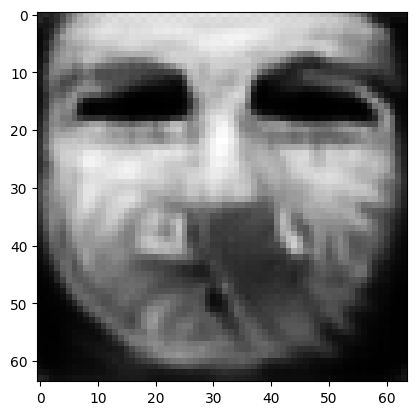

tensor([[3.5254e-03, 6.5194e-06, 5.1894e-03, 4.0973e-05, 6.7591e-04, 7.0151e-03,
         6.3425e-04, 9.7760e-01, 5.8413e-07, 3.6927e-04, 1.6717e-04, 8.7078e-06,
         1.5178e-06, 1.5392e-07, 4.8252e-06, 5.3262e-05, 8.5475e-04, 2.1254e-04,
         6.4451e-05, 1.1940e-04, 1.1528e-06, 1.9065e-05, 1.5088e-08, 4.8123e-04,
         4.3871e-05, 1.8740e-05, 1.3389e-05, 1.9156e-03, 5.7042e-04, 2.7174e-06,
         1.0638e-06, 3.1305e-05, 8.8983e-05, 5.5897e-05, 6.6529e-06, 1.8403e-06,
         7.3637e-06, 7.7306e-05, 1.0201e-04, 1.5491e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022653020918369293
tensor([[3.5139e-03, 6.4989e-06, 5.1673e-03, 4.0786e-05, 6.7336e-04, 6.9961e-03,
         6.3115e-04, 9.7768e-01, 5.8033e-07, 3.6826e-04, 1.6648e-04, 8.6691e-06,
         1.5089e-06, 1.5276e-07, 4.7987e-06, 5.3048e-05, 8.5055e-04, 2.1141e-04,
         6.4142e-05, 1.1888e-04, 1.1463e-06, 1.8979e-05, 1.4984e-08, 4.7930e-04,
         4.3591e-05, 1.8653e-05, 1.3317e-

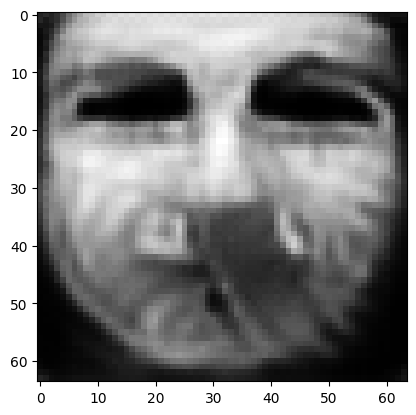

tensor([[3.4645e-03, 6.4182e-06, 5.0864e-03, 4.0053e-05, 6.6312e-04, 6.9165e-03,
         6.1888e-04, 9.7801e-01, 5.6591e-07, 3.6445e-04, 1.6391e-04, 8.5154e-06,
         1.4753e-06, 1.4847e-07, 4.6973e-06, 5.2212e-05, 8.3537e-04, 2.0691e-04,
         6.3019e-05, 1.1694e-04, 1.1205e-06, 1.8646e-05, 1.4590e-08, 4.7195e-04,
         4.2524e-05, 1.8325e-05, 1.3032e-05, 1.8744e-03, 5.5613e-04, 2.6360e-06,
         1.0281e-06, 3.0751e-05, 8.6753e-05, 5.4679e-05, 6.4969e-06, 1.7812e-06,
         7.1383e-06, 7.5452e-05, 9.9485e-05, 1.5078e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022237004712224007
tensor([[3.4519e-03, 6.3966e-06, 5.0653e-03, 3.9866e-05, 6.6047e-04, 6.8960e-03,
         6.1568e-04, 9.7809e-01, 5.6200e-07, 3.6342e-04, 1.6324e-04, 8.4748e-06,
         1.4664e-06, 1.4732e-07, 4.6700e-06, 5.1997e-05, 8.3182e-04, 2.0568e-04,
         6.2732e-05, 1.1642e-04, 1.1136e-06, 1.8555e-05, 1.4487e-08, 4.7021e-04,
         4.2239e-05, 1.8241e-05, 1.2951e-

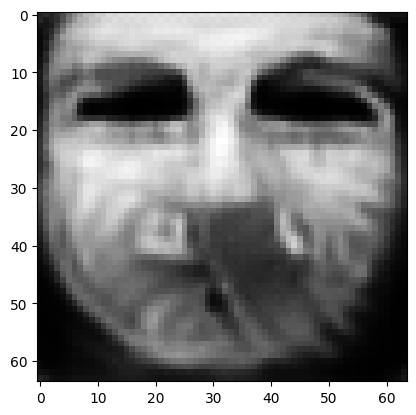

tensor([[3.4024e-03, 6.3142e-06, 4.9874e-03, 3.9150e-05, 6.4993e-04, 6.8187e-03,
         6.0335e-04, 9.7841e-01, 5.4686e-07, 3.5934e-04, 1.6069e-04, 8.3204e-06,
         1.4321e-06, 1.4295e-07, 4.5656e-06, 5.1181e-05, 8.1803e-04, 2.0099e-04,
         6.1647e-05, 1.1440e-04, 1.0873e-06, 1.8200e-05, 1.4086e-08, 4.6322e-04,
         4.1131e-05, 1.7908e-05, 1.2648e-05, 1.8343e-03, 5.4181e-04, 2.5538e-06,
         9.9254e-07, 3.0141e-05, 8.4364e-05, 5.3391e-05, 6.3357e-06, 1.7193e-06,
         6.9124e-06, 7.3531e-05, 9.6960e-05, 1.4658e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021826881915330887
tensor([[3.3906e-03, 6.2956e-06, 4.9691e-03, 3.8987e-05, 6.4749e-04, 6.8014e-03,
         6.0055e-04, 9.7848e-01, 5.4352e-07, 3.5833e-04, 1.6012e-04, 8.2838e-06,
         1.4244e-06, 1.4198e-07, 4.5419e-06, 5.0981e-05, 8.1456e-04, 1.9995e-04,
         6.1387e-05, 1.1393e-04, 1.0813e-06, 1.8117e-05, 1.3994e-08, 4.6144e-04,
         4.0879e-05, 1.7832e-05, 1.2582e-

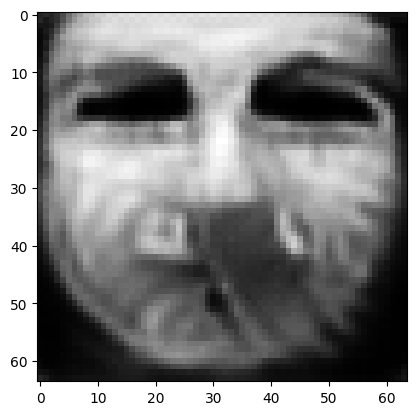

tensor([[3.3463e-03, 6.2261e-06, 4.8997e-03, 3.8370e-05, 6.3811e-04, 6.7356e-03,
         5.8998e-04, 9.7876e-01, 5.3099e-07, 3.5472e-04, 1.5793e-04, 8.1528e-06,
         1.3955e-06, 1.3832e-07, 4.4503e-06, 5.0234e-05, 8.0154e-04, 1.9600e-04,
         6.0410e-05, 1.1220e-04, 1.0585e-06, 1.7803e-05, 1.3649e-08, 4.5473e-04,
         3.9928e-05, 1.7541e-05, 1.2335e-05, 1.8028e-03, 5.2903e-04, 2.4826e-06,
         9.6243e-07, 2.9621e-05, 8.2273e-05, 5.2286e-05, 6.1965e-06, 1.6668e-06,
         6.7193e-06, 7.1882e-05, 9.4657e-05, 1.4299e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021469097584486008
tensor([[3.3364e-03, 6.2083e-06, 4.8840e-03, 3.8228e-05, 6.3611e-04, 6.7162e-03,
         5.8742e-04, 9.7883e-01, 5.2795e-07, 3.5385e-04, 1.5746e-04, 8.1202e-06,
         1.3885e-06, 1.3755e-07, 4.4325e-06, 5.0066e-05, 7.9901e-04, 1.9514e-04,
         6.0197e-05, 1.1178e-04, 1.0536e-06, 1.7737e-05, 1.3573e-08, 4.5363e-04,
         3.9742e-05, 1.7477e-05, 1.2270e-

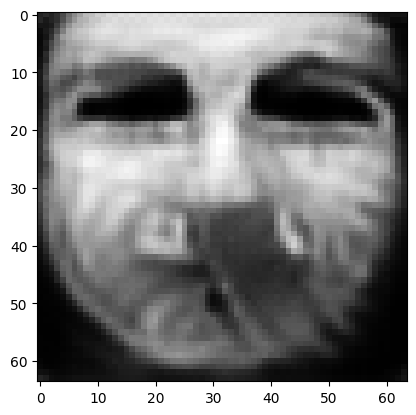

tensor([[3.2960e-03, 6.1456e-06, 4.8207e-03, 3.7674e-05, 6.2775e-04, 6.6525e-03,
         5.7804e-04, 9.7908e-01, 5.1658e-07, 3.5041e-04, 1.5551e-04, 8.0009e-06,
         1.3629e-06, 1.3436e-07, 4.3540e-06, 4.9392e-05, 7.8774e-04, 1.9167e-04,
         5.9331e-05, 1.1018e-04, 1.0333e-06, 1.7451e-05, 1.3267e-08, 4.4791e-04,
         3.8907e-05, 1.7211e-05, 1.2039e-05, 1.7756e-03, 5.1742e-04, 2.4198e-06,
         9.3589e-07, 2.9149e-05, 8.0383e-05, 5.1298e-05, 6.0709e-06, 1.6203e-06,
         6.5509e-06, 7.0407e-05, 9.2628e-05, 1.3963e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021142464131116867
tensor([[3.2866e-03, 6.1308e-06, 4.8061e-03, 3.7546e-05, 6.2580e-04, 6.6378e-03,
         5.7582e-04, 9.7914e-01, 5.1400e-07, 3.4958e-04, 1.5505e-04, 7.9720e-06,
         1.3569e-06, 1.3361e-07, 4.3356e-06, 4.9220e-05, 7.8488e-04, 1.9085e-04,
         5.9123e-05, 1.0981e-04, 1.0284e-06, 1.7384e-05, 1.3193e-08, 4.4639e-04,
         3.8718e-05, 1.7149e-05, 1.1987e-

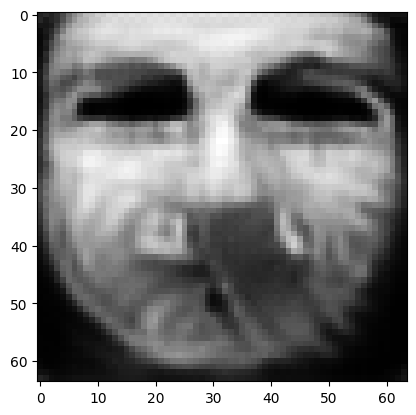

tensor([[3.2523e-03, 6.0761e-06, 4.7480e-03, 3.7065e-05, 6.1839e-04, 6.5781e-03,
         5.6760e-04, 9.7937e-01, 5.0386e-07, 3.4667e-04, 1.5326e-04, 7.8618e-06,
         1.3339e-06, 1.3068e-07, 4.2662e-06, 4.8606e-05, 7.7424e-04, 1.8770e-04,
         5.8358e-05, 1.0837e-04, 1.0102e-06, 1.7130e-05, 1.2912e-08, 4.4109e-04,
         3.7988e-05, 1.6908e-05, 1.1783e-05, 1.7499e-03, 5.0698e-04, 2.3629e-06,
         9.1173e-07, 2.8721e-05, 7.8674e-05, 5.0401e-05, 5.9575e-06, 1.5791e-06,
         6.3982e-06, 6.9055e-05, 9.0797e-05, 1.3666e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020845847204327583
tensor([[3.2439e-03, 6.0627e-06, 4.7342e-03, 3.6961e-05, 6.1661e-04, 6.5625e-03,
         5.6553e-04, 9.7943e-01, 5.0149e-07, 3.4602e-04, 1.5287e-04, 7.8346e-06,
         1.3284e-06, 1.3002e-07, 4.2498e-06, 4.8457e-05, 7.7178e-04, 1.8694e-04,
         5.8183e-05, 1.0803e-04, 1.0059e-06, 1.7071e-05, 1.2846e-08, 4.3985e-04,
         3.7819e-05, 1.6857e-05, 1.1734e-

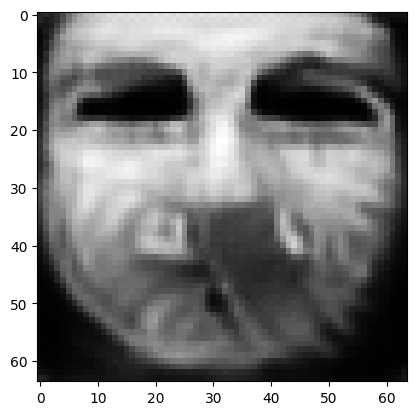

tensor([[3.2096e-03, 6.0106e-06, 4.6798e-03, 3.6536e-05, 6.0937e-04, 6.5034e-03,
         5.5732e-04, 9.7965e-01, 4.9202e-07, 3.4349e-04, 1.5127e-04, 7.7254e-06,
         1.3063e-06, 1.2727e-07, 4.1827e-06, 4.7874e-05, 7.6208e-04, 1.8376e-04,
         5.7504e-05, 1.0666e-04, 9.8835e-07, 1.6828e-05, 1.2583e-08, 4.3490e-04,
         3.7119e-05, 1.6650e-05, 1.1536e-05, 1.7266e-03, 4.9761e-04, 2.3105e-06,
         8.9039e-07, 2.8297e-05, 7.7059e-05, 4.9540e-05, 5.8509e-06, 1.5408e-06,
         6.2567e-06, 6.7840e-05, 8.9068e-05, 1.3388e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020562805235385895
tensor([[3.2010e-03, 5.9986e-06, 4.6668e-03, 3.6434e-05, 6.0758e-04, 6.4890e-03,
         5.5534e-04, 9.7970e-01, 4.8977e-07, 3.4289e-04, 1.5089e-04, 7.7002e-06,
         1.3012e-06, 1.2663e-07, 4.1663e-06, 4.7735e-05, 7.5974e-04, 1.8300e-04,
         5.7346e-05, 1.0633e-04, 9.8418e-07, 1.6770e-05, 1.2522e-08, 4.3366e-04,
         3.6947e-05, 1.6599e-05, 1.1490e-

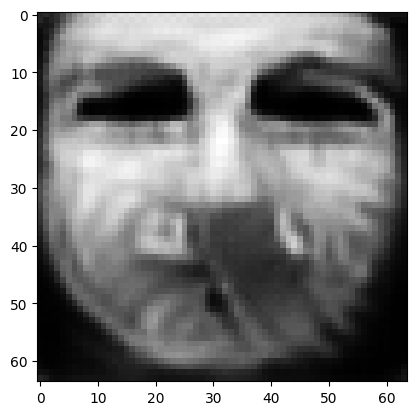

tensor([[3.1705e-03, 5.9529e-06, 4.6149e-03, 3.6035e-05, 6.0110e-04, 6.4332e-03,
         5.4804e-04, 9.7991e-01, 4.8106e-07, 3.4063e-04, 1.4940e-04, 7.6057e-06,
         1.2813e-06, 1.2415e-07, 4.1059e-06, 4.7228e-05, 7.5074e-04, 1.8019e-04,
         5.6729e-05, 1.0511e-04, 9.6876e-07, 1.6555e-05, 1.2288e-08, 4.2931e-04,
         3.6314e-05, 1.6404e-05, 1.1312e-05, 1.7039e-03, 4.8901e-04, 2.2631e-06,
         8.7076e-07, 2.7924e-05, 7.5607e-05, 4.8761e-05, 5.7531e-06, 1.5064e-06,
         6.1274e-06, 6.6738e-05, 8.7477e-05, 1.3136e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020297788083553314
tensor([[3.1632e-03, 5.9424e-06, 4.6022e-03, 3.5938e-05, 5.9950e-04, 6.4203e-03,
         5.4635e-04, 9.7996e-01, 4.7910e-07, 3.4008e-04, 1.4905e-04, 7.5843e-06,
         1.2768e-06, 1.2358e-07, 4.0913e-06, 4.7100e-05, 7.4846e-04, 1.7954e-04,
         5.6575e-05, 1.0484e-04, 9.6512e-07, 1.6504e-05, 1.2234e-08, 4.2819e-04,
         3.6169e-05, 1.6357e-05, 1.1273e-

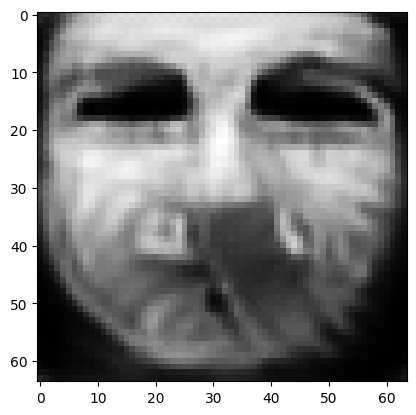

tensor([[3.1334e-03, 5.9007e-06, 4.5516e-03, 3.5561e-05, 5.9322e-04, 6.3697e-03,
         5.3953e-04, 9.8015e-01, 4.7122e-07, 3.3791e-04, 1.4767e-04, 7.4976e-06,
         1.2582e-06, 1.2126e-07, 4.0329e-06, 4.6615e-05, 7.3989e-04, 1.7686e-04,
         5.5989e-05, 1.0370e-04, 9.5069e-07, 1.6297e-05, 1.2019e-08, 4.2382e-04,
         3.5568e-05, 1.6174e-05, 1.1109e-05, 1.6820e-03, 4.8072e-04, 2.2194e-06,
         8.5263e-07, 2.7586e-05, 7.4287e-05, 4.8048e-05, 5.6622e-06, 1.4747e-06,
         6.0060e-06, 6.5730e-05, 8.5982e-05, 1.2909e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02004789188504219
tensor([[3.1260e-03, 5.8905e-06, 4.5392e-03, 3.5463e-05, 5.9165e-04, 6.3579e-03,
         5.3792e-04, 9.8020e-01, 4.6942e-07, 3.3733e-04, 1.4734e-04, 7.4780e-06,
         1.2538e-06, 1.2071e-07, 4.0187e-06, 4.6493e-05, 7.3774e-04, 1.7625e-04,
         5.5838e-05, 1.0343e-04, 9.4726e-07, 1.6248e-05, 1.1969e-08, 4.2267e-04,
         3.5427e-05, 1.6128e-05, 1.1072e-0

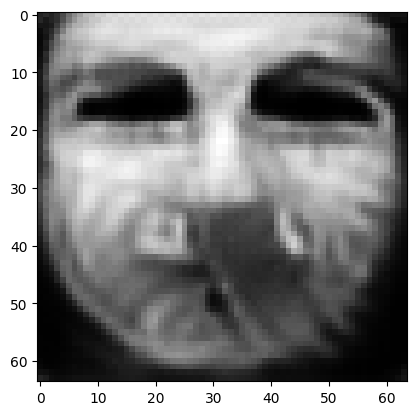

tensor([[3.0978e-03, 5.8502e-06, 4.4930e-03, 3.5107e-05, 5.8569e-04, 6.3114e-03,
         5.3158e-04, 9.8038e-01, 4.6221e-07, 3.3514e-04, 1.4604e-04, 7.3980e-06,
         1.2366e-06, 1.1858e-07, 3.9644e-06, 4.6031e-05, 7.2973e-04, 1.7380e-04,
         5.5279e-05, 1.0236e-04, 9.3397e-07, 1.6057e-05, 1.1774e-08, 4.1841e-04,
         3.4872e-05, 1.5958e-05, 1.0923e-05, 1.6618e-03, 4.7293e-04, 2.1779e-06,
         8.3575e-07, 2.7268e-05, 7.3066e-05, 4.7390e-05, 5.5780e-06, 1.4449e-06,
         5.8952e-06, 6.4787e-05, 8.4554e-05, 1.2697e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01981452852487564
tensor([[3.0910e-03, 5.8398e-06, 4.4824e-03, 3.5019e-05, 5.8435e-04, 6.2996e-03,
         5.3005e-04, 9.8042e-01, 4.6053e-07, 3.3458e-04, 1.4574e-04, 7.3784e-06,
         1.2325e-06, 1.1811e-07, 3.9527e-06, 4.5921e-05, 7.2807e-04, 1.7326e-04,
         5.5149e-05, 1.0211e-04, 9.3093e-07, 1.6013e-05, 1.1730e-08, 4.1749e-04,
         3.4749e-05, 1.5918e-05, 1.0886e-0

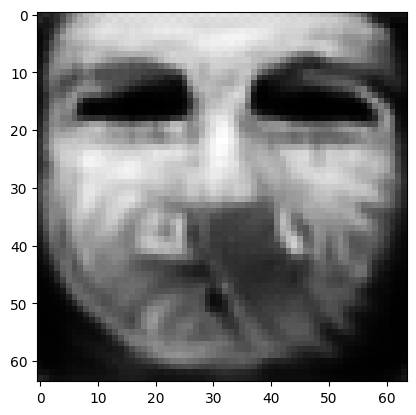

tensor([[3.0663e-03, 5.8000e-06, 4.4406e-03, 3.4681e-05, 5.7919e-04, 6.2554e-03,
         5.2427e-04, 9.8059e-01, 4.5386e-07, 3.3237e-04, 1.4461e-04, 7.3032e-06,
         1.2164e-06, 1.1624e-07, 3.9076e-06, 4.5499e-05, 7.2125e-04, 1.7117e-04,
         5.4627e-05, 1.0110e-04, 9.1927e-07, 1.5843e-05, 1.1553e-08, 4.1396e-04,
         3.4276e-05, 1.5760e-05, 1.0744e-05, 1.6437e-03, 4.6573e-04, 2.1400e-06,
         8.2038e-07, 2.6973e-05, 7.1967e-05, 4.6784e-05, 5.5021e-06, 1.4184e-06,
         5.7975e-06, 6.3914e-05, 8.3230e-05, 1.2491e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019602738320827484
tensor([[3.0601e-03, 5.7921e-06, 4.4296e-03, 3.4600e-05, 5.7792e-04, 6.2447e-03,
         5.2292e-04, 9.8063e-01, 4.5232e-07, 3.3186e-04, 1.4434e-04, 7.2857e-06,
         1.2128e-06, 1.1582e-07, 3.8967e-06, 4.5399e-05, 7.1952e-04, 1.7068e-04,
         5.4506e-05, 1.0087e-04, 9.1650e-07, 1.5800e-05, 1.1512e-08, 4.1305e-04,
         3.4160e-05, 1.5721e-05, 1.0713e-

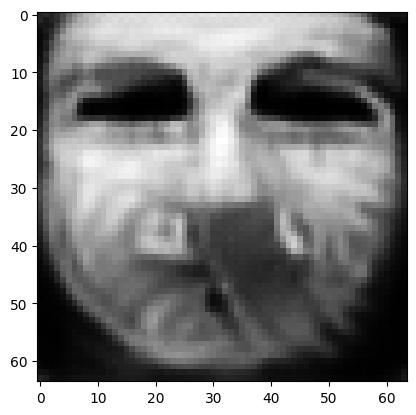

tensor([[3.0370e-03, 5.7615e-06, 4.3880e-03, 3.4286e-05, 5.7310e-04, 6.2049e-03,
         5.1778e-04, 9.8078e-01, 4.4646e-07, 3.2997e-04, 1.4328e-04, 7.2184e-06,
         1.1989e-06, 1.1416e-07, 3.8550e-06, 4.5022e-05, 7.1291e-04, 1.6883e-04,
         5.4037e-05, 1.0001e-04, 9.0590e-07, 1.5641e-05, 1.1356e-08, 4.0965e-04,
         3.3726e-05, 1.5573e-05, 1.0592e-05, 1.6271e-03, 4.5906e-04, 2.1066e-06,
         8.0642e-07, 2.6718e-05, 7.0974e-05, 4.6248e-05, 5.4336e-06, 1.3943e-06,
         5.7043e-06, 6.3114e-05, 8.2031e-05, 1.2308e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01940387859940529
tensor([[3.0311e-03, 5.7549e-06, 4.3781e-03, 3.4210e-05, 5.7191e-04, 6.1956e-03,
         5.1656e-04, 9.8082e-01, 4.4509e-07, 3.2954e-04, 1.4304e-04, 7.2032e-06,
         1.1956e-06, 1.1378e-07, 3.8446e-06, 4.4937e-05, 7.1142e-04, 1.6837e-04,
         5.3931e-05, 9.9802e-05, 9.0346e-07, 1.5603e-05, 1.1320e-08, 4.0885e-04,
         3.3619e-05, 1.5538e-05, 1.0563e-0

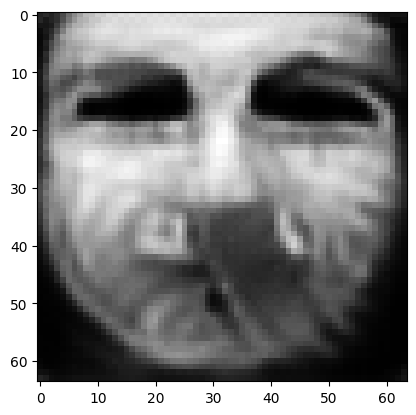

tensor([[3.0096e-03, 5.7255e-06, 4.3415e-03, 3.3928e-05, 5.6724e-04, 6.1581e-03,
         5.1167e-04, 9.8096e-01, 4.3944e-07, 3.2798e-04, 1.4210e-04, 7.1400e-06,
         1.1824e-06, 1.1225e-07, 3.8052e-06, 4.4621e-05, 7.0585e-04, 1.6655e-04,
         5.3542e-05, 9.9011e-05, 8.9369e-07, 1.5456e-05, 1.1174e-08, 4.0595e-04,
         3.3196e-05, 1.5406e-05, 1.0448e-05, 1.6120e-03, 4.5330e-04, 2.0768e-06,
         7.9369e-07, 2.6467e-05, 7.0040e-05, 4.5750e-05, 5.3701e-06, 1.3716e-06,
         5.6188e-06, 6.2386e-05, 8.0952e-05, 1.2143e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019223224371671677
tensor([[3.0039e-03, 5.7185e-06, 4.3329e-03, 3.3859e-05, 5.6605e-04, 6.1491e-03,
         5.1048e-04, 9.8099e-01, 4.3813e-07, 3.2760e-04, 1.4187e-04, 7.1254e-06,
         1.1792e-06, 1.1189e-07, 3.7953e-06, 4.4544e-05, 7.0456e-04, 1.6610e-04,
         5.3449e-05, 9.8819e-05, 8.9134e-07, 1.5419e-05, 1.1140e-08, 4.0520e-04,
         3.3088e-05, 1.5374e-05, 1.0420e-

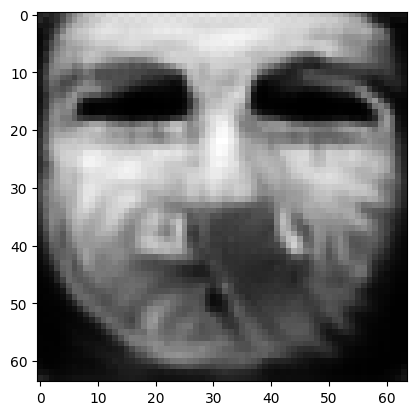

tensor([[2.9828e-03, 5.6918e-06, 4.3002e-03, 3.3598e-05, 5.6159e-04, 6.1153e-03,
         5.0597e-04, 9.8112e-01, 4.3309e-07, 3.2618e-04, 1.4099e-04, 7.0659e-06,
         1.1672e-06, 1.1047e-07, 3.7580e-06, 4.4238e-05, 6.9932e-04, 1.6437e-04,
         5.3089e-05, 9.8099e-05, 8.8216e-07, 1.5278e-05, 1.1004e-08, 4.0226e-04,
         3.2692e-05, 1.5251e-05, 1.0315e-05, 1.5984e-03, 4.4811e-04, 2.0493e-06,
         7.8184e-07, 2.6218e-05, 6.9160e-05, 4.5290e-05, 5.3112e-06, 1.3500e-06,
         5.5393e-06, 6.1698e-05, 7.9978e-05, 1.1996e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01905692182481289
tensor([[2.9779e-03, 5.6840e-06, 4.2927e-03, 3.3535e-05, 5.6052e-04, 6.1070e-03,
         5.0479e-04, 9.8115e-01, 4.3176e-07, 3.2581e-04, 1.4077e-04, 7.0505e-06,
         1.1640e-06, 1.1009e-07, 3.7488e-06, 4.4161e-05, 6.9804e-04, 1.6393e-04,
         5.2998e-05, 9.7910e-05, 8.7988e-07, 1.5244e-05, 1.0969e-08, 4.0155e-04,
         3.2592e-05, 1.5221e-05, 1.0287e-0

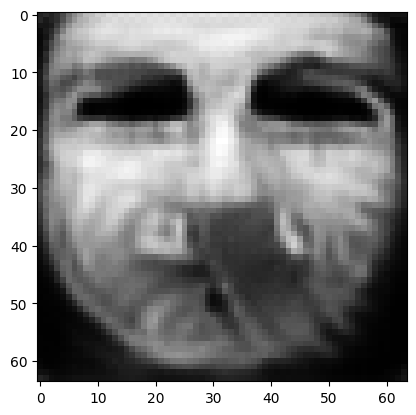

tensor([[2.9587e-03, 5.6591e-06, 4.2620e-03, 3.3293e-05, 5.5640e-04, 6.0743e-03,
         5.0055e-04, 9.8128e-01, 4.2704e-07, 3.2456e-04, 1.3995e-04, 6.9962e-06,
         1.1526e-06, 1.0879e-07, 3.7145e-06, 4.3897e-05, 6.9334e-04, 1.6230e-04,
         5.2679e-05, 9.7245e-05, 8.7159e-07, 1.5118e-05, 1.0847e-08, 3.9899e-04,
         3.2223e-05, 1.5109e-05, 1.0189e-05, 1.5849e-03, 4.4345e-04, 2.0242e-06,
         7.7073e-07, 2.5987e-05, 6.8347e-05, 4.4856e-05, 5.2562e-06, 1.3302e-06,
         5.4658e-06, 6.1062e-05, 7.9074e-05, 1.1858e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018901705741882324
tensor([[2.9541e-03, 5.6524e-06, 4.2544e-03, 3.3235e-05, 5.5537e-04, 6.0659e-03,
         4.9948e-04, 9.8131e-01, 4.2583e-07, 3.2427e-04, 1.3975e-04, 6.9817e-06,
         1.1497e-06, 1.0845e-07, 3.7059e-06, 4.3832e-05, 6.9221e-04, 1.6187e-04,
         5.2603e-05, 9.7079e-05, 8.6947e-07, 1.5086e-05, 1.0815e-08, 3.9838e-04,
         3.2129e-05, 1.5082e-05, 1.0163e-

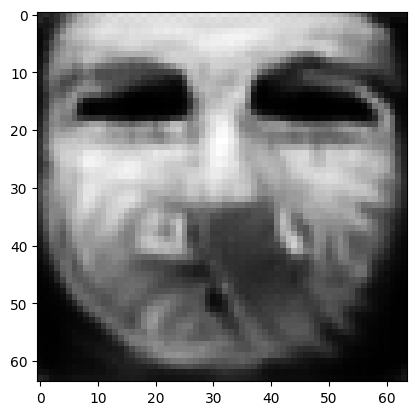

tensor([[2.9363e-03, 5.6248e-06, 4.2260e-03, 3.3012e-05, 5.5153e-04, 6.0316e-03,
         4.9543e-04, 9.8142e-01, 4.2127e-07, 3.2313e-04, 1.3897e-04, 6.9259e-06,
         1.1385e-06, 1.0719e-07, 3.6742e-06, 4.3583e-05, 6.8851e-04, 1.6029e-04,
         5.2307e-05, 9.6456e-05, 8.6129e-07, 1.4965e-05, 1.0697e-08, 3.9622e-04,
         3.1782e-05, 1.4978e-05, 1.0060e-05, 1.5722e-03, 4.3905e-04, 2.0007e-06,
         7.6052e-07, 2.5754e-05, 6.7556e-05, 4.4431e-05, 5.2032e-06, 1.3105e-06,
         5.3940e-06, 6.0478e-05, 7.8237e-05, 1.1724e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018752899020910263
tensor([[2.9320e-03, 5.6183e-06, 4.2191e-03, 3.2955e-05, 5.5060e-04, 6.0235e-03,
         4.9452e-04, 9.8145e-01, 4.2022e-07, 3.2285e-04, 1.3878e-04, 6.9138e-06,
         1.1359e-06, 1.0690e-07, 3.6666e-06, 4.3527e-05, 6.8764e-04, 1.5994e-04,
         5.2235e-05, 9.6312e-05, 8.5944e-07, 1.4937e-05, 1.0670e-08, 3.9572e-04,
         3.1700e-05, 1.4952e-05, 1.0037e-

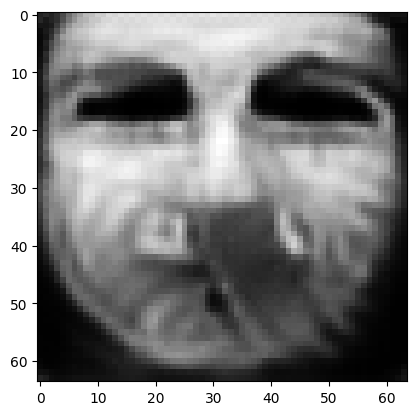

tensor([[2.9154e-03, 5.5909e-06, 4.1930e-03, 3.2744e-05, 5.4703e-04, 5.9909e-03,
         4.9078e-04, 9.8156e-01, 4.1604e-07, 3.2178e-04, 1.3807e-04, 6.8616e-06,
         1.1254e-06, 1.0574e-07, 3.6373e-06, 4.3296e-05, 6.8442e-04, 1.5846e-04,
         5.1961e-05, 9.5729e-05, 8.5191e-07, 1.4824e-05, 1.0562e-08, 3.9383e-04,
         3.1380e-05, 1.4855e-05, 9.9380e-06, 1.5602e-03, 4.3494e-04, 1.9790e-06,
         7.5126e-07, 2.5535e-05, 6.6838e-05, 4.4045e-05, 5.1540e-06, 1.2922e-06,
         5.3280e-06, 5.9946e-05, 7.7483e-05, 1.1600e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018614133819937706
tensor([[2.9116e-03, 5.5837e-06, 4.1867e-03, 3.2693e-05, 5.4617e-04, 5.9825e-03,
         4.8984e-04, 9.8158e-01, 4.1495e-07, 3.2151e-04, 1.3790e-04, 6.8481e-06,
         1.1227e-06, 1.0544e-07, 3.6303e-06, 4.3237e-05, 6.8357e-04, 1.5810e-04,
         5.1894e-05, 9.5580e-05, 8.5006e-07, 1.4797e-05, 1.0533e-08, 3.9339e-04,
         3.1302e-05, 1.4832e-05, 9.9133e-

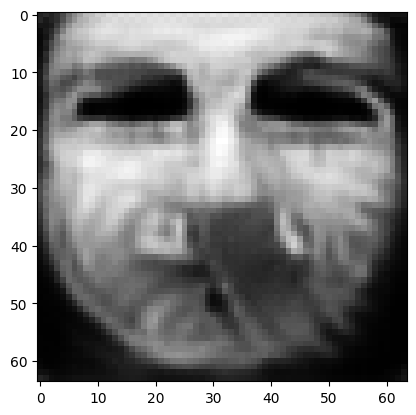

tensor([[2.8959e-03, 5.5531e-06, 4.1625e-03, 3.2488e-05, 5.4269e-04, 5.9501e-03,
         4.8605e-04, 9.8169e-01, 4.1069e-07, 3.2034e-04, 1.3722e-04, 6.7951e-06,
         1.1119e-06, 1.0427e-07, 3.6022e-06, 4.3008e-05, 6.8067e-04, 1.5663e-04,
         5.1623e-05, 9.4969e-05, 8.4275e-07, 1.4690e-05, 1.0425e-08, 3.9175e-04,
         3.0989e-05, 1.4740e-05, 9.8102e-06, 1.5482e-03, 4.3094e-04, 1.9570e-06,
         7.4209e-07, 2.5314e-05, 6.6124e-05, 4.3642e-05, 5.1044e-06, 1.2742e-06,
         5.2642e-06, 5.9419e-05, 7.6721e-05, 1.1471e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018480615690350533
tensor([[2.8920e-03, 5.5464e-06, 4.1563e-03, 3.2438e-05, 5.4184e-04, 5.9426e-03,
         4.8518e-04, 9.8171e-01, 4.0975e-07, 3.2005e-04, 1.3705e-04, 6.7829e-06,
         1.1095e-06, 1.0401e-07, 3.5954e-06, 4.2951e-05, 6.7994e-04, 1.5629e-04,
         5.1559e-05, 9.4830e-05, 8.4101e-07, 1.4664e-05, 1.0401e-08, 3.9131e-04,
         3.0917e-05, 1.4718e-05, 9.7875e-

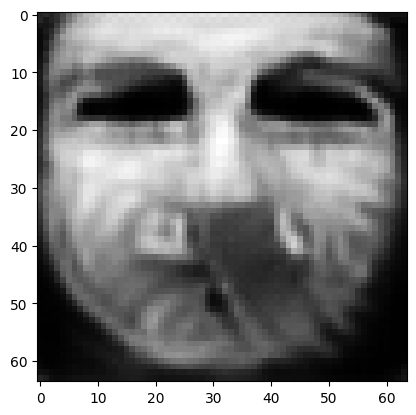

tensor([[2.8766e-03, 5.5164e-06, 4.1337e-03, 3.2239e-05, 5.3849e-04, 5.9120e-03,
         4.8155e-04, 9.8181e-01, 4.0575e-07, 3.1882e-04, 1.3639e-04, 6.7298e-06,
         1.0991e-06, 1.0291e-07, 3.5683e-06, 4.2727e-05, 6.7730e-04, 1.5490e-04,
         5.1294e-05, 9.4237e-05, 8.3387e-07, 1.4557e-05, 1.0295e-08, 3.8973e-04,
         3.0616e-05, 1.4629e-05, 9.6874e-06, 1.5372e-03, 4.2698e-04, 1.9358e-06,
         7.3344e-07, 2.5096e-05, 6.5438e-05, 4.3255e-05, 5.0571e-06, 1.2569e-06,
         5.2033e-06, 5.8902e-05, 7.5994e-05, 1.1349e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01835351623594761
tensor([[2.8731e-03, 5.5088e-06, 4.1282e-03, 3.2192e-05, 5.3768e-04, 5.9047e-03,
         4.8067e-04, 9.8184e-01, 4.0470e-07, 3.1851e-04, 1.3623e-04, 6.7169e-06,
         1.0964e-06, 1.0262e-07, 3.5616e-06, 4.2675e-05, 6.7667e-04, 1.5455e-04,
         5.1229e-05, 9.4082e-05, 8.3214e-07, 1.4531e-05, 1.0268e-08, 3.8936e-04,
         3.0538e-05, 1.4606e-05, 9.6622e-0

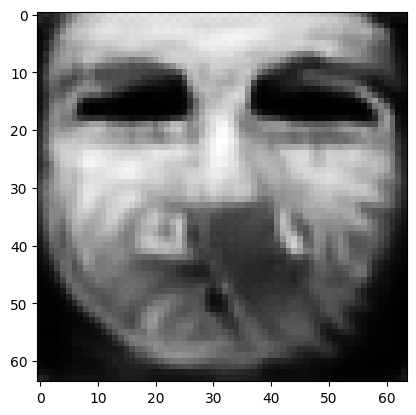

tensor([[2.8579e-03, 5.4806e-06, 4.1074e-03, 3.2005e-05, 5.3442e-04, 5.8759e-03,
         4.7725e-04, 9.8193e-01, 4.0093e-07, 3.1734e-04, 1.3564e-04, 6.6666e-06,
         1.0866e-06, 1.0160e-07, 3.5356e-06, 4.2466e-05, 6.7428e-04, 1.5322e-04,
         5.0988e-05, 9.3517e-05, 8.2534e-07, 1.4428e-05, 1.0168e-08, 3.8788e-04,
         3.0250e-05, 1.4521e-05, 9.5679e-06, 1.5272e-03, 4.2326e-04, 1.9155e-06,
         7.2519e-07, 2.4884e-05, 6.4763e-05, 4.2870e-05, 5.0115e-06, 1.2402e-06,
         5.1449e-06, 5.8400e-05, 7.5279e-05, 1.1233e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018234360963106155
tensor([[2.8541e-03, 5.4739e-06, 4.1024e-03, 3.1961e-05, 5.3361e-04, 5.8692e-03,
         4.7640e-04, 9.8195e-01, 4.0000e-07, 3.1709e-04, 1.3550e-04, 6.6548e-06,
         1.0842e-06, 1.0134e-07, 3.5290e-06, 4.2419e-05, 6.7368e-04, 1.5288e-04,
         5.0932e-05, 9.3377e-05, 8.2369e-07, 1.4403e-05, 1.0143e-08, 3.8750e-04,
         3.0174e-05, 1.4501e-05, 9.5453e-

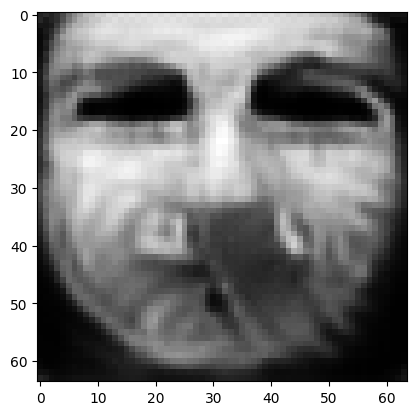

tensor([[2.8408e-03, 5.4490e-06, 4.0827e-03, 3.1784e-05, 5.3068e-04, 5.8442e-03,
         4.7344e-04, 9.8204e-01, 3.9655e-07, 3.1599e-04, 1.3496e-04, 6.6135e-06,
         1.0755e-06, 1.0041e-07, 3.5054e-06, 4.2237e-05, 6.7121e-04, 1.5173e-04,
         5.0696e-05, 9.2863e-05, 8.1780e-07, 1.4313e-05, 1.0052e-08, 3.8612e-04,
         2.9914e-05, 1.4419e-05, 9.4632e-06, 1.5178e-03, 4.1982e-04, 1.8971e-06,
         7.1759e-07, 2.4704e-05, 6.4163e-05, 4.2533e-05, 4.9696e-06, 1.2255e-06,
         5.0919e-06, 5.7941e-05, 7.4623e-05, 1.1129e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018125377595424652
tensor([[2.8376e-03, 5.4436e-06, 4.0779e-03, 3.1741e-05, 5.2997e-04, 5.8386e-03,
         4.7275e-04, 9.8206e-01, 3.9576e-07, 3.1574e-04, 1.3482e-04, 6.6040e-06,
         1.0735e-06, 1.0018e-07, 3.4996e-06, 4.2195e-05, 6.7060e-04, 1.5146e-04,
         5.0640e-05, 9.2744e-05, 8.1640e-07, 1.4292e-05, 1.0031e-08, 3.8575e-04,
         2.9851e-05, 1.4398e-05, 9.4449e-

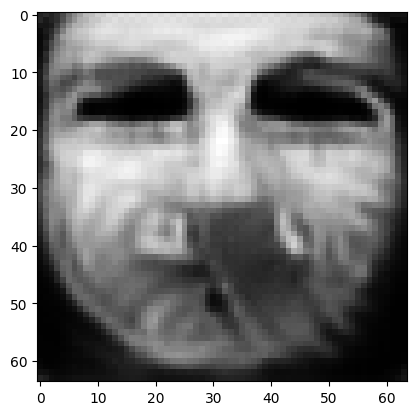

tensor([[2.8250e-03, 5.4222e-06, 4.0599e-03, 3.1577e-05, 5.2717e-04, 5.8161e-03,
         4.7003e-04, 9.8214e-01, 3.9261e-07, 3.1480e-04, 1.3431e-04, 6.5672e-06,
         1.0655e-06, 9.9301e-08, 3.4768e-06, 4.2029e-05, 6.6818e-04, 1.5037e-04,
         5.0427e-05, 9.2275e-05, 8.1097e-07, 1.4207e-05, 9.9472e-09, 3.8436e-04,
         2.9603e-05, 1.4319e-05, 9.3717e-06, 1.5088e-03, 4.1670e-04, 1.8806e-06,
         7.1044e-07, 2.4541e-05, 6.3615e-05, 4.2234e-05, 4.9318e-06, 1.2120e-06,
         5.0420e-06, 5.7518e-05, 7.4039e-05, 1.1039e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018025746569037437
tensor([[2.8221e-03, 5.4164e-06, 4.0556e-03, 3.1536e-05, 5.2650e-04, 5.8105e-03,
         4.6936e-04, 9.8215e-01, 3.9182e-07, 3.1455e-04, 1.3418e-04, 6.5579e-06,
         1.0635e-06, 9.9082e-08, 3.4715e-06, 4.1987e-05, 6.6757e-04, 1.5011e-04,
         5.0372e-05, 9.2157e-05, 8.0967e-07, 1.4186e-05, 9.9261e-09, 3.8403e-04,
         2.9545e-05, 1.4300e-05, 9.3532e-

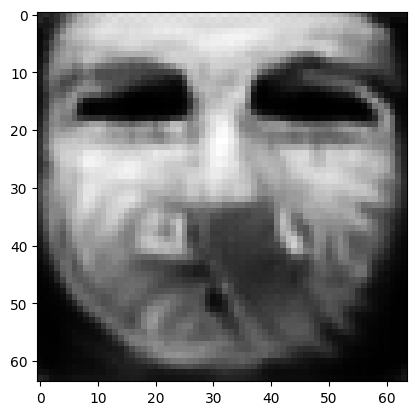

tensor([[2.8100e-03, 5.3954e-06, 4.0389e-03, 3.1377e-05, 5.2374e-04, 5.7897e-03,
         4.6674e-04, 9.8223e-01, 3.8879e-07, 3.1363e-04, 1.3367e-04, 6.5233e-06,
         1.0558e-06, 9.8219e-08, 3.4494e-06, 4.1829e-05, 6.6522e-04, 1.4904e-04,
         5.0165e-05, 9.1697e-05, 8.0447e-07, 1.4105e-05, 9.8445e-09, 3.8263e-04,
         2.9301e-05, 1.4223e-05, 9.2823e-06, 1.4998e-03, 4.1371e-04, 1.8643e-06,
         7.0340e-07, 2.4385e-05, 6.3087e-05, 4.1943e-05, 4.8951e-06, 1.1990e-06,
         4.9946e-06, 5.7103e-05, 7.3477e-05, 1.0952e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017930790781974792
tensor([[2.8070e-03, 5.3900e-06, 4.0349e-03, 3.1339e-05, 5.2307e-04, 5.7844e-03,
         4.6610e-04, 9.8225e-01, 3.8807e-07, 3.1339e-04, 1.3355e-04, 6.5144e-06,
         1.0540e-06, 9.8013e-08, 3.4441e-06, 4.1787e-05, 6.6470e-04, 1.4878e-04,
         5.0114e-05, 9.1591e-05, 8.0312e-07, 1.4085e-05, 9.8250e-09, 3.8230e-04,
         2.9243e-05, 1.4205e-05, 9.2639e-

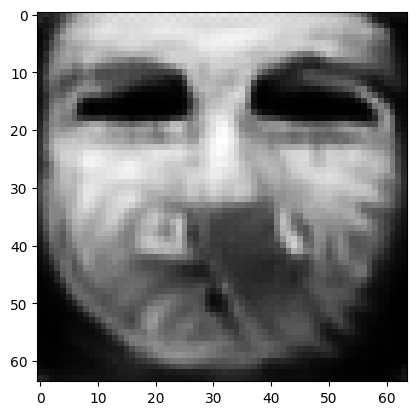

tensor([[2.7957e-03, 5.3703e-06, 4.0191e-03, 3.1194e-05, 5.2056e-04, 5.7642e-03,
         4.6368e-04, 9.8232e-01, 3.8530e-07, 3.1248e-04, 1.3309e-04, 6.4813e-06,
         1.0471e-06, 9.7260e-08, 3.4244e-06, 4.1634e-05, 6.6263e-04, 1.4784e-04,
         4.9923e-05, 9.1173e-05, 7.9817e-07, 1.4007e-05, 9.7514e-09, 3.8104e-04,
         2.9024e-05, 1.4136e-05, 9.1982e-06, 1.4922e-03, 4.1078e-04, 1.8490e-06,
         6.9709e-07, 2.4237e-05, 6.2590e-05, 4.1667e-05, 4.8617e-06, 1.1869e-06,
         4.9515e-06, 5.6725e-05, 7.2947e-05, 1.0868e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01784214936196804
tensor([[2.7928e-03, 5.3661e-06, 4.0152e-03, 3.1160e-05, 5.1993e-04, 5.7594e-03,
         4.6313e-04, 9.8233e-01, 3.8469e-07, 3.1227e-04, 1.3298e-04, 6.4737e-06,
         1.0456e-06, 9.7095e-08, 3.4196e-06, 4.1597e-05, 6.6214e-04, 1.4762e-04,
         4.9880e-05, 9.1083e-05, 7.9695e-07, 1.3989e-05, 9.7350e-09, 3.8072e-04,
         2.8972e-05, 1.4119e-05, 9.1837e-0

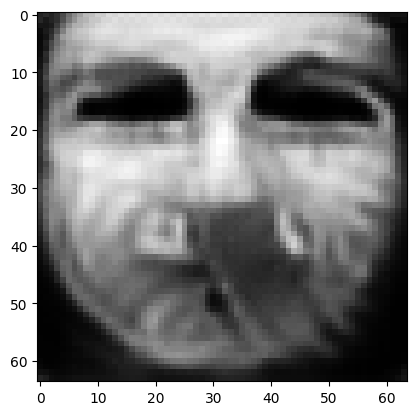

tensor([[2.7817e-03, 5.3485e-06, 4.0001e-03, 3.1026e-05, 5.1756e-04, 5.7414e-03,
         4.6091e-04, 9.8240e-01, 3.8223e-07, 3.1135e-04, 1.3256e-04, 6.4436e-06,
         1.0393e-06, 9.6418e-08, 3.4007e-06, 4.1446e-05, 6.6005e-04, 1.4676e-04,
         4.9697e-05, 9.0699e-05, 7.9225e-07, 1.3914e-05, 9.6678e-09, 3.7937e-04,
         2.8766e-05, 1.4055e-05, 9.1260e-06, 1.4861e-03, 4.0805e-04, 1.8350e-06,
         6.9152e-07, 2.4102e-05, 6.2129e-05, 4.1420e-05, 4.8314e-06, 1.1759e-06,
         4.9124e-06, 5.6383e-05, 7.2432e-05, 1.0793e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017759589478373528
tensor([[2.7790e-03, 5.3444e-06, 3.9965e-03, 3.0994e-05, 5.1698e-04, 5.7372e-03,
         4.6038e-04, 9.8241e-01, 3.8165e-07, 3.1114e-04, 1.3246e-04, 6.4365e-06,
         1.0379e-06, 9.6259e-08, 3.3961e-06, 4.1409e-05, 6.5952e-04, 1.4656e-04,
         4.9653e-05, 9.0608e-05, 7.9111e-07, 1.3897e-05, 9.6517e-09, 3.7904e-04,
         2.8718e-05, 1.4040e-05, 9.1127e-

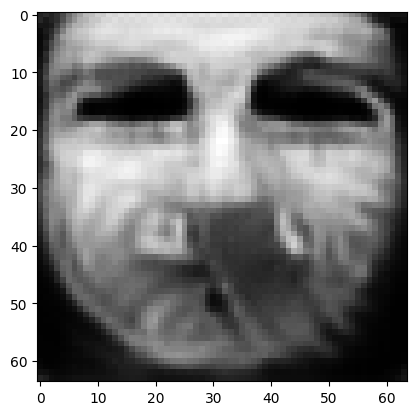

tensor([[2.7686e-03, 5.3281e-06, 3.9820e-03, 3.0867e-05, 5.1479e-04, 5.7209e-03,
         4.5836e-04, 9.8247e-01, 3.7938e-07, 3.1026e-04, 1.3206e-04, 6.4094e-06,
         1.0321e-06, 9.5626e-08, 3.3781e-06, 4.1266e-05, 6.5746e-04, 1.4577e-04,
         4.9474e-05, 9.0250e-05, 7.8670e-07, 1.3827e-05, 9.5893e-09, 3.7773e-04,
         2.8526e-05, 1.3979e-05, 9.0600e-06, 1.4803e-03, 4.0543e-04, 1.8215e-06,
         6.8630e-07, 2.3980e-05, 6.1699e-05, 4.1188e-05, 4.8029e-06, 1.1658e-06,
         4.8763e-06, 5.6063e-05, 7.1940e-05, 1.0723e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017682645469903946
tensor([[2.7659e-03, 5.3248e-06, 3.9784e-03, 3.0838e-05, 5.1426e-04, 5.7168e-03,
         4.5787e-04, 9.8249e-01, 3.7887e-07, 3.1008e-04, 1.3197e-04, 6.4028e-06,
         1.0308e-06, 9.5489e-08, 3.3739e-06, 4.1234e-05, 6.5699e-04, 1.4558e-04,
         4.9435e-05, 9.0171e-05, 7.8565e-07, 1.3811e-05, 9.5749e-09, 3.7743e-04,
         2.8480e-05, 1.3965e-05, 9.0480e-

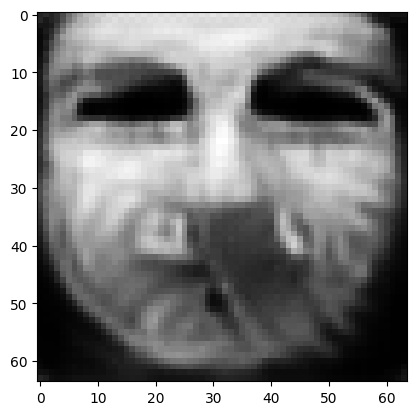

tensor([[2.7563e-03, 5.3098e-06, 3.9647e-03, 3.0723e-05, 5.1221e-04, 5.7012e-03,
         4.5597e-04, 9.8254e-01, 3.7672e-07, 3.0930e-04, 1.3161e-04, 6.3772e-06,
         1.0255e-06, 9.4901e-08, 3.3574e-06, 4.1102e-05, 6.5502e-04, 1.4484e-04,
         4.9269e-05, 8.9840e-05, 7.8154e-07, 1.3746e-05, 9.5147e-09, 3.7620e-04,
         2.8301e-05, 1.3908e-05, 8.9991e-06, 1.4750e-03, 4.0303e-04, 1.8093e-06,
         6.8149e-07, 2.3867e-05, 6.1294e-05, 4.0972e-05, 4.7765e-06, 1.1564e-06,
         4.8422e-06, 5.5767e-05, 7.1480e-05, 1.0658e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01761014573276043
tensor([[2.7538e-03, 5.3061e-06, 3.9615e-03, 3.0695e-05, 5.1171e-04, 5.6975e-03,
         4.5550e-04, 9.8256e-01, 3.7621e-07, 3.0912e-04, 1.3152e-04, 6.3712e-06,
         1.0242e-06, 9.4759e-08, 3.3533e-06, 4.1070e-05, 6.5455e-04, 1.4465e-04,
         4.9230e-05, 8.9761e-05, 7.8055e-07, 1.3730e-05, 9.5005e-09, 3.7590e-04,
         2.8256e-05, 1.3895e-05, 8.9870e-0

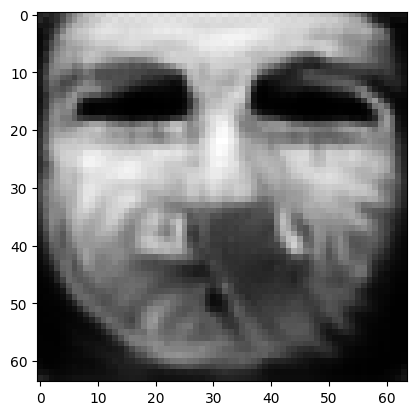

tensor([[2.7448e-03, 5.2922e-06, 3.9487e-03, 3.0586e-05, 5.0979e-04, 5.6831e-03,
         4.5373e-04, 9.8261e-01, 3.7418e-07, 3.0842e-04, 1.3117e-04, 6.3477e-06,
         1.0192e-06, 9.4209e-08, 3.3375e-06, 4.0952e-05, 6.5273e-04, 1.4396e-04,
         4.9076e-05, 8.9454e-05, 7.7673e-07, 1.3669e-05, 9.4443e-09, 3.7475e-04,
         2.8086e-05, 1.3841e-05, 8.9414e-06, 1.4699e-03, 4.0082e-04, 1.7978e-06,
         6.7691e-07, 2.3762e-05, 6.0913e-05, 4.0768e-05, 4.7515e-06, 1.1476e-06,
         4.8104e-06, 5.5486e-05, 7.1051e-05, 1.0596e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01754232496023178
tensor([[2.7426e-03, 5.2890e-06, 3.9457e-03, 3.0561e-05, 5.0934e-04, 5.6798e-03,
         4.5329e-04, 9.8262e-01, 3.7370e-07, 3.0825e-04, 1.3108e-04, 6.3421e-06,
         1.0180e-06, 9.4074e-08, 3.3337e-06, 4.0922e-05, 6.5224e-04, 1.4379e-04,
         4.9038e-05, 8.9376e-05, 7.7581e-07, 1.3655e-05, 9.4309e-09, 3.7444e-04,
         2.8046e-05, 1.3829e-05, 8.9309e-0

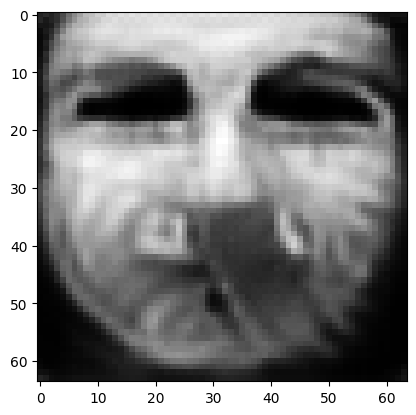

tensor([[2.7340e-03, 5.2765e-06, 3.9341e-03, 3.0463e-05, 5.0757e-04, 5.6670e-03,
         4.5160e-04, 9.8267e-01, 3.7183e-07, 3.0760e-04, 1.3074e-04, 6.3199e-06,
         1.0133e-06, 9.3540e-08, 3.3185e-06, 4.0804e-05, 6.5038e-04, 1.4312e-04,
         4.8890e-05, 8.9074e-05, 7.7215e-07, 1.3597e-05, 9.3775e-09, 3.7322e-04,
         2.7886e-05, 1.3779e-05, 8.8896e-06, 1.4649e-03, 3.9882e-04, 1.7868e-06,
         6.7249e-07, 2.3658e-05, 6.0545e-05, 4.0576e-05, 4.7286e-06, 1.1394e-06,
         4.7812e-06, 5.5216e-05, 7.0652e-05, 1.0542e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01747988909482956
tensor([[2.7319e-03, 5.2738e-06, 3.9312e-03, 3.0439e-05, 5.0713e-04, 5.6640e-03,
         4.5121e-04, 9.8268e-01, 3.7140e-07, 3.0747e-04, 1.3065e-04, 6.3145e-06,
         1.0123e-06, 9.3417e-08, 3.3147e-06, 4.0777e-05, 6.4994e-04, 1.4295e-04,
         4.8856e-05, 8.9008e-05, 7.7126e-07, 1.3583e-05, 9.3649e-09, 3.7293e-04,
         2.7847e-05, 1.3767e-05, 8.8800e-0

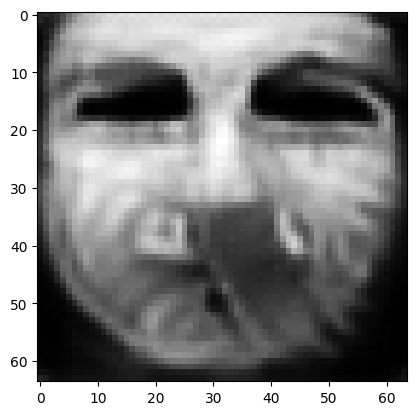

tensor([[2.7238e-03, 5.2620e-06, 3.9203e-03, 3.0346e-05, 5.0546e-04, 5.6521e-03,
         4.4962e-04, 9.8273e-01, 3.6963e-07, 3.0686e-04, 1.3033e-04, 6.2936e-06,
         1.0079e-06, 9.2915e-08, 3.3002e-06, 4.0668e-05, 6.4820e-04, 1.4231e-04,
         4.8718e-05, 8.8724e-05, 7.6782e-07, 1.3528e-05, 9.3146e-09, 3.7178e-04,
         2.7695e-05, 1.3721e-05, 8.8410e-06, 1.4603e-03, 3.9695e-04, 1.7767e-06,
         6.6839e-07, 2.3561e-05, 6.0197e-05, 4.0397e-05, 4.7070e-06, 1.1317e-06,
         4.7533e-06, 5.4962e-05, 7.0285e-05, 1.0492e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01742119900882244
tensor([[2.7219e-03, 5.2590e-06, 3.9177e-03, 3.0324e-05, 5.0506e-04, 5.6491e-03,
         4.4924e-04, 9.8274e-01, 3.6921e-07, 3.0671e-04, 1.3025e-04, 6.2883e-06,
         1.0068e-06, 9.2798e-08, 3.2969e-06, 4.0639e-05, 6.4779e-04, 1.4216e-04,
         4.8684e-05, 8.8659e-05, 7.6697e-07, 1.3515e-05, 9.3023e-09, 3.7151e-04,
         2.7661e-05, 1.3709e-05, 8.8314e-0

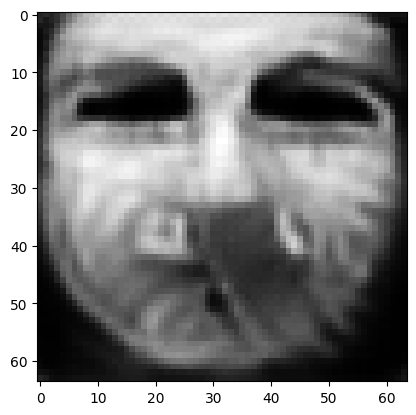

tensor([[2.7141e-03, 5.2482e-06, 3.9072e-03, 3.0235e-05, 5.0346e-04, 5.6383e-03,
         4.4777e-04, 9.8278e-01, 3.6757e-07, 3.0613e-04, 1.2994e-04, 6.2691e-06,
         1.0027e-06, 9.2319e-08, 3.2827e-06, 4.0536e-05, 6.4614e-04, 1.4155e-04,
         4.8553e-05, 8.8394e-05, 7.6371e-07, 1.3462e-05, 9.2554e-09, 3.7042e-04,
         2.7516e-05, 1.3664e-05, 8.7947e-06, 1.4559e-03, 3.9513e-04, 1.7670e-06,
         6.6447e-07, 2.3468e-05, 5.9868e-05, 4.0226e-05, 4.6866e-06, 1.1243e-06,
         4.7269e-06, 5.4720e-05, 6.9938e-05, 1.0444e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01736578531563282
tensor([[2.7122e-03, 5.2454e-06, 3.9048e-03, 3.0213e-05, 5.0307e-04, 5.6355e-03,
         4.4741e-04, 9.8279e-01, 3.6715e-07, 3.0600e-04, 1.2987e-04, 6.2643e-06,
         1.0017e-06, 9.2206e-08, 3.2796e-06, 4.0512e-05, 6.4574e-04, 1.4141e-04,
         4.8521e-05, 8.8330e-05, 7.6294e-07, 1.3450e-05, 9.2436e-09, 3.7017e-04,
         2.7481e-05, 1.3654e-05, 8.7858e-0

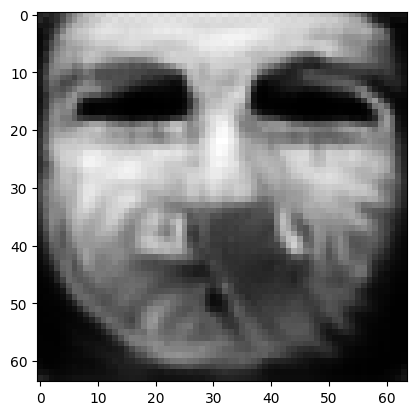

tensor([[2.7050e-03, 5.2350e-06, 3.8951e-03, 3.0129e-05, 5.0156e-04, 5.6250e-03,
         4.4603e-04, 9.8284e-01, 3.6560e-07, 3.0545e-04, 1.2958e-04, 6.2457e-06,
         9.9784e-07, 9.1761e-08, 3.2667e-06, 4.0413e-05, 6.4419e-04, 1.4084e-04,
         4.8398e-05, 8.8083e-05, 7.5988e-07, 1.3401e-05, 9.1993e-09, 3.6916e-04,
         2.7348e-05, 1.3612e-05, 8.7511e-06, 1.4517e-03, 3.9345e-04, 1.7579e-06,
         6.6078e-07, 2.3382e-05, 5.9563e-05, 4.0065e-05, 4.6672e-06, 1.1175e-06,
         4.7021e-06, 5.4492e-05, 6.9610e-05, 1.0398e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017313649877905846
tensor([[2.7033e-03, 5.2326e-06, 3.8927e-03, 3.0108e-05, 5.0120e-04, 5.6223e-03,
         4.4570e-04, 9.8285e-01, 3.6523e-07, 3.0533e-04, 1.2951e-04, 6.2415e-06,
         9.9692e-07, 9.1659e-08, 3.2636e-06, 4.0391e-05, 6.4384e-04, 1.4071e-04,
         4.8370e-05, 8.8023e-05, 7.5914e-07, 1.3389e-05, 9.1889e-09, 3.6894e-04,
         2.7316e-05, 1.3601e-05, 8.7428e-

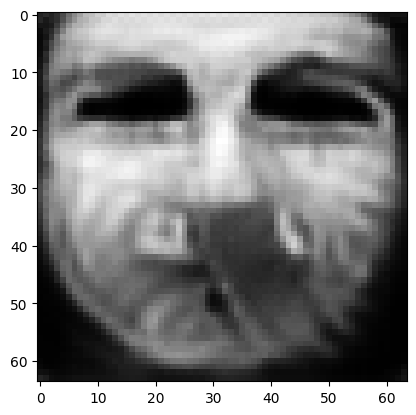

tensor([[2.6961e-03, 5.2194e-06, 3.8841e-03, 3.0028e-05, 4.9973e-04, 5.6109e-03,
         4.4425e-04, 9.8289e-01, 3.6370e-07, 3.0479e-04, 1.2922e-04, 6.2229e-06,
         9.9299e-07, 9.1221e-08, 3.2515e-06, 4.0297e-05, 6.4257e-04, 1.4011e-04,
         4.8249e-05, 8.7769e-05, 7.5613e-07, 1.3345e-05, 9.1474e-09, 3.6816e-04,
         2.7190e-05, 1.3566e-05, 8.7038e-06, 1.4472e-03, 3.9182e-04, 1.7491e-06,
         6.5728e-07, 2.3293e-05, 5.9272e-05, 3.9911e-05, 4.6487e-06, 1.1106e-06,
         4.6788e-06, 5.4274e-05, 6.9326e-05, 1.0354e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017262447625398636
tensor([[2.6943e-03, 5.2163e-06, 3.8820e-03, 3.0008e-05, 4.9938e-04, 5.6079e-03,
         4.4389e-04, 9.8290e-01, 3.6335e-07, 3.0467e-04, 1.2915e-04, 6.2183e-06,
         9.9207e-07, 9.1124e-08, 3.2488e-06, 4.0276e-05, 6.4229e-04, 1.3997e-04,
         4.8222e-05, 8.7711e-05, 7.5542e-07, 1.3335e-05, 9.1382e-09, 3.6801e-04,
         2.7162e-05, 1.3558e-05, 8.6943e-

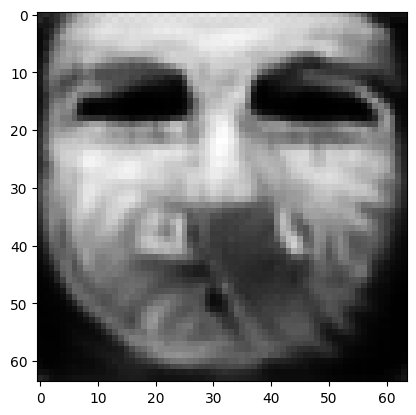

tensor([[2.6873e-03, 5.2036e-06, 3.8741e-03, 2.9933e-05, 4.9800e-04, 5.5965e-03,
         4.4250e-04, 9.8293e-01, 3.6196e-07, 3.0416e-04, 1.2887e-04, 6.2007e-06,
         9.8845e-07, 9.0727e-08, 3.2377e-06, 4.0184e-05, 6.4116e-04, 1.3942e-04,
         4.8109e-05, 8.7476e-05, 7.5256e-07, 1.3294e-05, 9.1010e-09, 3.6731e-04,
         2.7049e-05, 1.3526e-05, 8.6568e-06, 1.4429e-03, 3.9029e-04, 1.7409e-06,
         6.5408e-07, 2.3207e-05, 5.9011e-05, 3.9769e-05, 4.6316e-06, 1.1042e-06,
         4.6574e-06, 5.4073e-05, 6.9078e-05, 1.0311e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017213119193911552
tensor([[2.6856e-03, 5.2006e-06, 3.8721e-03, 2.9915e-05, 4.9767e-04, 5.5939e-03,
         4.4216e-04, 9.8294e-01, 3.6162e-07, 3.0404e-04, 1.2880e-04, 6.1966e-06,
         9.8756e-07, 9.0626e-08, 3.2347e-06, 4.0162e-05, 6.4088e-04, 1.3928e-04,
         4.8080e-05, 8.7416e-05, 7.5184e-07, 1.3283e-05, 9.0921e-09, 3.6713e-04,
         2.7021e-05, 1.3518e-05, 8.6475e-

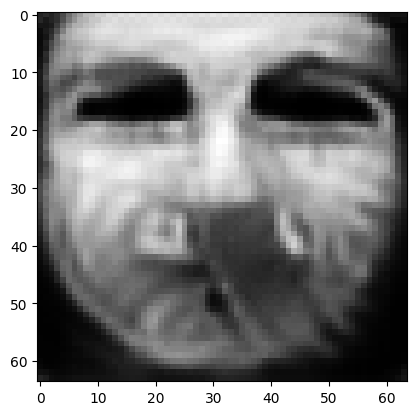

tensor([[2.6790e-03, 5.1885e-06, 3.8648e-03, 2.9846e-05, 4.9639e-04, 5.5828e-03,
         4.4082e-04, 9.8298e-01, 3.6029e-07, 3.0357e-04, 1.2854e-04, 6.1795e-06,
         9.8408e-07, 9.0256e-08, 3.2245e-06, 4.0080e-05, 6.3994e-04, 1.3874e-04,
         4.7979e-05, 8.7190e-05, 7.4916e-07, 1.3245e-05, 9.0572e-09, 3.6655e-04,
         2.6915e-05, 1.3489e-05, 8.6108e-06, 1.4388e-03, 3.8885e-04, 1.7331e-06,
         6.5110e-07, 2.3122e-05, 5.8751e-05, 3.9632e-05, 4.6154e-06, 1.0980e-06,
         4.6372e-06, 5.3882e-05, 6.8849e-05, 1.0270e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01716671511530876
tensor([[2.6773e-03, 5.1857e-06, 3.8631e-03, 2.9829e-05, 4.9607e-04, 5.5801e-03,
         4.4049e-04, 9.8299e-01, 3.5996e-07, 3.0345e-04, 1.2847e-04, 6.1755e-06,
         9.8323e-07, 9.0164e-08, 3.2219e-06, 4.0060e-05, 6.3971e-04, 1.3860e-04,
         4.7954e-05, 8.7133e-05, 7.4850e-07, 1.3235e-05, 9.0487e-09, 3.6640e-04,
         2.6888e-05, 1.3483e-05, 8.6017e-0

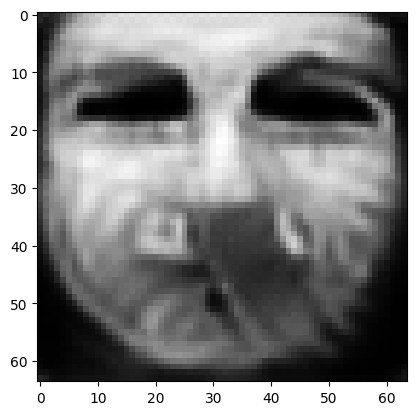

tensor([[2.6711e-03, 5.1746e-06, 3.8563e-03, 2.9763e-05, 4.9488e-04, 5.5701e-03,
         4.3925e-04, 9.8302e-01, 3.5876e-07, 3.0301e-04, 1.2822e-04, 6.1599e-06,
         9.8002e-07, 8.9815e-08, 3.2119e-06, 3.9981e-05, 6.3879e-04, 1.3810e-04,
         4.7856e-05, 8.6920e-05, 7.4596e-07, 1.3199e-05, 9.0169e-09, 3.6582e-04,
         2.6789e-05, 1.3456e-05, 8.5680e-06, 1.4350e-03, 3.8751e-04, 1.7258e-06,
         6.4833e-07, 2.3041e-05, 5.8506e-05, 3.9505e-05, 4.6002e-06, 1.0922e-06,
         4.6182e-06, 5.3702e-05, 6.8637e-05, 1.0233e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017123358324170113
tensor([[2.6696e-03, 5.1717e-06, 3.8547e-03, 2.9748e-05, 4.9459e-04, 5.5677e-03,
         4.3895e-04, 9.8303e-01, 3.5846e-07, 3.0290e-04, 1.2816e-04, 6.1559e-06,
         9.7923e-07, 8.9731e-08, 3.2096e-06, 3.9961e-05, 6.3858e-04, 1.3798e-04,
         4.7832e-05, 8.6870e-05, 7.4534e-07, 1.3191e-05, 9.0090e-09, 3.6569e-04,
         2.6766e-05, 1.3450e-05, 8.5596e-

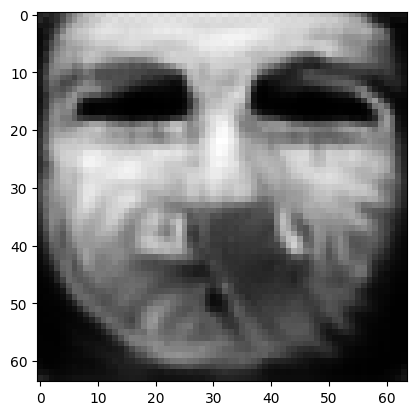

tensor([[2.6631e-03, 5.1607e-06, 3.8484e-03, 2.9683e-05, 4.9336e-04, 5.5585e-03,
         4.3770e-04, 9.8306e-01, 3.5731e-07, 3.0247e-04, 1.2791e-04, 6.1404e-06,
         9.7605e-07, 8.9374e-08, 3.1990e-06, 3.9879e-05, 6.3762e-04, 1.3746e-04,
         4.7734e-05, 8.6664e-05, 7.4278e-07, 1.3154e-05, 8.9774e-09, 3.6503e-04,
         2.6662e-05, 1.3424e-05, 8.5266e-06, 1.4313e-03, 3.8621e-04, 1.7186e-06,
         6.4565e-07, 2.2959e-05, 5.8269e-05, 3.9381e-05, 4.5853e-06, 1.0864e-06,
         4.5995e-06, 5.3527e-05, 6.8433e-05, 1.0198e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01708187349140644
tensor([[2.6616e-03, 5.1577e-06, 3.8468e-03, 2.9667e-05, 4.9306e-04, 5.5560e-03,
         4.3739e-04, 9.8307e-01, 3.5701e-07, 3.0236e-04, 1.2784e-04, 6.1363e-06,
         9.7524e-07, 8.9285e-08, 3.1966e-06, 3.9858e-05, 6.3740e-04, 1.3733e-04,
         4.7709e-05, 8.6612e-05, 7.4214e-07, 1.3145e-05, 8.9694e-09, 3.6488e-04,
         2.6638e-05, 1.3417e-05, 8.5181e-0

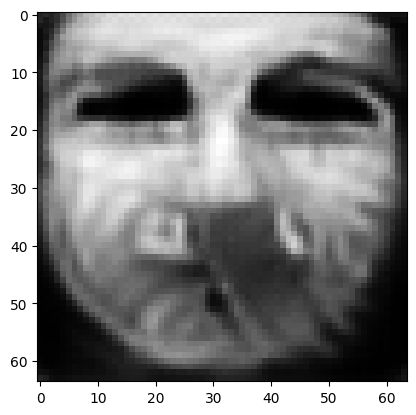

tensor([[2.6555e-03, 5.1471e-06, 3.8408e-03, 2.9606e-05, 4.9191e-04, 5.5472e-03,
         4.3622e-04, 9.8310e-01, 3.5592e-07, 3.0194e-04, 1.2761e-04, 6.1214e-06,
         9.7223e-07, 8.8952e-08, 3.1868e-06, 3.9780e-05, 6.3651e-04, 1.3685e-04,
         4.7617e-05, 8.6419e-05, 7.3973e-07, 1.3111e-05, 8.9392e-09, 3.6427e-04,
         2.6542e-05, 1.3393e-05, 8.4870e-06, 1.4277e-03, 3.8497e-04, 1.7116e-06,
         6.4310e-07, 2.2880e-05, 5.8041e-05, 3.9262e-05, 4.5709e-06, 1.0809e-06,
         4.5816e-06, 5.3360e-05, 6.8234e-05, 1.0164e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017042145133018494
tensor([[2.6540e-03, 5.1445e-06, 3.8394e-03, 2.9592e-05, 4.9162e-04, 5.5452e-03,
         4.3594e-04, 9.8311e-01, 3.5566e-07, 3.0185e-04, 1.2755e-04, 6.1178e-06,
         9.7150e-07, 8.8871e-08, 3.1843e-06, 3.9761e-05, 6.3630e-04, 1.3673e-04,
         4.7595e-05, 8.6372e-05, 7.3913e-07, 1.3103e-05, 8.9318e-09, 3.6411e-04,
         2.6518e-05, 1.3387e-05, 8.4795e-

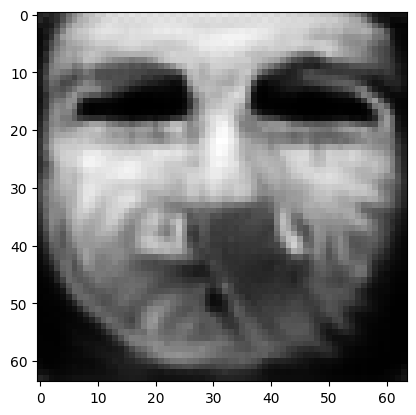

tensor([[2.6482e-03, 5.1343e-06, 3.8338e-03, 2.9535e-05, 4.9054e-04, 5.5368e-03,
         4.3484e-04, 9.8314e-01, 3.5463e-07, 3.0145e-04, 1.2733e-04, 6.1035e-06,
         9.6865e-07, 8.8558e-08, 3.1751e-06, 3.9687e-05, 6.3549e-04, 1.3627e-04,
         4.7507e-05, 8.6187e-05, 7.3684e-07, 1.3070e-05, 8.9034e-09, 3.6354e-04,
         2.6427e-05, 1.3365e-05, 8.4498e-06, 1.4245e-03, 3.8381e-04, 1.7050e-06,
         6.4073e-07, 2.2806e-05, 5.7824e-05, 3.9149e-05, 4.5573e-06, 1.0757e-06,
         4.5648e-06, 5.3204e-05, 6.8044e-05, 1.0132e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01700475998222828
tensor([[2.6468e-03, 5.1317e-06, 3.8325e-03, 2.9521e-05, 4.9028e-04, 5.5347e-03,
         4.3458e-04, 9.8315e-01, 3.5438e-07, 3.0135e-04, 1.2728e-04, 6.1000e-06,
         9.6795e-07, 8.8483e-08, 3.1729e-06, 3.9669e-05, 6.3530e-04, 1.3616e-04,
         4.7486e-05, 8.6143e-05, 7.3630e-07, 1.3062e-05, 8.8965e-09, 3.6341e-04,
         2.6406e-05, 1.3359e-05, 8.4426e-0

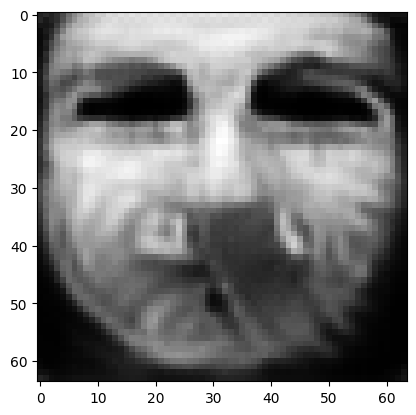

tensor([[2.6413e-03, 5.1222e-06, 3.8271e-03, 2.9467e-05, 4.8925e-04, 5.5268e-03,
         4.3357e-04, 9.8317e-01, 3.5341e-07, 3.0098e-04, 1.2707e-04, 6.0867e-06,
         9.6531e-07, 8.8190e-08, 3.1641e-06, 3.9599e-05, 6.3452e-04, 1.3573e-04,
         4.7404e-05, 8.5973e-05, 7.3412e-07, 1.3031e-05, 8.8698e-09, 3.6286e-04,
         2.6320e-05, 1.3338e-05, 8.4152e-06, 1.4215e-03, 3.8273e-04, 1.6988e-06,
         6.3853e-07, 2.2736e-05, 5.7623e-05, 3.9044e-05, 4.5445e-06, 1.0709e-06,
         4.5491e-06, 5.3058e-05, 6.7869e-05, 1.0102e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016969481483101845
tensor([[2.6400e-03, 5.1198e-06, 3.8258e-03, 2.9454e-05, 4.8900e-04, 5.5249e-03,
         4.3332e-04, 9.8318e-01, 3.5317e-07, 3.0089e-04, 1.2702e-04, 6.0833e-06,
         9.6465e-07, 8.8118e-08, 3.1620e-06, 3.9581e-05, 6.3434e-04, 1.3563e-04,
         4.7383e-05, 8.5930e-05, 7.3358e-07, 1.3024e-05, 8.8631e-09, 3.6273e-04,
         2.6299e-05, 1.3333e-05, 8.4083e-

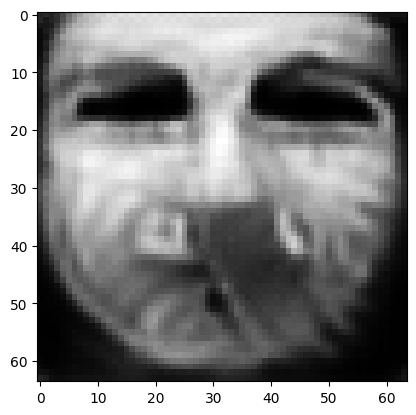

tensor([[2.6348e-03, 5.1106e-06, 3.8207e-03, 2.9403e-05, 4.8803e-04, 5.5175e-03,
         4.3238e-04, 9.8321e-01, 3.5227e-07, 3.0054e-04, 1.2683e-04, 6.0704e-06,
         9.6217e-07, 8.7842e-08, 3.1537e-06, 3.9513e-05, 6.3363e-04, 1.3522e-04,
         4.7304e-05, 8.5770e-05, 7.3151e-07, 1.2994e-05, 8.8380e-09, 3.6220e-04,
         2.6219e-05, 1.3312e-05, 8.3824e-06, 1.4186e-03, 3.8169e-04, 1.6928e-06,
         6.3647e-07, 2.2670e-05, 5.7431e-05, 3.8944e-05, 4.5324e-06, 1.0663e-06,
         4.5343e-06, 5.2920e-05, 6.7703e-05, 1.0074e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01693643070757389
tensor([[2.6336e-03, 5.1083e-06, 3.8196e-03, 2.9391e-05, 4.8780e-04, 5.5156e-03,
         4.3214e-04, 9.8321e-01, 3.5204e-07, 3.0045e-04, 1.2678e-04, 6.0674e-06,
         9.6156e-07, 8.7775e-08, 3.1517e-06, 3.9497e-05, 6.3345e-04, 1.3513e-04,
         4.7284e-05, 8.5731e-05, 7.3103e-07, 1.2987e-05, 8.8319e-09, 3.6208e-04,
         2.6200e-05, 1.3307e-05, 8.3761e-0

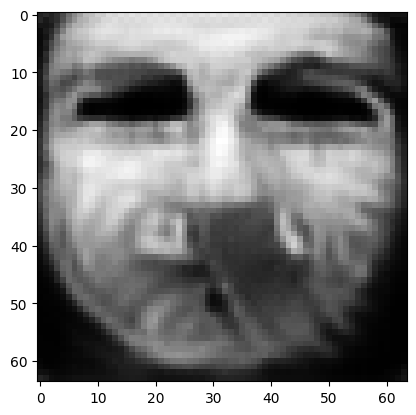

tensor([[2.6290e-03, 5.1000e-06, 3.8146e-03, 2.9340e-05, 4.8692e-04, 5.5088e-03,
         4.3130e-04, 9.8324e-01, 3.5123e-07, 3.0011e-04, 1.2659e-04, 6.0566e-06,
         9.5933e-07, 8.7528e-08, 3.1443e-06, 3.9435e-05, 6.3273e-04, 1.3479e-04,
         4.7207e-05, 8.5589e-05, 7.2918e-07, 1.2961e-05, 8.8095e-09, 3.6159e-04,
         2.6130e-05, 1.3287e-05, 8.3531e-06, 1.4158e-03, 3.8070e-04, 1.6874e-06,
         6.3454e-07, 2.2613e-05, 5.7264e-05, 3.8857e-05, 4.5213e-06, 1.0622e-06,
         4.5209e-06, 5.2794e-05, 6.7548e-05, 1.0047e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016905251890420914
tensor([[2.6279e-03, 5.0980e-06, 3.8134e-03, 2.9327e-05, 4.8671e-04, 5.5071e-03,
         4.3110e-04, 9.8324e-01, 3.5103e-07, 3.0003e-04, 1.2655e-04, 6.0540e-06,
         9.5881e-07, 8.7470e-08, 3.1426e-06, 3.9420e-05, 6.3255e-04, 1.3471e-04,
         4.7188e-05, 8.5556e-05, 7.2874e-07, 1.2955e-05, 8.8040e-09, 3.6148e-04,
         2.6113e-05, 1.3282e-05, 8.3477e-

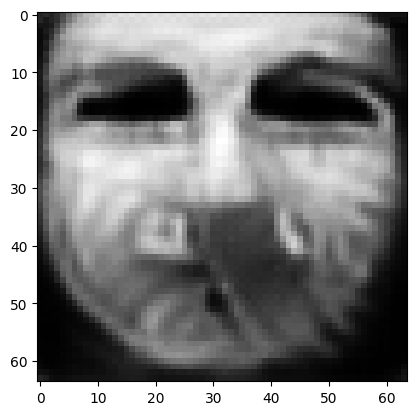

tensor([[2.6236e-03, 5.0902e-06, 3.8088e-03, 2.9278e-05, 4.8589e-04, 5.5006e-03,
         4.3030e-04, 9.8327e-01, 3.5026e-07, 2.9971e-04, 1.2636e-04, 6.0441e-06,
         9.5671e-07, 8.7238e-08, 3.1358e-06, 3.9363e-05, 6.3188e-04, 1.3439e-04,
         4.7114e-05, 8.5422e-05, 7.2703e-07, 1.2931e-05, 8.7831e-09, 3.6103e-04,
         2.6047e-05, 1.3262e-05, 8.3261e-06, 1.4131e-03, 3.7976e-04, 1.6823e-06,
         6.3272e-07, 2.2562e-05, 5.7112e-05, 3.8778e-05, 4.5111e-06, 1.0584e-06,
         4.5084e-06, 5.2678e-05, 6.7401e-05, 1.0022e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016876183450222015
tensor([[2.6226e-03, 5.0884e-06, 3.8077e-03, 2.9267e-05, 4.8568e-04, 5.4992e-03,
         4.3010e-04, 9.8327e-01, 3.5008e-07, 2.9963e-04, 1.2632e-04, 6.0415e-06,
         9.5621e-07, 8.7181e-08, 3.1341e-06, 3.9349e-05, 6.3171e-04, 1.3431e-04,
         4.7097e-05, 8.5390e-05, 7.2660e-07, 1.2924e-05, 8.7778e-09, 3.6091e-04,
         2.6031e-05, 1.3257e-05, 8.3210e-

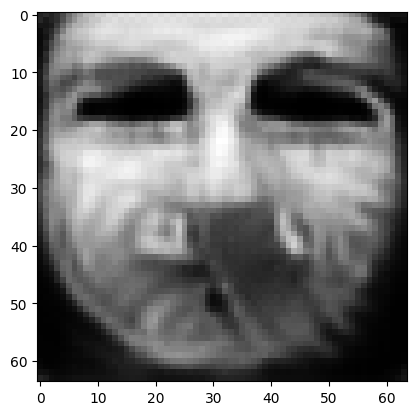

tensor([[2.6186e-03, 5.0809e-06, 3.8033e-03, 2.9221e-05, 4.8490e-04, 5.4930e-03,
         4.2934e-04, 9.8329e-01, 3.4934e-07, 2.9933e-04, 1.2615e-04, 6.0321e-06,
         9.5422e-07, 8.6962e-08, 3.1276e-06, 3.9294e-05, 6.3107e-04, 1.3401e-04,
         4.7027e-05, 8.5264e-05, 7.2498e-07, 1.2901e-05, 8.7577e-09, 3.6049e-04,
         2.5968e-05, 1.3239e-05, 8.3005e-06, 1.4106e-03, 3.7888e-04, 1.6775e-06,
         6.3100e-07, 2.2512e-05, 5.6966e-05, 3.8701e-05, 4.5014e-06, 1.0548e-06,
         4.4965e-06, 5.2567e-05, 6.7262e-05, 9.9988e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016848521307110786
tensor([[2.6176e-03, 5.0792e-06, 3.8022e-03, 2.9210e-05, 4.8471e-04, 5.4915e-03,
         4.2916e-04, 9.8330e-01, 3.4917e-07, 2.9926e-04, 1.2611e-04, 6.0297e-06,
         9.5375e-07, 8.6908e-08, 3.1260e-06, 3.9281e-05, 6.3091e-04, 1.3394e-04,
         4.7011e-05, 8.5234e-05, 7.2458e-07, 1.2896e-05, 8.7528e-09, 3.6038e-04,
         2.5953e-05, 1.3234e-05, 8.2957e-

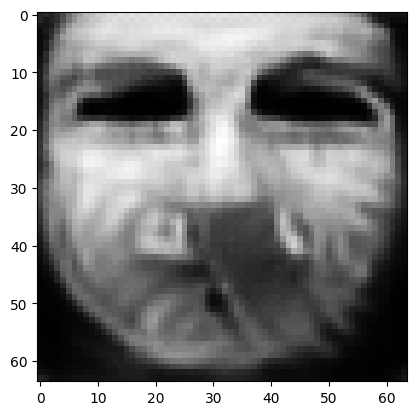

tensor([[2.6137e-03, 5.0725e-06, 3.7981e-03, 2.9167e-05, 4.8396e-04, 5.4859e-03,
         4.2845e-04, 9.8332e-01, 3.4848e-07, 2.9898e-04, 1.2595e-04, 6.0207e-06,
         9.5189e-07, 8.6698e-08, 3.1197e-06, 3.9229e-05, 6.3029e-04, 1.3365e-04,
         4.6946e-05, 8.5115e-05, 7.2302e-07, 1.2873e-05, 8.7337e-09, 3.5996e-04,
         2.5892e-05, 1.3216e-05, 8.2767e-06, 1.4082e-03, 3.7805e-04, 1.6729e-06,
         6.2937e-07, 2.2466e-05, 5.6827e-05, 3.8629e-05, 4.4921e-06, 1.0513e-06,
         4.4852e-06, 5.2462e-05, 6.7130e-05, 9.9770e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016822732985019684
tensor([[2.6128e-03, 5.0708e-06, 3.7971e-03, 2.9156e-05, 4.8378e-04, 5.4845e-03,
         4.2828e-04, 9.8332e-01, 3.4832e-07, 2.9891e-04, 1.2591e-04, 6.0185e-06,
         9.5145e-07, 8.6648e-08, 3.1182e-06, 3.9216e-05, 6.3013e-04, 1.3358e-04,
         4.6930e-05, 8.5087e-05, 7.2264e-07, 1.2868e-05, 8.7290e-09, 3.5985e-04,
         2.5878e-05, 1.3212e-05, 8.2721e-

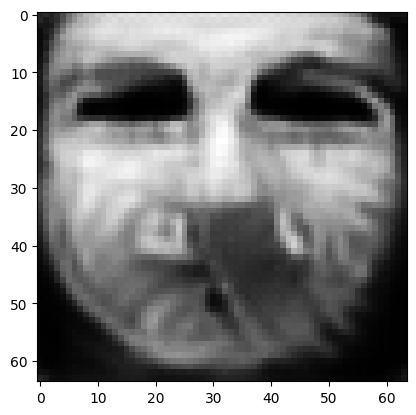

tensor([[2.6091e-03, 5.0644e-06, 3.7931e-03, 2.9115e-05, 4.8308e-04, 5.4791e-03,
         4.2761e-04, 9.8334e-01, 3.4766e-07, 2.9865e-04, 1.2576e-04, 6.0099e-06,
         9.4970e-07, 8.6451e-08, 3.1124e-06, 3.9168e-05, 6.2955e-04, 1.3331e-04,
         4.6869e-05, 8.4976e-05, 7.2118e-07, 1.2847e-05, 8.7111e-09, 3.5946e-04,
         2.5821e-05, 1.3195e-05, 8.2541e-06, 1.4060e-03, 3.7727e-04, 1.6686e-06,
         6.2783e-07, 2.2422e-05, 5.6695e-05, 3.8561e-05, 4.4834e-06, 1.0481e-06,
         4.4745e-06, 5.2362e-05, 6.7006e-05, 9.9563e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016798116266727448
tensor([[2.6082e-03, 5.0629e-06, 3.7922e-03, 2.9105e-05, 4.8290e-04, 5.4779e-03,
         4.2745e-04, 9.8335e-01, 3.4751e-07, 2.9859e-04, 1.2572e-04, 6.0079e-06,
         9.4927e-07, 8.6401e-08, 3.1109e-06, 3.9156e-05, 6.2940e-04, 1.3325e-04,
         4.6854e-05, 8.4948e-05, 7.2082e-07, 1.2842e-05, 8.7067e-09, 3.5936e-04,
         2.5806e-05, 1.3191e-05, 8.2498e-

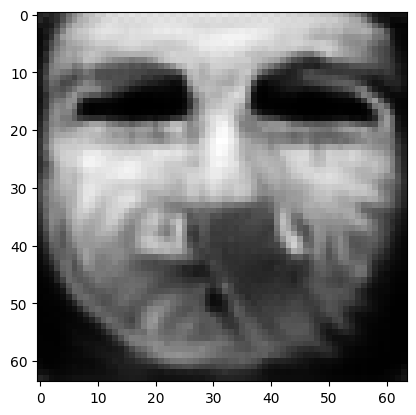

tensor([[2.6048e-03, 5.0567e-06, 3.7884e-03, 2.9067e-05, 4.8224e-04, 5.4726e-03,
         4.2681e-04, 9.8336e-01, 3.4689e-07, 2.9834e-04, 1.2558e-04, 5.9997e-06,
         9.4761e-07, 8.6217e-08, 3.1054e-06, 3.9110e-05, 6.2886e-04, 1.3299e-04,
         4.6796e-05, 8.4842e-05, 7.1943e-07, 1.2822e-05, 8.6897e-09, 3.5899e-04,
         2.5753e-05, 1.3175e-05, 8.2327e-06, 1.4039e-03, 3.7652e-04, 1.6646e-06,
         6.2638e-07, 2.2380e-05, 5.6571e-05, 3.8496e-05, 4.4752e-06, 1.0450e-06,
         4.4643e-06, 5.2267e-05, 6.6888e-05, 9.9367e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01677490584552288
tensor([[2.6039e-03, 5.0552e-06, 3.7875e-03, 2.9057e-05, 4.8207e-04, 5.4713e-03,
         4.2666e-04, 9.8337e-01, 3.4674e-07, 2.9828e-04, 1.2555e-04, 5.9978e-06,
         9.4721e-07, 8.6173e-08, 3.1040e-06, 3.9099e-05, 6.2873e-04, 1.3293e-04,
         4.6782e-05, 8.4817e-05, 7.1910e-07, 1.2817e-05, 8.6855e-09, 3.5890e-04,
         2.5740e-05, 1.3171e-05, 8.2286e-0

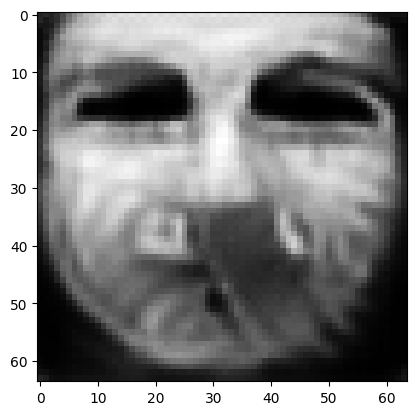

tensor([[2.6007e-03, 5.0494e-06, 3.7839e-03, 2.9021e-05, 4.8145e-04, 5.4664e-03,
         4.2606e-04, 9.8339e-01, 3.4615e-07, 2.9803e-04, 1.2541e-04, 5.9900e-06,
         9.4565e-07, 8.5998e-08, 3.0989e-06, 3.9055e-05, 6.2821e-04, 1.3269e-04,
         4.6727e-05, 8.4715e-05, 7.1779e-07, 1.2798e-05, 8.6694e-09, 3.5856e-04,
         2.5690e-05, 1.3156e-05, 8.2124e-06, 1.4019e-03, 3.7581e-04, 1.6608e-06,
         6.2501e-07, 2.2340e-05, 5.6453e-05, 3.8435e-05, 4.4674e-06, 1.0421e-06,
         4.4548e-06, 5.2177e-05, 6.6777e-05, 9.9177e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01675286702811718
tensor([[2.6000e-03, 5.0480e-06, 3.7831e-03, 2.9012e-05, 4.8130e-04, 5.4652e-03,
         4.2592e-04, 9.8339e-01, 3.4601e-07, 2.9798e-04, 1.2538e-04, 5.9881e-06,
         9.4527e-07, 8.5955e-08, 3.0976e-06, 3.9044e-05, 6.2809e-04, 1.3264e-04,
         4.6714e-05, 8.4691e-05, 7.1747e-07, 1.2794e-05, 8.6655e-09, 3.5847e-04,
         2.5678e-05, 1.3152e-05, 8.2085e-0

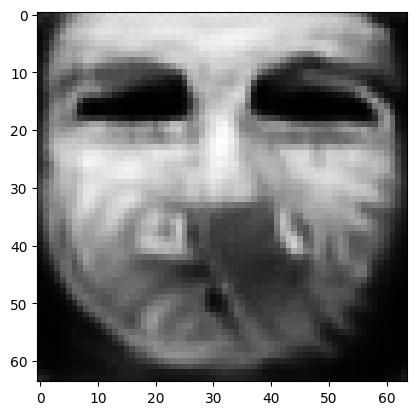

tensor([[2.5970e-03, 5.0426e-06, 3.7796e-03, 2.8978e-05, 4.8072e-04, 5.4605e-03,
         4.2535e-04, 9.8341e-01, 3.4547e-07, 2.9774e-04, 1.2525e-04, 5.9807e-06,
         9.4379e-07, 8.5792e-08, 3.0928e-06, 3.9002e-05, 6.2759e-04, 1.3241e-04,
         4.6661e-05, 8.4596e-05, 7.1623e-07, 1.2776e-05, 8.6504e-09, 3.5815e-04,
         2.5632e-05, 1.3138e-05, 8.1933e-06, 1.4000e-03, 3.7513e-04, 1.6572e-06,
         6.2373e-07, 2.2303e-05, 5.6343e-05, 3.8377e-05, 4.4601e-06, 1.0394e-06,
         4.4458e-06, 5.2093e-05, 6.6672e-05, 9.8997e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01673164777457714
tensor([[2.5963e-03, 5.0413e-06, 3.7788e-03, 2.8970e-05, 4.8059e-04, 5.4594e-03,
         4.2522e-04, 9.8341e-01, 3.4534e-07, 2.9769e-04, 1.2522e-04, 5.9788e-06,
         9.4344e-07, 8.5753e-08, 3.0917e-06, 3.8992e-05, 6.2748e-04, 1.3236e-04,
         4.6649e-05, 8.4574e-05, 7.1594e-07, 1.2772e-05, 8.6468e-09, 3.5808e-04,
         2.5622e-05, 1.3135e-05, 8.1896e-0

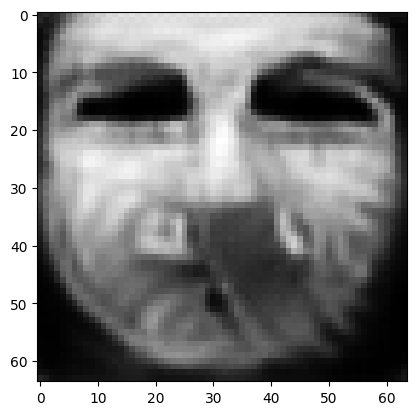

tensor([[2.5937e-03, 5.0363e-06, 3.7753e-03, 2.8939e-05, 4.8009e-04, 5.4550e-03,
         4.2471e-04, 9.8343e-01, 3.4484e-07, 2.9747e-04, 1.2510e-04, 5.9719e-06,
         9.4209e-07, 8.5605e-08, 3.0875e-06, 3.8953e-05, 6.2701e-04, 1.3216e-04,
         4.6597e-05, 8.4487e-05, 7.1481e-07, 1.2756e-05, 8.6330e-09, 3.5780e-04,
         2.5582e-05, 1.3122e-05, 8.1756e-06, 1.3983e-03, 3.7446e-04, 1.6539e-06,
         6.2255e-07, 2.2270e-05, 5.6240e-05, 3.8323e-05, 4.4534e-06, 1.0370e-06,
         4.4374e-06, 5.2016e-05, 6.6575e-05, 9.8821e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016712186858057976
tensor([[2.5931e-03, 5.0351e-06, 3.7745e-03, 2.8932e-05, 4.7997e-04, 5.4538e-03,
         4.2459e-04, 9.8343e-01, 3.4472e-07, 2.9741e-04, 1.2507e-04, 5.9702e-06,
         9.4177e-07, 8.5570e-08, 3.0865e-06, 3.8943e-05, 6.2689e-04, 1.3212e-04,
         4.6585e-05, 8.4466e-05, 7.1455e-07, 1.2752e-05, 8.6297e-09, 3.5773e-04,
         2.5573e-05, 1.3119e-05, 8.1723e-

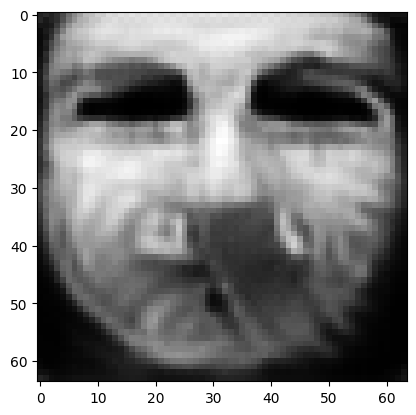

tensor([[2.5909e-03, 5.0306e-06, 3.7711e-03, 2.8903e-05, 4.7952e-04, 5.4495e-03,
         4.2413e-04, 9.8344e-01, 3.4425e-07, 2.9721e-04, 1.2496e-04, 5.9638e-06,
         9.4052e-07, 8.5435e-08, 3.0828e-06, 3.8907e-05, 6.2643e-04, 1.3195e-04,
         4.6536e-05, 8.4387e-05, 7.1353e-07, 1.2738e-05, 8.6169e-09, 3.5749e-04,
         2.5539e-05, 1.3106e-05, 8.1594e-06, 1.3967e-03, 3.7382e-04, 1.6509e-06,
         6.2146e-07, 2.2240e-05, 5.6148e-05, 3.8274e-05, 4.4472e-06, 1.0348e-06,
         4.4298e-06, 5.1947e-05, 6.6483e-05, 9.8649e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016693899407982826
tensor([[2.5904e-03, 5.0295e-06, 3.7703e-03, 2.8896e-05, 4.7941e-04, 5.4485e-03,
         4.2401e-04, 9.8345e-01, 3.4413e-07, 2.9716e-04, 1.2493e-04, 5.9622e-06,
         9.4021e-07, 8.5401e-08, 3.0819e-06, 3.8898e-05, 6.2631e-04, 1.3191e-04,
         4.6524e-05, 8.4367e-05, 7.1327e-07, 1.2734e-05, 8.6138e-09, 3.5742e-04,
         2.5530e-05, 1.3103e-05, 8.1563e-

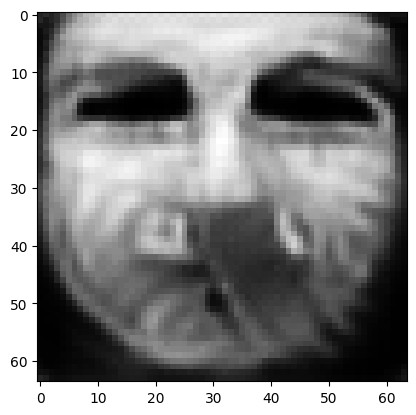

tensor([[2.5883e-03, 5.0253e-06, 3.7671e-03, 2.8868e-05, 4.7899e-04, 5.4445e-03,
         4.2357e-04, 9.8346e-01, 3.4369e-07, 2.9696e-04, 1.2483e-04, 5.9563e-06,
         9.3905e-07, 8.5273e-08, 3.0784e-06, 3.8864e-05, 6.2587e-04, 1.3174e-04,
         4.6478e-05, 8.4291e-05, 7.1231e-07, 1.2721e-05, 8.6018e-09, 3.5718e-04,
         2.5497e-05, 1.3091e-05, 8.1444e-06, 1.3951e-03, 3.7321e-04, 1.6480e-06,
         6.2042e-07, 2.2212e-05, 5.6060e-05, 3.8229e-05, 4.4413e-06, 1.0327e-06,
         4.4225e-06, 5.1880e-05, 6.6396e-05, 9.8488e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01667654700577259
tensor([[2.5878e-03, 5.0243e-06, 3.7663e-03, 2.8862e-05, 4.7888e-04, 5.4436e-03,
         4.2347e-04, 9.8346e-01, 3.4358e-07, 2.9691e-04, 1.2480e-04, 5.9548e-06,
         9.3876e-07, 8.5241e-08, 3.0775e-06, 3.8856e-05, 6.2576e-04, 1.3170e-04,
         4.6467e-05, 8.4273e-05, 7.1207e-07, 1.2717e-05, 8.5988e-09, 3.5712e-04,
         2.5488e-05, 1.3088e-05, 8.1415e-0

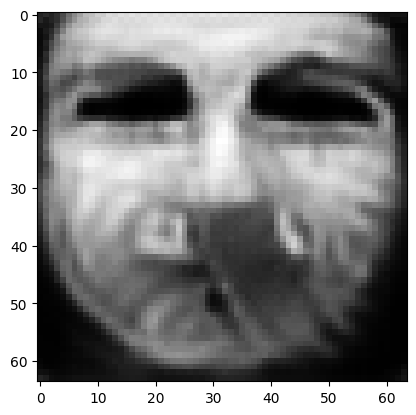

tensor([[2.5858e-03, 5.0203e-06, 3.7633e-03, 2.8836e-05, 4.7848e-04, 5.4397e-03,
         4.2305e-04, 9.8348e-01, 3.4316e-07, 2.9673e-04, 1.2470e-04, 5.9492e-06,
         9.3765e-07, 8.5120e-08, 3.0742e-06, 3.8824e-05, 6.2535e-04, 1.3155e-04,
         4.6423e-05, 8.4201e-05, 7.1115e-07, 1.2705e-05, 8.5873e-09, 3.5689e-04,
         2.5457e-05, 1.3077e-05, 8.1301e-06, 1.3936e-03, 3.7264e-04, 1.6452e-06,
         6.1944e-07, 2.2186e-05, 5.5977e-05, 3.8185e-05, 4.4358e-06, 1.0307e-06,
         4.4156e-06, 5.1817e-05, 6.6314e-05, 9.8335e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016659900546073914
tensor([[2.5853e-03, 5.0194e-06, 3.7626e-03, 2.8829e-05, 4.7838e-04, 5.4388e-03,
         4.2296e-04, 9.8348e-01, 3.4306e-07, 2.9669e-04, 1.2467e-04, 5.9478e-06,
         9.3739e-07, 8.5091e-08, 3.0733e-06, 3.8816e-05, 6.2524e-04, 1.3151e-04,
         4.6413e-05, 8.4184e-05, 7.1093e-07, 1.2701e-05, 8.5846e-09, 3.5683e-04,
         2.5449e-05, 1.3074e-05, 8.1275e-

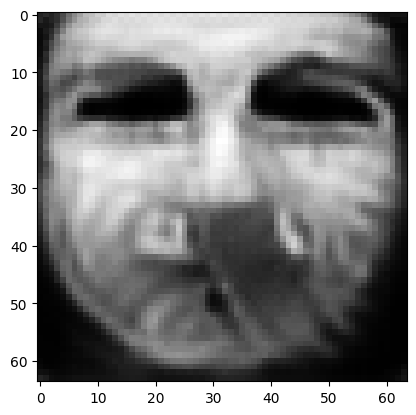

tensor([[2.5834e-03, 5.0157e-06, 3.7597e-03, 2.8804e-05, 4.7799e-04, 5.4351e-03,
         4.2257e-04, 9.8349e-01, 3.4265e-07, 2.9651e-04, 1.2458e-04, 5.9425e-06,
         9.3634e-07, 8.4973e-08, 3.0702e-06, 3.8785e-05, 6.2484e-04, 1.3137e-04,
         4.6371e-05, 8.4115e-05, 7.1005e-07, 1.2689e-05, 8.5738e-09, 3.5662e-04,
         2.5420e-05, 1.3064e-05, 8.1167e-06, 1.3922e-03, 3.7210e-04, 1.6427e-06,
         6.1852e-07, 2.2161e-05, 5.5898e-05, 3.8145e-05, 4.4305e-06, 1.0288e-06,
         4.4090e-06, 5.1757e-05, 6.6237e-05, 9.8191e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016644541174173355
tensor([[2.5830e-03, 5.0147e-06, 3.7590e-03, 2.8798e-05, 4.7790e-04, 5.4342e-03,
         4.2247e-04, 9.8350e-01, 3.4256e-07, 2.9647e-04, 1.2456e-04, 5.9411e-06,
         9.3608e-07, 8.4946e-08, 3.0695e-06, 3.8777e-05, 6.2475e-04, 1.3133e-04,
         4.6361e-05, 8.4098e-05, 7.0985e-07, 1.2687e-05, 8.5713e-09, 3.5657e-04,
         2.5414e-05, 1.3061e-05, 8.1140e-

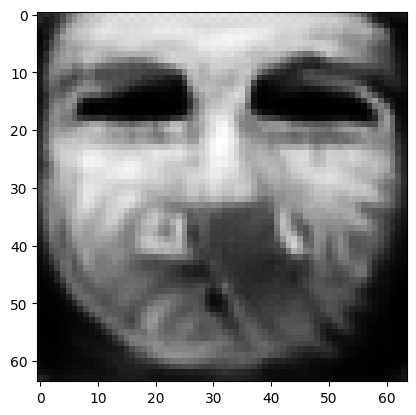

tensor([[2.5812e-03, 5.0113e-06, 3.7563e-03, 2.8775e-05, 4.7753e-04, 5.4308e-03,
         4.2211e-04, 9.8351e-01, 3.4217e-07, 2.9631e-04, 1.2446e-04, 5.9361e-06,
         9.3509e-07, 8.4834e-08, 3.0665e-06, 3.8749e-05, 6.2436e-04, 1.3119e-04,
         4.6322e-05, 8.4031e-05, 7.0901e-07, 1.2675e-05, 8.5610e-09, 3.5636e-04,
         2.5385e-05, 1.3051e-05, 8.1039e-06, 1.3909e-03, 3.7158e-04, 1.6402e-06,
         6.1764e-07, 2.2137e-05, 5.5824e-05, 3.8107e-05, 4.4256e-06, 1.0271e-06,
         4.4028e-06, 5.1699e-05, 6.6164e-05, 9.8052e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016629651188850403
tensor([[2.5808e-03, 5.0105e-06, 3.7557e-03, 2.8769e-05, 4.7744e-04, 5.4299e-03,
         4.2202e-04, 9.8351e-01, 3.4208e-07, 2.9627e-04, 1.2444e-04, 5.9349e-06,
         9.3486e-07, 8.4808e-08, 3.0658e-06, 3.8742e-05, 6.2427e-04, 1.3116e-04,
         4.6312e-05, 8.4016e-05, 7.0882e-07, 1.2672e-05, 8.5587e-09, 3.5631e-04,
         2.5378e-05, 1.3048e-05, 8.1015e-

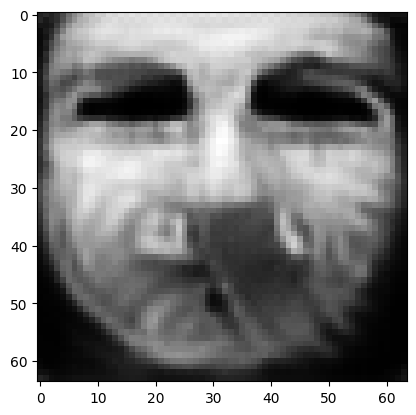

tensor([[2.5792e-03, 5.0071e-06, 3.7531e-03, 2.8746e-05, 4.7710e-04, 5.4266e-03,
         4.2167e-04, 9.8352e-01, 3.4172e-07, 2.9611e-04, 1.2435e-04, 5.9301e-06,
         9.3391e-07, 8.4704e-08, 3.0630e-06, 3.8715e-05, 6.2391e-04, 1.3103e-04,
         4.6275e-05, 8.3954e-05, 7.0803e-07, 1.2662e-05, 8.5490e-09, 3.5612e-04,
         2.5352e-05, 1.3039e-05, 8.0920e-06, 1.3896e-03, 3.7109e-04, 1.6380e-06,
         6.1681e-07, 2.2115e-05, 5.5754e-05, 3.8071e-05, 4.4209e-06, 1.0254e-06,
         4.3968e-06, 5.1645e-05, 6.6095e-05, 9.7922e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016615699976682663
tensor([[2.5788e-03, 5.0063e-06, 3.7525e-03, 2.8741e-05, 4.7701e-04, 5.4257e-03,
         4.2159e-04, 9.8352e-01, 3.4163e-07, 2.9607e-04, 1.2433e-04, 5.9289e-06,
         9.3368e-07, 8.4678e-08, 3.0624e-06, 3.8708e-05, 6.2382e-04, 1.3100e-04,
         4.6265e-05, 8.3938e-05, 7.0784e-07, 1.2659e-05, 8.5466e-09, 3.5607e-04,
         2.5346e-05, 1.3036e-05, 8.0895e-

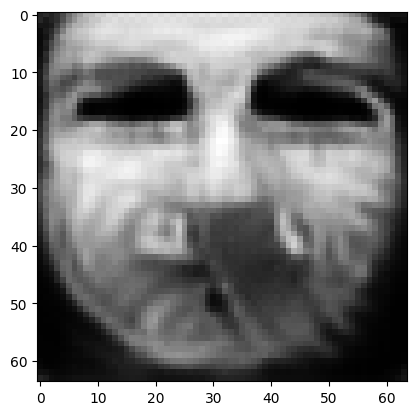

tensor([[2.5772e-03, 5.0031e-06, 3.7501e-03, 2.8719e-05, 4.7669e-04, 5.4226e-03,
         4.2126e-04, 9.8353e-01, 3.4129e-07, 2.9593e-04, 1.2425e-04, 5.9243e-06,
         9.3278e-07, 8.4580e-08, 3.0598e-06, 3.8682e-05, 6.2348e-04, 1.3088e-04,
         4.6230e-05, 8.3880e-05, 7.0710e-07, 1.2649e-05, 8.5375e-09, 3.5589e-04,
         2.5322e-05, 1.3027e-05, 8.0805e-06, 1.3884e-03, 3.7063e-04, 1.6358e-06,
         6.1602e-07, 2.2094e-05, 5.5689e-05, 3.8037e-05, 4.4165e-06, 1.0239e-06,
         4.3912e-06, 5.1594e-05, 6.6029e-05, 9.7798e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01660209894180298
tensor([[2.5768e-03, 5.0023e-06, 3.7495e-03, 2.8714e-05, 4.7660e-04, 5.4218e-03,
         4.2118e-04, 9.8354e-01, 3.4121e-07, 2.9589e-04, 1.2423e-04, 5.9232e-06,
         9.3256e-07, 8.4555e-08, 3.0591e-06, 3.8676e-05, 6.2339e-04, 1.3085e-04,
         4.6221e-05, 8.3865e-05, 7.0692e-07, 1.2646e-05, 8.5352e-09, 3.5584e-04,
         2.5315e-05, 1.3025e-05, 8.0782e-0

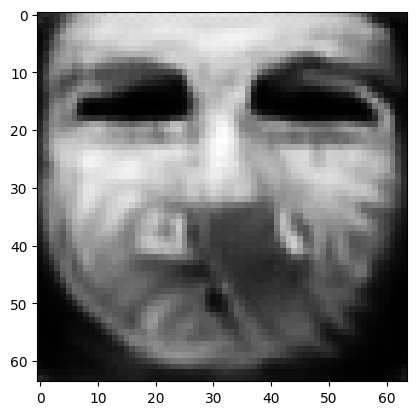

tensor([[2.5752e-03, 4.9991e-06, 3.7473e-03, 2.8693e-05, 4.7628e-04, 5.4187e-03,
         4.2086e-04, 9.8355e-01, 3.4088e-07, 2.9574e-04, 1.2415e-04, 5.9189e-06,
         9.3171e-07, 8.4461e-08, 3.0566e-06, 3.8649e-05, 6.2307e-04, 1.3073e-04,
         4.6185e-05, 8.3808e-05, 7.0621e-07, 1.2637e-05, 8.5266e-09, 3.5566e-04,
         2.5292e-05, 1.3016e-05, 8.0694e-06, 1.3872e-03, 3.7018e-04, 1.6336e-06,
         6.1527e-07, 2.2074e-05, 5.5627e-05, 3.8005e-05, 4.4122e-06, 1.0223e-06,
         4.3859e-06, 5.1544e-05, 6.5966e-05, 9.7679e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016589319333434105
tensor([[2.5748e-03, 4.9984e-06, 3.7468e-03, 2.8688e-05, 4.7620e-04, 5.4180e-03,
         4.2078e-04, 9.8355e-01, 3.4081e-07, 2.9571e-04, 1.2413e-04, 5.9179e-06,
         9.3151e-07, 8.4438e-08, 3.0559e-06, 3.8643e-05, 6.2298e-04, 1.3070e-04,
         4.6177e-05, 8.3794e-05, 7.0603e-07, 1.2634e-05, 8.5245e-09, 3.5561e-04,
         2.5286e-05, 1.3014e-05, 8.0673e-

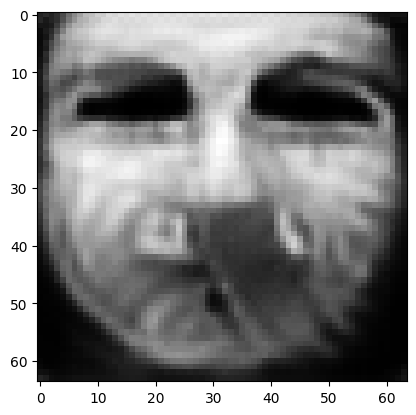

tensor([[2.5733e-03, 4.9954e-06, 3.7447e-03, 2.8668e-05, 4.7589e-04, 5.4151e-03,
         4.2048e-04, 9.8356e-01, 3.4050e-07, 2.9557e-04, 1.2405e-04, 5.9138e-06,
         9.3070e-07, 8.4349e-08, 3.0535e-06, 3.8618e-05, 6.2267e-04, 1.3059e-04,
         4.6143e-05, 8.3740e-05, 7.0535e-07, 1.2625e-05, 8.5162e-09, 3.5543e-04,
         2.5263e-05, 1.3006e-05, 8.0590e-06, 1.3861e-03, 3.6976e-04, 1.6316e-06,
         6.1456e-07, 2.2055e-05, 5.5568e-05, 3.7975e-05, 4.4081e-06, 1.0209e-06,
         4.3808e-06, 5.1497e-05, 6.5907e-05, 9.7566e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01657712459564209
tensor([[2.5729e-03, 4.9948e-06, 3.7441e-03, 2.8663e-05, 4.7582e-04, 5.4144e-03,
         4.2041e-04, 9.8356e-01, 3.4043e-07, 2.9554e-04, 1.2404e-04, 5.9128e-06,
         9.3051e-07, 8.4328e-08, 3.0529e-06, 3.8612e-05, 6.2259e-04, 1.3056e-04,
         4.6135e-05, 8.3727e-05, 7.0519e-07, 1.2623e-05, 8.5143e-09, 3.5539e-04,
         2.5258e-05, 1.3004e-05, 8.0570e-0

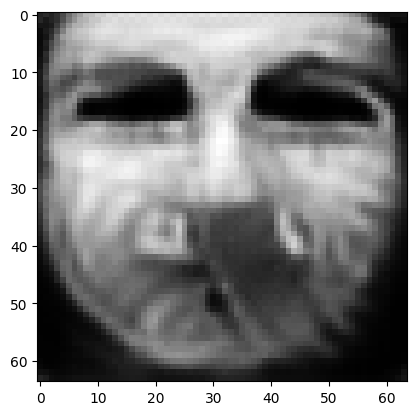

tensor([[2.5714e-03, 4.9919e-06, 3.7421e-03, 2.8644e-05, 4.7553e-04, 5.4116e-03,
         4.2012e-04, 9.8357e-01, 3.4014e-07, 2.9540e-04, 1.2396e-04, 5.9089e-06,
         9.2974e-07, 8.4243e-08, 3.0506e-06, 3.8589e-05, 6.2230e-04, 1.3045e-04,
         4.6103e-05, 8.3675e-05, 7.0455e-07, 1.2614e-05, 8.5064e-09, 3.5523e-04,
         2.5236e-05, 1.2996e-05, 8.0490e-06, 1.3851e-03, 3.6935e-04, 1.6297e-06,
         6.1388e-07, 2.2036e-05, 5.5512e-05, 3.7947e-05, 4.4043e-06, 1.0195e-06,
         4.3760e-06, 5.1453e-05, 6.5851e-05, 9.7459e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016565516591072083
tensor([[2.5711e-03, 4.9912e-06, 3.7416e-03, 2.8640e-05, 4.7546e-04, 5.4109e-03,
         4.2005e-04, 9.8357e-01, 3.4007e-07, 2.9537e-04, 1.2395e-04, 5.9079e-06,
         9.2956e-07, 8.4223e-08, 3.0501e-06, 3.8583e-05, 6.2222e-04, 1.3043e-04,
         4.6095e-05, 8.3663e-05, 7.0439e-07, 1.2612e-05, 8.5046e-09, 3.5519e-04,
         2.5232e-05, 1.2994e-05, 8.0470e-

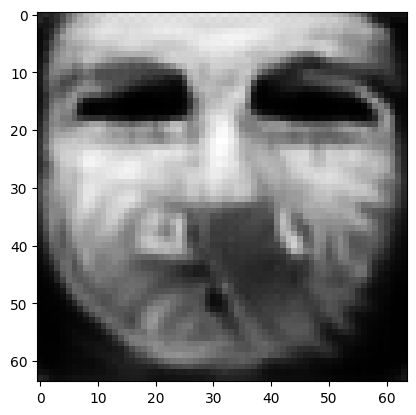

tensor([[2.5697e-03, 4.9885e-06, 3.7397e-03, 2.8622e-05, 4.7518e-04, 5.4083e-03,
         4.1978e-04, 9.8358e-01, 3.3979e-07, 2.9524e-04, 1.2388e-04, 5.9043e-06,
         9.2883e-07, 8.4142e-08, 3.0479e-06, 3.8560e-05, 6.2194e-04, 1.3032e-04,
         4.6065e-05, 8.3614e-05, 7.0378e-07, 1.2604e-05, 8.4971e-09, 3.5503e-04,
         2.5211e-05, 1.2987e-05, 8.0395e-06, 1.3841e-03, 3.6897e-04, 1.6278e-06,
         6.1324e-07, 2.2019e-05, 5.5460e-05, 3.7920e-05, 4.4007e-06, 1.0182e-06,
         4.3714e-06, 5.1411e-05, 6.5797e-05, 9.7357e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016554495319724083
tensor([[2.5694e-03, 4.9879e-06, 3.7393e-03, 2.8618e-05, 4.7511e-04, 5.4077e-03,
         4.1972e-04, 9.8358e-01, 3.3973e-07, 2.9522e-04, 1.2386e-04, 5.9034e-06,
         9.2866e-07, 8.4122e-08, 3.0474e-06, 3.8555e-05, 6.2187e-04, 1.3030e-04,
         4.6057e-05, 8.3603e-05, 7.0363e-07, 1.2602e-05, 8.4953e-09, 3.5499e-04,
         2.5206e-05, 1.2985e-05, 8.0378e-

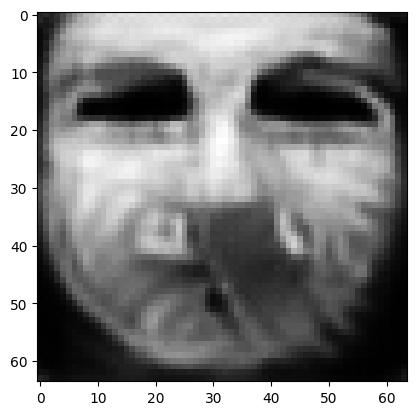

tensor([[2.5681e-03, 4.9853e-06, 3.7375e-03, 2.8601e-05, 4.7485e-04, 5.4052e-03,
         4.1946e-04, 9.8359e-01, 3.3947e-07, 2.9510e-04, 1.2380e-04, 5.9000e-06,
         9.2798e-07, 8.4046e-08, 3.0453e-06, 3.8534e-05, 6.2160e-04, 1.3020e-04,
         4.6029e-05, 8.3557e-05, 7.0305e-07, 1.2594e-05, 8.4883e-09, 3.5483e-04,
         2.5187e-05, 1.2978e-05, 8.0307e-06, 1.3831e-03, 3.6861e-04, 1.6261e-06,
         6.1263e-07, 2.2002e-05, 5.5410e-05, 3.7895e-05, 4.3972e-06, 1.0170e-06,
         4.3671e-06, 5.1371e-05, 6.5748e-05, 9.7263e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01654394343495369
tensor([[2.5677e-03, 4.9847e-06, 3.7371e-03, 2.8597e-05, 4.7479e-04, 5.4046e-03,
         4.1939e-04, 9.8359e-01, 3.3941e-07, 2.9507e-04, 1.2378e-04, 5.8991e-06,
         9.2781e-07, 8.4028e-08, 3.0448e-06, 3.8528e-05, 6.2153e-04, 1.3018e-04,
         4.6021e-05, 8.3545e-05, 7.0291e-07, 1.2592e-05, 8.4866e-09, 3.5480e-04,
         2.5182e-05, 1.2976e-05, 8.0289e-0

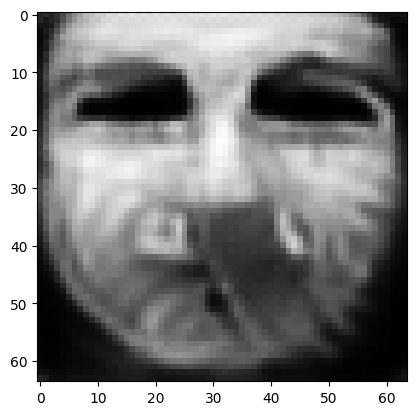

tensor([[2.5666e-03, 4.9824e-06, 3.7354e-03, 2.8580e-05, 4.7455e-04, 5.4023e-03,
         4.1916e-04, 9.8360e-01, 3.3917e-07, 2.9496e-04, 1.2372e-04, 5.8960e-06,
         9.2718e-07, 8.3958e-08, 3.0429e-06, 3.8509e-05, 6.2126e-04, 1.3009e-04,
         4.5994e-05, 8.3503e-05, 7.0238e-07, 1.2585e-05, 8.4802e-09, 3.5466e-04,
         2.5165e-05, 1.2969e-05, 8.0225e-06, 1.3822e-03, 3.6826e-04, 1.6245e-06,
         6.1206e-07, 2.1987e-05, 5.5365e-05, 3.7871e-05, 4.3940e-06, 1.0159e-06,
         4.3631e-06, 5.1334e-05, 6.5701e-05, 9.7174e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01653432846069336
tensor([[2.5663e-03, 4.9819e-06, 3.7350e-03, 2.8576e-05, 4.7449e-04, 5.4017e-03,
         4.1910e-04, 9.8360e-01, 3.3911e-07, 2.9493e-04, 1.2371e-04, 5.8953e-06,
         9.2703e-07, 8.3941e-08, 3.0424e-06, 3.8504e-05, 6.2120e-04, 1.3007e-04,
         4.5988e-05, 8.3493e-05, 7.0225e-07, 1.2584e-05, 8.4787e-09, 3.5462e-04,
         2.5160e-05, 1.2968e-05, 8.0209e-0

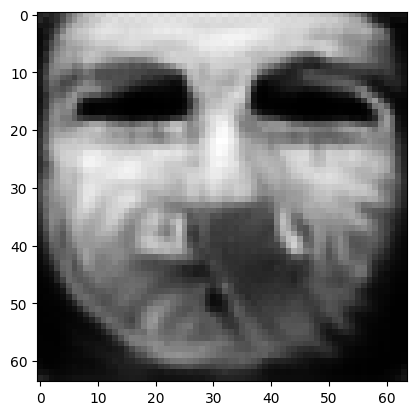

tensor([[2.5651e-03, 4.9796e-06, 3.7334e-03, 2.8561e-05, 4.7425e-04, 5.3996e-03,
         4.1887e-04, 9.8361e-01, 3.3889e-07, 2.9483e-04, 1.2365e-04, 5.8924e-06,
         9.2644e-07, 8.3874e-08, 3.0406e-06, 3.8485e-05, 6.2095e-04, 1.2999e-04,
         4.5961e-05, 8.3452e-05, 7.0175e-07, 1.2577e-05, 8.4726e-09, 3.5449e-04,
         2.5144e-05, 1.2961e-05, 8.0148e-06, 1.3813e-03, 3.6794e-04, 1.6229e-06,
         6.1151e-07, 2.1974e-05, 5.5322e-05, 3.7850e-05, 4.3910e-06, 1.0148e-06,
         4.3592e-06, 5.1299e-05, 6.5657e-05, 9.7090e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016525065526366234
tensor([[2.5648e-03, 4.9791e-06, 3.7330e-03, 2.8557e-05, 4.7420e-04, 5.3991e-03,
         4.1882e-04, 9.8361e-01, 3.3883e-07, 2.9480e-04, 1.2363e-04, 5.8917e-06,
         9.2629e-07, 8.3858e-08, 3.0402e-06, 3.8481e-05, 6.2088e-04, 1.2997e-04,
         4.5955e-05, 8.3443e-05, 7.0163e-07, 1.2575e-05, 8.4711e-09, 3.5445e-04,
         2.5140e-05, 1.2960e-05, 8.0133e-

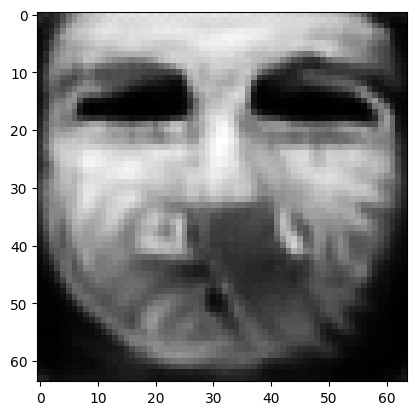

tensor([[2.5638e-03, 4.9771e-06, 3.7314e-03, 2.8542e-05, 4.7398e-04, 5.3970e-03,
         4.1861e-04, 9.8362e-01, 3.3862e-07, 2.9470e-04, 1.2358e-04, 5.8889e-06,
         9.2573e-07, 8.3795e-08, 3.0385e-06, 3.8463e-05, 6.2064e-04, 1.2989e-04,
         4.5930e-05, 8.3404e-05, 7.0116e-07, 1.2569e-05, 8.4653e-09, 3.5433e-04,
         2.5124e-05, 1.2954e-05, 8.0075e-06, 1.3805e-03, 3.6763e-04, 1.6215e-06,
         6.1099e-07, 2.1960e-05, 5.5282e-05, 3.7829e-05, 4.3881e-06, 1.0138e-06,
         4.3556e-06, 5.1265e-05, 6.5616e-05, 9.7011e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016516387462615967
tensor([[2.5635e-03, 4.9765e-06, 3.7311e-03, 2.8539e-05, 4.7392e-04, 5.3965e-03,
         4.1856e-04, 9.8362e-01, 3.3856e-07, 2.9468e-04, 1.2356e-04, 5.8883e-06,
         9.2559e-07, 8.3779e-08, 3.0381e-06, 3.8459e-05, 6.2059e-04, 1.2987e-04,
         4.5925e-05, 8.3395e-05, 7.0104e-07, 1.2567e-05, 8.4639e-09, 3.5429e-04,
         2.5120e-05, 1.2952e-05, 8.0060e-

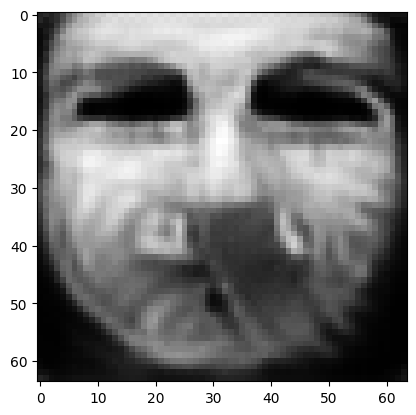

tensor([[2.5625e-03, 4.9745e-06, 3.7296e-03, 2.8525e-05, 4.7371e-04, 5.3945e-03,
         4.1835e-04, 9.8363e-01, 3.3836e-07, 2.9458e-04, 1.2351e-04, 5.8856e-06,
         9.2505e-07, 8.3719e-08, 3.0364e-06, 3.8442e-05, 6.2036e-04, 1.2980e-04,
         4.5901e-05, 8.3358e-05, 7.0058e-07, 1.2561e-05, 8.4584e-09, 3.5417e-04,
         2.5105e-05, 1.2946e-05, 8.0004e-06, 1.3797e-03, 3.6733e-04, 1.6201e-06,
         6.1049e-07, 2.1948e-05, 5.5243e-05, 3.7809e-05, 4.3854e-06, 1.0128e-06,
         4.3521e-06, 5.1233e-05, 6.5576e-05, 9.6934e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01650771126151085
tensor([[2.5622e-03, 4.9741e-06, 3.7292e-03, 2.8521e-05, 4.7366e-04, 5.3940e-03,
         4.1830e-04, 9.8363e-01, 3.3831e-07, 2.9456e-04, 1.2350e-04, 5.8850e-06,
         9.2492e-07, 8.3705e-08, 3.0360e-06, 3.8438e-05, 6.2030e-04, 1.2978e-04,
         4.5896e-05, 8.3349e-05, 7.0048e-07, 1.2560e-05, 8.4571e-09, 3.5415e-04,
         2.5101e-05, 1.2945e-05, 7.9991e-0

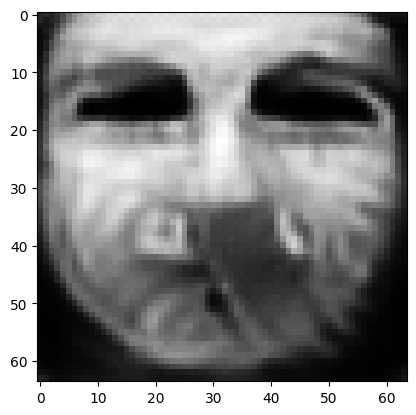

tensor([[2.5613e-03, 4.9722e-06, 3.7279e-03, 2.8508e-05, 4.7346e-04, 5.3921e-03,
         4.1811e-04, 9.8364e-01, 3.3811e-07, 2.9447e-04, 1.2345e-04, 5.8824e-06,
         9.2441e-07, 8.3647e-08, 3.0345e-06, 3.8422e-05, 6.2009e-04, 1.2971e-04,
         4.5873e-05, 8.3315e-05, 7.0005e-07, 1.2554e-05, 8.4518e-09, 3.5403e-04,
         2.5087e-05, 1.2939e-05, 7.9938e-06, 1.3789e-03, 3.6706e-04, 1.6188e-06,
         6.1002e-07, 2.1936e-05, 5.5207e-05, 3.7791e-05, 4.3828e-06, 1.0119e-06,
         4.3488e-06, 5.1203e-05, 6.5538e-05, 9.6863e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016499971970915794
tensor([[2.5610e-03, 4.9717e-06, 3.7275e-03, 2.8505e-05, 4.7342e-04, 5.3917e-03,
         4.1806e-04, 9.8364e-01, 3.3806e-07, 2.9445e-04, 1.2344e-04, 5.8818e-06,
         9.2429e-07, 8.3634e-08, 3.0341e-06, 3.8418e-05, 6.2004e-04, 1.2969e-04,
         4.5868e-05, 8.3306e-05, 6.9994e-07, 1.2553e-05, 8.4505e-09, 3.5400e-04,
         2.5083e-05, 1.2938e-05, 7.9926e-

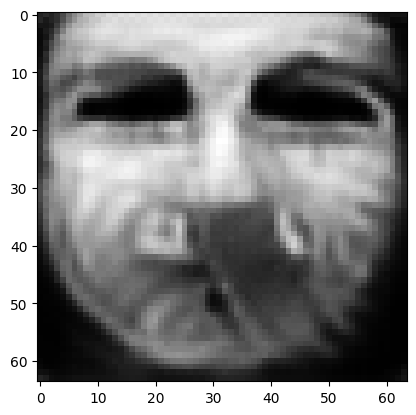

tensor([[2.5601e-03, 4.9700e-06, 3.7262e-03, 2.8492e-05, 4.7323e-04, 5.3899e-03,
         4.1788e-04, 9.8364e-01, 3.3788e-07, 2.9436e-04, 1.2339e-04, 5.8794e-06,
         9.2380e-07, 8.3579e-08, 3.0326e-06, 3.8403e-05, 6.1984e-04, 1.2962e-04,
         4.5847e-05, 8.3273e-05, 6.9953e-07, 1.2547e-05, 8.4455e-09, 3.5389e-04,
         2.5069e-05, 1.2933e-05, 7.9875e-06, 1.3782e-03, 3.6679e-04, 1.6176e-06,
         6.0958e-07, 2.1924e-05, 5.5172e-05, 3.7773e-05, 4.3804e-06, 1.0111e-06,
         4.3457e-06, 5.1174e-05, 6.5503e-05, 9.6794e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01649235002696514
tensor([[2.5599e-03, 4.9695e-06, 3.7259e-03, 2.8489e-05, 4.7318e-04, 5.3895e-03,
         4.1784e-04, 9.8364e-01, 3.3783e-07, 2.9434e-04, 1.2338e-04, 5.8789e-06,
         9.2369e-07, 8.3566e-08, 3.0323e-06, 3.8399e-05, 6.1978e-04, 1.2961e-04,
         4.5842e-05, 8.3266e-05, 6.9944e-07, 1.2546e-05, 8.4444e-09, 3.5387e-04,
         2.5066e-05, 1.2931e-05, 7.9864e-0

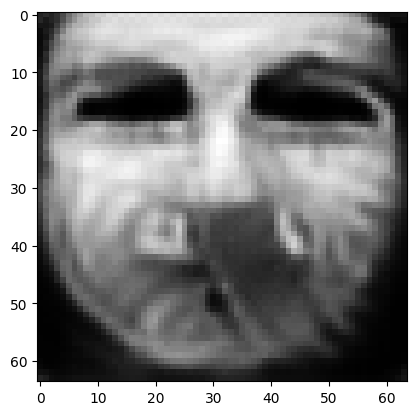

tensor([[2.5590e-03, 4.9678e-06, 3.7247e-03, 2.8477e-05, 4.7300e-04, 5.3878e-03,
         4.1766e-04, 9.8365e-01, 3.3766e-07, 2.9426e-04, 1.2333e-04, 5.8766e-06,
         9.2323e-07, 8.3515e-08, 3.0309e-06, 3.8385e-05, 6.1959e-04, 1.2954e-04,
         4.5822e-05, 8.3234e-05, 6.9905e-07, 1.2541e-05, 8.4397e-09, 3.5377e-04,
         2.5053e-05, 1.2926e-05, 7.9816e-06, 1.3775e-03, 3.6654e-04, 1.6164e-06,
         6.0915e-07, 2.1914e-05, 5.5140e-05, 3.7756e-05, 4.3780e-06, 1.0103e-06,
         4.3427e-06, 5.1147e-05, 6.5469e-05, 9.6729e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016485197469592094
tensor([[2.5588e-03, 4.9674e-06, 3.7244e-03, 2.8474e-05, 4.7296e-04, 5.3874e-03,
         4.1762e-04, 9.8365e-01, 3.3761e-07, 2.9424e-04, 1.2332e-04, 5.8761e-06,
         9.2311e-07, 8.3502e-08, 3.0306e-06, 3.8382e-05, 6.1954e-04, 1.2953e-04,
         4.5817e-05, 8.3227e-05, 6.9896e-07, 1.2539e-05, 8.4385e-09, 3.5374e-04,
         2.5050e-05, 1.2925e-05, 7.9805e-

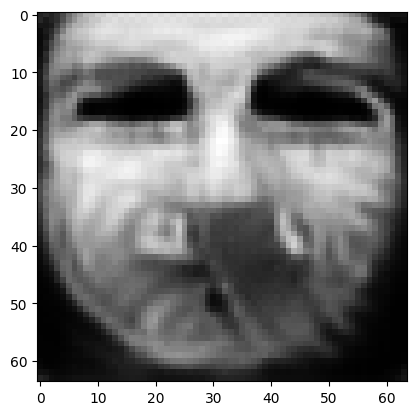

tensor([[2.5579e-03, 4.9658e-06, 3.7232e-03, 2.8462e-05, 4.7279e-04, 5.3858e-03,
         4.1746e-04, 9.8366e-01, 3.3744e-07, 2.9417e-04, 1.2328e-04, 5.8739e-06,
         9.2267e-07, 8.3454e-08, 3.0292e-06, 3.8368e-05, 6.1936e-04, 1.2947e-04,
         4.5798e-05, 8.3197e-05, 6.9859e-07, 1.2534e-05, 8.4340e-09, 3.5364e-04,
         2.5038e-05, 1.2920e-05, 7.9760e-06, 1.3769e-03, 3.6631e-04, 1.6153e-06,
         6.0875e-07, 2.1904e-05, 5.5108e-05, 3.7740e-05, 4.3758e-06, 1.0095e-06,
         4.3399e-06, 5.1121e-05, 6.5436e-05, 9.6668e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01647827960550785
tensor([[2.5577e-03, 4.9654e-06, 3.7229e-03, 2.8460e-05, 4.7275e-04, 5.3854e-03,
         4.1742e-04, 9.8366e-01, 3.3741e-07, 2.9415e-04, 1.2327e-04, 5.8734e-06,
         9.2257e-07, 8.3442e-08, 3.0289e-06, 3.8365e-05, 6.1932e-04, 1.2945e-04,
         4.5794e-05, 8.3190e-05, 6.9850e-07, 1.2533e-05, 8.4330e-09, 3.5362e-04,
         2.5035e-05, 1.2919e-05, 7.9748e-0

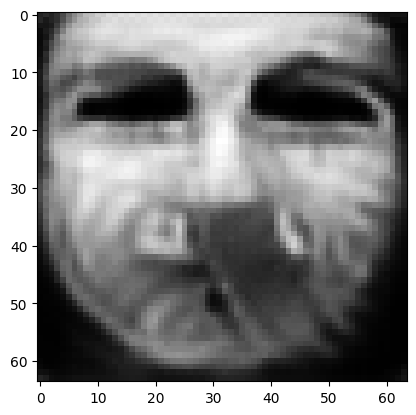

tensor([[2.5569e-03, 4.9639e-06, 3.7218e-03, 2.8449e-05, 4.7258e-04, 5.3838e-03,
         4.1726e-04, 9.8366e-01, 3.3724e-07, 2.9407e-04, 1.2323e-04, 5.8714e-06,
         9.2215e-07, 8.3396e-08, 3.0277e-06, 3.8352e-05, 6.1915e-04, 1.2940e-04,
         4.5776e-05, 8.3162e-05, 6.9816e-07, 1.2529e-05, 8.4288e-09, 3.5353e-04,
         2.5023e-05, 1.2915e-05, 7.9705e-06, 1.3763e-03, 3.6608e-04, 1.6142e-06,
         6.0837e-07, 2.1894e-05, 5.5079e-05, 3.7725e-05, 4.3737e-06, 1.0087e-06,
         4.3373e-06, 5.1096e-05, 6.5405e-05, 9.6609e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016471946612000465
tensor([[2.5567e-03, 4.9635e-06, 3.7215e-03, 2.8446e-05, 4.7254e-04, 5.3835e-03,
         4.1722e-04, 9.8366e-01, 3.3721e-07, 2.9406e-04, 1.2322e-04, 5.8709e-06,
         9.2205e-07, 8.3384e-08, 3.0274e-06, 3.8349e-05, 6.1910e-04, 1.2938e-04,
         4.5771e-05, 8.3155e-05, 6.9807e-07, 1.2527e-05, 8.4277e-09, 3.5350e-04,
         2.5020e-05, 1.2914e-05, 7.9695e-

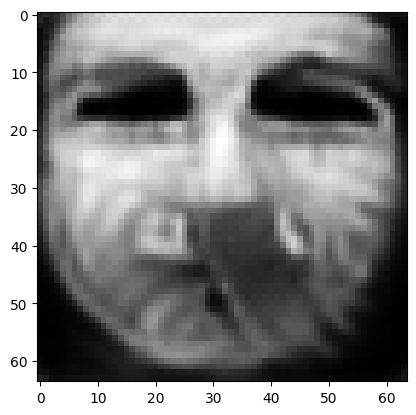

tensor([[2.5560e-03, 4.9621e-06, 3.7204e-03, 2.8436e-05, 4.7239e-04, 5.3821e-03,
         4.1707e-04, 9.8367e-01, 3.3706e-07, 2.9399e-04, 1.2318e-04, 5.8690e-06,
         9.2166e-07, 8.3340e-08, 3.0262e-06, 3.8337e-05, 6.1894e-04, 1.2933e-04,
         4.5755e-05, 8.3128e-05, 6.9774e-07, 1.2523e-05, 8.4237e-09, 3.5342e-04,
         2.5009e-05, 1.2909e-05, 7.9654e-06, 1.3757e-03, 3.6586e-04, 1.6132e-06,
         6.0801e-07, 2.1885e-05, 5.5051e-05, 3.7710e-05, 4.3717e-06, 1.0080e-06,
         4.3347e-06, 5.1073e-05, 6.5376e-05, 9.6554e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016465850174427032
tensor([[2.5558e-03, 4.9617e-06, 3.7201e-03, 2.8433e-05, 4.7235e-04, 5.3817e-03,
         4.1704e-04, 9.8367e-01, 3.3702e-07, 2.9397e-04, 1.2317e-04, 5.8685e-06,
         9.2156e-07, 8.3330e-08, 3.0259e-06, 3.8334e-05, 6.1889e-04, 1.2931e-04,
         4.5750e-05, 8.3122e-05, 6.9766e-07, 1.2522e-05, 8.4227e-09, 3.5340e-04,
         2.5006e-05, 1.2908e-05, 7.9644e-

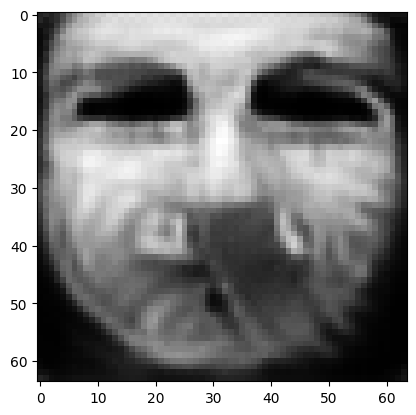

tensor([[2.5551e-03, 4.9603e-06, 3.7191e-03, 2.8424e-05, 4.7221e-04, 5.3803e-03,
         4.1690e-04, 9.8367e-01, 3.3687e-07, 2.9390e-04, 1.2314e-04, 5.8667e-06,
         9.2119e-07, 8.3288e-08, 3.0248e-06, 3.8322e-05, 6.1874e-04, 1.2926e-04,
         4.5734e-05, 8.3096e-05, 6.9735e-07, 1.2518e-05, 8.4188e-09, 3.5332e-04,
         2.4996e-05, 1.2904e-05, 7.9606e-06, 1.3752e-03, 3.6566e-04, 1.6123e-06,
         6.0767e-07, 2.1876e-05, 5.5024e-05, 3.7696e-05, 4.3698e-06, 1.0074e-06,
         4.3323e-06, 5.1051e-05, 6.5348e-05, 9.6501e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016459869220852852
tensor([[2.5549e-03, 4.9600e-06, 3.7189e-03, 2.8421e-05, 4.7217e-04, 5.3800e-03,
         4.1686e-04, 9.8368e-01, 3.3684e-07, 2.9389e-04, 1.2313e-04, 5.8662e-06,
         9.2109e-07, 8.3277e-08, 3.0245e-06, 3.8319e-05, 6.1870e-04, 1.2925e-04,
         4.5730e-05, 8.3090e-05, 6.9726e-07, 1.2517e-05, 8.4179e-09, 3.5329e-04,
         2.4993e-05, 1.2903e-05, 7.9596e-

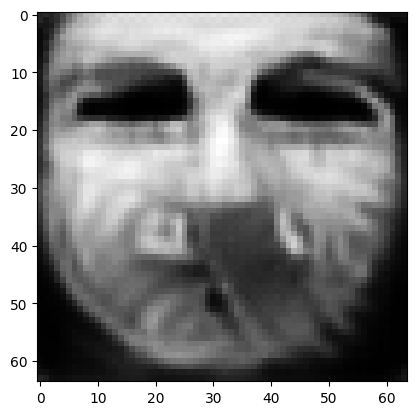

tensor([[2.5542e-03, 4.9587e-06, 3.7179e-03, 2.8412e-05, 4.7203e-04, 5.3787e-03,
         4.1673e-04, 9.8368e-01, 3.3670e-07, 2.9383e-04, 1.2309e-04, 5.8645e-06,
         9.2073e-07, 8.3237e-08, 3.0234e-06, 3.8308e-05, 6.1854e-04, 1.2920e-04,
         4.5715e-05, 8.3065e-05, 6.9696e-07, 1.2513e-05, 8.4142e-09, 3.5321e-04,
         2.4983e-05, 1.2899e-05, 7.9559e-06, 1.3746e-03, 3.6547e-04, 1.6113e-06,
         6.0733e-07, 2.1868e-05, 5.4998e-05, 3.7683e-05, 4.3679e-06, 1.0067e-06,
         4.3300e-06, 5.1029e-05, 6.5322e-05, 9.6451e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016454357653856277
tensor([[2.5541e-03, 4.9584e-06, 3.7177e-03, 2.8410e-05, 4.7200e-04, 5.3784e-03,
         4.1670e-04, 9.8368e-01, 3.3667e-07, 2.9381e-04, 1.2309e-04, 5.8640e-06,
         9.2065e-07, 8.3228e-08, 3.0231e-06, 3.8306e-05, 6.1851e-04, 1.2919e-04,
         4.5711e-05, 8.3060e-05, 6.9689e-07, 1.2512e-05, 8.4133e-09, 3.5319e-04,
         2.4980e-05, 1.2898e-05, 7.9551e-

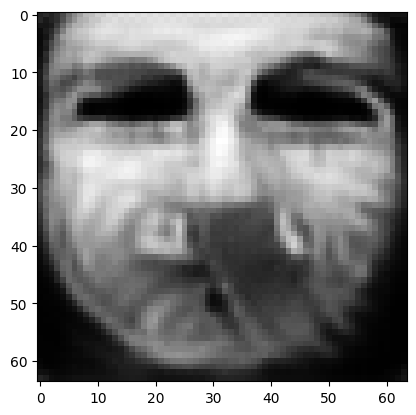

tensor([[2.5534e-03, 4.9571e-06, 3.7167e-03, 2.8401e-05, 4.7187e-04, 5.3771e-03,
         4.1657e-04, 9.8369e-01, 3.3654e-07, 2.9375e-04, 1.2305e-04, 5.8624e-06,
         9.2031e-07, 8.3190e-08, 3.0221e-06, 3.8295e-05, 6.1837e-04, 1.2914e-04,
         4.5697e-05, 8.3037e-05, 6.9661e-07, 1.2508e-05, 8.4099e-09, 3.5312e-04,
         2.4971e-05, 1.2895e-05, 7.9516e-06, 1.3742e-03, 3.6528e-04, 1.6105e-06,
         6.0703e-07, 2.1860e-05, 5.4974e-05, 3.7671e-05, 4.3662e-06, 1.0061e-06,
         4.3278e-06, 5.1009e-05, 6.5297e-05, 9.6403e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016448963433504105
tensor([[2.5533e-03, 4.9568e-06, 3.7165e-03, 2.8399e-05, 4.7184e-04, 5.3768e-03,
         4.1654e-04, 9.8369e-01, 3.3651e-07, 2.9374e-04, 1.2305e-04, 5.8620e-06,
         9.2023e-07, 8.3181e-08, 3.0219e-06, 3.8293e-05, 6.1834e-04, 1.2913e-04,
         4.5693e-05, 8.3031e-05, 6.9654e-07, 1.2507e-05, 8.4090e-09, 3.5311e-04,
         2.4968e-05, 1.2894e-05, 7.9507e-

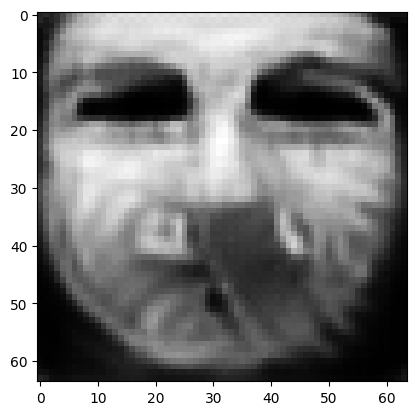

tensor([[2.5527e-03, 4.9556e-06, 3.7156e-03, 2.8390e-05, 4.7171e-04, 5.3756e-03,
         4.1642e-04, 9.8369e-01, 3.3638e-07, 2.9368e-04, 1.2301e-04, 5.8603e-06,
         9.1991e-07, 8.3145e-08, 3.0209e-06, 3.8283e-05, 6.1820e-04, 1.2908e-04,
         4.5679e-05, 8.3009e-05, 6.9627e-07, 1.2503e-05, 8.4057e-09, 3.5303e-04,
         2.4959e-05, 1.2890e-05, 7.9473e-06, 1.3737e-03, 3.6511e-04, 1.6097e-06,
         6.0673e-07, 2.1852e-05, 5.4951e-05, 3.7659e-05, 4.3646e-06, 1.0055e-06,
         4.3257e-06, 5.0990e-05, 6.5273e-05, 9.6357e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01644415594637394
tensor([[2.5525e-03, 4.9553e-06, 3.7154e-03, 2.8388e-05, 4.7168e-04, 5.3753e-03,
         4.1639e-04, 9.8369e-01, 3.3635e-07, 2.9367e-04, 1.2301e-04, 5.8600e-06,
         9.1983e-07, 8.3136e-08, 3.0207e-06, 3.8280e-05, 6.1817e-04, 1.2907e-04,
         4.5676e-05, 8.3005e-05, 6.9621e-07, 1.2502e-05, 8.4050e-09, 3.5302e-04,
         2.4958e-05, 1.2889e-05, 7.9465e-0

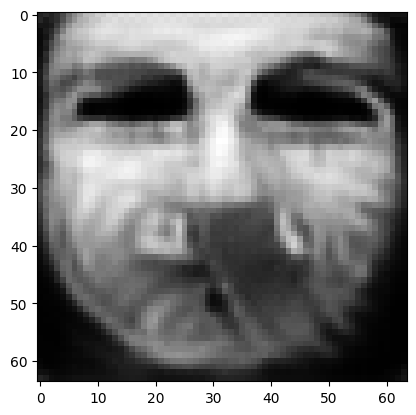

tensor([[2.5520e-03, 4.9542e-06, 3.7146e-03, 2.8380e-05, 4.7156e-04, 5.3741e-03,
         4.1627e-04, 9.8369e-01, 3.3624e-07, 2.9362e-04, 1.2298e-04, 5.8585e-06,
         9.1953e-07, 8.3102e-08, 3.0198e-06, 3.8271e-05, 6.1804e-04, 1.2903e-04,
         4.5663e-05, 8.2984e-05, 6.9595e-07, 1.2499e-05, 8.4018e-09, 3.5295e-04,
         2.4949e-05, 1.2886e-05, 7.9434e-06, 1.3732e-03, 3.6494e-04, 1.6089e-06,
         6.0645e-07, 2.1845e-05, 5.4931e-05, 3.7647e-05, 4.3630e-06, 1.0050e-06,
         4.3237e-06, 5.0972e-05, 6.5250e-05, 9.6315e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016439465805888176
tensor([[2.5518e-03, 4.9539e-06, 3.7144e-03, 2.8378e-05, 4.7153e-04, 5.3738e-03,
         4.1624e-04, 9.8370e-01, 3.3621e-07, 2.9360e-04, 1.2297e-04, 5.8581e-06,
         9.1945e-07, 8.3094e-08, 3.0195e-06, 3.8269e-05, 6.1801e-04, 1.2902e-04,
         4.5660e-05, 8.2979e-05, 6.9589e-07, 1.2498e-05, 8.4011e-09, 3.5294e-04,
         2.4947e-05, 1.2885e-05, 7.9426e-

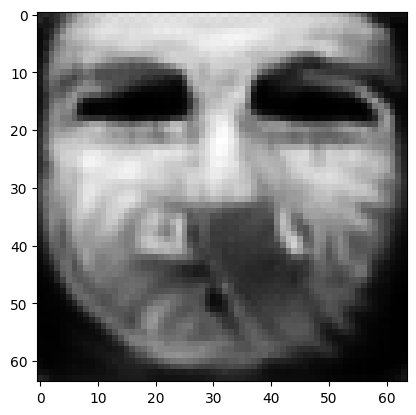

tensor([[2.5513e-03, 4.9528e-06, 3.7136e-03, 2.8370e-05, 4.7141e-04, 5.3727e-03,
         4.1613e-04, 9.8370e-01, 3.3610e-07, 2.9355e-04, 1.2294e-04, 5.8566e-06,
         9.1916e-07, 8.3061e-08, 3.0187e-06, 3.8259e-05, 6.1788e-04, 1.2898e-04,
         4.5648e-05, 8.2960e-05, 6.9564e-07, 1.2495e-05, 8.3981e-09, 3.5288e-04,
         2.4939e-05, 1.2882e-05, 7.9395e-06, 1.3728e-03, 3.6478e-04, 1.6082e-06,
         6.0618e-07, 2.1838e-05, 5.4910e-05, 3.7636e-05, 4.3615e-06, 1.0045e-06,
         4.3218e-06, 5.0955e-05, 6.5228e-05, 9.6273e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01643465645611286
tensor([[2.5512e-03, 4.9526e-06, 3.7134e-03, 2.8369e-05, 4.7138e-04, 5.3724e-03,
         4.1611e-04, 9.8370e-01, 3.3607e-07, 2.9354e-04, 1.2294e-04, 5.8563e-06,
         9.1909e-07, 8.3053e-08, 3.0185e-06, 3.8257e-05, 6.1785e-04, 1.2897e-04,
         4.5645e-05, 8.2955e-05, 6.9558e-07, 1.2494e-05, 8.3973e-09, 3.5286e-04,
         2.4937e-05, 1.2881e-05, 7.9388e-0

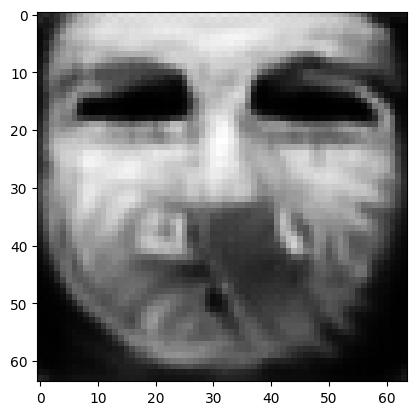

tensor([[2.5506e-03, 4.9515e-06, 3.7126e-03, 2.8361e-05, 4.7127e-04, 5.3714e-03,
         4.1600e-04, 9.8370e-01, 3.3596e-07, 2.9349e-04, 1.2291e-04, 5.8549e-06,
         9.1881e-07, 8.3022e-08, 3.0176e-06, 3.8249e-05, 6.1773e-04, 1.2893e-04,
         4.5633e-05, 8.2936e-05, 6.9535e-07, 1.2491e-05, 8.3945e-09, 3.5280e-04,
         2.4929e-05, 1.2878e-05, 7.9359e-06, 1.3724e-03, 3.6463e-04, 1.6075e-06,
         6.0592e-07, 2.1832e-05, 5.4891e-05, 3.7626e-05, 4.3601e-06, 1.0040e-06,
         4.3200e-06, 5.0939e-05, 6.5207e-05, 9.6234e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016430318355560303
tensor([[2.5505e-03, 4.9513e-06, 3.7124e-03, 2.8360e-05, 4.7125e-04, 5.3711e-03,
         4.1597e-04, 9.8370e-01, 3.3594e-07, 2.9348e-04, 1.2290e-04, 5.8545e-06,
         9.1874e-07, 8.3014e-08, 3.0174e-06, 3.8246e-05, 6.1770e-04, 1.2892e-04,
         4.5630e-05, 8.2932e-05, 6.9529e-07, 1.2490e-05, 8.3938e-09, 3.5279e-04,
         2.4928e-05, 1.2877e-05, 7.9352e-

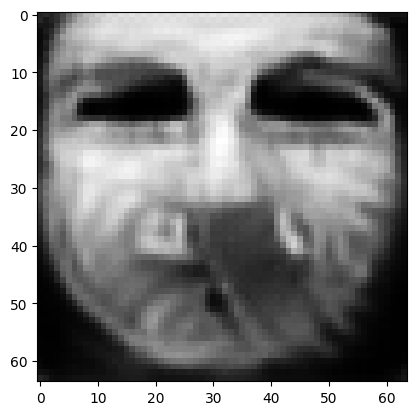

tensor([[2.5500e-03, 4.9503e-06, 3.7117e-03, 2.8353e-05, 4.7114e-04, 5.3701e-03,
         4.1587e-04, 9.8371e-01, 3.3584e-07, 2.9343e-04, 1.2288e-04, 5.8532e-06,
         9.1848e-07, 8.2985e-08, 3.0167e-06, 3.8238e-05, 6.1759e-04, 1.2888e-04,
         4.5619e-05, 8.2914e-05, 6.9507e-07, 1.2487e-05, 8.3911e-09, 3.5273e-04,
         2.4920e-05, 1.2875e-05, 7.9325e-06, 1.3720e-03, 3.6449e-04, 1.6068e-06,
         6.0568e-07, 2.1826e-05, 5.4872e-05, 3.7616e-05, 4.3588e-06, 1.0035e-06,
         4.3183e-06, 5.0924e-05, 6.5187e-05, 9.6197e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016426095739006996
tensor([[2.5499e-03, 4.9501e-06, 3.7115e-03, 2.8351e-05, 4.7112e-04, 5.3699e-03,
         4.1585e-04, 9.8371e-01, 3.3581e-07, 2.9342e-04, 1.2287e-04, 5.8529e-06,
         9.1842e-07, 8.2977e-08, 3.0165e-06, 3.8236e-05, 6.1756e-04, 1.2888e-04,
         4.5616e-05, 8.2910e-05, 6.9502e-07, 1.2486e-05, 8.3904e-09, 3.5272e-04,
         2.4918e-05, 1.2874e-05, 7.9318e-

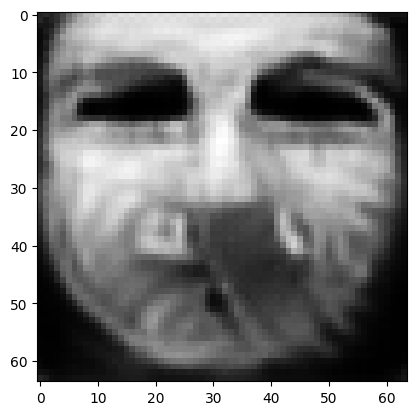

tensor([[2.5494e-03, 4.9492e-06, 3.7108e-03, 2.8344e-05, 4.7102e-04, 5.3689e-03,
         4.1576e-04, 9.8371e-01, 3.3572e-07, 2.9338e-04, 1.2285e-04, 5.8517e-06,
         9.1817e-07, 8.2950e-08, 3.0157e-06, 3.8228e-05, 6.1746e-04, 1.2884e-04,
         4.5606e-05, 8.2893e-05, 6.9481e-07, 1.2483e-05, 8.3879e-09, 3.5266e-04,
         2.4912e-05, 1.2871e-05, 7.9292e-06, 1.3717e-03, 3.6435e-04, 1.6062e-06,
         6.0545e-07, 2.1820e-05, 5.4855e-05, 3.7606e-05, 4.3575e-06, 1.0031e-06,
         4.3167e-06, 5.0909e-05, 6.5168e-05, 9.6162e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016422109678387642
tensor([[2.5493e-03, 4.9489e-06, 3.7107e-03, 2.8343e-05, 4.7100e-04, 5.3687e-03,
         4.1573e-04, 9.8371e-01, 3.3569e-07, 2.9337e-04, 1.2284e-04, 5.8514e-06,
         9.1811e-07, 8.2943e-08, 3.0156e-06, 3.8227e-05, 6.1743e-04, 1.2883e-04,
         4.5603e-05, 8.2889e-05, 6.9476e-07, 1.2483e-05, 8.3873e-09, 3.5265e-04,
         2.4910e-05, 1.2871e-05, 7.9286e-

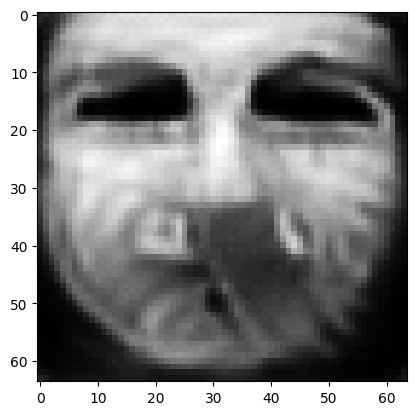

tensor([[2.5489e-03, 4.9480e-06, 3.7100e-03, 2.8337e-05, 4.7090e-04, 5.3677e-03,
         4.1564e-04, 9.8372e-01, 3.3560e-07, 2.9333e-04, 1.2282e-04, 5.8502e-06,
         9.1787e-07, 8.2917e-08, 3.0149e-06, 3.8219e-05, 6.1733e-04, 1.2880e-04,
         4.5593e-05, 8.2873e-05, 6.9456e-07, 1.2480e-05, 8.3849e-09, 3.5260e-04,
         2.4904e-05, 1.2868e-05, 7.9261e-06, 1.3713e-03, 3.6423e-04, 1.6056e-06,
         6.0523e-07, 2.1815e-05, 5.4838e-05, 3.7597e-05, 4.3563e-06, 1.0027e-06,
         4.3151e-06, 5.0895e-05, 6.5150e-05, 9.6128e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016418591141700745
tensor([[2.5488e-03, 4.9478e-06, 3.7098e-03, 2.8335e-05, 4.7088e-04, 5.3675e-03,
         4.1562e-04, 9.8372e-01, 3.3558e-07, 2.9332e-04, 1.2281e-04, 5.8499e-06,
         9.1782e-07, 8.2910e-08, 3.0147e-06, 3.8217e-05, 6.1731e-04, 1.2879e-04,
         4.5591e-05, 8.2870e-05, 6.9451e-07, 1.2479e-05, 8.3843e-09, 3.5259e-04,
         2.4902e-05, 1.2867e-05, 7.9255e-

In [21]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=7)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.559631824493408


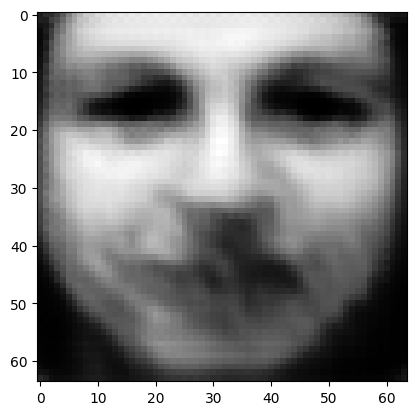

tensor([[0.0050, 0.0019, 0.0537, 0.0213, 0.1097, 0.0041, 0.0096, 0.0075, 0.0064,
         0.0007, 0.0017, 0.0016, 0.0262, 0.0096, 0.0022, 0.0011, 0.0377, 0.0116,
         0.0069, 0.0025, 0.0187, 0.0028, 0.0593, 0.0039, 0.2339, 0.0186, 0.0041,
         0.0145, 0.0234, 0.0119, 0.0088, 0.0026, 0.0226, 0.0260, 0.0205, 0.0161,
         0.0497, 0.0181, 0.0984, 0.0252]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.049081802368164
tensor([[0.0020, 0.0035, 0.0943, 0.0666, 0.0145, 0.0152, 0.0023, 0.0058, 0.0391,
         0.0024, 0.0020, 0.0026, 0.0508, 0.0017, 0.0004, 0.0009, 0.0088, 0.0018,
         0.0100, 0.0025, 0.0138, 0.0007, 0.0087, 0.0006, 0.0285, 0.0315, 0.0042,
         0.0138, 0.1654, 0.0128, 0.0126, 0.0005, 0.0077, 0.0075, 0.0581, 0.0023,
         0.0069, 0.0133, 0.1832, 0.1009]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.242128849029541
tensor([[0.0014, 0.0112, 0.0168, 0.1699, 0.0036, 0.0032, 0.0008, 0.0050, 0.1071,
         0.

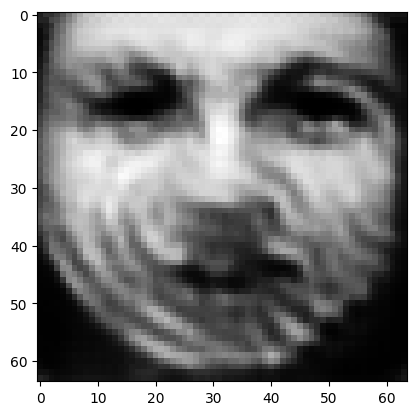

tensor([[5.9962e-04, 4.7066e-03, 1.5216e-02, 5.8212e-02, 1.8658e-03, 4.7312e-03,
         2.7358e-04, 2.6264e-03, 6.6736e-01, 4.5751e-03, 1.9494e-03, 6.3103e-03,
         3.3050e-02, 2.1398e-03, 6.7110e-04, 2.5826e-04, 3.2522e-04, 8.4244e-04,
         1.4754e-03, 1.3450e-03, 5.5906e-03, 4.7398e-04, 1.3835e-03, 6.7253e-05,
         4.6064e-03, 1.1810e-02, 3.5609e-03, 3.2857e-03, 8.4019e-03, 5.9442e-03,
         3.8325e-02, 3.8502e-04, 3.6048e-03, 2.7217e-03, 4.0059e-02, 1.2383e-03,
         8.3542e-04, 6.7190e-03, 2.2658e-02, 2.9801e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4044325351715088
tensor([[4.3374e-04, 1.1488e-03, 1.6729e-02, 9.2287e-03, 1.4656e-03, 5.3389e-03,
         2.0068e-04, 1.1256e-03, 7.9151e-01, 4.4071e-03, 7.7614e-04, 3.7038e-03,
         1.1063e-02, 3.2000e-04, 3.7096e-04, 1.3418e-04, 8.1409e-05, 5.4862e-04,
         4.8422e-04, 1.1763e-03, 3.4348e-03, 3.8677e-04, 2.7604e-04, 1.2358e-05,
         1.6777e-03, 1.4600e-03, 4.0231e-03

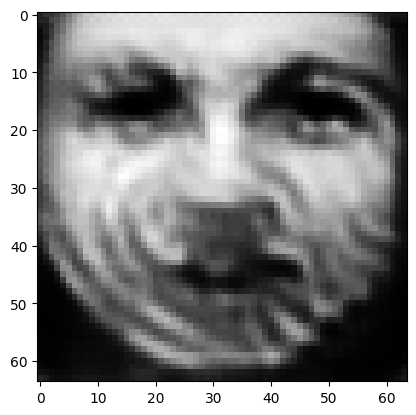

tensor([[3.0154e-04, 9.5938e-04, 7.9384e-03, 7.5518e-03, 1.1403e-03, 2.6939e-03,
         1.5051e-04, 7.6388e-04, 8.6577e-01, 2.6554e-03, 5.9921e-04, 2.5651e-03,
         1.0807e-02, 4.0831e-04, 4.3533e-04, 9.4688e-05, 5.7029e-05, 5.0424e-04,
         3.2957e-04, 9.1021e-04, 2.7997e-03, 2.8718e-04, 2.9789e-04, 9.5203e-06,
         1.8465e-03, 1.0770e-03, 3.0250e-03, 9.4162e-04, 2.4152e-03, 1.2757e-03,
         5.7003e-03, 8.0798e-05, 1.4725e-03, 1.7394e-03, 2.1906e-02, 2.3294e-04,
         1.5031e-04, 1.4917e-03, 1.3478e-02, 3.3140e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.14413943886756897
tensor([[2.8496e-04, 8.9106e-04, 7.2861e-03, 7.0693e-03, 1.0846e-03, 2.4952e-03,
         1.4357e-04, 7.1569e-04, 8.7349e-01, 2.5014e-03, 5.6036e-04, 2.4140e-03,
         1.0410e-02, 3.8715e-04, 4.2554e-04, 8.9327e-05, 5.2711e-05, 4.7512e-04,
         3.0046e-04, 8.8215e-04, 2.6675e-03, 2.7553e-04, 2.8231e-04, 8.8078e-06,
         1.7919e-03, 9.8581e-04, 2.8818e-0

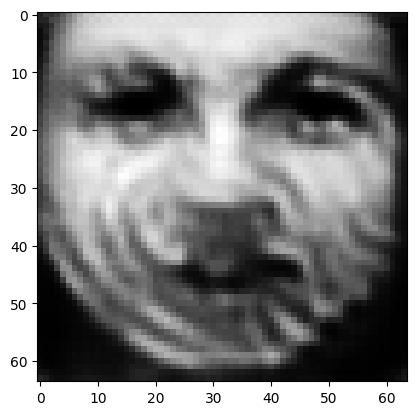

tensor([[2.4417e-04, 7.1509e-04, 5.6936e-03, 5.6817e-03, 8.9611e-04, 2.0010e-03,
         1.2131e-04, 5.7877e-04, 8.9507e-01, 2.1059e-03, 4.5876e-04, 2.0771e-03,
         8.8454e-03, 3.2012e-04, 4.0258e-04, 7.5323e-05, 4.0861e-05, 3.9567e-04,
         2.3639e-04, 7.8925e-04, 2.3831e-03, 2.4211e-04, 2.2795e-04, 7.0617e-06,
         1.5552e-03, 7.5078e-04, 2.4351e-03, 6.8836e-04, 1.6377e-03, 9.9141e-04,
         4.7058e-03, 6.0954e-05, 1.1981e-03, 1.4198e-03, 1.8383e-02, 1.9506e-04,
         1.1472e-04, 1.1783e-03, 1.0594e-02, 2.4482e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11085320264101028
tensor([[2.3604e-04, 6.9292e-04, 5.3422e-03, 5.5929e-03, 8.5978e-04, 1.8840e-03,
         1.1612e-04, 5.5230e-04, 8.9934e-01, 1.9984e-03, 4.4200e-04, 2.0113e-03,
         8.6203e-03, 3.1400e-04, 4.0250e-04, 7.2780e-05, 3.9321e-05, 3.8034e-04,
         2.2709e-04, 7.6153e-04, 2.3357e-03, 2.3408e-04, 2.2283e-04, 6.8867e-06,
         1.5495e-03, 7.2312e-04, 2.3110e-0

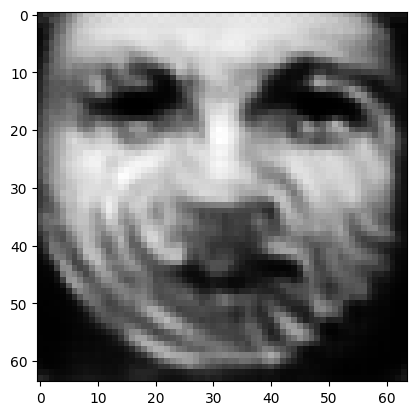

tensor([[2.1081e-04, 5.8592e-04, 4.4895e-03, 4.6531e-03, 7.3842e-04, 1.6022e-03,
         1.0289e-04, 4.6458e-04, 9.1265e-01, 1.7700e-03, 3.7691e-04, 1.8335e-03,
         7.2807e-03, 2.6751e-04, 3.9293e-04, 6.5107e-05, 3.2073e-05, 3.3583e-04,
         1.9207e-04, 6.9222e-04, 2.1916e-03, 2.1244e-04, 1.8396e-04, 5.8362e-06,
         1.3653e-03, 5.7684e-04, 2.0302e-03, 5.3293e-04, 1.2657e-03, 8.3806e-04,
         3.8711e-03, 5.1750e-05, 1.0295e-03, 1.1762e-03, 1.6433e-02, 1.7319e-04,
         9.3839e-05, 1.0130e-03, 8.7624e-03, 1.9453e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09139802306890488
tensor([[2.0576e-04, 5.7783e-04, 4.2708e-03, 4.6916e-03, 7.0603e-04, 1.5309e-03,
         9.9340e-05, 4.5386e-04, 9.1536e-01, 1.7066e-03, 3.7254e-04, 1.7990e-03,
         7.1170e-03, 2.6879e-04, 3.9225e-04, 6.3696e-05, 3.1135e-05, 3.2712e-04,
         1.8952e-04, 6.6718e-04, 2.1454e-03, 2.0793e-04, 1.8185e-04, 5.7818e-06,
         1.3391e-03, 5.7299e-04, 1.9459e-0

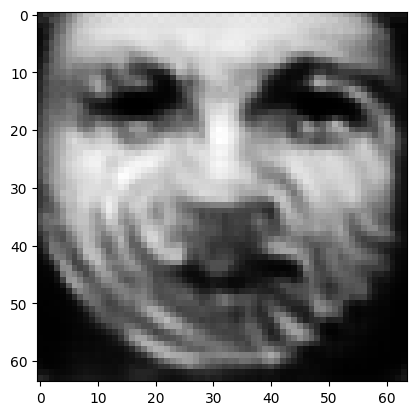

tensor([[1.8894e-04, 5.1909e-04, 3.7333e-03, 4.3195e-03, 6.3164e-04, 1.3563e-03,
         9.0681e-05, 4.0558e-04, 9.2346e-01, 1.5275e-03, 3.3885e-04, 1.6838e-03,
         6.4231e-03, 2.4783e-04, 3.8966e-04, 5.9123e-05, 2.7541e-05, 3.0043e-04,
         1.7056e-04, 6.1626e-04, 2.0294e-03, 1.9378e-04, 1.6347e-04, 5.2323e-06,
         1.2358e-03, 5.0206e-04, 1.7399e-03, 4.5209e-04, 1.0283e-03, 7.5721e-04,
         3.5427e-03, 4.6811e-05, 9.2097e-04, 1.0069e-03, 1.5158e-02, 1.6662e-04,
         8.3604e-05, 9.5794e-04, 7.5095e-03, 1.6008e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0796259418129921
tensor([[1.8520e-04, 5.1059e-04, 3.5967e-03, 4.2911e-03, 6.1437e-04, 1.3138e-03,
         8.8494e-05, 3.9776e-04, 9.2513e-01, 1.4858e-03, 3.3535e-04, 1.6545e-03,
         6.3248e-03, 2.4727e-04, 3.8843e-04, 5.8181e-05, 2.6933e-05, 2.9462e-04,
         1.6738e-04, 6.0272e-04, 2.0020e-03, 1.9073e-04, 1.6132e-04, 5.1630e-06,
         1.2178e-03, 4.9654e-04, 1.6913e-03

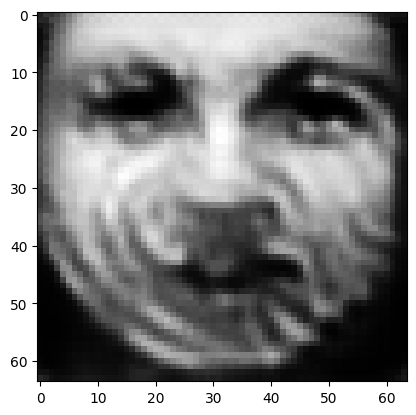

tensor([[1.7295e-04, 4.6549e-04, 3.2194e-03, 3.8982e-03, 5.6758e-04, 1.1977e-03,
         8.2463e-05, 3.6024e-04, 9.3082e-01, 1.3649e-03, 3.1062e-04, 1.5737e-03,
         5.8368e-03, 2.3030e-04, 3.8917e-04, 5.4934e-05, 2.4274e-05, 2.7797e-04,
         1.5219e-04, 5.7142e-04, 1.9429e-03, 1.8056e-04, 1.4627e-04, 4.7233e-06,
         1.1305e-03, 4.4060e-04, 1.5703e-03, 3.9994e-04, 8.7804e-04, 6.9134e-04,
         3.2302e-03, 4.2507e-05, 8.4796e-04, 9.1385e-04, 1.4016e-02, 1.5853e-04,
         7.5712e-05, 8.8150e-04, 6.7643e-03, 1.4115e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07169152796268463
tensor([[1.6983e-04, 4.5607e-04, 3.1444e-03, 3.8271e-03, 5.5739e-04, 1.1718e-03,
         8.0795e-05, 3.5187e-04, 9.3203e-01, 1.3363e-03, 3.0535e-04, 1.5556e-03,
         5.7316e-03, 2.2683e-04, 3.8780e-04, 5.4083e-05, 2.3710e-05, 2.7362e-04,
         1.4885e-04, 5.6238e-04, 1.9277e-03, 1.7813e-04, 1.4321e-04, 4.6317e-06,
         1.1141e-03, 4.3062e-04, 1.5372e-0

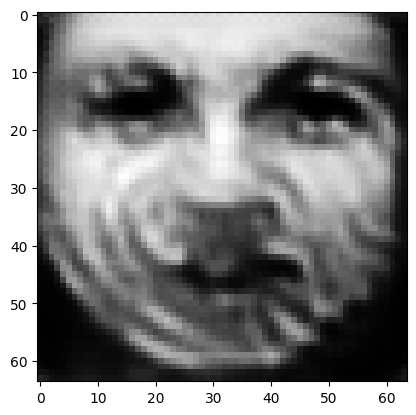

tensor([[1.5870e-04, 4.2423e-04, 2.8656e-03, 3.6139e-03, 5.1522e-04, 1.0721e-03,
         7.4508e-05, 3.2537e-04, 9.3648e-01, 1.2246e-03, 2.9183e-04, 1.4952e-03,
         5.3431e-03, 2.1974e-04, 3.8305e-04, 5.1336e-05, 2.1887e-05, 2.5936e-04,
         1.3949e-04, 5.2478e-04, 1.8657e-03, 1.6912e-04, 1.3407e-04, 4.3532e-06,
         1.0456e-03, 4.0153e-04, 1.4225e-03, 3.5880e-04, 7.7160e-04, 6.4020e-04,
         2.9783e-03, 3.9571e-05, 7.8358e-04, 8.2810e-04, 1.3248e-02, 1.5208e-04,
         6.9925e-05, 8.3867e-04, 6.1287e-03, 1.2639e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06563030928373337
tensor([[1.5640e-04, 4.1865e-04, 2.7984e-03, 3.5717e-03, 5.0699e-04, 1.0481e-03,
         7.3019e-05, 3.1963e-04, 9.3747e-01, 1.1976e-03, 2.8901e-04, 1.4831e-03,
         5.2823e-03, 2.1943e-04, 3.8341e-04, 5.0632e-05, 2.1524e-05, 2.5670e-04,
         1.3775e-04, 5.1607e-04, 1.8537e-03, 1.6709e-04, 1.3267e-04, 4.3113e-06,
         1.0336e-03, 3.9635e-04, 1.4014e-0

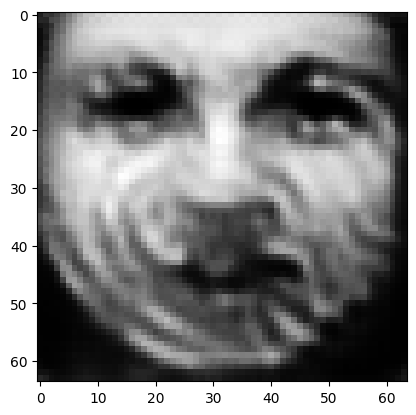

tensor([[1.4862e-04, 3.8709e-04, 2.6253e-03, 3.3130e-03, 4.7569e-04, 9.8779e-04,
         6.8698e-05, 3.0052e-04, 9.4101e-01, 1.1176e-03, 2.7571e-04, 1.4332e-03,
         4.8990e-03, 2.0694e-04, 3.7660e-04, 4.8280e-05, 1.9882e-05, 2.4422e-04,
         1.2949e-04, 4.8899e-04, 1.7880e-03, 1.6036e-04, 1.2220e-04, 4.0558e-06,
         9.7326e-04, 3.6553e-04, 1.3277e-03, 3.2893e-04, 6.9706e-04, 5.8863e-04,
         2.7247e-03, 3.7135e-05, 7.3761e-04, 7.6104e-04, 1.2505e-02, 1.4444e-04,
         6.4958e-05, 7.9464e-04, 5.6823e-03, 1.1632e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.060797613114118576
tensor([[1.4654e-04, 3.8089e-04, 2.5797e-03, 3.2635e-03, 4.6794e-04, 9.7071e-04,
         6.7530e-05, 2.9604e-04, 9.4183e-01, 1.0981e-03, 2.7336e-04, 1.4225e-03,
         4.8154e-03, 2.0529e-04, 3.7536e-04, 4.7750e-05, 1.9545e-05, 2.4135e-04,
         1.2790e-04, 4.8183e-04, 1.7759e-03, 1.5886e-04, 1.2031e-04, 4.0099e-06,
         9.6036e-04, 3.6055e-04, 1.3074e-

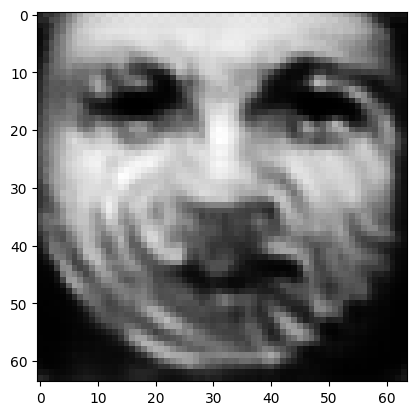

tensor([[1.3853e-04, 3.5711e-04, 2.4261e-03, 3.0451e-03, 4.4330e-04, 9.0781e-04,
         6.3077e-05, 2.7678e-04, 9.4475e-01, 1.0232e-03, 2.6170e-04, 1.3763e-03,
         4.5633e-03, 1.9817e-04, 3.7156e-04, 4.5687e-05, 1.8296e-05, 2.3133e-04,
         1.2065e-04, 4.5935e-04, 1.7421e-03, 1.5383e-04, 1.1338e-04, 3.8114e-06,
         9.1657e-04, 3.3883e-04, 1.2331e-03, 3.0472e-04, 6.3543e-04, 5.5027e-04,
         2.5252e-03, 3.4798e-05, 6.9783e-04, 7.1240e-04, 1.1859e-02, 1.3717e-04,
         6.0396e-05, 7.5069e-04, 5.3349e-03, 1.0820e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.056835852563381195
tensor([[1.3668e-04, 3.5175e-04, 2.3927e-03, 2.9996e-03, 4.3777e-04, 8.9376e-04,
         6.2005e-05, 2.7235e-04, 9.4540e-01, 1.0056e-03, 2.5898e-04, 1.3648e-03,
         4.5081e-03, 1.9653e-04, 3.7010e-04, 4.5196e-05, 1.8019e-05, 2.2880e-04,
         1.1895e-04, 4.5390e-04, 1.7335e-03, 1.5262e-04, 1.1185e-04, 3.7649e-06,
         9.0720e-04, 3.3415e-04, 1.2145e-

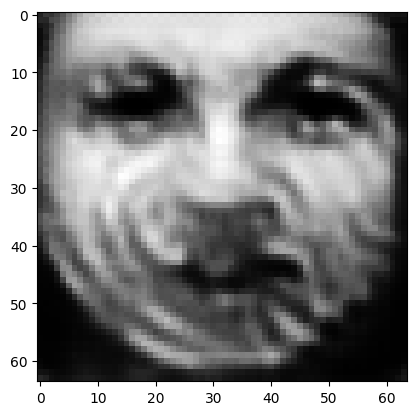

tensor([[1.3025e-04, 3.3333e-04, 2.2715e-03, 2.8132e-03, 4.1695e-04, 8.4617e-04,
         5.8364e-05, 2.5592e-04, 9.4776e-01, 9.4849e-04, 2.4925e-04, 1.3310e-03,
         4.2743e-03, 1.9002e-04, 3.6707e-04, 4.3592e-05, 1.6906e-05, 2.2160e-04,
         1.1297e-04, 4.3512e-04, 1.7074e-03, 1.4795e-04, 1.0524e-04, 3.5805e-06,
         8.6449e-04, 3.1382e-04, 1.1612e-03, 2.8242e-04, 5.8650e-04, 5.1912e-04,
         2.3281e-03, 3.2755e-05, 6.6080e-04, 6.7121e-04, 1.1377e-02, 1.2969e-04,
         5.6080e-05, 7.0768e-04, 5.0271e-03, 1.0245e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05365698039531708
tensor([[1.2877e-04, 3.2908e-04, 2.2448e-03, 2.7796e-03, 4.1192e-04, 8.3483e-04,
         5.7486e-05, 2.5234e-04, 9.4829e-01, 9.3487e-04, 2.4705e-04, 1.3220e-03,
         4.2274e-03, 1.8844e-04, 3.6551e-04, 4.3193e-05, 1.6664e-05, 2.1935e-04,
         1.1153e-04, 4.3063e-04, 1.6986e-03, 1.4694e-04, 1.0386e-04, 3.5388e-06,
         8.5570e-04, 3.0988e-04, 1.1474e-0

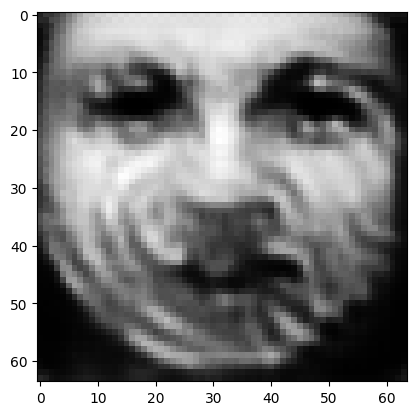

tensor([[1.2342e-04, 3.1470e-04, 2.1324e-03, 2.6394e-03, 3.9655e-04, 7.9114e-04,
         5.4509e-05, 2.3947e-04, 9.5027e-01, 8.8519e-04, 2.3936e-04, 1.2877e-03,
         4.0619e-03, 1.8456e-04, 3.6393e-04, 4.1803e-05, 1.5847e-05, 2.1381e-04,
         1.0665e-04, 4.1519e-04, 1.6741e-03, 1.4319e-04, 9.9345e-05, 3.4038e-06,
         8.2712e-04, 2.9484e-04, 1.1026e-03, 2.6535e-04, 5.4314e-04, 4.9313e-04,
         2.1913e-03, 3.1124e-05, 6.3042e-04, 6.3908e-04, 1.0968e-02, 1.2475e-04,
         5.2765e-05, 6.7525e-04, 4.7655e-03, 9.6980e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05100994184613228
tensor([[1.2238e-04, 3.1041e-04, 2.1115e-03, 2.5894e-03, 3.9388e-04, 7.8324e-04,
         5.3984e-05, 2.3609e-04, 9.5074e-01, 8.7622e-04, 2.3677e-04, 1.2820e-03,
         4.0095e-03, 1.8265e-04, 3.6470e-04, 4.1514e-05, 1.5634e-05, 2.1299e-04,
         1.0546e-04, 4.1261e-04, 1.6710e-03, 1.4237e-04, 9.7818e-05, 3.3671e-06,
         8.1980e-04, 2.8927e-04, 1.0948e-0

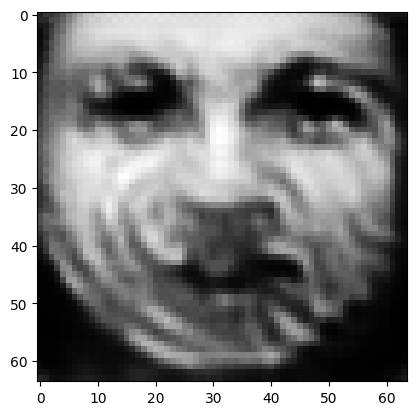

tensor([[1.1763e-04, 2.9779e-04, 2.0098e-03, 2.4952e-03, 3.8137e-04, 7.4486e-04,
         5.1633e-05, 2.2608e-04, 9.5239e-01, 8.3802e-04, 2.2924e-04, 1.2438e-03,
         3.8624e-03, 1.7872e-04, 3.6131e-04, 4.0258e-05, 1.5005e-05, 2.0684e-04,
         1.0131e-04, 3.9935e-04, 1.6394e-03, 1.3854e-04, 9.4578e-05, 3.2475e-06,
         8.0402e-04, 2.7685e-04, 1.0507e-03, 2.5143e-04, 5.0875e-04, 4.7178e-04,
         2.0702e-03, 2.9746e-05, 6.0775e-04, 6.1027e-04, 1.0649e-02, 1.2096e-04,
         4.9900e-05, 6.4968e-04, 4.5445e-03, 9.2363e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.048778653144836426
tensor([[1.1648e-04, 2.9506e-04, 1.9874e-03, 2.4796e-03, 3.7825e-04, 7.3580e-04,
         5.0999e-05, 2.2383e-04, 9.5277e-01, 8.2811e-04, 2.2760e-04, 1.2347e-03,
         3.8338e-03, 1.7800e-04, 3.6006e-04, 3.9948e-05, 1.4869e-05, 2.0515e-04,
         1.0036e-04, 3.9586e-04, 1.6311e-03, 1.3769e-04, 9.3952e-05, 3.2217e-06,
         8.0022e-04, 2.7463e-04, 1.0384e-

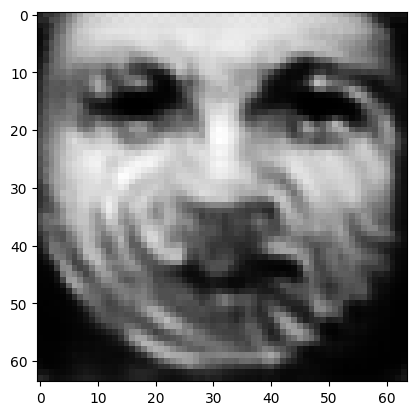

tensor([[1.1235e-04, 2.8284e-04, 1.9096e-03, 2.3843e-03, 3.6660e-04, 7.0366e-04,
         4.8555e-05, 2.1481e-04, 9.5425e-01, 7.9346e-04, 2.2052e-04, 1.2014e-03,
         3.6912e-03, 1.7360e-04, 3.5601e-04, 3.8859e-05, 1.4257e-05, 1.9891e-04,
         9.6646e-05, 3.8287e-04, 1.6045e-03, 1.3474e-04, 9.0344e-05, 3.1125e-06,
         7.8016e-04, 2.6374e-04, 9.9474e-04, 2.3943e-04, 4.7912e-04, 4.5412e-04,
         1.9826e-03, 2.8314e-05, 5.8603e-04, 5.8235e-04, 1.0365e-02, 1.1715e-04,
         4.7507e-05, 6.2914e-04, 4.3491e-03, 8.8322e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046833399683237076
tensor([[1.1137e-04, 2.7974e-04, 1.8927e-03, 2.3587e-03, 3.6363e-04, 6.9681e-04,
         4.8002e-05, 2.1247e-04, 9.5459e-01, 7.8633e-04, 2.1869e-04, 1.1944e-03,
         3.6547e-03, 1.7213e-04, 3.5490e-04, 3.8619e-05, 1.4099e-05, 1.9729e-04,
         9.5685e-05, 3.8009e-04, 1.5989e-03, 1.3406e-04, 8.9305e-05, 3.0815e-06,
         7.7377e-04, 2.6068e-04, 9.8493e-

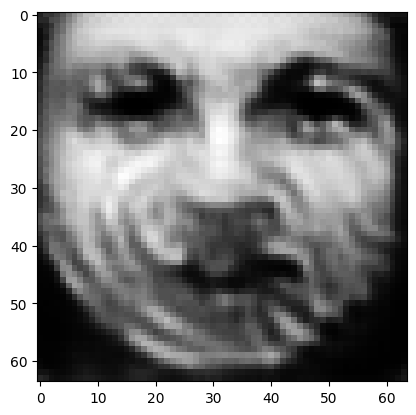

tensor([[1.0783e-04, 2.6934e-04, 1.8236e-03, 2.2798e-03, 3.5184e-04, 6.6970e-04,
         4.5978e-05, 2.0489e-04, 9.5587e-01, 7.6086e-04, 2.1270e-04, 1.1650e-03,
         3.5281e-03, 1.6793e-04, 3.5082e-04, 3.7687e-05, 1.3545e-05, 1.9134e-04,
         9.2452e-05, 3.6936e-04, 1.5742e-03, 1.3156e-04, 8.5773e-05, 2.9814e-06,
         7.5037e-04, 2.5160e-04, 9.4839e-04, 2.2871e-04, 4.5662e-04, 4.3992e-04,
         1.9020e-03, 2.6945e-05, 5.6609e-04, 5.5824e-04, 1.0074e-02, 1.1289e-04,
         4.5289e-05, 6.0837e-04, 4.1809e-03, 8.5430e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04513370618224144
tensor([[1.0694e-04, 2.6778e-04, 1.8029e-03, 2.2739e-03, 3.4883e-04, 6.6165e-04,
         4.5463e-05, 2.0349e-04, 9.5617e-01, 7.5333e-04, 2.1191e-04, 1.1570e-03,
         3.5071e-03, 1.6807e-04, 3.4999e-04, 3.7455e-05, 1.3453e-05, 1.9002e-04,
         9.1913e-05, 3.6608e-04, 1.5674e-03, 1.3090e-04, 8.5408e-05, 2.9684e-06,
         7.4668e-04, 2.5093e-04, 9.3843e-0

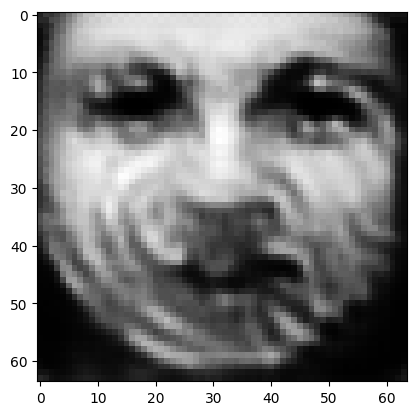

tensor([[1.0361e-04, 2.5943e-04, 1.7334e-03, 2.2085e-03, 3.4009e-04, 6.3443e-04,
         4.3742e-05, 1.9594e-04, 9.5734e-01, 7.2842e-04, 2.0580e-04, 1.1288e-03,
         3.4185e-03, 1.6482e-04, 3.4898e-04, 3.6527e-05, 1.3005e-05, 1.8495e-04,
         8.8847e-05, 3.5685e-04, 1.5472e-03, 1.2858e-04, 8.2756e-05, 2.8863e-06,
         7.3242e-04, 2.4273e-04, 9.0628e-04, 2.1973e-04, 4.3352e-04, 4.2936e-04,
         1.8487e-03, 2.5904e-05, 5.4894e-04, 5.3876e-04, 9.8293e-03, 1.1055e-04,
         4.3563e-05, 5.9211e-04, 4.0308e-03, 8.1753e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04360106587409973
tensor([[1.0293e-04, 2.5683e-04, 1.7196e-03, 2.1863e-03, 3.3795e-04, 6.2929e-04,
         4.3397e-05, 1.9412e-04, 9.5761e-01, 7.2408e-04, 2.0397e-04, 1.1222e-03,
         3.3886e-03, 1.6322e-04, 3.4837e-04, 3.6328e-05, 1.2872e-05, 1.8359e-04,
         8.8051e-05, 3.5500e-04, 1.5419e-03, 1.2803e-04, 8.1793e-05, 2.8606e-06,
         7.2784e-04, 2.3988e-04, 9.0036e-0

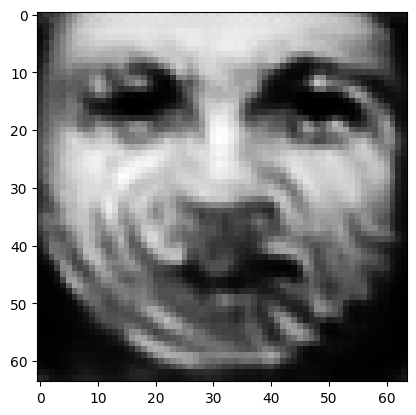

tensor([[1.0005e-04, 2.4959e-04, 1.6589e-03, 2.1343e-03, 3.3116e-04, 6.0519e-04,
         4.2001e-05, 1.8820e-04, 9.5860e-01, 7.0205e-04, 1.9844e-04, 1.0939e-03,
         3.3309e-03, 1.6044e-04, 3.4627e-04, 3.5414e-05, 1.2494e-05, 1.7876e-04,
         8.5263e-05, 3.4754e-04, 1.5202e-03, 1.2604e-04, 7.9841e-05, 2.7888e-06,
         7.1835e-04, 2.3322e-04, 8.7363e-04, 2.1176e-04, 4.1385e-04, 4.1840e-04,
         1.7983e-03, 2.4864e-05, 5.3590e-04, 5.2333e-04, 9.5805e-03, 1.0801e-04,
         4.1948e-05, 5.7457e-04, 3.9235e-03, 7.8879e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042278870940208435
tensor([[9.9429e-05, 2.4743e-04, 1.6469e-03, 2.1138e-03, 3.2993e-04, 6.0066e-04,
         4.1716e-05, 1.8657e-04, 9.5883e-01, 6.9775e-04, 1.9667e-04, 1.0875e-03,
         3.3136e-03, 1.5911e-04, 3.4593e-04, 3.5203e-05, 1.2386e-05, 1.7765e-04,
         8.4496e-05, 3.4628e-04, 1.5161e-03, 1.2556e-04, 7.9127e-05, 2.7655e-06,
         7.1549e-04, 2.3066e-04, 8.6849e-

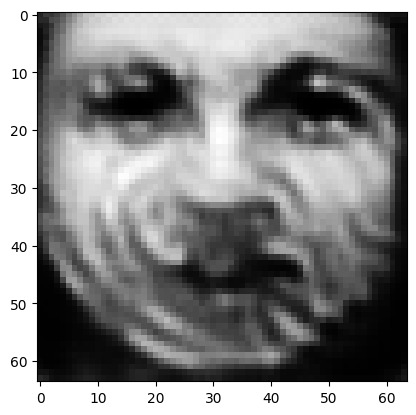

tensor([[9.6933e-05, 2.4098e-04, 1.5965e-03, 2.0613e-03, 3.2428e-04, 5.8055e-04,
         4.0558e-05, 1.8140e-04, 9.5970e-01, 6.8061e-04, 1.9170e-04, 1.0644e-03,
         3.2604e-03, 1.5643e-04, 3.4454e-04, 3.4406e-05, 1.2064e-05, 1.7380e-04,
         8.2027e-05, 3.4028e-04, 1.4990e-03, 1.2388e-04, 7.7265e-05, 2.7006e-06,
         7.0603e-04, 2.2430e-04, 8.4510e-04, 2.0510e-04, 3.9703e-04, 4.0801e-04,
         1.7510e-03, 2.3921e-05, 5.2433e-04, 5.1122e-04, 9.3494e-03, 1.0566e-04,
         4.0486e-05, 5.5678e-04, 3.8348e-03, 7.6529e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.041136618703603745
tensor([[9.6332e-05, 2.4048e-04, 1.5816e-03, 2.0642e-03, 3.2231e-04, 5.7446e-04,
         4.0237e-05, 1.8051e-04, 9.5989e-01, 6.7565e-04, 1.9135e-04, 1.0597e-03,
         3.2579e-03, 1.5694e-04, 3.4443e-04, 3.4216e-05, 1.2029e-05, 1.7303e-04,
         8.1634e-05, 3.3851e-04, 1.4939e-03, 1.2345e-04, 7.7249e-05, 2.6954e-06,
         7.0503e-04, 2.2419e-04, 8.3878e-

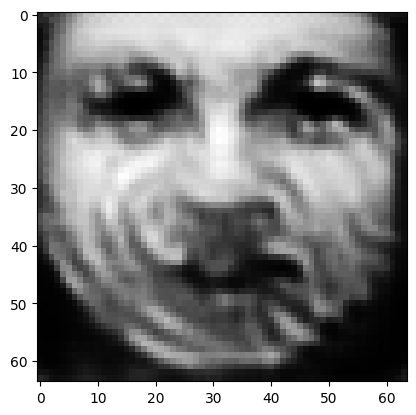

tensor([[9.4184e-05, 2.3426e-04, 1.5428e-03, 2.0120e-03, 3.1572e-04, 5.5875e-04,
         3.9192e-05, 1.7563e-04, 9.6066e-01, 6.6230e-04, 1.8754e-04, 1.0432e-03,
         3.1969e-03, 1.5411e-04, 3.4289e-04, 3.3621e-05, 1.1735e-05, 1.6972e-04,
         7.9516e-05, 3.3328e-04, 1.4804e-03, 1.2197e-04, 7.5099e-05, 2.6347e-06,
         6.9139e-04, 2.1820e-04, 8.1848e-04, 1.9972e-04, 3.8281e-04, 4.0054e-04,
         1.7238e-03, 2.3207e-05, 5.1305e-04, 5.0081e-04, 9.1527e-03, 1.0381e-04,
         3.9407e-05, 5.4548e-04, 3.7334e-03, 7.4288e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040137939155101776
tensor([[9.3732e-05, 2.3237e-04, 1.5362e-03, 1.9918e-03, 3.1430e-04, 5.5616e-04,
         3.8990e-05, 1.7431e-04, 9.6083e-01, 6.6041e-04, 1.8637e-04, 1.0403e-03,
         3.1755e-03, 1.5287e-04, 3.4286e-04, 3.3519e-05, 1.1649e-05, 1.6908e-04,
         7.8946e-05, 3.3248e-04, 1.4789e-03, 1.2165e-04, 7.4292e-05, 2.6160e-06,
         6.8708e-04, 2.1592e-04, 8.1476e-

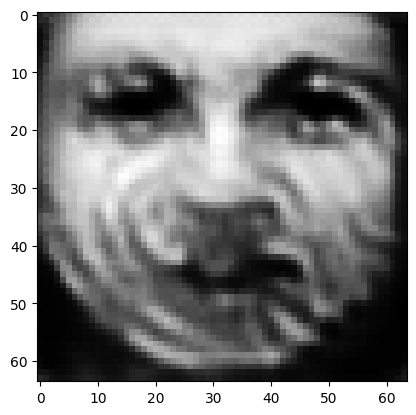

tensor([[9.1835e-05, 2.2765e-04, 1.4999e-03, 1.9547e-03, 3.0848e-04, 5.4179e-04,
         3.8113e-05, 1.7019e-04, 9.6150e-01, 6.4797e-04, 1.8359e-04, 1.0271e-03,
         3.1299e-03, 1.5116e-04, 3.4250e-04, 3.3022e-05, 1.1420e-05, 1.6656e-04,
         7.7226e-05, 3.2794e-04, 1.4664e-03, 1.2026e-04, 7.2695e-05, 2.5698e-06,
         6.7615e-04, 2.1110e-04, 7.9869e-04, 1.9472e-04, 3.7213e-04, 3.9284e-04,
         1.6815e-03, 2.2546e-05, 5.0292e-04, 4.9222e-04, 8.9607e-03, 1.0155e-04,
         3.8289e-05, 5.3199e-04, 3.6535e-03, 7.2768e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03926125168800354
tensor([[9.1376e-05, 2.2701e-04, 1.4896e-03, 1.9540e-03, 3.0677e-04, 5.3754e-04,
         3.7879e-05, 1.6942e-04, 9.6166e-01, 6.4424e-04, 1.8337e-04, 1.0240e-03,
         3.1243e-03, 1.5138e-04, 3.4250e-04, 3.2893e-05, 1.1386e-05, 1.6600e-04,
         7.6921e-05, 3.2664e-04, 1.4627e-03, 1.1993e-04, 7.2567e-05, 2.5643e-06,
         6.7430e-04, 2.1072e-04, 7.9445e-0

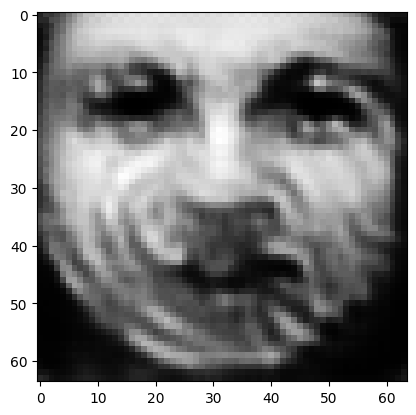

tensor([[8.9693e-05, 2.2261e-04, 1.4576e-03, 1.9170e-03, 3.0173e-04, 5.2466e-04,
         3.7105e-05, 1.6581e-04, 9.6226e-01, 6.3268e-04, 1.8086e-04, 1.0123e-03,
         3.0805e-03, 1.4994e-04, 3.4216e-04, 3.2447e-05, 1.1178e-05, 1.6393e-04,
         7.5366e-05, 3.2240e-04, 1.4524e-03, 1.1871e-04, 7.1138e-05, 2.5219e-06,
         6.6405e-04, 2.0627e-04, 7.8052e-04, 1.9084e-04, 3.6093e-04, 3.8675e-04,
         1.6592e-03, 2.2046e-05, 4.9415e-04, 4.8456e-04, 8.7931e-03, 1.0030e-04,
         3.7477e-05, 5.2390e-04, 3.5723e-03, 7.0975e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03846914693713188
tensor([[8.9295e-05, 2.2103e-04, 1.4519e-03, 1.8992e-03, 3.0083e-04, 5.2253e-04,
         3.6939e-05, 1.6466e-04, 9.6241e-01, 6.3048e-04, 1.7980e-04, 1.0098e-03,
         3.0627e-03, 1.4893e-04, 3.4211e-04, 3.2355e-05, 1.1107e-05, 1.6349e-04,
         7.4894e-05, 3.2154e-04, 1.4512e-03, 1.1839e-04, 7.0527e-05, 2.5056e-06,
         6.6072e-04, 2.0430e-04, 7.7747e-0

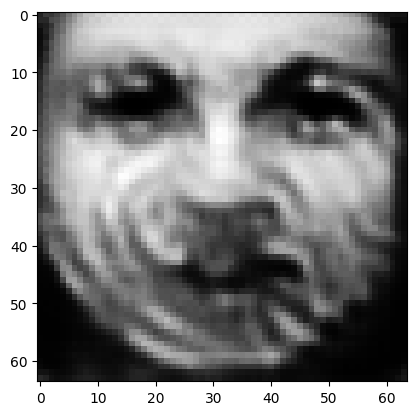

tensor([[8.7655e-05, 2.1685e-04, 1.4240e-03, 1.8612e-03, 2.9630e-04, 5.1148e-04,
         3.6206e-05, 1.6106e-04, 9.6297e-01, 6.1942e-04, 1.7743e-04, 1.0001e-03,
         3.0158e-03, 1.4749e-04, 3.4167e-04, 3.1949e-05, 1.0916e-05, 1.6185e-04,
         7.3471e-05, 3.1708e-04, 1.4436e-03, 1.1712e-04, 6.9190e-05, 2.4637e-06,
         6.5083e-04, 1.9993e-04, 7.6330e-04, 1.8652e-04, 3.5220e-04, 3.7888e-04,
         1.6117e-03, 2.1480e-05, 4.8412e-04, 4.7657e-04, 8.6528e-03, 9.8351e-05,
         3.6505e-05, 5.1108e-04, 3.4991e-03, 6.9840e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03773484379053116
tensor([[8.7229e-05, 2.1630e-04, 1.4151e-03, 1.8592e-03, 2.9489e-04, 5.0798e-04,
         3.6008e-05, 1.6036e-04, 9.6311e-01, 6.1624e-04, 1.7722e-04, 9.9759e-04,
         3.0085e-03, 1.4767e-04, 3.4155e-04, 3.1837e-05, 1.0887e-05, 1.6142e-04,
         7.3229e-05, 3.1572e-04, 1.4407e-03, 1.1680e-04, 6.9089e-05, 2.4583e-06,
         6.4896e-04, 1.9962e-04, 7.5932e-0

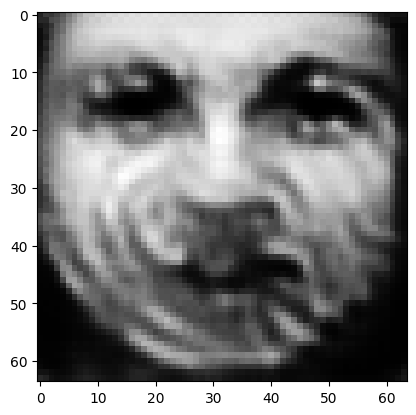

tensor([[8.5680e-05, 2.1293e-04, 1.3872e-03, 1.8312e-03, 2.9018e-04, 4.9705e-04,
         3.5285e-05, 1.5723e-04, 9.6363e-01, 6.0576e-04, 1.7541e-04, 9.8873e-04,
         2.9691e-03, 1.4679e-04, 3.4112e-04, 3.1434e-05, 1.0722e-05, 1.5978e-04,
         7.1983e-05, 3.1125e-04, 1.4320e-03, 1.1562e-04, 6.7994e-05, 2.4243e-06,
         6.3975e-04, 1.9637e-04, 7.4533e-04, 1.8306e-04, 3.4250e-04, 3.7363e-04,
         1.5909e-03, 2.1080e-05, 4.7512e-04, 4.6893e-04, 8.5292e-03, 9.7420e-05,
         3.5847e-05, 5.0458e-04, 3.4179e-03, 6.8203e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03704652935266495
tensor([[8.5337e-05, 2.1164e-04, 1.3829e-03, 1.8157e-03, 2.8956e-04, 4.9532e-04,
         3.5143e-05, 1.5626e-04, 9.6376e-01, 6.0373e-04, 1.7449e-04, 9.8674e-04,
         2.9563e-03, 1.4595e-04, 3.4116e-04, 3.1342e-05, 1.0662e-05, 1.5948e-04,
         7.1552e-05, 3.1056e-04, 1.4313e-03, 1.1537e-04, 6.7499e-05, 2.4106e-06,
         6.3710e-04, 1.9470e-04, 7.4273e-0

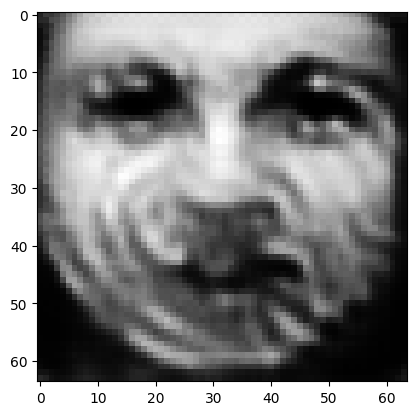

tensor([[8.3938e-05, 2.0858e-04, 1.3581e-03, 1.7951e-03, 2.8528e-04, 4.8511e-04,
         3.4441e-05, 1.5352e-04, 9.6424e-01, 5.9304e-04, 1.7266e-04, 9.7684e-04,
         2.9241e-03, 1.4505e-04, 3.4039e-04, 3.0944e-05, 1.0512e-05, 1.5763e-04,
         7.0407e-05, 3.0614e-04, 1.4210e-03, 1.1431e-04, 6.6552e-05, 2.3799e-06,
         6.2950e-04, 1.9205e-04, 7.2822e-04, 1.7967e-04, 3.3396e-04, 3.6736e-04,
         1.5608e-03, 2.0605e-05, 4.6696e-04, 4.6160e-04, 8.4060e-03, 9.6011e-05,
         3.5075e-05, 4.9470e-04, 3.3575e-03, 6.6935e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.036414407193660736
tensor([[8.3635e-05, 2.0791e-04, 1.3519e-03, 1.7908e-03, 2.8419e-04, 4.8264e-04,
         3.4287e-05, 1.5296e-04, 9.6436e-01, 5.9069e-04, 1.7236e-04, 9.7463e-04,
         2.9152e-03, 1.4495e-04, 3.4042e-04, 3.0859e-05, 1.0483e-05, 1.5730e-04,
         7.0188e-05, 3.0512e-04, 1.4186e-03, 1.1407e-04, 6.6349e-05, 2.3744e-06,
         6.2790e-04, 1.9152e-04, 7.2496e-

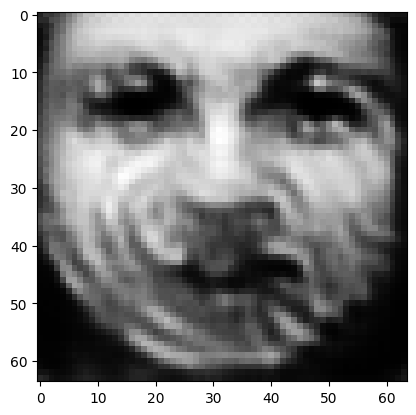

tensor([[8.2414e-05, 2.0508e-04, 1.3308e-03, 1.7678e-03, 2.8061e-04, 4.7387e-04,
         3.3692e-05, 1.5054e-04, 9.6479e-01, 5.8179e-04, 1.7057e-04, 9.6561e-04,
         2.8850e-03, 1.4399e-04, 3.4007e-04, 3.0491e-05, 1.0342e-05, 1.5580e-04,
         6.9146e-05, 3.0146e-04, 1.4102e-03, 1.1313e-04, 6.5421e-05, 2.3458e-06,
         6.2109e-04, 1.8883e-04, 7.1259e-04, 1.7703e-04, 3.2610e-04, 3.6233e-04,
         1.5414e-03, 2.0230e-05, 4.5985e-04, 4.5522e-04, 8.2983e-03, 9.5040e-05,
         3.4467e-05, 4.8781e-04, 3.2991e-03, 6.5629e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03584744408726692
tensor([[8.2136e-05, 2.0428e-04, 1.3268e-03, 1.7607e-03, 2.7982e-04, 4.7224e-04,
         3.3562e-05, 1.4985e-04, 9.6489e-01, 5.7990e-04, 1.7003e-04, 9.6410e-04,
         2.8764e-03, 1.4351e-04, 3.4005e-04, 3.0417e-05, 1.0304e-05, 1.5542e-04,
         6.8870e-05, 3.0072e-04, 1.4086e-03, 1.1290e-04, 6.5117e-05, 2.3371e-06,
         6.1911e-04, 1.8792e-04, 7.1000e-0

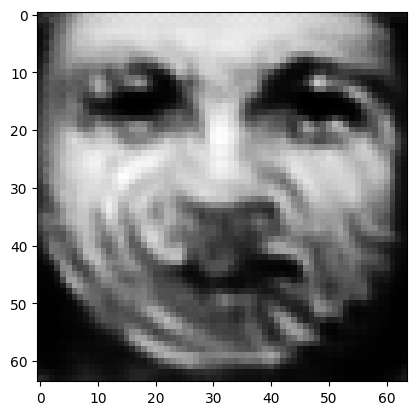

tensor([[8.1022e-05, 2.0184e-04, 1.3060e-03, 1.7453e-03, 2.7685e-04, 4.6419e-04,
         3.3040e-05, 1.4777e-04, 9.6527e-01, 5.7071e-04, 1.6853e-04, 9.5433e-04,
         2.8539e-03, 1.4290e-04, 3.3957e-04, 3.0084e-05, 1.0199e-05, 1.5395e-04,
         6.8012e-05, 2.9723e-04, 1.3996e-03, 1.1202e-04, 6.4542e-05, 2.3146e-06,
         6.1481e-04, 1.8596e-04, 6.9833e-04, 1.7452e-04, 3.1884e-04, 3.5737e-04,
         1.5225e-03, 1.9893e-05, 4.5327e-04, 4.4893e-04, 8.2160e-03, 9.4244e-05,
         3.3911e-05, 4.8101e-04, 3.2482e-03, 6.4418e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03535093367099762
tensor([[8.0766e-05, 2.0106e-04, 1.3019e-03, 1.7391e-03, 2.7619e-04, 4.6267e-04,
         3.2921e-05, 1.4714e-04, 9.6536e-01, 5.6871e-04, 1.6796e-04, 9.5227e-04,
         2.8469e-03, 1.4241e-04, 3.3948e-04, 3.0016e-05, 1.0164e-05, 1.5351e-04,
         6.7756e-05, 2.9652e-04, 1.3978e-03, 1.1180e-04, 6.4286e-05, 2.3067e-06,
         6.1338e-04, 1.8513e-04, 6.9584e-0

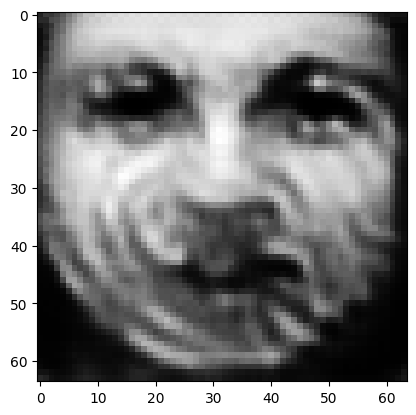

tensor([[7.9761e-05, 1.9887e-04, 1.2833e-03, 1.7243e-03, 2.7367e-04, 4.5560e-04,
         3.2464e-05, 1.4521e-04, 9.6570e-01, 5.6058e-04, 1.6644e-04, 9.4373e-04,
         2.8243e-03, 1.4169e-04, 3.3909e-04, 2.9710e-05, 1.0058e-05, 1.5223e-04,
         6.6975e-05, 2.9318e-04, 1.3893e-03, 1.1094e-04, 6.3729e-05, 2.2851e-06,
         6.0952e-04, 1.8314e-04, 6.8583e-04, 1.7202e-04, 3.1229e-04, 3.5265e-04,
         1.5019e-03, 1.9587e-05, 4.4704e-04, 4.4267e-04, 8.1497e-03, 9.3507e-05,
         3.3390e-05, 4.7449e-04, 3.2020e-03, 6.3322e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03490125760436058
tensor([[7.9529e-05, 1.9846e-04, 1.2785e-03, 1.7225e-03, 2.7301e-04, 4.5377e-04,
         3.2355e-05, 1.4483e-04, 9.6578e-01, 5.5859e-04, 1.6617e-04, 9.4166e-04,
         2.8198e-03, 1.4167e-04, 3.3901e-04, 2.9634e-05, 1.0037e-05, 1.5194e-04,
         6.6822e-05, 2.9234e-04, 1.3870e-03, 1.1073e-04, 6.3649e-05, 2.2813e-06,
         6.0879e-04, 1.8284e-04, 6.8341e-0

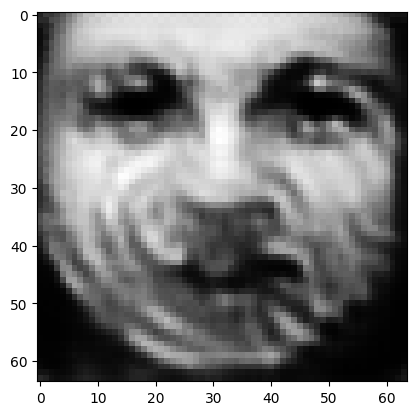

tensor([[7.8647e-05, 1.9642e-04, 1.2622e-03, 1.7094e-03, 2.7064e-04, 4.4765e-04,
         3.1966e-05, 1.4306e-04, 9.6610e-01, 5.5146e-04, 1.6474e-04, 9.3461e-04,
         2.7972e-03, 1.4085e-04, 3.3877e-04, 2.9371e-05, 9.9366e-06, 1.5075e-04,
         6.6135e-05, 2.8941e-04, 1.3788e-03, 1.0993e-04, 6.3085e-05, 2.2612e-06,
         6.0502e-04, 1.8087e-04, 6.7486e-04, 1.6982e-04, 3.0629e-04, 3.4860e-04,
         1.4866e-03, 1.9354e-05, 4.4178e-04, 4.3675e-04, 8.0915e-03, 9.3062e-05,
         3.2966e-05, 4.7007e-04, 3.1576e-03, 6.2220e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0344926118850708
tensor([[7.8466e-05, 1.9558e-04, 1.2602e-03, 1.7000e-03, 2.7032e-04, 4.4688e-04,
         3.1895e-05, 1.4253e-04, 9.6617e-01, 5.5031e-04, 1.6410e-04, 9.3308e-04,
         2.7892e-03, 1.4019e-04, 3.3867e-04, 2.9316e-05, 9.8977e-06, 1.5050e-04,
         6.5887e-05, 2.8898e-04, 1.3778e-03, 1.0978e-04, 6.2773e-05, 2.2525e-06,
         6.0351e-04, 1.7983e-04, 6.7344e-04

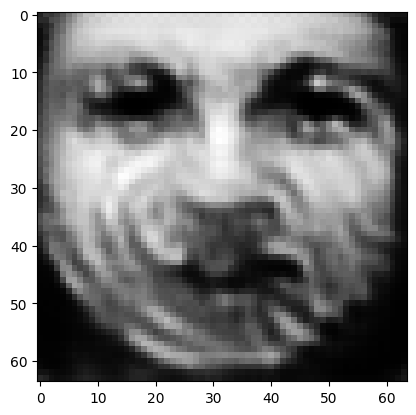

tensor([[7.7681e-05, 1.9386e-04, 1.2457e-03, 1.6893e-03, 2.6791e-04, 4.4119e-04,
         3.1536e-05, 1.4109e-04, 9.6646e-01, 5.4401e-04, 1.6297e-04, 9.2667e-04,
         2.7705e-03, 1.3961e-04, 3.3809e-04, 2.9061e-05, 9.8058e-06, 1.4939e-04,
         6.5288e-05, 2.8627e-04, 1.3694e-03, 1.0912e-04, 6.2305e-05, 2.2358e-06,
         5.9961e-04, 1.7836e-04, 6.6563e-04, 1.6795e-04, 3.0140e-04, 3.4432e-04,
         1.4700e-03, 1.9099e-05, 4.3711e-04, 4.3170e-04, 8.0223e-03, 9.2380e-05,
         3.2547e-05, 4.6474e-04, 3.1230e-03, 6.1391e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03411778435111046
tensor([[7.7496e-05, 1.9326e-04, 1.2431e-03, 1.6837e-03, 2.6745e-04, 4.4014e-04,
         3.1456e-05, 1.4062e-04, 9.6653e-01, 5.4274e-04, 1.6251e-04, 9.2543e-04,
         2.7647e-03, 1.3920e-04, 3.3805e-04, 2.9009e-05, 9.7767e-06, 1.4912e-04,
         6.5088e-05, 2.8579e-04, 1.3681e-03, 1.0895e-04, 6.2089e-05, 2.2293e-06,
         5.9839e-04, 1.7765e-04, 6.6404e-0

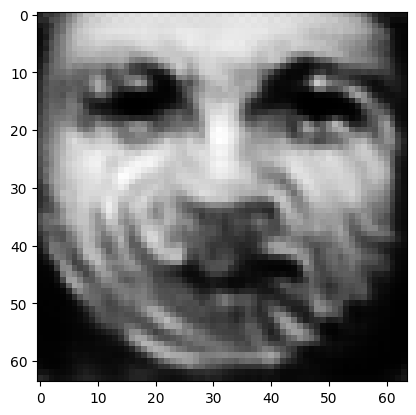

tensor([[7.6763e-05, 1.9164e-04, 1.2305e-03, 1.6734e-03, 2.6521e-04, 4.3492e-04,
         3.1113e-05, 1.3931e-04, 9.6679e-01, 5.3712e-04, 1.6147e-04, 9.1963e-04,
         2.7470e-03, 1.3866e-04, 3.3730e-04, 2.8769e-05, 9.6922e-06, 1.4811e-04,
         6.4519e-05, 2.8324e-04, 1.3605e-03, 1.0834e-04, 6.1641e-05, 2.2130e-06,
         5.9457e-04, 1.7632e-04, 6.5666e-04, 1.6625e-04, 2.9683e-04, 3.4066e-04,
         1.4572e-03, 1.8870e-05, 4.3263e-04, 4.2707e-04, 7.9615e-03, 9.1790e-05,
         3.2180e-05, 4.6051e-04, 3.0891e-03, 6.0610e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033778201788663864
tensor([[7.6597e-05, 1.9108e-04, 1.2284e-03, 1.6684e-03, 2.6475e-04, 4.3402e-04,
         3.1041e-05, 1.3890e-04, 9.6685e-01, 5.3604e-04, 1.6106e-04, 9.1851e-04,
         2.7413e-03, 1.3825e-04, 3.3716e-04, 2.8718e-05, 9.6648e-06, 1.4784e-04,
         6.4338e-05, 2.8278e-04, 1.3590e-03, 1.0820e-04, 6.1437e-05, 2.2069e-06,
         5.9333e-04, 1.7568e-04, 6.5520e-

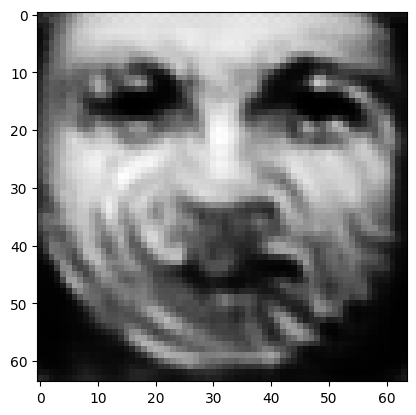

tensor([[7.5922e-05, 1.8928e-04, 1.2184e-03, 1.6557e-03, 2.6262e-04, 4.2964e-04,
         3.0731e-05, 1.3768e-04, 9.6708e-01, 5.3143e-04, 1.5997e-04, 9.1328e-04,
         2.7218e-03, 1.3739e-04, 3.3604e-04, 2.8494e-05, 9.5778e-06, 1.4679e-04,
         6.3761e-05, 2.8053e-04, 1.3516e-03, 1.0764e-04, 6.0903e-05, 2.1882e-06,
         5.8919e-04, 1.7417e-04, 6.4883e-04, 1.6461e-04, 2.9322e-04, 3.3696e-04,
         1.4433e-03, 1.8630e-05, 4.2854e-04, 4.2307e-04, 7.9003e-03, 9.1024e-05,
         3.1816e-05, 4.5612e-04, 3.0598e-03, 6.0045e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033469632267951965
tensor([[7.5759e-05, 1.8877e-04, 1.2164e-03, 1.6519e-03, 2.6216e-04, 4.2869e-04,
         3.0656e-05, 1.3735e-04, 9.6714e-01, 5.3026e-04, 1.5967e-04, 9.1205e-04,
         2.7170e-03, 1.3711e-04, 3.3579e-04, 2.8443e-05, 9.5559e-06, 1.4651e-04,
         6.3612e-05, 2.8003e-04, 1.3500e-03, 1.0751e-04, 6.0749e-05, 2.1832e-06,
         5.8817e-04, 1.7373e-04, 6.4729e-

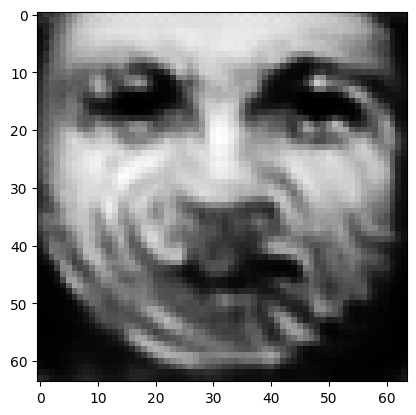

tensor([[7.5149e-05, 1.8715e-04, 1.2075e-03, 1.6405e-03, 2.6010e-04, 4.2476e-04,
         3.0375e-05, 1.3626e-04, 9.6736e-01, 5.2655e-04, 1.5869e-04, 9.0755e-04,
         2.6980e-03, 1.3626e-04, 3.3466e-04, 2.8233e-05, 9.4729e-06, 1.4553e-04,
         6.3068e-05, 2.7802e-04, 1.3428e-03, 1.0699e-04, 6.0213e-05, 2.1653e-06,
         5.8400e-04, 1.7233e-04, 6.4156e-04, 1.6312e-04, 2.9003e-04, 3.3378e-04,
         1.4325e-03, 1.8416e-05, 4.2495e-04, 4.1941e-04, 7.8431e-03, 9.0311e-05,
         3.1496e-05, 4.5265e-04, 3.0319e-03, 5.9540e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03318806365132332
tensor([[7.5016e-05, 1.8668e-04, 1.2058e-03, 1.6366e-03, 2.5968e-04, 4.2401e-04,
         3.0312e-05, 1.3595e-04, 9.6741e-01, 5.2564e-04, 1.5839e-04, 9.0660e-04,
         2.6928e-03, 1.3595e-04, 3.3448e-04, 2.8190e-05, 9.4510e-06, 1.4530e-04,
         6.2929e-05, 2.7762e-04, 1.3415e-03, 1.0687e-04, 6.0043e-05, 2.1604e-06,
         5.8293e-04, 1.7185e-04, 6.4030e-0

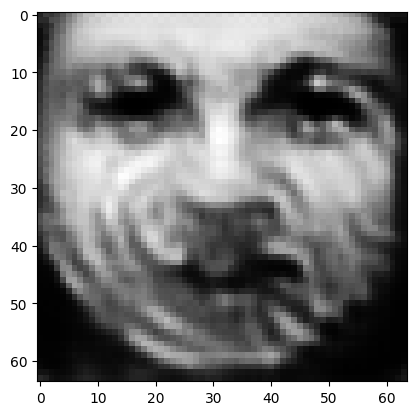

tensor([[7.4455e-05, 1.8519e-04, 1.1976e-03, 1.6264e-03, 2.5793e-04, 4.2030e-04,
         3.0060e-05, 1.3493e-04, 9.6761e-01, 5.2189e-04, 1.5745e-04, 9.0222e-04,
         2.6762e-03, 1.3523e-04, 3.3352e-04, 2.7994e-05, 9.3777e-06, 1.4442e-04,
         6.2446e-05, 2.7575e-04, 1.3349e-03, 1.0639e-04, 5.9589e-05, 2.1445e-06,
         5.7947e-04, 1.7059e-04, 6.3500e-04, 1.6173e-04, 2.8710e-04, 3.3076e-04,
         1.4218e-03, 1.8224e-05, 4.2175e-04, 4.1595e-04, 7.7907e-03, 8.9692e-05,
         3.1198e-05, 4.4949e-04, 3.0072e-03, 5.9059e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032929256558418274
tensor([[7.4321e-05, 1.8491e-04, 1.1952e-03, 1.6253e-03, 2.5752e-04, 4.1919e-04,
         2.9995e-05, 1.3475e-04, 9.6765e-01, 5.2074e-04, 1.5732e-04, 9.0092e-04,
         2.6733e-03, 1.3523e-04, 3.3333e-04, 2.7943e-05, 9.3651e-06, 1.4424e-04,
         6.2363e-05, 2.7522e-04, 1.3331e-03, 1.0628e-04, 5.9541e-05, 2.1424e-06,
         5.7898e-04, 1.7046e-04, 6.3351e-

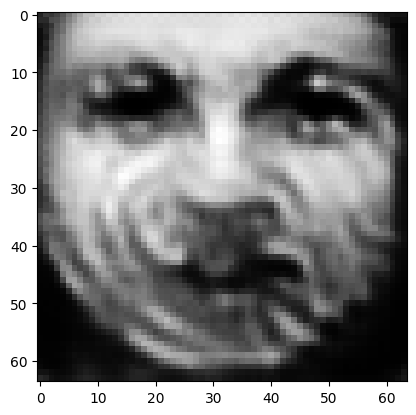

tensor([[7.3826e-05, 1.8350e-04, 1.1877e-03, 1.6149e-03, 2.5591e-04, 4.1592e-04,
         2.9774e-05, 1.3376e-04, 9.6784e-01, 5.1755e-04, 1.5636e-04, 8.9730e-04,
         2.6569e-03, 1.3444e-04, 3.3255e-04, 2.7769e-05, 9.2912e-06, 1.4342e-04,
         6.1914e-05, 2.7359e-04, 1.3273e-03, 1.0583e-04, 5.9064e-05, 2.1268e-06,
         5.7539e-04, 1.6912e-04, 6.2912e-04, 1.6048e-04, 2.8422e-04, 3.2812e-04,
         1.4134e-03, 1.8064e-05, 4.1885e-04, 4.1271e-04, 7.7438e-03, 8.9229e-05,
         3.0943e-05, 4.4715e-04, 2.9832e-03, 5.8556e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03268861398100853
tensor([[7.3711e-05, 1.8305e-04, 1.1863e-03, 1.6108e-03, 2.5553e-04, 4.1531e-04,
         2.9726e-05, 1.3346e-04, 9.6789e-01, 5.1694e-04, 1.5606e-04, 8.9660e-04,
         2.6518e-03, 1.3410e-04, 3.3236e-04, 2.7733e-05, 9.2690e-06, 1.4321e-04,
         6.1780e-05, 2.7328e-04, 1.3262e-03, 1.0573e-04, 5.8892e-05, 2.1218e-06,
         5.7424e-04, 1.6861e-04, 6.2823e-0

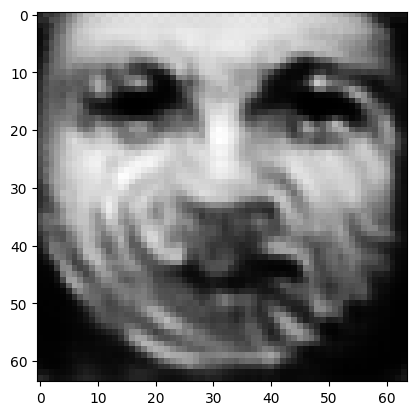

tensor([[7.3238e-05, 1.8170e-04, 1.1793e-03, 1.6005e-03, 2.5404e-04, 4.1217e-04,
         2.9521e-05, 1.3252e-04, 9.6806e-01, 5.1391e-04, 1.5515e-04, 8.9323e-04,
         2.6366e-03, 1.3336e-04, 3.3167e-04, 2.7571e-05, 9.1993e-06, 1.4248e-04,
         6.1346e-05, 2.7178e-04, 1.3208e-03, 1.0531e-04, 5.8450e-05, 2.1067e-06,
         5.7085e-04, 1.6730e-04, 6.2417e-04, 1.5914e-04, 2.8185e-04, 3.2538e-04,
         1.4013e-03, 1.7892e-05, 4.1614e-04, 4.0987e-04, 7.6938e-03, 8.8594e-05,
         3.0657e-05, 4.4388e-04, 2.9629e-03, 5.8208e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03246164321899414
tensor([[7.3108e-05, 1.8143e-04, 1.1770e-03, 1.5989e-03, 2.5369e-04, 4.1121e-04,
         2.9466e-05, 1.3231e-04, 9.6810e-01, 5.1293e-04, 1.5498e-04, 8.9215e-04,
         2.6333e-03, 1.3331e-04, 3.3151e-04, 2.7526e-05, 9.1861e-06, 1.4231e-04,
         6.1264e-05, 2.7130e-04, 1.3194e-03, 1.0520e-04, 5.8393e-05, 2.1042e-06,
         5.7033e-04, 1.6711e-04, 6.2294e-0

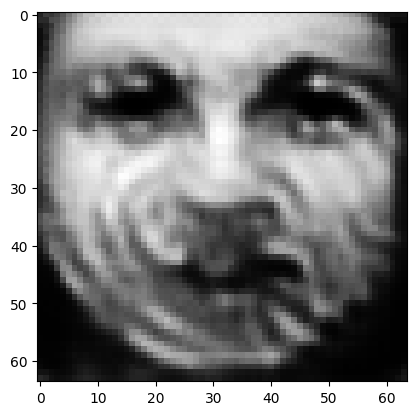

tensor([[7.2618e-05, 1.8015e-04, 1.1695e-03, 1.5879e-03, 2.5232e-04, 4.0806e-04,
         2.9266e-05, 1.3130e-04, 9.6828e-01, 5.0989e-04, 1.5407e-04, 8.8901e-04,
         2.6180e-03, 1.3261e-04, 3.3103e-04, 2.7372e-05, 9.1198e-06, 1.4166e-04,
         6.0838e-05, 2.6981e-04, 1.3148e-03, 1.0478e-04, 5.7974e-05, 2.0896e-06,
         5.6724e-04, 1.6578e-04, 6.1896e-04, 1.5790e-04, 2.7928e-04, 3.2287e-04,
         1.3907e-03, 1.7749e-05, 4.1342e-04, 4.0705e-04, 7.6513e-03, 8.8172e-05,
         3.0405e-05, 4.4125e-04, 2.9411e-03, 5.7771e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032238662242889404
tensor([[7.2491e-05, 1.7994e-04, 1.1673e-03, 1.5866e-03, 2.5196e-04, 4.0716e-04,
         2.9214e-05, 1.3110e-04, 9.6832e-01, 5.0911e-04, 1.5391e-04, 8.8820e-04,
         2.6150e-03, 1.3255e-04, 3.3086e-04, 2.7330e-05, 9.1062e-06, 1.4150e-04,
         6.0748e-05, 2.6938e-04, 1.3134e-03, 1.0467e-04, 5.7913e-05, 2.0869e-06,
         5.6660e-04, 1.6560e-04, 6.1787e-

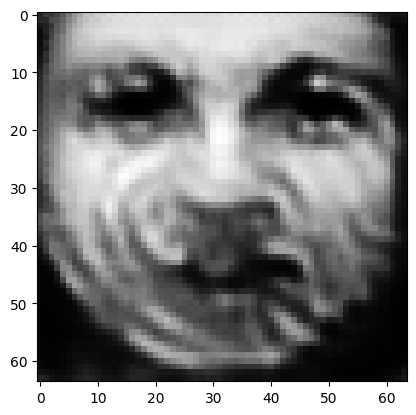

tensor([[7.2024e-05, 1.7874e-04, 1.1602e-03, 1.5765e-03, 2.5059e-04, 4.0421e-04,
         2.9019e-05, 1.3014e-04, 9.6848e-01, 5.0624e-04, 1.5310e-04, 8.8537e-04,
         2.6000e-03, 1.3189e-04, 3.3031e-04, 2.7187e-05, 9.0441e-06, 1.4087e-04,
         6.0349e-05, 2.6795e-04, 1.3090e-03, 1.0427e-04, 5.7514e-05, 2.0729e-06,
         5.6353e-04, 1.6439e-04, 6.1395e-04, 1.5667e-04, 2.7688e-04, 3.2058e-04,
         1.3808e-03, 1.7614e-05, 4.1074e-04, 4.0432e-04, 7.6111e-03, 8.7748e-05,
         3.0169e-05, 4.3885e-04, 2.9195e-03, 5.7371e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03202798590064049
tensor([[7.1899e-05, 1.7867e-04, 1.1576e-03, 1.5771e-03, 2.5032e-04, 4.0314e-04,
         2.8963e-05, 1.2997e-04, 9.6852e-01, 5.0520e-04, 1.5300e-04, 8.8448e-04,
         2.5996e-03, 1.3200e-04, 3.3028e-04, 2.7142e-05, 9.0373e-06, 1.4072e-04,
         6.0287e-05, 2.6748e-04, 1.3075e-03, 1.0417e-04, 5.7529e-05, 2.0720e-06,
         5.6342e-04, 1.6441e-04, 6.1271e-0

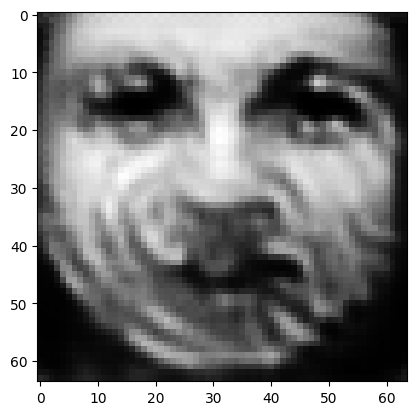

tensor([[7.1423e-05, 1.7760e-04, 1.1496e-03, 1.5723e-03, 2.4956e-04, 3.9968e-04,
         2.8782e-05, 1.2910e-04, 9.6868e-01, 5.0117e-04, 1.5212e-04, 8.8036e-04,
         2.5910e-03, 1.3163e-04, 3.2990e-04, 2.6971e-05, 8.9926e-06, 1.4013e-04,
         5.9941e-05, 2.6586e-04, 1.3019e-03, 1.0374e-04, 5.7364e-05, 2.0614e-06,
         5.6257e-04, 1.6346e-04, 6.0840e-04, 1.5551e-04, 2.7360e-04, 3.1831e-04,
         1.3749e-03, 1.7524e-05, 4.0868e-04, 4.0142e-04, 7.5800e-03, 8.7796e-05,
         2.9979e-05, 4.3743e-04, 2.8994e-03, 5.6719e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03182315453886986
tensor([[7.1316e-05, 1.7725e-04, 1.1480e-03, 1.5697e-03, 2.4937e-04, 3.9902e-04,
         2.8743e-05, 1.2884e-04, 9.6872e-01, 5.0035e-04, 1.5184e-04, 8.7952e-04,
         2.5878e-03, 1.3140e-04, 3.2981e-04, 2.6936e-05, 8.9778e-06, 1.3997e-04,
         5.9835e-05, 2.6554e-04, 1.3008e-03, 1.0363e-04, 5.7270e-05, 2.0576e-06,
         5.6208e-04, 1.6307e-04, 6.0755e-0

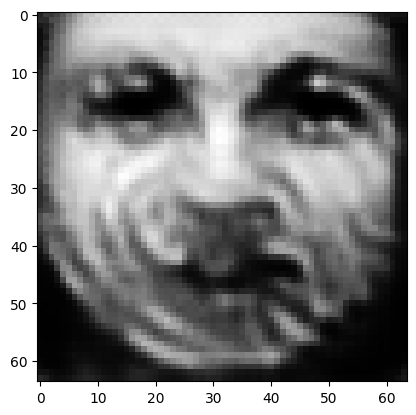

tensor([[7.0872e-05, 1.7634e-04, 1.1402e-03, 1.5665e-03, 2.4853e-04, 3.9574e-04,
         2.8572e-05, 1.2809e-04, 9.6886e-01, 4.9670e-04, 1.5111e-04, 8.7580e-04,
         2.5801e-03, 1.3116e-04, 3.2939e-04, 2.6778e-05, 8.9386e-06, 1.3941e-04,
         5.9531e-05, 2.6399e-04, 1.2953e-03, 1.0322e-04, 5.7143e-05, 2.0485e-06,
         5.6118e-04, 1.6232e-04, 6.0356e-04, 1.5433e-04, 2.7078e-04, 3.1603e-04,
         1.3672e-03, 1.7426e-05, 4.0676e-04, 3.9868e-04, 7.5481e-03, 8.7713e-05,
         2.9778e-05, 4.3570e-04, 2.8810e-03, 5.6190e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03163005784153938
tensor([[7.0771e-05, 1.7602e-04, 1.1388e-03, 1.5642e-03, 2.4834e-04, 3.9515e-04,
         2.8533e-05, 1.2785e-04, 9.6890e-01, 4.9594e-04, 1.5086e-04, 8.7509e-04,
         2.5769e-03, 1.3095e-04, 3.2927e-04, 2.6747e-05, 8.9251e-06, 1.3925e-04,
         5.9437e-05, 2.6367e-04, 1.2943e-03, 1.0312e-04, 5.7052e-05, 2.0450e-06,
         5.6067e-04, 1.6197e-04, 6.0272e-0

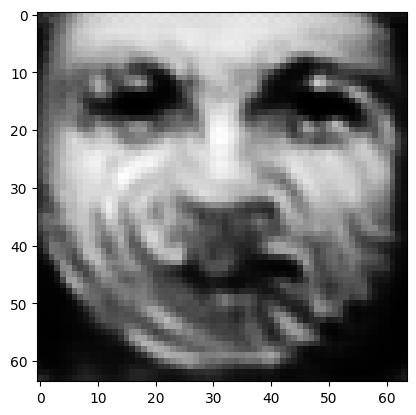

tensor([[7.0359e-05, 1.7522e-04, 1.1314e-03, 1.5615e-03, 2.4757e-04, 3.9204e-04,
         2.8373e-05, 1.2715e-04, 9.6904e-01, 4.9237e-04, 1.5024e-04, 8.7168e-04,
         2.5696e-03, 1.3081e-04, 3.2898e-04, 2.6601e-05, 8.8895e-06, 1.3878e-04,
         5.9180e-05, 2.6217e-04, 1.2894e-03, 1.0273e-04, 5.6951e-05, 2.0373e-06,
         5.5982e-04, 1.6131e-04, 5.9899e-04, 1.5323e-04, 2.6811e-04, 3.1391e-04,
         1.3600e-03, 1.7343e-05, 4.0488e-04, 3.9600e-04, 7.5192e-03, 8.7680e-05,
         2.9595e-05, 4.3430e-04, 2.8628e-03, 5.5672e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03144778683781624
tensor([[7.0267e-05, 1.7492e-04, 1.1301e-03, 1.5591e-03, 2.4740e-04, 3.9149e-04,
         2.8338e-05, 1.2693e-04, 9.6908e-01, 4.9163e-04, 1.5002e-04, 8.7103e-04,
         2.5667e-03, 1.3062e-04, 3.2892e-04, 2.6573e-05, 8.8769e-06, 1.3867e-04,
         5.9095e-05, 2.6190e-04, 1.2885e-03, 1.0263e-04, 5.6868e-05, 2.0341e-06,
         5.5934e-04, 1.6097e-04, 5.9822e-0

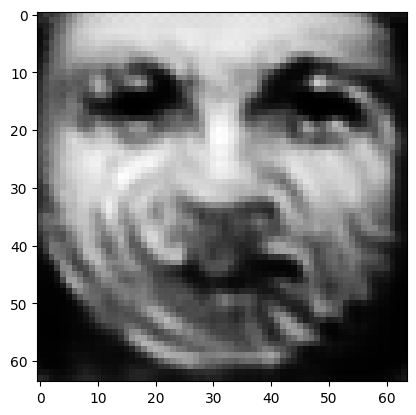

tensor([[6.9881e-05, 1.7412e-04, 1.1236e-03, 1.5559e-03, 2.4671e-04, 3.8868e-04,
         2.8187e-05, 1.2623e-04, 9.6921e-01, 4.8828e-04, 1.4939e-04, 8.6798e-04,
         2.5604e-03, 1.3042e-04, 3.2869e-04, 2.6442e-05, 8.8430e-06, 1.3820e-04,
         5.8836e-05, 2.6058e-04, 1.2841e-03, 1.0228e-04, 5.6757e-05, 2.0262e-06,
         5.5842e-04, 1.6028e-04, 5.9473e-04, 1.5218e-04, 2.6566e-04, 3.1187e-04,
         1.3523e-03, 1.7257e-05, 4.0315e-04, 3.9360e-04, 7.4895e-03, 8.7605e-05,
         2.9410e-05, 4.3260e-04, 2.8471e-03, 5.5216e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031277846544981
tensor([[6.9790e-05, 1.7393e-04, 1.1219e-03, 1.5552e-03, 2.4651e-04, 3.8799e-04,
         2.8151e-05, 1.2608e-04, 9.6924e-01, 4.8749e-04, 1.4927e-04, 8.6721e-04,
         2.5584e-03, 1.3039e-04, 3.2859e-04, 2.6410e-05, 8.8350e-06, 1.3810e-04,
         5.8782e-05, 2.6023e-04, 1.2830e-03, 1.0219e-04, 5.6734e-05, 2.0245e-06,
         5.5817e-04, 1.6014e-04, 5.9391e-04,

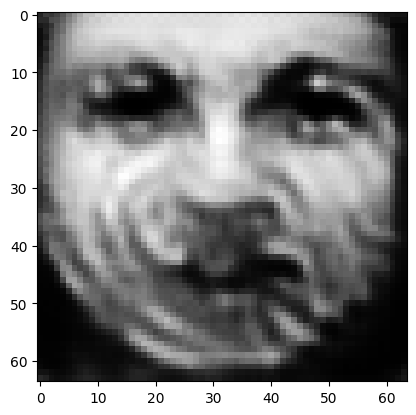

tensor([[6.9436e-05, 1.7311e-04, 1.1162e-03, 1.5507e-03, 2.4580e-04, 3.8553e-04,
         2.8015e-05, 1.2541e-04, 9.6936e-01, 4.8455e-04, 1.4866e-04, 8.6461e-04,
         2.5508e-03, 1.3009e-04, 3.2829e-04, 2.6296e-05, 8.7990e-06, 1.3766e-04,
         5.8529e-05, 2.5904e-04, 1.2791e-03, 1.0187e-04, 5.6577e-05, 2.0160e-06,
         5.5690e-04, 1.5937e-04, 5.9084e-04, 1.5123e-04, 2.6340e-04, 3.0999e-04,
         1.3456e-03, 1.7179e-05, 4.0148e-04, 3.9131e-04, 7.4622e-03, 8.7544e-05,
         2.9246e-05, 4.3129e-04, 2.8315e-03, 5.4803e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.031119775027036667
tensor([[6.9343e-05, 1.7302e-04, 1.1143e-03, 1.5513e-03, 2.4563e-04, 3.8473e-04,
         2.7977e-05, 1.2529e-04, 9.6939e-01, 4.8369e-04, 1.4858e-04, 8.6381e-04,
         2.5502e-03, 1.3016e-04, 3.2826e-04, 2.6262e-05, 8.7945e-06, 1.3756e-04,
         5.8489e-05, 2.5868e-04, 1.2779e-03, 1.0179e-04, 5.6598e-05, 2.0153e-06,
         5.5691e-04, 1.5936e-04, 5.8993e-

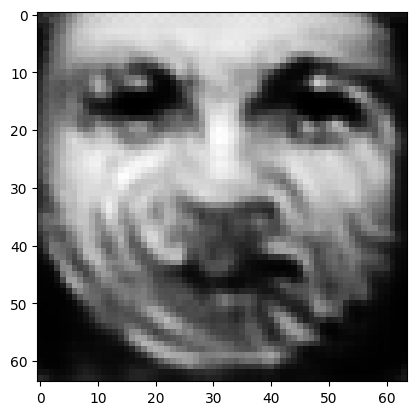

tensor([[6.9007e-05, 1.7231e-04, 1.1087e-03, 1.5479e-03, 2.4493e-04, 3.8233e-04,
         2.7845e-05, 1.2467e-04, 9.6950e-01, 4.8093e-04, 1.4803e-04, 8.6140e-04,
         2.5435e-03, 1.2993e-04, 3.2801e-04, 2.6152e-05, 8.7621e-06, 1.3714e-04,
         5.8257e-05, 2.5754e-04, 1.2741e-03, 1.0149e-04, 5.6470e-05, 2.0078e-06,
         5.5579e-04, 1.5872e-04, 5.8697e-04, 1.5036e-04, 2.6110e-04, 3.0842e-04,
         1.3415e-03, 1.7117e-05, 4.0005e-04, 3.8921e-04, 7.4368e-03, 8.7585e-05,
         2.9107e-05, 4.3044e-04, 2.8165e-03, 5.4350e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030970696359872818
tensor([[6.8927e-05, 1.7214e-04, 1.1074e-03, 1.5470e-03, 2.4474e-04, 3.8176e-04,
         2.7814e-05, 1.2453e-04, 9.6953e-01, 4.8030e-04, 1.4791e-04, 8.6080e-04,
         2.5416e-03, 1.2989e-04, 3.2790e-04, 2.6126e-05, 8.7540e-06, 1.3704e-04,
         5.8203e-05, 2.5725e-04, 1.2732e-03, 1.0141e-04, 5.6438e-05, 2.0060e-06,
         5.5546e-04, 1.5857e-04, 5.8627e-

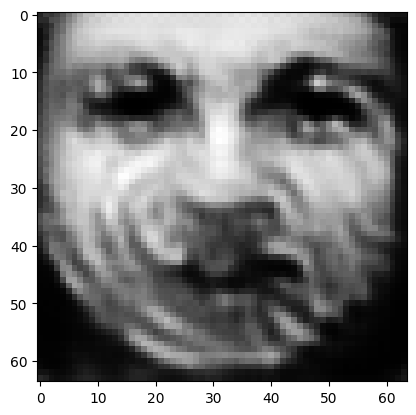

tensor([[6.8616e-05, 1.7144e-04, 1.1023e-03, 1.5432e-03, 2.4403e-04, 3.7959e-04,
         2.7689e-05, 1.2394e-04, 9.6964e-01, 4.7781e-04, 1.4740e-04, 8.5867e-04,
         2.5347e-03, 1.2961e-04, 3.2759e-04, 2.6025e-05, 8.7213e-06, 1.3662e-04,
         5.7974e-05, 2.5620e-04, 1.2697e-03, 1.0114e-04, 5.6290e-05, 1.9984e-06,
         5.5415e-04, 1.5795e-04, 5.8356e-04, 1.4950e-04, 2.5918e-04, 3.0685e-04,
         1.3358e-03, 1.7047e-05, 3.9862e-04, 3.8722e-04, 7.4104e-03, 8.7496e-05,
         2.8963e-05, 4.2929e-04, 2.8030e-03, 5.4004e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030831189826130867
tensor([[6.8543e-05, 1.7130e-04, 1.1007e-03, 1.5431e-03, 2.4379e-04, 3.7899e-04,
         2.7657e-05, 1.2384e-04, 9.6967e-01, 4.7713e-04, 1.4734e-04, 8.5802e-04,
         2.5325e-03, 1.2963e-04, 3.2751e-04, 2.6000e-05, 8.7153e-06, 1.3652e-04,
         5.7944e-05, 2.5588e-04, 1.2686e-03, 1.0106e-04, 5.6276e-05, 1.9973e-06,
         5.5391e-04, 1.5788e-04, 5.8283e-

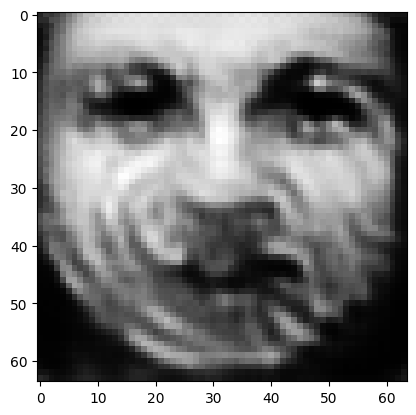

tensor([[6.8249e-05, 1.7070e-04, 1.0950e-03, 1.5410e-03, 2.4295e-04, 3.7681e-04,
         2.7532e-05, 1.2329e-04, 9.6977e-01, 4.7468e-04, 1.4697e-04, 8.5608e-04,
         2.5243e-03, 1.2948e-04, 3.2735e-04, 2.5909e-05, 8.6870e-06, 1.3609e-04,
         5.7774e-05, 2.5483e-04, 1.2650e-03, 1.0076e-04, 5.6160e-05, 1.9911e-06,
         5.5277e-04, 1.5736e-04, 5.8022e-04, 1.4862e-04, 2.5727e-04, 3.0568e-04,
         1.3320e-03, 1.7009e-05, 3.9711e-04, 3.8506e-04, 7.3931e-03, 8.7506e-05,
         2.8848e-05, 4.2906e-04, 2.7856e-03, 5.3606e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03069593943655491
tensor([[6.8184e-05, 1.7044e-04, 1.0942e-03, 1.5381e-03, 2.4282e-04, 3.7649e-04,
         2.7511e-05, 1.2312e-04, 9.6980e-01, 4.7430e-04, 1.4677e-04, 8.5563e-04,
         2.5210e-03, 1.2927e-04, 3.2728e-04, 2.5891e-05, 8.6751e-06, 1.3601e-04,
         5.7704e-05, 2.5466e-04, 1.2645e-03, 1.0070e-04, 5.6068e-05, 1.9882e-06,
         5.5227e-04, 1.5704e-04, 5.7975e-0

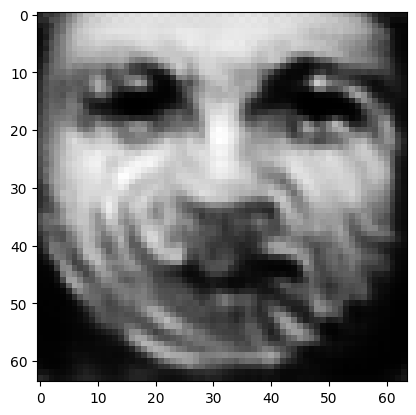

tensor([[6.7906e-05, 1.6989e-04, 1.0888e-03, 1.5353e-03, 2.4221e-04, 3.7440e-04,
         2.7396e-05, 1.2264e-04, 9.6989e-01, 4.7202e-04, 1.4634e-04, 8.5332e-04,
         2.5146e-03, 1.2915e-04, 3.2716e-04, 2.5794e-05, 8.6482e-06, 1.3564e-04,
         5.7528e-05, 2.5366e-04, 1.2612e-03, 1.0045e-04, 5.5977e-05, 1.9829e-06,
         5.5155e-04, 1.5657e-04, 5.7715e-04, 1.4786e-04, 2.5560e-04, 3.0429e-04,
         1.3259e-03, 1.6950e-05, 3.9568e-04, 3.8328e-04, 7.3733e-03, 8.7414e-05,
         2.8717e-05, 4.2780e-04, 2.7729e-03, 5.3296e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030569111928343773
tensor([[6.7839e-05, 1.6971e-04, 1.0877e-03, 1.5337e-03, 2.4208e-04, 3.7398e-04,
         2.7371e-05, 1.2249e-04, 9.6992e-01, 4.7155e-04, 1.4619e-04, 8.5282e-04,
         2.5127e-03, 1.2903e-04, 3.2713e-04, 2.5772e-05, 8.6394e-06, 1.3555e-04,
         5.7472e-05, 2.5347e-04, 1.2606e-03, 1.0040e-04, 5.5924e-05, 1.9809e-06,
         5.5123e-04, 1.5637e-04, 5.7658e-

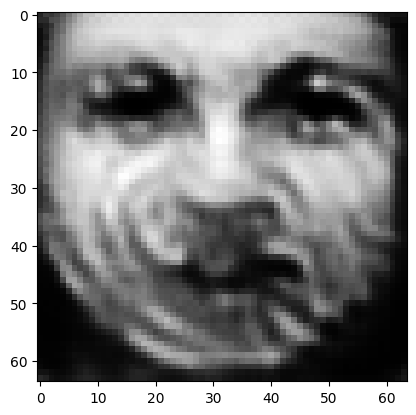

tensor([[6.7576e-05, 1.6920e-04, 1.0825e-03, 1.5310e-03, 2.4144e-04, 3.7202e-04,
         2.7262e-05, 1.2204e-04, 9.7001e-01, 4.6944e-04, 1.4580e-04, 8.5077e-04,
         2.5063e-03, 1.2891e-04, 3.2704e-04, 2.5681e-05, 8.6125e-06, 1.3522e-04,
         5.7305e-05, 2.5254e-04, 1.2575e-03, 1.0016e-04, 5.5823e-05, 1.9757e-06,
         5.5031e-04, 1.5589e-04, 5.7416e-04, 1.4716e-04, 2.5392e-04, 3.0310e-04,
         1.3211e-03, 1.6898e-05, 3.9433e-04, 3.8156e-04, 7.3525e-03, 8.7366e-05,
         2.8597e-05, 4.2676e-04, 2.7601e-03, 5.2965e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03044516034424305
tensor([[6.7512e-05, 1.6902e-04, 1.0815e-03, 1.5294e-03, 2.4130e-04, 3.7164e-04,
         2.7239e-05, 1.2190e-04, 9.7004e-01, 4.6902e-04, 1.4565e-04, 8.5034e-04,
         2.5041e-03, 1.2878e-04, 3.2700e-04, 2.5661e-05, 8.6034e-06, 1.3513e-04,
         5.7251e-05, 2.5235e-04, 1.2569e-03, 1.0011e-04, 5.5765e-05, 1.9737e-06,
         5.4992e-04, 1.5568e-04, 5.7362e-0

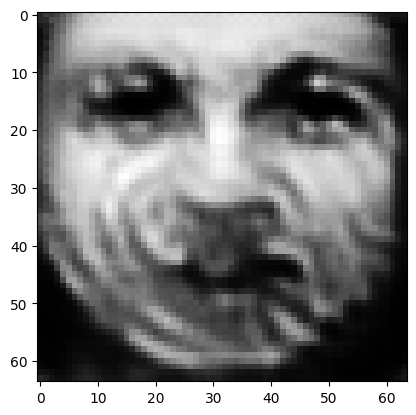

tensor([[6.7260e-05, 1.6845e-04, 1.0768e-03, 1.5251e-03, 2.4071e-04, 3.6994e-04,
         2.7144e-05, 1.2142e-04, 9.7013e-01, 4.6716e-04, 1.4523e-04, 8.4847e-04,
         2.4968e-03, 1.2854e-04, 3.2690e-04, 2.5580e-05, 8.5739e-06, 1.3484e-04,
         5.7081e-05, 2.5152e-04, 1.2543e-03, 9.9877e-05, 5.5623e-05, 1.9677e-06,
         5.4876e-04, 1.5507e-04, 5.7146e-04, 1.4647e-04, 2.5245e-04, 3.0183e-04,
         1.3147e-03, 1.6838e-05, 3.9294e-04, 3.7986e-04, 7.3316e-03, 8.7237e-05,
         2.8467e-05, 4.2538e-04, 2.7481e-03, 5.2697e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03032512404024601
tensor([[6.7201e-05, 1.6828e-04, 1.0759e-03, 1.5236e-03, 2.4057e-04, 3.6960e-04,
         2.7123e-05, 1.2129e-04, 9.7015e-01, 4.6678e-04, 1.4509e-04, 8.4812e-04,
         2.4948e-03, 1.2842e-04, 3.2685e-04, 2.5562e-05, 8.5651e-06, 1.3475e-04,
         5.7029e-05, 2.5136e-04, 1.2537e-03, 9.9824e-05, 5.5567e-05, 1.9657e-06,
         5.4835e-04, 1.5487e-04, 5.7103e-0

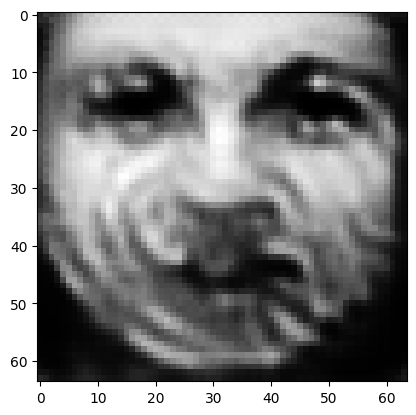

tensor([[6.6972e-05, 1.6775e-04, 1.0715e-03, 1.5202e-03, 2.3993e-04, 3.6800e-04,
         2.7034e-05, 1.2088e-04, 9.7024e-01, 4.6515e-04, 1.4472e-04, 8.4637e-04,
         2.4880e-03, 1.2818e-04, 3.2662e-04, 2.5483e-05, 8.5365e-06, 1.3443e-04,
         5.6868e-05, 2.5059e-04, 1.2509e-03, 9.9611e-05, 5.5433e-05, 1.9598e-06,
         5.4715e-04, 1.5435e-04, 5.6907e-04, 1.4583e-04, 2.5109e-04, 3.0067e-04,
         1.3098e-03, 1.6782e-05, 3.9173e-04, 3.7828e-04, 7.3102e-03, 8.7114e-05,
         2.8352e-05, 4.2429e-04, 2.7366e-03, 5.2450e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030213285237550735
tensor([[6.6917e-05, 1.6760e-04, 1.0707e-03, 1.5190e-03, 2.3977e-04, 3.6768e-04,
         2.7013e-05, 1.2076e-04, 9.7026e-01, 4.6480e-04, 1.4461e-04, 8.4602e-04,
         2.4862e-03, 1.2807e-04, 3.2654e-04, 2.5465e-05, 8.5283e-06, 1.3435e-04,
         5.6821e-05, 2.5042e-04, 1.2502e-03, 9.9562e-05, 5.5382e-05, 1.9580e-06,
         5.4675e-04, 1.5418e-04, 5.6861e-

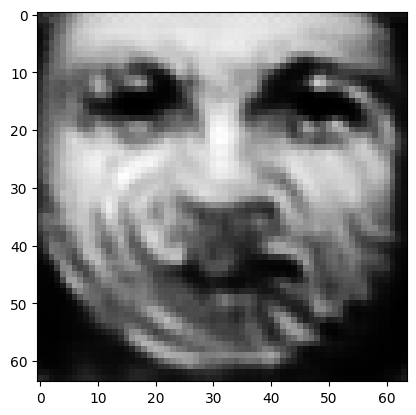

tensor([[6.6707e-05, 1.6710e-04, 1.0666e-03, 1.5155e-03, 2.3917e-04, 3.6624e-04,
         2.6935e-05, 1.2037e-04, 9.7034e-01, 4.6337e-04, 1.4425e-04, 8.4447e-04,
         2.4793e-03, 1.2781e-04, 3.2636e-04, 2.5394e-05, 8.5007e-06, 1.3405e-04,
         5.6671e-05, 2.4974e-04, 1.2477e-03, 9.9357e-05, 5.5245e-05, 1.9523e-06,
         5.4559e-04, 1.5365e-04, 5.6691e-04, 1.4521e-04, 2.4988e-04, 2.9960e-04,
         1.3050e-03, 1.6731e-05, 3.9062e-04, 3.7680e-04, 7.2902e-03, 8.6991e-05,
         2.8244e-05, 4.2331e-04, 2.7257e-03, 5.2228e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030108952894806862
tensor([[6.6656e-05, 1.6701e-04, 1.0654e-03, 1.5152e-03, 2.3901e-04, 3.6584e-04,
         2.6916e-05, 1.2029e-04, 9.7036e-01, 4.6300e-04, 1.4419e-04, 8.4405e-04,
         2.4778e-03, 1.2780e-04, 3.2632e-04, 2.5376e-05, 8.4951e-06, 1.3399e-04,
         5.6643e-05, 2.4954e-04, 1.2470e-03, 9.9305e-05, 5.5228e-05, 1.9513e-06,
         5.4539e-04, 1.5357e-04, 5.6647e-

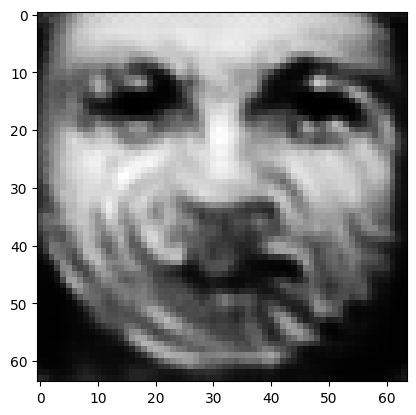

tensor([[6.6458e-05, 1.6659e-04, 1.0615e-03, 1.5131e-03, 2.3841e-04, 3.6439e-04,
         2.6839e-05, 1.1994e-04, 9.7043e-01, 4.6159e-04, 1.4389e-04, 8.4265e-04,
         2.4721e-03, 1.2763e-04, 3.2616e-04, 2.5307e-05, 8.4714e-06, 1.3370e-04,
         5.6510e-05, 2.4886e-04, 1.2445e-03, 9.9108e-05, 5.5126e-05, 1.9465e-06,
         5.4441e-04, 1.5315e-04, 5.6482e-04, 1.4467e-04, 2.4862e-04, 2.9879e-04,
         1.3023e-03, 1.6697e-05, 3.8965e-04, 3.7538e-04, 7.2731e-03, 8.6967e-05,
         2.8160e-05, 4.2291e-04, 2.7145e-03, 5.1969e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03001178242266178
tensor([[6.6410e-05, 1.6645e-04, 1.0607e-03, 1.5118e-03, 2.3829e-04, 3.6411e-04,
         2.6823e-05, 1.1983e-04, 9.7045e-01, 4.6129e-04, 1.4378e-04, 8.4235e-04,
         2.4703e-03, 1.2752e-04, 3.2613e-04, 2.5292e-05, 8.4640e-06, 1.3363e-04,
         5.6468e-05, 2.4873e-04, 1.2440e-03, 9.9063e-05, 5.5080e-05, 1.9448e-06,
         5.4408e-04, 1.5298e-04, 5.6447e-0

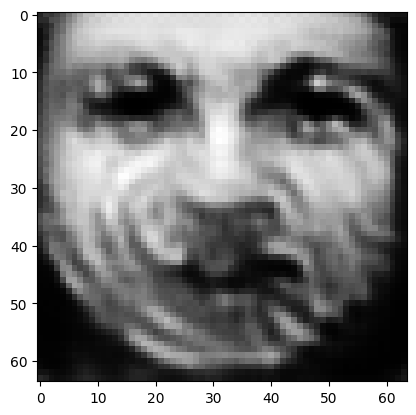

tensor([[6.6224e-05, 1.6599e-04, 1.0573e-03, 1.5081e-03, 2.3778e-04, 3.6290e-04,
         2.6757e-05, 1.1946e-04, 9.7052e-01, 4.6013e-04, 1.4341e-04, 8.4114e-04,
         2.4643e-03, 1.2722e-04, 3.2598e-04, 2.5230e-05, 8.4375e-06, 1.3337e-04,
         5.6319e-05, 2.4816e-04, 1.2420e-03, 9.8888e-05, 5.4935e-05, 1.9391e-06,
         5.4292e-04, 1.5244e-04, 5.6302e-04, 1.4408e-04, 2.4761e-04, 2.9780e-04,
         1.2971e-03, 1.6646e-05, 3.8869e-04, 3.7415e-04, 7.2542e-03, 8.6814e-05,
         2.8053e-05, 4.2174e-04, 2.7059e-03, 5.1797e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029919808730483055
tensor([[6.6180e-05, 1.6591e-04, 1.0563e-03, 1.5078e-03, 2.3764e-04, 3.6254e-04,
         2.6740e-05, 1.1939e-04, 9.7054e-01, 4.5980e-04, 1.4336e-04, 8.4078e-04,
         2.4631e-03, 1.2721e-04, 3.2593e-04, 2.5213e-05, 8.4325e-06, 1.3331e-04,
         5.6293e-05, 2.4799e-04, 1.2413e-03, 9.8843e-05, 5.4922e-05, 1.9382e-06,
         5.4274e-04, 1.5237e-04, 5.6265e-

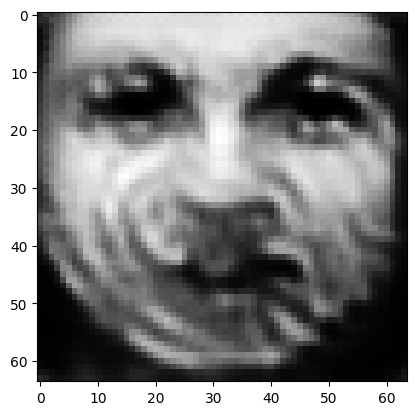

tensor([[6.6007e-05, 1.6551e-04, 1.0531e-03, 1.5049e-03, 2.3715e-04, 3.6138e-04,
         2.6676e-05, 1.1907e-04, 9.7061e-01, 4.5866e-04, 1.4306e-04, 8.3959e-04,
         2.4578e-03, 1.2699e-04, 3.2575e-04, 2.5156e-05, 8.4097e-06, 1.3307e-04,
         5.6165e-05, 2.4742e-04, 1.2393e-03, 9.8678e-05, 5.4812e-05, 1.9333e-06,
         5.4171e-04, 1.5194e-04, 5.6128e-04, 1.4361e-04, 2.4655e-04, 2.9699e-04,
         1.2940e-03, 1.6608e-05, 3.8779e-04, 3.7294e-04, 7.2379e-03, 8.6747e-05,
         2.7973e-05, 4.2112e-04, 2.6967e-03, 5.1599e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029835116118192673
tensor([[6.5967e-05, 1.6539e-04, 1.0525e-03, 1.5038e-03, 2.3703e-04, 3.6116e-04,
         2.6661e-05, 1.1898e-04, 9.7062e-01, 4.5841e-04, 1.4296e-04, 8.3934e-04,
         2.4563e-03, 1.2690e-04, 3.2570e-04, 2.5143e-05, 8.4033e-06, 1.3301e-04,
         5.6128e-05, 2.4731e-04, 1.2389e-03, 9.8641e-05, 5.4772e-05, 1.9318e-06,
         5.4140e-04, 1.5180e-04, 5.6097e-

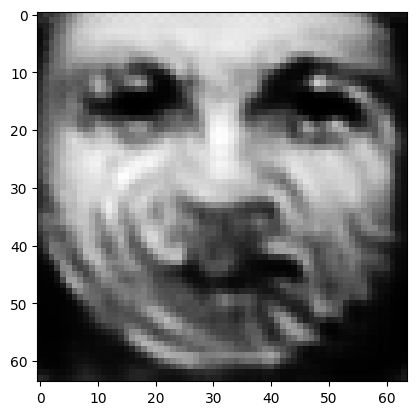

tensor([[6.5810e-05, 1.6494e-04, 1.0499e-03, 1.5012e-03, 2.3649e-04, 3.6018e-04,
         2.6598e-05, 1.1869e-04, 9.7068e-01, 4.5730e-04, 1.4266e-04, 8.3801e-04,
         2.4510e-03, 1.2661e-04, 3.2530e-04, 2.5090e-05, 8.3813e-06, 1.3270e-04,
         5.6006e-05, 2.4674e-04, 1.2366e-03, 9.8486e-05, 5.4656e-05, 1.9269e-06,
         5.4037e-04, 1.5141e-04, 5.5962e-04, 1.4314e-04, 2.4570e-04, 2.9610e-04,
         1.2905e-03, 1.6558e-05, 3.8693e-04, 3.7177e-04, 7.2220e-03, 8.6594e-05,
         2.7891e-05, 4.2028e-04, 2.6889e-03, 5.1458e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02975701168179512
tensor([[6.5772e-05, 1.6484e-04, 1.0491e-03, 1.5009e-03, 2.3634e-04, 3.5990e-04,
         2.6583e-05, 1.1863e-04, 9.7070e-01, 4.5700e-04, 1.4261e-04, 8.3764e-04,
         2.4498e-03, 1.2657e-04, 3.2518e-04, 2.5076e-05, 8.3767e-06, 1.3262e-04,
         5.5982e-05, 2.4658e-04, 1.2360e-03, 9.8447e-05, 5.4641e-05, 1.9260e-06,
         5.4017e-04, 1.5135e-04, 5.5928e-0

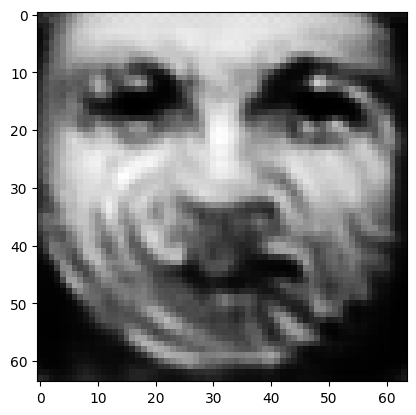

tensor([[6.5623e-05, 1.6442e-04, 1.0466e-03, 1.4984e-03, 2.3583e-04, 3.5898e-04,
         2.6526e-05, 1.1835e-04, 9.7075e-01, 4.5597e-04, 1.4234e-04, 8.3642e-04,
         2.4447e-03, 1.2630e-04, 3.2482e-04, 2.5028e-05, 8.3563e-06, 1.3233e-04,
         5.5866e-05, 2.4605e-04, 1.2339e-03, 9.8297e-05, 5.4534e-05, 1.9213e-06,
         5.3923e-04, 1.5097e-04, 5.5806e-04, 1.4271e-04, 2.4487e-04, 2.9531e-04,
         1.2881e-03, 1.6516e-05, 3.8614e-04, 3.7065e-04, 7.2080e-03, 8.6483e-05,
         2.7823e-05, 4.1975e-04, 2.6809e-03, 5.1309e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029684340581297874
tensor([[6.5587e-05, 1.6433e-04, 1.0460e-03, 1.4982e-03, 2.3569e-04, 3.5873e-04,
         2.6511e-05, 1.1830e-04, 9.7077e-01, 4.5570e-04, 1.4228e-04, 8.3606e-04,
         2.4437e-03, 1.2626e-04, 3.2470e-04, 2.5015e-05, 8.3519e-06, 1.3226e-04,
         5.5841e-05, 2.4591e-04, 1.2333e-03, 9.8259e-05, 5.4519e-05, 1.9203e-06,
         5.3905e-04, 1.5091e-04, 5.5776e-

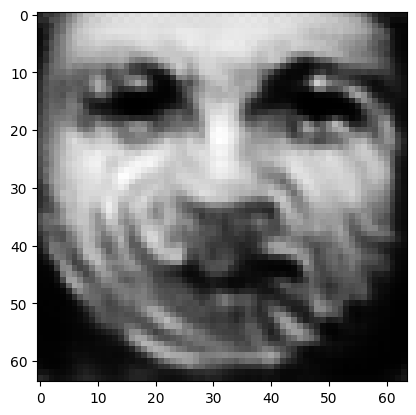

tensor([[6.5443e-05, 1.6391e-04, 1.0436e-03, 1.4956e-03, 2.3521e-04, 3.5787e-04,
         2.6457e-05, 1.1803e-04, 9.7082e-01, 4.5476e-04, 1.4200e-04, 8.3486e-04,
         2.4389e-03, 1.2598e-04, 3.2433e-04, 2.4969e-05, 8.3319e-06, 1.3197e-04,
         5.5725e-05, 2.4542e-04, 1.2313e-03, 9.8120e-05, 5.4412e-05, 1.9156e-06,
         5.3813e-04, 1.5053e-04, 5.5662e-04, 1.4230e-04, 2.4411e-04, 2.9454e-04,
         1.2856e-03, 1.6472e-05, 3.8538e-04, 3.6960e-04, 7.1943e-03, 8.6359e-05,
         2.7756e-05, 4.1916e-04, 2.6737e-03, 5.1180e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029616063460707664
tensor([[6.5409e-05, 1.6382e-04, 1.0430e-03, 1.4953e-03, 2.3508e-04, 3.5763e-04,
         2.6444e-05, 1.1798e-04, 9.7083e-01, 4.5451e-04, 1.4195e-04, 8.3451e-04,
         2.4379e-03, 1.2594e-04, 3.2422e-04, 2.4957e-05, 8.3276e-06, 1.3190e-04,
         5.5701e-05, 2.4529e-04, 1.2307e-03, 9.8085e-05, 5.4397e-05, 1.9147e-06,
         5.3795e-04, 1.5047e-04, 5.5633e-

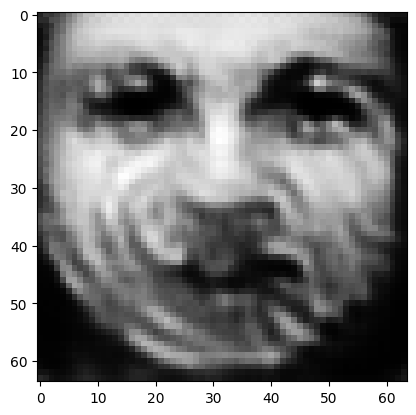

tensor([[6.5274e-05, 1.6343e-04, 1.0408e-03, 1.4930e-03, 2.3462e-04, 3.5683e-04,
         2.6393e-05, 1.1772e-04, 9.7088e-01, 4.5361e-04, 1.4170e-04, 8.3342e-04,
         2.4336e-03, 1.2568e-04, 3.2386e-04, 2.4915e-05, 8.3089e-06, 1.3164e-04,
         5.5592e-05, 2.4483e-04, 1.2289e-03, 9.7957e-05, 5.4298e-05, 1.9103e-06,
         5.3704e-04, 1.5013e-04, 5.5527e-04, 1.4191e-04, 2.4338e-04, 2.9381e-04,
         1.2833e-03, 1.6431e-05, 3.8465e-04, 3.6862e-04, 7.1811e-03, 8.6244e-05,
         2.7693e-05, 4.1859e-04, 2.6670e-03, 5.1060e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02955159917473793
tensor([[6.5241e-05, 1.6335e-04, 1.0402e-03, 1.4927e-03, 2.3449e-04, 3.5659e-04,
         2.6379e-05, 1.1767e-04, 9.7089e-01, 4.5336e-04, 1.4165e-04, 8.3309e-04,
         2.4326e-03, 1.2565e-04, 3.2376e-04, 2.4903e-05, 8.3048e-06, 1.3157e-04,
         5.5569e-05, 2.4470e-04, 1.2283e-03, 9.7924e-05, 5.4284e-05, 1.9094e-06,
         5.3686e-04, 1.5007e-04, 5.5499e-0

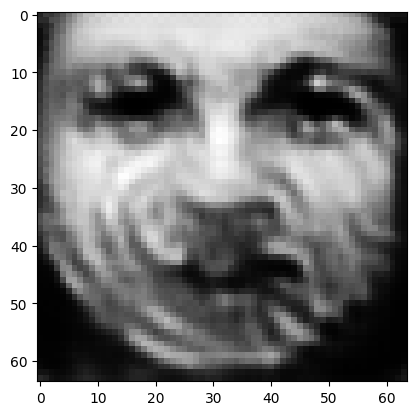

tensor([[6.5111e-05, 1.6302e-04, 1.0380e-03, 1.4910e-03, 2.3403e-04, 3.5576e-04,
         2.6328e-05, 1.1745e-04, 9.7094e-01, 4.5245e-04, 1.4145e-04, 8.3201e-04,
         2.4287e-03, 1.2547e-04, 3.2341e-04, 2.4861e-05, 8.2884e-06, 1.3133e-04,
         5.5474e-05, 2.4423e-04, 1.2264e-03, 9.7800e-05, 5.4211e-05, 1.9056e-06,
         5.3608e-04, 1.4980e-04, 5.5394e-04, 1.4158e-04, 2.4263e-04, 2.9316e-04,
         1.2819e-03, 1.6395e-05, 3.8394e-04, 3.6767e-04, 7.1694e-03, 8.6165e-05,
         2.7639e-05, 4.1825e-04, 2.6599e-03, 5.0930e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029490718618035316
tensor([[6.5080e-05, 1.6291e-04, 1.0376e-03, 1.4901e-03, 2.3393e-04, 3.5561e-04,
         2.6316e-05, 1.1738e-04, 9.7095e-01, 4.5226e-04, 1.4137e-04, 8.3178e-04,
         2.4275e-03, 1.2537e-04, 3.2332e-04, 2.4852e-05, 8.2834e-06, 1.3126e-04,
         5.5444e-05, 2.4414e-04, 1.2261e-03, 9.7773e-05, 5.4176e-05, 1.9044e-06,
         5.3581e-04, 1.4970e-04, 5.5369e-

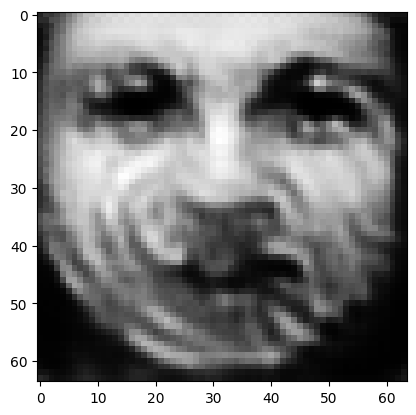

tensor([[6.4958e-05, 1.6260e-04, 1.0355e-03, 1.4886e-03, 2.3349e-04, 3.5481e-04,
         2.6268e-05, 1.1717e-04, 9.7100e-01, 4.5139e-04, 1.4119e-04, 8.3074e-04,
         2.4239e-03, 1.2522e-04, 3.2299e-04, 2.4813e-05, 8.2680e-06, 1.3103e-04,
         5.5354e-05, 2.4370e-04, 1.2243e-03, 9.7656e-05, 5.4112e-05, 1.9009e-06,
         5.3509e-04, 1.4945e-04, 5.5270e-04, 1.4123e-04, 2.4196e-04, 2.9251e-04,
         1.2799e-03, 1.6359e-05, 3.8328e-04, 3.6679e-04, 7.1578e-03, 8.6064e-05,
         2.7582e-05, 4.1776e-04, 2.6536e-03, 5.0819e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02943284437060356
tensor([[6.4928e-05, 1.6250e-04, 1.0351e-03, 1.4879e-03, 2.3339e-04, 3.5466e-04,
         2.6257e-05, 1.1711e-04, 9.7101e-01, 4.5121e-04, 1.4112e-04, 8.3053e-04,
         2.4227e-03, 1.2513e-04, 3.2291e-04, 2.4804e-05, 8.2634e-06, 1.3096e-04,
         5.5326e-05, 2.4361e-04, 1.2239e-03, 9.7629e-05, 5.4080e-05, 1.8997e-06,
         5.3485e-04, 1.4935e-04, 5.5247e-0

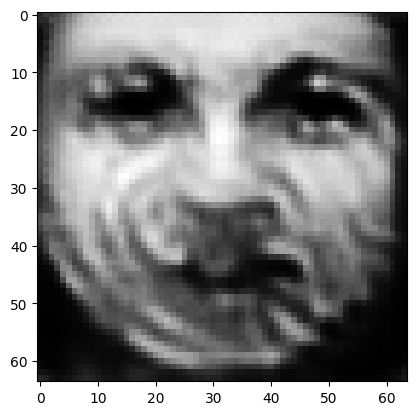

tensor([[6.4811e-05, 1.6218e-04, 1.0332e-03, 1.4860e-03, 2.3299e-04, 3.5396e-04,
         2.6211e-05, 1.1689e-04, 9.7105e-01, 4.5040e-04, 1.4092e-04, 8.2961e-04,
         2.4190e-03, 1.2494e-04, 3.2260e-04, 2.4769e-05, 8.2481e-06, 1.3074e-04,
         5.5235e-05, 2.4321e-04, 1.2223e-03, 9.7520e-05, 5.4002e-05, 1.8961e-06,
         5.3407e-04, 1.4907e-04, 5.5152e-04, 1.4088e-04, 2.4136e-04, 2.9186e-04,
         1.2775e-03, 1.6321e-05, 3.8263e-04, 3.6595e-04, 7.1466e-03, 8.5944e-05,
         2.7523e-05, 4.1715e-04, 2.6478e-03, 5.0728e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029377976432442665
tensor([[6.4783e-05, 1.6213e-04, 1.0326e-03, 1.4858e-03, 2.3289e-04, 3.5375e-04,
         2.6200e-05, 1.1685e-04, 9.7106e-01, 4.5019e-04, 1.4089e-04, 8.2939e-04,
         2.4183e-03, 1.2493e-04, 3.2255e-04, 2.4759e-05, 8.2451e-06, 1.3070e-04,
         5.5219e-05, 2.4310e-04, 1.2219e-03, 9.7491e-05, 5.3996e-05, 1.8955e-06,
         5.3393e-04, 1.4903e-04, 5.5130e-

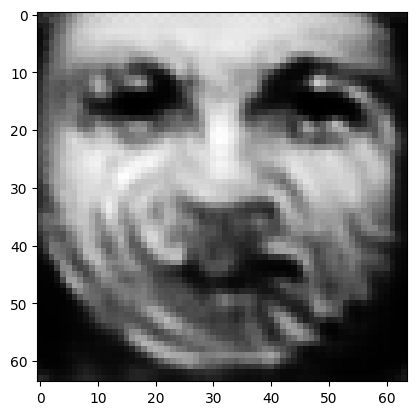

tensor([[6.4672e-05, 1.6182e-04, 1.0308e-03, 1.4840e-03, 2.3252e-04, 3.5308e-04,
         2.6156e-05, 1.1664e-04, 9.7110e-01, 4.4943e-04, 1.4070e-04, 8.2849e-04,
         2.4147e-03, 1.2474e-04, 3.2225e-04, 2.4724e-05, 8.2306e-06, 1.3049e-04,
         5.5134e-05, 2.4272e-04, 1.2204e-03, 9.7386e-05, 5.3922e-05, 1.8920e-06,
         5.3322e-04, 1.4877e-04, 5.5040e-04, 1.4058e-04, 2.4073e-04, 2.9128e-04,
         1.2758e-03, 1.6291e-05, 3.8203e-04, 3.6515e-04, 7.1367e-03, 8.5871e-05,
         2.7474e-05, 4.1678e-04, 2.6419e-03, 5.0620e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02932565286755562
tensor([[6.4645e-05, 1.6175e-04, 1.0303e-03, 1.4838e-03, 2.3242e-04, 3.5290e-04,
         2.6145e-05, 1.1660e-04, 9.7111e-01, 4.4922e-04, 1.4067e-04, 8.2823e-04,
         2.4140e-03, 1.2472e-04, 3.2216e-04, 2.4715e-05, 8.2277e-06, 1.3043e-04,
         5.5117e-05, 2.4262e-04, 1.2200e-03, 9.7360e-05, 5.3913e-05, 1.8914e-06,
         5.3309e-04, 1.4873e-04, 5.5016e-0

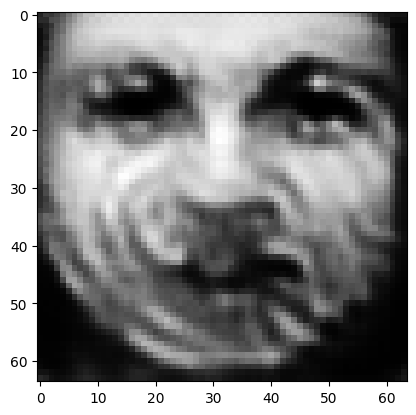

tensor([[6.4541e-05, 1.6147e-04, 1.0286e-03, 1.4820e-03, 2.3207e-04, 3.5227e-04,
         2.6105e-05, 1.1641e-04, 9.7115e-01, 4.4851e-04, 1.4049e-04, 8.2739e-04,
         2.4107e-03, 1.2454e-04, 3.2189e-04, 2.4683e-05, 8.2141e-06, 1.3024e-04,
         5.5038e-05, 2.4226e-04, 1.2185e-03, 9.7262e-05, 5.3845e-05, 1.8882e-06,
         5.3242e-04, 1.4848e-04, 5.4934e-04, 1.4030e-04, 2.4016e-04, 2.9072e-04,
         1.2742e-03, 1.6261e-05, 3.8145e-04, 3.6440e-04, 7.1274e-03, 8.5798e-05,
         2.7428e-05, 4.1640e-04, 2.6364e-03, 5.0523e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029276683926582336
tensor([[6.4517e-05, 1.6138e-04, 1.0283e-03, 1.4814e-03, 2.3199e-04, 3.5215e-04,
         2.6096e-05, 1.1636e-04, 9.7116e-01, 4.4836e-04, 1.4043e-04, 8.2719e-04,
         2.4098e-03, 1.2447e-04, 3.2182e-04, 2.4676e-05, 8.2103e-06, 1.3018e-04,
         5.5014e-05, 2.4219e-04, 1.2182e-03, 9.7240e-05, 5.3819e-05, 1.8872e-06,
         5.3222e-04, 1.4840e-04, 5.4914e-

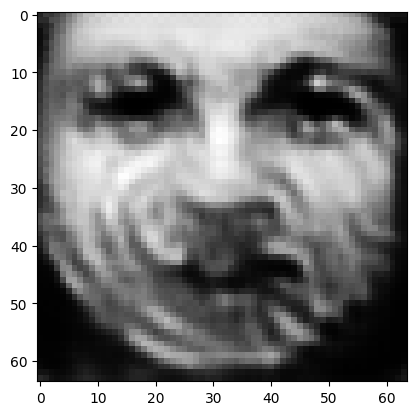

tensor([[6.4423e-05, 1.6113e-04, 1.0266e-03, 1.4799e-03, 2.3169e-04, 3.5155e-04,
         2.6061e-05, 1.1619e-04, 9.7119e-01, 4.4770e-04, 1.4026e-04, 8.2641e-04,
         2.4070e-03, 1.2433e-04, 3.2159e-04, 2.4644e-05, 8.1977e-06, 1.3001e-04,
         5.4941e-05, 2.4186e-04, 1.2168e-03, 9.7148e-05, 5.3763e-05, 1.8844e-06,
         5.3163e-04, 1.4817e-04, 5.4843e-04, 1.4002e-04, 2.3961e-04, 2.9016e-04,
         1.2724e-03, 1.6232e-05, 3.8092e-04, 3.6372e-04, 7.1181e-03, 8.5721e-05,
         2.7381e-05, 4.1592e-04, 2.6316e-03, 5.0438e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029230836778879166
tensor([[6.4399e-05, 1.6107e-04, 1.0261e-03, 1.4796e-03, 2.3161e-04, 3.5140e-04,
         2.6051e-05, 1.1614e-04, 9.7120e-01, 4.4752e-04, 1.4023e-04, 8.2621e-04,
         2.4063e-03, 1.2430e-04, 3.2152e-04, 2.4636e-05, 8.1949e-06, 1.2997e-04,
         5.4924e-05, 2.4177e-04, 1.2165e-03, 9.7126e-05, 5.3752e-05, 1.8837e-06,
         5.3149e-04, 1.4812e-04, 5.4825e-

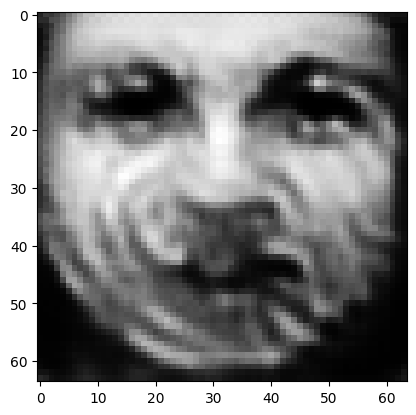

tensor([[6.4309e-05, 1.6081e-04, 1.0246e-03, 1.4780e-03, 2.3132e-04, 3.5085e-04,
         2.6018e-05, 1.1597e-04, 9.7123e-01, 4.4689e-04, 1.4006e-04, 8.2546e-04,
         2.4036e-03, 1.2414e-04, 3.2128e-04, 2.4607e-05, 8.1828e-06, 1.2979e-04,
         5.4851e-05, 2.4147e-04, 1.2152e-03, 9.7040e-05, 5.3694e-05, 1.8808e-06,
         5.3090e-04, 1.4789e-04, 5.4758e-04, 1.3977e-04, 2.3908e-04, 2.8962e-04,
         1.2708e-03, 1.6206e-05, 3.8042e-04, 3.6309e-04, 7.1093e-03, 8.5659e-05,
         2.7339e-05, 4.1553e-04, 2.6269e-03, 5.0353e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02918730489909649
tensor([[6.4288e-05, 1.6074e-04, 1.0243e-03, 1.4773e-03, 2.3126e-04, 3.5075e-04,
         2.6010e-05, 1.1592e-04, 9.7124e-01, 4.4677e-04, 1.4000e-04, 8.2531e-04,
         2.4028e-03, 1.2407e-04, 3.2123e-04, 2.4601e-05, 8.1790e-06, 1.2975e-04,
         5.4828e-05, 2.4141e-04, 1.2149e-03, 9.7020e-05, 5.3668e-05, 1.8799e-06,
         5.3071e-04, 1.4780e-04, 5.4743e-0

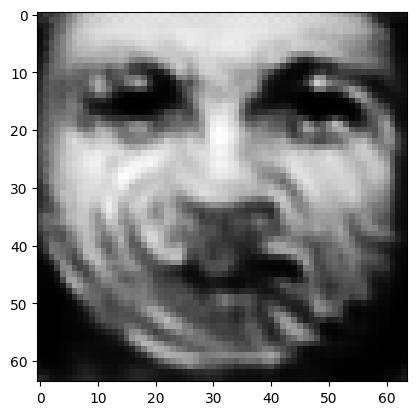

tensor([[6.4203e-05, 1.6050e-04, 1.0228e-03, 1.4758e-03, 2.3098e-04, 3.5022e-04,
         2.5978e-05, 1.1576e-04, 9.7127e-01, 4.4617e-04, 1.3985e-04, 8.2460e-04,
         2.4003e-03, 1.2393e-04, 3.2101e-04, 2.4573e-05, 8.1677e-06, 1.2958e-04,
         5.4759e-05, 2.4112e-04, 1.2137e-03, 9.6939e-05, 5.3615e-05, 1.8772e-06,
         5.3016e-04, 1.4759e-04, 5.4679e-04, 1.3952e-04, 2.3860e-04, 2.8910e-04,
         1.2690e-03, 1.6178e-05, 3.7995e-04, 3.6250e-04, 7.1005e-03, 8.5580e-05,
         2.7295e-05, 4.1503e-04, 2.6228e-03, 5.0283e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029145970940589905
tensor([[6.4183e-05, 1.6046e-04, 1.0223e-03, 1.4756e-03, 2.3092e-04, 3.5007e-04,
         2.5971e-05, 1.1573e-04, 9.7128e-01, 4.4603e-04, 1.3982e-04, 8.2445e-04,
         2.3997e-03, 1.2392e-04, 3.2099e-04, 2.4566e-05, 8.1652e-06, 1.2956e-04,
         5.4746e-05, 2.4105e-04, 1.2134e-03, 9.6918e-05, 5.3608e-05, 1.8767e-06,
         5.3005e-04, 1.4755e-04, 5.4667e-

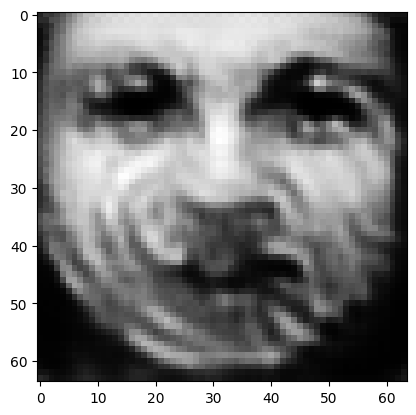

tensor([[6.4101e-05, 1.6023e-04, 1.0210e-03, 1.4743e-03, 2.3064e-04, 3.4960e-04,
         2.5938e-05, 1.1558e-04, 9.7131e-01, 4.4548e-04, 1.3966e-04, 8.2372e-04,
         2.3972e-03, 1.2376e-04, 3.2071e-04, 2.4538e-05, 8.1541e-06, 1.2939e-04,
         5.4677e-05, 2.4075e-04, 1.2121e-03, 9.6841e-05, 5.3549e-05, 1.8740e-06,
         5.2949e-04, 1.4735e-04, 5.4596e-04, 1.3929e-04, 2.3812e-04, 2.8864e-04,
         1.2677e-03, 1.6153e-05, 3.7949e-04, 3.6189e-04, 7.0929e-03, 8.5518e-05,
         2.7257e-05, 4.1469e-04, 2.6186e-03, 5.0207e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029107065871357918
tensor([[6.4081e-05, 1.6017e-04, 1.0207e-03, 1.4741e-03, 2.3057e-04, 3.4947e-04,
         2.5930e-05, 1.1555e-04, 9.7132e-01, 4.4534e-04, 1.3963e-04, 8.2351e-04,
         2.3966e-03, 1.2374e-04, 3.2063e-04, 2.4531e-05, 8.1515e-06, 1.2934e-04,
         5.4662e-05, 2.4067e-04, 1.2118e-03, 9.6821e-05, 5.3538e-05, 1.8734e-06,
         5.2936e-04, 1.4732e-04, 5.4578e-

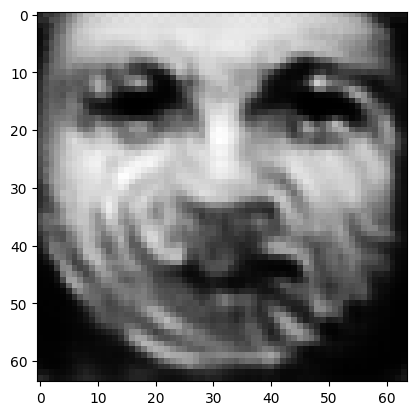

tensor([[6.4004e-05, 1.5996e-04, 1.0195e-03, 1.4728e-03, 2.3032e-04, 3.4901e-04,
         2.5900e-05, 1.1541e-04, 9.7135e-01, 4.4483e-04, 1.3949e-04, 8.2287e-04,
         2.3942e-03, 1.2361e-04, 3.2040e-04, 2.4505e-05, 8.1411e-06, 1.2920e-04,
         5.4599e-05, 2.4040e-04, 1.2107e-03, 9.6747e-05, 5.3484e-05, 1.8709e-06,
         5.2883e-04, 1.4713e-04, 5.4515e-04, 1.3908e-04, 2.3768e-04, 2.8820e-04,
         1.2665e-03, 1.6129e-05, 3.7905e-04, 3.6131e-04, 7.0859e-03, 8.5455e-05,
         2.7221e-05, 4.1436e-04, 2.6146e-03, 5.0137e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02907070703804493
tensor([[6.3987e-05, 1.5990e-04, 1.0192e-03, 1.4722e-03, 2.3026e-04, 3.4893e-04,
         2.5893e-05, 1.1537e-04, 9.7135e-01, 4.4473e-04, 1.3944e-04, 8.2275e-04,
         2.3935e-03, 1.2355e-04, 3.2036e-04, 2.4500e-05, 8.1380e-06, 1.2916e-04,
         5.4580e-05, 2.4036e-04, 1.2105e-03, 9.6732e-05, 5.3462e-05, 1.8702e-06,
         5.2866e-04, 1.4705e-04, 5.4503e-0

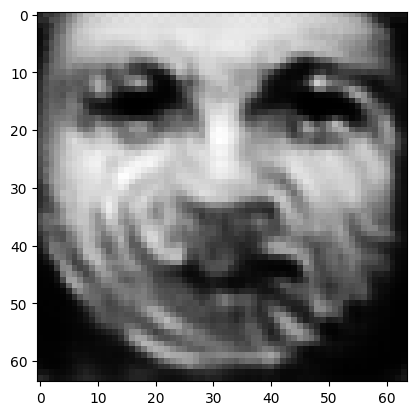

tensor([[6.3913e-05, 1.5970e-04, 1.0180e-03, 1.4709e-03, 2.3002e-04, 3.4849e-04,
         2.5865e-05, 1.1524e-04, 9.7138e-01, 4.4425e-04, 1.3930e-04, 8.2214e-04,
         2.3912e-03, 1.2342e-04, 3.2014e-04, 2.4476e-05, 8.1280e-06, 1.2902e-04,
         5.4520e-05, 2.4010e-04, 1.2094e-03, 9.6661e-05, 5.3410e-05, 1.8678e-06,
         5.2815e-04, 1.4688e-04, 5.4443e-04, 1.3886e-04, 2.3729e-04, 2.8777e-04,
         1.2649e-03, 1.6104e-05, 3.7864e-04, 3.6078e-04, 7.0786e-03, 8.5376e-05,
         2.7182e-05, 4.1394e-04, 2.6111e-03, 5.0082e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02903585322201252
tensor([[6.3895e-05, 1.5965e-04, 1.0177e-03, 1.4707e-03, 2.2995e-04, 3.4838e-04,
         2.5857e-05, 1.1521e-04, 9.7139e-01, 4.4413e-04, 1.3927e-04, 8.2196e-04,
         2.3907e-03, 1.2339e-04, 3.2007e-04, 2.4469e-05, 8.1256e-06, 1.2898e-04,
         5.4506e-05, 2.4003e-04, 1.2091e-03, 9.6644e-05, 5.3400e-05, 1.8672e-06,
         5.2803e-04, 1.4684e-04, 5.4426e-0

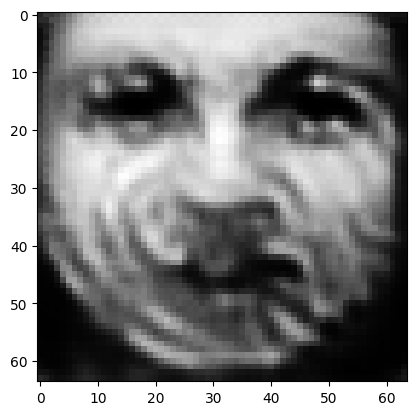

tensor([[6.3825e-05, 1.5946e-04, 1.0166e-03, 1.4695e-03, 2.2972e-04, 3.4796e-04,
         2.5830e-05, 1.1508e-04, 9.7141e-01, 4.4368e-04, 1.3914e-04, 8.2137e-04,
         2.3885e-03, 1.2327e-04, 3.1986e-04, 2.4446e-05, 8.1161e-06, 1.2885e-04,
         5.4449e-05, 2.3978e-04, 1.2081e-03, 9.6577e-05, 5.3351e-05, 1.8650e-06,
         5.2754e-04, 1.4667e-04, 5.4369e-04, 1.3867e-04, 2.3690e-04, 2.8739e-04,
         1.2638e-03, 1.6082e-05, 3.7823e-04, 3.6026e-04, 7.0722e-03, 8.5316e-05,
         2.7149e-05, 4.1364e-04, 2.6074e-03, 5.0019e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029002618044614792
tensor([[6.3808e-05, 1.5942e-04, 1.0163e-03, 1.4693e-03, 2.2966e-04, 3.4785e-04,
         2.5824e-05, 1.1506e-04, 9.7142e-01, 4.4356e-04, 1.3912e-04, 8.2122e-04,
         2.3880e-03, 1.2325e-04, 3.1981e-04, 2.4440e-05, 8.1140e-06, 1.2882e-04,
         5.4436e-05, 2.3972e-04, 1.2078e-03, 9.6562e-05, 5.3342e-05, 1.8645e-06,
         5.2744e-04, 1.4664e-04, 5.4357e-

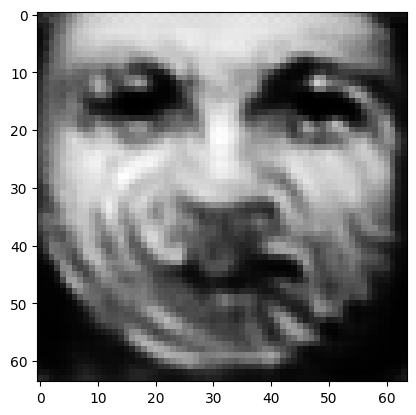

tensor([[6.3742e-05, 1.5924e-04, 1.0152e-03, 1.4682e-03, 2.2944e-04, 3.4746e-04,
         2.5798e-05, 1.1494e-04, 9.7144e-01, 4.4314e-04, 1.3899e-04, 8.2067e-04,
         2.3860e-03, 1.2314e-04, 3.1963e-04, 2.4418e-05, 8.1049e-06, 1.2869e-04,
         5.4381e-05, 2.3949e-04, 1.2069e-03, 9.6498e-05, 5.3296e-05, 1.8623e-06,
         5.2699e-04, 1.4647e-04, 5.4303e-04, 1.3849e-04, 2.3652e-04, 2.8703e-04,
         1.2627e-03, 1.6061e-05, 3.7788e-04, 3.5978e-04, 7.0659e-03, 8.5263e-05,
         2.7118e-05, 4.1334e-04, 2.6041e-03, 4.9960e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028971467167139053
tensor([[6.3725e-05, 1.5918e-04, 1.0150e-03, 1.4677e-03, 2.2939e-04, 3.4739e-04,
         2.5792e-05, 1.1490e-04, 9.7145e-01, 4.4305e-04, 1.3895e-04, 8.2055e-04,
         2.3853e-03, 1.2308e-04, 3.1957e-04, 2.4413e-05, 8.1022e-06, 1.2865e-04,
         5.4363e-05, 2.3944e-04, 1.2067e-03, 9.6483e-05, 5.3275e-05, 1.8616e-06,
         5.2683e-04, 1.4641e-04, 5.4289e-

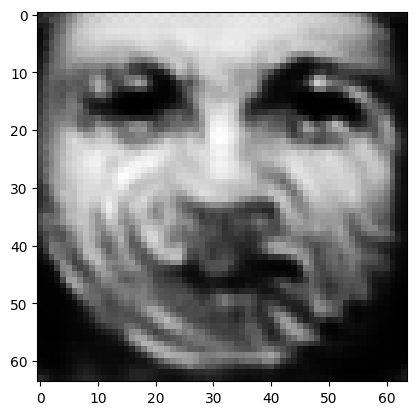

tensor([[6.3662e-05, 1.5901e-04, 1.0140e-03, 1.4667e-03, 2.2919e-04, 3.4701e-04,
         2.5768e-05, 1.1479e-04, 9.7147e-01, 4.4264e-04, 1.3883e-04, 8.2002e-04,
         2.3834e-03, 1.2297e-04, 3.1938e-04, 2.4392e-05, 8.0936e-06, 1.2853e-04,
         5.4312e-05, 2.3922e-04, 1.2058e-03, 9.6423e-05, 5.3232e-05, 1.8596e-06,
         5.2640e-04, 1.4626e-04, 5.4239e-04, 1.3830e-04, 2.3619e-04, 2.8665e-04,
         1.2613e-03, 1.6039e-05, 3.7751e-04, 3.5932e-04, 7.0596e-03, 8.5191e-05,
         2.7085e-05, 4.1297e-04, 2.6011e-03, 4.9913e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028941472992300987
tensor([[6.3646e-05, 1.5897e-04, 1.0137e-03, 1.4665e-03, 2.2913e-04, 3.4691e-04,
         2.5761e-05, 1.1476e-04, 9.7148e-01, 4.4253e-04, 1.3880e-04, 8.1986e-04,
         2.3829e-03, 1.2295e-04, 3.1932e-04, 2.4386e-05, 8.0917e-06, 1.2850e-04,
         5.4300e-05, 2.3916e-04, 1.2055e-03, 9.6408e-05, 5.3224e-05, 1.8591e-06,
         5.2630e-04, 1.4623e-04, 5.4224e-

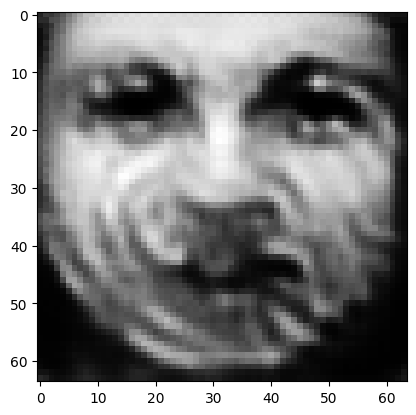

tensor([[6.3586e-05, 1.5880e-04, 1.0128e-03, 1.4655e-03, 2.2893e-04, 3.4657e-04,
         2.5737e-05, 1.1465e-04, 9.7150e-01, 4.4214e-04, 1.3869e-04, 8.1933e-04,
         2.3811e-03, 1.2284e-04, 3.1913e-04, 2.4366e-05, 8.0835e-06, 1.2838e-04,
         5.4250e-05, 2.3895e-04, 1.2046e-03, 9.6352e-05, 5.3181e-05, 1.8571e-06,
         5.2589e-04, 1.4609e-04, 5.4174e-04, 1.3814e-04, 2.3585e-04, 2.8632e-04,
         1.2604e-03, 1.6019e-05, 3.7718e-04, 3.5886e-04, 7.0540e-03, 8.5138e-05,
         2.7056e-05, 4.1270e-04, 2.5981e-03, 4.9860e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028913447633385658
tensor([[6.3572e-05, 1.5878e-04, 1.0125e-03, 1.4653e-03, 2.2889e-04, 3.4646e-04,
         2.5733e-05, 1.1463e-04, 9.7151e-01, 4.4205e-04, 1.3867e-04, 8.1923e-04,
         2.3807e-03, 1.2283e-04, 3.1911e-04, 2.4361e-05, 8.0817e-06, 1.2836e-04,
         5.4240e-05, 2.3890e-04, 1.2044e-03, 9.6338e-05, 5.3176e-05, 1.8568e-06,
         5.2581e-04, 1.4605e-04, 5.4165e-

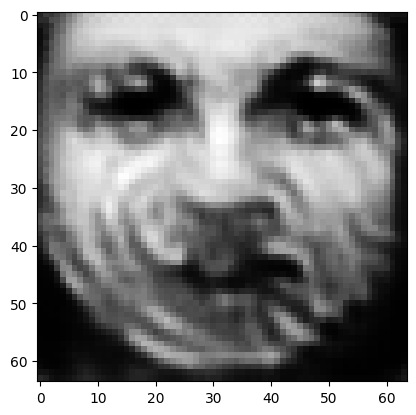

tensor([[6.3515e-05, 1.5862e-04, 1.0116e-03, 1.4644e-03, 2.2869e-04, 3.4613e-04,
         2.5710e-05, 1.1453e-04, 9.7153e-01, 4.4167e-04, 1.3856e-04, 8.1872e-04,
         2.3790e-03, 1.2273e-04, 3.1892e-04, 2.4342e-05, 8.0741e-06, 1.2824e-04,
         5.4194e-05, 2.3870e-04, 1.2036e-03, 9.6285e-05, 5.3137e-05, 1.8549e-06,
         5.2543e-04, 1.4592e-04, 5.4117e-04, 1.3798e-04, 2.3553e-04, 2.8601e-04,
         1.2595e-03, 1.6002e-05, 3.7687e-04, 3.5846e-04, 7.0486e-03, 8.5095e-05,
         2.7030e-05, 4.1246e-04, 2.5952e-03, 4.9808e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028886346146464348
tensor([[6.3502e-05, 1.5857e-04, 1.0114e-03, 1.4640e-03, 2.2866e-04, 3.4607e-04,
         2.5705e-05, 1.1450e-04, 9.7153e-01, 4.4160e-04, 1.3852e-04, 8.1862e-04,
         2.3785e-03, 1.2268e-04, 3.1888e-04, 2.4338e-05, 8.0718e-06, 1.2821e-04,
         5.4179e-05, 2.3866e-04, 1.2034e-03, 9.6272e-05, 5.3119e-05, 1.8543e-06,
         5.2531e-04, 1.4587e-04, 5.4105e-

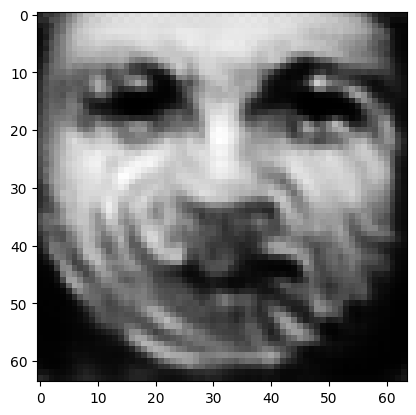

tensor([[6.3449e-05, 1.5842e-04, 1.0106e-03, 1.4631e-03, 2.2848e-04, 3.4575e-04,
         2.5684e-05, 1.1440e-04, 9.7155e-01, 4.4125e-04, 1.3842e-04, 8.1816e-04,
         2.3769e-03, 1.2259e-04, 3.1872e-04, 2.4320e-05, 8.0645e-06, 1.2811e-04,
         5.4135e-05, 2.3847e-04, 1.2027e-03, 9.6221e-05, 5.3083e-05, 1.8526e-06,
         5.2495e-04, 1.4574e-04, 5.4063e-04, 1.3782e-04, 2.3524e-04, 2.8570e-04,
         1.2584e-03, 1.5983e-05, 3.7657e-04, 3.5807e-04, 7.0434e-03, 8.5036e-05,
         2.7002e-05, 4.1214e-04, 2.5927e-03, 4.9766e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028861330822110176
tensor([[6.3435e-05, 1.5840e-04, 1.0103e-03, 1.4630e-03, 2.2844e-04, 3.4566e-04,
         2.5679e-05, 1.1438e-04, 9.7156e-01, 4.4116e-04, 1.3840e-04, 8.1805e-04,
         2.3765e-03, 1.2258e-04, 3.1869e-04, 2.4315e-05, 8.0629e-06, 1.2809e-04,
         5.4126e-05, 2.3842e-04, 1.2025e-03, 9.6208e-05, 5.3077e-05, 1.8523e-06,
         5.2487e-04, 1.4571e-04, 5.4051e-

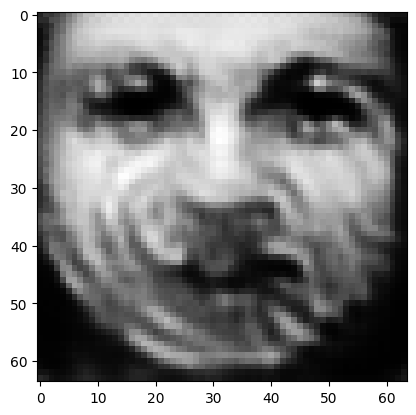

tensor([[6.3384e-05, 1.5825e-04, 1.0095e-03, 1.4621e-03, 2.2827e-04, 3.4536e-04,
         2.5659e-05, 1.1429e-04, 9.7157e-01, 4.4082e-04, 1.3830e-04, 8.1759e-04,
         2.3750e-03, 1.2248e-04, 3.1852e-04, 2.4299e-05, 8.0562e-06, 1.2799e-04,
         5.4084e-05, 2.3824e-04, 1.2017e-03, 9.6160e-05, 5.3042e-05, 1.8506e-06,
         5.2454e-04, 1.4559e-04, 5.4009e-04, 1.3768e-04, 2.3495e-04, 2.8541e-04,
         1.2576e-03, 1.5967e-05, 3.7629e-04, 3.5770e-04, 7.0387e-03, 8.4995e-05,
         2.6978e-05, 4.1192e-04, 2.5901e-03, 4.9720e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028837472200393677
tensor([[6.3372e-05, 1.5823e-04, 1.0093e-03, 1.4620e-03, 2.2824e-04, 3.4527e-04,
         2.5655e-05, 1.1427e-04, 9.7158e-01, 4.4074e-04, 1.3828e-04, 8.1751e-04,
         2.3747e-03, 1.2248e-04, 3.1851e-04, 2.4294e-05, 8.0547e-06, 1.2797e-04,
         5.4075e-05, 2.3820e-04, 1.2016e-03, 9.6148e-05, 5.3038e-05, 1.8503e-06,
         5.2448e-04, 1.4557e-04, 5.4001e-

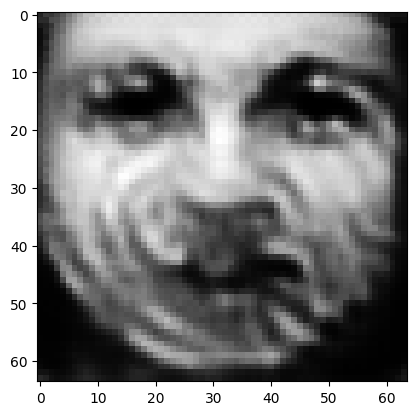

tensor([[6.3324e-05, 1.5810e-04, 1.0085e-03, 1.4612e-03, 2.2809e-04, 3.4498e-04,
         2.5636e-05, 1.1418e-04, 9.7160e-01, 4.4042e-04, 1.3819e-04, 8.1708e-04,
         2.3733e-03, 1.2239e-04, 3.1837e-04, 2.4278e-05, 8.0482e-06, 1.2788e-04,
         5.4035e-05, 2.3803e-04, 1.2009e-03, 9.6102e-05, 5.3006e-05, 1.8488e-06,
         5.2416e-04, 1.4545e-04, 5.3961e-04, 1.3755e-04, 2.3467e-04, 2.8515e-04,
         1.2568e-03, 1.5953e-05, 3.7601e-04, 3.5736e-04, 7.0343e-03, 8.4961e-05,
         2.6955e-05, 4.1169e-04, 2.5877e-03, 4.9673e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02881477028131485
tensor([[6.3313e-05, 1.5806e-04, 1.0084e-03, 1.4608e-03, 2.2805e-04, 3.4493e-04,
         2.5632e-05, 1.1415e-04, 9.7160e-01, 4.4035e-04, 1.3816e-04, 8.1699e-04,
         2.3729e-03, 1.2235e-04, 3.1833e-04, 2.4275e-05, 8.0462e-06, 1.2785e-04,
         5.4022e-05, 2.3800e-04, 1.2007e-03, 9.6092e-05, 5.2991e-05, 1.8483e-06,
         5.2406e-04, 1.4541e-04, 5.3952e-0

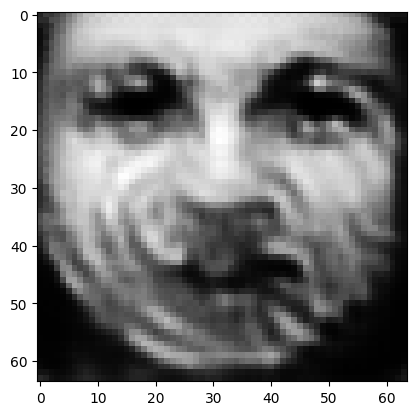

tensor([[6.3268e-05, 1.5794e-04, 1.0076e-03, 1.4601e-03, 2.2792e-04, 3.4466e-04,
         2.5614e-05, 1.1407e-04, 9.7162e-01, 4.4005e-04, 1.3807e-04, 8.1661e-04,
         2.3716e-03, 1.2228e-04, 3.1821e-04, 2.4260e-05, 8.0403e-06, 1.2777e-04,
         5.3986e-05, 2.3785e-04, 1.2001e-03, 9.6049e-05, 5.2962e-05, 1.8469e-06,
         5.2377e-04, 1.4530e-04, 5.3916e-04, 1.3742e-04, 2.3442e-04, 2.8487e-04,
         1.2558e-03, 1.5937e-05, 3.7576e-04, 3.5703e-04, 7.0299e-03, 8.4913e-05,
         2.6931e-05, 4.1141e-04, 2.5856e-03, 4.9638e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028793342411518097
tensor([[6.3256e-05, 1.5791e-04, 1.0074e-03, 1.4599e-03, 2.2788e-04, 3.4459e-04,
         2.5610e-05, 1.1405e-04, 9.7162e-01, 4.3997e-04, 1.3805e-04, 8.1650e-04,
         2.3713e-03, 1.2226e-04, 3.1816e-04, 2.4256e-05, 8.0389e-06, 1.2775e-04,
         5.3977e-05, 2.3780e-04, 1.1999e-03, 9.6038e-05, 5.2956e-05, 1.8465e-06,
         5.2370e-04, 1.4528e-04, 5.3906e-

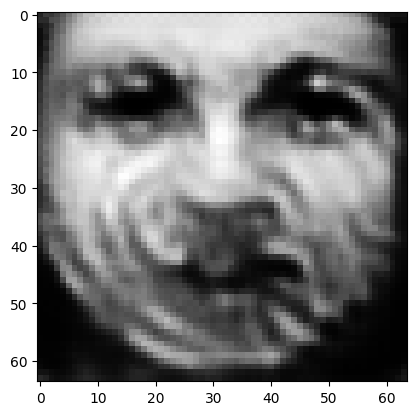

tensor([[6.3214e-05, 1.5779e-04, 1.0067e-03, 1.4592e-03, 2.2775e-04, 3.4433e-04,
         2.5594e-05, 1.1397e-04, 9.7164e-01, 4.3968e-04, 1.3797e-04, 8.1614e-04,
         2.3700e-03, 1.2219e-04, 3.1805e-04, 2.4242e-05, 8.0331e-06, 1.2767e-04,
         5.3942e-05, 2.3766e-04, 1.1993e-03, 9.5997e-05, 5.2927e-05, 1.8452e-06,
         5.2342e-04, 1.4516e-04, 5.3874e-04, 1.3730e-04, 2.3418e-04, 2.8463e-04,
         1.2550e-03, 1.5923e-05, 3.7551e-04, 3.5672e-04, 7.0259e-03, 8.4878e-05,
         2.6910e-05, 4.1120e-04, 2.5835e-03, 4.9599e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028773073107004166
tensor([[6.3204e-05, 1.5776e-04, 1.0066e-03, 1.4590e-03, 2.2771e-04, 3.4426e-04,
         2.5589e-05, 1.1396e-04, 9.7164e-01, 4.3961e-04, 1.3795e-04, 8.1603e-04,
         2.3697e-03, 1.2218e-04, 3.1801e-04, 2.4238e-05, 8.0318e-06, 1.2764e-04,
         5.3934e-05, 2.3762e-04, 1.1991e-03, 9.5987e-05, 5.2922e-05, 1.8449e-06,
         5.2335e-04, 1.4514e-04, 5.3864e-

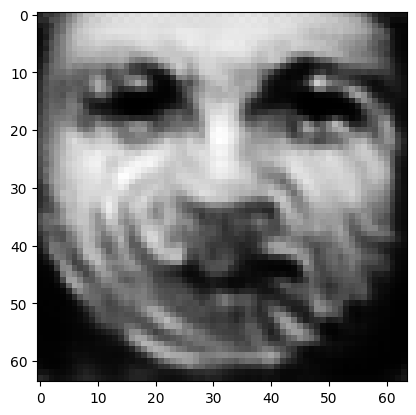

tensor([[6.3164e-05, 1.5765e-04, 1.0059e-03, 1.4583e-03, 2.2758e-04, 3.4402e-04,
         2.5574e-05, 1.1388e-04, 9.7166e-01, 4.3934e-04, 1.3787e-04, 8.1568e-04,
         2.3685e-03, 1.2210e-04, 3.1789e-04, 2.4225e-05, 8.0262e-06, 1.2757e-04,
         5.3900e-05, 2.3748e-04, 1.1986e-03, 9.5948e-05, 5.2893e-05, 1.8436e-06,
         5.2308e-04, 1.4504e-04, 5.3832e-04, 1.3719e-04, 2.3394e-04, 2.8439e-04,
         1.2543e-03, 1.5910e-05, 3.7527e-04, 3.5642e-04, 7.0221e-03, 8.4843e-05,
         2.6891e-05, 4.1100e-04, 2.5815e-03, 4.9562e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028753729537129402
tensor([[6.3154e-05, 1.5763e-04, 1.0057e-03, 1.4582e-03, 2.2756e-04, 3.4395e-04,
         2.5571e-05, 1.1386e-04, 9.7166e-01, 4.3927e-04, 1.3785e-04, 8.1561e-04,
         2.3683e-03, 1.2210e-04, 3.1789e-04, 2.4222e-05, 8.0250e-06, 1.2756e-04,
         5.3893e-05, 2.3745e-04, 1.1984e-03, 9.5939e-05, 5.2889e-05, 1.8433e-06,
         5.2303e-04, 1.4502e-04, 5.3826e-

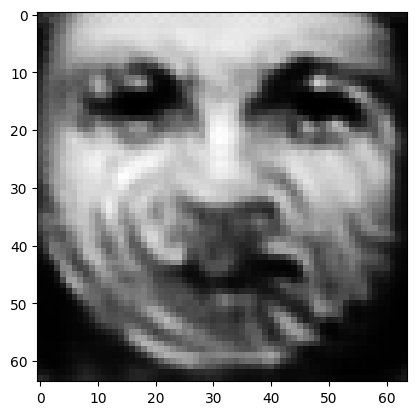

tensor([[6.3116e-05, 1.5752e-04, 1.0051e-03, 1.4574e-03, 2.2744e-04, 3.4373e-04,
         2.5556e-05, 1.1379e-04, 9.7167e-01, 4.3902e-04, 1.3777e-04, 8.1527e-04,
         2.3672e-03, 1.2202e-04, 3.1778e-04, 2.4209e-05, 8.0197e-06, 1.2748e-04,
         5.3861e-05, 2.3732e-04, 1.1979e-03, 9.5902e-05, 5.2862e-05, 1.8420e-06,
         5.2278e-04, 1.4491e-04, 5.3796e-04, 1.3708e-04, 2.3372e-04, 2.8417e-04,
         1.2536e-03, 1.5898e-05, 3.7506e-04, 3.5616e-04, 7.0184e-03, 8.4813e-05,
         2.6871e-05, 4.1079e-04, 2.5796e-03, 4.9527e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02873554453253746
tensor([[6.3107e-05, 1.5750e-04, 1.0049e-03, 1.4573e-03, 2.2741e-04, 3.4367e-04,
         2.5552e-05, 1.1377e-04, 9.7168e-01, 4.3895e-04, 1.3775e-04, 8.1517e-04,
         2.3669e-03, 1.2201e-04, 3.1774e-04, 2.4206e-05, 8.0186e-06, 1.2746e-04,
         5.3853e-05, 2.3728e-04, 1.1977e-03, 9.5894e-05, 5.2857e-05, 1.8418e-06,
         5.2272e-04, 1.4490e-04, 5.3787e-0

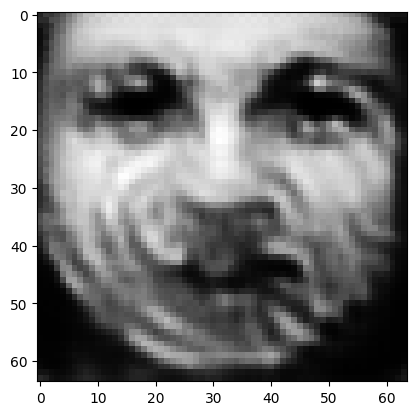

tensor([[6.3071e-05, 1.5740e-04, 1.0044e-03, 1.4566e-03, 2.2730e-04, 3.4345e-04,
         2.5538e-05, 1.1370e-04, 9.7169e-01, 4.3870e-04, 1.3768e-04, 8.1485e-04,
         2.3658e-03, 1.2194e-04, 3.1764e-04, 2.4194e-05, 8.0136e-06, 1.2740e-04,
         5.3823e-05, 2.3716e-04, 1.1972e-03, 9.5859e-05, 5.2831e-05, 1.8406e-06,
         5.2248e-04, 1.4480e-04, 5.3758e-04, 1.3698e-04, 2.3350e-04, 2.8395e-04,
         1.2529e-03, 1.5886e-05, 3.7484e-04, 3.5589e-04, 7.0150e-03, 8.4781e-05,
         2.6853e-05, 4.1059e-04, 2.5778e-03, 4.9494e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028718169778585434
tensor([[6.3062e-05, 1.5737e-04, 1.0042e-03, 1.4565e-03, 2.2727e-04, 3.4340e-04,
         2.5535e-05, 1.1369e-04, 9.7169e-01, 4.3864e-04, 1.3766e-04, 8.1476e-04,
         2.3656e-03, 1.2193e-04, 3.1761e-04, 2.4191e-05, 8.0125e-06, 1.2738e-04,
         5.3816e-05, 2.3713e-04, 1.1971e-03, 9.5851e-05, 5.2826e-05, 1.8403e-06,
         5.2243e-04, 1.4478e-04, 5.3751e-

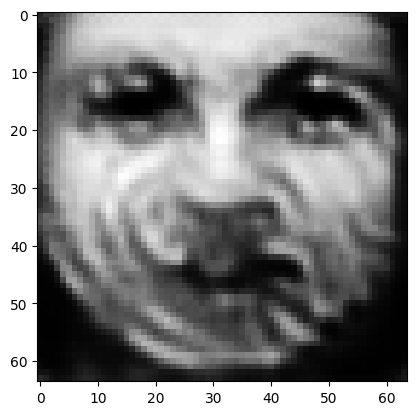

tensor([[6.3028e-05, 1.5728e-04, 1.0036e-03, 1.4558e-03, 2.2717e-04, 3.4319e-04,
         2.5522e-05, 1.1362e-04, 9.7171e-01, 4.3840e-04, 1.3759e-04, 8.1445e-04,
         2.3646e-03, 1.2187e-04, 3.1752e-04, 2.4179e-05, 8.0078e-06, 1.2731e-04,
         5.3786e-05, 2.3701e-04, 1.1966e-03, 9.5819e-05, 5.2802e-05, 1.8392e-06,
         5.2221e-04, 1.4469e-04, 5.3723e-04, 1.3689e-04, 2.3330e-04, 2.8375e-04,
         1.2523e-03, 1.5875e-05, 3.7464e-04, 3.5564e-04, 7.0117e-03, 8.4753e-05,
         2.6836e-05, 4.1040e-04, 2.5762e-03, 4.9462e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028701605275273323
tensor([[6.3019e-05, 1.5725e-04, 1.0035e-03, 1.4557e-03, 2.2715e-04, 3.4314e-04,
         2.5518e-05, 1.1361e-04, 9.7171e-01, 4.3834e-04, 1.3758e-04, 8.1436e-04,
         2.3644e-03, 1.2186e-04, 3.1749e-04, 2.4176e-05, 8.0067e-06, 1.2729e-04,
         5.3779e-05, 2.3698e-04, 1.1965e-03, 9.5811e-05, 5.2797e-05, 1.8390e-06,
         5.2215e-04, 1.4467e-04, 5.3716e-

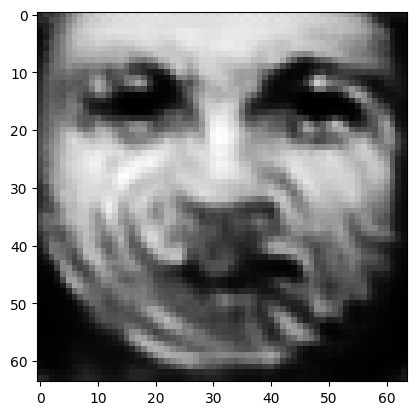

tensor([[6.2987e-05, 1.5716e-04, 1.0030e-03, 1.4551e-03, 2.2705e-04, 3.4294e-04,
         2.5506e-05, 1.1355e-04, 9.7172e-01, 4.3812e-04, 1.3751e-04, 8.1406e-04,
         2.3635e-03, 1.2179e-04, 3.1740e-04, 2.4165e-05, 8.0021e-06, 1.2723e-04,
         5.3751e-05, 2.3687e-04, 1.1960e-03, 9.5780e-05, 5.2773e-05, 1.8379e-06,
         5.2193e-04, 1.4458e-04, 5.3690e-04, 1.3680e-04, 2.3311e-04, 2.8355e-04,
         1.2517e-03, 1.5863e-05, 3.7445e-04, 3.5540e-04, 7.0085e-03, 8.4722e-05,
         2.6819e-05, 4.1022e-04, 2.5746e-03, 4.9432e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028685735538601875
tensor([[6.2979e-05, 1.5714e-04, 1.0028e-03, 1.4550e-03, 2.2702e-04, 3.4289e-04,
         2.5503e-05, 1.1353e-04, 9.7172e-01, 4.3806e-04, 1.3749e-04, 8.1399e-04,
         2.3633e-03, 1.2178e-04, 3.1738e-04, 2.4163e-05, 8.0011e-06, 1.2722e-04,
         5.3745e-05, 2.3685e-04, 1.1959e-03, 9.5773e-05, 5.2769e-05, 1.8377e-06,
         5.2189e-04, 1.4457e-04, 5.3684e-

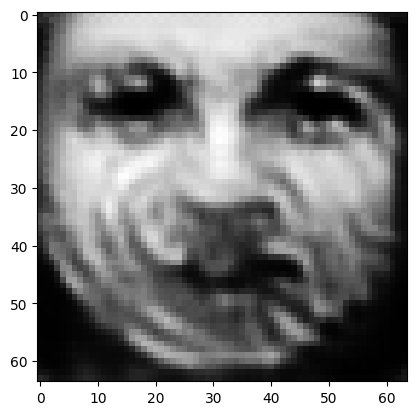

tensor([[6.2948e-05, 1.5705e-04, 1.0023e-03, 1.4543e-03, 2.2693e-04, 3.4270e-04,
         2.5491e-05, 1.1347e-04, 9.7174e-01, 4.3786e-04, 1.3743e-04, 8.1372e-04,
         2.3624e-03, 1.2173e-04, 3.1730e-04, 2.4152e-05, 7.9969e-06, 1.2716e-04,
         5.3719e-05, 2.3674e-04, 1.1955e-03, 9.5743e-05, 5.2747e-05, 1.8367e-06,
         5.2168e-04, 1.4448e-04, 5.3660e-04, 1.3672e-04, 2.3292e-04, 2.8337e-04,
         1.2511e-03, 1.5853e-05, 3.7427e-04, 3.5519e-04, 7.0055e-03, 8.4698e-05,
         2.6804e-05, 4.1004e-04, 2.5731e-03, 4.9404e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028670907020568848
tensor([[6.2940e-05, 1.5703e-04, 1.0022e-03, 1.4542e-03, 2.2691e-04, 3.4266e-04,
         2.5488e-05, 1.1346e-04, 9.7174e-01, 4.3780e-04, 1.3741e-04, 8.1364e-04,
         2.3622e-03, 1.2172e-04, 3.1727e-04, 2.4150e-05, 7.9959e-06, 1.2715e-04,
         5.3712e-05, 2.3671e-04, 1.1954e-03, 9.5736e-05, 5.2743e-05, 1.8364e-06,
         5.2163e-04, 1.4447e-04, 5.3652e-

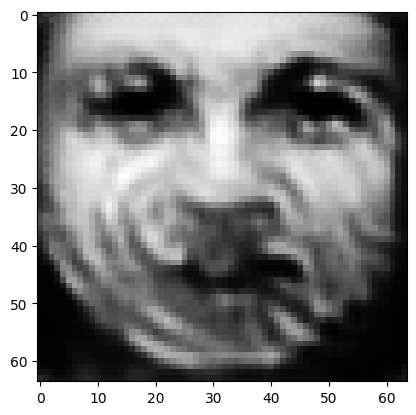

tensor([[6.2911e-05, 1.5695e-04, 1.0017e-03, 1.4537e-03, 2.2682e-04, 3.4248e-04,
         2.5476e-05, 1.1340e-04, 9.7175e-01, 4.3760e-04, 1.3735e-04, 8.1337e-04,
         2.3613e-03, 1.2166e-04, 3.1719e-04, 2.4140e-05, 7.9918e-06, 1.2709e-04,
         5.3687e-05, 2.3662e-04, 1.1949e-03, 9.5709e-05, 5.2722e-05, 1.8355e-06,
         5.2144e-04, 1.4439e-04, 5.3629e-04, 1.3664e-04, 2.3275e-04, 2.8319e-04,
         1.2505e-03, 1.5843e-05, 3.7409e-04, 3.5497e-04, 7.0026e-03, 8.4671e-05,
         2.6789e-05, 4.0987e-04, 2.5716e-03, 4.9377e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02865665964782238
tensor([[6.2905e-05, 1.5693e-04, 1.0016e-03, 1.4535e-03, 2.2680e-04, 3.4244e-04,
         2.5474e-05, 1.1339e-04, 9.7175e-01, 4.3756e-04, 1.3734e-04, 8.1330e-04,
         2.3610e-03, 1.2165e-04, 3.1717e-04, 2.4138e-05, 7.9908e-06, 1.2708e-04,
         5.3682e-05, 2.3659e-04, 1.1948e-03, 9.5702e-05, 5.2716e-05, 1.8352e-06,
         5.2139e-04, 1.4437e-04, 5.3624e-0

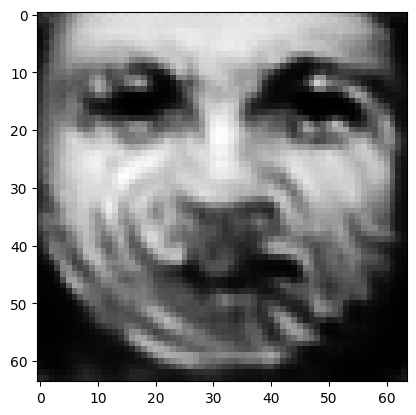

tensor([[6.2876e-05, 1.5685e-04, 1.0011e-03, 1.4530e-03, 2.2672e-04, 3.4227e-04,
         2.5463e-05, 1.1334e-04, 9.7176e-01, 4.3736e-04, 1.3728e-04, 8.1305e-04,
         2.3603e-03, 1.2160e-04, 3.1710e-04, 2.4128e-05, 7.9870e-06, 1.2702e-04,
         5.3658e-05, 2.3650e-04, 1.1945e-03, 9.5676e-05, 5.2697e-05, 1.8344e-06,
         5.2121e-04, 1.4429e-04, 5.3601e-04, 1.3656e-04, 2.3259e-04, 2.8302e-04,
         1.2499e-03, 1.5834e-05, 3.7392e-04, 3.5477e-04, 7.0000e-03, 8.4646e-05,
         2.6774e-05, 4.0970e-04, 2.5703e-03, 4.9352e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02864333800971508
tensor([[6.2870e-05, 1.5683e-04, 1.0010e-03, 1.4528e-03, 2.2669e-04, 3.4223e-04,
         2.5461e-05, 1.1333e-04, 9.7177e-01, 4.3732e-04, 1.3726e-04, 8.1299e-04,
         2.3600e-03, 1.2159e-04, 3.1708e-04, 2.4126e-05, 7.9860e-06, 1.2701e-04,
         5.3653e-05, 2.3647e-04, 1.1944e-03, 9.5669e-05, 5.2691e-05, 1.8341e-06,
         5.2116e-04, 1.4427e-04, 5.3597e-0

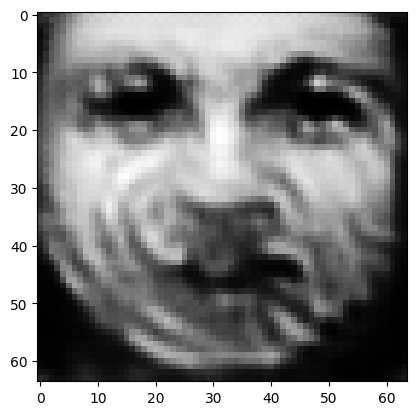

tensor([[6.2843e-05, 1.5675e-04, 1.0006e-03, 1.4523e-03, 2.2661e-04, 3.4207e-04,
         2.5450e-05, 1.1327e-04, 9.7178e-01, 4.3713e-04, 1.3721e-04, 8.1274e-04,
         2.3593e-03, 1.2154e-04, 3.1700e-04, 2.4117e-05, 7.9824e-06, 1.2696e-04,
         5.3629e-05, 2.3638e-04, 1.1940e-03, 9.5644e-05, 5.2672e-05, 1.8333e-06,
         5.2098e-04, 1.4420e-04, 5.3574e-04, 1.3649e-04, 2.3243e-04, 2.8285e-04,
         1.2494e-03, 1.5824e-05, 3.7376e-04, 3.5458e-04, 6.9974e-03, 8.4620e-05,
         2.6761e-05, 4.0953e-04, 2.5690e-03, 4.9330e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02863047830760479
tensor([[6.2837e-05, 1.5673e-04, 1.0005e-03, 1.4522e-03, 2.2659e-04, 3.4203e-04,
         2.5448e-05, 1.1326e-04, 9.7178e-01, 4.3709e-04, 1.3720e-04, 8.1268e-04,
         2.3591e-03, 1.2153e-04, 3.1698e-04, 2.4115e-05, 7.9815e-06, 1.2695e-04,
         5.3624e-05, 2.3636e-04, 1.1939e-03, 9.5638e-05, 5.2669e-05, 1.8331e-06,
         5.2094e-04, 1.4419e-04, 5.3571e-0

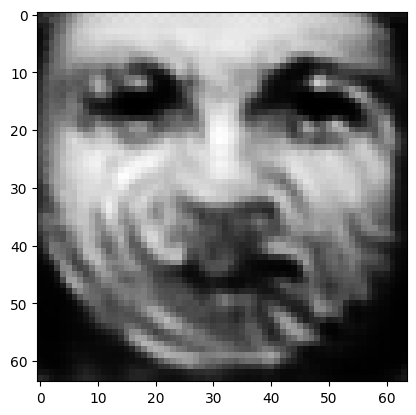

tensor([[6.2812e-05, 1.5666e-04, 1.0000e-03, 1.4517e-03, 2.2652e-04, 3.4188e-04,
         2.5438e-05, 1.1321e-04, 9.7179e-01, 4.3692e-04, 1.3714e-04, 8.1245e-04,
         2.3584e-03, 1.2148e-04, 3.1691e-04, 2.4107e-05, 7.9781e-06, 1.2690e-04,
         5.3603e-05, 2.3628e-04, 1.1935e-03, 9.5615e-05, 5.2651e-05, 1.8323e-06,
         5.2078e-04, 1.4412e-04, 5.3550e-04, 1.3642e-04, 2.3229e-04, 2.8269e-04,
         1.2489e-03, 1.5816e-05, 3.7361e-04, 3.5441e-04, 6.9950e-03, 8.4598e-05,
         2.6748e-05, 4.0939e-04, 2.5678e-03, 4.9307e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02861831523478031
tensor([[6.2807e-05, 1.5664e-04, 9.9994e-04, 1.4515e-03, 2.2650e-04, 3.4184e-04,
         2.5437e-05, 1.1320e-04, 9.7179e-01, 4.3688e-04, 1.3713e-04, 8.1240e-04,
         2.3582e-03, 1.2147e-04, 3.1690e-04, 2.4105e-05, 7.9772e-06, 1.2689e-04,
         5.3599e-05, 2.3626e-04, 1.1934e-03, 9.5609e-05, 5.2646e-05, 1.8321e-06,
         5.2073e-04, 1.4410e-04, 5.3547e-0

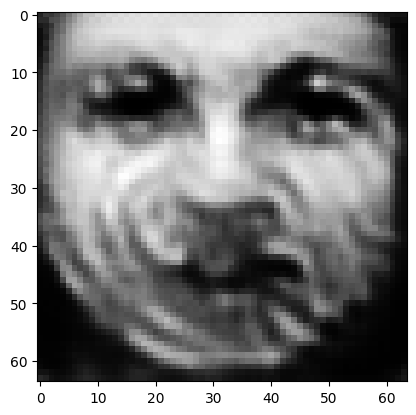

tensor([[6.2783e-05, 1.5657e-04, 9.9954e-04, 1.4510e-03, 2.2643e-04, 3.4170e-04,
         2.5427e-05, 1.1316e-04, 9.7180e-01, 4.3672e-04, 1.3708e-04, 8.1217e-04,
         2.3575e-03, 1.2143e-04, 3.1683e-04, 2.4097e-05, 7.9739e-06, 1.2684e-04,
         5.3577e-05, 2.3618e-04, 1.1931e-03, 9.5586e-05, 5.2630e-05, 1.8313e-06,
         5.2058e-04, 1.4404e-04, 5.3528e-04, 1.3636e-04, 2.3215e-04, 2.8255e-04,
         1.2484e-03, 1.5808e-05, 3.7347e-04, 3.5424e-04, 6.9926e-03, 8.4577e-05,
         2.6736e-05, 4.0924e-04, 2.5666e-03, 4.9286e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028606846928596497
tensor([[6.2777e-05, 1.5656e-04, 9.9945e-04, 1.4509e-03, 2.2641e-04, 3.4166e-04,
         2.5425e-05, 1.1315e-04, 9.7180e-01, 4.3668e-04, 1.3707e-04, 8.1211e-04,
         2.3573e-03, 1.2142e-04, 3.1681e-04, 2.4095e-05, 7.9731e-06, 1.2683e-04,
         5.3573e-05, 2.3616e-04, 1.1930e-03, 9.5580e-05, 5.2626e-05, 1.8311e-06,
         5.2054e-04, 1.4403e-04, 5.3523e-

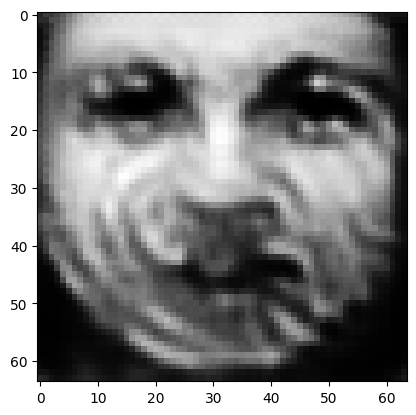

tensor([[6.2755e-05, 1.5649e-04, 9.9907e-04, 1.4505e-03, 2.2635e-04, 3.4153e-04,
         2.5416e-05, 1.1310e-04, 9.7181e-01, 4.3652e-04, 1.3702e-04, 8.1190e-04,
         2.3566e-03, 1.2138e-04, 3.1675e-04, 2.4087e-05, 7.9699e-06, 1.2679e-04,
         5.3554e-05, 2.3608e-04, 1.1927e-03, 9.5559e-05, 5.2609e-05, 1.8304e-06,
         5.2038e-04, 1.4396e-04, 5.3505e-04, 1.3630e-04, 2.3202e-04, 2.8240e-04,
         1.2480e-03, 1.5800e-05, 3.7332e-04, 3.5408e-04, 6.9905e-03, 8.4555e-05,
         2.6724e-05, 4.0911e-04, 2.5655e-03, 4.9267e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02859584055840969
tensor([[6.2750e-05, 1.5648e-04, 9.9899e-04, 1.4503e-03, 2.2634e-04, 3.4150e-04,
         2.5415e-05, 1.1309e-04, 9.7181e-01, 4.3649e-04, 1.3700e-04, 8.1188e-04,
         2.3565e-03, 1.2136e-04, 3.1675e-04, 2.4086e-05, 7.9691e-06, 1.2678e-04,
         5.3549e-05, 2.3607e-04, 1.1927e-03, 9.5554e-05, 5.2604e-05, 1.8302e-06,
         5.2034e-04, 1.4394e-04, 5.3503e-0

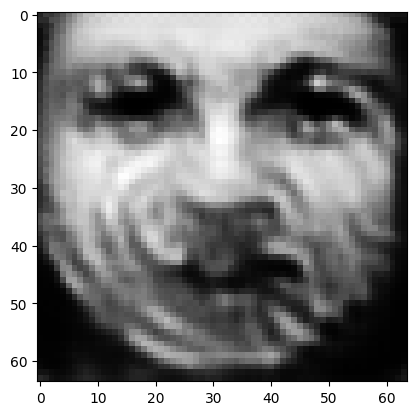

tensor([[6.2728e-05, 1.5642e-04, 9.9862e-04, 1.4499e-03, 2.2627e-04, 3.4136e-04,
         2.5406e-05, 1.1305e-04, 9.7182e-01, 4.3634e-04, 1.3696e-04, 8.1165e-04,
         2.3559e-03, 1.2133e-04, 3.1667e-04, 2.4078e-05, 7.9663e-06, 1.2674e-04,
         5.3532e-05, 2.3599e-04, 1.1923e-03, 9.5534e-05, 5.2591e-05, 1.8295e-06,
         5.2021e-04, 1.4389e-04, 5.3484e-04, 1.3624e-04, 2.3189e-04, 2.8227e-04,
         1.2476e-03, 1.5793e-05, 3.7319e-04, 3.5393e-04, 6.9884e-03, 8.4538e-05,
         2.6714e-05, 4.0898e-04, 2.5645e-03, 4.9248e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02858564630150795
tensor([[6.2723e-05, 1.5640e-04, 9.9854e-04, 1.4498e-03, 2.2626e-04, 3.4134e-04,
         2.5405e-05, 1.1304e-04, 9.7182e-01, 4.3631e-04, 1.3695e-04, 8.1163e-04,
         2.3557e-03, 1.2132e-04, 3.1667e-04, 2.4077e-05, 7.9655e-06, 1.2673e-04,
         5.3526e-05, 2.3598e-04, 1.1923e-03, 9.5529e-05, 5.2586e-05, 1.8293e-06,
         5.2017e-04, 1.4387e-04, 5.3482e-0

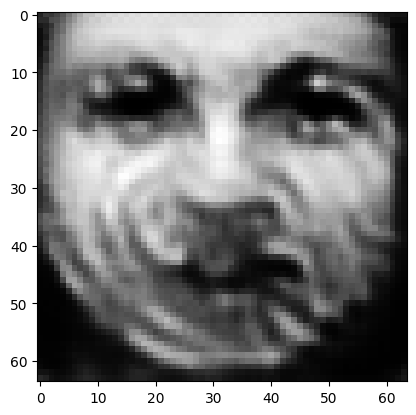

tensor([[6.2703e-05, 1.5634e-04, 9.9820e-04, 1.4493e-03, 2.2620e-04, 3.4121e-04,
         2.5397e-05, 1.1300e-04, 9.7183e-01, 4.3616e-04, 1.3691e-04, 8.1144e-04,
         2.3551e-03, 1.2128e-04, 3.1661e-04, 2.4070e-05, 7.9627e-06, 1.2669e-04,
         5.3509e-05, 2.3591e-04, 1.1920e-03, 9.5510e-05, 5.2572e-05, 1.8287e-06,
         5.2003e-04, 1.4382e-04, 5.3466e-04, 1.3618e-04, 2.3177e-04, 2.8214e-04,
         1.2470e-03, 1.5785e-05, 3.7307e-04, 3.5379e-04, 6.9863e-03, 8.4516e-05,
         2.6702e-05, 4.0883e-04, 2.5635e-03, 4.9231e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028575798496603966
tensor([[6.2698e-05, 1.5633e-04, 9.9812e-04, 1.4493e-03, 2.2618e-04, 3.4118e-04,
         2.5394e-05, 1.1299e-04, 9.7183e-01, 4.3612e-04, 1.3690e-04, 8.1139e-04,
         2.3550e-03, 1.2128e-04, 3.1660e-04, 2.4068e-05, 7.9621e-06, 1.2668e-04,
         5.3505e-05, 2.3589e-04, 1.1919e-03, 9.5505e-05, 5.2569e-05, 1.8285e-06,
         5.2000e-04, 1.4381e-04, 5.3461e-

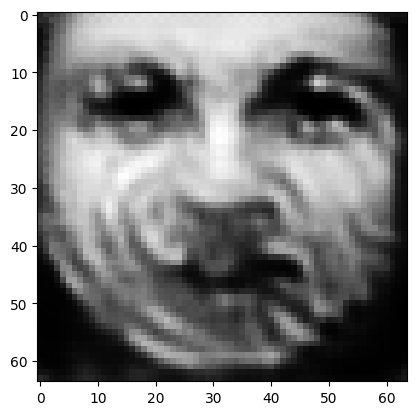

tensor([[6.2679e-05, 1.5627e-04, 9.9779e-04, 1.4489e-03, 2.2613e-04, 3.4106e-04,
         2.5387e-05, 1.1296e-04, 9.7184e-01, 4.3599e-04, 1.3686e-04, 8.1121e-04,
         2.3545e-03, 1.2124e-04, 3.1655e-04, 2.4062e-05, 7.9594e-06, 1.2665e-04,
         5.3489e-05, 2.3582e-04, 1.1916e-03, 9.5487e-05, 5.2556e-05, 1.8279e-06,
         5.1988e-04, 1.4375e-04, 5.3446e-04, 1.3613e-04, 2.3165e-04, 2.8202e-04,
         1.2467e-03, 1.5779e-05, 3.7295e-04, 3.5365e-04, 6.9845e-03, 8.4501e-05,
         2.6692e-05, 4.0872e-04, 2.5626e-03, 4.9213e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028566299006342888
tensor([[6.2674e-05, 1.5626e-04, 9.9771e-04, 1.4488e-03, 2.2611e-04, 3.4103e-04,
         2.5385e-05, 1.1295e-04, 9.7184e-01, 4.3595e-04, 1.3685e-04, 8.1116e-04,
         2.3543e-03, 1.2124e-04, 3.1653e-04, 2.4060e-05, 7.9589e-06, 1.2664e-04,
         5.3485e-05, 2.3581e-04, 1.1916e-03, 9.5483e-05, 5.2554e-05, 1.8278e-06,
         5.1985e-04, 1.4375e-04, 5.3442e-

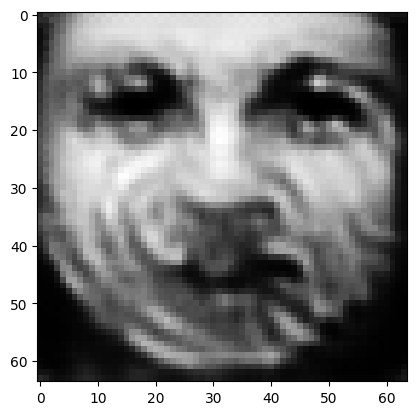

tensor([[6.2656e-05, 1.5621e-04, 9.9741e-04, 1.4484e-03, 2.2606e-04, 3.4092e-04,
         2.5378e-05, 1.1291e-04, 9.7185e-01, 4.3583e-04, 1.3681e-04, 8.1100e-04,
         2.3538e-03, 1.2120e-04, 3.1648e-04, 2.4054e-05, 7.9563e-06, 1.2661e-04,
         5.3469e-05, 2.3574e-04, 1.1913e-03, 9.5465e-05, 5.2540e-05, 1.8272e-06,
         5.1972e-04, 1.4370e-04, 5.3427e-04, 1.3608e-04, 2.3154e-04, 2.8191e-04,
         1.2463e-03, 1.5772e-05, 3.7283e-04, 3.5352e-04, 6.9827e-03, 8.4485e-05,
         2.6683e-05, 4.0861e-04, 2.5616e-03, 4.9197e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02855737879872322
tensor([[6.2651e-05, 1.5620e-04, 9.9733e-04, 1.4483e-03, 2.2604e-04, 3.4089e-04,
         2.5377e-05, 1.1290e-04, 9.7185e-01, 4.3580e-04, 1.3680e-04, 8.1096e-04,
         2.3536e-03, 1.2119e-04, 3.1647e-04, 2.4053e-05, 7.9557e-06, 1.2660e-04,
         5.3466e-05, 2.3573e-04, 1.1912e-03, 9.5461e-05, 5.2537e-05, 1.8270e-06,
         5.1969e-04, 1.4368e-04, 5.3425e-0

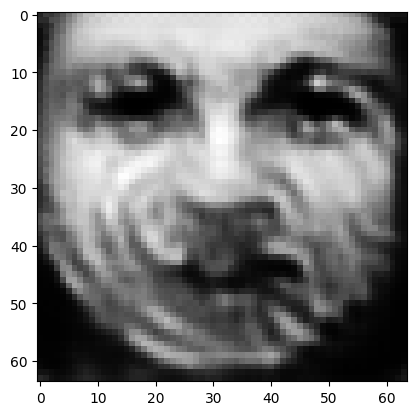

tensor([[6.2634e-05, 1.5615e-04, 9.9703e-04, 1.4480e-03, 2.2599e-04, 3.4078e-04,
         2.5370e-05, 1.1287e-04, 9.7185e-01, 4.3567e-04, 1.3676e-04, 8.1079e-04,
         2.3532e-03, 1.2117e-04, 3.1642e-04, 2.4047e-05, 7.9533e-06, 1.2657e-04,
         5.3451e-05, 2.3567e-04, 1.1910e-03, 9.5445e-05, 5.2526e-05, 1.8265e-06,
         5.1958e-04, 1.4364e-04, 5.3410e-04, 1.3603e-04, 2.3144e-04, 2.8180e-04,
         1.2460e-03, 1.5766e-05, 3.7272e-04, 3.5340e-04, 6.9810e-03, 8.4471e-05,
         2.6674e-05, 4.0850e-04, 2.5608e-03, 4.9181e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02854880504310131
tensor([[6.2630e-05, 1.5613e-04, 9.9698e-04, 1.4478e-03, 2.2598e-04, 3.4077e-04,
         2.5368e-05, 1.1286e-04, 9.7186e-01, 4.3565e-04, 1.3675e-04, 8.1077e-04,
         2.3530e-03, 1.2115e-04, 3.1641e-04, 2.4046e-05, 7.9525e-06, 1.2656e-04,
         5.3446e-05, 2.3566e-04, 1.1910e-03, 9.5441e-05, 5.2520e-05, 1.8263e-06,
         5.1954e-04, 1.4362e-04, 5.3409e-0

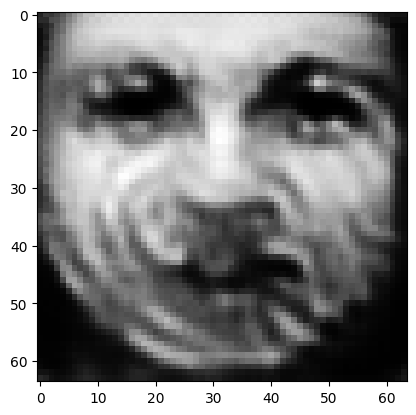

tensor([[6.2613e-05, 1.5608e-04, 9.9670e-04, 1.4475e-03, 2.2593e-04, 3.4067e-04,
         2.5362e-05, 1.1283e-04, 9.7186e-01, 4.3553e-04, 1.3672e-04, 8.1061e-04,
         2.3525e-03, 1.2112e-04, 3.1636e-04, 2.4040e-05, 7.9503e-06, 1.2653e-04,
         5.3432e-05, 2.3560e-04, 1.1907e-03, 9.5425e-05, 5.2509e-05, 1.8257e-06,
         5.1943e-04, 1.4358e-04, 5.3395e-04, 1.3599e-04, 2.3134e-04, 2.8169e-04,
         1.2456e-03, 1.5760e-05, 3.7262e-04, 3.5329e-04, 6.9793e-03, 8.4452e-05,
         2.6665e-05, 4.0838e-04, 2.5600e-03, 4.9168e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02854069508612156
tensor([[6.2609e-05, 1.5607e-04, 9.9663e-04, 1.4474e-03, 2.2591e-04, 3.4064e-04,
         2.5360e-05, 1.1282e-04, 9.7186e-01, 4.3550e-04, 1.3671e-04, 8.1057e-04,
         2.3524e-03, 1.2112e-04, 3.1635e-04, 2.4039e-05, 7.9498e-06, 1.2652e-04,
         5.3429e-05, 2.3558e-04, 1.1906e-03, 9.5422e-05, 5.2507e-05, 1.8256e-06,
         5.1941e-04, 1.4357e-04, 5.3391e-0

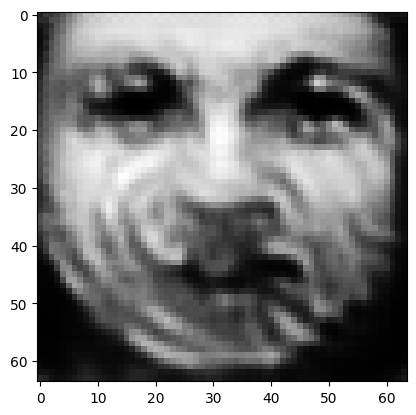

tensor([[6.2593e-05, 1.5603e-04, 9.9636e-04, 1.4472e-03, 2.2587e-04, 3.4054e-04,
         2.5354e-05, 1.1279e-04, 9.7187e-01, 4.3539e-04, 1.3668e-04, 8.1042e-04,
         2.3520e-03, 1.2109e-04, 3.1631e-04, 2.4033e-05, 7.9478e-06, 1.2649e-04,
         5.3416e-05, 2.3553e-04, 1.1904e-03, 9.5407e-05, 5.2497e-05, 1.8251e-06,
         5.1931e-04, 1.4353e-04, 5.3378e-04, 1.3595e-04, 2.3124e-04, 2.8159e-04,
         1.2453e-03, 1.5755e-05, 3.7252e-04, 3.5317e-04, 6.9778e-03, 8.4441e-05,
         2.6657e-05, 4.0830e-04, 2.5592e-03, 4.9152e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028533048927783966
tensor([[6.2590e-05, 1.5602e-04, 9.9630e-04, 1.4471e-03, 2.2586e-04, 3.4052e-04,
         2.5352e-05, 1.1278e-04, 9.7187e-01, 4.3536e-04, 1.3667e-04, 8.1039e-04,
         2.3519e-03, 1.2109e-04, 3.1629e-04, 2.4032e-05, 7.9473e-06, 1.2648e-04,
         5.3414e-05, 2.3551e-04, 1.1904e-03, 9.5403e-05, 5.2495e-05, 1.8250e-06,
         5.1928e-04, 1.4352e-04, 5.3375e-

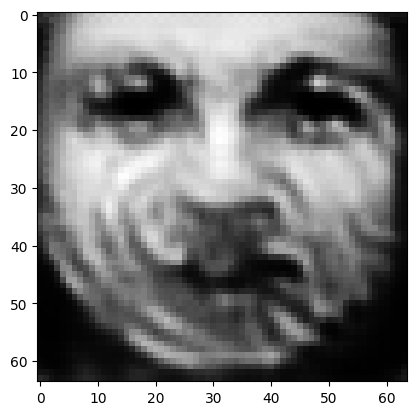

tensor([[6.2575e-05, 1.5598e-04, 9.9604e-04, 1.4468e-03, 2.2581e-04, 3.4042e-04,
         2.5346e-05, 1.1276e-04, 9.7188e-01, 4.3526e-04, 1.3664e-04, 8.1025e-04,
         2.3515e-03, 1.2106e-04, 3.1626e-04, 2.4027e-05, 7.9453e-06, 1.2645e-04,
         5.3401e-05, 2.3547e-04, 1.1902e-03, 9.5389e-05, 5.2485e-05, 1.8246e-06,
         5.1919e-04, 1.4348e-04, 5.3364e-04, 1.3591e-04, 2.3116e-04, 2.8150e-04,
         1.2450e-03, 1.5750e-05, 3.7243e-04, 3.5307e-04, 6.9763e-03, 8.4429e-05,
         2.6650e-05, 4.0822e-04, 2.5584e-03, 4.9138e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02852574922144413
tensor([[6.2571e-05, 1.5596e-04, 9.9600e-04, 1.4467e-03, 2.2580e-04, 3.4041e-04,
         2.5345e-05, 1.1275e-04, 9.7188e-01, 4.3523e-04, 1.3663e-04, 8.1022e-04,
         2.3514e-03, 1.2105e-04, 3.1624e-04, 2.4026e-05, 7.9447e-06, 1.2644e-04,
         5.3397e-05, 2.3545e-04, 1.1901e-03, 9.5386e-05, 5.2481e-05, 1.8244e-06,
         5.1916e-04, 1.4347e-04, 5.3361e-0

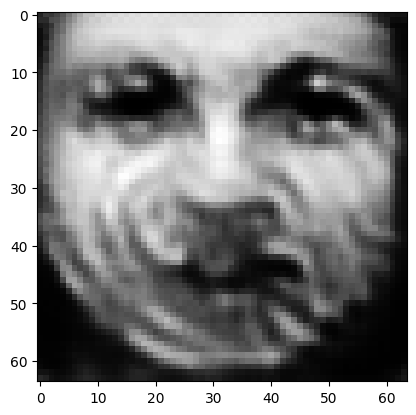

tensor([[6.2557e-05, 1.5593e-04, 9.9575e-04, 1.4464e-03, 2.2576e-04, 3.4032e-04,
         2.5339e-05, 1.1272e-04, 9.7188e-01, 4.3513e-04, 1.3660e-04, 8.1009e-04,
         2.3510e-03, 1.2103e-04, 3.1621e-04, 2.4022e-05, 7.9428e-06, 1.2642e-04,
         5.3386e-05, 2.3541e-04, 1.1899e-03, 9.5373e-05, 5.2472e-05, 1.8240e-06,
         5.1907e-04, 1.4343e-04, 5.3350e-04, 1.3587e-04, 2.3107e-04, 2.8141e-04,
         1.2447e-03, 1.5745e-05, 3.7234e-04, 3.5297e-04, 6.9749e-03, 8.4415e-05,
         2.6642e-05, 4.0813e-04, 2.5577e-03, 4.9126e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028518913313746452
tensor([[6.2553e-05, 1.5592e-04, 9.9568e-04, 1.4464e-03, 2.2575e-04, 3.4029e-04,
         2.5338e-05, 1.1271e-04, 9.7189e-01, 4.3511e-04, 1.3660e-04, 8.1006e-04,
         2.3509e-03, 1.2103e-04, 3.1620e-04, 2.4020e-05, 7.9425e-06, 1.2641e-04,
         5.3383e-05, 2.3539e-04, 1.1899e-03, 9.5369e-05, 5.2471e-05, 1.8239e-06,
         5.1905e-04, 1.4343e-04, 5.3347e-

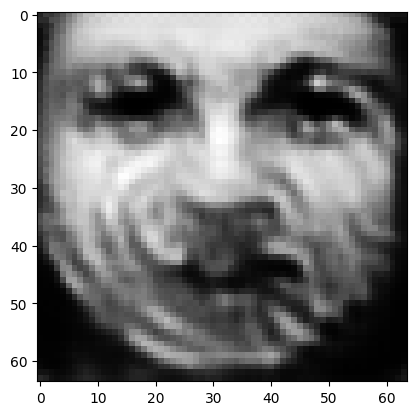

tensor([[6.2540e-05, 1.5588e-04, 9.9546e-04, 1.4461e-03, 2.2570e-04, 3.4021e-04,
         2.5332e-05, 1.1269e-04, 9.7189e-01, 4.3501e-04, 1.3657e-04, 8.0993e-04,
         2.3505e-03, 1.2100e-04, 3.1616e-04, 2.4016e-05, 7.9406e-06, 1.2639e-04,
         5.3372e-05, 2.3534e-04, 1.1897e-03, 9.5356e-05, 5.2462e-05, 1.8235e-06,
         5.1896e-04, 1.4339e-04, 5.3336e-04, 1.3583e-04, 2.3099e-04, 2.8133e-04,
         1.2445e-03, 1.5741e-05, 3.7226e-04, 3.5287e-04, 6.9737e-03, 8.4405e-05,
         2.6636e-05, 4.0805e-04, 2.5570e-03, 4.9113e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02851231023669243
tensor([[6.2537e-05, 1.5587e-04, 9.9539e-04, 1.4461e-03, 2.2570e-04, 3.4019e-04,
         2.5331e-05, 1.1268e-04, 9.7189e-01, 4.3499e-04, 1.3656e-04, 8.0991e-04,
         2.3504e-03, 1.2100e-04, 3.1615e-04, 2.4015e-05, 7.9402e-06, 1.2638e-04,
         5.3370e-05, 2.3533e-04, 1.1896e-03, 9.5353e-05, 5.2460e-05, 1.8234e-06,
         5.1894e-04, 1.4338e-04, 5.3334e-0

In [22]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=8)

tensor([[3.4713e-03, 1.2601e-03, 7.9833e-03, 5.4270e-03, 8.8898e-02, 8.4707e-04,
         1.6127e-03, 1.4663e-03, 1.4164e-03, 1.3463e-04, 4.2232e-04, 1.0595e-03,
         9.2519e-03, 2.0949e-02, 2.3434e-03, 6.2844e-04, 2.3632e-02, 5.2971e-03,
         2.1626e-03, 8.3675e-04, 1.5805e-02, 4.6692e-03, 2.9303e-01, 2.5239e-03,
         1.1666e-01, 2.3455e-02, 2.2279e-03, 3.2929e-03, 9.4658e-04, 5.7554e-03,
         3.6073e-03, 7.6531e-03, 1.2323e-02, 1.4340e-02, 1.1156e-02, 3.3076e-02,
         2.3484e-01, 2.0808e-02, 9.6893e-03, 5.0422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.912982940673828


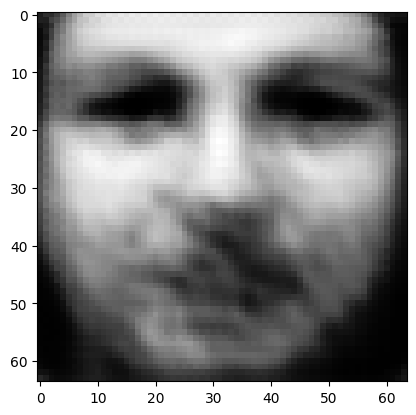

tensor([[0.0032, 0.0024, 0.0044, 0.0052, 0.0604, 0.0011, 0.0021, 0.0020, 0.0023,
         0.0003, 0.0009, 0.0014, 0.0074, 0.0254, 0.0028, 0.0009, 0.0216, 0.0046,
         0.0028, 0.0007, 0.0130, 0.0039, 0.2465, 0.0026, 0.1294, 0.0922, 0.0021,
         0.0030, 0.0012, 0.0105, 0.0026, 0.0069, 0.0100, 0.0107, 0.0117, 0.0333,
         0.2338, 0.0244, 0.0068, 0.0039]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.209110260009766
tensor([[0.0030, 0.0033, 0.0067, 0.0073, 0.0789, 0.0020, 0.0059, 0.0079, 0.0056,
         0.0009, 0.0027, 0.0016, 0.0119, 0.0267, 0.0073, 0.0010, 0.0355, 0.0165,
         0.0043, 0.0020, 0.0186, 0.0036, 0.0975, 0.0065, 0.2836, 0.0402, 0.0030,
         0.0089, 0.0049, 0.0108, 0.0047, 0.0064, 0.0317, 0.0168, 0.0142, 0.0308,
         0.1449, 0.0192, 0.0178, 0.0046]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.061525344848633
tensor([[0.0096, 0.0039, 0.0454, 0.0068, 0.0245, 0.0244, 0.0281, 0.0245, 0.0104,
         0.

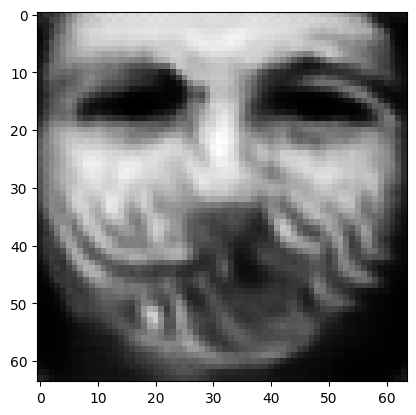

tensor([[7.2108e-03, 1.5163e-02, 3.9007e-02, 1.2223e-02, 4.7521e-03, 4.1058e-02,
         8.5796e-03, 2.6713e-02, 2.5191e-02, 1.7458e-01, 3.4887e-03, 2.5547e-02,
         5.3239e-03, 1.5173e-04, 6.4062e-04, 3.7679e-03, 4.9232e-04, 3.2640e-03,
         5.3232e-03, 3.3601e-02, 2.7299e-03, 2.0364e-03, 1.0175e-04, 1.4790e-04,
         1.7393e-03, 2.2386e-03, 7.7927e-02, 6.6577e-03, 1.4381e-01, 1.1292e-02,
         4.2479e-03, 2.6552e-03, 3.9748e-02, 1.9129e-02, 1.3867e-02, 1.4659e-03,
         3.6266e-04, 1.0880e-02, 4.5668e-02, 1.7721e-01]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.7453495264053345
tensor([[7.0528e-03, 1.5994e-02, 3.0613e-02, 1.3314e-02, 4.9000e-03, 3.8840e-02,
         8.0754e-03, 3.2805e-02, 1.9479e-02, 3.2836e-01, 2.9249e-03, 2.1984e-02,
         5.6966e-03, 1.1568e-04, 3.7073e-04, 3.2737e-03, 3.3946e-04, 2.2299e-03,
         3.6065e-03, 2.4073e-02, 1.5953e-03, 2.1424e-03, 5.6013e-05, 1.1943e-04,
         1.1510e-03, 2.4162e-03, 6.6714e-02

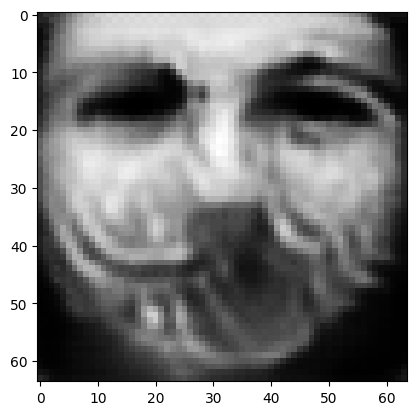

tensor([[3.8093e-03, 8.0298e-03, 1.8475e-02, 7.1608e-03, 1.6911e-03, 1.9819e-02,
         2.7100e-03, 4.2075e-02, 2.2167e-03, 7.3860e-01, 1.5256e-03, 7.7939e-03,
         1.0041e-03, 2.4387e-05, 7.0565e-05, 3.9068e-03, 2.7715e-04, 5.7168e-04,
         2.7929e-03, 6.3968e-03, 3.2423e-04, 1.2129e-03, 3.7413e-06, 6.5159e-05,
         1.3464e-04, 1.2697e-03, 1.2556e-02, 3.6650e-03, 5.4048e-02, 3.8385e-03,
         2.9279e-03, 1.1754e-03, 4.9113e-03, 5.7899e-03, 2.3968e-03, 2.9610e-04,
         1.0099e-04, 5.0941e-03, 1.0781e-02, 2.0457e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.30299755930900574
tensor([[3.3202e-03, 6.6882e-03, 1.6756e-02, 6.8781e-03, 1.3025e-03, 1.6837e-02,
         2.0682e-03, 3.7259e-02, 1.8716e-03, 7.7387e-01, 1.3377e-03, 6.7789e-03,
         7.8819e-04, 1.9502e-05, 5.2655e-05, 3.6520e-03, 2.6701e-04, 4.1097e-04,
         2.5623e-03, 4.8717e-03, 2.5877e-04, 1.0863e-03, 2.8150e-06, 5.4558e-05,
         1.0347e-04, 1.1726e-03, 9.2509e-0

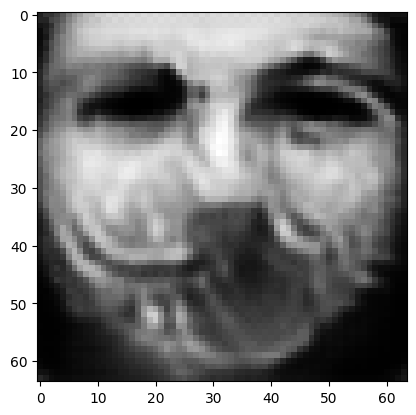

tensor([[2.3485e-03, 3.0686e-03, 1.0321e-02, 4.1432e-03, 6.8119e-04, 9.6286e-03,
         1.0282e-03, 2.8256e-02, 6.0761e-04, 8.6922e-01, 7.5487e-04, 3.1921e-03,
         2.8686e-04, 6.4963e-06, 1.8713e-05, 2.7338e-03, 1.6647e-04, 1.8820e-04,
         1.3965e-03, 2.5650e-03, 9.3351e-05, 6.1814e-04, 6.8362e-07, 3.1228e-05,
         3.8737e-05, 5.9728e-04, 3.4916e-03, 1.5996e-03, 3.1088e-02, 1.7695e-03,
         1.3218e-03, 5.8891e-04, 1.4321e-03, 2.1503e-03, 1.0052e-03, 9.0298e-05,
         4.9936e-05, 3.2125e-03, 3.3134e-03, 6.8988e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1401636302471161
tensor([[2.0503e-03, 2.7617e-03, 9.1292e-03, 3.5958e-03, 5.9072e-04, 8.2000e-03,
         9.2383e-04, 2.5475e-02, 5.4905e-04, 8.8189e-01, 6.8497e-04, 2.9794e-03,
         2.5128e-04, 5.5850e-06, 1.6334e-05, 2.6220e-03, 1.4533e-04, 1.6201e-04,
         1.2660e-03, 2.4121e-03, 8.2566e-05, 5.5536e-04, 6.0108e-07, 2.8074e-05,
         3.3378e-05, 5.2527e-04, 3.0968e-03

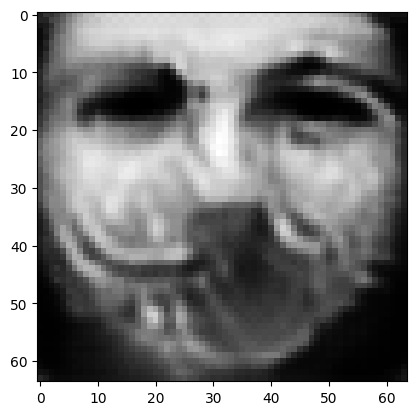

tensor([[1.4494e-03, 1.7880e-03, 6.0373e-03, 2.4977e-03, 4.0368e-04, 5.0445e-03,
         6.3786e-04, 1.8599e-02, 3.7631e-04, 9.1667e-01, 4.8255e-04, 2.1051e-03,
         1.6270e-04, 3.4013e-06, 1.0223e-05, 2.0490e-03, 1.0179e-04, 9.6203e-05,
         8.5487e-04, 1.8319e-03, 5.1823e-05, 4.3359e-04, 3.7651e-07, 2.0317e-05,
         2.1999e-05, 3.8103e-04, 1.9016e-03, 8.5931e-04, 2.1021e-02, 1.1408e-03,
         9.3331e-04, 4.8830e-04, 9.9690e-04, 1.2880e-03, 6.2828e-04, 6.0368e-05,
         2.9971e-05, 2.4473e-03, 1.9470e-03, 4.1507e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08701140433549881
tensor([[1.3466e-03, 1.6282e-03, 5.6468e-03, 2.3605e-03, 3.7173e-04, 4.5691e-03,
         5.7794e-04, 1.7364e-02, 3.6111e-04, 9.2211e-01, 4.4476e-04, 1.9903e-03,
         1.5053e-04, 3.0910e-06, 9.2773e-06, 1.9272e-03, 9.5091e-05, 8.5403e-05,
         7.9024e-04, 1.7101e-03, 4.7285e-05, 4.1081e-04, 3.4861e-07, 1.8883e-05,
         2.0378e-05, 3.6168e-04, 1.7111e-0

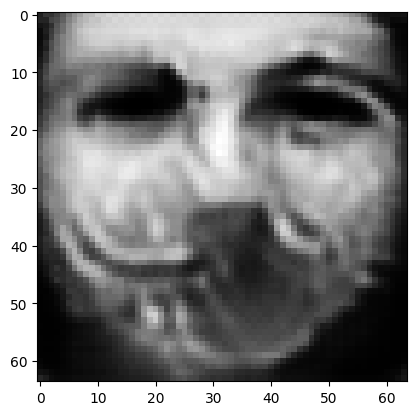

tensor([[1.1034e-03, 1.3124e-03, 4.5164e-03, 1.9657e-03, 3.0601e-04, 3.4911e-03,
         4.6497e-04, 1.4336e-02, 3.1663e-04, 9.3597e-01, 3.6188e-04, 1.6779e-03,
         1.2418e-04, 2.3228e-06, 7.3196e-06, 1.6773e-03, 7.5160e-05, 6.6314e-05,
         6.3627e-04, 1.5052e-03, 3.6739e-05, 3.3690e-04, 2.7866e-07, 1.5335e-05,
         1.6465e-05, 2.9517e-04, 1.3586e-03, 6.1587e-04, 1.6412e-02, 8.6733e-04,
         7.5447e-04, 4.0936e-04, 7.5968e-04, 9.1967e-04, 5.0529e-04, 4.6976e-05,
         2.2351e-05, 2.0587e-03, 1.3778e-03, 3.2788e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06617550551891327
tensor([[1.0607e-03, 1.2610e-03, 4.3277e-03, 1.8963e-03, 2.9431e-04, 3.3191e-03,
         4.4518e-04, 1.3797e-02, 3.1018e-04, 9.3827e-01, 3.4879e-04, 1.6254e-03,
         1.1968e-04, 2.2008e-06, 7.0234e-06, 1.6314e-03, 7.1820e-05, 6.3121e-05,
         6.1179e-04, 1.4691e-03, 3.5134e-05, 3.2593e-04, 2.6747e-07, 1.4698e-05,
         1.5799e-05, 2.8399e-04, 1.3036e-0

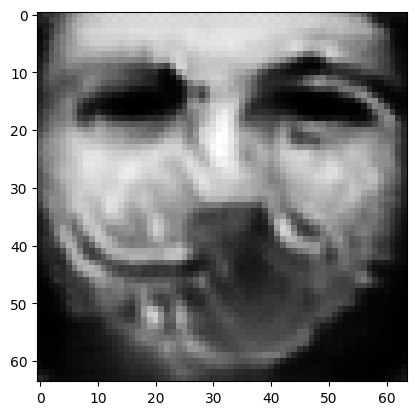

tensor([[9.4120e-04, 1.1175e-03, 3.7328e-03, 1.7236e-03, 2.6232e-04, 2.7773e-03,
         3.8912e-04, 1.2228e-02, 2.7909e-04, 9.4559e-01, 3.0926e-04, 1.4585e-03,
         1.0704e-04, 1.8683e-06, 6.1802e-06, 1.4865e-03, 6.2670e-05, 5.4699e-05,
         5.3791e-04, 1.3571e-03, 3.0010e-05, 2.9062e-04, 2.3146e-07, 1.3070e-05,
         1.3772e-05, 2.4719e-04, 1.1346e-03, 5.1262e-04, 1.3873e-02, 7.4050e-04,
         6.7014e-04, 3.7692e-04, 6.4649e-04, 7.5710e-04, 4.3882e-04, 4.1196e-05,
         1.8741e-05, 1.8591e-03, 1.1190e-03, 2.7926e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05594472214579582
tensor([[9.1814e-04, 1.0790e-03, 3.6392e-03, 1.6984e-03, 2.5723e-04, 2.6507e-03,
         3.7456e-04, 1.1872e-02, 2.6920e-04, 9.4713e-01, 3.0073e-04, 1.4115e-03,
         1.0378e-04, 1.8102e-06, 6.0034e-06, 1.4541e-03, 6.1708e-05, 5.3101e-05,
         5.2364e-04, 1.3274e-03, 2.8918e-05, 2.8479e-04, 2.2205e-07, 1.2837e-05,
         1.3381e-05, 2.4005e-04, 1.0834e-0

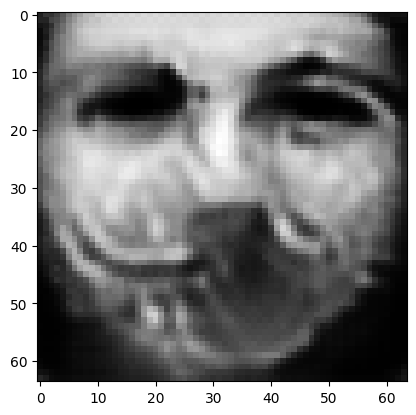

tensor([[8.2672e-04, 9.5319e-04, 3.2946e-03, 1.6022e-03, 2.3276e-04, 2.2554e-03,
         3.2686e-04, 1.0551e-02, 2.4768e-04, 9.5227e-01, 2.7472e-04, 1.2905e-03,
         9.3619e-05, 1.6088e-06, 5.3985e-06, 1.3484e-03, 5.7666e-05, 4.6820e-05,
         4.7802e-04, 1.2223e-03, 2.5622e-05, 2.6199e-04, 1.9622e-07, 1.1717e-05,
         1.2006e-05, 2.1575e-04, 9.3946e-04, 4.4553e-04, 1.2386e-02, 6.6738e-04,
         6.3124e-04, 3.4390e-04, 5.4518e-04, 6.5839e-04, 3.9104e-04, 3.7270e-05,
         1.6912e-05, 1.7457e-03, 9.3728e-04, 2.3491e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04890773072838783
tensor([[8.0531e-04, 9.2584e-04, 3.2319e-03, 1.5810e-03, 2.2652e-04, 2.1720e-03,
         3.1500e-04, 1.0210e-02, 2.4279e-04, 9.5333e-01, 2.7012e-04, 1.2707e-03,
         9.1182e-05, 1.5668e-06, 5.2703e-06, 1.3303e-03, 5.6922e-05, 4.5346e-05,
         4.6916e-04, 1.1959e-03, 2.5024e-05, 2.5760e-04, 1.9001e-07, 1.1481e-05,
         1.1609e-05, 2.1045e-04, 9.0693e-0

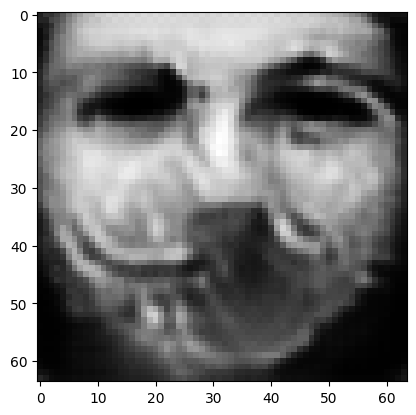

tensor([[7.4581e-04, 8.4165e-04, 3.0241e-03, 1.5104e-03, 2.0746e-04, 1.9425e-03,
         2.8248e-04, 9.2484e-03, 2.2819e-04, 9.5677e-01, 2.5547e-04, 1.2101e-03,
         8.3947e-05, 1.4142e-06, 4.8589e-06, 1.2795e-03, 5.3977e-05, 4.0520e-05,
         4.3849e-04, 1.1167e-03, 2.2917e-05, 2.4554e-04, 1.7046e-07, 1.0710e-05,
         1.0388e-05, 1.9133e-04, 8.2018e-04, 3.9800e-04, 1.1432e-02, 6.1504e-04,
         5.9775e-04, 3.1733e-04, 4.7283e-04, 5.8651e-04, 3.5917e-04, 3.3805e-05,
         1.5706e-05, 1.6508e-03, 8.1057e-04, 2.1191e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04418782889842987
tensor([[7.3549e-04, 8.2680e-04, 2.9807e-03, 1.5003e-03, 2.0433e-04, 1.8980e-03,
         2.7643e-04, 9.0600e-03, 2.2517e-04, 9.5751e-01, 2.5214e-04, 1.1955e-03,
         8.2676e-05, 1.3852e-06, 4.7823e-06, 1.2687e-03, 5.3314e-05, 3.9618e-05,
         4.3210e-04, 1.1007e-03, 2.2473e-05, 2.4290e-04, 1.6645e-07, 1.0551e-05,
         1.0152e-05, 1.8728e-04, 8.0352e-0

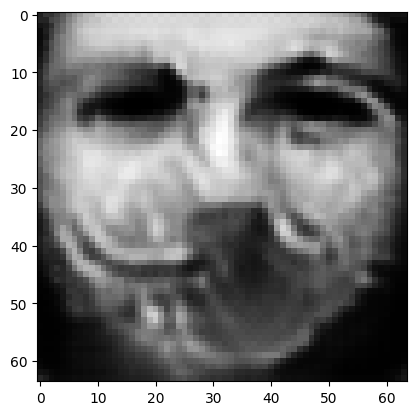

tensor([[6.8897e-04, 7.7010e-04, 2.8071e-03, 1.4331e-03, 1.9092e-04, 1.7392e-03,
         2.5552e-04, 8.4397e-03, 2.1263e-04, 9.6009e-01, 2.4163e-04, 1.1462e-03,
         7.7144e-05, 1.2653e-06, 4.4670e-06, 1.2374e-03, 5.0704e-05, 3.5940e-05,
         4.0970e-04, 1.0403e-03, 2.0782e-05, 2.3305e-04, 1.5257e-07, 1.0000e-05,
         9.1838e-06, 1.7245e-04, 7.4416e-04, 3.6618e-04, 1.0549e-02, 5.7198e-04,
         5.6914e-04, 2.9829e-04, 4.2245e-04, 5.3349e-04, 3.3258e-04, 3.1214e-05,
         1.4667e-05, 1.5621e-03, 7.2441e-04, 1.9623e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.040727995336055756
tensor([[6.7715e-04, 7.5636e-04, 2.7658e-03, 1.4171e-03, 1.8787e-04, 1.6999e-03,
         2.5049e-04, 8.2960e-03, 2.0965e-04, 9.6068e-01, 2.3910e-04, 1.1324e-03,
         7.5848e-05, 1.2377e-06, 4.3908e-06, 1.2297e-03, 5.0098e-05, 3.5016e-05,
         4.0488e-04, 1.0264e-03, 2.0363e-05, 2.3073e-04, 1.4950e-07, 9.8796e-06,
         8.9679e-06, 1.6915e-04, 7.2929e-

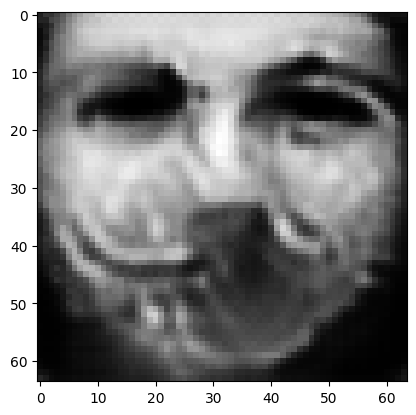

tensor([[6.3741e-04, 7.0536e-04, 2.6198e-03, 1.3708e-03, 1.7808e-04, 1.5538e-03,
         2.3173e-04, 7.7115e-03, 1.9979e-04, 9.6297e-01, 2.2893e-04, 1.0727e-03,
         7.1244e-05, 1.1442e-06, 4.1474e-06, 1.2022e-03, 4.8220e-05, 3.1792e-05,
         3.8784e-04, 9.7772e-04, 1.8841e-05, 2.2215e-04, 1.3796e-07, 9.4361e-06,
         8.2186e-06, 1.5607e-04, 6.7136e-04, 3.4058e-04, 9.8334e-03, 5.3972e-04,
         5.4771e-04, 2.7818e-04, 3.7722e-04, 4.9002e-04, 3.0971e-04, 2.9021e-05,
         1.3734e-05, 1.4784e-03, 6.5924e-04, 1.8171e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03773748502135277
tensor([[6.2890e-04, 6.9189e-04, 2.5891e-03, 1.3607e-03, 1.7617e-04, 1.5197e-03,
         2.2721e-04, 7.5908e-03, 1.9638e-04, 9.6350e-01, 2.2642e-04, 1.0540e-03,
         6.9946e-05, 1.1202e-06, 4.0785e-06, 1.1959e-03, 4.7836e-05, 3.1088e-05,
         3.8379e-04, 9.6432e-04, 1.8443e-05, 2.1975e-04, 1.3481e-07, 9.3381e-06,
         8.0361e-06, 1.5314e-04, 6.5614e-0

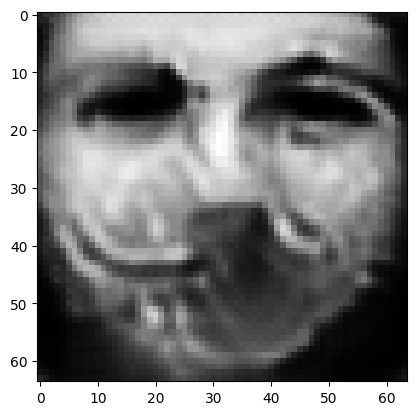

tensor([[5.9985e-04, 6.4766e-04, 2.4714e-03, 1.3263e-03, 1.6952e-04, 1.3972e-03,
         2.1207e-04, 7.1794e-03, 1.8378e-04, 9.6545e-01, 2.1741e-04, 9.9111e-04,
         6.5384e-05, 1.0360e-06, 3.8490e-06, 1.1767e-03, 4.6528e-05, 2.8697e-05,
         3.7053e-04, 9.1806e-04, 1.7102e-05, 2.1179e-04, 1.2408e-07, 9.0391e-06,
         7.4026e-06, 1.4209e-04, 6.0369e-04, 3.2327e-04, 9.1678e-03, 5.0516e-04,
         5.2335e-04, 2.5990e-04, 3.3314e-04, 4.5183e-04, 2.8818e-04, 2.6967e-05,
         1.3016e-05, 1.3994e-03, 6.0044e-04, 1.6598e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03516105189919472
tensor([[5.9266e-04, 6.3732e-04, 2.4446e-03, 1.3194e-03, 1.6779e-04, 1.3693e-03,
         2.0851e-04, 7.0818e-03, 1.8126e-04, 9.6590e-01, 2.1521e-04, 9.7732e-04,
         6.4449e-05, 1.0181e-06, 3.7950e-06, 1.1703e-03, 4.6233e-05, 2.8106e-05,
         3.6741e-04, 9.0704e-04, 1.6791e-05, 2.1003e-04, 1.2187e-07, 8.9666e-06,
         7.2627e-06, 1.3968e-04, 5.9182e-0

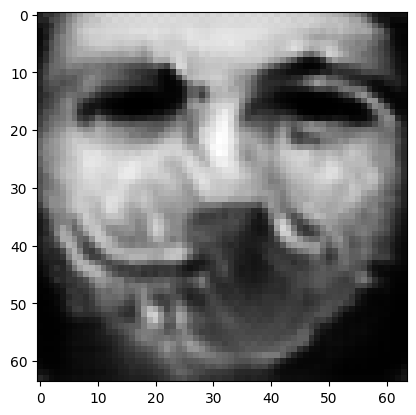

tensor([[5.6352e-04, 6.0052e-04, 2.3433e-03, 1.2797e-03, 1.6179e-04, 1.2693e-03,
         1.9508e-04, 6.7462e-03, 1.7082e-04, 9.6750e-01, 2.0783e-04, 9.2994e-04,
         6.0629e-05, 9.5041e-07, 3.5978e-06, 1.1506e-03, 4.4986e-05, 2.6091e-05,
         3.5502e-04, 8.6701e-04, 1.5747e-05, 2.0397e-04, 1.1372e-07, 8.7138e-06,
         6.7502e-06, 1.3145e-04, 5.4782e-04, 3.0889e-04, 8.6219e-03, 4.7656e-04,
         5.0491e-04, 2.4504e-04, 3.0013e-04, 4.2274e-04, 2.6943e-04, 2.5230e-05,
         1.2346e-05, 1.3345e-03, 5.5484e-04, 1.5348e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.033042751252651215
tensor([[5.5687e-04, 5.9097e-04, 2.3174e-03, 1.2694e-03, 1.6074e-04, 1.2466e-03,
         1.9192e-04, 6.6752e-03, 1.6757e-04, 9.6788e-01, 2.0624e-04, 9.1572e-04,
         5.9630e-05, 9.3394e-07, 3.5491e-06, 1.1464e-03, 4.4744e-05, 2.5614e-05,
         3.5171e-04, 8.5650e-04, 1.5479e-05, 2.0298e-04, 1.1153e-07, 8.6628e-06,
         6.6293e-06, 1.2962e-04, 5.3622e-

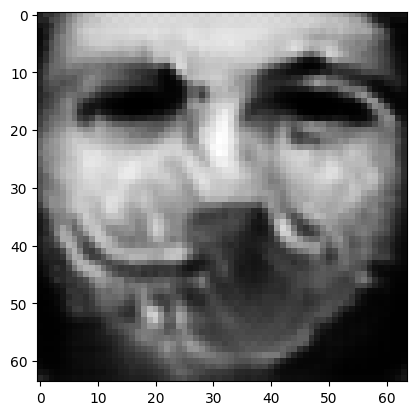

tensor([[5.3094e-04, 5.6094e-04, 2.2234e-03, 1.2277e-03, 1.5595e-04, 1.1676e-03,
         1.8106e-04, 6.4135e-03, 1.5754e-04, 9.6918e-01, 2.0100e-04, 8.7860e-04,
         5.6301e-05, 8.7705e-07, 3.3890e-06, 1.1341e-03, 4.3675e-05, 2.4062e-05,
         3.4037e-04, 8.2477e-04, 1.4650e-05, 1.9881e-04, 1.0473e-07, 8.4740e-06,
         6.2015e-06, 1.2269e-04, 5.0066e-04, 2.9710e-04, 8.2023e-03, 4.5015e-04,
         4.8576e-04, 2.3547e-04, 2.7566e-04, 4.0069e-04, 2.5220e-04, 2.3755e-05,
         1.1748e-05, 1.2710e-03, 5.1684e-04, 1.4198e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03130476549267769
tensor([[5.2565e-04, 5.5412e-04, 2.2034e-03, 1.2206e-03, 1.5499e-04, 1.1502e-03,
         1.7853e-04, 6.3590e-03, 1.5527e-04, 9.6948e-01, 1.9982e-04, 8.6944e-04,
         5.5568e-05, 8.6468e-07, 3.3533e-06, 1.1292e-03, 4.3457e-05, 2.3736e-05,
         3.3748e-04, 8.1710e-04, 1.4457e-05, 1.9798e-04, 1.0312e-07, 8.4321e-06,
         6.1154e-06, 1.2128e-04, 4.9244e-0

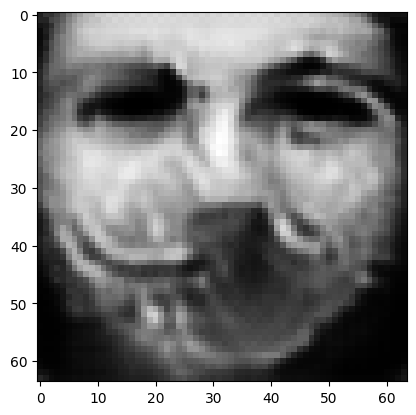

tensor([[5.0434e-04, 5.2832e-04, 2.1308e-03, 1.1942e-03, 1.5134e-04, 1.0846e-03,
         1.6951e-04, 6.1315e-03, 1.4749e-04, 9.7058e-01, 1.9554e-04, 8.3570e-04,
         5.2976e-05, 8.2192e-07, 3.2238e-06, 1.1139e-03, 4.2765e-05, 2.2546e-05,
         3.2772e-04, 7.9280e-04, 1.3729e-05, 1.9405e-04, 9.7564e-08, 8.2990e-06,
         5.8034e-06, 1.1575e-04, 4.6238e-04, 2.8777e-04, 7.8304e-03, 4.2908e-04,
         4.7181e-04, 2.2773e-04, 2.5548e-04, 3.8344e-04, 2.3882e-04, 2.2593e-05,
         1.1283e-05, 1.2245e-03, 4.8710e-04, 1.3221e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029863810166716576
tensor([[4.9972e-04, 5.2243e-04, 2.1141e-03, 1.1899e-03, 1.5065e-04, 1.0699e-03,
         1.6741e-04, 6.0796e-03, 1.4570e-04, 9.7084e-01, 1.9455e-04, 8.2706e-04,
         5.2421e-05, 8.1280e-07, 3.1950e-06, 1.1091e-03, 4.2624e-05, 2.2286e-05,
         3.2517e-04, 7.8733e-04, 1.3554e-05, 1.9314e-04, 9.6229e-08, 8.2700e-06,
         5.7380e-06, 1.1458e-04, 4.5546e-

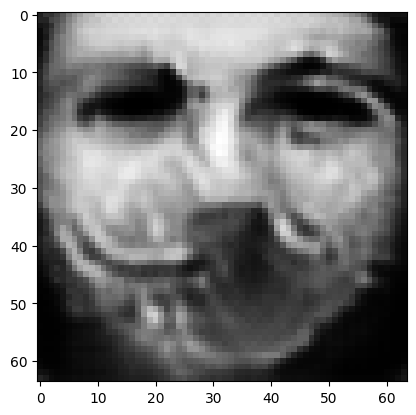

tensor([[4.8134e-04, 5.0043e-04, 2.0469e-03, 1.1690e-03, 1.4765e-04, 1.0138e-03,
         1.6024e-04, 5.8823e-03, 1.3877e-04, 9.7179e-01, 1.9131e-04, 7.9727e-04,
         5.0291e-05, 7.7816e-07, 3.0899e-06, 1.0944e-03, 4.2125e-05, 2.1228e-05,
         3.1679e-04, 7.6726e-04, 1.2906e-05, 1.9007e-04, 9.1511e-08, 8.1763e-06,
         5.4697e-06, 1.0997e-04, 4.3082e-04, 2.8030e-04, 7.5027e-03, 4.1196e-04,
         4.6223e-04, 2.2131e-04, 2.3808e-04, 3.6882e-04, 2.2716e-04, 2.1713e-05,
         1.0938e-05, 1.1860e-03, 4.6195e-04, 1.2332e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02861449122428894
tensor([[4.7595e-04, 4.9467e-04, 2.0304e-03, 1.1623e-03, 1.4650e-04, 9.9907e-04,
         1.5837e-04, 5.8221e-03, 1.3729e-04, 9.7203e-01, 1.9057e-04, 7.9245e-04,
         4.9709e-05, 7.6940e-07, 3.0616e-06, 1.0925e-03, 4.2003e-05, 2.0926e-05,
         3.1519e-04, 7.6195e-04, 1.2764e-05, 1.8929e-04, 9.0518e-08, 8.1488e-06,
         5.3917e-06, 1.0868e-04, 4.2496e-0

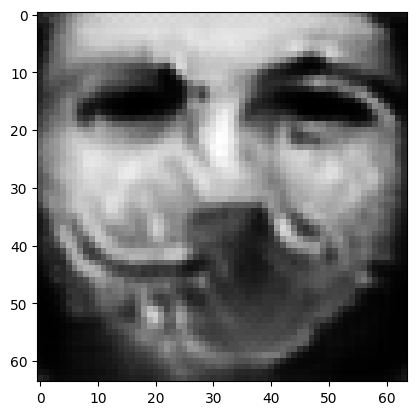

tensor([[4.5861e-04, 4.7437e-04, 1.9668e-03, 1.1418e-03, 1.4315e-04, 9.4706e-04,
         1.5188e-04, 5.6259e-03, 1.3089e-04, 9.7292e-01, 1.8750e-04, 7.6875e-04,
         4.7670e-05, 7.3648e-07, 2.9591e-06, 1.0812e-03, 4.1518e-05, 1.9866e-05,
         3.0850e-04, 7.4133e-04, 1.2196e-05, 1.8669e-04, 8.6343e-08, 8.0603e-06,
         5.1102e-06, 1.0418e-04, 4.0282e-04, 2.7206e-04, 7.2132e-03, 3.9684e-04,
         4.5294e-04, 2.1411e-04, 2.2224e-04, 3.5443e-04, 2.1612e-04, 2.0874e-05,
         1.0631e-05, 1.1514e-03, 4.3772e-04, 1.1601e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027455702424049377
tensor([[4.5492e-04, 4.6946e-04, 1.9536e-03, 1.1375e-03, 1.4247e-04, 9.3515e-04,
         1.5039e-04, 5.5791e-03, 1.2941e-04, 9.7312e-01, 1.8670e-04, 7.6259e-04,
         4.7214e-05, 7.2934e-07, 2.9356e-06, 1.0778e-03, 4.1420e-05, 1.9642e-05,
         3.0687e-04, 7.3676e-04, 1.2062e-05, 1.8610e-04, 8.5358e-08, 8.0427e-06,
         5.0501e-06, 1.0318e-04, 3.9765e-

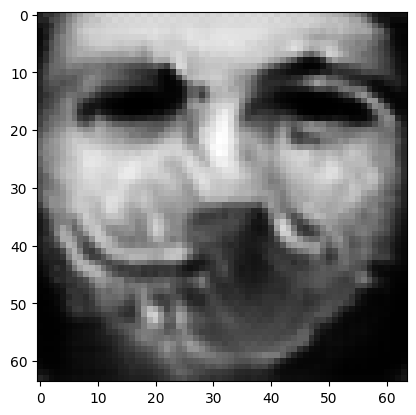

tensor([[4.3864e-04, 4.5002e-04, 1.9016e-03, 1.1175e-03, 1.3951e-04, 8.8883e-04,
         1.4441e-04, 5.3968e-03, 1.2352e-04, 9.7391e-01, 1.8390e-04, 7.3994e-04,
         4.5430e-05, 7.0051e-07, 2.8336e-06, 1.0658e-03, 4.1079e-05, 1.8781e-05,
         3.0101e-04, 7.2018e-04, 1.1525e-05, 1.8350e-04, 8.1643e-08, 7.9840e-06,
         4.8180e-06, 9.9241e-05, 3.7771e-04, 2.6484e-04, 6.9678e-03, 3.8236e-04,
         4.4475e-04, 2.0764e-04, 2.0881e-04, 3.4183e-04, 2.0594e-04, 2.0095e-05,
         1.0395e-05, 1.1208e-03, 4.1753e-04, 1.0879e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0264324601739645
tensor([[4.3499e-04, 4.4545e-04, 1.8896e-03, 1.1125e-03, 1.3896e-04, 8.7851e-04,
         1.4314e-04, 5.3587e-03, 1.2207e-04, 9.7410e-01, 1.8322e-04, 7.3392e-04,
         4.5022e-05, 6.9367e-07, 2.8108e-06, 1.0629e-03, 4.1012e-05, 1.8598e-05,
         2.9940e-04, 7.1673e-04, 1.1393e-05, 1.8284e-04, 8.0739e-08, 7.9769e-06,
         4.7659e-06, 9.8298e-05, 3.7296e-04

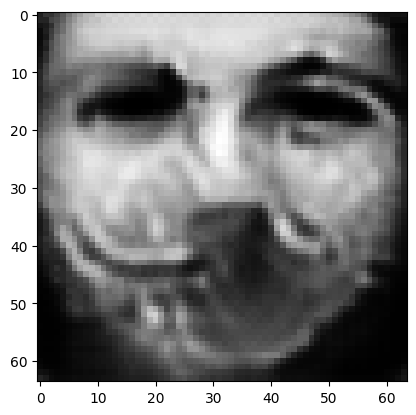

tensor([[4.2020e-04, 4.2894e-04, 1.8437e-03, 1.0906e-03, 1.3624e-04, 8.3999e-04,
         1.3843e-04, 5.1967e-03, 1.1759e-04, 9.7479e-01, 1.8075e-04, 7.1620e-04,
         4.3580e-05, 6.6923e-07, 2.7250e-06, 1.0540e-03, 4.0690e-05, 1.7883e-05,
         2.9409e-04, 7.0460e-04, 1.0945e-05, 1.8021e-04, 7.7870e-08, 7.9300e-06,
         4.5724e-06, 9.4753e-05, 3.5699e-04, 2.5804e-04, 6.7452e-03, 3.6948e-04,
         4.3723e-04, 2.0214e-04, 1.9832e-04, 3.3099e-04, 1.9705e-04, 1.9418e-05,
         1.0151e-05, 1.0915e-03, 4.0111e-04, 1.0283e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02553507313132286
tensor([[4.1731e-04, 4.2511e-04, 1.8339e-03, 1.0873e-03, 1.3578e-04, 8.3150e-04,
         1.3727e-04, 5.1609e-03, 1.1645e-04, 9.7494e-01, 1.8014e-04, 7.1140e-04,
         4.3250e-05, 6.6408e-07, 2.7050e-06, 1.0510e-03, 4.0649e-05, 1.7723e-05,
         2.9270e-04, 7.0132e-04, 1.0839e-05, 1.7985e-04, 7.7117e-08, 7.9205e-06,
         4.5324e-06, 9.4059e-05, 3.5314e-0

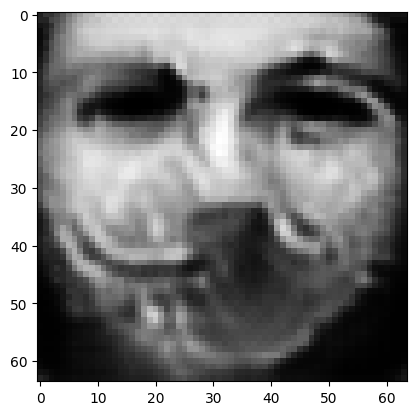

tensor([[4.0557e-04, 4.1164e-04, 1.7936e-03, 1.0674e-03, 1.3347e-04, 8.0150e-04,
         1.3347e-04, 5.0349e-03, 1.1232e-04, 9.7551e-01, 1.7806e-04, 6.9723e-04,
         4.1942e-05, 6.4312e-07, 2.6310e-06, 1.0427e-03, 4.0321e-05, 1.7126e-05,
         2.8764e-04, 6.8894e-04, 1.0478e-05, 1.7823e-04, 7.4508e-08, 7.8718e-06,
         4.3635e-06, 9.1310e-05, 3.4019e-04, 2.5207e-04, 6.5659e-03, 3.5817e-04,
         4.3136e-04, 1.9800e-04, 1.8974e-04, 3.2212e-04, 1.8958e-04, 1.8883e-05,
         9.9692e-06, 1.0665e-03, 3.8656e-04, 9.7835e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02479562722146511
tensor([[4.0272e-04, 4.0856e-04, 1.7845e-03, 1.0609e-03, 1.3287e-04, 7.9524e-04,
         1.3263e-04, 5.0036e-03, 1.1139e-04, 9.7564e-01, 1.7759e-04, 6.9488e-04,
         4.1629e-05, 6.3765e-07, 2.6130e-06, 1.0418e-03, 4.0201e-05, 1.7002e-05,
         2.8630e-04, 6.8633e-04, 1.0397e-05, 1.7760e-04, 7.3888e-08, 7.8589e-06,
         4.3183e-06, 9.0556e-05, 3.3737e-0

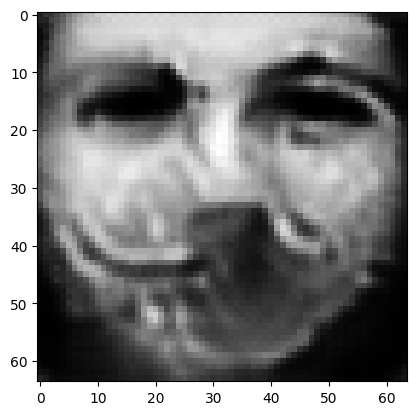

tensor([[3.9294e-04, 3.9858e-04, 1.7473e-03, 1.0460e-03, 1.3071e-04, 7.7184e-04,
         1.2941e-04, 4.9013e-03, 1.0815e-04, 9.7614e-01, 1.7600e-04, 6.8475e-04,
         4.0615e-05, 6.2082e-07, 2.5518e-06, 1.0317e-03, 3.9794e-05, 1.6498e-05,
         2.8112e-04, 6.7438e-04, 1.0092e-05, 1.7594e-04, 7.1664e-08, 7.7964e-06,
         4.1675e-06, 8.8344e-05, 3.2712e-04, 2.4638e-04, 6.3913e-03, 3.4836e-04,
         4.2516e-04, 1.9471e-04, 1.8290e-04, 3.1369e-04, 1.8318e-04, 1.8405e-05,
         9.7856e-06, 1.0452e-03, 3.7340e-04, 9.4072e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024150360375642776
tensor([[3.9105e-04, 3.9688e-04, 1.7380e-03, 1.0429e-03, 1.3017e-04, 7.6751e-04,
         1.2883e-04, 4.8806e-03, 1.0780e-04, 9.7625e-01, 1.7555e-04, 6.8329e-04,
         4.0449e-05, 6.1735e-07, 2.5404e-06, 1.0286e-03, 3.9651e-05, 1.6391e-05,
         2.7984e-04, 6.7199e-04, 1.0036e-05, 1.7550e-04, 7.1270e-08, 7.7689e-06,
         4.1385e-06, 8.7862e-05, 3.2547e-

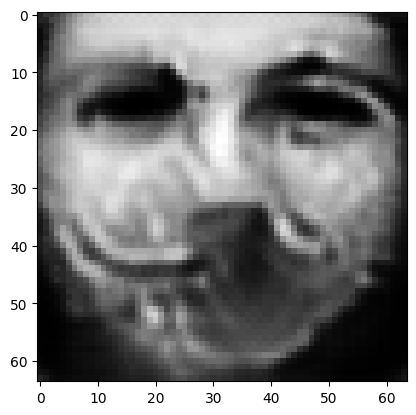

tensor([[3.8342e-04, 3.9086e-04, 1.7024e-03, 1.0316e-03, 1.2810e-04, 7.4961e-04,
         1.2653e-04, 4.7912e-03, 1.0635e-04, 9.7665e-01, 1.7415e-04, 6.7863e-04,
         3.9803e-05, 6.0553e-07, 2.5002e-06, 1.0205e-03, 3.9172e-05, 1.5995e-05,
         2.7584e-04, 6.6338e-04, 9.8364e-06, 1.7397e-04, 6.9899e-08, 7.6789e-06,
         4.0325e-06, 8.6098e-05, 3.1954e-04, 2.4120e-04, 6.2231e-03, 3.4213e-04,
         4.2260e-04, 1.9213e-04, 1.7821e-04, 3.0633e-04, 1.7937e-04, 1.8154e-05,
         9.6397e-06, 1.0320e-03, 3.6240e-04, 9.2027e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02362646535038948
tensor([[3.8108e-04, 3.8909e-04, 1.6933e-03, 1.0254e-03, 1.2750e-04, 7.4484e-04,
         1.2602e-04, 4.7693e-03, 1.0559e-04, 9.7674e-01, 1.7404e-04, 6.7771e-04,
         3.9554e-05, 6.0156e-07, 2.4876e-06, 1.0208e-03, 3.9045e-05, 1.5907e-05,
         2.7500e-04, 6.6140e-04, 9.7838e-06, 1.7341e-04, 6.9500e-08, 7.6684e-06,
         3.9970e-06, 8.5543e-05, 3.1797e-0

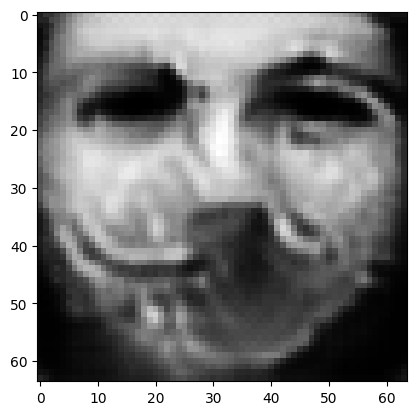

tensor([[3.7428e-04, 3.8312e-04, 1.6626e-03, 1.0164e-03, 1.2571e-04, 7.2797e-04,
         1.2375e-04, 4.6823e-03, 1.0403e-04, 9.7711e-01, 1.7285e-04, 6.7270e-04,
         3.8932e-05, 5.9132e-07, 2.4506e-06, 1.0131e-03, 3.8673e-05, 1.5540e-05,
         2.7137e-04, 6.5276e-04, 9.6027e-06, 1.7238e-04, 6.8148e-08, 7.5956e-06,
         3.9000e-06, 8.4020e-05, 3.1202e-04, 2.3652e-04, 6.0945e-03, 3.3647e-04,
         4.1918e-04, 1.9019e-04, 1.7398e-04, 3.0016e-04, 1.7547e-04, 1.7903e-05,
         9.5000e-06, 1.0196e-03, 3.5230e-04, 8.9906e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023159371688961983
tensor([[3.7280e-04, 3.8192e-04, 1.6557e-03, 1.0152e-03, 1.2527e-04, 7.2435e-04,
         1.2321e-04, 4.6609e-03, 1.0391e-04, 9.7719e-01, 1.7248e-04, 6.7180e-04,
         3.8831e-05, 5.8924e-07, 2.4427e-06, 1.0104e-03, 3.8569e-05, 1.5451e-05,
         2.7047e-04, 6.5085e-04, 9.5645e-06, 1.7210e-04, 6.7883e-08, 7.5697e-06,
         3.8799e-06, 8.3695e-05, 3.1085e-

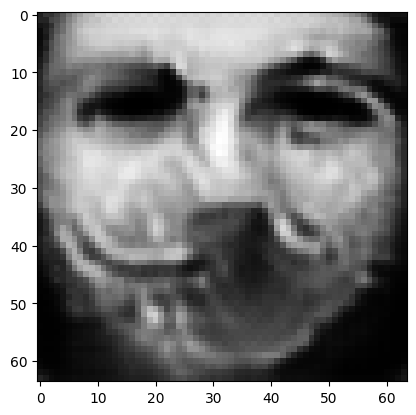

tensor([[3.6638e-04, 3.7706e-04, 1.6263e-03, 1.0073e-03, 1.2336e-04, 7.0860e-04,
         1.2112e-04, 4.5780e-03, 1.0268e-04, 9.7752e-01, 1.7148e-04, 6.6798e-04,
         3.8308e-05, 5.8064e-07, 2.4110e-06, 1.0023e-03, 3.8170e-05, 1.5120e-05,
         2.6707e-04, 6.4313e-04, 9.4039e-06, 1.7088e-04, 6.6702e-08, 7.4888e-06,
         3.7891e-06, 8.2334e-05, 3.0591e-04, 2.3214e-04, 5.9707e-03, 3.3241e-04,
         4.1768e-04, 1.8797e-04, 1.7003e-04, 2.9432e-04, 1.7254e-04, 1.7713e-05,
         9.3918e-06, 1.0101e-03, 3.4323e-04, 8.8227e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022734245285391808
tensor([[3.6450e-04, 3.7581e-04, 1.6185e-03, 1.0025e-03, 1.2282e-04, 7.0455e-04,
         1.2066e-04, 4.5590e-03, 1.0210e-04, 9.7760e-01, 1.7136e-04, 6.6735e-04,
         3.8114e-05, 5.7769e-07, 2.4018e-06, 1.0022e-03, 3.8051e-05, 1.5049e-05,
         2.6633e-04, 6.4140e-04, 9.3638e-06, 1.7042e-04, 6.6380e-08, 7.4766e-06,
         3.7607e-06, 8.1906e-05, 3.0469e-

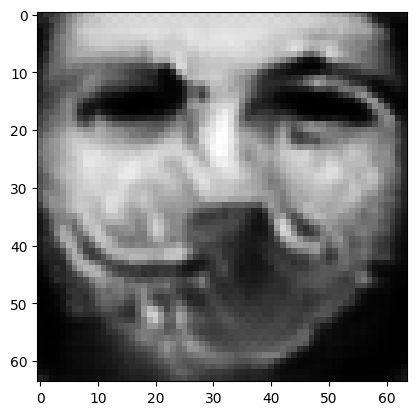

tensor([[3.5908e-04, 3.7105e-04, 1.5923e-03, 9.9581e-04, 1.2135e-04, 6.8960e-04,
         1.1855e-04, 4.4897e-03, 1.0044e-04, 9.7790e-01, 1.7034e-04, 6.6247e-04,
         3.7553e-05, 5.6996e-07, 2.3725e-06, 9.9457e-04, 3.7738e-05, 1.4753e-05,
         2.6311e-04, 6.3313e-04, 9.2129e-06, 1.6982e-04, 6.5144e-08, 7.4177e-06,
         3.6819e-06, 8.0794e-05, 2.9922e-04, 2.2810e-04, 5.8678e-03, 3.2786e-04,
         4.1506e-04, 1.8673e-04, 1.6651e-04, 2.8922e-04, 1.6915e-04, 1.7509e-05,
         9.2802e-06, 1.0007e-03, 3.3457e-04, 8.6181e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022346824407577515
tensor([[3.5737e-04, 3.6991e-04, 1.5856e-03, 9.9277e-04, 1.2085e-04, 6.8558e-04,
         1.1803e-04, 4.4704e-03, 9.9988e-05, 9.7797e-01, 1.7017e-04, 6.6198e-04,
         3.7393e-05, 5.6783e-07, 2.3645e-06, 9.9409e-04, 3.7652e-05, 1.4681e-05,
         2.6251e-04, 6.3126e-04, 9.1792e-06, 1.6955e-04, 6.4891e-08, 7.4052e-06,
         3.6597e-06, 8.0473e-05, 2.9801e-

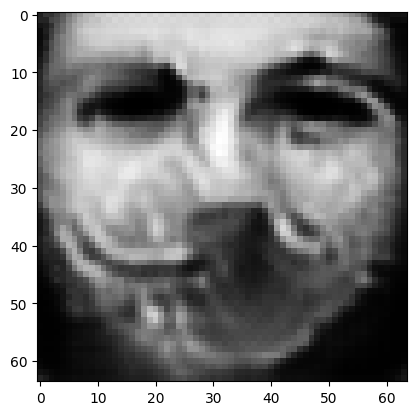

tensor([[3.5228e-04, 3.6570e-04, 1.5616e-03, 9.8612e-04, 1.1939e-04, 6.7220e-04,
         1.1608e-04, 4.4069e-03, 9.8592e-05, 9.7824e-01, 1.6920e-04, 6.5818e-04,
         3.6886e-05, 5.6060e-07, 2.3373e-06, 9.8739e-04, 3.7336e-05, 1.4403e-05,
         2.5961e-04, 6.2348e-04, 9.0471e-06, 1.6895e-04, 6.3830e-08, 7.3444e-06,
         3.5873e-06, 7.9476e-05, 2.9321e-04, 2.2431e-04, 5.7790e-03, 3.2412e-04,
         4.1314e-04, 1.8541e-04, 1.6331e-04, 2.8461e-04, 1.6619e-04, 1.7333e-05,
         9.1785e-06, 9.9269e-04, 3.2675e-04, 8.4441e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022000771015882492
tensor([[3.5083e-04, 3.6482e-04, 1.5553e-03, 9.8351e-04, 1.1894e-04, 6.6910e-04,
         1.1566e-04, 4.3913e-03, 9.8429e-05, 9.7830e-01, 1.6901e-04, 6.5779e-04,
         3.6786e-05, 5.5854e-07, 2.3313e-06, 9.8591e-04, 3.7218e-05, 1.4338e-05,
         2.5891e-04, 6.2225e-04, 9.0179e-06, 1.6857e-04, 6.3641e-08, 7.3255e-06,
         3.5688e-06, 7.9173e-05, 2.9233e-

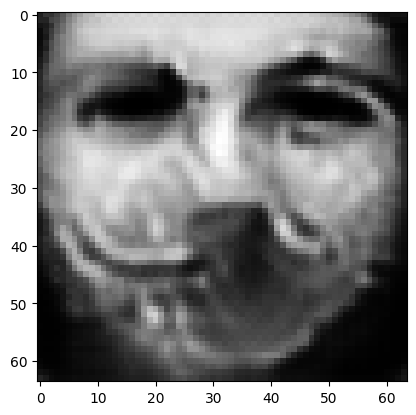

tensor([[3.4547e-04, 3.6093e-04, 1.5326e-03, 9.7684e-04, 1.1739e-04, 6.5646e-04,
         1.1382e-04, 4.3281e-03, 9.7259e-05, 9.7855e-01, 1.6824e-04, 6.5493e-04,
         3.6335e-05, 5.5158e-07, 2.3056e-06, 9.8049e-04, 3.6911e-05, 1.4058e-05,
         2.5649e-04, 6.1519e-04, 8.8972e-06, 1.6789e-04, 6.2739e-08, 7.2686e-06,
         3.4977e-06, 7.8191e-05, 2.8797e-04, 2.2059e-04, 5.6949e-03, 3.2104e-04,
         4.1130e-04, 1.8391e-04, 1.6049e-04, 2.8014e-04, 1.6360e-04, 1.7158e-05,
         9.0657e-06, 9.8460e-04, 3.1966e-04, 8.3090e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021678628399968147
tensor([[3.4421e-04, 3.5991e-04, 1.5274e-03, 9.7530e-04, 1.1704e-04, 6.5335e-04,
         1.1336e-04, 4.3118e-03, 9.6886e-05, 9.7861e-01, 1.6805e-04, 6.5416e-04,
         3.6213e-05, 5.4992e-07, 2.2988e-06, 9.7958e-04, 3.6854e-05, 1.3989e-05,
         2.5595e-04, 6.1334e-04, 8.8674e-06, 1.6779e-04, 6.2498e-08, 7.2575e-06,
         3.4800e-06, 7.7955e-05, 2.8685e-

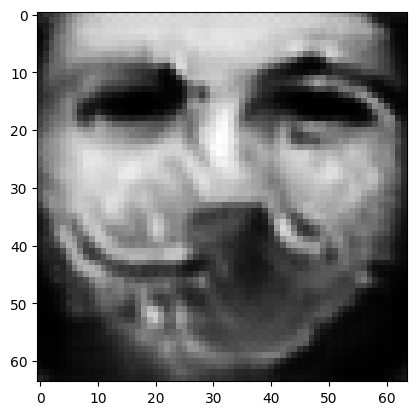

tensor([[3.3941e-04, 3.5639e-04, 1.5073e-03, 9.6772e-04, 1.1568e-04, 6.4228e-04,
         1.1176e-04, 4.2549e-03, 9.5713e-05, 9.7884e-01, 1.6737e-04, 6.5175e-04,
         3.5787e-05, 5.4336e-07, 2.2746e-06, 9.7575e-04, 3.6563e-05, 1.3761e-05,
         2.5376e-04, 6.0751e-04, 8.7595e-06, 1.6700e-04, 6.1682e-08, 7.2091e-06,
         3.4161e-06, 7.7018e-05, 2.8310e-04, 2.1740e-04, 5.6251e-03, 3.1792e-04,
         4.0910e-04, 1.8273e-04, 1.5784e-04, 2.7622e-04, 1.6119e-04, 1.6995e-05,
         8.9667e-06, 9.7704e-04, 3.1311e-04, 8.1733e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021390920504927635
tensor([[3.3846e-04, 3.5579e-04, 1.5028e-03, 9.6808e-04, 1.1538e-04, 6.3979e-04,
         1.1135e-04, 4.2412e-03, 9.5670e-05, 9.7889e-01, 1.6715e-04, 6.5128e-04,
         3.5732e-05, 5.4242e-07, 2.2708e-06, 9.7383e-04, 3.6514e-05, 1.3698e-05,
         2.5330e-04, 6.0598e-04, 8.7377e-06, 1.6691e-04, 6.1542e-08, 7.1923e-06,
         3.4049e-06, 7.6865e-05, 2.8231e-

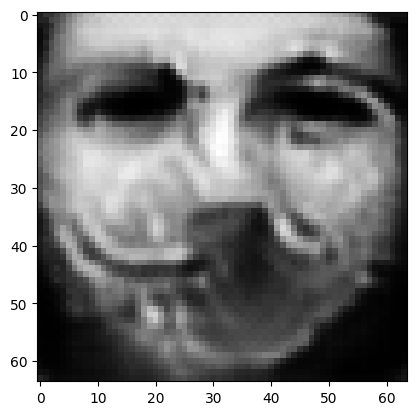

tensor([[3.3447e-04, 3.5211e-04, 1.4860e-03, 9.6242e-04, 1.1417e-04, 6.2957e-04,
         1.0978e-04, 4.1909e-03, 9.4443e-05, 9.7910e-01, 1.6629e-04, 6.4833e-04,
         3.5318e-05, 5.3599e-07, 2.2448e-06, 9.6949e-04, 3.6281e-05, 1.3479e-05,
         2.5117e-04, 5.9962e-04, 8.6264e-06, 1.6620e-04, 6.0703e-08, 7.1459e-06,
         3.3439e-06, 7.6014e-05, 2.7853e-04, 2.1464e-04, 5.5509e-03, 3.1506e-04,
         4.0794e-04, 1.8106e-04, 1.5491e-04, 2.7244e-04, 1.5910e-04, 1.6849e-05,
         8.8947e-06, 9.7062e-04, 3.0705e-04, 8.0439e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021121922880411148
tensor([[3.3309e-04, 3.5091e-04, 1.4821e-03, 9.5896e-04, 1.1373e-04, 6.2676e-04,
         1.0930e-04, 4.1756e-03, 9.4061e-05, 9.7915e-01, 1.6611e-04, 6.4806e-04,
         3.5174e-05, 5.3362e-07, 2.2356e-06, 9.6933e-04, 3.6193e-05, 1.3424e-05,
         2.5067e-04, 5.9808e-04, 8.6008e-06, 1.6588e-04, 6.0487e-08, 7.1330e-06,
         3.3259e-06, 7.5757e-05, 2.7757e-

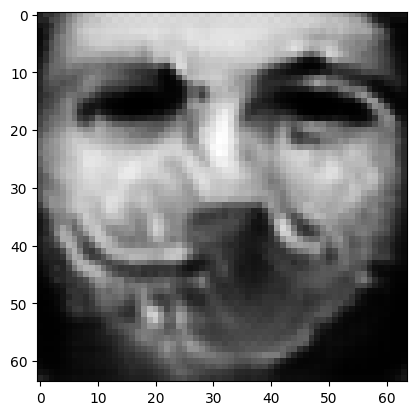

tensor([[3.2899e-04, 3.4719e-04, 1.4663e-03, 9.5551e-04, 1.1248e-04, 6.1610e-04,
         1.0764e-04, 4.1226e-03, 9.3269e-05, 9.7935e-01, 1.6517e-04, 6.4509e-04,
         3.4846e-05, 5.2802e-07, 2.2117e-06, 9.6345e-04, 3.5971e-05, 1.3194e-05,
         2.4872e-04, 5.9213e-04, 8.4948e-06, 1.6512e-04, 5.9828e-08, 7.0831e-06,
         3.2742e-06, 7.5008e-05, 2.7386e-04, 2.1164e-04, 5.4915e-03, 3.1217e-04,
         4.0585e-04, 1.7928e-04, 1.5221e-04, 2.6871e-04, 1.5693e-04, 1.6668e-05,
         8.8066e-06, 9.6497e-04, 3.0134e-04, 7.9242e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020862659439444542
tensor([[3.2820e-04, 3.4649e-04, 1.4622e-03, 9.5577e-04, 1.1222e-04, 6.1374e-04,
         1.0728e-04, 4.1125e-03, 9.3141e-05, 9.7940e-01, 1.6493e-04, 6.4409e-04,
         3.4786e-05, 5.2689e-07, 2.2069e-06, 9.6123e-04, 3.5921e-05, 1.3137e-05,
         2.4815e-04, 5.9052e-04, 8.4689e-06, 1.6499e-04, 5.9672e-08, 7.0693e-06,
         3.2635e-06, 7.4876e-05, 2.7297e-

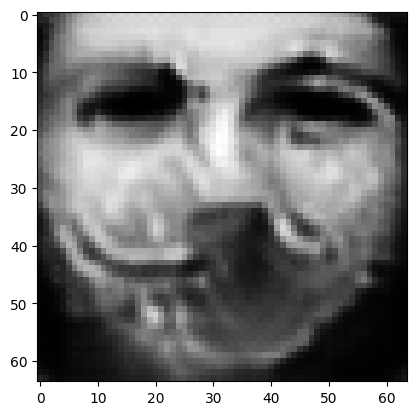

tensor([[3.2415e-04, 3.4263e-04, 1.4473e-03, 9.5073e-04, 1.1108e-04, 6.0380e-04,
         1.0556e-04, 4.0651e-03, 9.2231e-05, 9.7959e-01, 1.6399e-04, 6.4082e-04,
         3.4428e-05, 5.2055e-07, 2.1800e-06, 9.5501e-04, 3.5654e-05, 1.2928e-05,
         2.4602e-04, 5.8477e-04, 8.3683e-06, 1.6422e-04, 5.8972e-08, 7.0150e-06,
         3.2155e-06, 7.4243e-05, 2.6929e-04, 2.0897e-04, 5.4294e-03, 3.0958e-04,
         4.0453e-04, 1.7753e-04, 1.4954e-04, 2.6516e-04, 1.5502e-04, 1.6513e-05,
         8.7294e-06, 9.5985e-04, 2.9606e-04, 7.8023e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020617574453353882
tensor([[3.2324e-04, 3.4166e-04, 1.4436e-03, 9.4927e-04, 1.1083e-04, 6.0132e-04,
         1.0516e-04, 4.0543e-03, 9.1880e-05, 9.7964e-01, 1.6378e-04, 6.3978e-04,
         3.4323e-05, 5.1899e-07, 2.1733e-06, 9.5384e-04, 3.5598e-05, 1.2879e-05,
         2.4555e-04, 5.8321e-04, 8.3426e-06, 1.6408e-04, 5.8775e-08, 7.0056e-06,
         3.2032e-06, 7.4090e-05, 2.6833e-

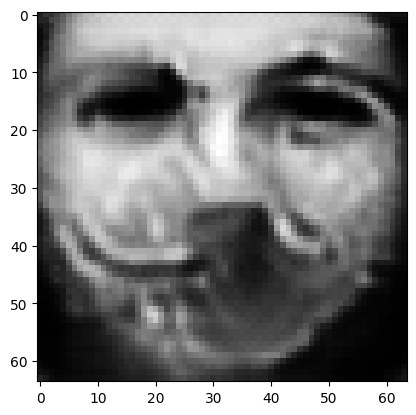

tensor([[3.1951e-04, 3.3838e-04, 1.4295e-03, 9.4534e-04, 1.0968e-04, 5.9215e-04,
         1.0373e-04, 4.0076e-03, 9.1217e-05, 9.7981e-01, 1.6290e-04, 6.3738e-04,
         3.4034e-05, 5.1381e-07, 2.1509e-06, 9.4824e-04, 3.5361e-05, 1.2683e-05,
         2.4372e-04, 5.7814e-04, 8.2544e-06, 1.6336e-04, 5.8221e-08, 6.9549e-06,
         3.1598e-06, 7.3464e-05, 2.6528e-04, 2.0640e-04, 5.3763e-03, 3.0726e-04,
         4.0317e-04, 1.7595e-04, 1.4726e-04, 2.6202e-04, 1.5315e-04, 1.6371e-05,
         8.6555e-06, 9.5522e-04, 2.9135e-04, 7.6953e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020391937345266342
tensor([[3.1860e-04, 3.3748e-04, 1.4262e-03, 9.4419e-04, 1.0943e-04, 5.8984e-04,
         1.0335e-04, 3.9969e-03, 9.0979e-05, 9.7986e-01, 1.6269e-04, 6.3658e-04,
         3.3949e-05, 5.1256e-07, 2.1450e-06, 9.4685e-04, 3.5308e-05, 1.2636e-05,
         2.4327e-04, 5.7680e-04, 8.2322e-06, 1.6326e-04, 5.8067e-08, 6.9443e-06,
         3.1495e-06, 7.3335e-05, 2.6443e-

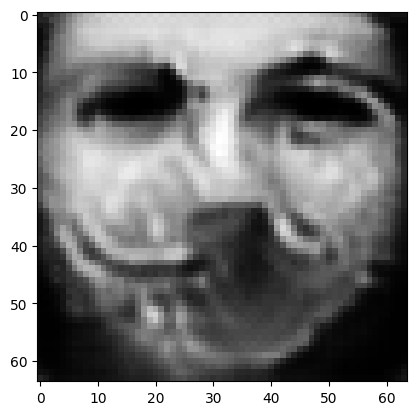

tensor([[3.1532e-04, 3.3443e-04, 1.4133e-03, 9.4045e-04, 1.0843e-04, 5.8150e-04,
         1.0209e-04, 3.9567e-03, 9.0339e-05, 9.8001e-01, 1.6191e-04, 6.3412e-04,
         3.3679e-05, 5.0809e-07, 2.1251e-06, 9.4131e-04, 3.5097e-05, 1.2463e-05,
         2.4157e-04, 5.7226e-04, 8.1521e-06, 1.6270e-04, 5.7562e-08, 6.8995e-06,
         3.1120e-06, 7.2797e-05, 2.6164e-04, 2.0410e-04, 5.3275e-03, 3.0513e-04,
         4.0237e-04, 1.7459e-04, 1.4526e-04, 2.5932e-04, 1.5145e-04, 1.6252e-05,
         8.5922e-06, 9.5143e-04, 2.8719e-04, 7.5959e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020188095048069954
tensor([[3.1437e-04, 3.3374e-04, 1.4102e-03, 9.3901e-04, 1.0809e-04, 5.7965e-04,
         1.0176e-04, 3.9453e-03, 9.0349e-05, 9.8005e-01, 1.6170e-04, 6.3422e-04,
         3.3623e-05, 5.0675e-07, 2.1202e-06, 9.4014e-04, 3.5020e-05, 1.2419e-05,
         2.4119e-04, 5.7138e-04, 8.1374e-06, 1.6246e-04, 5.7485e-08, 6.8819e-06,
         3.1024e-06, 7.2644e-05, 2.6118e-

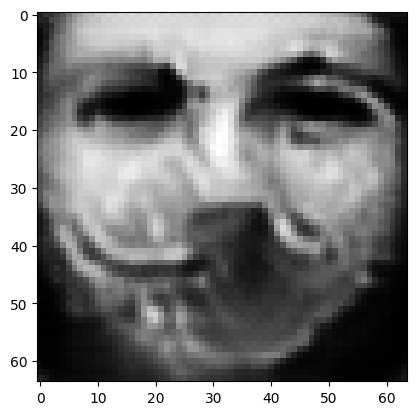

tensor([[3.1125e-04, 3.3081e-04, 1.3986e-03, 9.3463e-04, 1.0715e-04, 5.7201e-04,
         1.0057e-04, 3.9076e-03, 8.9724e-05, 9.8019e-01, 1.6100e-04, 6.3207e-04,
         3.3353e-05, 5.0234e-07, 2.1007e-06, 9.3564e-04, 3.4816e-05, 1.2260e-05,
         2.3970e-04, 5.6716e-04, 8.0647e-06, 1.6192e-04, 5.7020e-08, 6.8406e-06,
         3.0672e-06, 7.2148e-05, 2.5861e-04, 2.0173e-04, 5.2861e-03, 3.0315e-04,
         4.0093e-04, 1.7334e-04, 1.4360e-04, 2.5671e-04, 1.5002e-04, 1.6128e-05,
         8.5192e-06, 9.4797e-04, 2.8330e-04, 7.5241e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020004192367196083
tensor([[3.1069e-04, 3.3015e-04, 1.3956e-03, 9.3417e-04, 1.0699e-04, 5.7023e-04,
         1.0033e-04, 3.9003e-03, 8.9466e-05, 9.8023e-01, 1.6084e-04, 6.3113e-04,
         3.3284e-05, 5.0143e-07, 2.0964e-06, 9.3452e-04, 3.4787e-05, 1.2220e-05,
         2.3932e-04, 5.6582e-04, 8.0442e-06, 1.6192e-04, 5.6875e-08, 6.8351e-06,
         3.0584e-06, 7.2044e-05, 2.5788e-

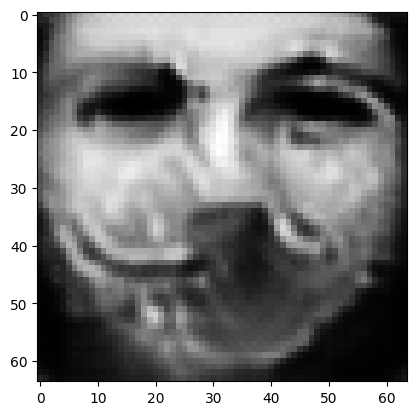

tensor([[3.0777e-04, 3.2752e-04, 1.3849e-03, 9.2991e-04, 1.0609e-04, 5.6356e-04,
         9.9275e-05, 3.8648e-03, 8.9062e-05, 9.8036e-01, 1.6016e-04, 6.2963e-04,
         3.3060e-05, 4.9739e-07, 2.0792e-06, 9.3022e-04, 3.4586e-05, 1.2074e-05,
         2.3792e-04, 5.6218e-04, 7.9813e-06, 1.6141e-04, 5.6498e-08, 6.7920e-06,
         3.0265e-06, 7.1577e-05, 2.5573e-04, 1.9974e-04, 5.2450e-03, 3.0138e-04,
         4.0026e-04, 1.7216e-04, 1.4204e-04, 2.5448e-04, 1.4863e-04, 1.6028e-05,
         8.4630e-06, 9.4433e-04, 2.7995e-04, 7.4495e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019834747537970543
tensor([[3.0728e-04, 3.2693e-04, 1.3822e-03, 9.2933e-04, 1.0597e-04, 5.6198e-04,
         9.9079e-05, 3.8587e-03, 8.8810e-05, 9.8039e-01, 1.6002e-04, 6.2863e-04,
         3.2996e-05, 4.9660e-07, 2.0755e-06, 9.2915e-04, 3.4560e-05, 1.2041e-05,
         2.3754e-04, 5.6104e-04, 7.9624e-06, 1.6139e-04, 5.6363e-08, 6.7878e-06,
         3.0188e-06, 7.1483e-05, 2.5506e-

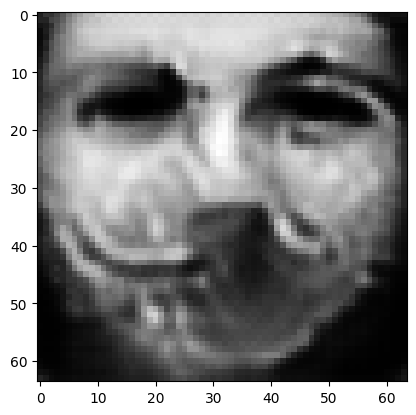

tensor([[3.0448e-04, 3.2432e-04, 1.3726e-03, 9.2464e-04, 1.0511e-04, 5.5573e-04,
         9.8047e-05, 3.8245e-03, 8.8373e-05, 9.8051e-01, 1.5935e-04, 6.2728e-04,
         3.2762e-05, 4.9252e-07, 2.0584e-06, 9.2538e-04, 3.4363e-05, 1.1907e-05,
         2.3623e-04, 5.5752e-04, 7.9041e-06, 1.6089e-04, 5.5984e-08, 6.7466e-06,
         2.9881e-06, 7.1033e-05, 2.5296e-04, 1.9781e-04, 5.2099e-03, 2.9957e-04,
         3.9919e-04, 1.7111e-04, 1.4062e-04, 2.5241e-04, 1.4731e-04, 1.5924e-05,
         8.4057e-06, 9.4077e-04, 2.7679e-04, 7.3794e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01967778243124485
tensor([[3.0404e-04, 3.2384e-04, 1.3703e-03, 9.2490e-04, 1.0500e-04, 5.5413e-04,
         9.7828e-05, 3.8171e-03, 8.8219e-05, 9.8054e-01, 1.5921e-04, 6.2652e-04,
         3.2720e-05, 4.9216e-07, 2.0559e-06, 9.2421e-04, 3.4352e-05, 1.1876e-05,
         2.3594e-04, 5.5652e-04, 7.8891e-06, 1.6091e-04, 5.5889e-08, 6.7424e-06,
         2.9828e-06, 7.0970e-05, 2.5236e-0

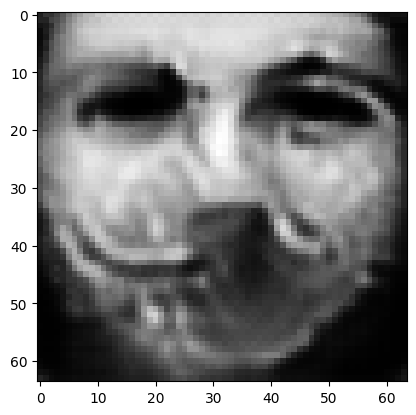

tensor([[3.0175e-04, 3.2169e-04, 1.3614e-03, 9.2152e-04, 1.0429e-04, 5.4865e-04,
         9.6909e-05, 3.7878e-03, 8.7810e-05, 9.8065e-01, 1.5861e-04, 6.2510e-04,
         3.2517e-05, 4.8892e-07, 2.0417e-06, 9.2026e-04, 3.4181e-05, 1.1757e-05,
         2.3465e-04, 5.5306e-04, 7.8380e-06, 1.6061e-04, 5.5533e-08, 6.7054e-06,
         2.9566e-06, 7.0622e-05, 2.5045e-04, 1.9622e-04, 5.1751e-03, 2.9819e-04,
         3.9917e-04, 1.7012e-04, 1.3925e-04, 2.5068e-04, 1.4623e-04, 1.5850e-05,
         8.3691e-06, 9.3811e-04, 2.7402e-04, 7.3120e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019535871222615242
tensor([[3.0099e-04, 3.2102e-04, 1.3592e-03, 9.1919e-04, 1.0407e-04, 5.4725e-04,
         9.6681e-05, 3.7798e-03, 8.7650e-05, 9.8068e-01, 1.5848e-04, 6.2503e-04,
         3.2447e-05, 4.8774e-07, 2.0371e-06, 9.2003e-04, 3.4118e-05, 1.1733e-05,
         2.3436e-04, 5.5246e-04, 7.8254e-06, 1.6041e-04, 5.5443e-08, 6.6968e-06,
         2.9486e-06, 7.0486e-05, 2.5002e-

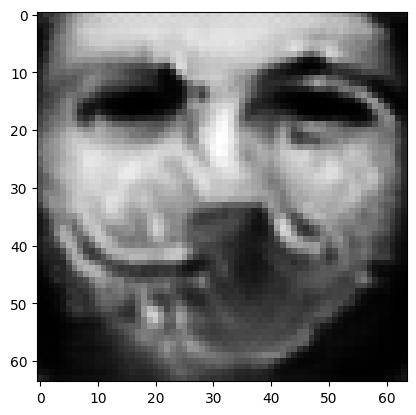

tensor([[2.9888e-04, 3.1890e-04, 1.3513e-03, 9.1684e-04, 1.0351e-04, 5.4202e-04,
         9.5764e-05, 3.7530e-03, 8.7224e-05, 9.8078e-01, 1.5792e-04, 6.2320e-04,
         3.2253e-05, 4.8490e-07, 2.0233e-06, 9.1590e-04, 3.3984e-05, 1.1620e-05,
         2.3306e-04, 5.4908e-04, 7.7761e-06, 1.6021e-04, 5.5078e-08, 6.6643e-06,
         2.9257e-06, 7.0214e-05, 2.4796e-04, 1.9467e-04, 5.1465e-03, 2.9651e-04,
         3.9812e-04, 1.6927e-04, 1.3798e-04, 2.4896e-04, 1.4521e-04, 1.5757e-05,
         8.3234e-06, 9.3513e-04, 2.7129e-04, 7.2494e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019402476027607918
tensor([[2.9817e-04, 3.1824e-04, 1.3493e-03, 9.1461e-04, 1.0332e-04, 5.4073e-04,
         9.5539e-05, 3.7458e-03, 8.7058e-05, 9.8081e-01, 1.5780e-04, 6.2303e-04,
         3.2184e-05, 4.8373e-07, 2.0187e-06, 9.1551e-04, 3.3924e-05, 1.1598e-05,
         2.3273e-04, 5.4847e-04, 7.7636e-06, 1.6003e-04, 5.4981e-08, 6.6559e-06,
         2.9181e-06, 7.0092e-05, 2.4751e-

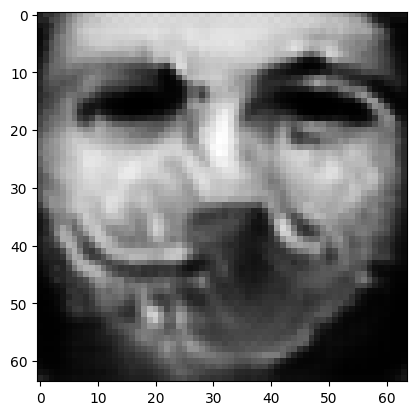

tensor([[2.9606e-04, 3.1618e-04, 1.3418e-03, 9.1134e-04, 1.0277e-04, 5.3592e-04,
         9.4693e-05, 3.7203e-03, 8.6674e-05, 9.8091e-01, 1.5726e-04, 6.2144e-04,
         3.1998e-05, 4.8075e-07, 2.0053e-06, 9.1179e-04, 3.3776e-05, 1.1497e-05,
         2.3145e-04, 5.4559e-04, 7.7176e-06, 1.5974e-04, 5.4641e-08, 6.6236e-06,
         2.8962e-06, 6.9800e-05, 2.4564e-04, 1.9315e-04, 5.1202e-03, 2.9473e-04,
         3.9660e-04, 1.6852e-04, 1.3688e-04, 2.4727e-04, 1.4424e-04, 1.5658e-05,
         8.2732e-06, 9.3200e-04, 2.6875e-04, 7.1931e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0192757286131382
tensor([[2.9566e-04, 3.1567e-04, 1.3401e-03, 9.1076e-04, 1.0271e-04, 5.3475e-04,
         9.4502e-05, 3.7157e-03, 8.6461e-05, 9.8093e-01, 1.5715e-04, 6.2067e-04,
         3.1940e-05, 4.8011e-07, 2.0021e-06, 9.1106e-04, 3.3759e-05, 1.1474e-05,
         2.3115e-04, 5.4472e-04, 7.7040e-06, 1.5975e-04, 5.4526e-08, 6.6208e-06,
         2.8907e-06, 6.9743e-05, 2.4505e-04

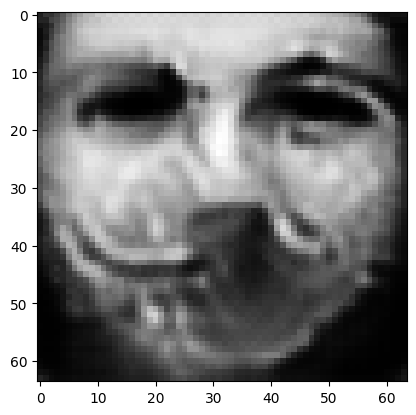

tensor([[2.9364e-04, 3.1375e-04, 1.3331e-03, 9.0719e-04, 1.0218e-04, 5.3032e-04,
         9.3724e-05, 3.6916e-03, 8.6094e-05, 9.8102e-01, 1.5665e-04, 6.1933e-04,
         3.1763e-05, 4.7720e-07, 1.9896e-06, 9.0791e-04, 3.3611e-05, 1.1384e-05,
         2.2997e-04, 5.4221e-04, 7.6603e-06, 1.5939e-04, 5.4209e-08, 6.5905e-06,
         2.8696e-06, 6.9439e-05, 2.4335e-04, 1.9190e-04, 5.0938e-03, 2.9318e-04,
         3.9566e-04, 1.6777e-04, 1.3574e-04, 2.4580e-04, 1.4332e-04, 1.5574e-05,
         8.2344e-06, 9.2903e-04, 2.6644e-04, 7.1335e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019158437848091125
tensor([[2.9306e-04, 3.1331e-04, 1.3315e-03, 9.0623e-04, 1.0201e-04, 5.2926e-04,
         9.3524e-05, 3.6846e-03, 8.6103e-05, 9.8105e-01, 1.5651e-04, 6.1930e-04,
         3.1732e-05, 4.7651e-07, 1.9867e-06, 9.0708e-04, 3.3566e-05, 1.1364e-05,
         2.2970e-04, 5.4180e-04, 7.6520e-06, 1.5924e-04, 5.4163e-08, 6.5800e-06,
         2.8652e-06, 6.9360e-05, 2.4305e-

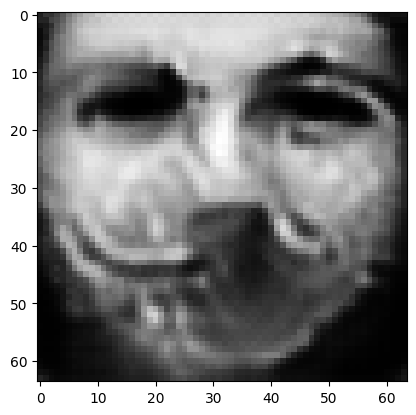

tensor([[2.9119e-04, 3.1150e-04, 1.3252e-03, 9.0333e-04, 1.0156e-04, 5.2496e-04,
         9.2793e-05, 3.6625e-03, 8.5698e-05, 9.8113e-01, 1.5605e-04, 6.1775e-04,
         3.1564e-05, 4.7396e-07, 1.9751e-06, 9.0399e-04, 3.3447e-05, 1.1282e-05,
         2.2862e-04, 5.3941e-04, 7.6091e-06, 1.5893e-04, 5.3861e-08, 6.5547e-06,
         2.8464e-06, 6.9096e-05, 2.4138e-04, 1.9066e-04, 5.0696e-03, 2.9178e-04,
         3.9469e-04, 1.6705e-04, 1.3472e-04, 2.4438e-04, 1.4256e-04, 1.5496e-05,
         8.1941e-06, 9.2677e-04, 2.6427e-04, 7.0859e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01904885098338127
tensor([[2.9083e-04, 3.1113e-04, 1.3235e-03, 9.0299e-04, 1.0147e-04, 5.2405e-04,
         9.2635e-05, 3.6585e-03, 8.5600e-05, 9.8115e-01, 1.5595e-04, 6.1724e-04,
         3.1527e-05, 4.7339e-07, 1.9726e-06, 9.0308e-04, 3.3424e-05, 1.1261e-05,
         2.2834e-04, 5.3876e-04, 7.5982e-06, 1.5890e-04, 5.3782e-08, 6.5487e-06,
         2.8420e-06, 6.9044e-05, 2.4098e-0

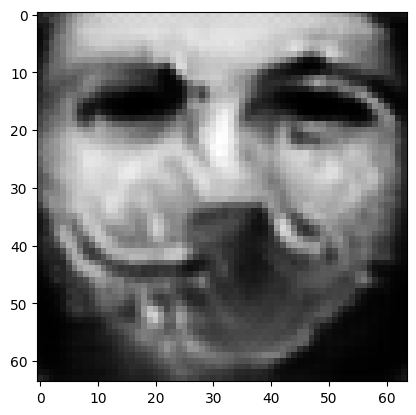

tensor([[2.8911e-04, 3.0948e-04, 1.3175e-03, 9.0025e-04, 1.0104e-04, 5.2005e-04,
         9.1963e-05, 3.6378e-03, 8.5191e-05, 9.8123e-01, 1.5550e-04, 6.1572e-04,
         3.1369e-05, 4.7100e-07, 1.9618e-06, 9.0040e-04, 3.3309e-05, 1.1187e-05,
         2.2732e-04, 5.3655e-04, 7.5574e-06, 1.5859e-04, 5.3493e-08, 6.5255e-06,
         2.8244e-06, 6.8791e-05, 2.3945e-04, 1.8961e-04, 5.0459e-03, 2.9048e-04,
         3.9398e-04, 1.6642e-04, 1.3372e-04, 2.4309e-04, 1.4177e-04, 1.5428e-05,
         8.1616e-06, 9.2438e-04, 2.6225e-04, 7.0335e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018946973606944084
tensor([[2.8859e-04, 3.0904e-04, 1.3159e-03, 8.9901e-04, 1.0090e-04, 5.1909e-04,
         9.1790e-05, 3.6324e-03, 8.5127e-05, 9.8125e-01, 1.5540e-04, 6.1550e-04,
         3.1328e-05, 4.7025e-07, 1.9589e-06, 8.9973e-04, 3.3265e-05, 1.1170e-05,
         2.2705e-04, 5.3614e-04, 7.5486e-06, 1.5845e-04, 5.3432e-08, 6.5177e-06,
         2.8198e-06, 6.8720e-05, 2.3912e-

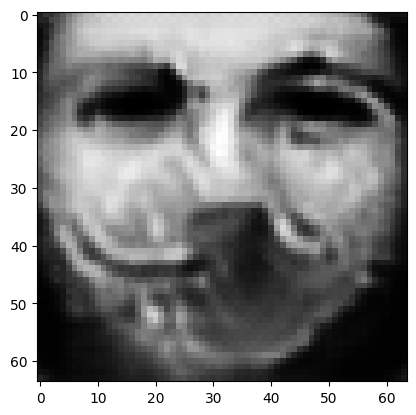

tensor([[2.8706e-04, 3.0760e-04, 1.3101e-03, 8.9705e-04, 1.0051e-04, 5.1543e-04,
         9.1180e-05, 3.6131e-03, 8.4827e-05, 9.8133e-01, 1.5499e-04, 6.1408e-04,
         3.1195e-05, 4.6824e-07, 1.9500e-06, 8.9694e-04, 3.3164e-05, 1.1100e-05,
         2.2611e-04, 5.3419e-04, 7.5120e-06, 1.5818e-04, 5.3176e-08, 6.4943e-06,
         2.8044e-06, 6.8494e-05, 2.3774e-04, 1.8853e-04, 5.0240e-03, 2.8931e-04,
         3.9318e-04, 1.6586e-04, 1.3284e-04, 2.4182e-04, 1.4111e-04, 1.5365e-05,
         8.1263e-06, 9.2234e-04, 2.6034e-04, 6.9909e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018850818276405334
tensor([[2.8666e-04, 3.0720e-04, 1.3085e-03, 8.9594e-04, 1.0043e-04, 5.1452e-04,
         9.1052e-05, 3.6090e-03, 8.4669e-05, 9.8134e-01, 1.5492e-04, 6.1365e-04,
         3.1148e-05, 4.6761e-07, 1.9475e-06, 8.9657e-04, 3.3136e-05, 1.1087e-05,
         2.2587e-04, 5.3374e-04, 7.5018e-06, 1.5809e-04, 5.3096e-08, 6.4909e-06,
         2.7996e-06, 6.8419e-05, 2.3738e-

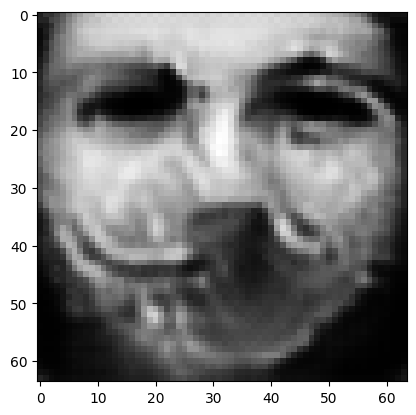

tensor([[2.8516e-04, 3.0589e-04, 1.3029e-03, 8.9372e-04, 1.0002e-04, 5.1120e-04,
         9.0491e-05, 3.5903e-03, 8.4423e-05, 9.8141e-01, 1.5454e-04, 6.1265e-04,
         3.1023e-05, 4.6563e-07, 1.9390e-06, 8.9414e-04, 3.3032e-05, 1.1021e-05,
         2.2500e-04, 5.3195e-04, 7.4696e-06, 1.5782e-04, 5.2870e-08, 6.4669e-06,
         2.7845e-06, 6.8196e-05, 2.3621e-04, 1.8752e-04, 5.0040e-03, 2.8816e-04,
         3.9230e-04, 1.6539e-04, 1.3206e-04, 2.4065e-04, 1.4044e-04, 1.5306e-05,
         8.0933e-06, 9.2027e-04, 2.5852e-04, 6.9508e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01876155659556389
tensor([[2.8478e-04, 3.0551e-04, 1.3015e-03, 8.9265e-04, 9.9935e-05, 5.1035e-04,
         9.0374e-05, 3.5865e-03, 8.4276e-05, 9.8143e-01, 1.5448e-04, 6.1226e-04,
         3.0979e-05, 4.6505e-07, 1.9366e-06, 8.9383e-04, 3.3005e-05, 1.1008e-05,
         2.2478e-04, 5.3155e-04, 7.4603e-06, 1.5773e-04, 5.2798e-08, 6.4639e-06,
         2.7801e-06, 6.8125e-05, 2.3588e-0

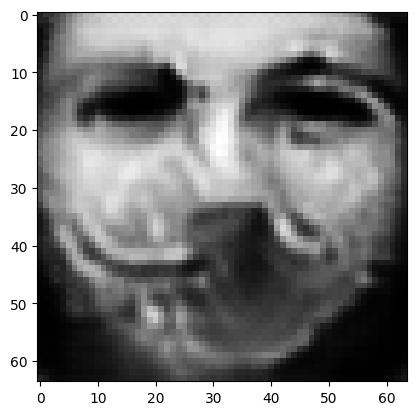

tensor([[2.8347e-04, 3.0430e-04, 1.2962e-03, 8.9064e-04, 9.9604e-05, 5.0726e-04,
         8.9856e-05, 3.5700e-03, 8.3986e-05, 9.8149e-01, 1.5413e-04, 6.1106e-04,
         3.0857e-05, 4.6324e-07, 1.9290e-06, 8.9157e-04, 3.2913e-05, 1.0950e-05,
         2.2395e-04, 5.2990e-04, 7.4294e-06, 1.5752e-04, 5.2566e-08, 6.4434e-06,
         2.7664e-06, 6.7924e-05, 2.3473e-04, 1.8663e-04, 4.9851e-03, 2.8704e-04,
         3.9148e-04, 1.6502e-04, 1.3133e-04, 2.3959e-04, 1.3981e-04, 1.5253e-05,
         8.0639e-06, 9.1830e-04, 2.5682e-04, 6.9095e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018678605556488037
tensor([[2.8302e-04, 3.0397e-04, 1.2949e-03, 8.8960e-04, 9.9468e-05, 5.0652e-04,
         8.9713e-05, 3.5648e-03, 8.3970e-05, 9.8151e-01, 1.5402e-04, 6.1109e-04,
         3.0828e-05, 4.6263e-07, 1.9266e-06, 8.9112e-04, 3.2874e-05, 1.0936e-05,
         2.2375e-04, 5.2961e-04, 7.4235e-06, 1.5739e-04, 5.2527e-08, 6.4354e-06,
         2.7628e-06, 6.7859e-05, 2.3452e-

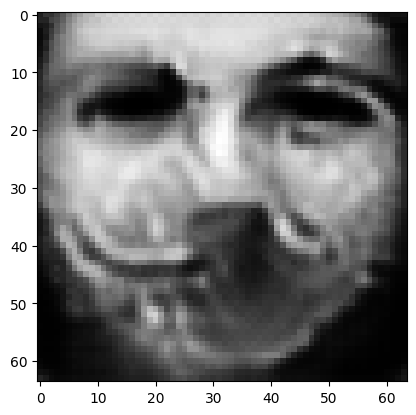

tensor([[2.8171e-04, 3.0279e-04, 1.2898e-03, 8.8697e-04, 9.9135e-05, 5.0370e-04,
         8.9245e-05, 3.5497e-03, 8.3671e-05, 9.8157e-01, 1.5371e-04, 6.1002e-04,
         3.0704e-05, 4.6070e-07, 1.9188e-06, 8.8920e-04, 3.2774e-05, 1.0883e-05,
         2.2293e-04, 5.2815e-04, 7.3940e-06, 1.5713e-04, 5.2303e-08, 6.4157e-06,
         2.7490e-06, 6.7648e-05, 2.3347e-04, 1.8566e-04, 4.9686e-03, 2.8592e-04,
         3.9029e-04, 1.6467e-04, 1.3071e-04, 2.3852e-04, 1.3927e-04, 1.5194e-05,
         8.0284e-06, 9.1637e-04, 2.5519e-04, 6.8798e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01860067807137966
tensor([[2.8145e-04, 3.0249e-04, 1.2886e-03, 8.8668e-04, 9.9075e-05, 5.0292e-04,
         8.9126e-05, 3.5461e-03, 8.3533e-05, 9.8159e-01, 1.5363e-04, 6.0955e-04,
         3.0667e-05, 4.6030e-07, 1.9169e-06, 8.8876e-04, 3.2761e-05, 1.0869e-05,
         2.2274e-04, 5.2760e-04, 7.3853e-06, 1.5713e-04, 5.2229e-08, 6.4132e-06,
         2.7454e-06, 6.7606e-05, 2.3313e-0

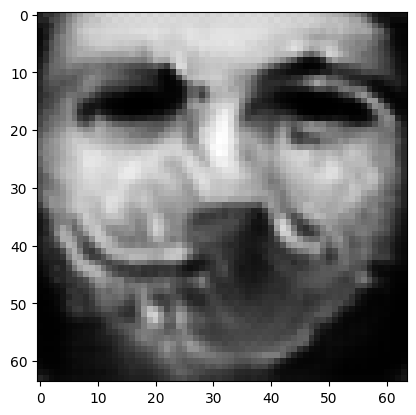

tensor([[2.8030e-04, 3.0144e-04, 1.2839e-03, 8.8484e-04, 9.8770e-05, 5.0026e-04,
         8.8699e-05, 3.5318e-03, 8.3307e-05, 9.8164e-01, 1.5332e-04, 6.0855e-04,
         3.0564e-05, 4.5874e-07, 1.9103e-06, 8.8671e-04, 3.2676e-05, 1.0821e-05,
         2.2200e-04, 5.2630e-04, 7.3579e-06, 1.5689e-04, 5.2037e-08, 6.3945e-06,
         2.7338e-06, 6.7418e-05, 2.3218e-04, 1.8491e-04, 4.9506e-03, 2.8499e-04,
         3.8982e-04, 1.6429e-04, 1.3002e-04, 2.3761e-04, 1.3872e-04, 1.5153e-05,
         8.0059e-06, 9.1472e-04, 2.5373e-04, 6.8424e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01852707378566265
tensor([[2.8001e-04, 3.0121e-04, 1.2828e-03, 8.8436e-04, 9.8690e-05, 4.9964e-04,
         8.8602e-05, 3.5281e-03, 8.3290e-05, 9.8166e-01, 1.5324e-04, 6.0840e-04,
         3.0546e-05, 4.5837e-07, 1.9089e-06, 8.8618e-04, 3.2651e-05, 1.0810e-05,
         2.2182e-04, 5.2610e-04, 7.3520e-06, 1.5680e-04, 5.2003e-08, 6.3891e-06,
         2.7313e-06, 6.7368e-05, 2.3200e-0

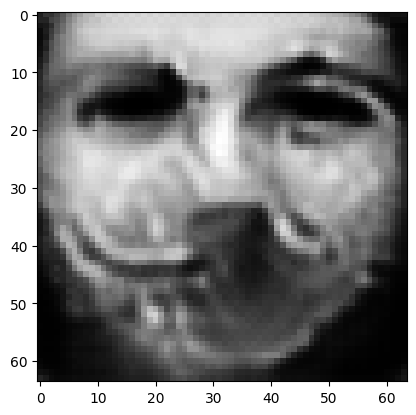

tensor([[2.7894e-04, 3.0015e-04, 1.2783e-03, 8.8221e-04, 9.8416e-05, 4.9716e-04,
         8.8207e-05, 3.5152e-03, 8.2991e-05, 9.8171e-01, 1.5296e-04, 6.0727e-04,
         3.0436e-05, 4.5674e-07, 1.9022e-06, 8.8451e-04, 3.2568e-05, 1.0766e-05,
         2.2111e-04, 5.2485e-04, 7.3248e-06, 1.5658e-04, 5.1800e-08, 6.3737e-06,
         2.7199e-06, 6.7184e-05, 2.3108e-04, 1.8416e-04, 4.9348e-03, 2.8404e-04,
         3.8903e-04, 1.6401e-04, 1.2946e-04, 2.3673e-04, 1.3822e-04, 1.5109e-05,
         7.9793e-06, 9.1314e-04, 2.5238e-04, 6.8114e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018459316343069077
tensor([[2.7873e-04, 2.9995e-04, 1.2772e-03, 8.8218e-04, 9.8348e-05, 4.9659e-04,
         8.8106e-05, 3.5120e-03, 8.2961e-05, 9.8172e-01, 1.5288e-04, 6.0701e-04,
         3.0417e-05, 4.5645e-07, 1.9008e-06, 8.8388e-04, 3.2553e-05, 1.0753e-05,
         2.2094e-04, 5.2447e-04, 7.3188e-06, 1.5656e-04, 5.1756e-08, 6.3687e-06,
         2.7176e-06, 6.7155e-05, 2.3086e-

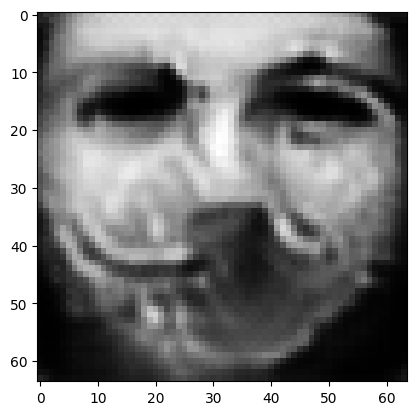

tensor([[2.7775e-04, 2.9897e-04, 1.2731e-03, 8.8043e-04, 9.8074e-05, 4.9429e-04,
         8.7722e-05, 3.4998e-03, 8.2692e-05, 9.8177e-01, 1.5263e-04, 6.0601e-04,
         3.0315e-05, 4.5493e-07, 1.8944e-06, 8.8226e-04, 3.2479e-05, 1.0708e-05,
         2.2030e-04, 5.2314e-04, 7.2940e-06, 1.5638e-04, 5.1564e-08, 6.3534e-06,
         2.7067e-06, 6.6991e-05, 2.2999e-04, 1.8347e-04, 4.9196e-03, 2.8325e-04,
         3.8863e-04, 1.6366e-04, 1.2885e-04, 2.3590e-04, 1.3777e-04, 1.5072e-05,
         7.9599e-06, 9.1169e-04, 2.5106e-04, 6.7807e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018395885825157166
tensor([[2.7742e-04, 2.9870e-04, 1.2720e-03, 8.7934e-04, 9.7976e-05, 4.9378e-04,
         8.7626e-05, 3.4967e-03, 8.2648e-05, 9.8178e-01, 1.5257e-04, 6.0596e-04,
         3.0287e-05, 4.5436e-07, 1.8925e-06, 8.8195e-04, 3.2444e-05, 1.0699e-05,
         2.2012e-04, 5.2295e-04, 7.2888e-06, 1.5626e-04, 5.1524e-08, 6.3480e-06,
         2.7035e-06, 6.6934e-05, 2.2983e-

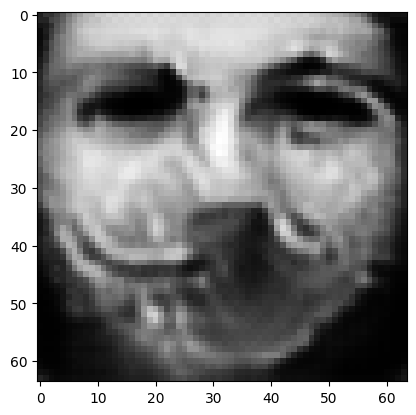

tensor([[2.7659e-04, 2.9781e-04, 1.2682e-03, 8.7827e-04, 9.7756e-05, 4.9159e-04,
         8.7279e-05, 3.4856e-03, 8.2377e-05, 9.8183e-01, 1.5233e-04, 6.0478e-04,
         3.0195e-05, 4.5313e-07, 1.8869e-06, 8.8024e-04, 3.2389e-05, 1.0658e-05,
         2.1951e-04, 5.2166e-04, 7.2644e-06, 1.5615e-04, 5.1335e-08, 6.3355e-06,
         2.6938e-06, 6.6792e-05, 2.2897e-04, 1.8281e-04, 4.9059e-03, 2.8240e-04,
         3.8801e-04, 1.6340e-04, 1.2833e-04, 2.3511e-04, 1.3731e-04, 1.5033e-05,
         7.9387e-06, 9.1023e-04, 2.4983e-04, 6.7510e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018336428329348564
tensor([[2.7629e-04, 2.9757e-04, 1.2672e-03, 8.7748e-04, 9.7661e-05, 4.9110e-04,
         8.7183e-05, 3.4821e-03, 8.2370e-05, 9.8184e-01, 1.5226e-04, 6.0477e-04,
         3.0176e-05, 4.5267e-07, 1.8852e-06, 8.7986e-04, 3.2357e-05, 1.0649e-05,
         2.1935e-04, 5.2150e-04, 7.2599e-06, 1.5603e-04, 5.1308e-08, 6.3295e-06,
         2.6914e-06, 6.6743e-05, 2.2884e-

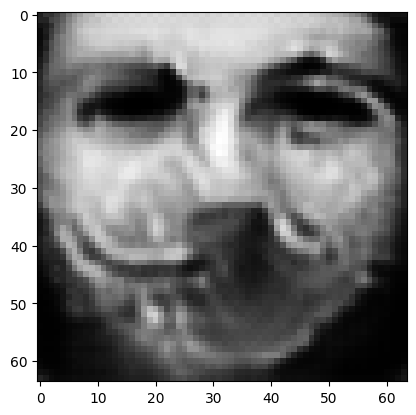

tensor([[2.7548e-04, 2.9672e-04, 1.2636e-03, 8.7622e-04, 9.7446e-05, 4.8903e-04,
         8.6863e-05, 3.4715e-03, 8.2115e-05, 9.8189e-01, 1.5203e-04, 6.0370e-04,
         3.0088e-05, 4.5145e-07, 1.8800e-06, 8.7838e-04, 3.2300e-05, 1.0611e-05,
         2.1879e-04, 5.2037e-04, 7.2369e-06, 1.5589e-04, 5.1134e-08, 6.3177e-06,
         2.6821e-06, 6.6597e-05, 2.2804e-04, 1.8218e-04, 4.8930e-03, 2.8160e-04,
         3.8737e-04, 1.6314e-04, 1.2783e-04, 2.3437e-04, 1.3690e-04, 1.4996e-05,
         7.9173e-06, 9.0890e-04, 2.4869e-04, 6.7250e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018279660493135452
tensor([[2.7527e-04, 2.9655e-04, 1.2627e-03, 8.7597e-04, 9.7387e-05, 4.8856e-04,
         8.6787e-05, 3.4686e-03, 8.2099e-05, 9.8190e-01, 1.5197e-04, 6.0354e-04,
         3.0073e-05, 4.5119e-07, 1.8790e-06, 8.7794e-04, 3.2282e-05, 1.0602e-05,
         2.1865e-04, 5.2017e-04, 7.2322e-06, 1.5583e-04, 5.1104e-08, 6.3135e-06,
         2.6803e-06, 6.6560e-05, 2.2789e-

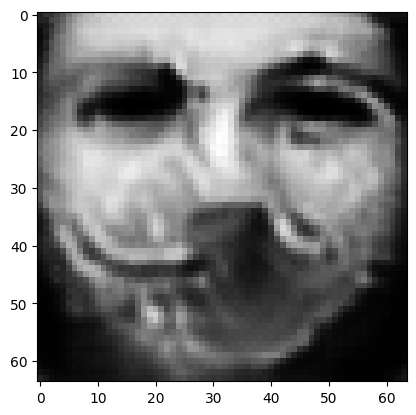

tensor([[2.7444e-04, 2.9574e-04, 1.2593e-03, 8.7429e-04, 9.7151e-05, 4.8669e-04,
         8.6464e-05, 3.4584e-03, 8.1882e-05, 9.8194e-01, 1.5175e-04, 6.0278e-04,
         2.9986e-05, 4.4982e-07, 1.8735e-06, 8.7659e-04, 3.2212e-05, 1.0568e-05,
         2.1809e-04, 5.1911e-04, 7.2117e-06, 1.5563e-04, 5.0941e-08, 6.2994e-06,
         2.6709e-06, 6.6415e-05, 2.2719e-04, 1.8158e-04, 4.8803e-03, 2.8082e-04,
         3.8671e-04, 1.6290e-04, 1.2736e-04, 2.3363e-04, 1.3654e-04, 1.4960e-05,
         7.8965e-06, 9.0768e-04, 2.4756e-04, 6.7022e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018226519227027893
tensor([[2.7429e-04, 2.9553e-04, 1.2585e-03, 8.7414e-04, 9.7116e-05, 4.8620e-04,
         8.6382e-05, 3.4561e-03, 8.1782e-05, 9.8195e-01, 1.5170e-04, 6.0245e-04,
         2.9960e-05, 4.4956e-07, 1.8721e-06, 8.7632e-04, 3.2206e-05, 1.0558e-05,
         2.1797e-04, 5.1872e-04, 7.2061e-06, 1.5564e-04, 5.0888e-08, 6.2977e-06,
         2.6687e-06, 6.6391e-05, 2.2697e-

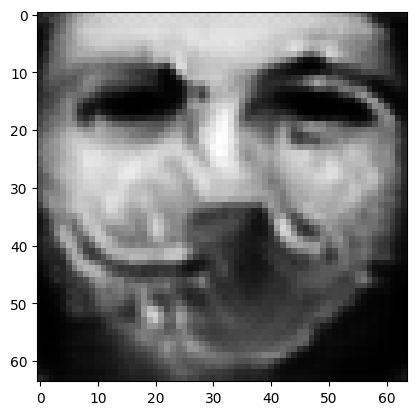

tensor([[2.7349e-04, 2.9480e-04, 1.2553e-03, 8.7257e-04, 9.6887e-05, 4.8448e-04,
         8.6083e-05, 3.4463e-03, 8.1622e-05, 9.8199e-01, 1.5147e-04, 6.0183e-04,
         2.9883e-05, 4.4828e-07, 1.8672e-06, 8.7499e-04, 3.2136e-05, 1.0525e-05,
         2.1744e-04, 5.1779e-04, 7.1878e-06, 1.5545e-04, 5.0745e-08, 6.2830e-06,
         2.6602e-06, 6.6251e-05, 2.2635e-04, 1.8104e-04, 4.8688e-03, 2.8009e-04,
         3.8617e-04, 1.6267e-04, 1.2688e-04, 2.3297e-04, 1.3619e-04, 1.4927e-05,
         7.8791e-06, 9.0644e-04, 2.4649e-04, 6.6785e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018176652491092682
tensor([[2.7330e-04, 2.9458e-04, 1.2544e-03, 8.7193e-04, 9.6840e-05, 4.8400e-04,
         8.6016e-05, 3.4443e-03, 8.1512e-05, 9.8200e-01, 1.5144e-04, 6.0153e-04,
         2.9853e-05, 4.4791e-07, 1.8657e-06, 8.7485e-04, 3.2120e-05, 1.0519e-05,
         2.1732e-04, 5.1752e-04, 7.1821e-06, 1.5540e-04, 5.0695e-08, 6.2814e-06,
         2.6576e-06, 6.6211e-05, 2.2615e-

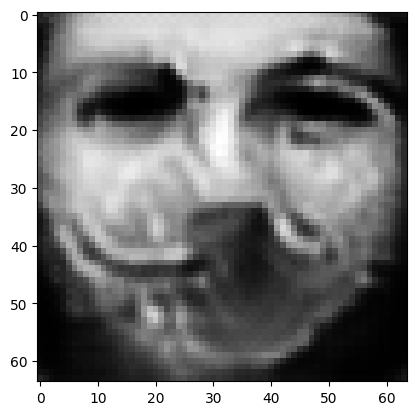

tensor([[2.7256e-04, 2.9390e-04, 1.2511e-03, 8.7049e-04, 9.6615e-05, 4.8230e-04,
         8.5742e-05, 3.4349e-03, 8.1353e-05, 9.8203e-01, 1.5123e-04, 6.0093e-04,
         2.9780e-05, 4.4671e-07, 1.8612e-06, 8.7359e-04, 3.2054e-05, 1.0487e-05,
         2.1683e-04, 5.1659e-04, 7.1647e-06, 1.5523e-04, 5.0561e-08, 6.2678e-06,
         2.6497e-06, 6.6075e-05, 2.2559e-04, 1.8048e-04, 4.8582e-03, 2.7932e-04,
         3.8547e-04, 1.6252e-04, 1.2648e-04, 2.3233e-04, 1.3580e-04, 1.4895e-05,
         7.8586e-06, 9.0529e-04, 2.4545e-04, 6.6564e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018128888681530952
tensor([[2.7242e-04, 2.9370e-04, 1.2503e-03, 8.7033e-04, 9.6582e-05, 4.8183e-04,
         8.5666e-05, 3.4328e-03, 8.1246e-05, 9.8204e-01, 1.5118e-04, 6.0061e-04,
         2.9754e-05, 4.4645e-07, 1.8599e-06, 8.7338e-04, 3.2048e-05, 1.0477e-05,
         2.1672e-04, 5.1619e-04, 7.1593e-06, 1.5526e-04, 5.0509e-08, 6.2666e-06,
         2.6475e-06, 6.6051e-05, 2.2537e-

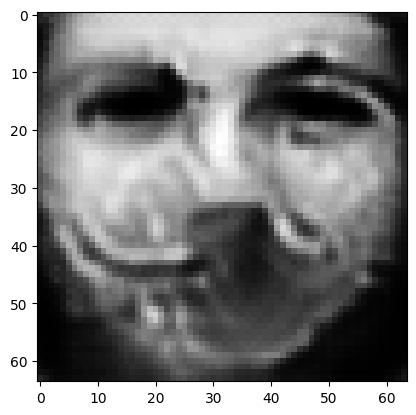

tensor([[2.7170e-04, 2.9305e-04, 1.2471e-03, 8.6889e-04, 9.6366e-05, 4.8019e-04,
         8.5400e-05, 3.4239e-03, 8.1086e-05, 9.8208e-01, 1.5098e-04, 6.0005e-04,
         2.9683e-05, 4.4528e-07, 1.8554e-06, 8.7218e-04, 3.1983e-05, 1.0446e-05,
         2.1625e-04, 5.1529e-04, 7.1428e-06, 1.5510e-04, 5.0380e-08, 6.2536e-06,
         2.6399e-06, 6.5923e-05, 2.2482e-04, 1.7997e-04, 4.8478e-03, 2.7865e-04,
         3.8502e-04, 1.6236e-04, 1.2606e-04, 2.3175e-04, 1.3544e-04, 1.4868e-05,
         7.8428e-06, 9.0421e-04, 2.4445e-04, 6.6331e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018082881346344948
tensor([[2.7151e-04, 2.9287e-04, 1.2463e-03, 8.6847e-04, 9.6313e-05, 4.7977e-04,
         8.5333e-05, 3.4216e-03, 8.1041e-05, 9.8209e-01, 1.5094e-04, 5.9989e-04,
         2.9664e-05, 4.4498e-07, 1.8543e-06, 8.7192e-04, 3.1967e-05, 1.0439e-05,
         2.1614e-04, 5.1508e-04, 7.1387e-06, 1.5506e-04, 5.0349e-08, 6.2508e-06,
         2.6380e-06, 6.5891e-05, 2.2468e-

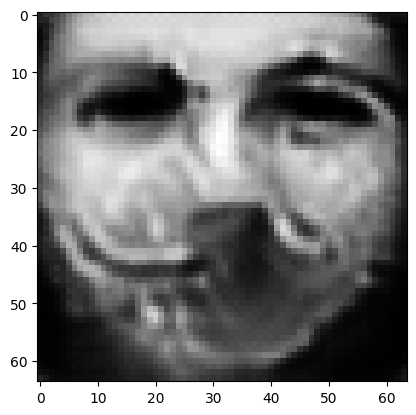

tensor([[2.7083e-04, 2.9224e-04, 1.2433e-03, 8.6711e-04, 9.6116e-05, 4.7821e-04,
         8.5087e-05, 3.4130e-03, 8.0857e-05, 9.8212e-01, 1.5077e-04, 5.9930e-04,
         2.9594e-05, 4.4389e-07, 1.8501e-06, 8.7095e-04, 3.1912e-05, 1.0410e-05,
         2.1572e-04, 5.1421e-04, 7.1227e-06, 1.5492e-04, 5.0221e-08, 6.2401e-06,
         2.6306e-06, 6.5768e-05, 2.2413e-04, 1.7946e-04, 4.8387e-03, 2.7802e-04,
         3.8446e-04, 1.6220e-04, 1.2570e-04, 2.3118e-04, 1.3511e-04, 1.4840e-05,
         7.8250e-06, 9.0320e-04, 2.4353e-04, 6.6139e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018040265887975693
tensor([[2.7069e-04, 2.9209e-04, 1.2426e-03, 8.6684e-04, 9.6084e-05, 4.7785e-04,
         8.5027e-05, 3.4115e-03, 8.0790e-05, 9.8213e-01, 1.5073e-04, 5.9905e-04,
         2.9575e-05, 4.4363e-07, 1.8490e-06, 8.7065e-04, 3.1900e-05, 1.0403e-05,
         2.1560e-04, 5.1395e-04, 7.1184e-06, 1.5491e-04, 5.0182e-08, 6.2380e-06,
         2.6288e-06, 6.5745e-05, 2.2397e-

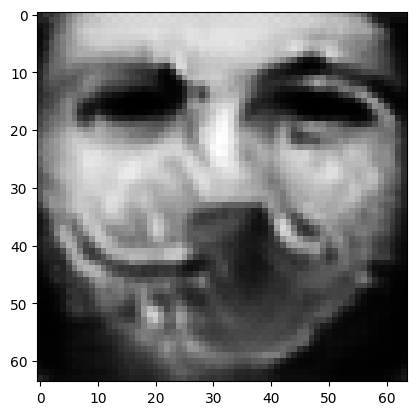

tensor([[2.7006e-04, 2.9147e-04, 1.2398e-03, 8.6565e-04, 9.5904e-05, 4.7634e-04,
         8.4788e-05, 3.4035e-03, 8.0612e-05, 9.8216e-01, 1.5056e-04, 5.9846e-04,
         2.9508e-05, 4.4262e-07, 1.8449e-06, 8.6964e-04, 3.1851e-05, 1.0376e-05,
         2.1519e-04, 5.1310e-04, 7.1032e-06, 1.5480e-04, 5.0061e-08, 6.2282e-06,
         2.6220e-06, 6.5636e-05, 2.2344e-04, 1.7901e-04, 4.8296e-03, 2.7743e-04,
         3.8406e-04, 1.6206e-04, 1.2534e-04, 2.3066e-04, 1.3478e-04, 1.4816e-05,
         7.8110e-06, 9.0227e-04, 2.4267e-04, 6.5928e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01799987256526947
tensor([[2.6989e-04, 2.9133e-04, 1.2391e-03, 8.6538e-04, 9.5853e-05, 4.7598e-04,
         8.4730e-05, 3.4014e-03, 8.0591e-05, 9.8217e-01, 1.5052e-04, 5.9837e-04,
         2.9495e-05, 4.4239e-07, 1.8440e-06, 8.6935e-04, 3.1837e-05, 1.0369e-05,
         2.1509e-04, 5.1294e-04, 7.0998e-06, 1.5476e-04, 5.0039e-08, 6.2252e-06,
         2.6206e-06, 6.5608e-05, 2.2333e-0

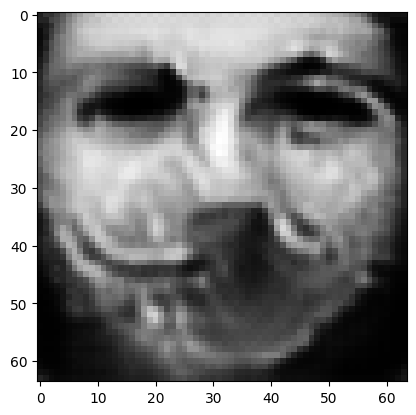

tensor([[2.6928e-04, 2.9076e-04, 1.2365e-03, 8.6420e-04, 9.5683e-05, 4.7459e-04,
         8.4506e-05, 3.3941e-03, 8.0441e-05, 9.8220e-01, 1.5036e-04, 5.9781e-04,
         2.9435e-05, 4.4142e-07, 1.8402e-06, 8.6831e-04, 3.1786e-05, 1.0344e-05,
         2.1469e-04, 5.1221e-04, 7.0854e-06, 1.5463e-04, 4.9928e-08, 6.2152e-06,
         2.6143e-06, 6.5504e-05, 2.2284e-04, 1.7857e-04, 4.8205e-03, 2.7688e-04,
         3.8362e-04, 1.6191e-04, 1.2502e-04, 2.3014e-04, 1.3451e-04, 1.4793e-05,
         7.7955e-06, 9.0148e-04, 2.4185e-04, 6.5764e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01796111650764942
tensor([[2.6914e-04, 2.9064e-04, 1.2358e-03, 8.6396e-04, 9.5640e-05, 4.7426e-04,
         8.4454e-05, 3.3922e-03, 8.0415e-05, 9.8221e-01, 1.5032e-04, 5.9770e-04,
         2.9423e-05, 4.4120e-07, 1.8394e-06, 8.6806e-04, 3.1773e-05, 1.0338e-05,
         2.1460e-04, 5.1204e-04, 7.0822e-06, 1.5459e-04, 4.9904e-08, 6.2126e-06,
         2.6129e-06, 6.5479e-05, 2.2273e-0

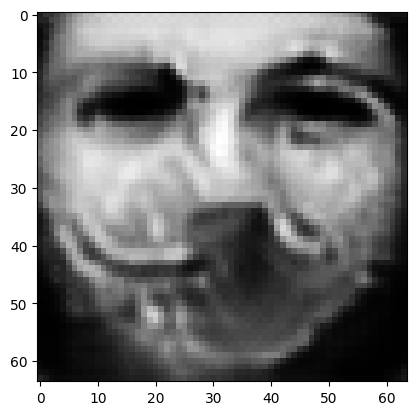

tensor([[2.6857e-04, 2.9009e-04, 1.2333e-03, 8.6297e-04, 9.5484e-05, 4.7293e-04,
         8.4238e-05, 3.3852e-03, 8.0249e-05, 9.8223e-01, 1.5017e-04, 5.9712e-04,
         2.9363e-05, 4.4031e-07, 1.8357e-06, 8.6713e-04, 3.1731e-05, 1.0313e-05,
         2.1423e-04, 5.1125e-04, 7.0682e-06, 1.5450e-04, 4.9793e-08, 6.2041e-06,
         2.6069e-06, 6.5386e-05, 2.2224e-04, 1.7816e-04, 4.8122e-03, 2.7638e-04,
         3.8328e-04, 1.6176e-04, 1.2470e-04, 2.2967e-04, 1.3423e-04, 1.4772e-05,
         7.7827e-06, 9.0068e-04, 2.4109e-04, 6.5588e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01792505383491516
tensor([[2.6842e-04, 2.8996e-04, 1.2327e-03, 8.6255e-04, 9.5442e-05, 4.7261e-04,
         8.4190e-05, 3.3836e-03, 8.0211e-05, 9.8224e-01, 1.5014e-04, 5.9701e-04,
         2.9348e-05, 4.4005e-07, 1.8348e-06, 8.6692e-04, 3.1716e-05, 1.0308e-05,
         2.1413e-04, 5.1111e-04, 7.0648e-06, 1.5446e-04, 4.9769e-08, 6.2017e-06,
         2.6053e-06, 6.5358e-05, 2.2214e-0

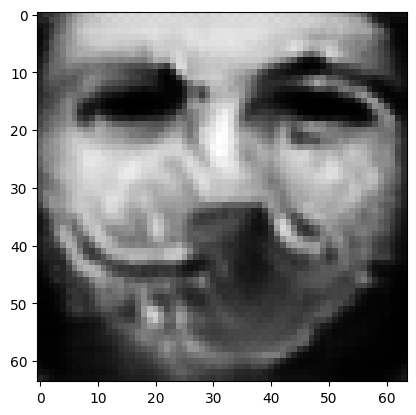

tensor([[2.6790e-04, 2.8946e-04, 1.2304e-03, 8.6177e-04, 9.5299e-05, 4.7135e-04,
         8.3989e-05, 3.3768e-03, 8.0064e-05, 9.8227e-01, 1.4999e-04, 5.9647e-04,
         2.9295e-05, 4.3926e-07, 1.8315e-06, 8.6605e-04, 3.1678e-05, 1.0284e-05,
         2.1379e-04, 5.1039e-04, 7.0518e-06, 1.5437e-04, 4.9667e-08, 6.1938e-06,
         2.5998e-06, 6.5271e-05, 2.2168e-04, 1.7778e-04, 4.8043e-03, 2.7590e-04,
         3.8293e-04, 1.6163e-04, 1.2440e-04, 2.2923e-04, 1.3397e-04, 1.4752e-05,
         7.7703e-06, 8.9992e-04, 2.4038e-04, 6.5422e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017890628427267075
tensor([[2.6775e-04, 2.8933e-04, 1.2297e-03, 8.6137e-04, 9.5257e-05, 4.7104e-04,
         8.3942e-05, 3.3753e-03, 8.0030e-05, 9.8228e-01, 1.4996e-04, 5.9636e-04,
         2.9281e-05, 4.3901e-07, 1.8306e-06, 8.6584e-04, 3.1664e-05, 1.0279e-05,
         2.1370e-04, 5.1025e-04, 7.0486e-06, 1.5433e-04, 4.9644e-08, 6.1914e-06,
         2.5983e-06, 6.5244e-05, 2.2158e-

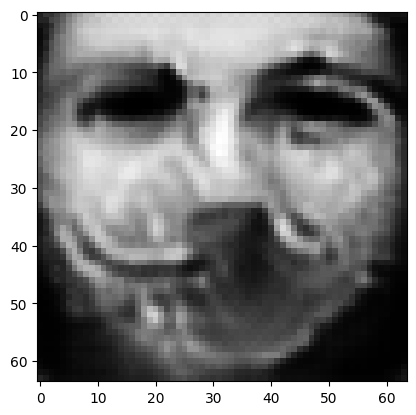

tensor([[2.6720e-04, 2.8881e-04, 1.2273e-03, 8.6019e-04, 9.5087e-05, 4.6978e-04,
         8.3744e-05, 3.3686e-03, 7.9857e-05, 9.8230e-01, 1.4985e-04, 5.9593e-04,
         2.9217e-05, 4.3805e-07, 1.8272e-06, 8.6518e-04, 3.1621e-05, 1.0255e-05,
         2.1337e-04, 5.0953e-04, 7.0356e-06, 1.5424e-04, 4.9535e-08, 6.1839e-06,
         2.5916e-06, 6.5135e-05, 2.2114e-04, 1.7738e-04, 4.7967e-03, 2.7535e-04,
         3.8241e-04, 1.6152e-04, 1.2412e-04, 2.2878e-04, 1.3367e-04, 1.4728e-05,
         7.7557e-06, 8.9907e-04, 2.3961e-04, 6.5267e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017856435850262642
tensor([[2.6706e-04, 2.8868e-04, 1.2267e-03, 8.6002e-04, 9.5042e-05, 4.6947e-04,
         8.3688e-05, 3.3668e-03, 7.9834e-05, 9.8231e-01, 1.4982e-04, 5.9586e-04,
         2.9204e-05, 4.3785e-07, 1.8263e-06, 8.6496e-04, 3.1612e-05, 1.0248e-05,
         2.1330e-04, 5.0934e-04, 7.0327e-06, 1.5422e-04, 4.9513e-08, 6.1816e-06,
         2.5902e-06, 6.5114e-05, 2.2103e-

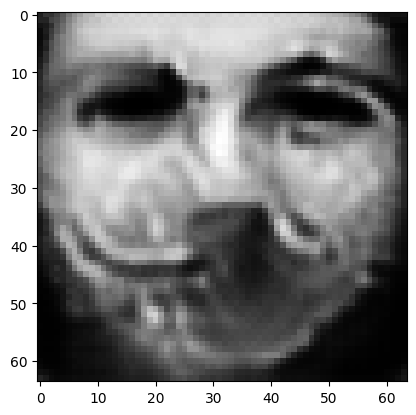

tensor([[2.6652e-04, 2.8818e-04, 1.2244e-03, 8.5895e-04, 9.4880e-05, 4.6826e-04,
         8.3494e-05, 3.3604e-03, 7.9674e-05, 9.8233e-01, 1.4972e-04, 5.9544e-04,
         2.9144e-05, 4.3695e-07, 1.8231e-06, 8.6430e-04, 3.1572e-05, 1.0224e-05,
         2.1298e-04, 5.0863e-04, 7.0202e-06, 1.5413e-04, 4.9410e-08, 6.1743e-06,
         2.5838e-06, 6.5014e-05, 2.2060e-04, 1.7700e-04, 4.7894e-03, 2.7487e-04,
         3.8204e-04, 1.6138e-04, 1.2382e-04, 2.2836e-04, 1.3340e-04, 1.4706e-05,
         7.7437e-06, 8.9832e-04, 2.3887e-04, 6.5117e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017823413014411926
tensor([[2.6640e-04, 2.8807e-04, 1.2237e-03, 8.5857e-04, 9.4844e-05, 4.6799e-04,
         8.3453e-05, 3.3592e-03, 7.9627e-05, 9.8234e-01, 1.4970e-04, 5.9533e-04,
         2.9128e-05, 4.3669e-07, 1.8222e-06, 8.6417e-04, 3.1561e-05, 1.0219e-05,
         2.1290e-04, 5.0846e-04, 7.0171e-06, 1.5411e-04, 4.9381e-08, 6.1726e-06,
         2.5821e-06, 6.4987e-05, 2.2050e-

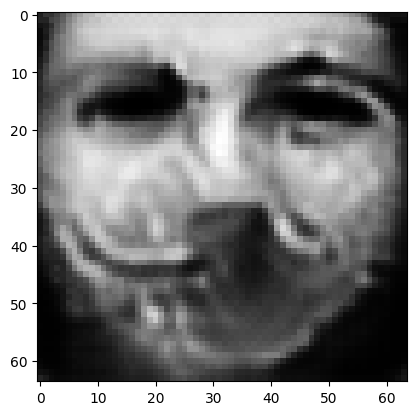

tensor([[2.6594e-04, 2.8762e-04, 1.2216e-03, 8.5770e-04, 9.4706e-05, 4.6691e-04,
         8.3275e-05, 3.3535e-03, 7.9490e-05, 9.8236e-01, 1.4959e-04, 5.9490e-04,
         2.9075e-05, 4.3588e-07, 1.8193e-06, 8.6345e-04, 3.1525e-05, 1.0197e-05,
         2.1259e-04, 5.0783e-04, 7.0054e-06, 1.5404e-04, 4.9284e-08, 6.1655e-06,
         2.5766e-06, 6.4898e-05, 2.2010e-04, 1.7666e-04, 4.7819e-03, 2.7440e-04,
         3.8165e-04, 1.6127e-04, 1.2354e-04, 2.2796e-04, 1.3314e-04, 1.4686e-05,
         7.7318e-06, 8.9751e-04, 2.3818e-04, 6.4970e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017792614176869392
tensor([[2.6581e-04, 2.8751e-04, 1.2210e-03, 8.5752e-04, 9.4665e-05, 4.6664e-04,
         8.3228e-05, 3.3520e-03, 7.9466e-05, 9.8237e-01, 1.4957e-04, 5.9483e-04,
         2.9062e-05, 4.3568e-07, 1.8186e-06, 8.6326e-04, 3.1516e-05, 1.0192e-05,
         2.1252e-04, 5.0767e-04, 7.0027e-06, 1.5402e-04, 4.9264e-08, 6.1635e-06,
         2.5753e-06, 6.4878e-05, 2.2001e-

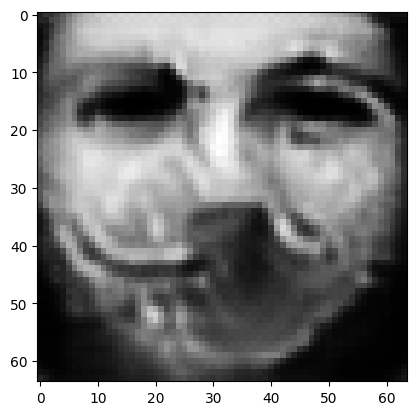

tensor([[2.6535e-04, 2.8707e-04, 1.2190e-03, 8.5645e-04, 9.4525e-05, 4.6559e-04,
         8.3061e-05, 3.3465e-03, 7.9319e-05, 9.8239e-01, 1.4947e-04, 5.9445e-04,
         2.9009e-05, 4.3488e-07, 1.8156e-06, 8.6268e-04, 3.1480e-05, 1.0172e-05,
         2.1224e-04, 5.0708e-04, 6.9916e-06, 1.5392e-04, 4.9172e-08, 6.1570e-06,
         2.5698e-06, 6.4786e-05, 2.1965e-04, 1.7633e-04, 4.7753e-03, 2.7394e-04,
         3.8126e-04, 1.6116e-04, 1.2329e-04, 2.2759e-04, 1.3289e-04, 1.4666e-05,
         7.7202e-06, 8.9684e-04, 2.3752e-04, 6.4838e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017763571813702583
tensor([[2.6525e-04, 2.8698e-04, 1.2185e-03, 8.5625e-04, 9.4494e-05, 4.6535e-04,
         8.3023e-05, 3.3452e-03, 7.9289e-05, 9.8240e-01, 1.4945e-04, 5.9435e-04,
         2.8998e-05, 4.3471e-07, 1.8150e-06, 8.6252e-04, 3.1471e-05, 1.0167e-05,
         2.1217e-04, 5.0695e-04, 6.9889e-06, 1.5390e-04, 4.9151e-08, 6.1554e-06,
         2.5685e-06, 6.4764e-05, 2.1956e-

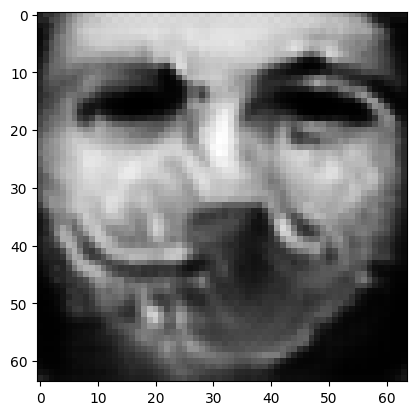

tensor([[2.6481e-04, 2.8657e-04, 1.2166e-03, 8.5537e-04, 9.4360e-05, 4.6435e-04,
         8.2860e-05, 3.3398e-03, 7.9162e-05, 9.8242e-01, 1.4935e-04, 5.9401e-04,
         2.8950e-05, 4.3399e-07, 1.8122e-06, 8.6193e-04, 3.1439e-05, 1.0147e-05,
         2.1191e-04, 5.0637e-04, 6.9786e-06, 1.5383e-04, 4.9067e-08, 6.1492e-06,
         2.5635e-06, 6.4681e-05, 2.1922e-04, 1.7602e-04, 4.7690e-03, 2.7353e-04,
         3.8095e-04, 1.6106e-04, 1.2305e-04, 2.2725e-04, 1.3267e-04, 1.4648e-05,
         7.7100e-06, 8.9620e-04, 2.3692e-04, 6.4712e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017736166715621948
tensor([[2.6472e-04, 2.8648e-04, 1.2161e-03, 8.5516e-04, 9.4330e-05, 4.6413e-04,
         8.2826e-05, 3.3386e-03, 7.9136e-05, 9.8243e-01, 1.4933e-04, 5.9393e-04,
         2.8940e-05, 4.3382e-07, 1.8116e-06, 8.6177e-04, 3.1431e-05, 1.0143e-05,
         2.1184e-04, 5.0625e-04, 6.9762e-06, 1.5381e-04, 4.9047e-08, 6.1476e-06,
         2.5623e-06, 6.4660e-05, 2.1914e-

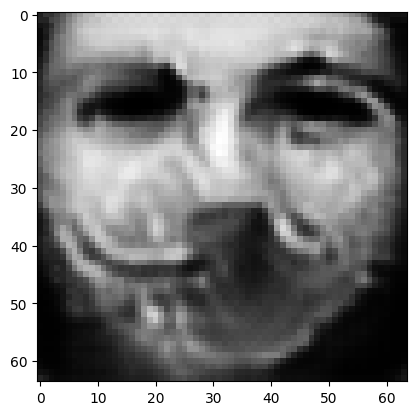

tensor([[2.6431e-04, 2.8610e-04, 1.2143e-03, 8.5433e-04, 9.4208e-05, 4.6319e-04,
         8.2676e-05, 3.3336e-03, 7.9010e-05, 9.8245e-01, 1.4924e-04, 5.9358e-04,
         2.8895e-05, 4.3314e-07, 1.8090e-06, 8.6120e-04, 3.1401e-05, 1.0124e-05,
         2.1159e-04, 5.0571e-04, 6.9662e-06, 1.5373e-04, 4.8967e-08, 6.1419e-06,
         2.5576e-06, 6.4581e-05, 2.1881e-04, 1.7573e-04, 4.7629e-03, 2.7314e-04,
         3.8065e-04, 1.6096e-04, 1.2282e-04, 2.2693e-04, 1.3245e-04, 1.4632e-05,
         7.7003e-06, 8.9558e-04, 2.3635e-04, 6.4592e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017710167914628983
tensor([[2.6421e-04, 2.8600e-04, 1.2138e-03, 8.5403e-04, 9.4180e-05, 4.6298e-04,
         8.2646e-05, 3.3327e-03, 7.8973e-05, 9.8245e-01, 1.4922e-04, 5.9348e-04,
         2.8882e-05, 4.3294e-07, 1.8083e-06, 8.6108e-04, 3.1392e-05, 1.0120e-05,
         2.1152e-04, 5.0560e-04, 6.9636e-06, 1.5371e-04, 4.8945e-08, 6.1406e-06,
         2.5563e-06, 6.4559e-05, 2.1873e-

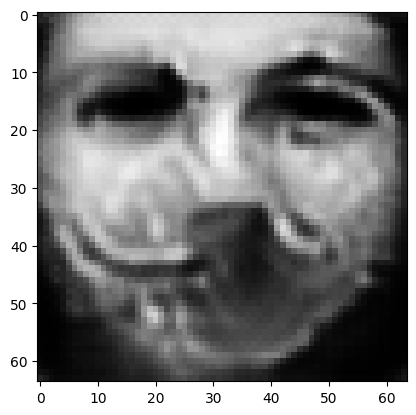

tensor([[2.6382e-04, 2.8564e-04, 1.2121e-03, 8.5322e-04, 9.4061e-05, 4.6209e-04,
         8.2503e-05, 3.3279e-03, 7.8856e-05, 9.8247e-01, 1.4913e-04, 5.9315e-04,
         2.8840e-05, 4.3230e-07, 1.8058e-06, 8.6053e-04, 3.1363e-05, 1.0103e-05,
         2.1129e-04, 5.0509e-04, 6.9541e-06, 1.5363e-04, 4.8870e-08, 6.1350e-06,
         2.5518e-06, 6.4485e-05, 2.1843e-04, 1.7545e-04, 4.7572e-03, 2.7276e-04,
         3.8032e-04, 1.6087e-04, 1.2262e-04, 2.2662e-04, 1.3223e-04, 1.4615e-05,
         7.6903e-06, 8.9495e-04, 2.3581e-04, 6.4478e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017685573548078537
tensor([[2.6373e-04, 2.8555e-04, 1.2117e-03, 8.5303e-04, 9.4037e-05, 4.6189e-04,
         8.2473e-05, 3.3269e-03, 7.8829e-05, 9.8247e-01, 1.4911e-04, 5.9305e-04,
         2.8830e-05, 4.3214e-07, 1.8052e-06, 8.6039e-04, 3.1355e-05, 1.0099e-05,
         2.1123e-04, 5.0498e-04, 6.9518e-06, 1.5361e-04, 4.8852e-08, 6.1336e-06,
         2.5507e-06, 6.4466e-05, 2.1835e-

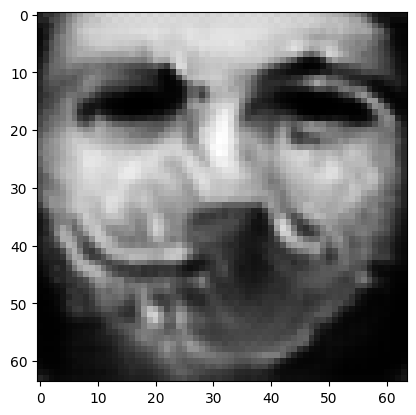

tensor([[2.6336e-04, 2.8521e-04, 1.2100e-03, 8.5221e-04, 9.3927e-05, 4.6105e-04,
         8.2340e-05, 3.3225e-03, 7.8707e-05, 9.8249e-01, 1.4903e-04, 5.9271e-04,
         2.8788e-05, 4.3151e-07, 1.8028e-06, 8.5990e-04, 3.1326e-05, 1.0082e-05,
         2.1100e-04, 5.0449e-04, 6.9425e-06, 1.5354e-04, 4.8777e-08, 6.1284e-06,
         2.5463e-06, 6.4393e-05, 2.1806e-04, 1.7519e-04, 4.7518e-03, 2.7238e-04,
         3.8000e-04, 1.6079e-04, 1.2242e-04, 2.2632e-04, 1.3203e-04, 1.4599e-05,
         7.6810e-06, 8.9433e-04, 2.3530e-04, 6.4368e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01766226626932621
tensor([[2.6327e-04, 2.8513e-04, 1.2096e-03, 8.5203e-04, 9.3900e-05, 4.6084e-04,
         8.2308e-05, 3.3214e-03, 7.8683e-05, 9.8250e-01, 1.4901e-04, 5.9265e-04,
         2.8779e-05, 4.3136e-07, 1.8022e-06, 8.5976e-04, 3.1320e-05, 1.0079e-05,
         2.1094e-04, 5.0439e-04, 6.9403e-06, 1.5352e-04, 4.8761e-08, 6.1270e-06,
         2.5453e-06, 6.4376e-05, 2.1800e-0

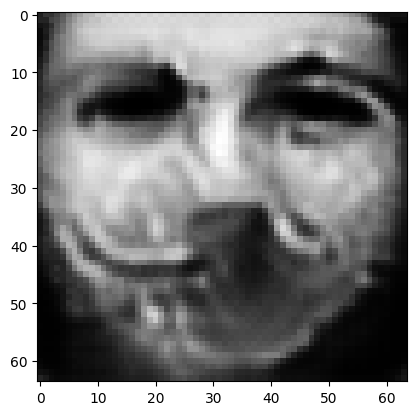

tensor([[2.6292e-04, 2.8482e-04, 1.2081e-03, 8.5135e-04, 9.3796e-05, 4.6006e-04,
         8.2179e-05, 3.3173e-03, 7.8585e-05, 9.8251e-01, 1.4894e-04, 5.9236e-04,
         2.8741e-05, 4.3077e-07, 1.8000e-06, 8.5926e-04, 3.1293e-05, 1.0063e-05,
         2.1073e-04, 5.0394e-04, 6.9318e-06, 1.5344e-04, 4.8694e-08, 6.1216e-06,
         2.5413e-06, 6.4309e-05, 2.1773e-04, 1.7495e-04, 4.7463e-03, 2.7204e-04,
         3.7972e-04, 1.6070e-04, 1.2221e-04, 2.2603e-04, 1.3185e-04, 1.4585e-05,
         7.6723e-06, 8.9381e-04, 2.3479e-04, 6.4272e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017639895901083946
tensor([[2.6284e-04, 2.8474e-04, 1.2077e-03, 8.5118e-04, 9.3773e-05, 4.5988e-04,
         8.2151e-05, 3.3163e-03, 7.8560e-05, 9.8252e-01, 1.4892e-04, 5.9229e-04,
         2.8733e-05, 4.3063e-07, 1.7995e-06, 8.5914e-04, 3.1286e-05, 1.0060e-05,
         2.1067e-04, 5.0384e-04, 6.9297e-06, 1.5342e-04, 4.8677e-08, 6.1204e-06,
         2.5403e-06, 6.4292e-05, 2.1766e-

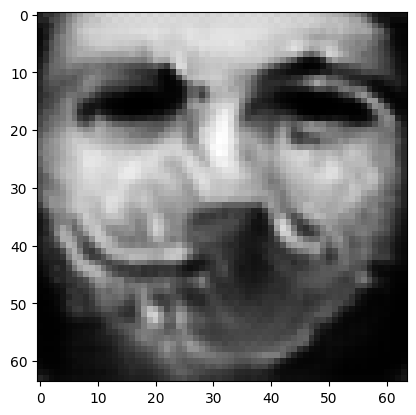

tensor([[2.6251e-04, 2.8443e-04, 1.2062e-03, 8.5044e-04, 9.3677e-05, 4.5912e-04,
         8.2030e-05, 3.3125e-03, 7.8445e-05, 9.8254e-01, 1.4885e-04, 5.9198e-04,
         2.8694e-05, 4.3005e-07, 1.7972e-06, 8.5872e-04, 3.1261e-05, 1.0045e-05,
         2.1047e-04, 5.0339e-04, 6.9213e-06, 1.5336e-04, 4.8608e-08, 6.1159e-06,
         2.5362e-06, 6.4227e-05, 2.1739e-04, 1.7472e-04, 4.7415e-03, 2.7170e-04,
         3.7941e-04, 1.6063e-04, 1.2203e-04, 2.2577e-04, 1.3167e-04, 1.4570e-05,
         7.6641e-06, 8.9325e-04, 2.3432e-04, 6.4170e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0176188126206398
tensor([[2.6243e-04, 2.8436e-04, 1.2058e-03, 8.5028e-04, 9.3653e-05, 4.5894e-04,
         8.2002e-05, 3.3115e-03, 7.8423e-05, 9.8254e-01, 1.4883e-04, 5.9191e-04,
         2.8686e-05, 4.2992e-07, 1.7968e-06, 8.5861e-04, 3.1255e-05, 1.0042e-05,
         2.1042e-04, 5.0329e-04, 6.9193e-06, 1.5334e-04, 4.8593e-08, 6.1146e-06,
         2.5353e-06, 6.4211e-05, 2.1733e-04

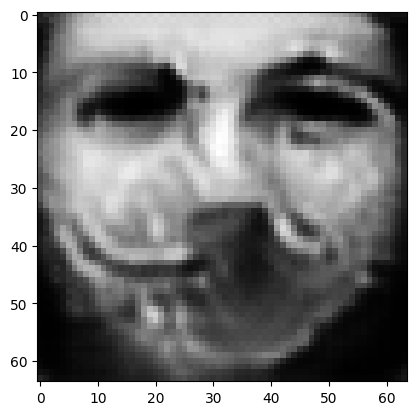

tensor([[2.6211e-04, 2.8408e-04, 1.2044e-03, 8.4961e-04, 9.3560e-05, 4.5825e-04,
         8.1889e-05, 3.3079e-03, 7.8328e-05, 9.8256e-01, 1.4877e-04, 5.9166e-04,
         2.8651e-05, 4.2938e-07, 1.7947e-06, 8.5817e-04, 3.1230e-05, 1.0028e-05,
         2.1022e-04, 5.0290e-04, 6.9115e-06, 1.5327e-04, 4.8531e-08, 6.1099e-06,
         2.5315e-06, 6.4149e-05, 2.1709e-04, 1.7451e-04, 4.7366e-03, 2.7138e-04,
         3.7913e-04, 1.6056e-04, 1.2185e-04, 2.2550e-04, 1.3150e-04, 1.4556e-05,
         7.6559e-06, 8.9276e-04, 2.3386e-04, 6.4083e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01759878359735012
tensor([[2.6204e-04, 2.8402e-04, 1.2041e-03, 8.4948e-04, 9.3538e-05, 4.5807e-04,
         8.1862e-05, 3.3070e-03, 7.8311e-05, 9.8256e-01, 1.4875e-04, 5.9160e-04,
         2.8644e-05, 4.2926e-07, 1.7943e-06, 8.5805e-04, 3.1224e-05, 1.0025e-05,
         2.1018e-04, 5.0281e-04, 6.9097e-06, 1.5325e-04, 4.8519e-08, 6.1087e-06,
         2.5307e-06, 6.4135e-05, 2.1703e-0

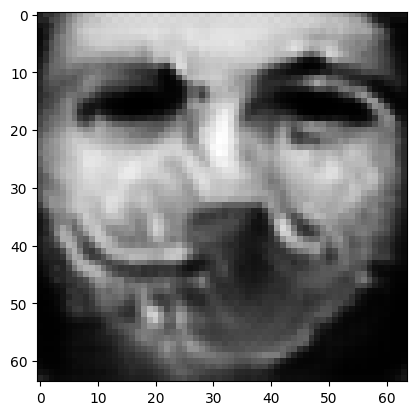

tensor([[2.6176e-04, 2.8377e-04, 1.2028e-03, 8.4900e-04, 9.3458e-05, 4.5741e-04,
         8.1756e-05, 3.3036e-03, 7.8227e-05, 9.8257e-01, 1.4869e-04, 5.9134e-04,
         2.8614e-05, 4.2882e-07, 1.7925e-06, 8.5760e-04, 3.1204e-05, 1.0012e-05,
         2.1000e-04, 5.0244e-04, 6.9026e-06, 1.5320e-04, 4.8464e-08, 6.1046e-06,
         2.5275e-06, 6.4083e-05, 2.1681e-04, 1.7432e-04, 4.7319e-03, 2.7112e-04,
         3.7895e-04, 1.6049e-04, 1.2167e-04, 2.2527e-04, 1.3136e-04, 1.4546e-05,
         7.6496e-06, 8.9236e-04, 2.3345e-04, 6.3998e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01758015900850296
tensor([[2.6169e-04, 2.8369e-04, 1.2025e-03, 8.4886e-04, 9.3437e-05, 4.5723e-04,
         8.1729e-05, 3.3027e-03, 7.8192e-05, 9.8258e-01, 1.4867e-04, 5.9127e-04,
         2.8605e-05, 4.2871e-07, 1.7920e-06, 8.5754e-04, 3.1200e-05, 1.0009e-05,
         2.0996e-04, 5.0232e-04, 6.9007e-06, 1.5319e-04, 4.8447e-08, 6.1040e-06,
         2.5266e-06, 6.4069e-05, 2.1674e-0

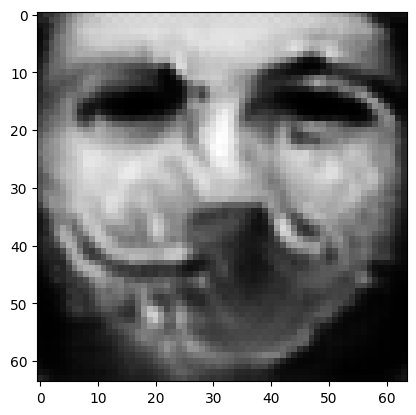

tensor([[2.6144e-04, 2.8345e-04, 1.2014e-03, 8.4837e-04, 9.3356e-05, 4.5664e-04,
         8.1635e-05, 3.2993e-03, 7.8131e-05, 9.8259e-01, 1.4861e-04, 5.9108e-04,
         2.8579e-05, 4.2829e-07, 1.7903e-06, 8.5709e-04, 3.1179e-05, 9.9980e-06,
         2.0978e-04, 5.0201e-04, 6.8941e-06, 1.5313e-04, 4.8399e-08, 6.0995e-06,
         2.5236e-06, 6.4017e-05, 2.1655e-04, 1.7413e-04, 4.7276e-03, 2.7085e-04,
         3.7876e-04, 1.6041e-04, 1.2152e-04, 2.2506e-04, 1.3122e-04, 1.4534e-05,
         7.6438e-06, 8.9196e-04, 2.3307e-04, 6.3918e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017562823370099068
tensor([[2.6137e-04, 2.8338e-04, 1.2011e-03, 8.4820e-04, 9.3335e-05, 4.5650e-04,
         8.1613e-05, 3.2986e-03, 7.8112e-05, 9.8259e-01, 1.4859e-04, 5.9102e-04,
         2.8571e-05, 4.2817e-07, 1.7899e-06, 8.5699e-04, 3.1174e-05, 9.9955e-06,
         2.0974e-04, 5.0193e-04, 6.8925e-06, 1.5311e-04, 4.8385e-08, 6.0985e-06,
         2.5228e-06, 6.4003e-05, 2.1650e-

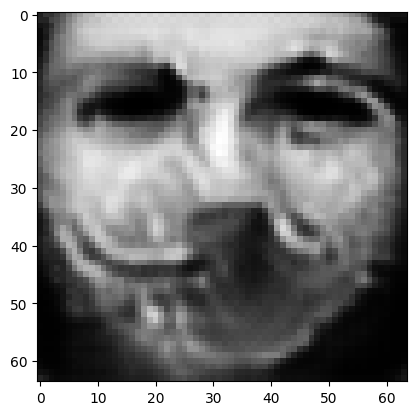

tensor([[2.6114e-04, 2.8311e-04, 1.2001e-03, 8.4769e-04, 9.3261e-05, 4.5595e-04,
         8.1526e-05, 3.2955e-03, 7.8039e-05, 9.8261e-01, 1.4853e-04, 5.9079e-04,
         2.8544e-05, 4.2776e-07, 1.7882e-06, 8.5660e-04, 3.1155e-05, 9.9853e-06,
         2.0957e-04, 5.0162e-04, 6.8858e-06, 1.5305e-04, 4.8334e-08, 6.0948e-06,
         2.5199e-06, 6.3951e-05, 2.1630e-04, 1.7396e-04, 4.7236e-03, 2.7056e-04,
         3.7853e-04, 1.6032e-04, 1.2137e-04, 2.2486e-04, 1.3109e-04, 1.4522e-05,
         7.6382e-06, 8.9154e-04, 2.3273e-04, 6.3842e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017546307295560837
tensor([[2.6109e-04, 2.8306e-04, 1.1998e-03, 8.4761e-04, 9.3241e-05, 4.5582e-04,
         8.1505e-05, 3.2946e-03, 7.8028e-05, 9.8261e-01, 1.4851e-04, 5.9076e-04,
         2.8538e-05, 4.2766e-07, 1.7878e-06, 8.5649e-04, 3.1151e-05, 9.9826e-06,
         2.0953e-04, 5.0155e-04, 6.8843e-06, 1.5304e-04, 4.8323e-08, 6.0936e-06,
         2.5192e-06, 6.3939e-05, 2.1626e-

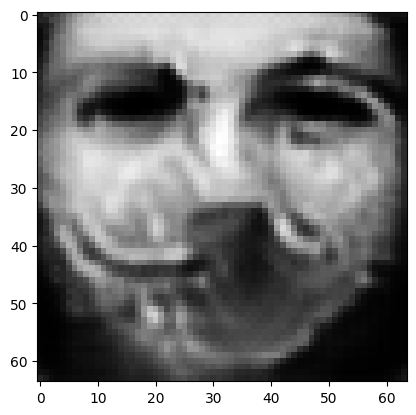

tensor([[2.6087e-04, 2.8282e-04, 1.1989e-03, 8.4712e-04, 9.3169e-05, 4.5532e-04,
         8.1424e-05, 3.2918e-03, 7.7968e-05, 9.8262e-01, 1.4846e-04, 5.9056e-04,
         2.8513e-05, 4.2726e-07, 1.7862e-06, 8.5609e-04, 3.1132e-05, 9.9728e-06,
         2.0936e-04, 5.0126e-04, 6.8782e-06, 1.5298e-04, 4.8276e-08, 6.0897e-06,
         2.5164e-06, 6.3890e-05, 2.1609e-04, 1.7379e-04, 4.7196e-03, 2.7030e-04,
         3.7834e-04, 1.6023e-04, 1.2123e-04, 2.2466e-04, 1.3097e-04, 1.4510e-05,
         7.6330e-06, 8.9116e-04, 2.3240e-04, 6.3779e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017530612647533417
tensor([[2.6081e-04, 2.8276e-04, 1.1986e-03, 8.4704e-04, 9.3151e-05, 4.5519e-04,
         8.1400e-05, 3.2910e-03, 7.7959e-05, 9.8262e-01, 1.4844e-04, 5.9052e-04,
         2.8508e-05, 4.2718e-07, 1.7858e-06, 8.5598e-04, 3.1128e-05, 9.9702e-06,
         2.0933e-04, 5.0119e-04, 6.8768e-06, 1.5297e-04, 4.8266e-08, 6.0887e-06,
         2.5159e-06, 6.3880e-05, 2.1604e-

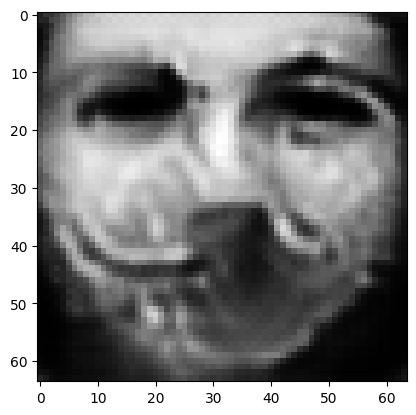

tensor([[2.6061e-04, 2.8251e-04, 1.1977e-03, 8.4662e-04, 9.3087e-05, 4.5465e-04,
         8.1318e-05, 3.2881e-03, 7.7879e-05, 9.8264e-01, 1.4838e-04, 5.9026e-04,
         2.8481e-05, 4.2681e-07, 1.7843e-06, 8.5562e-04, 3.1113e-05, 9.9605e-06,
         2.0916e-04, 5.0087e-04, 6.8702e-06, 1.5293e-04, 4.8214e-08, 6.0856e-06,
         2.5131e-06, 6.3834e-05, 2.1584e-04, 1.7364e-04, 4.7158e-03, 2.7005e-04,
         3.7820e-04, 1.6015e-04, 1.2109e-04, 2.2449e-04, 1.3085e-04, 1.4500e-05,
         7.6289e-06, 8.9081e-04, 2.3208e-04, 6.3699e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017515501007437706
tensor([[2.6056e-04, 2.8245e-04, 1.1975e-03, 8.4649e-04, 9.3072e-05, 4.5453e-04,
         8.1299e-05, 3.2875e-03, 7.7858e-05, 9.8264e-01, 1.4836e-04, 5.9020e-04,
         2.8474e-05, 4.2670e-07, 1.7839e-06, 8.5553e-04, 3.1108e-05, 9.9584e-06,
         2.0912e-04, 5.0080e-04, 6.8686e-06, 1.5291e-04, 4.8201e-08, 6.0848e-06,
         2.5124e-06, 6.3823e-05, 2.1580e-

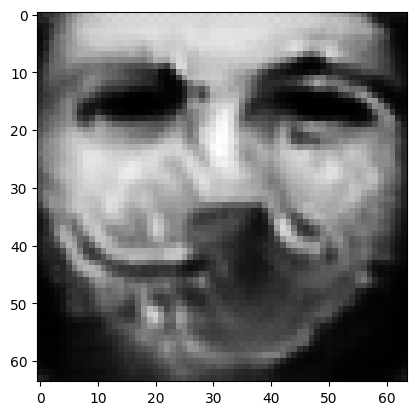

tensor([[2.6038e-04, 2.8222e-04, 1.1966e-03, 8.4618e-04, 9.3011e-05, 4.5402e-04,
         8.1218e-05, 3.2847e-03, 7.7796e-05, 9.8265e-01, 1.4830e-04, 5.8998e-04,
         2.8450e-05, 4.2637e-07, 1.7825e-06, 8.5514e-04, 3.1094e-05, 9.9491e-06,
         2.0897e-04, 5.0050e-04, 6.8625e-06, 1.5287e-04, 4.8155e-08, 6.0816e-06,
         2.5100e-06, 6.3782e-05, 2.1561e-04, 1.7350e-04, 4.7119e-03, 2.6980e-04,
         3.7807e-04, 1.6007e-04, 1.2094e-04, 2.2431e-04, 1.3073e-04, 1.4490e-05,
         7.6248e-06, 8.9050e-04, 2.3177e-04, 6.3622e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0175006240606308
tensor([[2.6033e-04, 2.8216e-04, 1.1963e-03, 8.4607e-04, 9.2995e-05, 4.5390e-04,
         8.1198e-05, 3.2841e-03, 7.7777e-05, 9.8265e-01, 1.4829e-04, 5.8992e-04,
         2.8444e-05, 4.2628e-07, 1.7821e-06, 8.5506e-04, 3.1090e-05, 9.9467e-06,
         2.0893e-04, 5.0042e-04, 6.8610e-06, 1.5286e-04, 4.8143e-08, 6.0808e-06,
         2.5094e-06, 6.3772e-05, 2.1556e-04

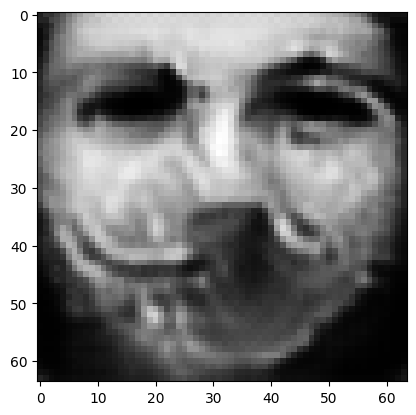

tensor([[2.6015e-04, 2.8194e-04, 1.1955e-03, 8.4571e-04, 9.2939e-05, 4.5342e-04,
         8.1122e-05, 3.2816e-03, 7.7711e-05, 9.8267e-01, 1.4823e-04, 5.8970e-04,
         2.8420e-05, 4.2594e-07, 1.7807e-06, 8.5470e-04, 3.1075e-05, 9.9383e-06,
         2.0878e-04, 5.0015e-04, 6.8551e-06, 1.5282e-04, 4.8098e-08, 6.0778e-06,
         2.5070e-06, 6.3732e-05, 2.1539e-04, 1.7336e-04, 4.7082e-03, 2.6956e-04,
         3.7793e-04, 1.6001e-04, 1.2081e-04, 2.2414e-04, 1.3062e-04, 1.4480e-05,
         7.6206e-06, 8.9019e-04, 2.3148e-04, 6.3548e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017486566677689552
tensor([[2.6010e-04, 2.8189e-04, 1.1953e-03, 8.4566e-04, 9.2925e-05, 4.5330e-04,
         8.1103e-05, 3.2809e-03, 7.7699e-05, 9.8267e-01, 1.4822e-04, 5.8965e-04,
         2.8415e-05, 4.2588e-07, 1.7804e-06, 8.5461e-04, 3.1072e-05, 9.9360e-06,
         2.0874e-04, 5.0008e-04, 6.8538e-06, 1.5282e-04, 4.8088e-08, 6.0771e-06,
         2.5065e-06, 6.3723e-05, 2.1534e-

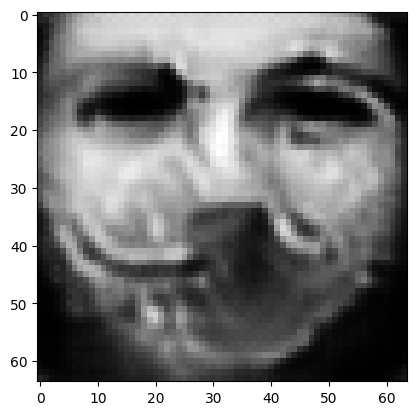

tensor([[2.5992e-04, 2.8167e-04, 1.1945e-03, 8.4526e-04, 9.2865e-05, 4.5284e-04,
         8.1026e-05, 3.2784e-03, 7.7636e-05, 9.8268e-01, 1.4816e-04, 5.8945e-04,
         2.8392e-05, 4.2553e-07, 1.7790e-06, 8.5428e-04, 3.1057e-05, 9.9276e-06,
         2.0860e-04, 4.9980e-04, 6.8483e-06, 1.5277e-04, 4.8044e-08, 6.0739e-06,
         2.5042e-06, 6.3686e-05, 2.1518e-04, 1.7323e-04, 4.7050e-03, 2.6934e-04,
         3.7778e-04, 1.5994e-04, 1.2068e-04, 2.2398e-04, 1.3052e-04, 1.4471e-05,
         7.6165e-06, 8.8991e-04, 2.3119e-04, 6.3480e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017473330721259117
tensor([[2.5988e-04, 2.8162e-04, 1.1943e-03, 8.4520e-04, 9.2853e-05, 4.5273e-04,
         8.1008e-05, 3.2777e-03, 7.7624e-05, 9.8268e-01, 1.4815e-04, 5.8940e-04,
         2.8387e-05, 4.2546e-07, 1.7787e-06, 8.5419e-04, 3.1053e-05, 9.9256e-06,
         2.0856e-04, 4.9975e-04, 6.8470e-06, 1.5276e-04, 4.8035e-08, 6.0732e-06,
         2.5037e-06, 6.3677e-05, 2.1514e-

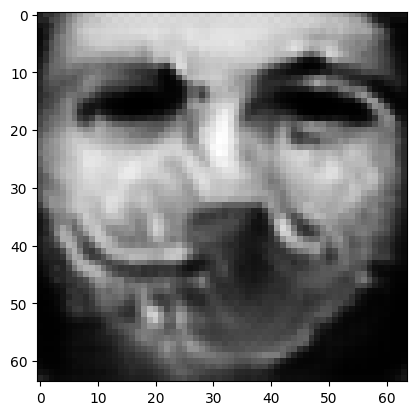

tensor([[2.5970e-04, 2.8142e-04, 1.1935e-03, 8.4483e-04, 9.2797e-05, 4.5229e-04,
         8.0935e-05, 3.2753e-03, 7.7565e-05, 9.8269e-01, 1.4809e-04, 5.8922e-04,
         2.8364e-05, 4.2514e-07, 1.7774e-06, 8.5389e-04, 3.1039e-05, 9.9177e-06,
         2.0843e-04, 4.9949e-04, 6.8418e-06, 1.5272e-04, 4.7994e-08, 6.0703e-06,
         2.5015e-06, 6.3641e-05, 2.1497e-04, 1.7310e-04, 4.7019e-03, 2.6913e-04,
         3.7764e-04, 1.5987e-04, 1.2056e-04, 2.2383e-04, 1.3042e-04, 1.4461e-05,
         7.6126e-06, 8.8963e-04, 2.3092e-04, 6.3416e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01746067777276039
tensor([[2.5966e-04, 2.8137e-04, 1.1934e-03, 8.4477e-04, 9.2785e-05, 4.5218e-04,
         8.0918e-05, 3.2747e-03, 7.7553e-05, 9.8269e-01, 1.4808e-04, 5.8917e-04,
         2.8360e-05, 4.2508e-07, 1.7771e-06, 8.5380e-04, 3.1036e-05, 9.9159e-06,
         2.0839e-04, 4.9943e-04, 6.8406e-06, 1.5272e-04, 4.7985e-08, 6.0696e-06,
         2.5010e-06, 6.3632e-05, 2.1494e-0

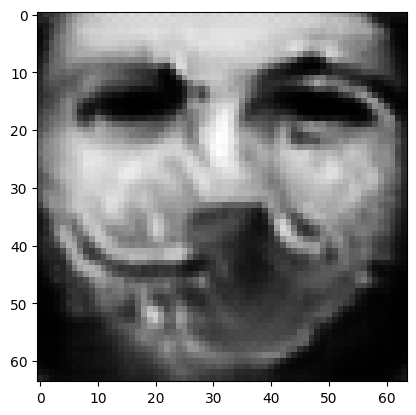

tensor([[2.5950e-04, 2.8118e-04, 1.1926e-03, 8.4441e-04, 9.2732e-05, 4.5177e-04,
         8.0851e-05, 3.2725e-03, 7.7496e-05, 9.8270e-01, 1.4803e-04, 5.8900e-04,
         2.8339e-05, 4.2476e-07, 1.7759e-06, 8.5351e-04, 3.1022e-05, 9.9083e-06,
         2.0826e-04, 4.9918e-04, 6.8357e-06, 1.5268e-04, 4.7946e-08, 6.0668e-06,
         2.4989e-06, 6.3597e-05, 2.1479e-04, 1.7298e-04, 4.6989e-03, 2.6892e-04,
         3.7750e-04, 1.5981e-04, 1.2045e-04, 2.2368e-04, 1.3033e-04, 1.4453e-05,
         7.6089e-06, 8.8937e-04, 2.3067e-04, 6.3356e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017448611557483673
tensor([[2.5946e-04, 2.8113e-04, 1.1924e-03, 8.4435e-04, 9.2720e-05, 4.5167e-04,
         8.0835e-05, 3.2720e-03, 7.7484e-05, 9.8270e-01, 1.4802e-04, 5.8896e-04,
         2.8334e-05, 4.2470e-07, 1.7756e-06, 8.5344e-04, 3.1020e-05, 9.9065e-06,
         2.0823e-04, 4.9913e-04, 6.8345e-06, 1.5267e-04, 4.7937e-08, 6.0662e-06,
         2.4985e-06, 6.3589e-05, 2.1475e-

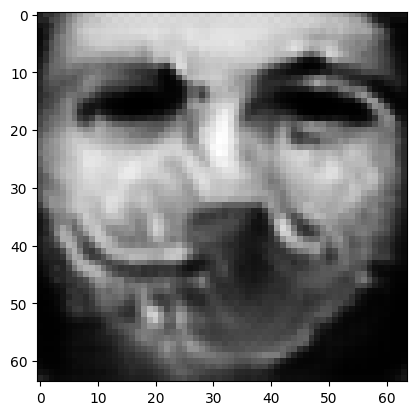

tensor([[2.5930e-04, 2.8095e-04, 1.1917e-03, 8.4402e-04, 9.2669e-05, 4.5128e-04,
         8.0771e-05, 3.2698e-03, 7.7430e-05, 9.8271e-01, 1.4798e-04, 5.8879e-04,
         2.8314e-05, 4.2441e-07, 1.7744e-06, 8.5316e-04, 3.1007e-05, 9.8992e-06,
         2.0811e-04, 4.9890e-04, 6.8298e-06, 1.5263e-04, 4.7900e-08, 6.0636e-06,
         2.4964e-06, 6.3556e-05, 2.1461e-04, 1.7286e-04, 4.6961e-03, 2.6873e-04,
         3.7737e-04, 1.5976e-04, 1.2034e-04, 2.2354e-04, 1.3024e-04, 1.4445e-05,
         7.6054e-06, 8.8912e-04, 2.3042e-04, 6.3298e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017437249422073364
tensor([[2.5926e-04, 2.8090e-04, 1.1916e-03, 8.4396e-04, 9.2657e-05, 4.5119e-04,
         8.0756e-05, 3.2693e-03, 7.7420e-05, 9.8272e-01, 1.4797e-04, 5.8875e-04,
         2.8310e-05, 4.2435e-07, 1.7742e-06, 8.5309e-04, 3.1004e-05, 9.8975e-06,
         2.0808e-04, 4.9884e-04, 6.8287e-06, 1.5262e-04, 4.7892e-08, 6.0630e-06,
         2.4960e-06, 6.3548e-05, 2.1458e-

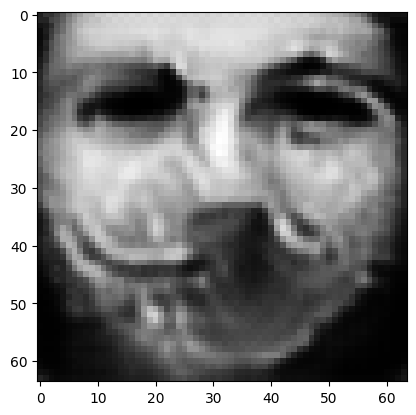

tensor([[2.5910e-04, 2.8072e-04, 1.1909e-03, 8.4359e-04, 9.2606e-05, 4.5081e-04,
         8.0692e-05, 3.2672e-03, 7.7369e-05, 9.8272e-01, 1.4792e-04, 5.8860e-04,
         2.8290e-05, 4.2405e-07, 1.7730e-06, 8.5284e-04, 3.0990e-05, 9.8906e-06,
         2.0797e-04, 4.9862e-04, 6.8243e-06, 1.5258e-04, 4.7857e-08, 6.0603e-06,
         2.4940e-06, 6.3516e-05, 2.1444e-04, 1.7274e-04, 4.6936e-03, 2.6854e-04,
         3.7721e-04, 1.5970e-04, 1.2024e-04, 2.2340e-04, 1.3015e-04, 1.4436e-05,
         7.6016e-06, 8.8887e-04, 2.3019e-04, 6.3247e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017426470294594765
tensor([[2.5907e-04, 2.8069e-04, 1.1908e-03, 8.4356e-04, 9.2595e-05, 4.5072e-04,
         8.0678e-05, 3.2666e-03, 7.7360e-05, 9.8273e-01, 1.4791e-04, 5.8856e-04,
         2.8287e-05, 4.2400e-07, 1.7728e-06, 8.5276e-04, 3.0988e-05, 9.8890e-06,
         2.0794e-04, 4.9857e-04, 6.8232e-06, 1.5258e-04, 4.7849e-08, 6.0597e-06,
         2.4936e-06, 6.3509e-05, 2.1441e-

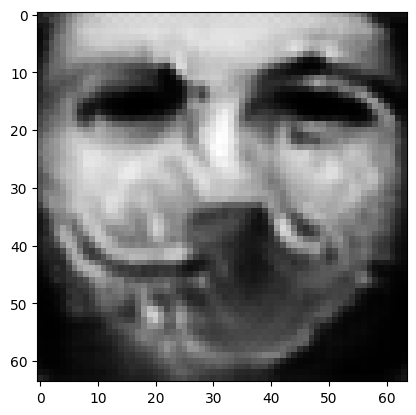

tensor([[2.5893e-04, 2.8053e-04, 1.1902e-03, 8.4334e-04, 9.2551e-05, 4.5037e-04,
         8.0622e-05, 3.2647e-03, 7.7316e-05, 9.8273e-01, 1.4787e-04, 5.8842e-04,
         2.8271e-05, 4.2377e-07, 1.7718e-06, 8.5250e-04, 3.0978e-05, 9.8825e-06,
         2.0783e-04, 4.9837e-04, 6.8190e-06, 1.5255e-04, 4.7818e-08, 6.0575e-06,
         2.4919e-06, 6.3480e-05, 2.1428e-04, 1.7265e-04, 4.6910e-03, 2.6838e-04,
         3.7714e-04, 1.5965e-04, 1.2014e-04, 2.2328e-04, 1.3008e-04, 1.4430e-05,
         7.5991e-06, 8.8868e-04, 2.2997e-04, 6.3195e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017416279762983322
tensor([[2.5888e-04, 2.8048e-04, 1.1900e-03, 8.4319e-04, 9.2538e-05, 4.5028e-04,
         8.0606e-05, 3.2642e-03, 7.7302e-05, 9.8274e-01, 1.4786e-04, 5.8839e-04,
         2.8265e-05, 4.2368e-07, 1.7714e-06, 8.5245e-04, 3.0973e-05, 9.8810e-06,
         2.0781e-04, 4.9832e-04, 6.8181e-06, 1.5253e-04, 4.7810e-08, 6.0569e-06,
         2.4914e-06, 6.3472e-05, 2.1425e-

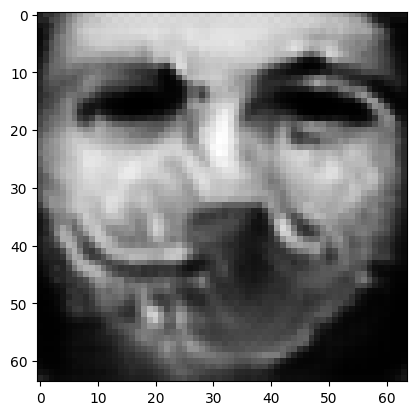

tensor([[2.5874e-04, 2.8033e-04, 1.1894e-03, 8.4293e-04, 9.2495e-05, 4.4995e-04,
         8.0551e-05, 3.2623e-03, 7.7259e-05, 9.8274e-01, 1.4783e-04, 5.8825e-04,
         2.8249e-05, 4.2344e-07, 1.7704e-06, 8.5221e-04, 3.0962e-05, 9.8748e-06,
         2.0770e-04, 4.9813e-04, 6.8141e-06, 1.5250e-04, 4.7779e-08, 6.0546e-06,
         2.4897e-06, 6.3444e-05, 2.1413e-04, 1.7254e-04, 4.6889e-03, 2.6821e-04,
         3.7698e-04, 1.5960e-04, 1.2005e-04, 2.2316e-04, 1.3000e-04, 1.4422e-05,
         7.5954e-06, 8.8844e-04, 2.2976e-04, 6.3149e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01740667223930359
tensor([[2.5871e-04, 2.8029e-04, 1.1893e-03, 8.4290e-04, 9.2485e-05, 4.4987e-04,
         8.0538e-05, 3.2619e-03, 7.7249e-05, 9.8275e-01, 1.4782e-04, 5.8822e-04,
         2.8246e-05, 4.2339e-07, 1.7702e-06, 8.5214e-04, 3.0960e-05, 9.8732e-06,
         2.0768e-04, 4.9808e-04, 6.8131e-06, 1.5249e-04, 4.7772e-08, 6.0541e-06,
         2.4893e-06, 6.3438e-05, 2.1410e-0

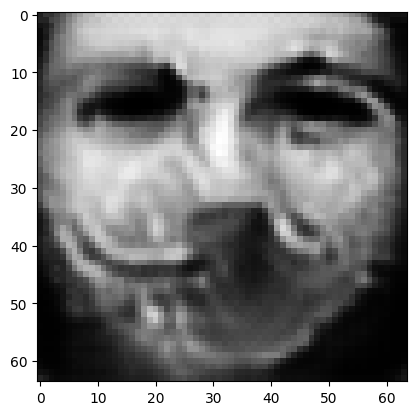

tensor([[2.5858e-04, 2.8015e-04, 1.1887e-03, 8.4262e-04, 9.2443e-05, 4.4954e-04,
         8.0485e-05, 3.2601e-03, 7.7206e-05, 9.8275e-01, 1.4778e-04, 5.8809e-04,
         2.8230e-05, 4.2316e-07, 1.7692e-06, 8.5192e-04, 3.0949e-05, 9.8672e-06,
         2.0758e-04, 4.9789e-04, 6.8093e-06, 1.5246e-04, 4.7742e-08, 6.0519e-06,
         2.4877e-06, 6.3411e-05, 2.1399e-04, 1.7245e-04, 4.6866e-03, 2.6806e-04,
         3.7688e-04, 1.5955e-04, 1.1997e-04, 2.2304e-04, 1.2993e-04, 1.4415e-05,
         7.5925e-06, 8.8824e-04, 2.2957e-04, 6.3103e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017397183924913406
tensor([[2.5855e-04, 2.8011e-04, 1.1886e-03, 8.4258e-04, 9.2434e-05, 4.4947e-04,
         8.0474e-05, 3.2596e-03, 7.7196e-05, 9.8275e-01, 1.4777e-04, 5.8806e-04,
         2.8227e-05, 4.2311e-07, 1.7691e-06, 8.5187e-04, 3.0947e-05, 9.8659e-06,
         2.0756e-04, 4.9785e-04, 6.8084e-06, 1.5245e-04, 4.7735e-08, 6.0515e-06,
         2.4873e-06, 6.3404e-05, 2.1396e-

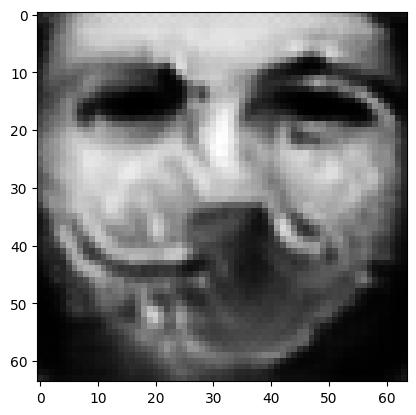

tensor([[2.5842e-04, 2.7998e-04, 1.1880e-03, 8.4239e-04, 9.2395e-05, 4.4915e-04,
         8.0424e-05, 3.2579e-03, 7.7158e-05, 9.8276e-01, 1.4774e-04, 5.8794e-04,
         2.8213e-05, 4.2291e-07, 1.7682e-06, 8.5163e-04, 3.0938e-05, 9.8602e-06,
         2.0746e-04, 4.9767e-04, 6.8048e-06, 1.5243e-04, 4.7709e-08, 6.0496e-06,
         2.4859e-06, 6.3380e-05, 2.1385e-04, 1.7236e-04, 4.6843e-03, 2.6792e-04,
         3.7681e-04, 1.5951e-04, 1.1988e-04, 2.2294e-04, 1.2986e-04, 1.4410e-05,
         7.5902e-06, 8.8807e-04, 2.2938e-04, 6.3057e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017388513311743736
tensor([[2.5838e-04, 2.7994e-04, 1.1879e-03, 8.4226e-04, 9.2384e-05, 4.4908e-04,
         8.0411e-05, 3.2575e-03, 7.7146e-05, 9.8276e-01, 1.4773e-04, 5.8791e-04,
         2.8208e-05, 4.2284e-07, 1.7679e-06, 8.5159e-04, 3.0935e-05, 9.8589e-06,
         2.0744e-04, 4.9763e-04, 6.8040e-06, 1.5242e-04, 4.7701e-08, 6.0490e-06,
         2.4854e-06, 6.3373e-05, 2.1382e-

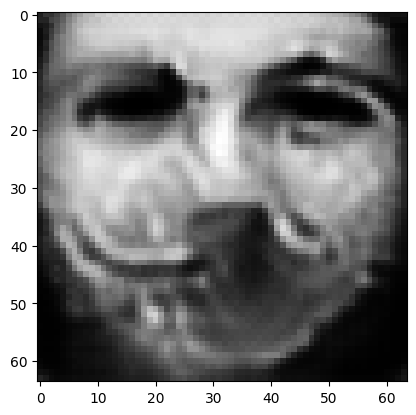

tensor([[2.5826e-04, 2.7981e-04, 1.1873e-03, 8.4202e-04, 9.2346e-05, 4.4878e-04,
         8.0363e-05, 3.2559e-03, 7.7107e-05, 9.8277e-01, 1.4770e-04, 5.8780e-04,
         2.8194e-05, 4.2263e-07, 1.7671e-06, 8.5139e-04, 3.0925e-05, 9.8535e-06,
         2.0735e-04, 4.9746e-04, 6.8006e-06, 1.5239e-04, 4.7675e-08, 6.0471e-06,
         2.4839e-06, 6.3348e-05, 2.1372e-04, 1.7227e-04, 4.6825e-03, 2.6777e-04,
         3.7667e-04, 1.5947e-04, 1.1981e-04, 2.2283e-04, 1.2979e-04, 1.4403e-05,
         7.5870e-06, 8.8786e-04, 2.2920e-04, 6.3017e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01738007925450802
tensor([[2.5824e-04, 2.7978e-04, 1.1872e-03, 8.4200e-04, 9.2338e-05, 4.4872e-04,
         8.0353e-05, 3.2555e-03, 7.7098e-05, 9.8277e-01, 1.4769e-04, 5.8776e-04,
         2.8191e-05, 4.2259e-07, 1.7669e-06, 8.5134e-04, 3.0923e-05, 9.8522e-06,
         2.0733e-04, 4.9741e-04, 6.7997e-06, 1.5238e-04, 4.7668e-08, 6.0467e-06,
         2.4836e-06, 6.3343e-05, 2.1369e-0

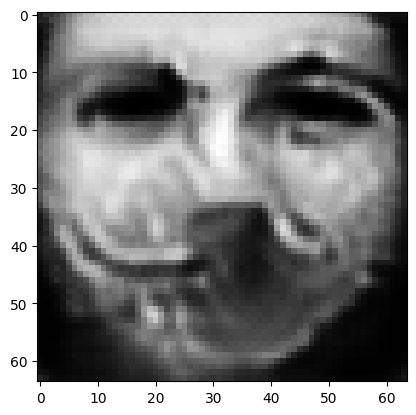

tensor([[2.5812e-04, 2.7966e-04, 1.1867e-03, 8.4177e-04, 9.2303e-05, 4.4844e-04,
         8.0308e-05, 3.2540e-03, 7.7061e-05, 9.8278e-01, 1.4766e-04, 5.8766e-04,
         2.8178e-05, 4.2239e-07, 1.7661e-06, 8.5114e-04, 3.0914e-05, 9.8471e-06,
         2.0725e-04, 4.9725e-04, 6.7965e-06, 1.5236e-04, 4.7643e-08, 6.0449e-06,
         2.4822e-06, 6.3320e-05, 2.1360e-04, 1.7219e-04, 4.6806e-03, 2.6765e-04,
         3.7659e-04, 1.5943e-04, 1.1973e-04, 2.2274e-04, 1.2973e-04, 1.4398e-05,
         7.5846e-06, 8.8768e-04, 2.2903e-04, 6.2977e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017371995374560356
tensor([[2.5809e-04, 2.7963e-04, 1.1866e-03, 8.4172e-04, 9.2294e-05, 4.4837e-04,
         8.0297e-05, 3.2536e-03, 7.7051e-05, 9.8278e-01, 1.4766e-04, 5.8763e-04,
         2.8175e-05, 4.2234e-07, 1.7659e-06, 8.5110e-04, 3.0912e-05, 9.8459e-06,
         2.0723e-04, 4.9721e-04, 6.7957e-06, 1.5235e-04, 4.7637e-08, 6.0444e-06,
         2.4818e-06, 6.3315e-05, 2.1357e-

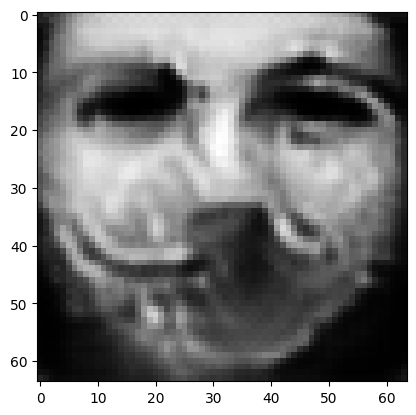

tensor([[2.5798e-04, 2.7951e-04, 1.1861e-03, 8.4151e-04, 9.2259e-05, 4.4811e-04,
         8.0254e-05, 3.2521e-03, 7.7017e-05, 9.8279e-01, 1.4763e-04, 5.8752e-04,
         2.8162e-05, 4.2216e-07, 1.7651e-06, 8.5091e-04, 3.0903e-05, 9.8409e-06,
         2.0715e-04, 4.9706e-04, 6.7927e-06, 1.5232e-04, 4.7613e-08, 6.0427e-06,
         2.4805e-06, 6.3293e-05, 2.1348e-04, 1.7212e-04, 4.6788e-03, 2.6753e-04,
         3.7650e-04, 1.5940e-04, 1.1966e-04, 2.2264e-04, 1.2967e-04, 1.4392e-05,
         7.5822e-06, 8.8751e-04, 2.2887e-04, 6.2939e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017364496365189552
tensor([[2.5795e-04, 2.7948e-04, 1.1860e-03, 8.4145e-04, 9.2250e-05, 4.4805e-04,
         8.0244e-05, 3.2518e-03, 7.7008e-05, 9.8279e-01, 1.4762e-04, 5.8750e-04,
         2.8159e-05, 4.2211e-07, 1.7649e-06, 8.5086e-04, 3.0901e-05, 9.8398e-06,
         2.0713e-04, 4.9702e-04, 6.7919e-06, 1.5232e-04, 4.7607e-08, 6.0423e-06,
         2.4802e-06, 6.3288e-05, 2.1346e-

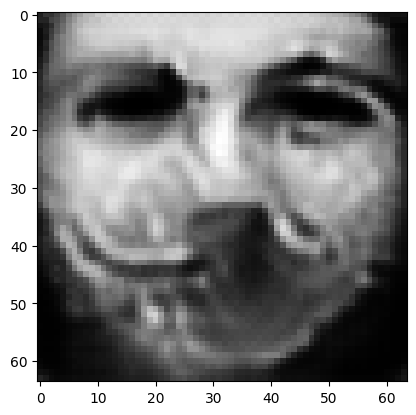

tensor([[2.5784e-04, 2.7937e-04, 1.1855e-03, 8.4126e-04, 9.2217e-05, 4.4779e-04,
         8.0202e-05, 3.2503e-03, 7.6975e-05, 9.8279e-01, 1.4759e-04, 5.8740e-04,
         2.8147e-05, 4.2193e-07, 1.7642e-06, 8.5068e-04, 3.0893e-05, 9.8350e-06,
         2.0705e-04, 4.9687e-04, 6.7890e-06, 1.5229e-04, 4.7585e-08, 6.0406e-06,
         2.4789e-06, 6.3267e-05, 2.1337e-04, 1.7204e-04, 4.6771e-03, 2.6741e-04,
         3.7642e-04, 1.5936e-04, 1.1959e-04, 2.2255e-04, 1.2961e-04, 1.4387e-05,
         7.5798e-06, 8.8735e-04, 2.2871e-04, 6.2903e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017357349395751953
tensor([[2.5782e-04, 2.7934e-04, 1.1854e-03, 8.4123e-04, 9.2210e-05, 4.4774e-04,
         8.0193e-05, 3.2500e-03, 7.6969e-05, 9.8279e-01, 1.4759e-04, 5.8738e-04,
         2.8144e-05, 4.2189e-07, 1.7640e-06, 8.5064e-04, 3.0891e-05, 9.8340e-06,
         2.0703e-04, 4.9684e-04, 6.7883e-06, 1.5229e-04, 4.7580e-08, 6.0402e-06,
         2.4786e-06, 6.3263e-05, 2.1335e-

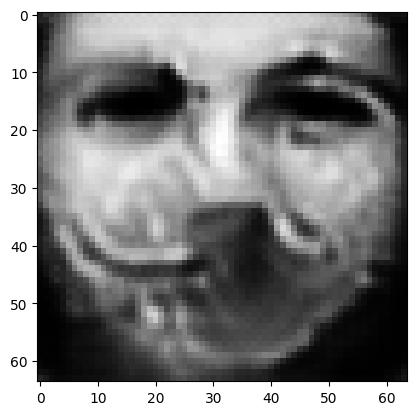

tensor([[2.5772e-04, 2.7923e-04, 1.1850e-03, 8.4100e-04, 9.2178e-05, 4.4750e-04,
         8.0152e-05, 3.2487e-03, 7.6933e-05, 9.8280e-01, 1.4756e-04, 5.8728e-04,
         2.8132e-05, 4.2170e-07, 1.7632e-06, 8.5047e-04, 3.0882e-05, 9.8293e-06,
         2.0696e-04, 4.9669e-04, 6.7855e-06, 1.5227e-04, 4.7556e-08, 6.0385e-06,
         2.4773e-06, 6.3243e-05, 2.1326e-04, 1.7197e-04, 4.6756e-03, 2.6729e-04,
         3.7632e-04, 1.5933e-04, 1.1953e-04, 2.2247e-04, 1.2955e-04, 1.4382e-05,
         7.5774e-06, 8.8717e-04, 2.2856e-04, 6.2869e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01735067181289196
tensor([[2.5769e-04, 2.7921e-04, 1.1849e-03, 8.4098e-04, 9.2170e-05, 4.4744e-04,
         8.0142e-05, 3.2483e-03, 7.6928e-05, 9.8280e-01, 1.4755e-04, 5.8726e-04,
         2.8129e-05, 4.2167e-07, 1.7631e-06, 8.5042e-04, 3.0881e-05, 9.8282e-06,
         2.0694e-04, 4.9665e-04, 6.7848e-06, 1.5226e-04, 4.7552e-08, 6.0381e-06,
         2.4771e-06, 6.3239e-05, 2.1324e-0

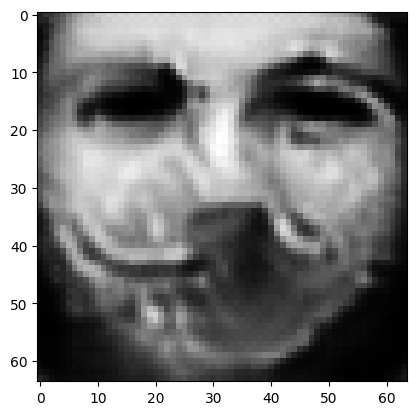

tensor([[2.5760e-04, 2.7911e-04, 1.1845e-03, 8.4080e-04, 9.2140e-05, 4.4721e-04,
         8.0106e-05, 3.2471e-03, 7.6898e-05, 9.8281e-01, 1.4753e-04, 5.8717e-04,
         2.8118e-05, 4.2150e-07, 1.7624e-06, 8.5026e-04, 3.0873e-05, 9.8240e-06,
         2.0688e-04, 4.9652e-04, 6.7822e-06, 1.5224e-04, 4.7531e-08, 6.0367e-06,
         2.4759e-06, 6.3220e-05, 2.1316e-04, 1.7190e-04, 4.6739e-03, 2.6719e-04,
         3.7625e-04, 1.5929e-04, 1.1947e-04, 2.2239e-04, 1.2950e-04, 1.4377e-05,
         7.5755e-06, 8.8703e-04, 2.2842e-04, 6.2838e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017343994230031967
tensor([[2.5757e-04, 2.7908e-04, 1.1844e-03, 8.4075e-04, 9.2134e-05, 4.4716e-04,
         8.0098e-05, 3.2468e-03, 7.6890e-05, 9.8281e-01, 1.4753e-04, 5.8714e-04,
         2.8116e-05, 4.2146e-07, 1.7623e-06, 8.5022e-04, 3.0871e-05, 9.8231e-06,
         2.0686e-04, 4.9649e-04, 6.7815e-06, 1.5223e-04, 4.7526e-08, 6.0363e-06,
         2.4756e-06, 6.3215e-05, 2.1314e-

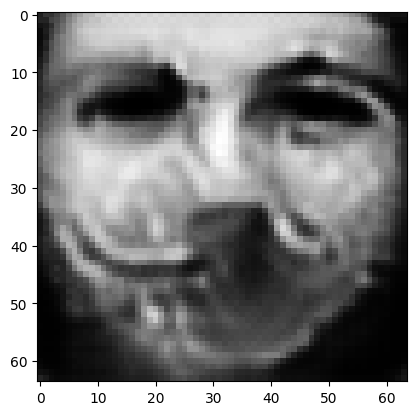

tensor([[2.5748e-04, 2.7898e-04, 1.1840e-03, 8.4057e-04, 9.2105e-05, 4.4694e-04,
         8.0060e-05, 3.2456e-03, 7.6860e-05, 9.8281e-01, 1.4750e-04, 5.8706e-04,
         2.8105e-05, 4.2130e-07, 1.7616e-06, 8.5007e-04, 3.0864e-05, 9.8189e-06,
         2.0679e-04, 4.9636e-04, 6.7790e-06, 1.5221e-04, 4.7505e-08, 6.0348e-06,
         2.4745e-06, 6.3198e-05, 2.1306e-04, 1.7184e-04, 4.6725e-03, 2.6709e-04,
         3.7617e-04, 1.5926e-04, 1.1941e-04, 2.2231e-04, 1.2945e-04, 1.4373e-05,
         7.5734e-06, 8.8688e-04, 2.2828e-04, 6.2807e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01733766682446003
tensor([[2.5746e-04, 2.7896e-04, 1.1839e-03, 8.4053e-04, 9.2099e-05, 4.4689e-04,
         8.0051e-05, 3.2453e-03, 7.6853e-05, 9.8281e-01, 1.4750e-04, 5.8703e-04,
         2.8102e-05, 4.2126e-07, 1.7614e-06, 8.5003e-04, 3.0862e-05, 9.8180e-06,
         2.0678e-04, 4.9633e-04, 6.7784e-06, 1.5221e-04, 4.7501e-08, 6.0345e-06,
         2.4742e-06, 6.3194e-05, 2.1304e-0

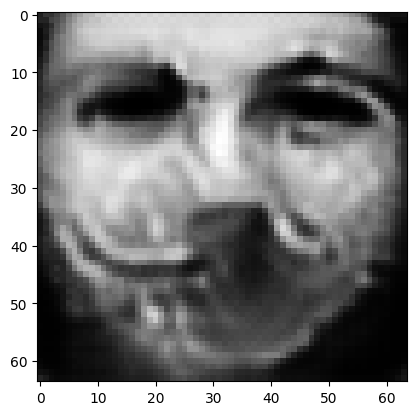

tensor([[2.5737e-04, 2.7887e-04, 1.1835e-03, 8.4038e-04, 9.2073e-05, 4.4668e-04,
         8.0019e-05, 3.2442e-03, 7.6827e-05, 9.8282e-01, 1.4748e-04, 5.8695e-04,
         2.8093e-05, 4.2112e-07, 1.7609e-06, 8.4987e-04, 3.0856e-05, 9.8143e-06,
         2.0671e-04, 4.9621e-04, 6.7760e-06, 1.5219e-04, 4.7482e-08, 6.0332e-06,
         2.4732e-06, 6.3177e-05, 2.1297e-04, 1.7178e-04, 4.6711e-03, 2.6699e-04,
         3.7610e-04, 1.5923e-04, 1.1935e-04, 2.2224e-04, 1.2941e-04, 1.4369e-05,
         7.5715e-06, 8.8675e-04, 2.2815e-04, 6.2777e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0173319261521101
tensor([[2.5735e-04, 2.7885e-04, 1.1835e-03, 8.4037e-04, 9.2067e-05, 4.4663e-04,
         8.0010e-05, 3.2439e-03, 7.6822e-05, 9.8282e-01, 1.4747e-04, 5.8693e-04,
         2.8091e-05, 4.2109e-07, 1.7607e-06, 8.4983e-04, 3.0854e-05, 9.8133e-06,
         2.0670e-04, 4.9618e-04, 6.7755e-06, 1.5219e-04, 4.7478e-08, 6.0328e-06,
         2.4730e-06, 6.3174e-05, 2.1295e-04

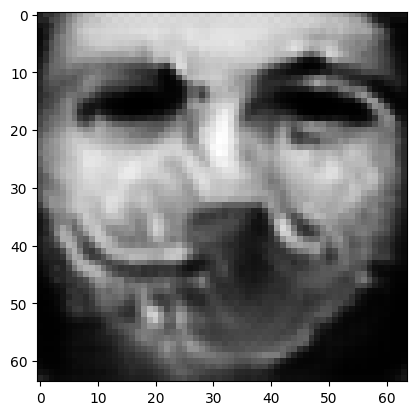

tensor([[2.5727e-04, 2.7876e-04, 1.1831e-03, 8.4018e-04, 9.2041e-05, 4.4644e-04,
         7.9976e-05, 3.2428e-03, 7.6794e-05, 9.8282e-01, 1.4745e-04, 5.8685e-04,
         2.8081e-05, 4.2093e-07, 1.7601e-06, 8.4969e-04, 3.0847e-05, 9.8096e-06,
         2.0664e-04, 4.9606e-04, 6.7732e-06, 1.5217e-04, 4.7459e-08, 6.0315e-06,
         2.4719e-06, 6.3158e-05, 2.1288e-04, 1.7172e-04, 4.6698e-03, 2.6690e-04,
         3.7603e-04, 1.5920e-04, 1.1929e-04, 2.2217e-04, 1.2937e-04, 1.4364e-05,
         7.5697e-06, 8.8661e-04, 2.2803e-04, 6.2749e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01732630282640457
tensor([[2.5725e-04, 2.7873e-04, 1.1830e-03, 8.4015e-04, 9.2035e-05, 4.4639e-04,
         7.9968e-05, 3.2425e-03, 7.6787e-05, 9.8282e-01, 1.4744e-04, 5.8683e-04,
         2.8078e-05, 4.2090e-07, 1.7600e-06, 8.4966e-04, 3.0846e-05, 9.8087e-06,
         2.0662e-04, 4.9603e-04, 6.7726e-06, 1.5216e-04, 4.7455e-08, 6.0312e-06,
         2.4717e-06, 6.3154e-05, 2.1286e-0

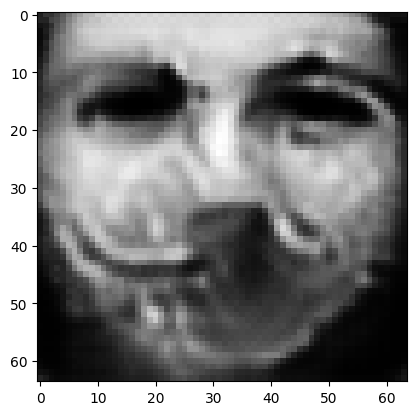

tensor([[2.5717e-04, 2.7866e-04, 1.1827e-03, 8.4004e-04, 9.2012e-05, 4.4620e-04,
         7.9939e-05, 3.2415e-03, 7.6766e-05, 9.8283e-01, 1.4742e-04, 5.8676e-04,
         2.8070e-05, 4.2078e-07, 1.7595e-06, 8.4952e-04, 3.0840e-05, 9.8054e-06,
         2.0657e-04, 4.9593e-04, 6.7705e-06, 1.5215e-04, 4.7439e-08, 6.0300e-06,
         2.4708e-06, 6.3140e-05, 2.1280e-04, 1.7167e-04, 4.6685e-03, 2.6682e-04,
         3.7598e-04, 1.5917e-04, 1.1924e-04, 2.2210e-04, 1.2933e-04, 1.4361e-05,
         7.5682e-06, 8.8651e-04, 2.2792e-04, 6.2723e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0173210296779871
tensor([[2.5715e-04, 2.7863e-04, 1.1826e-03, 8.4000e-04, 9.2006e-05, 4.4616e-04,
         7.9931e-05, 3.2412e-03, 7.6759e-05, 9.8283e-01, 1.4742e-04, 5.8674e-04,
         2.8068e-05, 4.2075e-07, 1.7593e-06, 8.4948e-04, 3.0839e-05, 9.8045e-06,
         2.0656e-04, 4.9590e-04, 6.7700e-06, 1.5214e-04, 4.7435e-08, 6.0297e-06,
         2.4706e-06, 6.3136e-05, 2.1278e-04

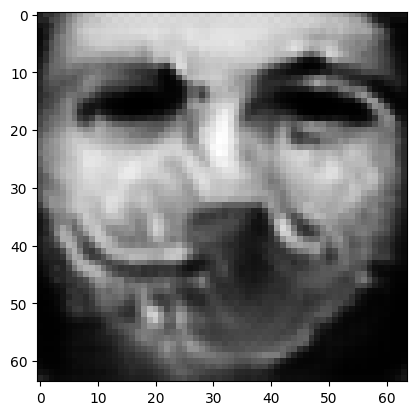

tensor([[2.5708e-04, 2.7856e-04, 1.1823e-03, 8.3985e-04, 9.1983e-05, 4.4599e-04,
         7.9902e-05, 3.2403e-03, 7.6735e-05, 9.8283e-01, 1.4740e-04, 5.8666e-04,
         2.8059e-05, 4.2062e-07, 1.7588e-06, 8.4936e-04, 3.0833e-05, 9.8013e-06,
         2.0650e-04, 4.9580e-04, 6.7679e-06, 1.5212e-04, 4.7419e-08, 6.0285e-06,
         2.4697e-06, 6.3122e-05, 2.1271e-04, 1.7162e-04, 4.6674e-03, 2.6673e-04,
         3.7591e-04, 1.5915e-04, 1.1920e-04, 2.2204e-04, 1.2928e-04, 1.4357e-05,
         7.5664e-06, 8.8638e-04, 2.2781e-04, 6.2698e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017315993085503578
tensor([[2.5706e-04, 2.7854e-04, 1.1822e-03, 8.3981e-04, 9.1978e-05, 4.4594e-04,
         7.9896e-05, 3.2401e-03, 7.6730e-05, 9.8283e-01, 1.4739e-04, 5.8665e-04,
         2.8057e-05, 4.2058e-07, 1.7587e-06, 8.4933e-04, 3.0831e-05, 9.8006e-06,
         2.0649e-04, 4.9578e-04, 6.7674e-06, 1.5212e-04, 4.7415e-08, 6.0282e-06,
         2.4695e-06, 6.3118e-05, 2.1270e-

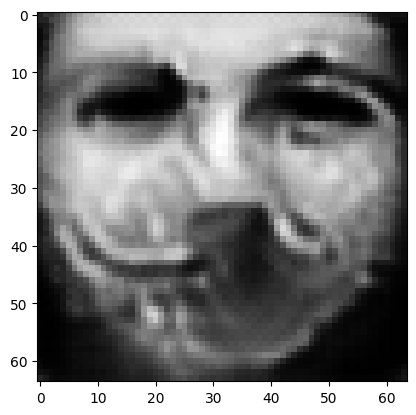

tensor([[2.5699e-04, 2.7846e-04, 1.1819e-03, 8.3971e-04, 9.1958e-05, 4.4578e-04,
         7.9867e-05, 3.2391e-03, 7.6707e-05, 9.8284e-01, 1.4738e-04, 5.8657e-04,
         2.8049e-05, 4.2047e-07, 1.7582e-06, 8.4920e-04, 3.0826e-05, 9.7973e-06,
         2.0644e-04, 4.9567e-04, 6.7655e-06, 1.5211e-04, 4.7399e-08, 6.0272e-06,
         2.4686e-06, 6.3106e-05, 2.1264e-04, 1.7157e-04, 4.6662e-03, 2.6666e-04,
         3.7587e-04, 1.5912e-04, 1.1915e-04, 2.2198e-04, 1.2925e-04, 1.4354e-05,
         7.5650e-06, 8.8627e-04, 2.2770e-04, 6.2673e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017311306670308113
tensor([[2.5697e-04, 2.7844e-04, 1.1819e-03, 8.3964e-04, 9.1951e-05, 4.4574e-04,
         7.9860e-05, 3.2389e-03, 7.6701e-05, 9.8284e-01, 1.4737e-04, 5.8656e-04,
         2.8047e-05, 4.2043e-07, 1.7580e-06, 8.4918e-04, 3.0824e-05, 9.7966e-06,
         2.0643e-04, 4.9565e-04, 6.7650e-06, 1.5210e-04, 4.7395e-08, 6.0268e-06,
         2.4684e-06, 6.3102e-05, 2.1262e-

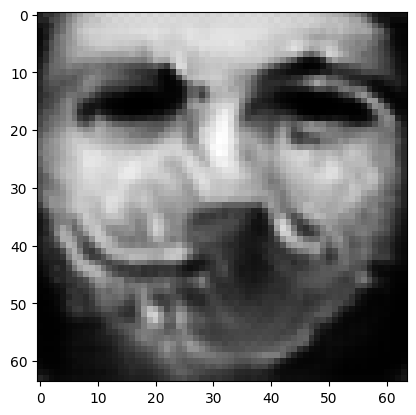

tensor([[2.5691e-04, 2.7837e-04, 1.1816e-03, 8.3954e-04, 9.1931e-05, 4.4558e-04,
         7.9834e-05, 3.2380e-03, 7.6683e-05, 9.8284e-01, 1.4735e-04, 5.8650e-04,
         2.8040e-05, 4.2032e-07, 1.7576e-06, 8.4906e-04, 3.0820e-05, 9.7937e-06,
         2.0638e-04, 4.9556e-04, 6.7632e-06, 1.5209e-04, 4.7382e-08, 6.0258e-06,
         2.4676e-06, 6.3089e-05, 2.1257e-04, 1.7152e-04, 4.6651e-03, 2.6658e-04,
         3.7581e-04, 1.5910e-04, 1.1911e-04, 2.2192e-04, 1.2921e-04, 1.4350e-05,
         7.5634e-06, 8.8616e-04, 2.2761e-04, 6.2652e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017306502908468246
tensor([[2.5689e-04, 2.7835e-04, 1.1815e-03, 8.3951e-04, 9.1926e-05, 4.4554e-04,
         7.9828e-05, 3.2378e-03, 7.6677e-05, 9.8284e-01, 1.4735e-04, 5.8648e-04,
         2.8038e-05, 4.2030e-07, 1.7575e-06, 8.4903e-04, 3.0818e-05, 9.7929e-06,
         2.0637e-04, 4.9553e-04, 6.7627e-06, 1.5208e-04, 4.7378e-08, 6.0256e-06,
         2.4674e-06, 6.3086e-05, 2.1255e-

In [23]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=9)

tensor([[0.0374, 0.0323, 0.0318, 0.0224, 0.0387, 0.0319, 0.0253, 0.0366, 0.0138,
         0.0238, 0.0213, 0.0258, 0.0182, 0.0201, 0.0312, 0.0342, 0.0217, 0.0335,
         0.0204, 0.0226, 0.0364, 0.0272, 0.0141, 0.0274, 0.0241, 0.0162, 0.0218,
         0.0243, 0.0323, 0.0263, 0.0151, 0.0204, 0.0228, 0.0256, 0.0271, 0.0214,
         0.0191, 0.0173, 0.0190, 0.0193]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.7383792400360107


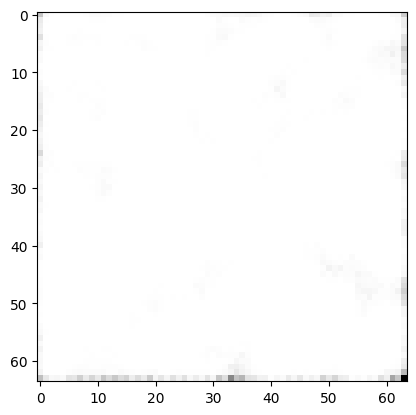

tensor([[0.0374, 0.0323, 0.0318, 0.0224, 0.0387, 0.0319, 0.0253, 0.0366, 0.0138,
         0.0238, 0.0213, 0.0258, 0.0183, 0.0201, 0.0312, 0.0342, 0.0217, 0.0334,
         0.0204, 0.0226, 0.0364, 0.0272, 0.0141, 0.0274, 0.0241, 0.0162, 0.0218,
         0.0243, 0.0322, 0.0263, 0.0151, 0.0204, 0.0228, 0.0256, 0.0271, 0.0214,
         0.0191, 0.0173, 0.0190, 0.0193]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.738006353378296
tensor([[0.0374, 0.0323, 0.0318, 0.0224, 0.0387, 0.0319, 0.0253, 0.0366, 0.0138,
         0.0238, 0.0213, 0.0258, 0.0183, 0.0201, 0.0311, 0.0342, 0.0217, 0.0334,
         0.0204, 0.0226, 0.0364, 0.0272, 0.0141, 0.0274, 0.0241, 0.0163, 0.0218,
         0.0243, 0.0322, 0.0263, 0.0151, 0.0204, 0.0228, 0.0256, 0.0271, 0.0214,
         0.0191, 0.0173, 0.0190, 0.0193]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.737691879272461
tensor([[0.0374, 0.0323, 0.0317, 0.0224, 0.0387, 0.0319, 0.0253, 0.0366, 0.0138,
         0.

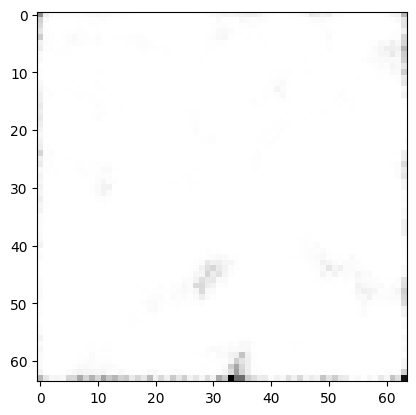

tensor([[0.0374, 0.0322, 0.0316, 0.0224, 0.0388, 0.0319, 0.0252, 0.0367, 0.0138,
         0.0239, 0.0213, 0.0258, 0.0183, 0.0202, 0.0310, 0.0341, 0.0217, 0.0335,
         0.0204, 0.0225, 0.0363, 0.0272, 0.0141, 0.0273, 0.0243, 0.0162, 0.0219,
         0.0243, 0.0321, 0.0263, 0.0150, 0.0205, 0.0228, 0.0255, 0.0273, 0.0215,
         0.0192, 0.0173, 0.0189, 0.0192]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.735808849334717
tensor([[0.0375, 0.0321, 0.0315, 0.0224, 0.0390, 0.0320, 0.0251, 0.0368, 0.0139,
         0.0239, 0.0213, 0.0257, 0.0183, 0.0202, 0.0310, 0.0340, 0.0218, 0.0336,
         0.0204, 0.0224, 0.0362, 0.0271, 0.0141, 0.0273, 0.0245, 0.0162, 0.0219,
         0.0244, 0.0321, 0.0262, 0.0149, 0.0206, 0.0228, 0.0254, 0.0275, 0.0216,
         0.0192, 0.0174, 0.0187, 0.0192]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.7338013648986816
tensor([[0.0379, 0.0317, 0.0309, 0.0222, 0.0407, 0.0321, 0.0245, 0.0371, 0.0140,
         0

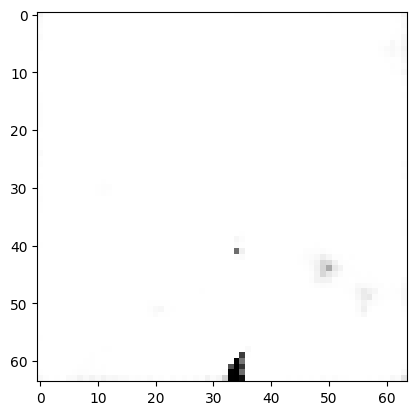

tensor([[0.0311, 0.0300, 0.0272, 0.0173, 0.0675, 0.0281, 0.0180, 0.0445, 0.0087,
         0.0265, 0.0137, 0.0266, 0.0220, 0.0173, 0.0270, 0.0282, 0.0304, 0.0286,
         0.0118, 0.0168, 0.0334, 0.0225, 0.0187, 0.0458, 0.0408, 0.0179, 0.0128,
         0.0385, 0.0263, 0.0138, 0.0141, 0.0242, 0.0238, 0.0221, 0.0281, 0.0159,
         0.0365, 0.0160, 0.0171, 0.0101]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.629507303237915
tensor([[0.0360, 0.0320, 0.0265, 0.0148, 0.0630, 0.0328, 0.0218, 0.0571, 0.0075,
         0.0251, 0.0142, 0.0229, 0.0187, 0.0118, 0.0306, 0.0381, 0.0310, 0.0384,
         0.0114, 0.0173, 0.0335, 0.0197, 0.0157, 0.0526, 0.0421, 0.0111, 0.0121,
         0.0438, 0.0282, 0.0130, 0.0099, 0.0183, 0.0219, 0.0176, 0.0275, 0.0139,
         0.0306, 0.0125, 0.0151, 0.0099]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.683022975921631
tensor([[0.0400, 0.0340, 0.0265, 0.0142, 0.0723, 0.0328, 0.0199, 0.0761, 0.0060,
         0.

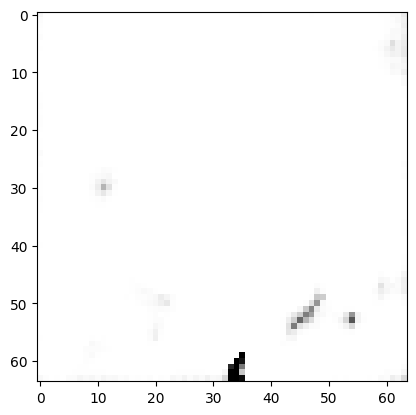

tensor([[0.0312, 0.0309, 0.0259, 0.0152, 0.0834, 0.0306, 0.0173, 0.0541, 0.0073,
         0.0298, 0.0120, 0.0242, 0.0223, 0.0131, 0.0261, 0.0277, 0.0289, 0.0294,
         0.0106, 0.0167, 0.0300, 0.0197, 0.0167, 0.0448, 0.0489, 0.0149, 0.0127,
         0.0417, 0.0273, 0.0112, 0.0110, 0.0248, 0.0241, 0.0198, 0.0285, 0.0138,
         0.0356, 0.0136, 0.0151, 0.0089]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.51301908493042
tensor([[0.0291, 0.0257, 0.0303, 0.0164, 0.0749, 0.0282, 0.0166, 0.0437, 0.0090,
         0.0249, 0.0112, 0.0252, 0.0250, 0.0169, 0.0256, 0.0248, 0.0352, 0.0261,
         0.0105, 0.0163, 0.0340, 0.0202, 0.0179, 0.0486, 0.0404, 0.0208, 0.0113,
         0.0390, 0.0276, 0.0121, 0.0167, 0.0223, 0.0235, 0.0226, 0.0275, 0.0130,
         0.0451, 0.0143, 0.0188, 0.0086]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.691044807434082
tensor([[0.0280, 0.0242, 0.0256, 0.0174, 0.0693, 0.0241, 0.0180, 0.0388, 0.0091,
         0.0

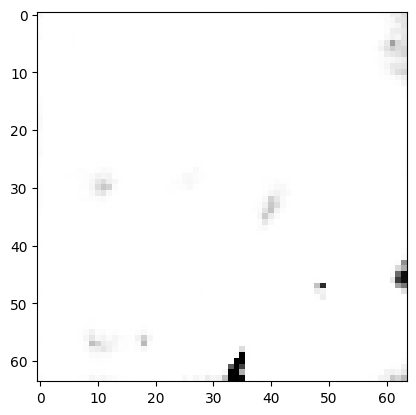

tensor([[0.0282, 0.0291, 0.0290, 0.0165, 0.0800, 0.0306, 0.0164, 0.0462, 0.0084,
         0.0273, 0.0120, 0.0263, 0.0234, 0.0168, 0.0257, 0.0272, 0.0338, 0.0265,
         0.0102, 0.0166, 0.0352, 0.0196, 0.0166, 0.0458, 0.0402, 0.0183, 0.0115,
         0.0406, 0.0250, 0.0121, 0.0148, 0.0236, 0.0225, 0.0217, 0.0292, 0.0136,
         0.0398, 0.0130, 0.0173, 0.0093]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.5997800827026367
tensor([[0.0270, 0.0251, 0.0277, 0.0162, 0.0754, 0.0290, 0.0184, 0.0405, 0.0080,
         0.0246, 0.0116, 0.0250, 0.0258, 0.0154, 0.0228, 0.0278, 0.0385, 0.0290,
         0.0094, 0.0154, 0.0377, 0.0177, 0.0199, 0.0500, 0.0440, 0.0183, 0.0114,
         0.0433, 0.0247, 0.0115, 0.0153, 0.0188, 0.0236, 0.0192, 0.0278, 0.0132,
         0.0502, 0.0136, 0.0179, 0.0094]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.706961154937744
tensor([[0.0294, 0.0293, 0.0291, 0.0148, 0.0787, 0.0333, 0.0177, 0.0481, 0.0075,
         0

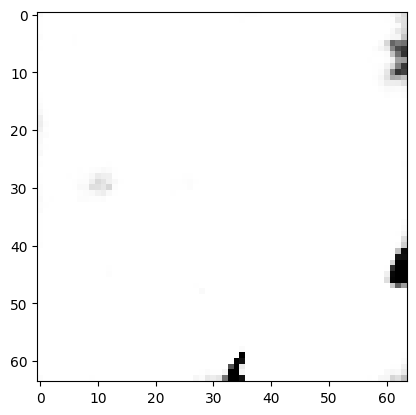

tensor([[0.0398, 0.0342, 0.0282, 0.0126, 0.0791, 0.0321, 0.0144, 0.0739, 0.0055,
         0.0353, 0.0138, 0.0208, 0.0160, 0.0096, 0.0257, 0.0408, 0.0324, 0.0279,
         0.0094, 0.0172, 0.0263, 0.0169, 0.0117, 0.0575, 0.0471, 0.0151, 0.0088,
         0.0403, 0.0251, 0.0120, 0.0080, 0.0211, 0.0216, 0.0199, 0.0258, 0.0106,
         0.0263, 0.0141, 0.0162, 0.0072]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.3444066047668457
tensor([[0.0337, 0.0332, 0.0309, 0.0126, 0.0855, 0.0337, 0.0138, 0.0652, 0.0056,
         0.0374, 0.0128, 0.0213, 0.0178, 0.0101, 0.0247, 0.0369, 0.0331, 0.0256,
         0.0085, 0.0181, 0.0274, 0.0156, 0.0115, 0.0560, 0.0469, 0.0178, 0.0083,
         0.0422, 0.0258, 0.0110, 0.0088, 0.0212, 0.0225, 0.0215, 0.0258, 0.0093,
         0.0303, 0.0127, 0.0182, 0.0070]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.2867488861083984
tensor([[0.0292, 0.0317, 0.0309, 0.0153, 0.0777, 0.0301, 0.0140, 0.0570, 0.0067,
         

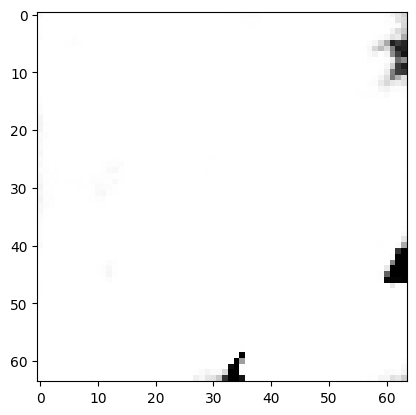

tensor([[0.0411, 0.0344, 0.0298, 0.0120, 0.0816, 0.0309, 0.0130, 0.0867, 0.0048,
         0.0365, 0.0139, 0.0191, 0.0146, 0.0083, 0.0230, 0.0439, 0.0352, 0.0264,
         0.0092, 0.0167, 0.0237, 0.0159, 0.0102, 0.0630, 0.0449, 0.0164, 0.0078,
         0.0375, 0.0240, 0.0110, 0.0073, 0.0211, 0.0218, 0.0191, 0.0231, 0.0091,
         0.0259, 0.0151, 0.0155, 0.0063]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.310671806335449
tensor([[0.0363, 0.0350, 0.0292, 0.0119, 0.0832, 0.0320, 0.0130, 0.0797, 0.0050,
         0.0400, 0.0138, 0.0195, 0.0155, 0.0084, 0.0242, 0.0452, 0.0351, 0.0262,
         0.0090, 0.0178, 0.0252, 0.0152, 0.0106, 0.0597, 0.0441, 0.0162, 0.0082,
         0.0388, 0.0254, 0.0113, 0.0073, 0.0215, 0.0218, 0.0195, 0.0245, 0.0091,
         0.0255, 0.0139, 0.0157, 0.0068]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.218557596206665
tensor([[0.0293, 0.0317, 0.0261, 0.0164, 0.0850, 0.0230, 0.0125, 0.0441, 0.0073,
         0.

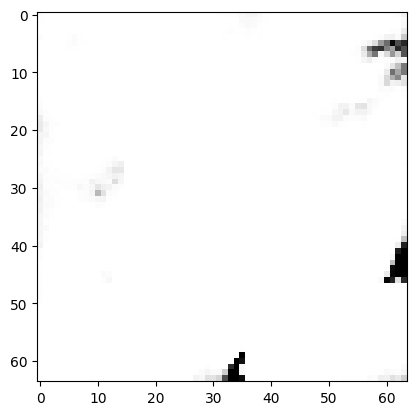

tensor([[0.0334, 0.0344, 0.0280, 0.0120, 0.0870, 0.0313, 0.0121, 0.0777, 0.0051,
         0.0441, 0.0134, 0.0198, 0.0158, 0.0084, 0.0246, 0.0450, 0.0342, 0.0252,
         0.0089, 0.0183, 0.0247, 0.0145, 0.0106, 0.0583, 0.0443, 0.0173, 0.0083,
         0.0383, 0.0260, 0.0110, 0.0071, 0.0231, 0.0225, 0.0196, 0.0247, 0.0092,
         0.0255, 0.0137, 0.0160, 0.0069]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.120253324508667
tensor([[0.0357, 0.0353, 0.0311, 0.0114, 0.0925, 0.0336, 0.0133, 0.0772, 0.0052,
         0.0423, 0.0121, 0.0195, 0.0162, 0.0080, 0.0231, 0.0401, 0.0352, 0.0256,
         0.0086, 0.0195, 0.0255, 0.0135, 0.0096, 0.0584, 0.0442, 0.0168, 0.0078,
         0.0389, 0.0245, 0.0105, 0.0074, 0.0217, 0.0210, 0.0201, 0.0249, 0.0080,
         0.0254, 0.0121, 0.0171, 0.0067]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.1629748344421387
tensor([[0.0323, 0.0348, 0.0267, 0.0125, 0.0948, 0.0273, 0.0109, 0.0528, 0.0052,
         0

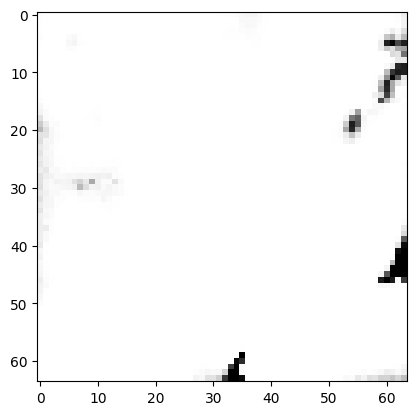

tensor([[0.0522, 0.0393, 0.0272, 0.0117, 0.0912, 0.0281, 0.0111, 0.0689, 0.0046,
         0.0364, 0.0109, 0.0197, 0.0160, 0.0078, 0.0220, 0.0414, 0.0356, 0.0267,
         0.0084, 0.0188, 0.0257, 0.0145, 0.0095, 0.0712, 0.0478, 0.0166, 0.0075,
         0.0319, 0.0197, 0.0101, 0.0081, 0.0261, 0.0207, 0.0185, 0.0226, 0.0090,
         0.0271, 0.0145, 0.0155, 0.0052]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.313267707824707
tensor([[0.0295, 0.0348, 0.0279, 0.0135, 0.0901, 0.0255, 0.0094, 0.0612, 0.0049,
         0.0441, 0.0115, 0.0200, 0.0186, 0.0088, 0.0235, 0.0426, 0.0399, 0.0210,
         0.0088, 0.0191, 0.0252, 0.0140, 0.0116, 0.0666, 0.0403, 0.0230, 0.0081,
         0.0358, 0.0270, 0.0101, 0.0104, 0.0270, 0.0217, 0.0211, 0.0241, 0.0082,
         0.0315, 0.0157, 0.0185, 0.0057]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.1209211349487305
tensor([[0.0241, 0.0315, 0.0273, 0.0148, 0.0880, 0.0220, 0.0088, 0.0535, 0.0055,
         0

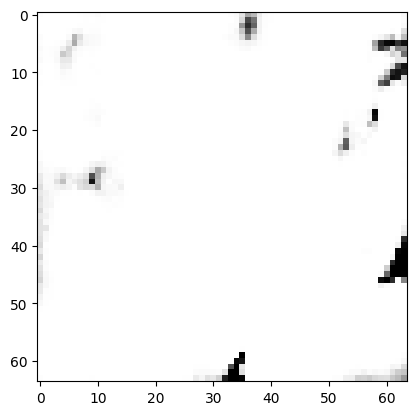

tensor([[0.0212, 0.0327, 0.0288, 0.0150, 0.0885, 0.0203, 0.0090, 0.0436, 0.0066,
         0.0537, 0.0092, 0.0205, 0.0255, 0.0103, 0.0215, 0.0376, 0.0481, 0.0168,
         0.0087, 0.0181, 0.0276, 0.0121, 0.0133, 0.0619, 0.0339, 0.0354, 0.0076,
         0.0409, 0.0285, 0.0099, 0.0149, 0.0235, 0.0200, 0.0245, 0.0250, 0.0066,
         0.0354, 0.0142, 0.0236, 0.0057]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.9237053394317627
tensor([[0.0247, 0.0336, 0.0278, 0.0123, 0.1014, 0.0242, 0.0084, 0.0659, 0.0049,
         0.0598, 0.0111, 0.0192, 0.0188, 0.0081, 0.0225, 0.0446, 0.0407, 0.0193,
         0.0089, 0.0186, 0.0238, 0.0114, 0.0096, 0.0665, 0.0334, 0.0262, 0.0071,
         0.0383, 0.0267, 0.0098, 0.0097, 0.0259, 0.0197, 0.0219, 0.0220, 0.0063,
         0.0271, 0.0143, 0.0202, 0.0052]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.816621780395508
tensor([[0.0181, 0.0306, 0.0276, 0.0166, 0.0937, 0.0184, 0.0088, 0.0462, 0.0069,
         0

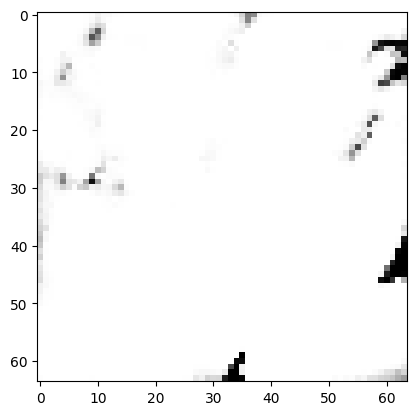

tensor([[0.0168, 0.0290, 0.0268, 0.0130, 0.0922, 0.0189, 0.0065, 0.0604, 0.0056,
         0.0773, 0.0108, 0.0182, 0.0196, 0.0080, 0.0232, 0.0528, 0.0438, 0.0145,
         0.0096, 0.0184, 0.0242, 0.0105, 0.0103, 0.0678, 0.0276, 0.0346, 0.0071,
         0.0372, 0.0313, 0.0100, 0.0100, 0.0253, 0.0185, 0.0221, 0.0213, 0.0055,
         0.0281, 0.0155, 0.0221, 0.0053]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.559648036956787
tensor([[0.0145, 0.0285, 0.0276, 0.0129, 0.1002, 0.0202, 0.0077, 0.0612, 0.0070,
         0.0880, 0.0098, 0.0175, 0.0253, 0.0067, 0.0168, 0.0502, 0.0394, 0.0130,
         0.0100, 0.0199, 0.0210, 0.0092, 0.0089, 0.0581, 0.0239, 0.0366, 0.0093,
         0.0403, 0.0332, 0.0106, 0.0105, 0.0270, 0.0173, 0.0192, 0.0237, 0.0060,
         0.0246, 0.0145, 0.0221, 0.0074]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.4300191402435303
tensor([[0.0180, 0.0348, 0.0244, 0.0104, 0.1206, 0.0261, 0.0095, 0.0755, 0.0057,
         0

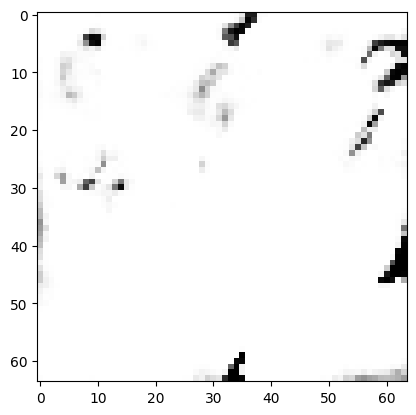

tensor([[0.0166, 0.0252, 0.0308, 0.0111, 0.1033, 0.0296, 0.0083, 0.1019, 0.0050,
         0.1089, 0.0103, 0.0161, 0.0190, 0.0036, 0.0115, 0.0607, 0.0317, 0.0117,
         0.0099, 0.0213, 0.0151, 0.0074, 0.0043, 0.0488, 0.0167, 0.0271, 0.0094,
         0.0430, 0.0336, 0.0101, 0.0068, 0.0286, 0.0134, 0.0151, 0.0222, 0.0048,
         0.0155, 0.0133, 0.0187, 0.0097]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.217170476913452
tensor([[0.0166, 0.0273, 0.0298, 0.0099, 0.0986, 0.0361, 0.0104, 0.0771, 0.0051,
         0.1058, 0.0119, 0.0194, 0.0211, 0.0037, 0.0099, 0.0601, 0.0293, 0.0125,
         0.0086, 0.0223, 0.0184, 0.0069, 0.0053, 0.0453, 0.0164, 0.0289, 0.0121,
         0.0411, 0.0306, 0.0106, 0.0072, 0.0336, 0.0179, 0.0136, 0.0253, 0.0063,
         0.0158, 0.0154, 0.0191, 0.0151]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.2466044425964355
tensor([[0.0190, 0.0278, 0.0287, 0.0101, 0.0979, 0.0403, 0.0108, 0.1114, 0.0050,
         0

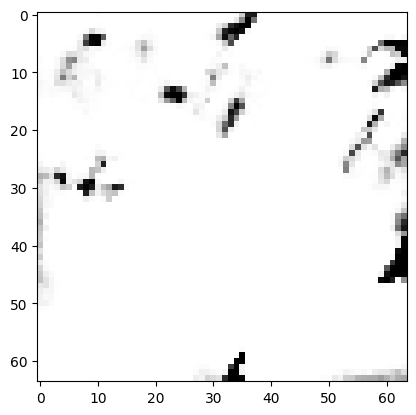

tensor([[0.0444, 0.0286, 0.0215, 0.0054, 0.1076, 0.0770, 0.0177, 0.1973, 0.0019,
         0.0754, 0.0110, 0.0107, 0.0139, 0.0012, 0.0063, 0.0641, 0.0224, 0.0155,
         0.0081, 0.0234, 0.0073, 0.0034, 0.0012, 0.0464, 0.0096, 0.0075, 0.0110,
         0.0353, 0.0168, 0.0055, 0.0020, 0.0330, 0.0089, 0.0067, 0.0193, 0.0041,
         0.0054, 0.0061, 0.0078, 0.0096]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.584721088409424
tensor([[0.0184, 0.0315, 0.0237, 0.0075, 0.1014, 0.0417, 0.0110, 0.1012, 0.0038,
         0.1326, 0.0101, 0.0174, 0.0207, 0.0023, 0.0084, 0.0705, 0.0237, 0.0106,
         0.0106, 0.0261, 0.0121, 0.0051, 0.0028, 0.0399, 0.0098, 0.0161, 0.0145,
         0.0372, 0.0281, 0.0084, 0.0047, 0.0531, 0.0117, 0.0105, 0.0227, 0.0057,
         0.0084, 0.0096, 0.0130, 0.0134]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.020721435546875
tensor([[0.0214, 0.0239, 0.0287, 0.0069, 0.0812, 0.0603, 0.0109, 0.1401, 0.0032,
         0.

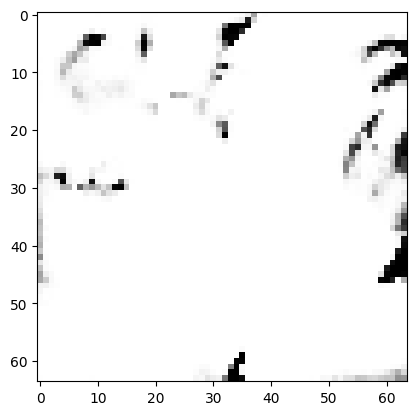

tensor([[0.0209, 0.0222, 0.0268, 0.0069, 0.0745, 0.0511, 0.0106, 0.1192, 0.0035,
         0.2081, 0.0104, 0.0125, 0.0149, 0.0013, 0.0051, 0.0625, 0.0147, 0.0084,
         0.0103, 0.0254, 0.0078, 0.0051, 0.0015, 0.0228, 0.0072, 0.0156, 0.0163,
         0.0330, 0.0333, 0.0100, 0.0034, 0.0359, 0.0105, 0.0099, 0.0244, 0.0044,
         0.0059, 0.0107, 0.0131, 0.0202]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5699561834335327
tensor([[0.0164, 0.0215, 0.0273, 0.0058, 0.0607, 0.0586, 0.0095, 0.1173, 0.0030,
         0.2712, 0.0106, 0.0119, 0.0117, 0.0008, 0.0040, 0.0645, 0.0107, 0.0068,
         0.0092, 0.0258, 0.0060, 0.0036, 0.0008, 0.0137, 0.0039, 0.0104, 0.0161,
         0.0280, 0.0287, 0.0093, 0.0022, 0.0462, 0.0078, 0.0070, 0.0213, 0.0033,
         0.0032, 0.0092, 0.0098, 0.0220]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3048843145370483
tensor([[0.0134, 0.0243, 0.0288, 0.0075, 0.0528, 0.0554, 0.0084, 0.0978, 0.0044,
         

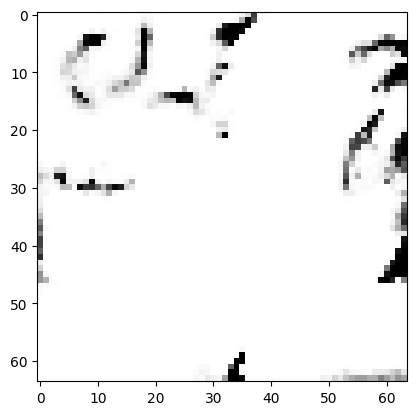

tensor([[1.5793e-02, 2.0869e-02, 2.8881e-02, 5.4333e-03, 4.0191e-02, 7.5525e-02,
         7.1497e-03, 1.1842e-01, 2.9471e-03, 3.8381e-01, 7.3535e-03, 9.3945e-03,
         9.9929e-03, 3.3792e-04, 1.8430e-03, 4.1054e-02, 4.8390e-03, 4.2560e-03,
         6.4843e-03, 2.2432e-02, 3.1512e-03, 2.6717e-03, 2.9088e-04, 5.5356e-03,
         2.2270e-03, 7.5569e-03, 1.7482e-02, 2.1084e-02, 2.2812e-02, 6.3854e-03,
         1.9165e-03, 2.7199e-02, 4.6676e-03, 5.3755e-03, 2.0194e-02, 1.6848e-03,
         1.3650e-03, 5.7863e-03, 8.4579e-03, 2.7152e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.9576079845428467
tensor([[0.0137, 0.0182, 0.0251, 0.0061, 0.0483, 0.0455, 0.0079, 0.1039, 0.0029,
         0.3766, 0.0087, 0.0105, 0.0119, 0.0005, 0.0023, 0.0455, 0.0074, 0.0048,
         0.0076, 0.0245, 0.0038, 0.0032, 0.0005, 0.0090, 0.0032, 0.0123, 0.0152,
         0.0225, 0.0273, 0.0071, 0.0028, 0.0409, 0.0077, 0.0060, 0.0187, 0.0028,
         0.0024, 0.0112, 0.0106, 0.0209]], 

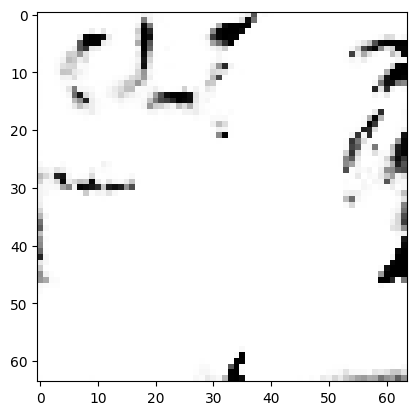

tensor([[1.0993e-02, 1.3252e-02, 2.5394e-02, 5.4418e-03, 2.4374e-02, 3.9519e-02,
         4.5072e-03, 8.3541e-02, 2.5551e-03, 5.4600e-01, 5.3412e-03, 6.9337e-03,
         7.0317e-03, 2.3221e-04, 1.0449e-03, 3.4208e-02, 3.4107e-03, 2.5745e-03,
         5.8317e-03, 1.7400e-02, 1.9775e-03, 2.1080e-03, 1.9400e-04, 3.5312e-03,
         1.7381e-03, 6.9776e-03, 1.4694e-02, 1.3957e-02, 2.5306e-02, 5.3307e-03,
         1.8006e-03, 2.0550e-02, 3.7828e-03, 4.4056e-03, 1.7009e-02, 1.2979e-03,
         1.0480e-03, 7.1025e-03, 6.7136e-03, 2.0886e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6051291227340698
tensor([[1.3700e-02, 1.2732e-02, 2.1568e-02, 5.2175e-03, 2.1766e-02, 3.4267e-02,
         4.3903e-03, 9.1295e-02, 1.9272e-03, 5.5545e-01, 5.5171e-03, 6.1433e-03,
         5.6889e-03, 1.7568e-04, 1.0226e-03, 3.9265e-02, 3.2797e-03, 2.4819e-03,
         6.3489e-03, 1.6877e-02, 1.7551e-03, 2.0133e-03, 1.5241e-04, 3.8519e-03,
         1.4707e-03, 5.5548e-03, 1.4209e-02

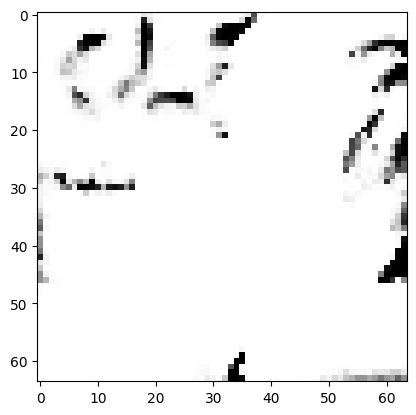

tensor([[1.4027e-02, 1.1395e-02, 2.4136e-02, 4.9867e-03, 1.9341e-02, 4.0708e-02,
         4.4418e-03, 8.7573e-02, 1.9405e-03, 5.7281e-01, 5.2047e-03, 5.9897e-03,
         5.1318e-03, 1.5302e-04, 8.1316e-04, 3.7253e-02, 2.9502e-03, 2.2772e-03,
         5.8759e-03, 1.5384e-02, 1.5493e-03, 1.8073e-03, 1.1676e-04, 3.0108e-03,
         1.1484e-03, 4.7305e-03, 1.3587e-02, 1.1073e-02, 2.4747e-02, 4.3516e-03,
         1.1930e-03, 1.6823e-02, 2.9087e-03, 3.8437e-03, 1.5092e-02, 9.5143e-04,
         9.0110e-04, 6.4575e-03, 5.5646e-03, 1.7755e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5572033524513245
tensor([[9.0123e-03, 9.5156e-03, 2.2007e-02, 4.6353e-03, 2.0884e-02, 2.9143e-02,
         3.5833e-03, 7.4515e-02, 2.1237e-03, 5.9121e-01, 5.3445e-03, 6.6326e-03,
         5.7422e-03, 2.1257e-04, 8.8815e-04, 3.6513e-02, 3.4126e-03, 1.9857e-03,
         6.2751e-03, 1.6327e-02, 1.8669e-03, 1.9988e-03, 1.7258e-04, 3.6167e-03,
         1.3838e-03, 6.6771e-03, 1.2631e-02

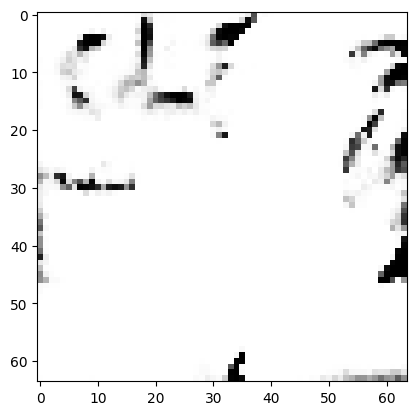

tensor([[8.4177e-03, 9.2441e-03, 2.1255e-02, 4.4909e-03, 1.8227e-02, 2.8469e-02,
         3.1839e-03, 7.1556e-02, 2.1353e-03, 6.1506e-01, 5.2159e-03, 6.3000e-03,
         5.2411e-03, 1.8665e-04, 8.2987e-04, 3.4073e-02, 2.8956e-03, 1.7838e-03,
         5.5379e-03, 1.5690e-02, 1.7042e-03, 1.8446e-03, 1.5009e-04, 3.1123e-03,
         1.2043e-03, 6.2855e-03, 1.2015e-02, 1.0062e-02, 2.4563e-02, 4.3838e-03,
         1.4482e-03, 2.1077e-02, 3.4884e-03, 3.6494e-03, 1.4119e-02, 1.1624e-03,
         9.2367e-04, 8.0721e-03, 5.6252e-03, 1.5315e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.4860331416130066
tensor([[1.0290e-02, 9.7554e-03, 2.1986e-02, 4.7925e-03, 1.6452e-02, 3.0165e-02,
         3.3803e-03, 7.4810e-02, 1.8184e-03, 6.2877e-01, 4.7908e-03, 5.2437e-03,
         4.5243e-03, 1.4842e-04, 7.0951e-04, 3.2583e-02, 2.5677e-03, 1.8224e-03,
         5.2356e-03, 1.3945e-02, 1.3646e-03, 1.6157e-03, 1.0732e-04, 2.6462e-03,
         1.0632e-03, 5.0719e-03, 1.1803e-02

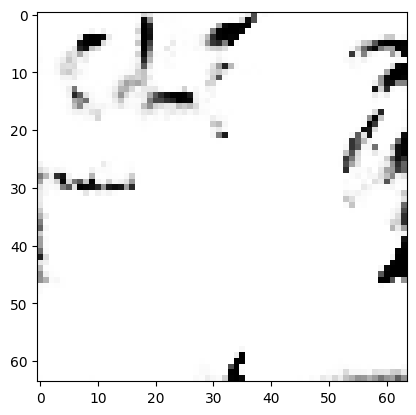

tensor([[7.8100e-03, 7.6756e-03, 2.0284e-02, 4.4419e-03, 1.5085e-02, 2.3203e-02,
         2.6834e-03, 6.0320e-02, 1.9290e-03, 6.6306e-01, 4.4781e-03, 5.1651e-03,
         4.3144e-03, 1.4894e-04, 6.1078e-04, 3.0327e-02, 2.4258e-03, 1.4892e-03,
         5.2196e-03, 1.3272e-02, 1.3479e-03, 1.5772e-03, 1.1130e-04, 2.4259e-03,
         1.0327e-03, 5.3289e-03, 1.1175e-02, 8.1425e-03, 2.4711e-02, 3.8881e-03,
         1.2459e-03, 1.6751e-02, 2.9305e-03, 3.2628e-03, 1.3248e-02, 9.2129e-04,
         8.3620e-04, 7.9888e-03, 5.0413e-03, 1.4096e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.41089725494384766
tensor([[7.3800e-03, 8.8678e-03, 1.9920e-02, 4.7077e-03, 1.5723e-02, 2.2131e-02,
         2.6921e-03, 5.8847e-02, 1.9874e-03, 6.6204e-01, 4.5022e-03, 5.2493e-03,
         4.7376e-03, 1.6672e-04, 6.9473e-04, 2.9427e-02, 2.4281e-03, 1.5624e-03,
         5.1496e-03, 1.3729e-02, 1.4215e-03, 1.6135e-03, 1.2470e-04, 2.5211e-03,
         1.1272e-03, 5.8753e-03, 1.1067e-0

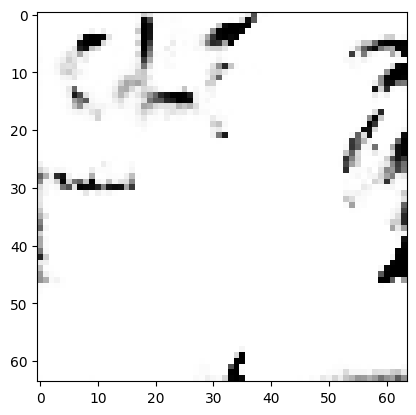

tensor([[7.1670e-03, 8.1856e-03, 1.9612e-02, 4.5841e-03, 1.3886e-02, 2.0857e-02,
         2.5652e-03, 5.2905e-02, 2.0151e-03, 6.7944e-01, 4.3607e-03, 5.2790e-03,
         4.5001e-03, 1.5726e-04, 6.2565e-04, 2.8762e-02, 2.2468e-03, 1.4531e-03,
         5.0280e-03, 1.2814e-02, 1.3581e-03, 1.5189e-03, 1.2024e-04, 2.2357e-03,
         1.0082e-03, 5.2981e-03, 1.1682e-02, 7.8994e-03, 2.3073e-02, 3.8907e-03,
         1.3820e-03, 1.6206e-02, 2.8752e-03, 3.1034e-03, 1.3281e-02, 9.6388e-04,
         8.0951e-04, 8.1133e-03, 4.8282e-03, 1.3908e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.38648200035095215
tensor([[7.9631e-03, 7.7303e-03, 2.0149e-02, 4.8010e-03, 1.3868e-02, 2.3082e-02,
         2.8366e-03, 5.6119e-02, 1.8429e-03, 6.8148e-01, 4.3375e-03, 4.6274e-03,
         4.3584e-03, 1.3939e-04, 5.5706e-04, 2.7291e-02, 2.1995e-03, 1.4557e-03,
         4.7076e-03, 1.3226e-02, 1.1631e-03, 1.4262e-03, 9.6474e-05, 2.1998e-03,
         9.8592e-04, 5.1380e-03, 1.0792e-0

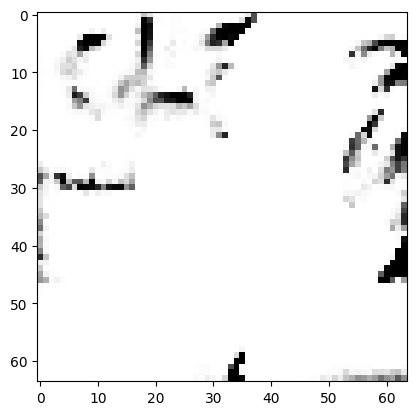

tensor([[7.4691e-03, 6.9346e-03, 2.0252e-02, 4.6621e-03, 1.2704e-02, 2.1105e-02,
         2.4509e-03, 5.4942e-02, 1.8037e-03, 6.8991e-01, 4.3255e-03, 4.6519e-03,
         3.9324e-03, 1.3361e-04, 5.2941e-04, 2.8063e-02, 2.2548e-03, 1.3376e-03,
         4.8813e-03, 1.2006e-02, 1.1948e-03, 1.3992e-03, 9.8141e-05, 2.1572e-03,
         9.1176e-04, 5.0232e-03, 1.0416e-02, 7.5155e-03, 2.3703e-02, 3.5495e-03,
         1.2243e-03, 1.3138e-02, 2.6282e-03, 2.9110e-03, 1.2451e-02, 7.9987e-04,
         8.0887e-04, 8.1368e-03, 4.5979e-03, 1.2984e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.37118929624557495
tensor([[7.0237e-03, 6.7105e-03, 1.8821e-02, 4.3813e-03, 1.2844e-02, 1.8939e-02,
         2.4337e-03, 5.0650e-02, 1.8577e-03, 6.9430e-01, 4.2735e-03, 4.7765e-03,
         4.0981e-03, 1.3568e-04, 5.3704e-04, 2.8424e-02, 2.2268e-03, 1.2972e-03,
         5.1655e-03, 1.2674e-02, 1.2379e-03, 1.4261e-03, 1.0386e-04, 2.1883e-03,
         8.8788e-04, 4.7982e-03, 1.0839e-0

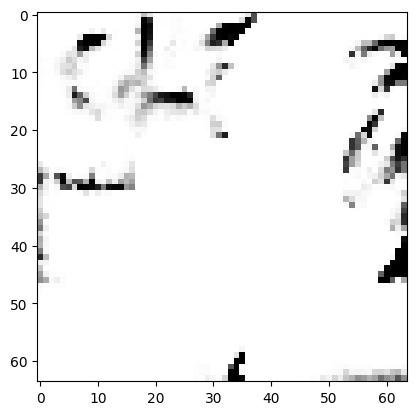

tensor([[6.4343e-03, 7.0680e-03, 1.8834e-02, 4.5744e-03, 1.2214e-02, 1.8222e-02,
         2.3000e-03, 4.5654e-02, 1.8835e-03, 7.0937e-01, 4.0630e-03, 4.4227e-03,
         4.0814e-03, 1.3882e-04, 5.1436e-04, 2.5392e-02, 2.0389e-03, 1.2473e-03,
         4.7212e-03, 1.1884e-02, 1.1838e-03, 1.3296e-03, 1.0004e-04, 1.9495e-03,
         9.2060e-04, 5.1424e-03, 1.0593e-02, 7.2949e-03, 2.3349e-02, 3.6796e-03,
         1.3487e-03, 1.3124e-02, 2.5912e-03, 2.9612e-03, 1.2586e-02, 8.1319e-04,
         7.7342e-04, 7.8644e-03, 4.6511e-03, 1.2687e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.34338057041168213
tensor([[7.0644e-03, 5.9231e-03, 1.8389e-02, 4.2794e-03, 1.1564e-02, 1.8711e-02,
         2.2732e-03, 5.1235e-02, 1.5881e-03, 7.0933e-01, 4.1546e-03, 4.1927e-03,
         3.4476e-03, 1.1028e-04, 4.6759e-04, 2.8109e-02, 2.0450e-03, 1.1766e-03,
         4.9087e-03, 1.1524e-02, 1.0875e-03, 1.3011e-03, 8.2377e-05, 2.0347e-03,
         7.6266e-04, 4.3408e-03, 9.9187e-0

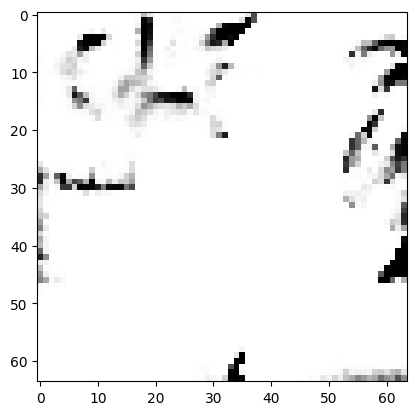

tensor([[6.7694e-03, 6.1599e-03, 1.8414e-02, 4.4445e-03, 1.1047e-02, 1.8679e-02,
         2.3546e-03, 4.7252e-02, 1.6888e-03, 7.2007e-01, 4.0375e-03, 4.1615e-03,
         3.6396e-03, 1.1233e-04, 4.4615e-04, 2.4882e-02, 1.8665e-03, 1.1831e-03,
         4.4914e-03, 1.1426e-02, 1.0161e-03, 1.2254e-03, 7.8597e-05, 1.8041e-03,
         7.6564e-04, 4.4435e-03, 1.0266e-02, 6.6432e-03, 2.2464e-02, 3.2403e-03,
         1.1607e-03, 1.2105e-02, 2.3776e-03, 2.6493e-03, 1.1738e-02, 7.3002e-04,
         7.0682e-04, 7.4583e-03, 4.2017e-03, 1.1798e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.328402042388916
tensor([[6.1240e-03, 5.6005e-03, 1.8319e-02, 4.2584e-03, 1.0869e-02, 1.7521e-02,
         2.2464e-03, 4.4303e-02, 1.7927e-03, 7.2305e-01, 3.9183e-03, 4.2722e-03,
         3.7223e-03, 1.1695e-04, 4.3306e-04, 2.5186e-02, 1.9270e-03, 1.1013e-03,
         4.6528e-03, 1.1325e-02, 1.0717e-03, 1.2535e-03, 8.6309e-05, 1.8178e-03,
         7.6580e-04, 4.5262e-03, 1.0218e-02,

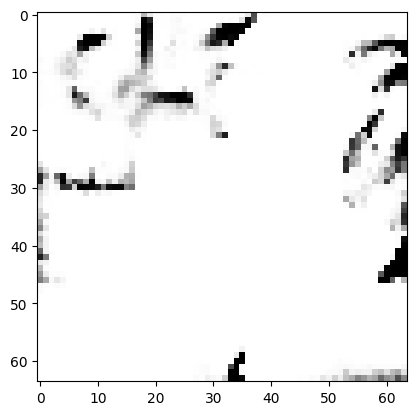

tensor([[5.9534e-03, 5.4951e-03, 1.8133e-02, 4.1708e-03, 1.0328e-02, 1.7415e-02,
         2.1540e-03, 4.2782e-02, 1.7494e-03, 7.3241e-01, 3.8682e-03, 4.0230e-03,
         3.5305e-03, 1.1190e-04, 4.1217e-04, 2.4165e-02, 1.8089e-03, 1.0637e-03,
         4.3899e-03, 1.0993e-02, 1.0176e-03, 1.1640e-03, 7.8678e-05, 1.6817e-03,
         7.1687e-04, 4.3637e-03, 9.8222e-03, 6.3047e-03, 2.3121e-02, 3.1387e-03,
         1.1195e-03, 1.1345e-02, 2.3026e-03, 2.4859e-03, 1.1582e-02, 7.0115e-04,
         6.8727e-04, 7.4135e-03, 3.9679e-03, 1.2027e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3114129900932312
tensor([[6.5026e-03, 5.3178e-03, 1.7376e-02, 4.2299e-03, 1.0259e-02, 1.7054e-02,
         2.1885e-03, 4.6164e-02, 1.5478e-03, 7.3189e-01, 3.9846e-03, 3.8251e-03,
         3.2798e-03, 1.0072e-04, 4.0861e-04, 2.5092e-02, 1.8127e-03, 1.0562e-03,
         4.5740e-03, 1.0936e-02, 9.5819e-04, 1.1582e-03, 7.1814e-05, 1.7566e-03,
         6.7073e-04, 4.0970e-03, 9.5121e-03

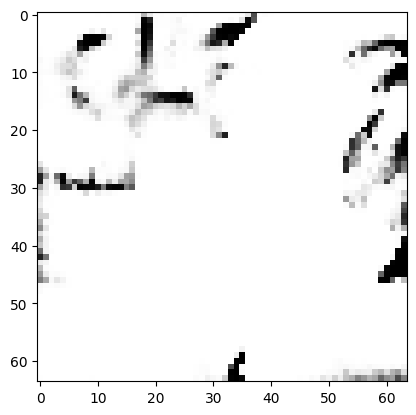

tensor([[6.0861e-03, 5.0791e-03, 1.7298e-02, 4.0119e-03, 9.7127e-03, 1.6935e-02,
         2.1062e-03, 4.3328e-02, 1.5858e-03, 7.3932e-01, 3.8507e-03, 3.8393e-03,
         3.2208e-03, 9.7620e-05, 3.8142e-04, 2.4479e-02, 1.7243e-03, 1.0014e-03,
         4.4089e-03, 1.0589e-02, 9.4766e-04, 1.1040e-03, 6.9953e-05, 1.6255e-03,
         6.3029e-04, 3.9600e-03, 9.6156e-03, 5.8535e-03, 2.3277e-02, 2.9129e-03,
         9.8911e-04, 1.1091e-02, 2.1967e-03, 2.3138e-03, 1.0878e-02, 6.5947e-04,
         6.5705e-04, 7.2413e-03, 3.6703e-03, 1.1253e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3020264506340027
tensor([[5.8804e-03, 5.3530e-03, 1.7928e-02, 4.1484e-03, 9.5966e-03, 1.7238e-02,
         2.1007e-03, 4.1704e-02, 1.6851e-03, 7.4133e-01, 3.8196e-03, 3.8465e-03,
         3.3511e-03, 1.0330e-04, 3.8937e-04, 2.3308e-02, 1.6722e-03, 1.0238e-03,
         4.1768e-03, 1.0836e-02, 9.5262e-04, 1.0865e-03, 7.0642e-05, 1.5448e-03,
         6.5255e-04, 4.1366e-03, 9.4358e-03

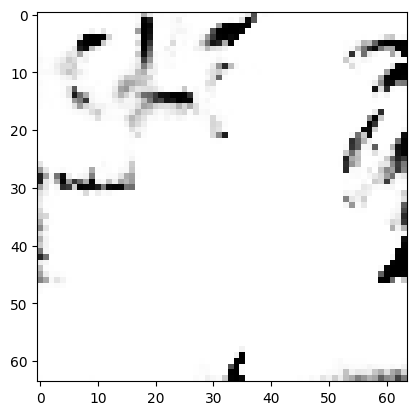

tensor([[5.7411e-03, 5.2501e-03, 1.7654e-02, 4.1353e-03, 9.4538e-03, 1.6734e-02,
         2.0651e-03, 4.1447e-02, 1.6364e-03, 7.4514e-01, 3.7795e-03, 3.7171e-03,
         3.2819e-03, 1.0138e-04, 3.8906e-04, 2.2982e-02, 1.6431e-03, 9.9705e-04,
         4.1533e-03, 1.0747e-02, 9.2843e-04, 1.0741e-03, 6.7949e-05, 1.5314e-03,
         6.3380e-04, 4.1176e-03, 9.1747e-03, 6.0917e-03, 2.2329e-02, 2.9827e-03,
         1.0678e-03, 1.0352e-02, 2.1309e-03, 2.3794e-03, 1.0885e-02, 6.2808e-04,
         6.3356e-04, 6.9142e-03, 3.7879e-03, 1.1238e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2941783666610718
tensor([[5.9900e-03, 4.7318e-03, 1.7146e-02, 4.0670e-03, 9.0346e-03, 1.6388e-02,
         2.0572e-03, 4.2713e-02, 1.5061e-03, 7.4752e-01, 3.7909e-03, 3.5985e-03,
         3.0059e-03, 9.0862e-05, 3.6515e-04, 2.3887e-02, 1.6553e-03, 9.5824e-04,
         4.3261e-03, 1.0405e-02, 8.7969e-04, 1.0521e-03, 6.3162e-05, 1.5486e-03,
         5.8436e-04, 3.8082e-03, 8.9625e-03

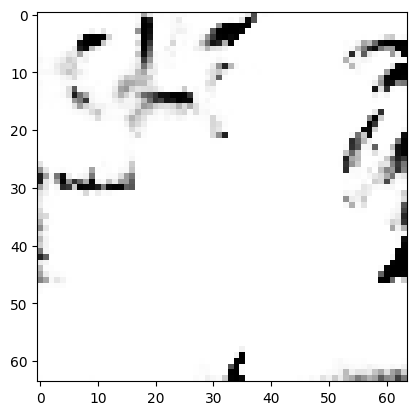

tensor([[5.8665e-03, 4.4229e-03, 1.6893e-02, 3.9695e-03, 8.5928e-03, 1.5757e-02,
         1.9758e-03, 4.1650e-02, 1.4539e-03, 7.5280e-01, 3.7460e-03, 3.5592e-03,
         2.8478e-03, 8.6175e-05, 3.4902e-04, 2.4223e-02, 1.6162e-03, 9.1602e-04,
         4.3016e-03, 1.0093e-02, 8.6369e-04, 1.0380e-03, 6.0238e-05, 1.5122e-03,
         5.4187e-04, 3.6365e-03, 8.7298e-03, 5.4362e-03, 2.3486e-02, 2.6923e-03,
         9.0864e-04, 9.8500e-03, 2.0137e-03, 2.1727e-03, 9.9998e-03, 5.8467e-04,
         6.2390e-04, 6.9848e-03, 3.4117e-03, 1.0333e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.28395575284957886
tensor([[5.9836e-03, 5.1030e-03, 1.6926e-02, 4.1182e-03, 8.4099e-03, 1.6124e-02,
         1.9912e-03, 3.9984e-02, 1.5412e-03, 7.5701e-01, 3.5994e-03, 3.5200e-03,
         3.0379e-03, 8.8609e-05, 3.6213e-04, 2.2486e-02, 1.4856e-03, 9.5141e-04,
         3.9846e-03, 1.0037e-02, 8.4364e-04, 9.9363e-04, 6.0294e-05, 1.3799e-03,
         5.5766e-04, 3.6678e-03, 9.1186e-0

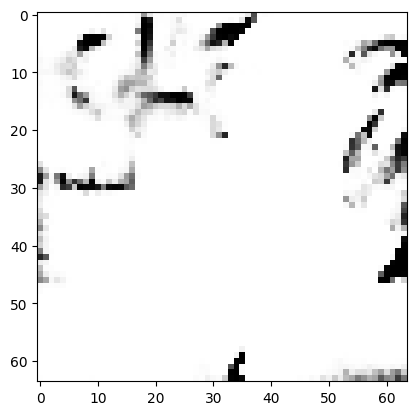

tensor([[5.6873e-03, 4.5350e-03, 1.6527e-02, 3.9144e-03, 8.2115e-03, 1.5141e-02,
         1.8302e-03, 3.9754e-02, 1.4412e-03, 7.5953e-01, 3.6050e-03, 3.5247e-03,
         2.8541e-03, 8.4761e-05, 3.4667e-04, 2.3639e-02, 1.5457e-03, 8.8766e-04,
         4.1299e-03, 9.7564e-03, 8.4762e-04, 1.0164e-03, 5.9441e-05, 1.4367e-03,
         5.1891e-04, 3.5622e-03, 8.7582e-03, 5.2058e-03, 2.2832e-02, 2.6757e-03,
         9.0581e-04, 9.9185e-03, 1.9652e-03, 2.1027e-03, 9.8124e-03, 5.7306e-04,
         5.9019e-04, 6.9350e-03, 3.3057e-03, 1.0032e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.27505388855934143
tensor([[5.7822e-03, 4.4896e-03, 1.6555e-02, 3.9897e-03, 8.1094e-03, 1.5017e-02,
         1.8907e-03, 3.8571e-02, 1.4243e-03, 7.6259e-01, 3.5936e-03, 3.3993e-03,
         2.7938e-03, 8.3107e-05, 3.4377e-04, 2.3515e-02, 1.4956e-03, 8.9753e-04,
         4.1127e-03, 9.7840e-03, 8.3358e-04, 9.9374e-04, 5.6553e-05, 1.4062e-03,
         5.1543e-04, 3.4933e-03, 8.4611e-0

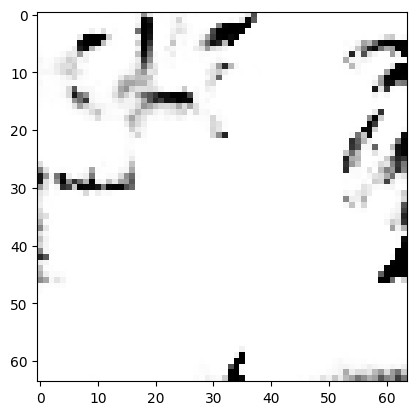

tensor([[5.8161e-03, 4.3740e-03, 1.6561e-02, 3.8668e-03, 8.0026e-03, 1.4974e-02,
         1.8251e-03, 3.7992e-02, 1.3993e-03, 7.6430e-01, 3.5477e-03, 3.4030e-03,
         2.7212e-03, 8.0099e-05, 3.3345e-04, 2.4006e-02, 1.5018e-03, 8.8376e-04,
         4.1165e-03, 9.4796e-03, 8.3105e-04, 9.7957e-04, 5.5461e-05, 1.3907e-03,
         4.9360e-04, 3.3693e-03, 8.4206e-03, 5.1169e-03, 2.2928e-02, 2.6095e-03,
         8.6006e-04, 9.0562e-03, 1.8610e-03, 2.0609e-03, 9.8673e-03, 5.2946e-04,
         5.8623e-04, 6.6662e-03, 3.1973e-03, 9.9368e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2687956690788269
tensor([[5.4338e-03, 4.5120e-03, 1.6184e-02, 3.8177e-03, 7.9156e-03, 1.4713e-02,
         1.7503e-03, 3.7231e-02, 1.4561e-03, 7.6636e-01, 3.4906e-03, 3.4743e-03,
         2.8421e-03, 8.3003e-05, 3.3860e-04, 2.3078e-02, 1.4707e-03, 8.5491e-04,
         4.0285e-03, 9.5297e-03, 8.3246e-04, 9.8247e-04, 5.7665e-05, 1.3555e-03,
         4.9411e-04, 3.4616e-03, 8.6362e-03

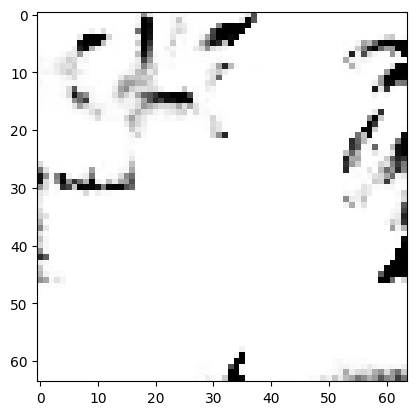

tensor([[5.3633e-03, 4.3150e-03, 1.5786e-02, 3.7634e-03, 7.7131e-03, 1.4277e-02,
         1.7191e-03, 3.6951e-02, 1.3948e-03, 7.7045e-01, 3.4718e-03, 3.3705e-03,
         2.7472e-03, 7.9338e-05, 3.2689e-04, 2.2917e-02, 1.4331e-03, 8.2422e-04,
         4.0061e-03, 9.4857e-03, 7.9773e-04, 9.6719e-04, 5.4369e-05, 1.3247e-03,
         4.6616e-04, 3.3375e-03, 8.4396e-03, 4.8362e-03, 2.2564e-02, 2.6174e-03,
         8.6831e-04, 9.5764e-03, 1.8506e-03, 2.0242e-03, 9.5170e-03, 5.3796e-04,
         5.5158e-04, 6.5694e-03, 3.1165e-03, 9.5911e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.26078417897224426
tensor([[5.7604e-03, 4.5563e-03, 1.5990e-02, 3.8890e-03, 7.7277e-03, 1.4677e-02,
         1.8241e-03, 3.5830e-02, 1.3883e-03, 7.7094e-01, 3.4341e-03, 3.2922e-03,
         2.7339e-03, 7.8227e-05, 3.3484e-04, 2.3081e-02, 1.3868e-03, 8.7881e-04,
         3.9745e-03, 9.3986e-03, 8.0240e-04, 9.3378e-04, 5.2656e-05, 1.2993e-03,
         4.7738e-04, 3.2561e-03, 8.4894e-0

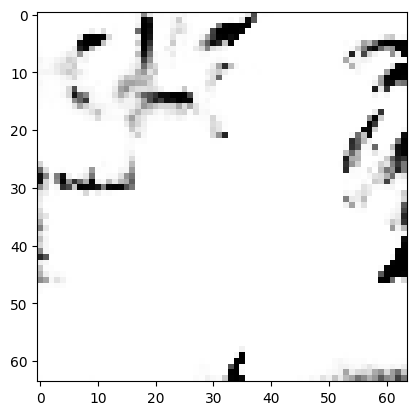

tensor([[5.2143e-03, 4.3869e-03, 1.6024e-02, 3.7878e-03, 7.7188e-03, 1.4018e-02,
         1.6809e-03, 3.4859e-02, 1.4134e-03, 7.7341e-01, 3.4240e-03, 3.3230e-03,
         2.7585e-03, 8.1654e-05, 3.3151e-04, 2.2712e-02, 1.4069e-03, 8.2629e-04,
         3.9376e-03, 9.3289e-03, 8.2114e-04, 9.5513e-04, 5.4751e-05, 1.3005e-03,
         4.7533e-04, 3.4239e-03, 8.1635e-03, 4.9679e-03, 2.2422e-02, 2.6752e-03,
         8.9664e-04, 9.0611e-03, 1.8301e-03, 2.0411e-03, 9.7754e-03, 5.2326e-04,
         5.5085e-04, 6.5129e-03, 3.1893e-03, 9.7131e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2569415867328644
tensor([[5.1845e-03, 4.3856e-03, 1.5401e-02, 3.7689e-03, 7.4726e-03, 1.3610e-02,
         1.6796e-03, 3.3842e-02, 1.4007e-03, 7.7750e-01, 3.3160e-03, 3.2838e-03,
         2.7463e-03, 7.8752e-05, 3.2854e-04, 2.2358e-02, 1.3441e-03, 8.1035e-04,
         3.9474e-03, 9.2535e-03, 7.9893e-04, 9.3413e-04, 5.3704e-05, 1.2591e-03,
         4.6268e-04, 3.2820e-03, 8.4386e-03

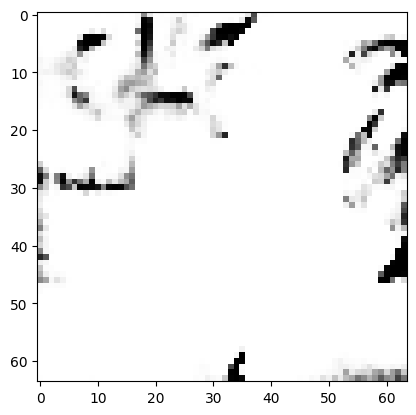

tensor([[5.0195e-03, 4.3069e-03, 1.5607e-02, 3.7845e-03, 7.5406e-03, 1.3477e-02,
         1.6353e-03, 3.3871e-02, 1.3989e-03, 7.7664e-01, 3.3606e-03, 3.3175e-03,
         2.7720e-03, 8.1382e-05, 3.3261e-04, 2.2431e-02, 1.3908e-03, 8.0481e-04,
         3.9241e-03, 9.3489e-03, 8.0839e-04, 9.5096e-04, 5.4427e-05, 1.2902e-03,
         4.6912e-04, 3.4133e-03, 8.1762e-03, 4.7961e-03, 2.2343e-02, 2.6930e-03,
         9.2016e-04, 9.3128e-03, 1.8418e-03, 2.0266e-03, 9.5933e-03, 5.3625e-04,
         5.4560e-04, 6.5703e-03, 3.1734e-03, 9.4378e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.25277459621429443
tensor([[5.3052e-03, 4.3622e-03, 1.5261e-02, 3.7061e-03, 7.4197e-03, 1.3754e-02,
         1.7203e-03, 3.3396e-02, 1.3811e-03, 7.7915e-01, 3.3152e-03, 3.2083e-03,
         2.6916e-03, 7.5934e-05, 3.2065e-04, 2.2380e-02, 1.2938e-03, 8.1988e-04,
         3.8694e-03, 9.2540e-03, 7.8460e-04, 9.0460e-04, 5.1314e-05, 1.2295e-03,
         4.5284e-04, 3.1652e-03, 8.4226e-0

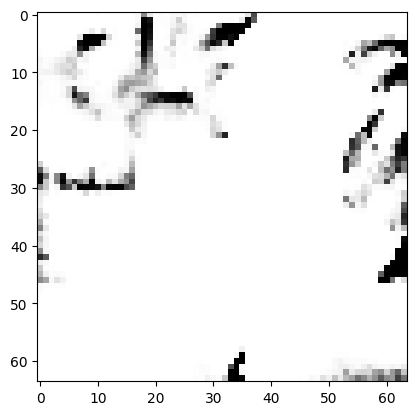

tensor([[5.2491e-03, 4.2958e-03, 1.4846e-02, 3.6619e-03, 7.2676e-03, 1.3390e-02,
         1.6732e-03, 3.2680e-02, 1.3456e-03, 7.8260e-01, 3.2823e-03, 3.1605e-03,
         2.6313e-03, 7.3590e-05, 3.1417e-04, 2.2266e-02, 1.2732e-03, 7.9757e-04,
         3.8536e-03, 9.0690e-03, 7.6888e-04, 8.9067e-04, 4.9931e-05, 1.2058e-03,
         4.3585e-04, 3.0884e-03, 8.3722e-03, 4.5900e-03, 2.1911e-02, 2.5712e-03,
         8.3441e-04, 8.8209e-03, 1.7385e-03, 1.9374e-03, 9.5533e-03, 5.0227e-04,
         5.0780e-04, 6.1100e-03, 2.9640e-03, 9.4216e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24513953924179077
tensor([[4.9728e-03, 4.2174e-03, 1.5218e-02, 3.7113e-03, 7.2872e-03, 1.3193e-02,
         1.5812e-03, 3.3315e-02, 1.3497e-03, 7.8142e-01, 3.3051e-03, 3.2175e-03,
         2.6704e-03, 7.7042e-05, 3.2147e-04, 2.2140e-02, 1.3424e-03, 7.7700e-04,
         3.8621e-03, 9.1091e-03, 7.7886e-04, 9.1747e-04, 5.1682e-05, 1.2445e-03,
         4.4196e-04, 3.2744e-03, 8.0756e-0

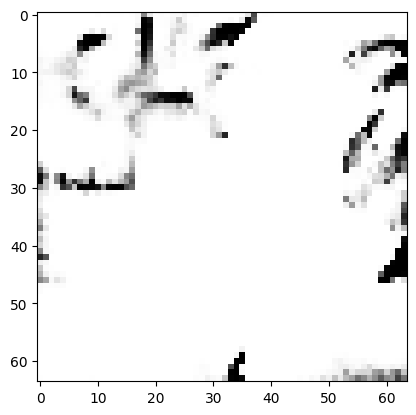

tensor([[4.9014e-03, 4.1881e-03, 1.4900e-02, 3.6444e-03, 7.1914e-03, 1.2970e-02,
         1.5761e-03, 3.2027e-02, 1.3433e-03, 7.8460e-01, 3.2461e-03, 3.1834e-03,
         2.6389e-03, 7.5522e-05, 3.1606e-04, 2.2012e-02, 1.2993e-03, 7.6656e-04,
         3.8353e-03, 8.9961e-03, 7.7581e-04, 8.9898e-04, 5.0816e-05, 1.2120e-03,
         4.3272e-04, 3.2037e-03, 8.1004e-03, 4.5404e-03, 2.2035e-02, 2.5938e-03,
         8.6536e-04, 8.9869e-03, 1.7485e-03, 1.9224e-03, 9.3940e-03, 5.1093e-04,
         5.1450e-04, 6.3007e-03, 3.0026e-03, 9.2025e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24258407950401306
tensor([[5.2622e-03, 4.2117e-03, 1.4583e-02, 3.6134e-03, 7.1237e-03, 1.3186e-02,
         1.6371e-03, 3.2699e-02, 1.2916e-03, 7.8504e-01, 3.2679e-03, 3.0820e-03,
         2.5317e-03, 7.0813e-05, 3.1039e-04, 2.2548e-02, 1.2553e-03, 7.8518e-04,
         3.8233e-03, 8.9262e-03, 7.5217e-04, 8.7398e-04, 4.7668e-05, 1.1992e-03,
         4.2011e-04, 3.0002e-03, 8.1517e-0

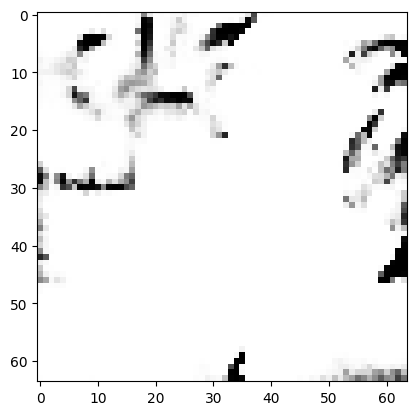

tensor([[5.0908e-03, 4.1241e-03, 1.4446e-02, 3.5632e-03, 7.0432e-03, 1.2891e-02,
         1.5943e-03, 3.2061e-02, 1.2806e-03, 7.8716e-01, 3.2431e-03, 3.0715e-03,
         2.5109e-03, 7.0406e-05, 3.0495e-04, 2.2314e-02, 1.2460e-03, 7.6547e-04,
         3.7992e-03, 8.9074e-03, 7.5086e-04, 8.6914e-04, 4.7557e-05, 1.1849e-03,
         4.1232e-04, 2.9989e-03, 8.0686e-03, 4.4210e-03, 2.1939e-02, 2.5153e-03,
         8.0191e-04, 8.7131e-03, 1.7110e-03, 1.8834e-03, 9.2509e-03, 4.8508e-04,
         4.9436e-04, 6.0543e-03, 2.8732e-03, 9.0378e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.23932181298732758
tensor([[4.9040e-03, 4.1575e-03, 1.4613e-02, 3.6565e-03, 7.0839e-03, 1.2666e-02,
         1.5671e-03, 3.1323e-02, 1.3390e-03, 7.8703e-01, 3.1982e-03, 3.1472e-03,
         2.6469e-03, 7.4209e-05, 3.1308e-04, 2.1788e-02, 1.2743e-03, 7.6101e-04,
         3.8136e-03, 8.9691e-03, 7.6070e-04, 8.8182e-04, 5.0137e-05, 1.1930e-03,
         4.2763e-04, 3.1314e-03, 8.1719e-0

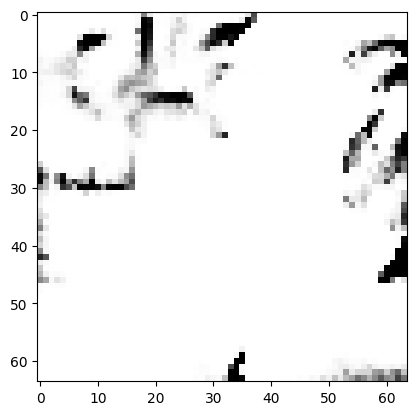

tensor([[4.8520e-03, 4.1372e-03, 1.4761e-02, 3.6615e-03, 7.0540e-03, 1.2667e-02,
         1.5387e-03, 3.1682e-02, 1.3311e-03, 7.8727e-01, 3.2059e-03, 3.1281e-03,
         2.6252e-03, 7.4479e-05, 3.1273e-04, 2.1625e-02, 1.2770e-03, 7.5536e-04,
         3.7718e-03, 8.9759e-03, 7.5675e-04, 8.8353e-04, 4.9741e-05, 1.1893e-03,
         4.2597e-04, 3.1746e-03, 7.9942e-03, 4.4416e-03, 2.1866e-02, 2.5665e-03,
         8.5984e-04, 8.9179e-03, 1.7394e-03, 1.8949e-03, 9.2344e-03, 5.0310e-04,
         5.0399e-04, 6.3075e-03, 2.9600e-03, 9.0281e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.23918817937374115
tensor([[5.1123e-03, 4.1189e-03, 1.4280e-02, 3.5737e-03, 6.9750e-03, 1.2814e-02,
         1.5915e-03, 3.1857e-02, 1.2835e-03, 7.8920e-01, 3.1989e-03, 3.0260e-03,
         2.5061e-03, 6.8862e-05, 3.0208e-04, 2.2005e-02, 1.2109e-03, 7.5737e-04,
         3.7520e-03, 8.8369e-03, 7.3393e-04, 8.5347e-04, 4.6374e-05, 1.1619e-03,
         4.0813e-04, 2.9577e-03, 8.0410e-0

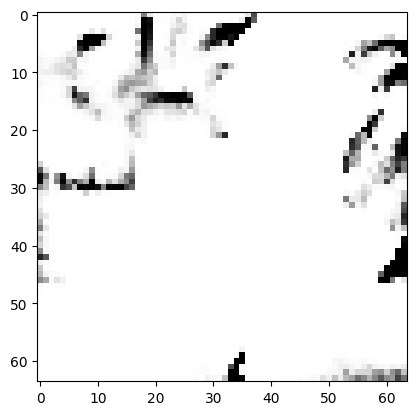

tensor([[4.9693e-03, 4.0503e-03, 1.4138e-02, 3.5513e-03, 6.8343e-03, 1.2528e-02,
         1.5462e-03, 3.1352e-02, 1.2766e-03, 7.9139e-01, 3.1481e-03, 3.0300e-03,
         2.4898e-03, 6.8410e-05, 2.9901e-04, 2.1804e-02, 1.2065e-03, 7.3970e-04,
         3.7443e-03, 8.7650e-03, 7.2833e-04, 8.4769e-04, 4.6375e-05, 1.1460e-03,
         3.9949e-04, 2.9361e-03, 8.0173e-03, 4.2600e-03, 2.1576e-02, 2.4645e-03,
         7.9308e-04, 8.6856e-03, 1.6670e-03, 1.8290e-03, 9.0688e-03, 4.7911e-04,
         4.7752e-04, 6.0082e-03, 2.7833e-03, 8.8503e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.23395931720733643
tensor([[4.8584e-03, 4.1009e-03, 1.4320e-02, 3.6212e-03, 6.9165e-03, 1.2375e-02,
         1.5374e-03, 3.0917e-02, 1.2986e-03, 7.9110e-01, 3.1420e-03, 3.0379e-03,
         2.5571e-03, 7.1369e-05, 3.0546e-04, 2.1540e-02, 1.2224e-03, 7.4632e-04,
         3.7363e-03, 8.8412e-03, 7.3889e-04, 8.5661e-04, 4.7679e-05, 1.1552e-03,
         4.1284e-04, 3.0466e-03, 7.9369e-0

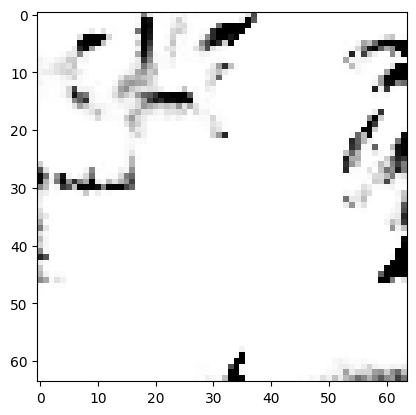

tensor([[4.8529e-03, 4.0469e-03, 1.4176e-02, 3.5733e-03, 6.8663e-03, 1.2358e-02,
         1.5460e-03, 3.1270e-02, 1.2863e-03, 7.9232e-01, 3.1504e-03, 3.0118e-03,
         2.5310e-03, 6.9882e-05, 2.9965e-04, 2.1362e-02, 1.1940e-03, 7.4215e-04,
         3.6730e-03, 8.8649e-03, 7.2508e-04, 8.4552e-04, 4.6649e-05, 1.1390e-03,
         4.0320e-04, 2.9966e-03, 7.8832e-03, 4.3354e-03, 2.1339e-02, 2.4635e-03,
         8.0724e-04, 8.6647e-03, 1.6869e-03, 1.8352e-03, 9.0058e-03, 4.7857e-04,
         4.7754e-04, 6.0295e-03, 2.8190e-03, 8.8227e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2327883243560791
tensor([[5.1754e-03, 4.0132e-03, 1.3921e-02, 3.5318e-03, 6.7397e-03, 1.2496e-02,
         1.5533e-03, 3.1566e-02, 1.2265e-03, 7.9243e-01, 3.1688e-03, 2.9817e-03,
         2.4055e-03, 6.5381e-05, 2.9594e-04, 2.2323e-02, 1.1958e-03, 7.4422e-04,
         3.7443e-03, 8.6594e-03, 7.1442e-04, 8.3218e-04, 4.4074e-05, 1.1431e-03,
         3.8709e-04, 2.8131e-03, 7.9454e-03

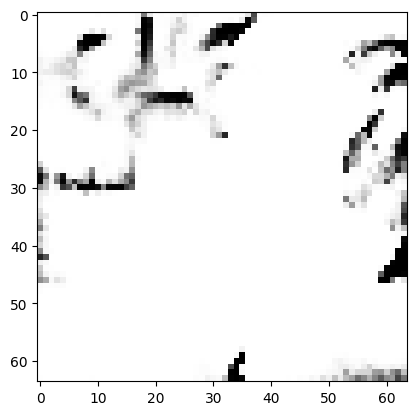

tensor([[5.0476e-03, 4.0175e-03, 1.3749e-02, 3.5494e-03, 6.6694e-03, 1.2292e-02,
         1.5458e-03, 3.0953e-02, 1.2409e-03, 7.9471e-01, 3.1213e-03, 2.9448e-03,
         2.4356e-03, 6.5660e-05, 2.9350e-04, 2.1712e-02, 1.1733e-03, 7.3192e-04,
         3.6892e-03, 8.6773e-03, 7.0400e-04, 8.2317e-04, 4.4180e-05, 1.1196e-03,
         3.8729e-04, 2.8273e-03, 7.9283e-03, 4.1541e-03, 2.1239e-02, 2.4206e-03,
         7.7190e-04, 8.5170e-03, 1.6236e-03, 1.7924e-03, 8.9249e-03, 4.6675e-04,
         4.6388e-04, 5.8868e-03, 2.6821e-03, 8.5993e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22977198660373688
tensor([[4.8759e-03, 4.0075e-03, 1.3902e-02, 3.5451e-03, 6.6917e-03, 1.2197e-02,
         1.5322e-03, 3.0774e-02, 1.2605e-03, 7.9504e-01, 3.1169e-03, 2.9564e-03,
         2.4865e-03, 6.7537e-05, 2.9479e-04, 2.1354e-02, 1.1720e-03, 7.3169e-04,
         3.6294e-03, 8.7860e-03, 7.0909e-04, 8.2653e-04, 4.5274e-05, 1.1176e-03,
         3.9139e-04, 2.9019e-03, 7.8357e-0

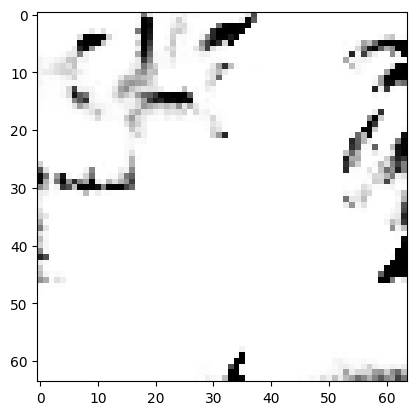

tensor([[4.8768e-03, 4.0227e-03, 1.3810e-02, 3.5637e-03, 6.6413e-03, 1.2155e-02,
         1.5366e-03, 3.0666e-02, 1.2527e-03, 7.9622e-01, 3.1121e-03, 2.9208e-03,
         2.4768e-03, 6.7079e-05, 2.9321e-04, 2.1078e-02, 1.1550e-03, 7.2919e-04,
         3.6021e-03, 8.7510e-03, 7.0098e-04, 8.1624e-04, 4.4606e-05, 1.1014e-03,
         3.8943e-04, 2.8875e-03, 7.8366e-03, 4.2126e-03, 2.0985e-02, 2.4198e-03,
         7.8545e-04, 8.4207e-03, 1.6378e-03, 1.7872e-03, 8.8857e-03, 4.6539e-04,
         4.6152e-04, 5.8954e-03, 2.7135e-03, 8.6228e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22787904739379883
tensor([[4.9776e-03, 3.9903e-03, 1.3569e-02, 3.5066e-03, 6.5615e-03, 1.2191e-02,
         1.5361e-03, 3.0691e-02, 1.2316e-03, 7.9672e-01, 3.1018e-03, 2.9158e-03,
         2.4186e-03, 6.4767e-05, 2.9026e-04, 2.1426e-02, 1.1479e-03, 7.2371e-04,
         3.6388e-03, 8.6410e-03, 6.9377e-04, 8.0808e-04, 4.3461e-05, 1.0953e-03,
         3.8010e-04, 2.7861e-03, 7.9444e-0

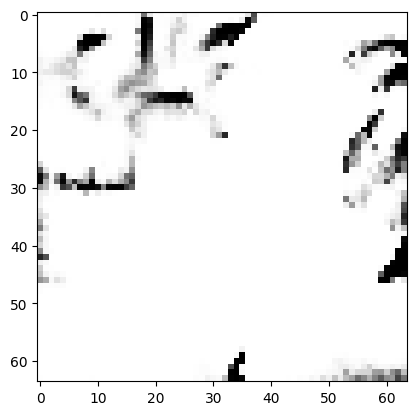

tensor([[4.9431e-03, 3.9636e-03, 1.3374e-02, 3.4948e-03, 6.4975e-03, 1.2042e-02,
         1.5326e-03, 3.0481e-02, 1.2231e-03, 7.9843e-01, 3.0937e-03, 2.8719e-03,
         2.4143e-03, 6.4232e-05, 2.8777e-04, 2.1229e-02, 1.1299e-03, 7.1623e-04,
         3.5997e-03, 8.6595e-03, 6.8235e-04, 7.9738e-04, 4.2777e-05, 1.0820e-03,
         3.7604e-04, 2.7538e-03, 7.9202e-03, 4.0439e-03, 2.0797e-02, 2.3679e-03,
         7.5230e-04, 8.4339e-03, 1.6060e-03, 1.7420e-03, 8.7746e-03, 4.6025e-04,
         4.4817e-04, 5.7981e-03, 2.5946e-03, 8.4815e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22511038184165955
tensor([[4.8699e-03, 3.9649e-03, 1.3460e-02, 3.5059e-03, 6.4784e-03, 1.2001e-02,
         1.5268e-03, 3.0294e-02, 1.2289e-03, 7.9892e-01, 3.0932e-03, 2.8714e-03,
         2.4370e-03, 6.4875e-05, 2.8736e-04, 2.0963e-02, 1.1282e-03, 7.1495e-04,
         3.5612e-03, 8.6919e-03, 6.8339e-04, 7.9631e-04, 4.3106e-05, 1.0763e-03,
         3.7676e-04, 2.7843e-03, 7.8914e-0

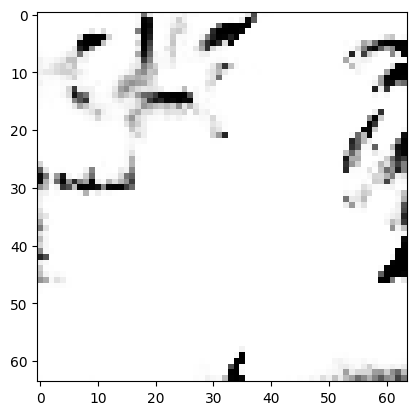

tensor([[4.8345e-03, 3.9725e-03, 1.3444e-02, 3.5101e-03, 6.4299e-03, 1.1989e-02,
         1.5282e-03, 3.0009e-02, 1.2381e-03, 7.9984e-01, 3.0920e-03, 2.8673e-03,
         2.4528e-03, 6.5023e-05, 2.8598e-04, 2.0634e-02, 1.1126e-03, 7.1453e-04,
         3.5241e-03, 8.7311e-03, 6.7824e-04, 7.8991e-04, 4.2939e-05, 1.0605e-03,
         3.7619e-04, 2.7786e-03, 7.9384e-03, 4.0431e-03, 2.0537e-02, 2.3645e-03,
         7.6294e-04, 8.3521e-03, 1.6157e-03, 1.7304e-03, 8.7824e-03, 4.6080e-04,
         4.4697e-04, 5.8231e-03, 2.6026e-03, 8.5368e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2233409434556961
tensor([[4.9641e-03, 3.9251e-03, 1.3098e-02, 3.4732e-03, 6.4005e-03, 1.1902e-02,
         1.5491e-03, 3.0169e-02, 1.2054e-03, 8.0044e-01, 3.0884e-03, 2.8236e-03,
         2.3921e-03, 6.2929e-05, 2.8412e-04, 2.1060e-02, 1.1051e-03, 7.1149e-04,
         3.5751e-03, 8.6671e-03, 6.6770e-04, 7.8310e-04, 4.1628e-05, 1.0664e-03,
         3.7001e-04, 2.6806e-03, 7.9639e-03

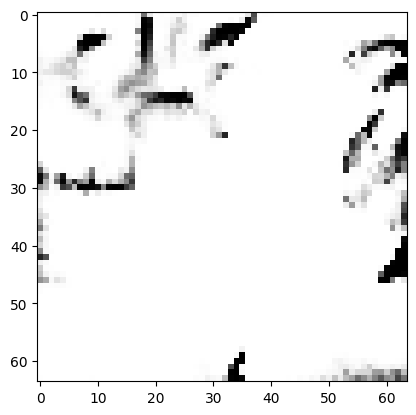

tensor([[4.9610e-03, 3.9341e-03, 1.2979e-02, 3.4720e-03, 6.3711e-03, 1.1831e-02,
         1.5533e-03, 2.9872e-02, 1.2039e-03, 8.0154e-01, 3.0789e-03, 2.8029e-03,
         2.3955e-03, 6.2697e-05, 2.8322e-04, 2.0846e-02, 1.0893e-03, 7.1239e-04,
         3.5436e-03, 8.6937e-03, 6.6194e-04, 7.7523e-04, 4.1283e-05, 1.0573e-03,
         3.7027e-04, 2.6665e-03, 8.0027e-03, 3.9428e-03, 2.0334e-02, 2.3337e-03,
         7.4022e-04, 8.3419e-03, 1.5959e-03, 1.7135e-03, 8.7183e-03, 4.5719e-04,
         4.3791e-04, 5.7110e-03, 2.5264e-03, 8.3476e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2212226241827011
tensor([[4.8168e-03, 3.8501e-03, 1.3026e-02, 3.4621e-03, 6.3347e-03, 1.1647e-02,
         1.5222e-03, 3.0024e-02, 1.2006e-03, 8.0195e-01, 3.0832e-03, 2.8131e-03,
         2.4027e-03, 6.3442e-05, 2.8124e-04, 2.0732e-02, 1.1006e-03, 6.9900e-04,
         3.5304e-03, 8.7377e-03, 6.6175e-04, 7.8303e-04, 4.1743e-05, 1.0623e-03,
         3.6743e-04, 2.7034e-03, 7.8633e-03

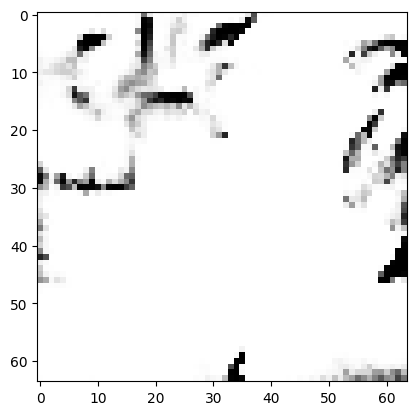

tensor([[4.8481e-03, 3.8319e-03, 1.2799e-02, 3.4378e-03, 6.2545e-03, 1.1570e-02,
         1.5344e-03, 2.9970e-02, 1.1844e-03, 8.0341e-01, 3.0689e-03, 2.7814e-03,
         2.3774e-03, 6.2156e-05, 2.7779e-04, 2.0588e-02, 1.0770e-03, 6.9381e-04,
         3.5124e-03, 8.7088e-03, 6.4817e-04, 7.7200e-04, 4.0657e-05, 1.0467e-03,
         3.6088e-04, 2.6393e-03, 7.9333e-03, 3.8654e-03, 2.0229e-02, 2.2907e-03,
         7.3407e-04, 8.3860e-03, 1.6007e-03, 1.6952e-03, 8.4981e-03, 4.5619e-04,
         4.3449e-04, 5.7326e-03, 2.4873e-03, 8.1582e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21888674795627594
tensor([[4.8935e-03, 3.8969e-03, 1.2873e-02, 3.4529e-03, 6.2485e-03, 1.1625e-02,
         1.5360e-03, 2.9661e-02, 1.1876e-03, 8.0372e-01, 3.0624e-03, 2.7783e-03,
         2.3798e-03, 6.1833e-05, 2.7822e-04, 2.0411e-02, 1.0630e-03, 7.0112e-04,
         3.4980e-03, 8.6634e-03, 6.5008e-04, 7.6339e-04, 4.0539e-05, 1.0329e-03,
         3.6187e-04, 2.6304e-03, 8.0244e-0

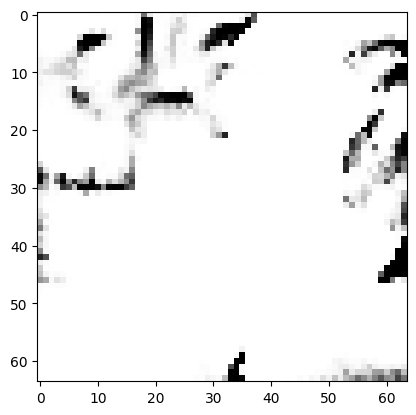

tensor([[4.8300e-03, 3.8441e-03, 1.2762e-02, 3.4436e-03, 6.1608e-03, 1.1473e-02,
         1.5217e-03, 2.9715e-02, 1.1785e-03, 8.0505e-01, 3.0560e-03, 2.7593e-03,
         2.3660e-03, 6.1472e-05, 2.7488e-04, 2.0172e-02, 1.0538e-03, 6.9031e-04,
         3.4583e-03, 8.6831e-03, 6.3995e-04, 7.5993e-04, 4.0052e-05, 1.0237e-03,
         3.5777e-04, 2.6206e-03, 7.9693e-03, 3.8095e-03, 1.9990e-02, 2.2713e-03,
         7.2848e-04, 8.2886e-03, 1.5961e-03, 1.6770e-03, 8.4631e-03, 4.5317e-04,
         4.2759e-04, 5.7319e-03, 2.4631e-03, 8.1365e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21685302257537842
tensor([[4.8634e-03, 3.8343e-03, 1.2554e-02, 3.4081e-03, 6.1606e-03, 1.1456e-02,
         1.5432e-03, 2.9700e-02, 1.1689e-03, 8.0556e-01, 3.0536e-03, 2.7322e-03,
         2.3508e-03, 6.0745e-05, 2.7414e-04, 2.0270e-02, 1.0407e-03, 6.8956e-04,
         3.4573e-03, 8.6837e-03, 6.3505e-04, 7.5579e-04, 3.9525e-05, 1.0238e-03,
         3.5581e-04, 2.5810e-03, 7.9993e-0

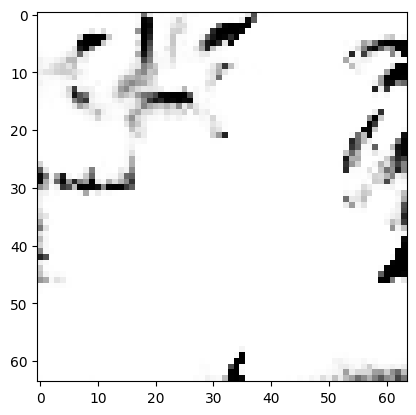

tensor([[4.8460e-03, 3.8278e-03, 1.2437e-02, 3.3854e-03, 6.0981e-03, 1.1435e-02,
         1.5419e-03, 2.9522e-02, 1.1659e-03, 8.0687e-01, 3.0394e-03, 2.7066e-03,
         2.3352e-03, 5.9907e-05, 2.7103e-04, 1.9991e-02, 1.0183e-03, 6.8367e-04,
         3.4231e-03, 8.6596e-03, 6.2686e-04, 7.4592e-04, 3.8909e-05, 1.0058e-03,
         3.5264e-04, 2.5530e-03, 8.0457e-03, 3.7557e-03, 1.9686e-02, 2.2466e-03,
         7.1222e-04, 8.2563e-03, 1.5813e-03, 1.6626e-03, 8.4345e-03, 4.4767e-04,
         4.1464e-04, 5.5890e-03, 2.4163e-03, 8.1092e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21458932757377625
tensor([[4.7603e-03, 3.7781e-03, 1.2566e-02, 3.3987e-03, 6.0690e-03, 1.1360e-02,
         1.5140e-03, 2.9435e-02, 1.1758e-03, 8.0699e-01, 3.0341e-03, 2.7199e-03,
         2.3494e-03, 6.0482e-05, 2.6973e-04, 1.9815e-02, 1.0313e-03, 6.7560e-04,
         3.4190e-03, 8.6658e-03, 6.2729e-04, 7.4928e-04, 3.9450e-05, 1.0066e-03,
         3.5382e-04, 2.5896e-03, 8.0016e-0

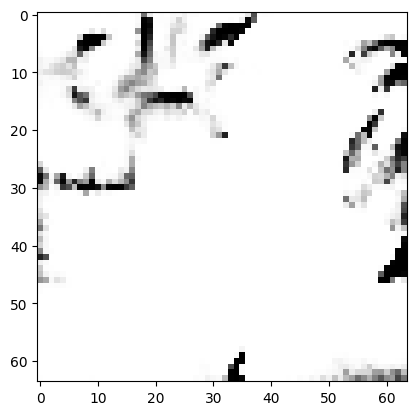

tensor([[4.7625e-03, 3.7694e-03, 1.2414e-02, 3.3792e-03, 6.0158e-03, 1.1302e-02,
         1.5157e-03, 2.9418e-02, 1.1644e-03, 8.0816e-01, 3.0344e-03, 2.6901e-03,
         2.3348e-03, 5.9635e-05, 2.6687e-04, 1.9657e-02, 1.0142e-03, 6.6913e-04,
         3.3887e-03, 8.6475e-03, 6.1811e-04, 7.4173e-04, 3.8689e-05, 9.9431e-04,
         3.4950e-04, 2.5594e-03, 8.0078e-03, 3.6989e-03, 1.9638e-02, 2.2291e-03,
         7.1239e-04, 8.2482e-03, 1.5807e-03, 1.6467e-03, 8.3450e-03, 4.4785e-04,
         4.1235e-04, 5.6421e-03, 2.3971e-03, 8.0345e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21300137042999268
tensor([[4.8364e-03, 3.7842e-03, 1.2237e-02, 3.3553e-03, 6.0148e-03, 1.1332e-02,
         1.5332e-03, 2.9442e-02, 1.1501e-03, 8.0856e-01, 3.0272e-03, 2.6590e-03,
         2.3062e-03, 5.8677e-05, 2.6700e-04, 1.9822e-02, 1.0019e-03, 6.7197e-04,
         3.3888e-03, 8.6273e-03, 6.1296e-04, 7.3453e-04, 3.7932e-05, 9.9263e-04,
         3.4709e-04, 2.5106e-03, 8.0351e-0

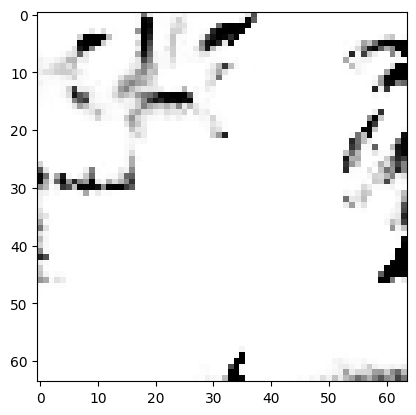

tensor([[4.8374e-03, 3.7653e-03, 1.2162e-02, 3.3455e-03, 5.9737e-03, 1.1276e-02,
         1.5299e-03, 2.9436e-02, 1.1395e-03, 8.0938e-01, 3.0226e-03, 2.6386e-03,
         2.2918e-03, 5.8120e-05, 2.6514e-04, 1.9754e-02, 9.9438e-04, 6.6833e-04,
         3.3693e-03, 8.5999e-03, 6.0608e-04, 7.3021e-04, 3.7391e-05, 9.8627e-04,
         3.4368e-04, 2.4902e-03, 8.0113e-03, 3.6587e-03, 1.9399e-02, 2.2069e-03,
         6.9494e-04, 8.2039e-03, 1.5607e-03, 1.6339e-03, 8.2967e-03, 4.4019e-04,
         4.0258e-04, 5.5109e-03, 2.3525e-03, 7.9313e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21149271726608276
tensor([[4.7509e-03, 3.7300e-03, 1.2246e-02, 3.3394e-03, 5.9610e-03, 1.1196e-02,
         1.5042e-03, 2.9340e-02, 1.1452e-03, 8.0948e-01, 3.0245e-03, 2.6576e-03,
         2.3047e-03, 5.8647e-05, 2.6397e-04, 1.9651e-02, 1.0026e-03, 6.6035e-04,
         3.3698e-03, 8.5952e-03, 6.0962e-04, 7.3486e-04, 3.7901e-05, 9.8736e-04,
         3.4337e-04, 2.5207e-03, 7.9734e-0

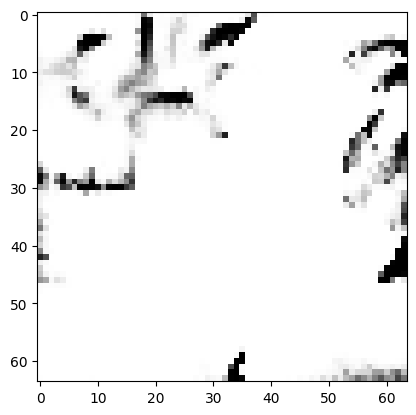

tensor([[4.7728e-03, 3.7254e-03, 1.2144e-02, 3.3366e-03, 5.9246e-03, 1.1123e-02,
         1.5012e-03, 2.9257e-02, 1.1345e-03, 8.1029e-01, 3.0163e-03, 2.6349e-03,
         2.2849e-03, 5.7965e-05, 2.6398e-04, 1.9671e-02, 9.9317e-04, 6.5884e-04,
         3.3594e-03, 8.5794e-03, 6.0480e-04, 7.3007e-04, 3.7301e-05, 9.8373e-04,
         3.4126e-04, 2.4957e-03, 7.9424e-03, 3.6172e-03, 1.9412e-02, 2.2012e-03,
         6.9548e-04, 8.2068e-03, 1.5598e-03, 1.6270e-03, 8.2317e-03, 4.4012e-04,
         4.0341e-04, 5.5570e-03, 2.3456e-03, 7.8406e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2103668749332428
tensor([[4.8204e-03, 3.7486e-03, 1.2068e-02, 3.3335e-03, 5.9329e-03, 1.1204e-02,
         1.5232e-03, 2.9240e-02, 1.1363e-03, 8.1041e-01, 3.0080e-03, 2.6222e-03,
         2.2834e-03, 5.7551e-05, 2.6359e-04, 1.9642e-02, 9.8224e-04, 6.6194e-04,
         3.3519e-03, 8.5795e-03, 6.0089e-04, 7.2604e-04, 3.6950e-05, 9.7930e-04,
         3.4126e-04, 2.4728e-03, 7.9936e-03

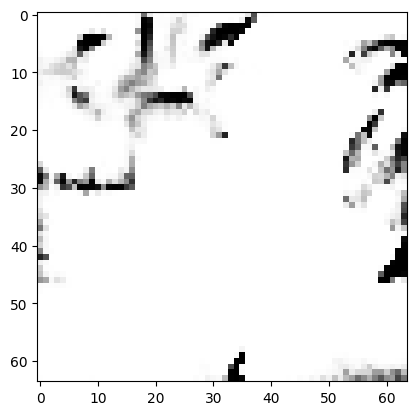

tensor([[4.7887e-03, 3.7369e-03, 1.2026e-02, 3.3324e-03, 5.9091e-03, 1.1097e-02,
         1.5115e-03, 2.9083e-02, 1.1336e-03, 8.1117e-01, 2.9960e-03, 2.6117e-03,
         2.2801e-03, 5.7408e-05, 2.6282e-04, 1.9540e-02, 9.7727e-04, 6.5824e-04,
         3.3408e-03, 8.5659e-03, 5.9843e-04, 7.2320e-04, 3.6850e-05, 9.7462e-04,
         3.4020e-04, 2.4699e-03, 7.9675e-03, 3.6034e-03, 1.9250e-02, 2.1947e-03,
         6.9268e-04, 8.1797e-03, 1.5494e-03, 1.6191e-03, 8.2313e-03, 4.3804e-04,
         3.9791e-04, 5.4892e-03, 2.3301e-03, 7.8315e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20927272737026215
tensor([[4.7280e-03, 3.6995e-03, 1.2088e-02, 3.3358e-03, 5.8816e-03, 1.1000e-02,
         1.4910e-03, 2.9002e-02, 1.1346e-03, 8.1141e-01, 2.9933e-03, 2.6203e-03,
         2.2843e-03, 5.7721e-05, 2.6231e-04, 1.9497e-02, 9.8439e-04, 6.5301e-04,
         3.3401e-03, 8.5677e-03, 6.0027e-04, 7.2563e-04, 3.7149e-05, 9.7643e-04,
         3.3993e-04, 2.4890e-03, 7.9166e-0

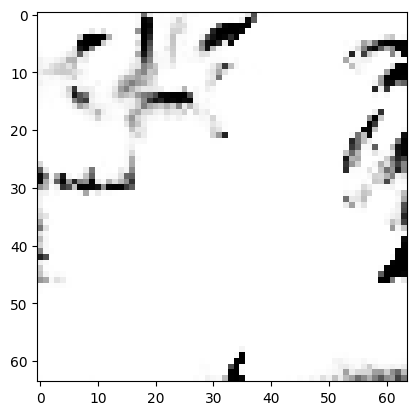

tensor([[4.7246e-03, 3.6979e-03, 1.1985e-02, 3.3242e-03, 5.8501e-03, 1.0887e-02,
         1.4810e-03, 2.8847e-02, 1.1262e-03, 8.1229e-01, 2.9780e-03, 2.5959e-03,
         2.2730e-03, 5.7173e-05, 2.6105e-04, 1.9437e-02, 9.7722e-04, 6.4668e-04,
         3.3348e-03, 8.5305e-03, 5.9639e-04, 7.2152e-04, 3.6902e-05, 9.7153e-04,
         3.3800e-04, 2.4719e-03, 7.9026e-03, 3.5626e-03, 1.9319e-02, 2.1869e-03,
         6.9295e-04, 8.1511e-03, 1.5471e-03, 1.6102e-03, 8.1561e-03, 4.3732e-04,
         3.9775e-04, 5.5396e-03, 2.3193e-03, 7.7332e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20789246261119843
tensor([[4.7405e-03, 3.7131e-03, 1.1897e-02, 3.3177e-03, 5.8511e-03, 1.0915e-02,
         1.4912e-03, 2.8867e-02, 1.1254e-03, 8.1255e-01, 2.9745e-03, 2.5800e-03,
         2.2663e-03, 5.6869e-05, 2.6115e-04, 1.9405e-02, 9.6778e-04, 6.4716e-04,
         3.3250e-03, 8.5343e-03, 5.9281e-04, 7.1874e-04, 3.6581e-05, 9.6859e-04,
         3.3776e-04, 2.4583e-03, 7.9098e-0

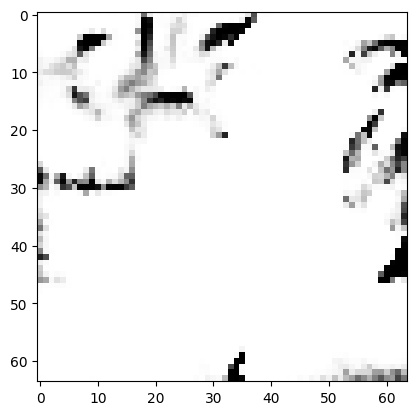

tensor([[4.7188e-03, 3.7031e-03, 1.1811e-02, 3.3082e-03, 5.8255e-03, 1.0815e-02,
         1.4807e-03, 2.8814e-02, 1.1176e-03, 8.1331e-01, 2.9676e-03, 2.5617e-03,
         2.2573e-03, 5.6504e-05, 2.6020e-04, 1.9336e-02, 9.6227e-04, 6.4136e-04,
         3.3146e-03, 8.5100e-03, 5.8938e-04, 7.1603e-04, 3.6334e-05, 9.6476e-04,
         3.3568e-04, 2.4504e-03, 7.8764e-03, 3.5427e-03, 1.9178e-02, 2.1843e-03,
         6.8806e-04, 8.1382e-03, 1.5373e-03, 1.6043e-03, 8.1219e-03, 4.3395e-04,
         3.9065e-04, 5.4691e-03, 2.3003e-03, 7.6754e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2066490352153778
tensor([[4.6905e-03, 3.6902e-03, 1.1845e-02, 3.3086e-03, 5.8103e-03, 1.0744e-02,
         1.4694e-03, 2.8660e-02, 1.1172e-03, 8.1351e-01, 2.9636e-03, 2.5705e-03,
         2.2606e-03, 5.6672e-05, 2.5989e-04, 1.9316e-02, 9.6546e-04, 6.3991e-04,
         3.3150e-03, 8.5001e-03, 5.9147e-04, 7.1640e-04, 3.6545e-05, 9.6396e-04,
         3.3548e-04, 2.4572e-03, 7.8730e-03

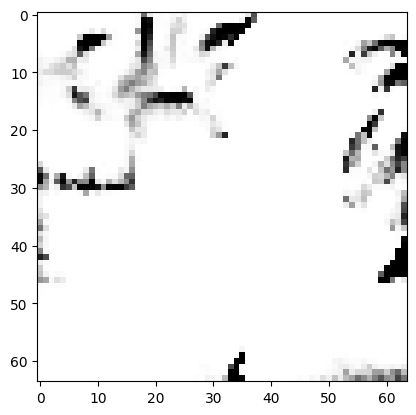

tensor([[4.6574e-03, 3.6691e-03, 1.1787e-02, 3.3072e-03, 5.7897e-03, 1.0664e-02,
         1.4605e-03, 2.8598e-02, 1.1132e-03, 8.1422e-01, 2.9547e-03, 2.5537e-03,
         2.2531e-03, 5.6412e-05, 2.5850e-04, 1.9188e-02, 9.6138e-04, 6.3479e-04,
         3.2984e-03, 8.4838e-03, 5.8761e-04, 7.1343e-04, 3.6340e-05, 9.6082e-04,
         3.3497e-04, 2.4594e-03, 7.8323e-03, 3.5174e-03, 1.9190e-02, 2.1786e-03,
         6.8968e-04, 8.1219e-03, 1.5380e-03, 1.5955e-03, 8.0835e-03, 4.3462e-04,
         3.9050e-04, 5.5136e-03, 2.2911e-03, 7.6197e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20552237331867218
tensor([[4.6589e-03, 3.6719e-03, 1.1729e-02, 3.3044e-03, 5.7951e-03, 1.0627e-02,
         1.4583e-03, 2.8620e-02, 1.1093e-03, 8.1443e-01, 2.9531e-03, 2.5420e-03,
         2.2490e-03, 5.6301e-05, 2.5826e-04, 1.9192e-02, 9.6017e-04, 6.3203e-04,
         3.2988e-03, 8.4738e-03, 5.8627e-04, 7.1395e-04, 3.6235e-05, 9.6140e-04,
         3.3467e-04, 2.4575e-03, 7.8103e-0

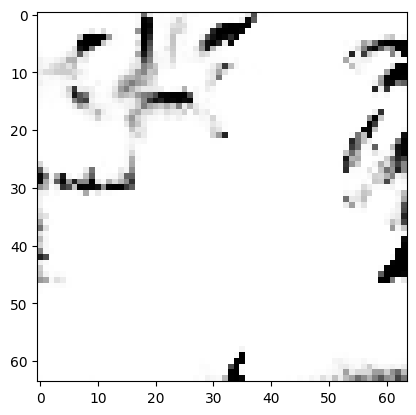

tensor([[4.6729e-03, 3.6677e-03, 1.1657e-02, 3.3060e-03, 5.7680e-03, 1.0561e-02,
         1.4585e-03, 2.8490e-02, 1.1044e-03, 8.1506e-01, 2.9460e-03, 2.5273e-03,
         2.2397e-03, 5.5875e-05, 2.5742e-04, 1.9144e-02, 9.5405e-04, 6.3025e-04,
         3.2923e-03, 8.4495e-03, 5.8278e-04, 7.0988e-04, 3.5945e-05, 9.5805e-04,
         3.3395e-04, 2.4420e-03, 7.8145e-03, 3.4938e-03, 1.9131e-02, 2.1761e-03,
         6.8730e-04, 8.0913e-03, 1.5295e-03, 1.5928e-03, 8.0648e-03, 4.3280e-04,
         3.8714e-04, 5.4834e-03, 2.2748e-03, 7.5402e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20449773967266083
tensor([[4.6096e-03, 3.6428e-03, 1.1696e-02, 3.3032e-03, 5.7618e-03, 1.0509e-02,
         1.4457e-03, 2.8410e-02, 1.1088e-03, 8.1526e-01, 2.9408e-03, 2.5312e-03,
         2.2454e-03, 5.6238e-05, 2.5703e-04, 1.9043e-02, 9.5655e-04, 6.2719e-04,
         3.2855e-03, 8.4605e-03, 5.8408e-04, 7.1078e-04, 3.6203e-05, 9.5788e-04,
         3.3441e-04, 2.4614e-03, 7.7781e-0

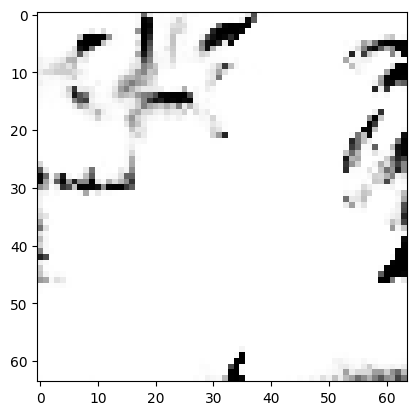

tensor([[4.6122e-03, 3.6334e-03, 1.1636e-02, 3.3086e-03, 5.7319e-03, 1.0395e-02,
         1.4384e-03, 2.8207e-02, 1.1019e-03, 8.1609e-01, 2.9256e-03, 2.5170e-03,
         2.2361e-03, 5.5830e-05, 2.5607e-04, 1.8976e-02, 9.5069e-04, 6.2459e-04,
         3.2813e-03, 8.4233e-03, 5.8118e-04, 7.0720e-04, 3.5961e-05, 9.5397e-04,
         3.3338e-04, 2.4480e-03, 7.7687e-03, 3.4693e-03, 1.9156e-02, 2.1719e-03,
         6.8946e-04, 8.0487e-03, 1.5290e-03, 1.5862e-03, 8.0293e-03, 4.3248e-04,
         3.8741e-04, 5.5177e-03, 2.2716e-03, 7.4827e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20323149859905243
tensor([[4.6317e-03, 3.6197e-03, 1.1575e-02, 3.3085e-03, 5.7250e-03, 1.0354e-02,
         1.4416e-03, 2.8273e-02, 1.0937e-03, 8.1635e-01, 2.9279e-03, 2.5007e-03,
         2.2243e-03, 5.5496e-05, 2.5551e-04, 1.9008e-02, 9.4895e-04, 6.2314e-04,
         3.2830e-03, 8.4165e-03, 5.7815e-04, 7.0609e-04, 3.5685e-05, 9.5526e-04,
         3.3235e-04, 2.4358e-03, 7.7431e-0

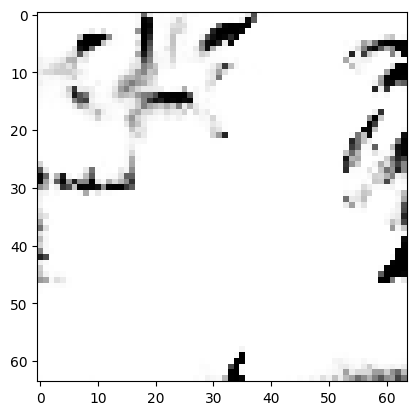

tensor([[4.6098e-03, 3.6107e-03, 1.1475e-02, 3.2997e-03, 5.6986e-03, 1.0247e-02,
         1.4331e-03, 2.8023e-02, 1.0891e-03, 8.1722e-01, 2.9170e-03, 2.4877e-03,
         2.2169e-03, 5.5199e-05, 2.5436e-04, 1.8920e-02, 9.4268e-04, 6.1871e-04,
         3.2731e-03, 8.3844e-03, 5.7585e-04, 7.0306e-04, 3.5517e-05, 9.5017e-04,
         3.3112e-04, 2.4281e-03, 7.7402e-03, 3.4358e-03, 1.9136e-02, 2.1645e-03,
         6.8480e-04, 8.0077e-03, 1.5212e-03, 1.5806e-03, 7.9931e-03, 4.3004e-04,
         3.8434e-04, 5.4899e-03, 2.2490e-03, 7.3852e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2018485963344574
tensor([[4.5998e-03, 3.6172e-03, 1.1491e-02, 3.3012e-03, 5.6989e-03, 1.0241e-02,
         1.4305e-03, 2.7899e-02, 1.0933e-03, 8.1740e-01, 2.9120e-03, 2.4867e-03,
         2.2195e-03, 5.5299e-05, 2.5438e-04, 1.8855e-02, 9.3987e-04, 6.1991e-04,
         3.2642e-03, 8.3834e-03, 5.7654e-04, 7.0138e-04, 3.5569e-05, 9.4662e-04,
         3.3183e-04, 2.4312e-03, 7.7431e-03

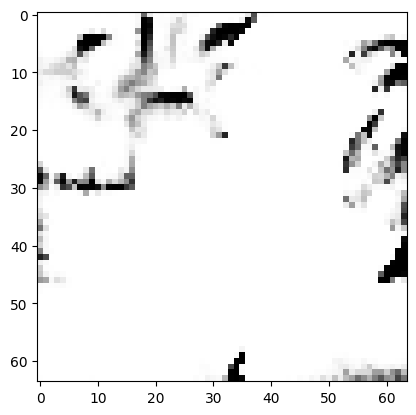

tensor([[4.5807e-03, 3.6065e-03, 1.1400e-02, 3.2898e-03, 5.6707e-03, 1.0159e-02,
         1.4263e-03, 2.7714e-02, 1.0886e-03, 8.1819e-01, 2.9016e-03, 2.4755e-03,
         2.2128e-03, 5.4974e-05, 2.5332e-04, 1.8762e-02, 9.3184e-04, 6.1681e-04,
         3.2498e-03, 8.3677e-03, 5.7383e-04, 6.9749e-04, 3.5345e-05, 9.4066e-04,
         3.3006e-04, 2.4186e-03, 7.7460e-03, 3.4118e-03, 1.9080e-02, 2.1634e-03,
         6.8266e-04, 7.9829e-03, 1.5181e-03, 1.5712e-03, 7.9961e-03, 4.2917e-04,
         3.8111e-04, 5.4736e-03, 2.2349e-03, 7.3821e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2006627917289734
tensor([[4.5775e-03, 3.5940e-03, 1.1376e-02, 3.2849e-03, 5.6623e-03, 1.0121e-02,
         1.4239e-03, 2.7711e-02, 1.0842e-03, 8.1832e-01, 2.9026e-03, 2.4719e-03,
         2.2066e-03, 5.4875e-05, 2.5310e-04, 1.8800e-02, 9.3227e-04, 6.1548e-04,
         3.2517e-03, 8.3657e-03, 5.7355e-04, 6.9783e-04, 3.5290e-05, 9.4206e-04,
         3.2936e-04, 2.4147e-03, 7.7304e-03

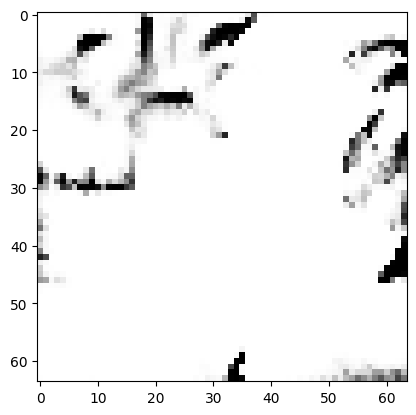

tensor([[4.5735e-03, 3.5835e-03, 1.1337e-02, 3.2851e-03, 5.6399e-03, 1.0059e-02,
         1.4189e-03, 2.7601e-02, 1.0804e-03, 8.1889e-01, 2.8956e-03, 2.4620e-03,
         2.1996e-03, 5.4566e-05, 2.5218e-04, 1.8710e-02, 9.2777e-04, 6.1326e-04,
         3.2420e-03, 8.3428e-03, 5.7121e-04, 6.9451e-04, 3.5100e-05, 9.3791e-04,
         3.2847e-04, 2.4074e-03, 7.7248e-03, 3.3843e-03, 1.9070e-02, 2.1563e-03,
         6.7939e-04, 7.9603e-03, 1.5157e-03, 1.5649e-03, 7.9610e-03, 4.2830e-04,
         3.7988e-04, 5.4812e-03, 2.2227e-03, 7.3256e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1998007893562317
tensor([[4.5600e-03, 3.5789e-03, 1.1322e-02, 3.2859e-03, 5.6394e-03, 1.0050e-02,
         1.4204e-03, 2.7602e-02, 1.0818e-03, 8.1902e-01, 2.8971e-03, 2.4567e-03,
         2.2013e-03, 5.4627e-05, 2.5193e-04, 1.8646e-02, 9.2582e-04, 6.1277e-04,
         3.2328e-03, 8.3567e-03, 5.7022e-04, 6.9413e-04, 3.5067e-05, 9.3679e-04,
         3.2883e-04, 2.4115e-03, 7.7127e-03

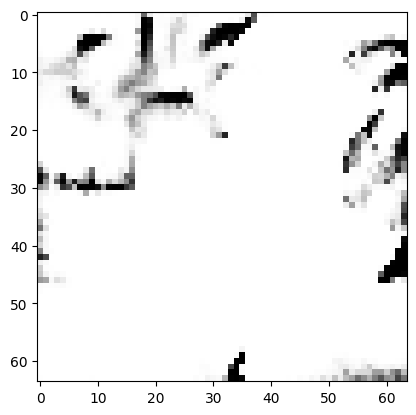

tensor([[4.5408e-03, 3.5673e-03, 1.1294e-02, 3.2834e-03, 5.6166e-03, 9.9824e-03,
         1.4138e-03, 2.7494e-02, 1.0778e-03, 8.1952e-01, 2.8899e-03, 2.4525e-03,
         2.1954e-03, 5.4470e-05, 2.5100e-04, 1.8562e-02, 9.2267e-04, 6.1013e-04,
         3.2266e-03, 8.3322e-03, 5.6928e-04, 6.9192e-04, 3.5020e-05, 9.3268e-04,
         3.2785e-04, 2.4086e-03, 7.7128e-03, 3.3701e-03, 1.9061e-02, 2.1533e-03,
         6.7899e-04, 7.9340e-03, 1.5171e-03, 1.5596e-03, 7.9427e-03, 4.2815e-04,
         3.7841e-04, 5.4865e-03, 2.2149e-03, 7.3087e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19903358817100525
tensor([[4.5325e-03, 3.5707e-03, 1.1274e-02, 3.2794e-03, 5.6167e-03, 9.9765e-03,
         1.4144e-03, 2.7460e-02, 1.0783e-03, 8.1963e-01, 2.8881e-03, 2.4510e-03,
         2.1976e-03, 5.4548e-05, 2.5111e-04, 1.8547e-02, 9.2124e-04, 6.0979e-04,
         3.2231e-03, 8.3401e-03, 5.6907e-04, 6.9183e-04, 3.5020e-05, 9.3229e-04,
         3.2782e-04, 2.4088e-03, 7.7122e-0

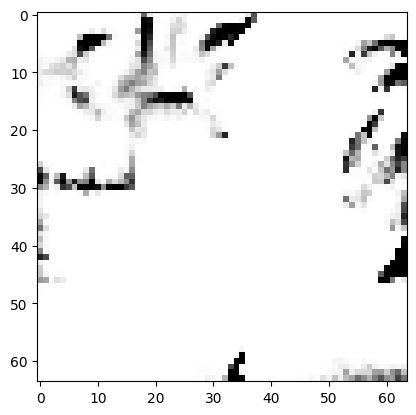

tensor([[4.5173e-03, 3.5612e-03, 1.1214e-02, 3.2649e-03, 5.5947e-03, 9.9199e-03,
         1.4095e-03, 2.7328e-02, 1.0744e-03, 8.2015e-01, 2.8849e-03, 2.4465e-03,
         2.1890e-03, 5.4320e-05, 2.5008e-04, 1.8512e-02, 9.1564e-04, 6.0748e-04,
         3.2154e-03, 8.3149e-03, 5.6836e-04, 6.8959e-04, 3.4935e-05, 9.2810e-04,
         3.2663e-04, 2.4004e-03, 7.7161e-03, 3.3517e-03, 1.9018e-02, 2.1515e-03,
         6.7686e-04, 7.9294e-03, 1.5169e-03, 1.5560e-03, 7.9349e-03, 4.2763e-04,
         3.7676e-04, 5.4726e-03, 2.2051e-03, 7.2945e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19826805591583252
tensor([[4.4950e-03, 3.5582e-03, 1.1215e-02, 3.2632e-03, 5.5894e-03, 9.8989e-03,
         1.4047e-03, 2.7273e-02, 1.0763e-03, 8.2026e-01, 2.8815e-03, 2.4499e-03,
         2.1916e-03, 5.4447e-05, 2.5018e-04, 1.8459e-02, 9.1506e-04, 6.0639e-04,
         3.2129e-03, 8.3165e-03, 5.6897e-04, 6.8989e-04, 3.5015e-05, 9.2701e-04,
         3.2701e-04, 2.4078e-03, 7.7195e-0

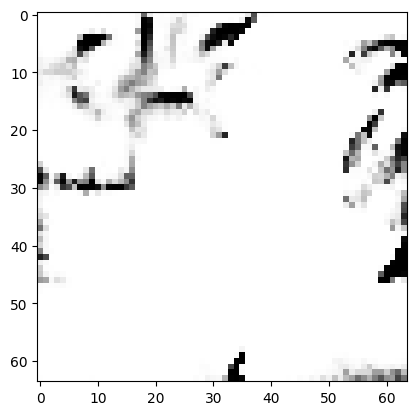

tensor([[4.4884e-03, 3.5409e-03, 1.1160e-02, 3.2585e-03, 5.5669e-03, 9.8253e-03,
         1.3990e-03, 2.7211e-02, 1.0685e-03, 8.2076e-01, 2.8799e-03, 2.4394e-03,
         2.1822e-03, 5.4230e-05, 2.4932e-04, 1.8453e-02, 9.1335e-04, 6.0372e-04,
         3.2060e-03, 8.2992e-03, 5.6685e-04, 6.8837e-04, 3.4868e-05, 9.2596e-04,
         3.2572e-04, 2.3997e-03, 7.6943e-03, 3.3283e-03, 1.9018e-02, 2.1496e-03,
         6.7639e-04, 7.9246e-03, 1.5192e-03, 1.5518e-03, 7.9041e-03, 4.2787e-04,
         3.7657e-04, 5.4882e-03, 2.1964e-03, 7.2491e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19752952456474304
tensor([[4.4868e-03, 3.5585e-03, 1.1157e-02, 3.2612e-03, 5.5768e-03, 9.8432e-03,
         1.4030e-03, 2.7136e-02, 1.0729e-03, 8.2088e-01, 2.8762e-03, 2.4372e-03,
         2.1872e-03, 5.4270e-05, 2.4919e-04, 1.8365e-02, 9.0841e-04, 6.0468e-04,
         3.1974e-03, 8.2900e-03, 5.6697e-04, 6.8654e-04, 3.4878e-05, 9.2203e-04,
         3.2639e-04, 2.4031e-03, 7.7111e-0

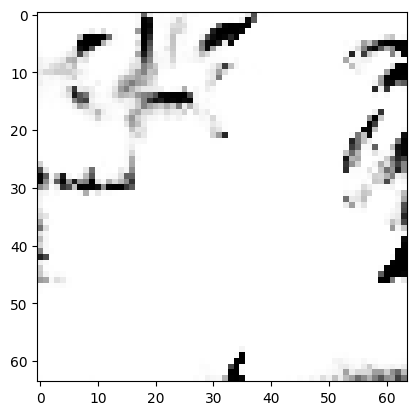

tensor([[4.4657e-03, 3.5365e-03, 1.1104e-02, 3.2533e-03, 5.5425e-03, 9.7566e-03,
         1.3920e-03, 2.7056e-02, 1.0655e-03, 8.2147e-01, 2.8707e-03, 2.4300e-03,
         2.1769e-03, 5.4069e-05, 2.4820e-04, 1.8346e-02, 9.0636e-04, 6.0055e-04,
         3.1888e-03, 8.2675e-03, 5.6520e-04, 6.8552e-04, 3.4758e-05, 9.1975e-04,
         3.2483e-04, 2.3972e-03, 7.6805e-03, 3.3149e-03, 1.8970e-02, 2.1483e-03,
         6.7559e-04, 7.8937e-03, 1.5169e-03, 1.5474e-03, 7.8939e-03, 4.2682e-04,
         3.7465e-04, 5.4773e-03, 2.1868e-03, 7.2309e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19665580987930298
tensor([[4.4710e-03, 3.5344e-03, 1.1090e-02, 3.2540e-03, 5.5365e-03, 9.7458e-03,
         1.3924e-03, 2.7036e-02, 1.0639e-03, 8.2162e-01, 2.8692e-03, 2.4274e-03,
         2.1750e-03, 5.3940e-05, 2.4788e-04, 1.8327e-02, 9.0523e-04, 6.0017e-04,
         3.1872e-03, 8.2564e-03, 5.6410e-04, 6.8422e-04, 3.4684e-05, 9.1841e-04,
         3.2425e-04, 2.3926e-03, 7.6868e-0

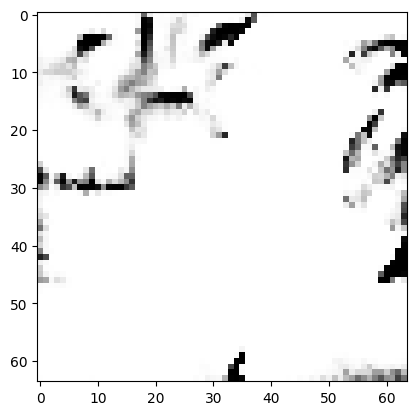

tensor([[4.4752e-03, 3.5318e-03, 1.1041e-02, 3.2493e-03, 5.5154e-03, 9.7042e-03,
         1.3903e-03, 2.6952e-02, 1.0584e-03, 8.2208e-01, 2.8640e-03, 2.4205e-03,
         2.1666e-03, 5.3662e-05, 2.4702e-04, 1.8302e-02, 9.0124e-04, 5.9870e-04,
         3.1799e-03, 8.2262e-03, 5.6221e-04, 6.8120e-04, 3.4509e-05, 9.1431e-04,
         3.2284e-04, 2.3803e-03, 7.6935e-03, 3.2906e-03, 1.8919e-02, 2.1385e-03,
         6.7099e-04, 7.8796e-03, 1.5107e-03, 1.5379e-03, 7.8727e-03, 4.2597e-04,
         3.7258e-04, 5.4703e-03, 2.1677e-03, 7.1999e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19592039287090302
tensor([[4.4504e-03, 3.5308e-03, 1.1040e-02, 3.2495e-03, 5.5128e-03, 9.6798e-03,
         1.3856e-03, 2.6918e-02, 1.0604e-03, 8.2221e-01, 2.8612e-03, 2.4210e-03,
         2.1699e-03, 5.3878e-05, 2.4710e-04, 1.8259e-02, 9.0082e-04, 5.9748e-04,
         3.1750e-03, 8.2329e-03, 5.6260e-04, 6.8221e-04, 3.4591e-05, 9.1342e-04,
         3.2315e-04, 2.3882e-03, 7.6761e-0

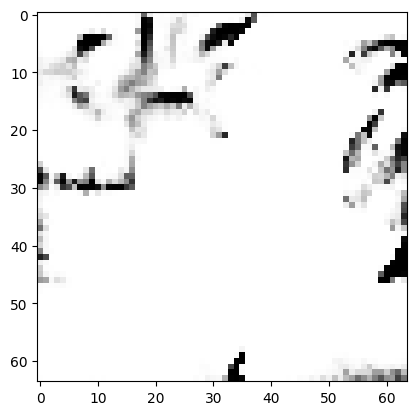

tensor([[4.4494e-03, 3.5283e-03, 1.0993e-02, 3.2446e-03, 5.5001e-03, 9.6453e-03,
         1.3850e-03, 2.6825e-02, 1.0577e-03, 8.2260e-01, 2.8546e-03, 2.4146e-03,
         2.1652e-03, 5.3695e-05, 2.4639e-04, 1.8225e-02, 8.9677e-04, 5.9638e-04,
         3.1684e-03, 8.2146e-03, 5.6120e-04, 6.7999e-04, 3.4482e-05, 9.1002e-04,
         3.2249e-04, 2.3807e-03, 7.6827e-03, 3.2839e-03, 1.8891e-02, 2.1389e-03,
         6.7188e-04, 7.8643e-03, 1.5103e-03, 1.5374e-03, 7.8654e-03, 4.2518e-04,
         3.7125e-04, 5.4570e-03, 2.1616e-03, 7.1867e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19528575241565704
tensor([[4.4418e-03, 3.5281e-03, 1.0997e-02, 3.2448e-03, 5.4945e-03, 9.6264e-03,
         1.3818e-03, 2.6761e-02, 1.0579e-03, 8.2270e-01, 2.8503e-03, 2.4169e-03,
         2.1660e-03, 5.3736e-05, 2.4646e-04, 1.8203e-02, 8.9699e-04, 5.9609e-04,
         3.1690e-03, 8.2077e-03, 5.6163e-04, 6.7973e-04, 3.4539e-05, 9.0891e-04,
         3.2257e-04, 2.3826e-03, 7.6912e-0

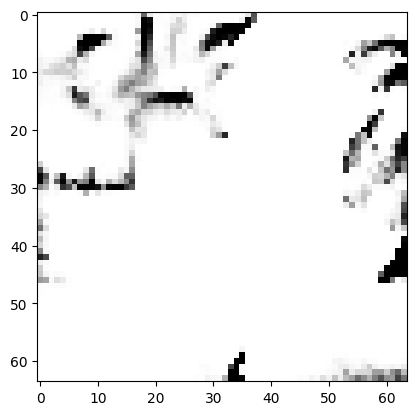

tensor([[4.4367e-03, 3.5166e-03, 1.0952e-02, 3.2351e-03, 5.4702e-03, 9.5990e-03,
         1.3789e-03, 2.6727e-02, 1.0536e-03, 8.2310e-01, 2.8443e-03, 2.4094e-03,
         2.1572e-03, 5.3476e-05, 2.4551e-04, 1.8186e-02, 8.9266e-04, 5.9363e-04,
         3.1635e-03, 8.1934e-03, 5.5948e-04, 6.7786e-04, 3.4361e-05, 9.0562e-04,
         3.2097e-04, 2.3709e-03, 7.6864e-03, 3.2615e-03, 1.8878e-02, 2.1324e-03,
         6.6923e-04, 7.8444e-03, 1.5086e-03, 1.5318e-03, 7.8424e-03, 4.2402e-04,
         3.7001e-04, 5.4506e-03, 2.1503e-03, 7.1681e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19467267394065857
tensor([[4.4421e-03, 3.5198e-03, 1.0943e-02, 3.2357e-03, 5.4713e-03, 9.5980e-03,
         1.3808e-03, 2.6716e-02, 1.0532e-03, 8.2318e-01, 2.8435e-03, 2.4075e-03,
         2.1577e-03, 5.3430e-05, 2.4534e-04, 1.8177e-02, 8.9142e-04, 5.9405e-04,
         3.1607e-03, 8.1913e-03, 5.5889e-04, 6.7687e-04, 3.4315e-05, 9.0442e-04,
         3.2079e-04, 2.3675e-03, 7.6928e-0

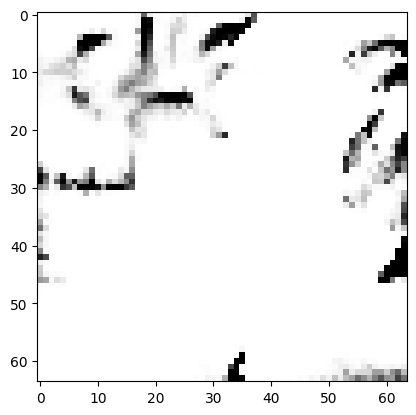

tensor([[4.4300e-03, 3.5082e-03, 1.0918e-02, 3.2286e-03, 5.4520e-03, 9.5665e-03,
         1.3764e-03, 2.6629e-02, 1.0520e-03, 8.2353e-01, 2.8338e-03, 2.4039e-03,
         2.1535e-03, 5.3295e-05, 2.4473e-04, 1.8150e-02, 8.8874e-04, 5.9183e-04,
         3.1597e-03, 8.1739e-03, 5.5793e-04, 6.7571e-04, 3.4276e-05, 9.0186e-04,
         3.1998e-04, 2.3621e-03, 7.6952e-03, 3.2484e-03, 1.8853e-02, 2.1257e-03,
         6.6724e-04, 7.8234e-03, 1.5047e-03, 1.5270e-03, 7.8324e-03, 4.2291e-04,
         3.6895e-04, 5.4384e-03, 2.1412e-03, 7.1597e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19415995478630066
tensor([[4.4364e-03, 3.5158e-03, 1.0900e-02, 3.2279e-03, 5.4492e-03, 9.5648e-03,
         1.3772e-03, 2.6632e-02, 1.0496e-03, 8.2359e-01, 2.8340e-03, 2.4017e-03,
         2.1513e-03, 5.3215e-05, 2.4487e-04, 1.8150e-02, 8.8729e-04, 5.9212e-04,
         3.1599e-03, 8.1673e-03, 5.5739e-04, 6.7478e-04, 3.4208e-05, 9.0098e-04,
         3.1959e-04, 2.3584e-03, 7.7045e-0

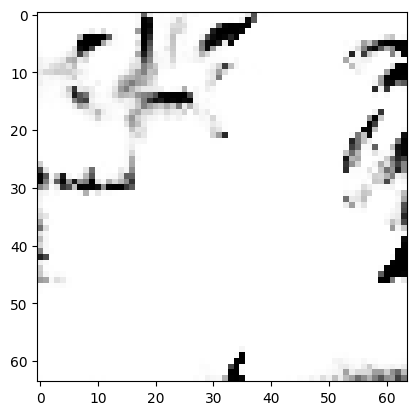

tensor([[4.4140e-03, 3.5022e-03, 1.0886e-02, 3.2240e-03, 5.4342e-03, 9.5165e-03,
         1.3711e-03, 2.6524e-02, 1.0492e-03, 8.2391e-01, 2.8246e-03, 2.4028e-03,
         2.1506e-03, 5.3245e-05, 2.4429e-04, 1.8116e-02, 8.8604e-04, 5.8992e-04,
         3.1593e-03, 8.1572e-03, 5.5719e-04, 6.7482e-04, 3.4248e-05, 8.9902e-04,
         3.1912e-04, 2.3580e-03, 7.7008e-03, 3.2335e-03, 1.8847e-02, 2.1221e-03,
         6.6672e-04, 7.8200e-03, 1.5049e-03, 1.5237e-03, 7.8146e-03, 4.2285e-04,
         3.6873e-04, 5.4401e-03, 2.1352e-03, 7.1388e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19369028508663177
tensor([[4.4041e-03, 3.5081e-03, 1.0886e-02, 3.2264e-03, 5.4363e-03, 9.5085e-03,
         1.3694e-03, 2.6502e-02, 1.0506e-03, 8.2396e-01, 2.8233e-03, 2.4031e-03,
         2.1541e-03, 5.3360e-05, 2.4433e-04, 1.8082e-02, 8.8556e-04, 5.8935e-04,
         3.1577e-03, 8.1552e-03, 5.5741e-04, 6.7500e-04, 3.4299e-05, 8.9809e-04,
         3.1929e-04, 2.3623e-03, 7.6986e-0

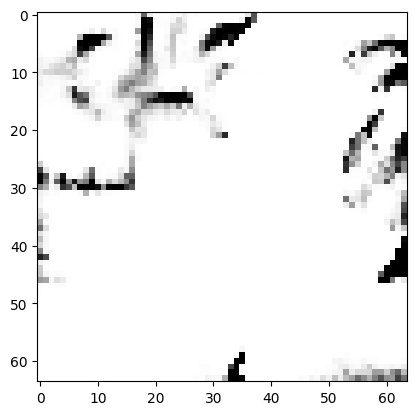

tensor([[4.3966e-03, 3.5013e-03, 1.0862e-02, 3.2210e-03, 5.4213e-03, 9.4704e-03,
         1.3646e-03, 2.6451e-02, 1.0472e-03, 8.2424e-01, 2.8201e-03, 2.3999e-03,
         2.1494e-03, 5.3286e-05, 2.4397e-04, 1.8078e-02, 8.8397e-04, 5.8815e-04,
         3.1563e-03, 8.1424e-03, 5.5669e-04, 6.7419e-04, 3.4252e-05, 8.9688e-04,
         3.1858e-04, 2.3580e-03, 7.6938e-03, 3.2268e-03, 1.8835e-02, 2.1214e-03,
         6.6681e-04, 7.8121e-03, 1.5049e-03, 1.5228e-03, 7.8008e-03, 4.2227e-04,
         3.6818e-04, 5.4401e-03, 2.1314e-03, 7.1201e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19328927993774414
tensor([[4.3887e-03, 3.4914e-03, 1.0864e-02, 3.2197e-03, 5.4122e-03, 9.4568e-03,
         1.3620e-03, 2.6429e-02, 1.0471e-03, 8.2431e-01, 2.8168e-03, 2.4010e-03,
         2.1484e-03, 5.3294e-05, 2.4382e-04, 1.8080e-02, 8.8457e-04, 5.8713e-04,
         3.1578e-03, 8.1427e-03, 5.5657e-04, 6.7482e-04, 3.4271e-05, 8.9715e-04,
         3.1843e-04, 2.3582e-03, 7.6887e-0

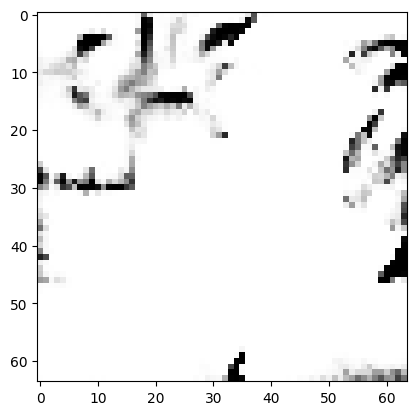

tensor([[4.3711e-03, 3.4839e-03, 1.0854e-02, 3.2149e-03, 5.4009e-03, 9.4238e-03,
         1.3560e-03, 2.6369e-02, 1.0453e-03, 8.2457e-01, 2.8125e-03, 2.4009e-03,
         2.1455e-03, 5.3274e-05, 2.4330e-04, 1.8064e-02, 8.8366e-04, 5.8498e-04,
         3.1573e-03, 8.1253e-03, 5.5643e-04, 6.7460e-04, 3.4254e-05, 8.9523e-04,
         3.1749e-04, 2.3576e-03, 7.6771e-03, 3.2122e-03, 1.8860e-02, 2.1182e-03,
         6.6705e-04, 7.8025e-03, 1.5052e-03, 1.5203e-03, 7.7772e-03, 4.2196e-04,
         3.6870e-04, 5.4483e-03, 2.1273e-03, 7.0977e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1928919553756714
tensor([[4.3786e-03, 3.4883e-03, 1.0850e-02, 3.2145e-03, 5.3996e-03, 9.4236e-03,
         1.3563e-03, 2.6350e-02, 1.0435e-03, 8.2463e-01, 2.8112e-03, 2.3983e-03,
         2.1429e-03, 5.3203e-05, 2.4337e-04, 1.8075e-02, 8.8300e-04, 5.8546e-04,
         3.1586e-03, 8.1133e-03, 5.5622e-04, 6.7362e-04, 3.4207e-05, 8.9464e-04,
         3.1715e-04, 2.3537e-03, 7.6806e-03

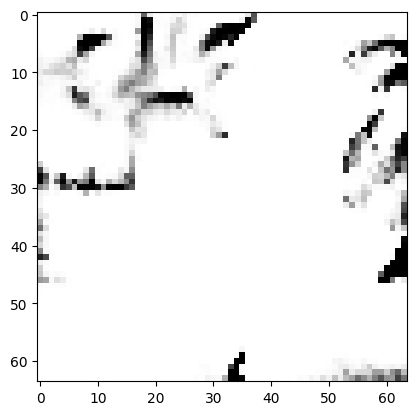

tensor([[4.3688e-03, 3.4822e-03, 1.0837e-02, 3.2113e-03, 5.3916e-03, 9.4003e-03,
         1.3539e-03, 2.6295e-02, 1.0424e-03, 8.2486e-01, 2.8079e-03, 2.3967e-03,
         2.1412e-03, 5.3161e-05, 2.4289e-04, 1.8045e-02, 8.8088e-04, 5.8418e-04,
         3.1572e-03, 8.1016e-03, 5.5573e-04, 6.7312e-04, 3.4179e-05, 8.9296e-04,
         3.1669e-04, 2.3522e-03, 7.6802e-03, 3.2042e-03, 1.8843e-02, 2.1145e-03,
         6.6533e-04, 7.7821e-03, 1.5031e-03, 1.5167e-03, 7.7704e-03, 4.2119e-04,
         3.6825e-04, 5.4437e-03, 2.1233e-03, 7.0895e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19254687428474426
tensor([[4.3714e-03, 3.4821e-03, 1.0830e-02, 3.2102e-03, 5.3882e-03, 9.4006e-03,
         1.3539e-03, 2.6275e-02, 1.0424e-03, 8.2492e-01, 2.8069e-03, 2.3965e-03,
         2.1397e-03, 5.3083e-05, 2.4263e-04, 1.8043e-02, 8.7972e-04, 5.8395e-04,
         3.1564e-03, 8.0973e-03, 5.5547e-04, 6.7277e-04, 3.4129e-05, 8.9178e-04,
         3.1633e-04, 2.3489e-03, 7.6834e-0

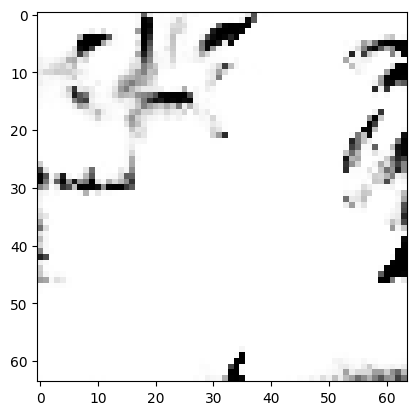

tensor([[4.3600e-03, 3.4703e-03, 1.0815e-02, 3.2061e-03, 5.3783e-03, 9.3684e-03,
         1.3506e-03, 2.6242e-02, 1.0403e-03, 8.2512e-01, 2.8035e-03, 2.3956e-03,
         2.1372e-03, 5.3057e-05, 2.4218e-04, 1.8028e-02, 8.7904e-04, 5.8255e-04,
         3.1553e-03, 8.0960e-03, 5.5468e-04, 6.7290e-04, 3.4097e-05, 8.9115e-04,
         3.1579e-04, 2.3468e-03, 7.6762e-03, 3.1914e-03, 1.8839e-02, 2.1105e-03,
         6.6438e-04, 7.7806e-03, 1.5037e-03, 1.5149e-03, 7.7537e-03, 4.2087e-04,
         3.6793e-04, 5.4428e-03, 2.1175e-03, 7.0722e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19222114980220795
tensor([[4.3602e-03, 3.4730e-03, 1.0815e-02, 3.2046e-03, 5.3745e-03, 9.3621e-03,
         1.3493e-03, 2.6219e-02, 1.0385e-03, 8.2520e-01, 2.8025e-03, 2.3952e-03,
         2.1349e-03, 5.3024e-05, 2.4218e-04, 1.8040e-02, 8.7885e-04, 5.8263e-04,
         3.1559e-03, 8.0853e-03, 5.5484e-04, 6.7221e-04, 3.4074e-05, 8.9054e-04,
         3.1535e-04, 2.3446e-03, 7.6742e-0

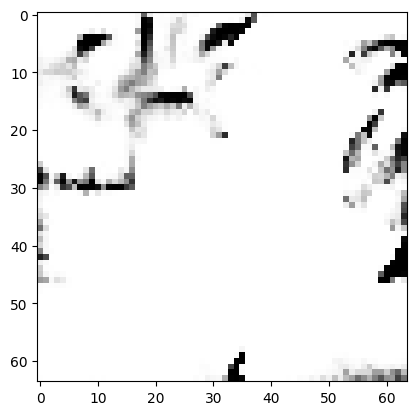

tensor([[4.3583e-03, 3.4694e-03, 1.0799e-02, 3.2036e-03, 5.3653e-03, 9.3444e-03,
         1.3490e-03, 2.6162e-02, 1.0382e-03, 8.2543e-01, 2.7978e-03, 2.3928e-03,
         2.1345e-03, 5.2953e-05, 2.4183e-04, 1.8014e-02, 8.7622e-04, 5.8208e-04,
         3.1521e-03, 8.0811e-03, 5.5393e-04, 6.7127e-04, 3.4011e-05, 8.8861e-04,
         3.1491e-04, 2.3395e-03, 7.6784e-03, 3.1834e-03, 1.8805e-02, 2.1060e-03,
         6.6308e-04, 7.7625e-03, 1.5011e-03, 1.5113e-03, 7.7464e-03, 4.2005e-04,
         3.6732e-04, 5.4366e-03, 2.1119e-03, 7.0619e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1918521225452423
tensor([[4.3464e-03, 3.4682e-03, 1.0804e-02, 3.2032e-03, 5.3623e-03, 9.3317e-03,
         1.3451e-03, 2.6149e-02, 1.0387e-03, 8.2548e-01, 2.7965e-03, 2.3948e-03,
         2.1357e-03, 5.3029e-05, 2.4182e-04, 1.7991e-02, 8.7667e-04, 5.8137e-04,
         3.1504e-03, 8.0788e-03, 5.5416e-04, 6.7157e-04, 3.4057e-05, 8.8796e-04,
         3.1487e-04, 2.3435e-03, 7.6745e-03

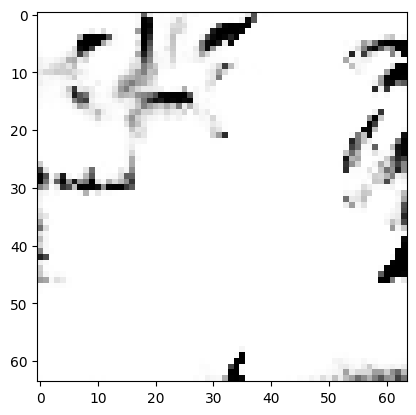

tensor([[4.3458e-03, 3.4674e-03, 1.0792e-02, 3.1996e-03, 5.3543e-03, 9.3186e-03,
         1.3436e-03, 2.6100e-02, 1.0362e-03, 8.2568e-01, 2.7934e-03, 2.3928e-03,
         2.1317e-03, 5.2918e-05, 2.4151e-04, 1.7988e-02, 8.7475e-04, 5.8096e-04,
         3.1491e-03, 8.0656e-03, 5.5370e-04, 6.7017e-04, 3.3969e-05, 8.8608e-04,
         3.1401e-04, 2.3375e-03, 7.6758e-03, 3.1742e-03, 1.8795e-02, 2.1032e-03,
         6.6198e-04, 7.7582e-03, 1.5000e-03, 1.5079e-03, 7.7366e-03, 4.1969e-04,
         3.6691e-04, 5.4402e-03, 2.1072e-03, 7.0532e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19155165553092957
tensor([[4.3512e-03, 3.4664e-03, 1.0773e-02, 3.1998e-03, 5.3508e-03, 9.3117e-03,
         1.3447e-03, 2.6101e-02, 1.0355e-03, 8.2574e-01, 2.7928e-03, 2.3910e-03,
         2.1313e-03, 5.2849e-05, 2.4145e-04, 1.7985e-02, 8.7388e-04, 5.8081e-04,
         3.1486e-03, 8.0675e-03, 5.5281e-04, 6.6995e-04, 3.3922e-05, 8.8599e-04,
         3.1385e-04, 2.3337e-03, 7.6811e-0

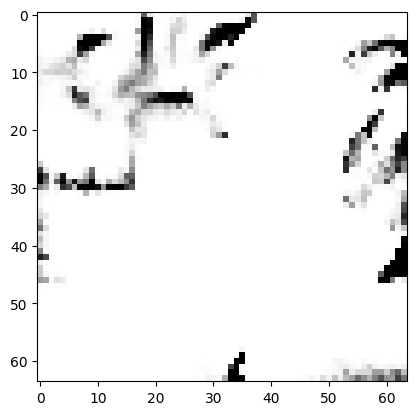

tensor([[4.3397e-03, 3.4629e-03, 1.0765e-02, 3.1988e-03, 5.3405e-03, 9.2827e-03,
         1.3401e-03, 2.6055e-02, 1.0349e-03, 8.2595e-01, 2.7889e-03, 2.3908e-03,
         2.1307e-03, 5.2851e-05, 2.4130e-04, 1.7962e-02, 8.7288e-04, 5.7978e-04,
         3.1453e-03, 8.0637e-03, 5.5239e-04, 6.6952e-04, 3.3897e-05, 8.8448e-04,
         3.1337e-04, 2.3328e-03, 7.6747e-03, 3.1627e-03, 1.8769e-02, 2.1002e-03,
         6.6155e-04, 7.7648e-03, 1.4995e-03, 1.5054e-03, 7.7196e-03, 4.1960e-04,
         3.6631e-04, 5.4415e-03, 2.1009e-03, 7.0318e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19122393429279327
tensor([[4.3474e-03, 3.4658e-03, 1.0746e-02, 3.1962e-03, 5.3381e-03, 9.2834e-03,
         1.3413e-03, 2.6058e-02, 1.0326e-03, 8.2602e-01, 2.7892e-03, 2.3871e-03,
         2.1269e-03, 5.2745e-05, 2.4123e-04, 1.7980e-02, 8.7125e-04, 5.8002e-04,
         3.1448e-03, 8.0572e-03, 5.5189e-04, 6.6880e-04, 3.3811e-05, 8.8426e-04,
         3.1302e-04, 2.3279e-03, 7.6736e-0

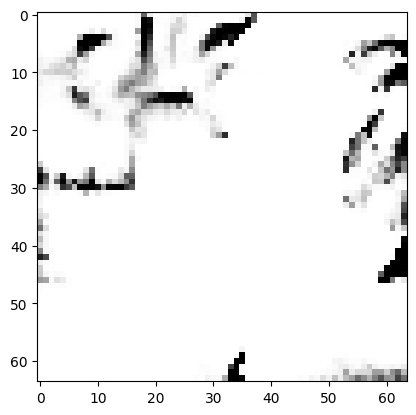

tensor([[4.3439e-03, 3.4639e-03, 1.0730e-02, 3.1934e-03, 5.3295e-03, 9.2650e-03,
         1.3392e-03, 2.6012e-02, 1.0312e-03, 8.2621e-01, 2.7850e-03, 2.3856e-03,
         2.1250e-03, 5.2672e-05, 2.4104e-04, 1.7975e-02, 8.6960e-04, 5.7928e-04,
         3.1436e-03, 8.0489e-03, 5.5138e-04, 6.6793e-04, 3.3761e-05, 8.8295e-04,
         3.1240e-04, 2.3232e-03, 7.6739e-03, 3.1547e-03, 1.8735e-02, 2.0966e-03,
         6.5906e-04, 7.7513e-03, 1.4971e-03, 1.5025e-03, 7.7113e-03, 4.1834e-04,
         3.6519e-04, 5.4269e-03, 2.0943e-03, 7.0163e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19090409576892853
tensor([[4.3365e-03, 3.4600e-03, 1.0729e-02, 3.1932e-03, 5.3264e-03, 9.2535e-03,
         1.3373e-03, 2.5987e-02, 1.0316e-03, 8.2627e-01, 2.7838e-03, 2.3869e-03,
         2.1253e-03, 5.2689e-05, 2.4095e-04, 1.7964e-02, 8.6972e-04, 5.7858e-04,
         3.1435e-03, 8.0478e-03, 5.5145e-04, 6.6812e-04, 3.3775e-05, 8.8270e-04,
         3.1234e-04, 2.3246e-03, 7.6728e-0

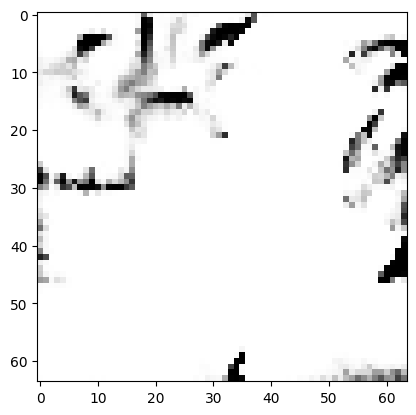

tensor([[4.3292e-03, 3.4565e-03, 1.0710e-02, 3.1867e-03, 5.3193e-03, 9.2306e-03,
         1.3340e-03, 2.5927e-02, 1.0291e-03, 8.2646e-01, 2.7807e-03, 2.3858e-03,
         2.1217e-03, 5.2630e-05, 2.4076e-04, 1.7972e-02, 8.6851e-04, 5.7778e-04,
         3.1431e-03, 8.0374e-03, 5.5135e-04, 6.6749e-04, 3.3733e-05, 8.8192e-04,
         3.1164e-04, 2.3209e-03, 7.6698e-03, 3.1441e-03, 1.8737e-02, 2.0953e-03,
         6.5848e-04, 7.7572e-03, 1.4969e-03, 1.5002e-03, 7.7018e-03, 4.1838e-04,
         3.6508e-04, 5.4313e-03, 2.0902e-03, 7.0020e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1906006932258606
tensor([[4.3337e-03, 3.4533e-03, 1.0699e-02, 3.1859e-03, 5.3156e-03, 9.2246e-03,
         1.3345e-03, 2.5926e-02, 1.0278e-03, 8.2651e-01, 2.7814e-03, 2.3846e-03,
         2.1195e-03, 5.2541e-05, 2.4060e-04, 1.7984e-02, 8.6807e-04, 5.7754e-04,
         3.1438e-03, 8.0355e-03, 5.5082e-04, 6.6728e-04, 3.3672e-05, 8.8203e-04,
         3.1129e-04, 2.3170e-03, 7.6691e-03

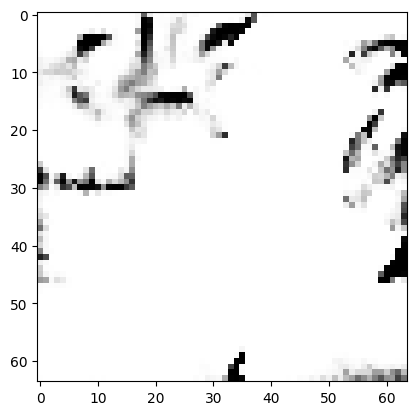

tensor([[4.3161e-03, 3.4473e-03, 1.0684e-02, 3.1801e-03, 5.3105e-03, 9.1970e-03,
         1.3304e-03, 2.5857e-02, 1.0269e-03, 8.2669e-01, 2.7783e-03, 2.3853e-03,
         2.1189e-03, 5.2579e-05, 2.4042e-04, 1.7972e-02, 8.6714e-04, 5.7629e-04,
         3.1422e-03, 8.0318e-03, 5.5106e-04, 6.6741e-04, 3.3684e-05, 8.8139e-04,
         3.1081e-04, 2.3177e-03, 7.6627e-03, 3.1346e-03, 1.8741e-02, 2.0946e-03,
         6.5791e-04, 7.7659e-03, 1.4976e-03, 1.4985e-03, 7.6904e-03, 4.1843e-04,
         3.6494e-04, 5.4318e-03, 2.0863e-03, 6.9858e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19032123684883118
tensor([[4.3183e-03, 3.4501e-03, 1.0680e-02, 3.1788e-03, 5.3078e-03, 9.1925e-03,
         1.3297e-03, 2.5851e-02, 1.0254e-03, 8.2673e-01, 2.7784e-03, 2.3848e-03,
         2.1170e-03, 5.2532e-05, 2.4046e-04, 1.7976e-02, 8.6686e-04, 5.7635e-04,
         3.1430e-03, 8.0241e-03, 5.5091e-04, 6.6673e-04, 3.3655e-05, 8.8087e-04,
         3.1046e-04, 2.3155e-03, 7.6662e-0

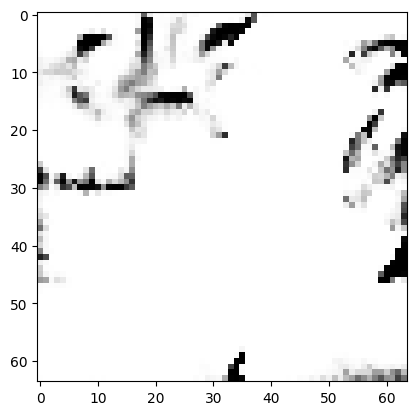

tensor([[4.3058e-03, 3.4438e-03, 1.0660e-02, 3.1717e-03, 5.3021e-03, 9.1642e-03,
         1.3266e-03, 2.5786e-02, 1.0235e-03, 8.2692e-01, 2.7756e-03, 2.3850e-03,
         2.1146e-03, 5.2507e-05, 2.4020e-04, 1.7979e-02, 8.6568e-04, 5.7521e-04,
         3.1428e-03, 8.0187e-03, 5.5105e-04, 6.6673e-04, 3.3637e-05, 8.8021e-04,
         3.0985e-04, 2.3133e-03, 7.6625e-03, 3.1246e-03, 1.8737e-02, 2.0922e-03,
         6.5635e-04, 7.7746e-03, 1.4975e-03, 1.4963e-03, 7.6786e-03, 4.1837e-04,
         3.6466e-04, 5.4347e-03, 2.0824e-03, 6.9712e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19004684686660767
tensor([[4.3011e-03, 3.4421e-03, 1.0654e-02, 3.1694e-03, 5.3023e-03, 9.1605e-03,
         1.3266e-03, 2.5770e-02, 1.0236e-03, 8.2696e-01, 2.7751e-03, 2.3856e-03,
         2.1151e-03, 5.2516e-05, 2.4006e-04, 1.7973e-02, 8.6500e-04, 5.7489e-04,
         3.1417e-03, 8.0207e-03, 5.5119e-04, 6.6704e-04, 3.3641e-05, 8.7979e-04,
         3.0972e-04, 2.3132e-03, 7.6631e-0

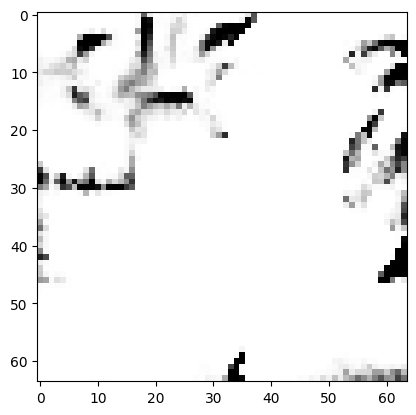

tensor([[4.2958e-03, 3.4391e-03, 1.0632e-02, 3.1638e-03, 5.2965e-03, 9.1341e-03,
         1.3241e-03, 2.5715e-02, 1.0205e-03, 8.2714e-01, 2.7727e-03, 2.3842e-03,
         2.1116e-03, 5.2441e-05, 2.3985e-04, 1.7980e-02, 8.6387e-04, 5.7401e-04,
         3.1428e-03, 8.0100e-03, 5.5105e-04, 6.6657e-04, 3.3595e-05, 8.7919e-04,
         3.0905e-04, 2.3093e-03, 7.6628e-03, 3.1163e-03, 1.8740e-02, 2.0910e-03,
         6.5530e-04, 7.7817e-03, 1.4982e-03, 1.4952e-03, 7.6698e-03, 4.1836e-04,
         3.6443e-04, 5.4317e-03, 2.0790e-03, 6.9582e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18978646397590637
tensor([[4.2906e-03, 3.4362e-03, 1.0634e-02, 3.1619e-03, 5.2942e-03, 9.1305e-03,
         1.3230e-03, 2.5700e-02, 1.0207e-03, 8.2717e-01, 2.7716e-03, 2.3849e-03,
         2.1114e-03, 5.2449e-05, 2.3981e-04, 1.7976e-02, 8.6365e-04, 5.7382e-04,
         3.1424e-03, 8.0097e-03, 5.5122e-04, 6.6650e-04, 3.3602e-05, 8.7892e-04,
         3.0889e-04, 2.3095e-03, 7.6621e-0

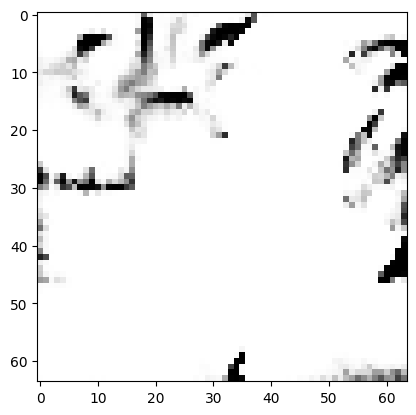

tensor([[4.2792e-03, 3.4317e-03, 1.0615e-02, 3.1564e-03, 5.2918e-03, 9.1048e-03,
         1.3196e-03, 2.5654e-02, 1.0182e-03, 8.2732e-01, 2.7697e-03, 2.3838e-03,
         2.1082e-03, 5.2420e-05, 2.3959e-04, 1.7974e-02, 8.6313e-04, 5.7249e-04,
         3.1438e-03, 7.9999e-03, 5.5123e-04, 6.6644e-04, 3.3577e-05, 8.7857e-04,
         3.0836e-04, 2.3091e-03, 7.6558e-03, 3.1087e-03, 1.8759e-02, 2.0904e-03,
         6.5461e-04, 7.7889e-03, 1.4990e-03, 1.4938e-03, 7.6604e-03, 4.1847e-04,
         3.6441e-04, 5.4354e-03, 2.0778e-03, 6.9469e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18956232070922852
tensor([[4.2770e-03, 3.4313e-03, 1.0603e-02, 3.1534e-03, 5.2911e-03, 9.1014e-03,
         1.3196e-03, 2.5639e-02, 1.0179e-03, 8.2737e-01, 2.7688e-03, 2.3839e-03,
         2.1078e-03, 5.2397e-05, 2.3951e-04, 1.7975e-02, 8.6217e-04, 5.7218e-04,
         3.1433e-03, 8.0001e-03, 5.5120e-04, 6.6652e-04, 3.3565e-05, 8.7817e-04,
         3.0817e-04, 2.3076e-03, 7.6581e-0

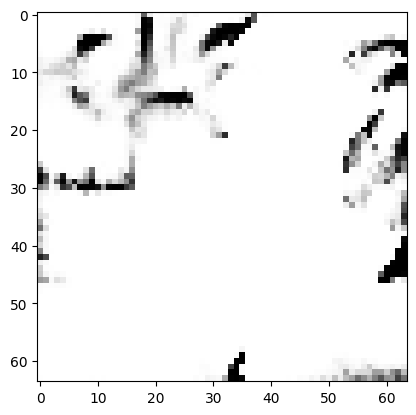

tensor([[4.2620e-03, 3.4256e-03, 1.0585e-02, 3.1479e-03, 5.2881e-03, 9.0747e-03,
         1.3162e-03, 2.5575e-02, 1.0167e-03, 8.2754e-01, 2.7655e-03, 2.3842e-03,
         2.1063e-03, 5.2390e-05, 2.3927e-04, 1.7965e-02, 8.6148e-04, 5.7081e-04,
         3.1440e-03, 7.9924e-03, 5.5133e-04, 6.6639e-04, 3.3570e-05, 8.7751e-04,
         3.0773e-04, 2.3074e-03, 7.6559e-03, 3.1000e-03, 1.8767e-02, 2.0906e-03,
         6.5423e-04, 7.8034e-03, 1.4999e-03, 1.4926e-03, 7.6540e-03, 4.1888e-04,
         3.6409e-04, 5.4336e-03, 2.0751e-03, 6.9373e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18930211663246155
tensor([[4.2642e-03, 3.4278e-03, 1.0577e-02, 3.1451e-03, 5.2856e-03, 9.0750e-03,
         1.3162e-03, 2.5559e-02, 1.0155e-03, 8.2758e-01, 2.7655e-03, 2.3837e-03,
         2.1046e-03, 5.2334e-05, 2.3923e-04, 1.7972e-02, 8.6056e-04, 5.7084e-04,
         3.1439e-03, 7.9887e-03, 5.5134e-04, 6.6591e-04, 3.3533e-05, 8.7683e-04,
         3.0740e-04, 2.3045e-03, 7.6617e-0

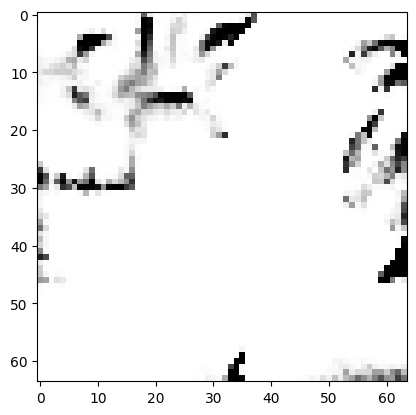

tensor([[4.2518e-03, 3.4228e-03, 1.0559e-02, 3.1386e-03, 5.2821e-03, 9.0541e-03,
         1.3127e-03, 2.5521e-02, 1.0138e-03, 8.2773e-01, 2.7631e-03, 2.3829e-03,
         2.1022e-03, 5.2307e-05, 2.3901e-04, 1.7968e-02, 8.5985e-04, 5.6939e-04,
         3.1438e-03, 7.9821e-03, 5.5134e-04, 6.6589e-04, 3.3515e-05, 8.7633e-04,
         3.0685e-04, 2.3039e-03, 7.6553e-03, 3.0911e-03, 1.8769e-02, 2.0899e-03,
         6.5275e-04, 7.8102e-03, 1.4997e-03, 1.4911e-03, 7.6472e-03, 4.1868e-04,
         3.6359e-04, 5.4298e-03, 2.0717e-03, 6.9263e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1890716403722763
tensor([[4.2483e-03, 3.4215e-03, 1.0557e-02, 3.1387e-03, 5.2812e-03, 9.0485e-03,
         1.3124e-03, 2.5506e-02, 1.0141e-03, 8.2777e-01, 2.7622e-03, 2.3829e-03,
         2.1028e-03, 5.2331e-05, 2.3900e-04, 1.7959e-02, 8.5945e-04, 5.6931e-04,
         3.1431e-03, 7.9836e-03, 5.5129e-04, 6.6590e-04, 3.3520e-05, 8.7620e-04,
         3.0693e-04, 2.3046e-03, 7.6552e-03

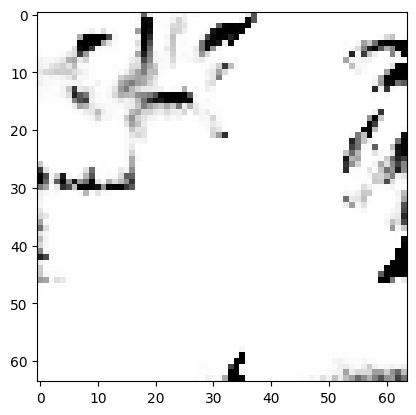

tensor([[4.2445e-03, 3.4206e-03, 1.0538e-02, 3.1342e-03, 5.2773e-03, 9.0389e-03,
         1.3112e-03, 2.5478e-02, 1.0127e-03, 8.2789e-01, 2.7604e-03, 2.3814e-03,
         2.1004e-03, 5.2256e-05, 2.3882e-04, 1.7955e-02, 8.5804e-04, 5.6855e-04,
         3.1423e-03, 7.9782e-03, 5.5097e-04, 6.6538e-04, 3.3463e-05, 8.7519e-04,
         3.0642e-04, 2.3017e-03, 7.6554e-03, 3.0855e-03, 1.8761e-02, 2.0896e-03,
         6.5224e-04, 7.8141e-03, 1.4995e-03, 1.4902e-03, 7.6433e-03, 4.1855e-04,
         3.6297e-04, 5.4256e-03, 2.0696e-03, 6.9200e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18887653946876526
tensor([[4.2370e-03, 3.4156e-03, 1.0533e-02, 3.1329e-03, 5.2761e-03, 9.0271e-03,
         1.3094e-03, 2.5480e-02, 1.0126e-03, 8.2791e-01, 2.7601e-03, 2.3821e-03,
         2.1010e-03, 5.2284e-05, 2.3878e-04, 1.7953e-02, 8.5865e-04, 5.6777e-04,
         3.1424e-03, 7.9821e-03, 5.5084e-04, 6.6606e-04, 3.3486e-05, 8.7575e-04,
         3.0637e-04, 2.3032e-03, 7.6500e-0

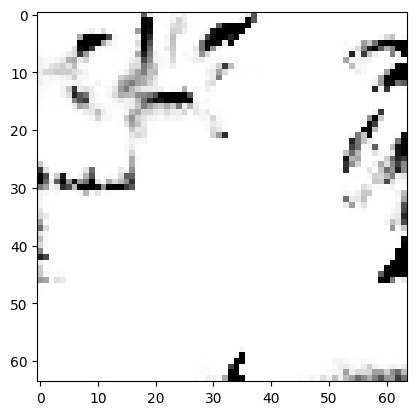

tensor([[4.2326e-03, 3.4145e-03, 1.0524e-02, 3.1311e-03, 5.2710e-03, 9.0174e-03,
         1.3080e-03, 2.5445e-02, 1.0123e-03, 8.2804e-01, 2.7571e-03, 2.3810e-03,
         2.0997e-03, 5.2236e-05, 2.3864e-04, 1.7937e-02, 8.5725e-04, 5.6713e-04,
         3.1411e-03, 7.9754e-03, 5.5060e-04, 6.6542e-04, 3.3453e-05, 8.7448e-04,
         3.0611e-04, 2.3018e-03, 7.6511e-03, 3.0790e-03, 1.8759e-02, 2.0888e-03,
         6.5235e-04, 7.8222e-03, 1.4997e-03, 1.4894e-03, 7.6345e-03, 4.1874e-04,
         3.6271e-04, 5.4288e-03, 2.0679e-03, 6.9093e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18869177997112274
tensor([[4.2355e-03, 3.4140e-03, 1.0514e-02, 3.1286e-03, 5.2700e-03, 9.0189e-03,
         1.3085e-03, 2.5450e-02, 1.0113e-03, 8.2807e-01, 2.7574e-03, 2.3794e-03,
         2.0978e-03, 5.2174e-05, 2.3858e-04, 1.7950e-02, 8.5671e-04, 5.6707e-04,
         3.1411e-03, 7.9742e-03, 5.5032e-04, 6.6515e-04, 3.3412e-05, 8.7451e-04,
         3.0585e-04, 2.2990e-03, 7.6504e-0

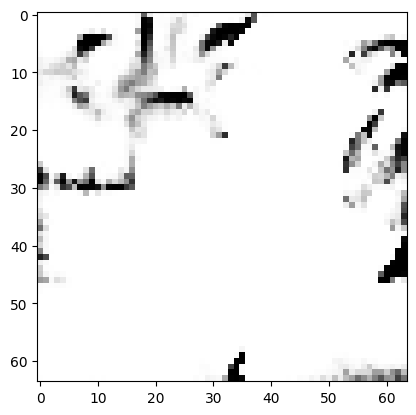

tensor([[4.2318e-03, 3.4140e-03, 1.0506e-02, 3.1274e-03, 5.2661e-03, 9.0104e-03,
         1.3073e-03, 2.5418e-02, 1.0113e-03, 8.2817e-01, 2.7549e-03, 2.3788e-03,
         2.0973e-03, 5.2148e-05, 2.3852e-04, 1.7938e-02, 8.5548e-04, 5.6673e-04,
         3.1390e-03, 7.9719e-03, 5.5008e-04, 6.6473e-04, 3.3383e-05, 8.7349e-04,
         3.0570e-04, 2.2978e-03, 7.6503e-03, 3.0742e-03, 1.8743e-02, 2.0880e-03,
         6.5139e-04, 7.8204e-03, 1.4985e-03, 1.4885e-03, 7.6321e-03, 4.1823e-04,
         3.6201e-04, 5.4205e-03, 2.0650e-03, 6.9034e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18853116035461426
tensor([[4.2234e-03, 3.4094e-03, 1.0511e-02, 3.1280e-03, 5.2642e-03, 9.0000e-03,
         1.3053e-03, 2.5413e-02, 1.0117e-03, 8.2820e-01, 2.7542e-03, 2.3796e-03,
         2.0979e-03, 5.2204e-05, 2.3848e-04, 1.7928e-02, 8.5622e-04, 5.6620e-04,
         3.1386e-03, 7.9734e-03, 5.5014e-04, 6.6507e-04, 3.3413e-05, 8.7370e-04,
         3.0574e-04, 2.3004e-03, 7.6427e-0

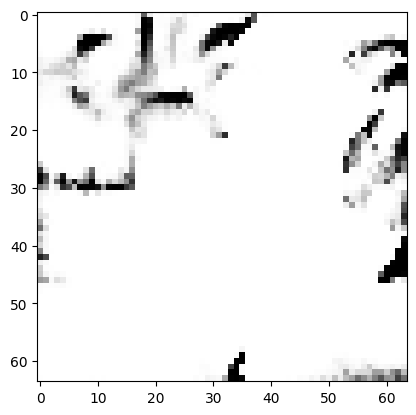

tensor([[4.2188e-03, 3.4071e-03, 1.0498e-02, 3.1241e-03, 5.2603e-03, 8.9878e-03,
         1.3032e-03, 2.5401e-02, 1.0102e-03, 8.2829e-01, 2.7527e-03, 2.3787e-03,
         2.0958e-03, 5.2154e-05, 2.3841e-04, 1.7933e-02, 8.5575e-04, 5.6535e-04,
         3.1389e-03, 7.9685e-03, 5.4995e-04, 6.6499e-04, 3.3384e-05, 8.7344e-04,
         3.0531e-04, 2.2988e-03, 7.6389e-03, 3.0692e-03, 1.8752e-02, 2.0875e-03,
         6.5148e-04, 7.8275e-03, 1.4989e-03, 1.4881e-03, 7.6202e-03, 4.1828e-04,
         3.6203e-04, 5.4266e-03, 2.0641e-03, 6.8896e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18839234113693237
tensor([[4.2277e-03, 3.4101e-03, 1.0486e-02, 3.1249e-03, 5.2597e-03, 8.9925e-03,
         1.3056e-03, 2.5401e-02, 1.0098e-03, 8.2832e-01, 2.7523e-03, 2.3766e-03,
         2.0949e-03, 5.2074e-05, 2.3834e-04, 1.7933e-02, 8.5425e-04, 5.6574e-04,
         3.1382e-03, 7.9682e-03, 5.4938e-04, 6.6440e-04, 3.3321e-05, 8.7279e-04,
         3.0526e-04, 2.2948e-03, 7.6457e-0

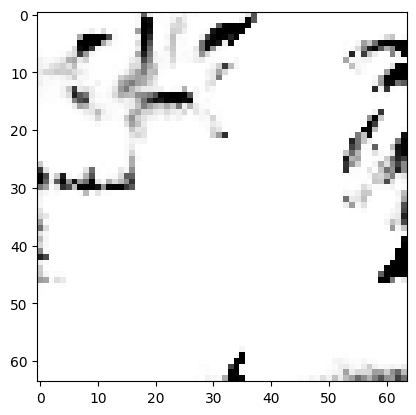

tensor([[4.2206e-03, 3.4077e-03, 1.0479e-02, 3.1211e-03, 5.2564e-03, 8.9821e-03,
         1.3036e-03, 2.5368e-02, 1.0095e-03, 8.2841e-01, 2.7503e-03, 2.3768e-03,
         2.0938e-03, 5.2063e-05, 2.3828e-04, 1.7933e-02, 8.5353e-04, 5.6521e-04,
         3.1375e-03, 7.9650e-03, 5.4958e-04, 6.6441e-04, 3.3320e-05, 8.7237e-04,
         3.0505e-04, 2.2946e-03, 7.6424e-03, 3.0649e-03, 1.8738e-02, 2.0870e-03,
         6.5064e-04, 7.8239e-03, 1.4981e-03, 1.4875e-03, 7.6210e-03, 4.1791e-04,
         3.6136e-04, 5.4173e-03, 2.0616e-03, 6.8877e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18824896216392517
tensor([[4.2152e-03, 3.4056e-03, 1.0481e-02, 3.1209e-03, 5.2546e-03, 8.9738e-03,
         1.3020e-03, 2.5362e-02, 1.0093e-03, 8.2843e-01, 2.7502e-03, 2.3775e-03,
         2.0940e-03, 5.2096e-05, 2.3827e-04, 1.7929e-02, 8.5405e-04, 5.6485e-04,
         3.1372e-03, 7.9643e-03, 5.4967e-04, 6.6457e-04, 3.3341e-05, 8.7245e-04,
         3.0497e-04, 2.2959e-03, 7.6385e-0

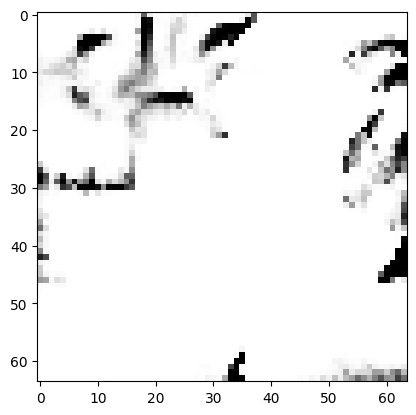

tensor([[4.2098e-03, 3.4023e-03, 1.0475e-02, 3.1198e-03, 5.2521e-03, 8.9637e-03,
         1.3007e-03, 2.5344e-02, 1.0092e-03, 8.2851e-01, 2.7486e-03, 2.3766e-03,
         2.0935e-03, 5.2082e-05, 2.3816e-04, 1.7920e-02, 8.5348e-04, 5.6417e-04,
         3.1366e-03, 7.9624e-03, 5.4946e-04, 6.6461e-04, 3.3325e-05, 8.7215e-04,
         3.0487e-04, 2.2963e-03, 7.6336e-03, 3.0622e-03, 1.8745e-02, 2.0870e-03,
         6.5115e-04, 7.8262e-03, 1.4985e-03, 1.4874e-03, 7.6132e-03, 4.1799e-04,
         3.6140e-04, 5.4222e-03, 2.0615e-03, 6.8791e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18812620639801025
tensor([[4.2149e-03, 3.4037e-03, 1.0469e-02, 3.1180e-03, 5.2505e-03, 8.9689e-03,
         1.3019e-03, 2.5335e-02, 1.0087e-03, 8.2854e-01, 2.7478e-03, 2.3762e-03,
         2.0922e-03, 5.2013e-05, 2.3810e-04, 1.7928e-02, 8.5248e-04, 5.6447e-04,
         3.1360e-03, 7.9606e-03, 5.4930e-04, 6.6409e-04, 3.3285e-05, 8.7154e-04,
         3.0466e-04, 2.2929e-03, 7.6396e-0

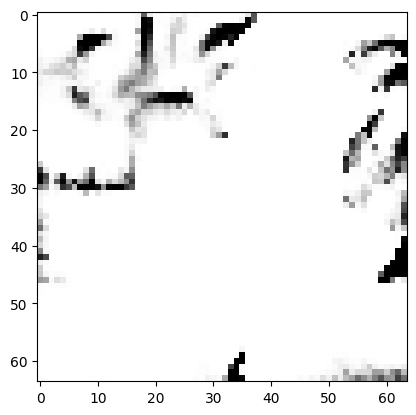

tensor([[4.2122e-03, 3.4020e-03, 1.0460e-02, 3.1156e-03, 5.2473e-03, 8.9611e-03,
         1.3010e-03, 2.5317e-02, 1.0081e-03, 8.2861e-01, 2.7467e-03, 2.3754e-03,
         2.0911e-03, 5.1980e-05, 2.3800e-04, 1.7925e-02, 8.5168e-04, 5.6406e-04,
         3.1353e-03, 7.9582e-03, 5.4910e-04, 6.6391e-04, 3.3264e-05, 8.7107e-04,
         3.0445e-04, 2.2914e-03, 7.6388e-03, 3.0574e-03, 1.8731e-02, 2.0855e-03,
         6.4991e-04, 7.8247e-03, 1.4975e-03, 1.4863e-03, 7.6122e-03, 4.1762e-04,
         3.6082e-04, 5.4152e-03, 2.0585e-03, 6.8780e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1880030333995819
tensor([[4.2077e-03, 3.4004e-03, 1.0462e-02, 3.1153e-03, 5.2467e-03, 8.9564e-03,
         1.2999e-03, 2.5308e-02, 1.0084e-03, 8.2863e-01, 2.7458e-03, 2.3758e-03,
         2.0912e-03, 5.2008e-05, 2.3803e-04, 1.7921e-02, 8.5194e-04, 5.6383e-04,
         3.1355e-03, 7.9581e-03, 5.4921e-04, 6.6401e-04, 3.3280e-05, 8.7113e-04,
         3.0446e-04, 2.2926e-03, 7.6362e-03

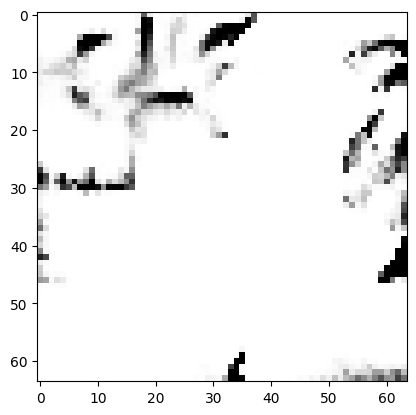

tensor([[4.2025e-03, 3.3982e-03, 1.0455e-02, 3.1137e-03, 5.2433e-03, 8.9461e-03,
         1.2984e-03, 2.5292e-02, 1.0080e-03, 8.2870e-01, 2.7444e-03, 2.3761e-03,
         2.0906e-03, 5.1998e-05, 2.3795e-04, 1.7916e-02, 8.5151e-04, 5.6325e-04,
         3.1350e-03, 7.9559e-03, 5.4909e-04, 6.6409e-04, 3.3271e-05, 8.7079e-04,
         3.0427e-04, 2.2924e-03, 7.6342e-03, 3.0541e-03, 1.8735e-02, 2.0856e-03,
         6.5033e-04, 7.8303e-03, 1.4979e-03, 1.4861e-03, 7.6060e-03, 4.1778e-04,
         3.6078e-04, 5.4192e-03, 2.0584e-03, 6.8720e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1878996044397354
tensor([[4.2059e-03, 3.3996e-03, 1.0449e-02, 3.1122e-03, 5.2433e-03, 8.9501e-03,
         1.2994e-03, 2.5288e-02, 1.0075e-03, 8.2872e-01, 2.7444e-03, 2.3749e-03,
         2.0896e-03, 5.1953e-05, 2.3789e-04, 1.7923e-02, 8.5064e-04, 5.6346e-04,
         3.1341e-03, 7.9557e-03, 5.4895e-04, 6.6374e-04, 3.3235e-05, 8.7041e-04,
         3.0412e-04, 2.2901e-03, 7.6351e-03

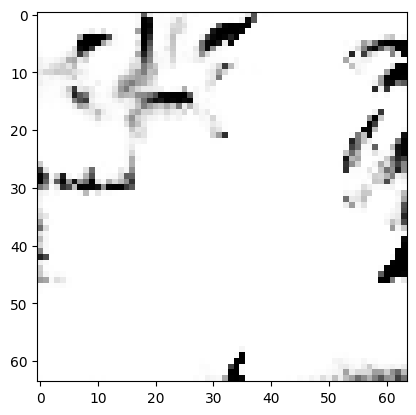

tensor([[4.2059e-03, 3.3982e-03, 1.0437e-02, 3.1094e-03, 5.2395e-03, 8.9452e-03,
         1.2991e-03, 2.5276e-02, 1.0065e-03, 8.2879e-01, 2.7429e-03, 2.3741e-03,
         2.0877e-03, 5.1884e-05, 2.3776e-04, 1.7926e-02, 8.4978e-04, 5.6309e-04,
         3.1340e-03, 7.9523e-03, 5.4859e-04, 6.6339e-04, 3.3196e-05, 8.6988e-04,
         3.0379e-04, 2.2871e-03, 7.6375e-03, 3.0501e-03, 1.8722e-02, 2.0840e-03,
         6.4894e-04, 7.8280e-03, 1.4968e-03, 1.4852e-03, 7.6037e-03, 4.1727e-04,
         3.6009e-04, 5.4093e-03, 2.0552e-03, 6.8696e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18778885900974274
tensor([[4.2002e-03, 3.3965e-03, 1.0438e-02, 3.1088e-03, 5.2388e-03, 8.9378e-03,
         1.2975e-03, 2.5270e-02, 1.0066e-03, 8.2881e-01, 2.7425e-03, 2.3749e-03,
         2.0882e-03, 5.1913e-05, 2.3775e-04, 1.7920e-02, 8.5009e-04, 5.6263e-04,
         3.1340e-03, 7.9517e-03, 5.4876e-04, 6.6371e-04, 3.3220e-05, 8.6997e-04,
         3.0380e-04, 2.2889e-03, 7.6344e-0

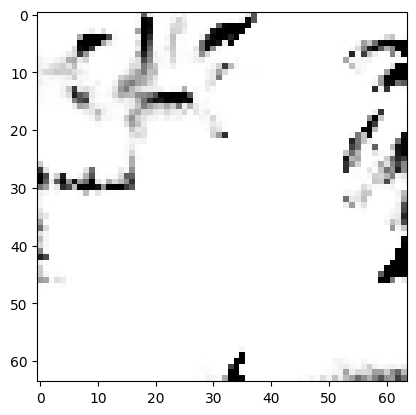

tensor([[4.2000e-03, 3.3940e-03, 1.0428e-02, 3.1071e-03, 5.2351e-03, 8.9315e-03,
         1.2972e-03, 2.5261e-02, 1.0056e-03, 8.2888e-01, 2.7416e-03, 2.3734e-03,
         2.0863e-03, 5.1855e-05, 2.3764e-04, 1.7923e-02, 8.4949e-04, 5.6227e-04,
         3.1337e-03, 7.9495e-03, 5.4829e-04, 6.6338e-04, 3.3177e-05, 8.6977e-04,
         3.0351e-04, 2.2867e-03, 7.6327e-03, 3.0462e-03, 1.8724e-02, 2.0834e-03,
         6.4885e-04, 7.8313e-03, 1.4969e-03, 1.4848e-03, 7.5960e-03, 4.1725e-04,
         3.5997e-04, 5.4114e-03, 2.0542e-03, 6.8606e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18768185377120972
tensor([[4.2003e-03, 3.3946e-03, 1.0426e-02, 3.1065e-03, 5.2349e-03, 8.9326e-03,
         1.2975e-03, 2.5255e-02, 1.0056e-03, 8.2890e-01, 2.7412e-03, 2.3732e-03,
         2.0862e-03, 5.1843e-05, 2.3761e-04, 1.7921e-02, 8.4897e-04, 5.6236e-04,
         3.1330e-03, 7.9497e-03, 5.4826e-04, 6.6321e-04, 3.3165e-05, 8.6945e-04,
         3.0349e-04, 2.2860e-03, 7.6336e-0

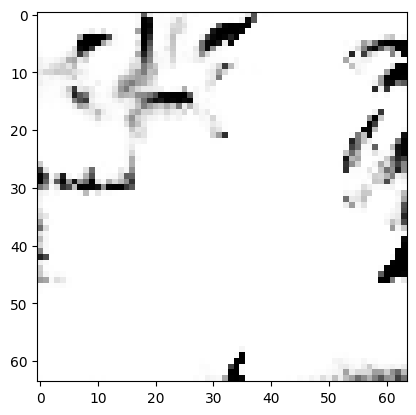

tensor([[4.2011e-03, 3.3935e-03, 1.0413e-02, 3.1040e-03, 5.2323e-03, 8.9293e-03,
         1.2978e-03, 2.5249e-02, 1.0047e-03, 8.2895e-01, 2.7400e-03, 2.3719e-03,
         2.0845e-03, 5.1775e-05, 2.3750e-04, 1.7926e-02, 8.4808e-04, 5.6207e-04,
         3.1328e-03, 7.9488e-03, 5.4782e-04, 6.6296e-04, 3.3118e-05, 8.6910e-04,
         3.0321e-04, 2.2831e-03, 7.6345e-03, 3.0431e-03, 1.8714e-02, 2.0825e-03,
         6.4812e-04, 7.8322e-03, 1.4964e-03, 1.4845e-03, 7.5931e-03, 4.1694e-04,
         3.5938e-04, 5.4039e-03, 2.0523e-03, 6.8579e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1875910460948944
tensor([[4.1979e-03, 3.3915e-03, 1.0413e-02, 3.1029e-03, 5.2312e-03, 8.9249e-03,
         1.2966e-03, 2.5242e-02, 1.0045e-03, 8.2897e-01, 2.7396e-03, 2.3721e-03,
         2.0842e-03, 5.1781e-05, 2.3749e-04, 1.7926e-02, 8.4838e-04, 5.6172e-04,
         3.1330e-03, 7.9470e-03, 5.4790e-04, 6.6303e-04, 3.3131e-05, 8.6922e-04,
         3.0315e-04, 2.2839e-03, 7.6330e-03

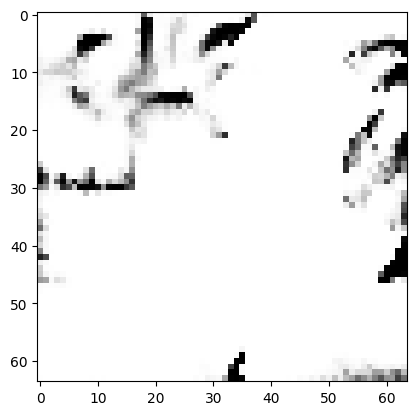

tensor([[4.1966e-03, 3.3899e-03, 1.0404e-02, 3.0996e-03, 5.2285e-03, 8.9221e-03,
         1.2963e-03, 2.5223e-02, 1.0038e-03, 8.2903e-01, 2.7384e-03, 2.3716e-03,
         2.0827e-03, 5.1732e-05, 2.3740e-04, 1.7930e-02, 8.4753e-04, 5.6151e-04,
         3.1321e-03, 7.9469e-03, 5.4769e-04, 6.6277e-04, 3.3093e-05, 8.6878e-04,
         3.0287e-04, 2.2816e-03, 7.6333e-03, 3.0390e-03, 1.8714e-02, 2.0821e-03,
         6.4764e-04, 7.8366e-03, 1.4963e-03, 1.4839e-03, 7.5893e-03, 4.1686e-04,
         3.5919e-04, 5.4029e-03, 2.0510e-03, 6.8539e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18749529123306274
tensor([[4.1936e-03, 3.3894e-03, 1.0403e-02, 3.0988e-03, 5.2284e-03, 8.9181e-03,
         1.2955e-03, 2.5221e-02, 1.0034e-03, 8.2905e-01, 2.7386e-03, 2.3716e-03,
         2.0822e-03, 5.1734e-05, 2.3737e-04, 1.7930e-02, 8.4766e-04, 5.6122e-04,
         3.1323e-03, 7.9445e-03, 5.4778e-04, 6.6281e-04, 3.3094e-05, 8.6878e-04,
         3.0278e-04, 2.2822e-03, 7.6300e-0

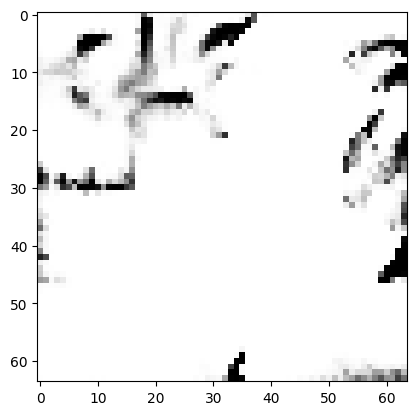

tensor([[4.1903e-03, 3.3867e-03, 1.0395e-02, 3.0968e-03, 5.2261e-03, 8.9113e-03,
         1.2947e-03, 2.5209e-02, 1.0030e-03, 8.2911e-01, 2.7372e-03, 2.3710e-03,
         2.0814e-03, 5.1712e-05, 2.3728e-04, 1.7928e-02, 8.4710e-04, 5.6078e-04,
         3.1319e-03, 7.9453e-03, 5.4753e-04, 6.6285e-04, 3.3071e-05, 8.6862e-04,
         3.0263e-04, 2.2813e-03, 7.6277e-03, 3.0365e-03, 1.8717e-02, 2.0821e-03,
         6.4760e-04, 7.8406e-03, 1.4965e-03, 1.4841e-03, 7.5839e-03, 4.1676e-04,
         3.5899e-04, 5.4021e-03, 2.0506e-03, 6.8471e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18740445375442505
tensor([[4.1933e-03, 3.3865e-03, 1.0389e-02, 3.0954e-03, 5.2245e-03, 8.9133e-03,
         1.2952e-03, 2.5206e-02, 1.0024e-03, 8.2912e-01, 2.7368e-03, 2.3705e-03,
         2.0802e-03, 5.1658e-05, 2.3723e-04, 1.7935e-02, 8.4665e-04, 5.6080e-04,
         3.1319e-03, 7.9438e-03, 5.4734e-04, 6.6261e-04, 3.3042e-05, 8.6840e-04,
         3.0245e-04, 2.2792e-03, 7.6303e-0

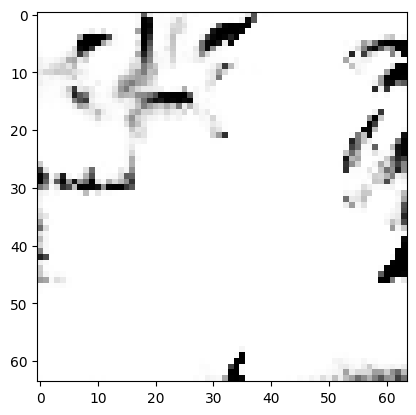

tensor([[4.1894e-03, 3.3849e-03, 1.0384e-02, 3.0935e-03, 5.2229e-03, 8.9070e-03,
         1.2941e-03, 2.5189e-02, 1.0021e-03, 8.2918e-01, 2.7355e-03, 2.3705e-03,
         2.0797e-03, 5.1648e-05, 2.3714e-04, 1.7932e-02, 8.4625e-04, 5.6035e-04,
         3.1318e-03, 7.9417e-03, 5.4730e-04, 6.6257e-04, 3.3034e-05, 8.6808e-04,
         3.0232e-04, 2.2790e-03, 7.6298e-03, 3.0324e-03, 1.8714e-02, 2.0812e-03,
         6.4696e-04, 7.8436e-03, 1.4962e-03, 1.4834e-03, 7.5811e-03, 4.1665e-04,
         3.5869e-04, 5.3998e-03, 2.0490e-03, 6.8441e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18732142448425293
tensor([[4.1906e-03, 3.3855e-03, 1.0380e-02, 3.0927e-03, 5.2230e-03, 8.9080e-03,
         1.2945e-03, 2.5188e-02, 1.0018e-03, 8.2919e-01, 2.7355e-03, 2.3699e-03,
         2.0792e-03, 5.1630e-05, 2.3714e-04, 1.7936e-02, 8.4591e-04, 5.6043e-04,
         3.1316e-03, 7.9422e-03, 5.4723e-04, 6.6245e-04, 3.3016e-05, 8.6802e-04,
         3.0224e-04, 2.2778e-03, 7.6300e-0

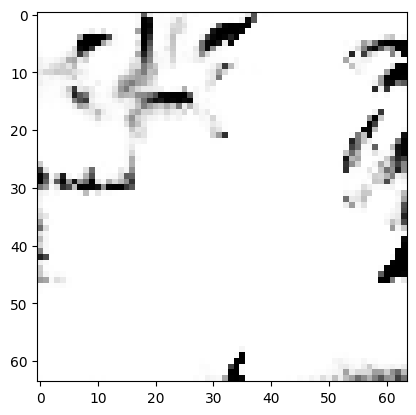

tensor([[4.1865e-03, 3.3829e-03, 1.0375e-02, 3.0902e-03, 5.2207e-03, 8.9012e-03,
         1.2932e-03, 2.5173e-02, 1.0013e-03, 8.2924e-01, 2.7346e-03, 2.3699e-03,
         2.0781e-03, 5.1609e-05, 2.3705e-04, 1.7936e-02, 8.4563e-04, 5.5995e-04,
         3.1313e-03, 7.9405e-03, 5.4718e-04, 6.6244e-04, 3.3002e-05, 8.6781e-04,
         3.0203e-04, 2.2774e-03, 7.6276e-03, 3.0296e-03, 1.8714e-02, 2.0810e-03,
         6.4651e-04, 7.8464e-03, 1.4962e-03, 1.4830e-03, 7.5780e-03, 4.1650e-04,
         3.5847e-04, 5.3974e-03, 2.0479e-03, 6.8401e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18724758923053741
tensor([[4.1850e-03, 3.3833e-03, 1.0374e-02, 3.0901e-03, 5.2206e-03, 8.8998e-03,
         1.2929e-03, 2.5168e-02, 1.0014e-03, 8.2925e-01, 2.7342e-03, 2.3700e-03,
         2.0785e-03, 5.1616e-05, 2.3704e-04, 1.7931e-02, 8.4545e-04, 5.5984e-04,
         3.1311e-03, 7.9396e-03, 5.4722e-04, 6.6245e-04, 3.3009e-05, 8.6767e-04,
         3.0206e-04, 2.2779e-03, 7.6283e-0

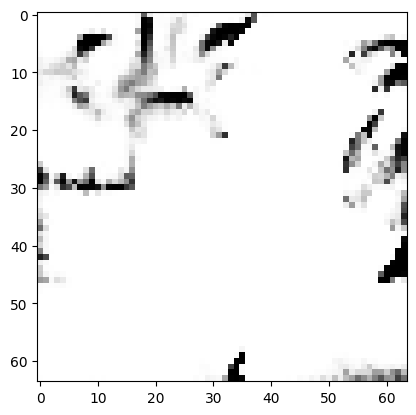

tensor([[4.1840e-03, 3.3821e-03, 1.0368e-02, 3.0884e-03, 5.2187e-03, 8.8955e-03,
         1.2924e-03, 2.5159e-02, 1.0007e-03, 8.2930e-01, 2.7335e-03, 2.3694e-03,
         2.0774e-03, 5.1574e-05, 2.3694e-04, 1.7931e-02, 8.4496e-04, 5.5947e-04,
         3.1309e-03, 7.9367e-03, 5.4703e-04, 6.6230e-04, 3.2983e-05, 8.6733e-04,
         3.0184e-04, 2.2767e-03, 7.6280e-03, 3.0272e-03, 1.8711e-02, 2.0807e-03,
         6.4633e-04, 7.8486e-03, 1.4960e-03, 1.4826e-03, 7.5758e-03, 4.1646e-04,
         3.5823e-04, 5.3967e-03, 2.0473e-03, 6.8373e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18717512488365173
tensor([[4.1820e-03, 3.3825e-03, 1.0369e-02, 3.0885e-03, 5.2189e-03, 8.8947e-03,
         1.2921e-03, 2.5154e-02, 1.0011e-03, 8.2931e-01, 2.7330e-03, 2.3695e-03,
         2.0778e-03, 5.1593e-05, 2.3695e-04, 1.7927e-02, 8.4489e-04, 5.5942e-04,
         3.1304e-03, 7.9366e-03, 5.4710e-04, 6.6227e-04, 3.2991e-05, 8.6721e-04,
         3.0188e-04, 2.2774e-03, 7.6270e-0

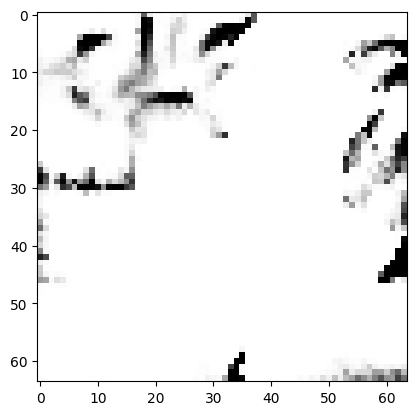

tensor([[4.1836e-03, 3.3825e-03, 1.0360e-02, 3.0869e-03, 5.2170e-03, 8.8944e-03,
         1.2924e-03, 2.5147e-02, 1.0005e-03, 8.2935e-01, 2.7322e-03, 2.3686e-03,
         2.0766e-03, 5.1530e-05, 2.3683e-04, 1.7928e-02, 8.4397e-04, 5.5923e-04,
         3.1299e-03, 7.9340e-03, 5.4681e-04, 6.6195e-04, 3.2949e-05, 8.6667e-04,
         3.0165e-04, 2.2751e-03, 7.6286e-03, 3.0257e-03, 1.8704e-02, 2.0805e-03,
         6.4604e-04, 7.8481e-03, 1.4954e-03, 1.4821e-03, 7.5756e-03, 4.1627e-04,
         3.5780e-04, 5.3923e-03, 2.0463e-03, 6.8371e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18710850179195404
tensor([[4.1811e-03, 3.3810e-03, 1.0362e-02, 3.0870e-03, 5.2165e-03, 8.8905e-03,
         1.2917e-03, 2.5144e-02, 1.0005e-03, 8.2936e-01, 2.7319e-03, 2.3689e-03,
         2.0767e-03, 5.1546e-05, 2.3681e-04, 1.7924e-02, 8.4426e-04, 5.5908e-04,
         3.1299e-03, 7.9338e-03, 5.4682e-04, 6.6203e-04, 3.2960e-05, 8.6675e-04,
         3.0166e-04, 2.2760e-03, 7.6269e-0

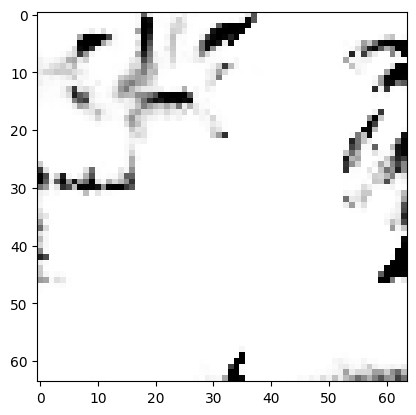

tensor([[4.1813e-03, 3.3804e-03, 1.0356e-02, 3.0859e-03, 5.2147e-03, 8.8886e-03,
         1.2914e-03, 2.5142e-02, 1.0000e-03, 8.2941e-01, 2.7315e-03, 2.3679e-03,
         2.0758e-03, 5.1502e-05, 2.3671e-04, 1.7924e-02, 8.4370e-04, 5.5880e-04,
         3.1292e-03, 7.9320e-03, 5.4655e-04, 6.6181e-04, 3.2930e-05, 8.6643e-04,
         3.0146e-04, 2.2745e-03, 7.6257e-03, 3.0237e-03, 1.8702e-02, 2.0799e-03,
         6.4584e-04, 7.8486e-03, 1.4951e-03, 1.4817e-03, 7.5719e-03, 4.1614e-04,
         3.5764e-04, 5.3926e-03, 2.0455e-03, 6.8329e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1870466023683548
tensor([[4.1824e-03, 3.3812e-03, 1.0356e-02, 3.0860e-03, 5.2144e-03, 8.8901e-03,
         1.2916e-03, 2.5137e-02, 1.0001e-03, 8.2942e-01, 2.7312e-03, 2.3677e-03,
         2.0758e-03, 5.1489e-05, 2.3669e-04, 1.7921e-02, 8.4340e-04, 5.5887e-04,
         3.1288e-03, 7.9313e-03, 5.4649e-04, 6.6166e-04, 3.2920e-05, 8.6612e-04,
         3.0144e-04, 2.2741e-03, 7.6269e-03

In [24]:
z = torch.randn(1, 16, 32, 32).to(device)
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 1000, 0.00, 0.99, target=9)